# Pre-Equilibrium Maximazation of Yield #

In [1]:
# make sure jupyter path is correct for loading local moudules
import sys
# path to steric_simulator module relative to notebook
sys.path.append("../../../")
import copy

In [2]:
from steric_free_simulator import ReactionNetwork, VectorizedRxnNet, VecSim, Optimizer, EquilibriumSolver
import networkx as nx
import torch
from torch import DoubleTensor as Tensor
import numpy as np

EnergyExplorer Module is not available. Check Rosetta installation. <ipykernel.iostream.OutStream object at 0x155550aba588>


We'll start with the AP2 complex that we've worked with before. Pairwise $\Delta Gs$ were derived from the PDB structures via Rossetta

In [3]:
base_input = '../../input_files/pentamer.pwr'
rn = ReactionNetwork(base_input, one_step=True)
rn.resolve_tree()
vec_rn = VectorizedRxnNet(rn, dev='cpu')

['default_assoc', 1.0]
['P']
100.0
['Q']
100.0
['R']
100.0
['S']
100.0
['T']
100.0
Parsing rule...
['P', 'Q', '']
GGGGGGGGGgg
Parsing rule...
['P', 'R', '']
GGGGGGGGGgg
Parsing rule...
['P', 'S', '']
GGGGGGGGGgg
Parsing rule...
['P', 'T', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'R', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'S', '']
GGGGGGGGGgg
Parsing rule...
['Q', 'T', '']
GGGGGGGGGgg
Parsing rule...
['R', 'S', '']
GGGGGGGGGgg
Parsing rule...
['R', 'T', '']
GGGGGGGGGgg
Parsing rule...
['S', 'T', '']
GGGGGGGGGgg
Node-1 :  (0, {'struct': <networkx.classes.graph.Graph object at 0x1554bc1be240>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (0, {'struct': <networkx.classes.graph.Graph object at 0x1554bc1be240>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'P'}
{'P'}
set()
Steric hindrance detected
Node-1 :  (0, {'struct': <networkx.classes.graph.Graph object at 0x1554bc1be240>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
No

Adding an new edge-- 16 27
New node added--2
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27]
Node-1 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057ef0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8c96d8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S'}
{'R', 'P', 'S'}
set()
Steric hindrance detected
Node-1 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057ef0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
Node-2 :  (18, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8e06d8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
-----
{'S'}
{'R', 'T', 'P'}
{'S'}
False
Orig edges:  []
Nextn edges:  [('R', 'P'), ('R', 'T'), ('P', 'T')]
Item edges:  [('R', 'P'), ('R', 'T'), ('P', 'T')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed ed

Node-1 :  (6, {'struct': <networkx.classes.graph.Graph object at 0x1554bb922828>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057ef0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'P'}
{'S'}
{'R', 'P'}
False
Orig edges:  [('P', 'R')]
Nextn edges:  []
Item edges:  [('P', 'R')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, True]
False
############################3
Allowed edges: 
('P', 'T')
[True, False]
False
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, True]
False
Allowed edges: 
('Q', 'T')
[False, False]
False
Allowed edges: 
('R', 'S')
[True, True]
False
############################3
Allowed edges: 
('R', 'T')
[True, False]
False
Allowed edges: 
('S', 'T')
[True, False]
False
[(17, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8c96d8>, 'c

[(21, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8e09e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'R'), ('Q', 'P'), ('Q', 'S'), ('R', 'P'), ('R', 'S'), ('P', 'S')]
$$$$$$$
Node-1 :  (9, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8c9ac8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (8, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8c9470>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
-----
{'R', 'Q'}
{'T', 'P'}
{'R', 'Q'}
False
Orig edges:  [('Q', 'R')]
Nextn edges:  [('P', 'T')]
Item edges:  [('Q', 'R'), ('P', 'T')]
Allowed edges: 
('P', 'Q')
[True, True]
False
############################3
Allowed edges: 
('P', 'R')
[True, True]
False
############################3
Allowed edges: 
('P', 'S')
[True, False]
False
Allowed edges: 
('P', 'T')
[True, True]
True
Allowed edges: 
('Q', 'R')
[True, True]
True
Allowed edges: 
('Q', 'S')
[True, False]
False
A

[(21, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8e09e8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]
Connected item Edges:  [('Q', 'P'), ('Q', 'S'), ('Q', 'R'), ('P', 'S'), ('P', 'R'), ('S', 'R')]
$$$$$$$
Node-1 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8c9eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (3, {'struct': <networkx.classes.graph.Graph object at 0x155550057ef0>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'P', 'S', 'Q'}
{'S'}
{'P', 'Q'}
Steric hindrance detected
Node-1 :  (13, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8c9eb8>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1db5f8>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'P', 'S', 'Q'}
{'T'}
{'P', 'S', 'Q'}
False
Orig edges:  [('Q', 'P'), ('Q', 'S'), ('P', 'S')]
Nextn edges:  []

Node-2 :  (4, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1db5f8>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'R', 'P', 'S'}
{'T'}
{'R', 'P', 'S'}
False
Orig edges:  [('R', 'P'), ('R', 'S'), ('P', 'S')]
Nextn edges:  []
Item edges:  [('R', 'P'), ('R', 'S'), ('P', 'S')]
Allowed edges: 
('P', 'Q')
[True, False]
False
Allowed edges: 
('P', 'R')
[True, True]
True
Allowed edges: 
('P', 'S')
[True, True]
True
Allowed edges: 
('P', 'T')
[True, True]
False
############################3
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed edges: 
('Q', 'S')
[False, True]
False
Allowed edges: 
('Q', 'T')
[False, True]
False
Allowed edges: 
('R', 'S')
[True, True]
True
Allowed edges: 
('R', 'T')
[True, True]
False
############################3
Allowed edges: 
('S', 'T')
[True, True]
False
############################3
[(28, {'struct': <networkx.classes.graph.Graph object at 0x1554bd1db588>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})]


[(24, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8e0390>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})]
Connected item Edges:  [('S', 'T'), ('S', 'P'), ('T', 'P')]
Adding an new edge-- 23 24
New bonds:  [('P', 'S'), ('P', 'T')]
Adding an new edge-- 0 24
Node-1 :  (23, {'struct': <networkx.classes.graph.Graph object at 0x1554bb944358>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 2})
Node-2 :  (1, {'struct': <networkx.classes.graph.Graph object at 0x155550057a58>, 'copies': tensor([100.], dtype=torch.float64), 'subunits': 1})
-----
{'T', 'S'}
{'Q'}
{'T', 'S'}
False
Orig edges:  [('S', 'T')]
Nextn edges:  []
Item edges:  [('S', 'T')]
Allowed edges: 
('P', 'Q')
[False, True]
False
Allowed edges: 
('P', 'R')
[False, False]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('Q', 'R')
[True, False]
False
Allowed edges: 
('Q', 'S')
[True, True]
False
############################3
Allo

Node-1 :  (27, {'struct': <networkx.classes.graph.Graph object at 0x1554bb944e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (29, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8e0f28>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 21})
-----
{'R', 'T', 'S'}
{'R', 'T', 'S', 'Q'}
set()
Steric hindrance detected
Node-1 :  (27, {'struct': <networkx.classes.graph.Graph object at 0x1554bb944e48>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 6})
Node-2 :  (30, {'struct': <networkx.classes.graph.Graph object at 0x1554bb8e0470>, 'copies': tensor([0.], dtype=torch.float64), 'subunits': 88})
-----
{'R', 'T', 'S'}
{'R', 'T', 'S', 'Q', 'P'}
set()
Steric hindrance detected
Trying internal bonds
Allowed edges: 
('P', 'Q')
[False, False]
False
Allowed edges: 
('P', 'R')
[False, True]
False
Allowed edges: 
('P', 'S')
[False, True]
False
Allowed edges: 
('P', 'T')
[False, True]
False
Allowed edges: 
('Q', 'R')
[False, True]
False
Allowed e

In [4]:
uid_dict = {}
sys.path.append("../../")
import numpy as np
from reaction_network import gtostr
for n in rn.network.nodes():
    #print(n)
    #print(rn.network.nodes()[n])
    for k,v in rn.network[n].items():
        uid = v['uid']
        r1 = set(gtostr(rn.network.nodes[n]['struct']))
        p = set(gtostr(rn.network.nodes[k]['struct']))
        r2 = p-r1
        reactants = (r1,r2)
        uid_dict[(n,k)] = uid

print(uid_dict)

{(0, 5): 0, (0, 6): 1, (0, 7): 2, (0, 8): 3, (0, 12): 58, (0, 13): 61, (0, 14): 64, (0, 17): 70, (0, 18): 72, (0, 21): 76, (0, 22): 77, (0, 24): 78, (0, 26): 83, (0, 28): 86, (0, 30): 89, (1, 5): 0, (1, 9): 4, (1, 10): 5, (1, 11): 6, (1, 12): 7, (1, 13): 8, (1, 14): 9, (1, 19): 71, (1, 20): 73, (1, 21): 74, (1, 22): 75, (1, 25): 79, (1, 26): 81, (1, 29): 87, (1, 30): 88, (2, 6): 1, (2, 9): 4, (2, 15): 10, (2, 16): 11, (2, 12): 12, (2, 17): 13, (2, 18): 14, (2, 19): 15, (2, 20): 16, (2, 21): 17, (2, 22): 18, (2, 27): 80, (2, 28): 82, (2, 29): 84, (2, 30): 85, (3, 7): 2, (3, 10): 5, (3, 15): 10, (3, 23): 19, (3, 13): 20, (3, 17): 21, (3, 24): 22, (3, 19): 23, (3, 25): 24, (3, 21): 25, (3, 26): 26, (3, 27): 27, (3, 28): 28, (3, 29): 29, (3, 30): 30, (4, 8): 3, (4, 11): 6, (4, 16): 11, (4, 23): 19, (4, 14): 31, (4, 18): 32, (4, 24): 33, (4, 20): 34, (4, 25): 35, (4, 22): 36, (4, 26): 37, (4, 27): 38, (4, 28): 39, (4, 29): 40, (4, 30): 41, (5, 12): 12, (5, 13): 20, (5, 14): 31, (5, 21): 42,

In [5]:
#Do modifications here
#Changing Initial Conditions
import networkx as nx
#Changin k_on
new_kon = torch.zeros([rn._rxn_count], requires_grad=True).double()
new_kon = new_kon + Tensor([1.]*np.array(1e0))
# new_kon = new_kon + Tensor([ 2.0250,  1.9631,  1.6295,  2.0319,  1.8428,  1.9629,  1.9462,  2.1415,
#          3.0504,  1.9790,  2.2053,  1.8444,  2.0038,  2.8676,  1.8831,  2.2072,
#          2.8235,  7.0827,  6.8401,  1.9636,  1.8379,  1.8441,  1.7327,  2.6644,
#          2.5297,  6.1627,  5.6660,  2.5278,  5.7092,  7.7515, 14.7079,  2.0182,
#          2.0557,  2.9554,  3.0558,  2.2752,  7.1661,  7.0257,  1.6925,  6.7420,
#          7.1950, 14.4043,  0.0248,  0.0322,  0.0325,  3.5224,  0.0312,  0.0321,
#          0.0305,  3.3910,  0.0346,  0.0212,  0.0342,  4.1594,  0.0320,  0.0323,
#          0.0230,  3.4099,  2.5865,  0.0300,  4.6505,  1.9634,  0.0348,  3.6781,
#          2.3943,  0.0309,  4.6222,  3.5830,  4.4373,  3.3184,  1.4508,  1.7639,
#          2.4415,  3.0000,  7.3860,  7.3816,  5.2024,  6.9316,  1.8574,  2.2372,
#          2.0936,  7.3989,  6.8460,  5.3782,  7.3621, 14.2158,  4.7405,  7.4420,
#         14.2274, 15.2673])
update_kon_dict = {}
for edge in rn.network.edges:
    print(rn.network.get_edge_data(edge[0],edge[1]))
    update_kon_dict[edge] = new_kon[uid_dict[edge]]

nx.set_edge_attributes(rn.network,update_kon_dict,'k_on')

# for edge in rn.network.edges:
#     print(rn.network.get_edge_data(edge[0],edge[1]))
vec_rn = VectorizedRxnNet(rn, dev='cpu')
print(vec_rn.kon)

#Changing initial concentrations

{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 0}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 1}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 2}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 3}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 58}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 61}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 64}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 70}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 72}
{'k_on': 1.0, 'k_off': None, 'lcf': 1, 'rxn_score': tensor([-36.], dtype=torch.float64), 'uid': 76}
{'k_

## The Equilibrium Solution ##
First we will find the equilibrium solution for this system.

In [6]:
# vec_rn.update_reaction_net(rn)
# poly_system = EquilibriumSolver(rn)
# solution = poly_system.solve()
# print(solution)
# if solution == None:
#     print("No Equilibrium solution")
# else:
#     print(solution)
#     print("Equilibrium expected yield: ", 100 * solution[-1] / min(vec_rn.initial_copies[:vec_rn.num_monomers]), '%')
# print(vec_rn.kon)

In [7]:
# uid_dict = {}
# sys.path.append("../")
# import numpy as np
# from reaction_network import gtostr
# from torch import DoubleTensor as Tensor

# def get_max_edge(n):
#     """
#     Calculates the max rate (k_on) for a given node
#     To find out the maximum flow path to the final complex starting from the current node.
    
#     Can also calculate the total rate of consumption of a node by summing up all rates. 
#     Can tell which component is used quickly.
#     """
#     try:
#         edges = rn.network.out_edges(n)
#         #Loop over all edges
#         #Get attributes
#         if len(edges)==0:
#             return(False)
#         kon_max = -1
#         next_node = -1
        
#         kon_sum = 0
#         for edge in edges:
#             data = rn.network.get_edge_data(edge[0],edge[1])
#             #print(data)
#             #Get uid
#             uid = data['uid']
#             #Get updated kon
#             temp_kon = vec_rn.kon[uid]
#             kon_sum+=temp_kon
            
# #             #Calculate k_off also
# #             std_c = Tensor([1.])
# #             l_kon = torch.log(temp_kon)
# #             l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (self._R * self._T)) + l_kon + torch.log(std_c)
#             if temp_kon > kon_max:
#                 kon_max = temp_kon
#                 next_node=edge[1]
#         return(kon_max,next_node,kon_sum)
#     except Exception as err:
#         raise(err)

# pathway = []
# kon_sumarray = []
# total_con_rate = {}
# for n in rn.network.nodes():
    
#     n_str = gtostr(rn.network.nodes[n]['struct']) 
    
#     paths = [n_str]
#     kon_sum = 0
#     temp_node = n
#     max_edge = True
#     consumption_rate = 0
#     if n < len(rn.network.nodes()):#num_monomers:
# #         print("Current node: ")
# #         print(n_str)
#         while max_edge:
#             max_edge = get_max_edge(temp_node)
#             if max_edge:
#                 total_con_rate[gtostr(rn.network.nodes[temp_node]['struct'])] = max_edge[2]
#                 temp_node = max_edge[1]
#                 kon_sum += max_edge[0].item()
                
# #                 print("Next node: ")
# #                 print(temp_node)

#                 paths.append(gtostr(rn.network.nodes[temp_node]['struct']))
#             else:
#                 break
#         pathway.append(paths)
#         kon_sumarray.append(kon_sum)
#         paths=[]

# print(pathway)
# print(kon_sumarray)
# #print(total_con_rate)

In [8]:
# if solution != None:
#     for k,v in sorted(total_con_rate.items(),key=lambda x : x[1]):
#         print(k," : ", v.item())

In [9]:
# if solution !=None:
#     for k,v in sorted(net_flux.items(),key=lambda x : x[1]):
#         print(k," : ", v)

## Using the optimizer with a 1 second simulation runtime ##

In [10]:
vec_rn.reset(reset_params=True)
optim = Optimizer(reaction_network=vec_rn,
                  sim_runtime=1,
                  optim_iterations=5000,
                  learning_rate=new_kon[0].item()/1e2,
                  device='cpu',method="RMSprop")
optim.rn.update_reaction_net(rn)
optim.optimize()

Using CPU
Reaction Parameters before optimization: 
[Parameter containing:
tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
        1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       dtype=torch.float64, requires_grad=True)]
Optimizer State: <bound method Optimizer.state_dict of RMSprop (
Parameter Group 0
    alpha: 0.99
    centered: False
    eps: 1e-08
    lr: 0.01
    momentum: 0
    weight_decay: 0
)>
Using CPU
Simulation rates:  tensor([1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
        1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
        1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00,
        1.0000e+00, 

Next time:  tensor(1.4682, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  433
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.4275, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2 was 42.7%
current params: tensor([0.9505, 1.1530, 0.9698, 1.1522, 0.9474, 0.9461, 0.9432, 0.7472, 0.7609,
        0.7509, 1.2744, 0.9358, 0.7618, 0.7543, 0.7416, 0.7650, 0.7641, 0.8478,
        0.8303, 1.1494, 0.7641, 0.7442, 0.7419, 0.7650, 0.7619, 0.8446, 0.8309,
        0.7549, 0.7971, 0.8438, 1.2415, 0.7660, 0.7416, 0.7517, 0.7642, 0.7620,
        0.8448, 0.8493, 0.7446, 0.7963, 0.8455, 1.2417, 0.7570, 0.7634, 0.7543,
        1.2398, 0.7566, 0.7541, 0.7317, 1.2199, 0.7656, 0.7632, 0.7439, 1.2176,
        0.7541, 0.7544, 0.7318, 1.2195, 0.7621, 0.7562, 1.2403, 0.7643, 0.7657,
        1.2402, 0.7662, 0.7566, 1.2396, 1.2198, 1.2166, 1.2279, 0.7449, 0.7506,
        0.7521, 0.7617, 1.1019, 1.1003, 0.8428, 0.8408, 0.7420, 0.7472, 0.7441,


Next time:  tensor(1.0408, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  469
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.5392, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 5 was 53.9%
current params: tensor([1.1319, 1.3215, 1.1736, 1.3305, 1.1268, 1.1228, 1.1236, 0.5616, 0.5798,
        0.5677, 1.4846, 1.1452, 0.5794, 0.5653, 0.5512, 0.5855, 0.5874, 0.7379,
        0.6912, 1.3234, 0.5864, 0.5560, 0.5514, 0.5854, 0.5817, 0.7597, 0.6893,
        0.5670, 0.6211, 0.7083, 1.3686, 0.5885, 0.5532, 0.5621, 0.5902, 0.5847,
        0.8957, 0.9032, 0.5541, 0.8076, 0.8965, 1.4009, 0.5666, 0.5758, 0.5641,
        1.3826, 0.5709, 0.5642, 0.5290, 1.3514, 0.5816, 0.5743, 0.5409, 1.3527,
        0.5643, 0.5644, 0.5259, 1.3471, 0.5806, 0.5680, 1.3818, 0.5878, 0.5803,
        1.3802, 0.5871, 0.5649, 1.3836, 1.3450, 1.3493, 1.3624, 0.5529, 0.5628,
        0.5624, 0.5831, 1.1467, 1.1194, 0.7619, 0.7011, 0.5521, 0.5639, 0.5558,


Next time:  tensor(1.3361, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  503
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.6510, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 8 was 65.0%
current params: tensor([1.2044, 1.3709, 1.2312, 1.4061, 1.2010, 1.1970, 1.1834, 0.4169, 0.4323,
        0.4298, 1.5535, 1.2069, 0.4308, 0.4079, 0.4028, 0.4397, 0.4445, 0.6337,
        0.6137, 1.3979, 0.4383, 0.4014, 0.4039, 0.4392, 0.4377, 0.6627, 0.6127,
        0.4177, 0.5039, 0.6488, 1.4832, 0.4481, 0.4060, 0.4129, 0.4470, 0.4407,
        0.8732, 0.8824, 0.4096, 0.7403, 0.8735, 1.4869, 0.4034, 0.4258, 0.4165,
        1.4928, 0.4079, 0.4164, 0.3666, 1.4518, 0.4170, 0.4261, 0.3753, 1.4589,
        0.4154, 0.4171, 0.3636, 1.4507, 0.4323, 0.4214, 1.4919, 0.4402, 0.4327,
        1.4905, 0.4474, 0.4197, 1.4929, 1.4482, 1.4568, 1.4692, 0.3995, 0.4215,
        0.4115, 0.4395, 1.1575, 1.1396, 0.6559, 0.6342, 0.4050, 0.4222, 0.4094,


Next time:  tensor(1.0301, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  570
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8003, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 11 was 80.0%
current params: tensor([1.3506, 1.4905, 1.3646, 1.5601, 1.3532, 1.3510, 1.3125, 0.2522, 0.2682,
        0.2670, 1.5460, 1.3486, 0.2631, 0.2365, 0.2376, 0.2727, 0.2837, 0.5826,
        0.5837, 1.5547, 0.2729, 0.2317, 0.2390, 0.2718, 0.2743, 0.6162, 0.5844,
        0.2512, 0.4192, 0.6325, 1.5768, 0.2835, 0.2419, 0.2473, 0.2848, 0.2761,
        0.8798, 0.8935, 0.2471, 0.6956, 0.8783, 1.5624, 0.2262, 0.2558, 0.2473,
        1.5784, 0.2310, 0.2489, 0.1907, 1.5295, 0.2393, 0.2585, 0.1982, 1.5424,
        0.2453, 0.2479, 0.1877, 1.5309, 0.2648, 0.2520, 1.5778, 0.2753, 0.2636,
        1.5766, 0.2846, 0.2528, 1.5775, 1.5283, 1.5418, 1.5509, 0.2313, 0.2585,
        0.2450, 0.2777, 1.1931, 1.1874, 0.5950, 0.6082, 0.2406, 0.2593, 0.2446,

Next time:  tensor(3577.9163, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  562
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8108, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 14 was 81.0%
current params: tensor([1.2791, 1.4175, 1.2922, 1.4874, 1.2811, 1.2786, 1.2414, 0.2888, 0.2985,
        0.3076, 1.5459, 1.2768, 0.2969, 0.2590, 0.2681, 0.3083, 0.3166, 0.5101,
        0.5271, 1.4813, 0.3031, 0.2571, 0.2701, 0.3075, 0.3111, 0.5460, 0.5310,
        0.2800, 0.3387, 0.5881, 1.6578, 0.3215, 0.2723, 0.2757, 0.3193, 0.3144,
        0.8639, 0.8843, 0.2772, 0.6514, 0.8558, 1.6302, 0.2681, 0.3031, 0.2972,
        1.6461, 0.2752, 0.2977, 0.2264, 1.5983, 0.2814, 0.3056, 0.2290, 1.6159,
        0.2950, 0.2979, 0.2209, 1.6002, 0.2991, 0.3024, 1.6460, 0.3059, 0.3115,
        1.6451, 0.3216, 0.3001, 1.6423, 1.5980, 1.6145, 1.6222, 0.2548, 0.2945,
        0.2722, 0.3113, 1.1925, 1.1896, 0.5031, 0.5503, 0.2720, 0.3000, 0.27

Next time:  tensor(1.0260, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  626
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9001, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 17 was 90.0%
current params: tensor([1.2367, 1.3733, 1.2482, 1.4436, 1.2389, 1.2361, 1.1991, 0.2946, 0.2999,
        0.3172, 1.5458, 1.2332, 0.3004, 0.2526, 0.2691, 0.3129, 0.3208, 0.4689,
        0.4996, 1.4375, 0.3043, 0.2531, 0.2716, 0.3120, 0.3177, 0.5053, 0.5065,
        0.2791, 0.2846, 0.5730, 1.7245, 0.3285, 0.2727, 0.2744, 0.3239, 0.3215,
        0.8577, 0.8838, 0.2795, 0.6185, 0.8444, 1.6848, 0.2796, 0.3188, 0.3150,
        1.6987, 0.2869, 0.3150, 0.2308, 1.6535, 0.2915, 0.3216, 0.2295, 1.6746,
        0.3126, 0.3157, 0.2251, 1.6548, 0.3025, 0.3206, 1.6985, 0.3072, 0.3278,
        1.6976, 0.3282, 0.3178, 1.6904, 1.6522, 1.6709, 1.6797, 0.2515, 0.3017,
        0.2699, 0.3156, 1.2018, 1.2052, 0.4457, 0.5247, 0.2736, 0.3097, 0.2793,

Next time:  tensor(1.0785, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  575
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8654, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 20 was 86.5%
current params: tensor([1.2277, 1.3627, 1.2381, 1.4333, 1.2297, 1.2267, 1.1899, 0.2657, 0.2663,
        0.2934, 1.5457, 1.2240, 0.2693, 0.2098, 0.2351, 0.2836, 0.2914, 0.4246,
        0.4745, 1.4271, 0.2712, 0.2131, 0.2382, 0.2826, 0.2907, 0.4605, 0.4834,
        0.2433, 0.2083, 0.5637, 1.7838, 0.3021, 0.2382, 0.2378, 0.2950, 0.2951,
        0.8638, 0.8976, 0.2476, 0.5805, 0.8459, 1.7365, 0.2547, 0.2979, 0.2971,
        1.7559, 0.2622, 0.2962, 0.1980, 1.7081, 0.2648, 0.3013, 0.1920, 1.7313,
        0.2943, 0.2978, 0.1921, 1.7107, 0.2716, 0.3033, 1.7558, 0.2743, 0.3081,
        1.7547, 0.3015, 0.3002, 1.7452, 1.7077, 1.7281, 1.7363, 0.2122, 0.2750,
        0.2323, 0.2857, 1.2314, 1.2411, 0.3837, 0.5036, 0.2402, 0.2858, 0.2473,

Next time:  tensor(1.0159, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  558
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8572, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 23 was 85.7%
current params: tensor([1.1769, 1.3106, 1.1860, 1.3816, 1.1796, 1.1763, 1.1396, 0.2870, 0.2847,
        0.3190, 1.5456, 1.1725, 0.2886, 0.2208, 0.2525, 0.3042, 0.3121, 0.3634,
        0.4284, 1.3759, 0.2891, 0.2258, 0.2560, 0.3032, 0.3131, 0.4028, 0.4407,
        0.2599, 0.1423, 0.5362, 1.8385, 0.3254, 0.2551, 0.2536, 0.3159, 0.3177,
        0.8490, 0.8872, 0.2680, 0.5398, 0.8260, 1.7821, 0.2804, 0.3259, 0.3263,
        1.8023, 0.2866, 0.3252, 0.2163, 1.7587, 0.2882, 0.3298, 0.2079, 1.7833,
        0.3233, 0.3271, 0.2114, 1.7608, 0.2909, 0.3328, 1.8016, 0.2921, 0.3367,
        1.8004, 0.3246, 0.3312, 1.7864, 1.7570, 1.7778, 1.7898, 0.2268, 0.2996,
        0.2471, 0.3068, 1.2304, 1.2428, 0.3120, 0.4646, 0.2580, 0.3105, 0.2661,

Next time:  tensor(1.0330, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  584
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8986, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 26 was 89.8%
current params: tensor([1.1343, 1.2663, 1.1418, 1.3379, 1.1377, 1.1344, 1.0978, 0.3003, 0.2951,
        0.3368, 1.5454, 1.1292, 0.3002, 0.2235, 0.2619, 0.3173, 0.3253, 0.2968,
        0.3783, 1.3327, 0.2994, 0.2303, 0.2659, 0.3162, 0.3279, 0.3406, 0.3941,
        0.2685, 0.1903, 0.4999, 1.8886, 0.3413, 0.2641, 0.2614, 0.3292, 0.3327,
        0.8340, 0.8759, 0.2812, 0.4971, 0.7987, 1.8242, 0.2973, 0.3447, 0.3466,
        1.8464, 0.3016, 0.3451, 0.2254, 1.8072, 0.3022, 0.3490, 0.2143, 1.8326,
        0.3431, 0.3471, 0.2218, 1.8092, 0.3022, 0.3529, 1.8461, 0.3022, 0.3556,
        1.8448, 0.3401, 0.3532, 1.8264, 1.8047, 1.8256, 1.8415, 0.2337, 0.3170,
        0.2539, 0.3201, 1.2356, 1.2512, 0.2274, 0.4160, 0.2678, 0.3275, 0.2772,

Next time:  tensor(1.0517, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  571
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 29 was 89.5%
current params: tensor([1.1007, 1.2313, 1.1071, 1.3035, 1.1047, 1.1013, 1.0650, 0.3069, 0.2991,
        0.3482, 1.5453, 1.0956, 0.3053, 0.2200, 0.2650, 0.3244, 0.3324, 0.2327,
        0.3260, 1.2987, 0.3036, 0.2286, 0.2695, 0.3233, 0.3365, 0.2803, 0.3445,
        0.2712, 0.1902, 0.4578, 1.9352, 0.3511, 0.2668, 0.2629, 0.3366, 0.3418,
        0.8268, 0.8728, 0.2882, 0.4602, 0.7738, 1.8650, 0.3073, 0.3564, 0.3598,
        1.8897, 0.3100, 0.3577, 0.2279, 1.8545, 0.3096, 0.3609, 0.2143, 1.8802,
        0.3558, 0.3602, 0.2256, 1.8574, 0.3072, 0.3660, 1.8895, 0.3061, 0.3676,
        1.8879, 0.3494, 0.3679, 1.8669, 1.8524, 1.8731, 1.8926, 0.2342, 0.3280,
        0.2544, 0.3272, 1.2444, 1.2608, 0.1360, 0.3594, 0.2713, 0.3381, 0.2822,

Next time:  tensor(1.0581, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  561
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8945, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 32 was 89.4%
current params: tensor([1.0970, 1.2265, 1.1035, 1.2992, 1.1009, 1.0972, 1.0604, 0.2859, 0.2749,
        0.3325, 1.5452, 1.0921, 0.2829, 0.1868, 0.2403, 0.3047, 0.3132, 0.1840,
        0.2983, 1.2941, 0.2802, 0.1977, 0.2453, 0.3035, 0.3191, 0.2361, 0.3207,
        0.2457, 0.1901, 0.4426, 1.9772, 0.3339, 0.2415, 0.2360, 0.3176, 0.3245,
        0.8467, 0.8972, 0.2664, 0.4316, 0.7723, 1.9035, 0.2895, 0.3422, 0.3478,
        1.9340, 0.2917, 0.3451, 0.2028, 1.8967, 0.2896, 0.3471, 0.1856, 1.9224,
        0.3435, 0.3482, 0.2006, 1.9028, 0.2847, 0.3545, 1.9334, 0.2826, 0.3542,
        1.9314, 0.3319, 0.3568, 1.9104, 1.8975, 1.9177, 1.9379, 0.2044, 0.3106,
        0.2264, 0.3071, 1.2758, 1.2964, 0.1807, 0.3283, 0.2467, 0.3222, 0.2595,

Next time:  tensor(1.0745, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  569
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9110, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 35 was 91.1%
current params: tensor([1.0598, 1.1879, 1.0648, 1.2611, 1.0645, 1.0608, 1.0243, 0.2979, 0.2850,
        0.3489, 1.5451, 1.0544, 0.2937, 0.1897, 0.2492, 0.3171, 0.3261, 0.1256,
        0.2577, 1.2568, 0.2904, 0.2023, 0.2546, 0.3158, 0.3330, 0.1828, 0.2839,
        0.2539, 0.1900, 0.4160, 2.0168, 0.3487, 0.2498, 0.2433, 0.3306, 0.3387,
        0.8360, 0.8883, 0.2794, 0.3929, 0.7528, 1.9363, 0.3048, 0.3589, 0.3656,
        1.9696, 0.3049, 0.3624, 0.2106, 1.9395, 0.3020, 0.3641, 0.1913, 1.9650,
        0.3611, 0.3661, 0.2102, 1.9446, 0.2955, 0.3724, 1.9682, 0.2929, 0.3714,
        1.9659, 0.3466, 0.3769, 1.9411, 1.9382, 1.9578, 1.9844, 0.2120, 0.3274,
        0.2330, 0.3198, 1.2724, 1.2992, 0.1806, 0.2910, 0.2560, 0.3377, 0.2698,

Next time:  tensor(1.1405, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  553
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9038, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 38 was 90.3%
current params: tensor([1.0445, 1.1718, 1.0499, 1.2451, 1.0493, 1.0455, 1.0093, 0.2879, 0.2721,
        0.3442, 1.5450, 1.0396, 0.2824, 0.1680, 0.2354, 0.3078, 0.3177, 0.1952,
        0.2226, 1.2413, 0.2786, 0.1830, 0.2415, 0.3065, 0.3262, 0.1345, 0.2544,
        0.2390, 0.1899, 0.4053, 2.0542, 0.3425, 0.2354, 0.2272, 0.3224, 0.3321,
        0.8462, 0.8991, 0.2694, 0.3571, 0.7574, 1.9699, 0.2979, 0.3545, 0.3632,
        2.0088, 0.2967, 0.3596, 0.1957, 1.9801, 0.2921, 0.3601, 0.1729, 2.0054,
        0.3586, 0.3639, 0.1963, 1.9869, 0.2844, 0.3707, 2.0059, 0.2812, 0.3680,
        2.0034, 0.3405, 0.3766, 1.9770, 1.9795, 1.9980, 2.0282, 0.1951, 0.3216,
        0.2162, 0.3104, 1.2840, 1.3193, 0.1805, 0.2706, 0.2428, 0.3323, 0.2578,

Next time:  tensor(1.0552, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  548
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9048, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 41 was 90.4%
current params: tensor([0.9927, 1.1185, 0.9956, 1.1923, 0.9994, 0.9954, 0.9599, 0.3121, 0.2950,
        0.3733, 1.5447, 0.9872, 0.3055, 0.1845, 0.2571, 0.3325, 0.3426, 0.1951,
        0.1603, 1.1902, 0.3014, 0.2008, 0.2636, 0.3311, 0.3518, 0.0684, 0.1931,
        0.2604, 0.1898, 0.3541, 2.0904, 0.3697, 0.2563, 0.2474, 0.3476, 0.3581,
        0.8207, 0.8723, 0.2970, 0.3122, 0.7191, 2.0000, 0.3246, 0.3813, 0.3900,
        2.0410, 0.3198, 0.3861, 0.2144, 2.0236, 0.3150, 0.3863, 0.1904, 2.0482,
        0.3857, 0.3911, 0.2185, 2.0271, 0.3074, 0.3973, 2.0376, 0.3039, 0.3947,
        2.0346, 0.3672, 0.4067, 2.0034, 2.0197, 2.0363, 2.0769, 0.2180, 0.3528,
        0.2360, 0.3358, 1.2644, 1.3067, 0.1804, 0.2097, 0.2645, 0.3597, 0.2806,

Next time:  tensor(1.0254, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  541
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9037, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 44 was 90.3%
current params: tensor([0.9662, 1.0908, 0.9684, 1.1647, 0.9736, 0.9696, 0.9345, 0.3151, 0.2958,
        0.3812, 1.5446, 0.9604, 0.3077, 0.1780, 0.2569, 0.3368, 0.3472, 0.1950,
        0.1168, 1.1635, 0.3029, 0.1960, 0.2636, 0.3353, 0.3575, 0.1684, 0.1512,
        0.2598, 0.1897, 0.3130, 2.1244, 0.3761, 0.2553, 0.2451, 0.3523, 0.3641,
        0.8130, 0.8695, 0.3014, 0.2635, 0.6921, 2.0306, 0.3299, 0.3887, 0.3985,
        2.0767, 0.3229, 0.3939, 0.2122, 2.0639, 0.3170, 0.3935, 0.1859, 2.0875,
        0.3942, 0.3998, 0.2180, 2.0665, 0.3094, 0.4057, 2.0727, 0.3053, 0.4021,
        2.0691, 0.3734, 0.4171, 2.0352, 2.0587, 2.0739, 2.1226, 0.2162, 0.3614,
        0.2331, 0.3399, 1.2672, 1.3220, 0.1803, 0.1599, 0.2644, 0.3668, 0.2823,

Next time:  tensor(1.1167, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  529
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8985, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 47 was 89.8%
current params: tensor([0.9560, 1.0807, 0.9599, 1.1543, 0.9634, 0.9590, 0.9244, 0.3021, 0.2798,
        0.3733, 1.5445, 0.9515, 0.2939, 0.1535, 0.2398, 0.3255, 0.3362, 0.1950,
        0.1975, 1.1532, 0.2885, 0.1740, 0.2470, 0.3238, 0.3481, 0.1683, 0.1273,
        0.2419, 0.1896, 0.3071, 2.1559, 0.3669, 0.2375, 0.2254, 0.3410, 0.3546,
        0.8263, 0.8879, 0.2885, 0.2150, 0.6999, 2.0617, 0.3196, 0.3814, 0.3935,
        2.1146, 0.3114, 0.3881, 0.1936, 2.1029, 0.3036, 0.3865, 0.1637, 2.1252,
        0.3889, 0.3949, 0.2003, 2.1062, 0.2957, 0.4015, 2.1087, 0.2910, 0.3962,
        2.1045, 0.3644, 0.4143, 2.0695, 2.0966, 2.1103, 2.1654, 0.1962, 0.3531,
        0.2126, 0.3273, 1.2739, 1.3463, 0.1802, 0.1443, 0.2475, 0.3581, 0.2674,

Next time:  tensor(1.0603, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  530
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9063, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 50 was 90.6%
current params: tensor([0.9094, 1.0330, 0.9113, 1.1062, 0.9194, 0.9147, 0.8809, 0.3216, 0.2980,
        0.3981, 1.5442, 0.9047, 0.3128, 0.1660, 0.2571, 0.3462, 0.3569, 0.1949,
        0.1974, 1.1075, 0.3069, 0.1875, 0.2644, 0.3443, 0.3688, 0.1682, 0.0685,
        0.2588, 0.1895, 0.2533, 2.1874, 0.3896, 0.2533, 0.2404, 0.3620, 0.3758,
        0.7921, 0.8599, 0.3125, 0.1565, 0.6563, 2.0885, 0.3408, 0.4025, 0.4153,
        2.1449, 0.3283, 0.4083, 0.2068, 2.1454, 0.3203, 0.4071, 0.1756, 2.1654,
        0.4104, 0.4169, 0.2174, 2.1434, 0.3145, 0.4232, 2.1385, 0.3096, 0.4178,
        2.1332, 0.3869, 0.4395, 2.0936, 2.1327, 2.1454, 2.2119, 0.2159, 0.3810,
        0.2277, 0.3485, 1.2502, 1.3369, 0.1800, 0.0785, 0.2648, 0.3809, 0.2862,

Next time:  tensor(1.2068, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  523
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9064, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 53 was 90.6%
current params: tensor([0.9107, 1.0343, 0.9151, 1.1067, 0.9200, 0.9149, 0.8813, 0.3002, 0.2725,
        0.3824, 1.5442, 0.9066, 0.2912, 0.1323, 0.2307, 0.3274, 0.3382, 0.1949,
        0.1974, 1.1076, 0.2840, 0.1568, 0.2384, 0.3252, 0.3517, 0.1682, 0.1684,
        0.2308, 0.1894, 0.2639, 2.2168, 0.3726, 0.2258, 0.2102, 0.3422, 0.3581,
        0.7948, 0.8768, 0.2893, 0.0819, 0.6610, 2.1157, 0.3222, 0.3875, 0.4031,
        2.1844, 0.3091, 0.3957, 0.1795, 2.1805, 0.2987, 0.3927, 0.1435, 2.1989,
        0.3981, 0.4052, 0.1903, 2.1804, 0.2930, 0.4128, 2.1745, 0.2869, 0.4052,
        2.1685, 0.3710, 0.4306, 2.1279, 2.1667, 2.1780, 2.2484, 0.1860, 0.3639,
        0.1970, 0.3266, 1.2672, 1.3812, 0.1799, 0.1785, 0.2383, 0.3639, 0.2620,

Next time:  tensor(1.2905, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  515
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9029, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 56 was 90.2%
current params: tensor([0.8826, 1.0055, 0.8864, 1.0776, 0.8930, 0.8879, 0.8546, 0.3052, 0.2760,
        0.3931, 1.5441, 0.8783, 0.2957, 0.1288, 0.2325, 0.3338, 0.3453, 0.1948,
        0.1973, 1.0797, 0.2880, 0.1546, 0.2402, 0.3313, 0.3587, 0.1681, 0.1684,
        0.2320, 0.1893, 0.2240, 2.2457, 0.3817, 0.2265, 0.2097, 0.3494, 0.3655,
        0.7772, 0.8716, 0.2969, 0.1819, 0.6510, 2.1425, 0.3303, 0.3953, 0.4125,
        2.2158, 0.3141, 0.4036, 0.1787, 2.2178, 0.3030, 0.4010, 0.1408, 2.2330,
        0.4068, 0.4148, 0.1921, 2.2168, 0.2976, 0.4231, 2.2040, 0.2913, 0.4148,
        2.1966, 0.3804, 0.4437, 2.1541, 2.2000, 2.2103, 2.2871, 0.1884, 0.3758,
        0.1964, 0.3333, 1.2662, 1.3844, 0.1798, 0.1784, 0.2402, 0.3723, 0.2655,

Next time:  tensor(1.1467, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  507
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.8969, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 59 was 89.6%
current params: tensor([0.8413, 0.9633, 0.8440, 1.0347, 0.8539, 0.8485, 0.8155, 0.3207, 0.2901,
        0.4144, 1.5438, 0.8368, 0.3103, 0.1372, 0.2451, 0.3504, 0.3619, 0.1947,
        0.1972, 1.0391, 0.3023, 0.1642, 0.2532, 0.3478, 0.3757, 0.1680, 0.1683,
        0.2444, 0.1892, 0.1755, 2.2751, 0.4011, 0.2381, 0.2204, 0.3663, 0.3830,
        0.7408, 0.8416, 0.3174, 0.1818, 0.6122, 2.1675, 0.3478, 0.4115, 0.4294,
        2.2458, 0.3271, 0.4194, 0.1876, 2.2569, 0.3156, 0.4168, 0.1484, 2.2705,
        0.4236, 0.4319, 0.2051, 2.2533, 0.3126, 0.4407, 2.2323, 0.3060, 0.4322,
        2.2241, 0.3998, 0.4654, 2.1776, 2.2346, 2.2432, 2.3295, 0.2047, 0.4003,
        0.2069, 0.3503, 1.2462, 1.3774, 0.1796, 0.1783, 0.2531, 0.3911, 0.2799,

Next time:  tensor(1.1920, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  514
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9142, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 62 was 91.4%
current params: tensor([0.8342, 0.9565, 0.8395, 1.0270, 0.8465, 0.8407, 0.8069, 0.3066, 0.2726,
        0.4071, 1.5437, 0.8313, 0.2964, 0.1110, 0.2269, 0.3390, 0.3512, 0.1947,
        0.1972, 1.0315, 0.2875, 0.1406, 0.2351, 0.3359, 0.3658, 0.1679, 0.1682,
        0.2244, 0.1891, 0.1643, 2.3018, 0.3926, 0.2184, 0.1982, 0.3548, 0.3729,
        0.7413, 0.8583, 0.3037, 0.1818, 0.6307, 2.1942, 0.3379, 0.4022, 0.4231,
        2.2810, 0.3154, 0.4122, 0.1676, 2.2905, 0.3018, 0.4085, 0.1241, 2.3009,
        0.4168, 0.4262, 0.1865, 2.2898, 0.2989, 0.4365, 2.2636, 0.2918, 0.4260,
        2.2543, 0.3925, 0.4638, 2.2075, 2.2666, 2.2737, 2.3633, 0.1837, 0.3921,
        0.1846, 0.3365, 1.2666, 1.4007, 0.1796, 0.1783, 0.2347, 0.3812, 0.2637,

Next time:  tensor(1.1847, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  510
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9154, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 65 was 91.5%
current params: tensor([0.8078, 0.9297, 0.8134, 0.9995, 0.8215, 0.8156, 0.7802, 0.3087, 0.2726,
        0.4152, 1.5436, 0.8054, 0.2982, 0.1032, 0.2257, 0.3430, 0.3557, 0.1946,
        0.1971, 1.0056, 0.2893, 0.1351, 0.2342, 0.3398, 0.3709, 0.1678, 0.1681,
        0.2222, 0.1890, 0.1502, 2.3281, 0.3990, 0.2157, 0.1937, 0.3589, 0.3778,
        0.7300, 0.8488, 0.3094, 0.1817, 0.6201, 2.2181, 0.3432, 0.4073, 0.4295,
        2.3101, 0.3171, 0.4180, 0.1632, 2.3251, 0.3022, 0.4136, 0.1167, 2.3339,
        0.4233, 0.4329, 0.1853, 2.3237, 0.3010, 0.4442, 2.2901, 0.2940, 0.4328,
        2.2801, 0.3997, 0.4752, 2.2300, 2.2980, 2.3028, 2.4009, 0.1836, 0.4025,
        0.1802, 0.3394, 1.2633, 1.4081, 0.1794, 0.1782, 0.2337, 0.3871, 0.2643,

Next time:  tensor(1.1505, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  510
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9212, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 68 was 92.1%
current params: tensor([0.7816, 0.9029, 0.7872, 0.9721, 0.7968, 0.7907, 0.7536, 0.3105, 0.2722,
        0.4229, 1.5434, 0.7796, 0.2997, 0.1952, 0.2240, 0.3467, 0.3601, 0.1946,
        0.1970, 0.9797, 0.2908, 0.1292, 0.2329, 0.3434, 0.3760, 0.1678, 0.1681,
        0.2194, 0.1889, 0.1367, 2.3534, 0.4051, 0.2126, 0.1886, 0.3628, 0.3827,
        0.7194, 0.8391, 0.3149, 0.1816, 0.6095, 2.2411, 0.3483, 0.4120, 0.4355,
        2.3385, 0.3188, 0.4236, 0.1585, 2.3581, 0.3024, 0.4183, 0.1087, 2.3656,
        0.4294, 0.4393, 0.1837, 2.3566, 0.3029, 0.4516, 2.3157, 0.2960, 0.4393,
        2.3049, 0.4067, 0.4865, 2.2514, 2.3285, 2.3309, 2.4377, 0.1834, 0.4129,
        0.1752, 0.3422, 1.2611, 1.4163, 0.1793, 0.1782, 0.2322, 0.3929, 0.2646,

Next time:  tensor(1.0898, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  502
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9150, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 71 was 91.4%
current params: tensor([0.7494, 0.8702, 0.7565, 0.9382, 0.7669, 0.7604, 0.7216, 0.3169, 0.2761,
        0.4348, 1.5432, 0.7477, 0.3053, 0.1951, 0.2267, 0.3546, 0.3667, 0.1945,
        0.1970, 0.9478, 0.2961, 0.1269, 0.2356, 0.3512, 0.3843, 0.1677, 0.1680,
        0.2210, 0.1888, 0.1124, 2.3790, 0.4149, 0.2139, 0.1879, 0.3700, 0.3918,
        0.6957, 0.8151, 0.3259, 0.1816, 0.5814, 2.2637, 0.3571, 0.4195, 0.4438,
        2.3662, 0.3237, 0.4313, 0.1575, 2.3910, 0.3060, 0.4244, 0.1049, 2.3987,
        0.4383, 0.4480, 0.1865, 2.3894, 0.3091, 0.4615, 2.3408, 0.3019, 0.4483,
        2.3292, 0.4164, 0.4996, 2.2745, 2.3591, 2.3591, 2.4759, 0.1877, 0.4289,
        0.1746, 0.3485, 1.2595, 1.4189, 0.1792, 0.1781, 0.2347, 0.4032, 0.2691,

Next time:  tensor(1.2748, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  490
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9055, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 74 was 90.5%
current params: tensor([0.7161, 0.8362, 0.7248, 0.9032, 0.7357, 0.7289, 0.6900, 0.3246, 0.2809,
        0.4484, 1.5429, 0.7144, 0.3116, 0.1950, 0.2300, 0.3634, 0.3738, 0.1944,
        0.1969, 0.9147, 0.3023, 0.1266, 0.2392, 0.3601, 0.3939, 0.1676, 0.1679,
        0.2241, 0.1887, 0.1670, 2.4047, 0.4266, 0.2164, 0.1882, 0.3783, 0.4027,
        0.6707, 0.7820, 0.3386, 0.1815, 0.5539, 2.2867, 0.3673, 0.4276, 0.4520,
        2.3955, 0.3299, 0.4394, 0.1579, 2.4231, 0.3106, 0.4301, 0.1027, 2.4320,
        0.4475, 0.4565, 0.1905, 2.4237, 0.3163, 0.4721, 2.3666, 0.3088, 0.4581,
        2.3547, 0.4278, 0.5136, 2.2992, 2.3910, 2.3880, 2.5138, 0.1941, 0.4466,
        0.1752, 0.3559, 1.2586, 1.4226, 0.1790, 0.1780, 0.2382, 0.4151, 0.2746,

Next time:  tensor(1.0675, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  486
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9033, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 77 was 90.3%
current params: tensor([0.6826, 0.8028, 0.6927, 0.8686, 0.7041, 0.6971, 0.6588, 0.3313, 0.2862,
        0.4609, 1.5427, 0.6815, 0.3173, 0.1949, 0.2326, 0.3716, 0.3815, 0.1944,
        0.1968, 0.8821, 0.3082, 0.1260, 0.2420, 0.3683, 0.4027, 0.1676, 0.1678,
        0.2272, 0.1886, 0.1670, 2.4300, 0.4372, 0.2180, 0.1886, 0.3869, 0.4126,
        0.6456, 0.7554, 0.3510, 0.1814, 0.5279, 2.3095, 0.3769, 0.4351, 0.4598,
        2.4238, 0.3353, 0.4466, 0.1576, 2.4557, 0.3152, 0.4364, 0.1944, 2.4638,
        0.4557, 0.4646, 0.1940, 2.4581, 0.3226, 0.4817, 2.3919, 0.3153, 0.4673,
        2.3790, 0.4382, 0.5269, 2.3234, 2.4227, 2.4175, 2.5527, 0.2004, 0.4638,
        0.1755, 0.3642, 1.2496, 1.4217, 0.1788, 0.1779, 0.2408, 0.4260, 0.2798,

Next time:  tensor(1.0035, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  485
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9076, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 80 was 90.7%
current params: tensor([0.6377, 0.7574, 0.6509, 0.8214, 0.6632, 0.6563, 0.6144, 0.3467, 0.2975,
        0.4818, 1.5423, 0.6388, 0.3303, 0.1951, 0.2433, 0.3871, 0.3946, 0.1943,
        0.1966, 0.8384, 0.3203, 0.1335, 0.2529, 0.3839, 0.4183, 0.1674, 0.1677,
        0.2377, 0.1884, 0.1669, 2.4556, 0.4555, 0.2284, 0.1964, 0.4018, 0.4302,
        0.5952, 0.7102, 0.3743, 0.1813, 0.4731, 2.3308, 0.3929, 0.4466, 0.4723,
        2.4508, 0.3462, 0.4584, 0.1641, 2.4898, 0.3243, 0.4463, 0.1945, 2.4971,
        0.4686, 0.4773, 0.2054, 2.4922, 0.3368, 0.4958, 2.4165, 0.3283, 0.4804,
        2.4026, 0.4556, 0.5454, 2.3447, 2.4550, 2.4475, 2.5943, 0.2176, 0.4920,
        0.1836, 0.3783, 1.2328, 1.4072, 0.1786, 0.1778, 0.2520, 0.4452, 0.2929,

Next time:  tensor(1.1761, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  479
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9066, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 83 was 90.6%
current params: tensor([0.6297, 0.7511, 0.6455, 0.8132, 0.6522, 0.6455, 0.6048, 0.3313, 0.2810,
        0.4741, 1.5423, 0.6323, 0.3172, 0.1944, 0.2245, 0.3782, 0.3851, 0.1942,
        0.1966, 0.8298, 0.3060, 0.1098, 0.2337, 0.3740, 0.4097, 0.1674, 0.1676,
        0.2186, 0.1883, 0.1669, 2.4792, 0.4469, 0.2057, 0.1737, 0.3909, 0.4214,
        0.5950, 0.7146, 0.3614, 0.1812, 0.4843, 2.3542, 0.3852, 0.4377, 0.4651,
        2.4850, 0.3359, 0.4510, 0.1439, 2.5180, 0.3134, 0.4387, 0.1939, 2.5255,
        0.4621, 0.4713, 0.1876, 2.5274, 0.3234, 0.4920, 2.4443, 0.3146, 0.4753,
        2.4299, 0.4486, 0.5452, 2.3749, 2.4854, 2.4751, 2.6278, 0.1965, 0.4858,
        0.1600, 0.3649, 1.2577, 1.4350, 0.1785, 0.1778, 0.2310, 0.4355, 0.2772,

Next time:  tensor(1.1450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  482
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9162, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 86 was 91.6%
current params: tensor([0.6195, 0.7424, 0.6376, 0.8026, 0.6406, 0.6331, 0.5925, 0.3180, 0.2667,
        0.4674, 1.5422, 0.6231, 0.3062, 0.1937, 0.2076, 0.3711, 0.3772, 0.1942,
        0.1965, 0.8191, 0.2940, 0.1978, 0.2168, 0.3661, 0.4027, 0.1673, 0.1675,
        0.2012, 0.1882, 0.1669, 2.5015, 0.4392, 0.1851, 0.1533, 0.3818, 0.4142,
        0.5932, 0.7175, 0.3507, 0.1812, 0.4913, 2.3761, 0.3792, 0.4303, 0.4594,
        2.5160, 0.3273, 0.4451, 0.1250, 2.5454, 0.3042, 0.4326, 0.1933, 2.5529,
        0.4571, 0.4668, 0.1712, 2.5597, 0.3123, 0.4896, 2.4693, 0.3033, 0.4716,
        2.4540, 0.4425, 0.5461, 2.4023, 2.5135, 2.5008, 2.6606, 0.1772, 0.4820,
        0.1381, 0.3532, 1.2839, 1.4586, 0.1783, 0.1777, 0.2123, 0.4272, 0.2631,

Next time:  tensor(1.1805, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  481
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9212, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 89 was 92.1%
current params: tensor([0.5984, 0.7229, 0.6194, 0.7805, 0.6184, 0.6117, 0.5720, 0.3135, 0.2606,
        0.4683, 1.5420, 0.6031, 0.3023, 0.1933, 0.1988, 0.3708, 0.3750, 0.1941,
        0.1964, 0.7981, 0.2900, 0.1974, 0.2080, 0.3654, 0.4017, 0.1673, 0.1675,
        0.1925, 0.1881, 0.1669, 2.5237, 0.4387, 0.1740, 0.1407, 0.3798, 0.4141,
        0.5817, 0.7055, 0.3507, 0.1811, 0.4862, 2.3971, 0.3804, 0.4287, 0.4590,
        2.5434, 0.3254, 0.4440, 0.1139, 2.5739, 0.3011, 0.4307, 0.1930, 2.5806,
        0.4574, 0.4674, 0.1631, 2.5911, 0.3089, 0.4922, 2.4914, 0.3002, 0.4732,
        2.4752, 0.4423, 0.5516, 2.4279, 2.5413, 2.5258, 2.6948, 0.1685, 0.4880,
        0.1249, 0.3490, 1.3012, 1.4688, 0.1782, 0.1777, 0.2021, 0.4266, 0.2572,

Next time:  tensor(1.2591, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  482
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9291, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 92 was 92.9%
current params: tensor([0.5822, 0.7085, 0.6060, 0.7637, 0.6012, 0.5941, 0.5558, 0.3048, 0.2508,
        0.4647, 1.5419, 0.5880, 0.2951, 0.1927, 0.1857, 0.3675, 0.3701, 0.1941,
        0.1964, 0.7821, 0.2827, 0.1969, 0.1953, 0.3616, 0.3978, 0.1672, 0.1675,
        0.1794, 0.1880, 0.1669, 2.5446, 0.4340, 0.1580, 0.1241, 0.3746, 0.4105,
        0.5790, 0.7025, 0.3456, 0.1810, 0.4926, 2.4176, 0.3787, 0.4243, 0.4561,
        2.5706, 0.3210, 0.4407, 0.0989, 2.6010, 0.2957, 0.4269, 0.1925, 2.6068,
        0.4553, 0.4659, 0.1508, 2.6213, 0.3020, 0.4926, 2.5127, 0.2938, 0.4726,
        2.4951, 0.4384, 0.5549, 2.4533, 2.5676, 2.5496, 2.7276, 0.1541, 0.4894,
        0.1068, 0.3410, 1.3254, 1.4836, 0.1781, 0.1777, 0.1873, 0.4218, 0.2472,

Next time:  tensor(1.2243, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  476
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9247, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 95 was 92.4%
current params: tensor([0.5498, 0.6774, 0.5770, 0.7301, 0.5700, 0.5628, 0.5267, 0.3101, 0.2532,
        0.4741, 1.5416, 0.5566, 0.2993, 0.1926, 0.1856, 0.3747, 0.3747, 0.1940,
        0.1963, 0.7495, 0.2868, 0.1968, 0.1957, 0.3684, 0.4035, 0.1672, 0.1674,
        0.1799, 0.1879, 0.1669, 2.5660, 0.4416, 0.1571, 0.1209, 0.3809, 0.4184,
        0.5527, 0.6769, 0.3576, 0.1809, 0.4724, 2.4371, 0.3875, 0.4289, 0.4623,
        2.5948, 0.3259, 0.4451, 0.1985, 2.6302, 0.2989, 0.4300, 0.1924, 2.6339,
        0.4613, 0.4721, 0.1523, 2.6518, 0.3073, 0.5015, 2.5320, 0.2993, 0.4801,
        2.5131, 0.4454, 0.5662, 2.4755, 2.5952, 2.5741, 2.7633, 0.1585, 0.5065,
        0.1033, 0.3457, 1.3248, 1.4834, 0.1779, 0.1776, 0.1883, 0.4309, 0.2513,

Next time:  tensor(1.0438, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  470
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9184, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 98 was 91.8%
current params: tensor([0.4940, 0.6260, 0.5238, 0.6704, 0.5199, 0.5149, 0.4770, 0.3302, 0.2730,
        0.5024, 1.5412, 0.5027, 0.3173, 0.1930, 0.2024, 0.3953, 0.3926, 0.1939,
        0.1962, 0.6974, 0.3054, 0.1972, 0.2135, 0.3898, 0.4208, 0.1671, 0.1672,
        0.1968, 0.1879, 0.1668, 2.5882, 0.4659, 0.1727, 0.1367, 0.4033, 0.4393,
        0.4935, 0.6182, 0.3936, 0.1808, 0.4038, 2.4547, 0.4094, 0.4437, 0.4776,
        2.6153, 0.3395, 0.4575, 0.1988, 2.6613, 0.3133, 0.4426, 0.1926, 2.6625,
        0.4775, 0.4876, 0.1711, 2.6816, 0.3277, 0.5186, 2.5493, 0.3195, 0.4964,
        2.5296, 0.4673, 0.5879, 2.4928, 2.6234, 2.5995, 2.8035, 0.1885, 0.5473,
        0.1949, 0.3673, 1.2912, 1.4611, 0.1776, 0.1774, 0.2070, 0.4541, 0.2710,

Next time:  tensor(1.1165, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  460
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9091, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 101 was 90.9%
current params: tensor([0.4632, 0.5975, 0.4964, 0.6395, 0.4885, 0.4844, 0.4461, 0.3311, 0.2714,
        0.5091, 1.5409, 0.4746, 0.3183, 0.1928, 0.1974, 0.3994, 0.3956, 0.1939,
        0.1960, 0.6668, 0.3055, 0.1971, 0.2097, 0.3940, 0.4242, 0.1670, 0.1671,
        0.1944, 0.1877, 0.1667, 2.6101, 0.4710, 0.1654, 0.1291, 0.4076, 0.4439,
        0.4591, 0.5882, 0.4033, 0.1806, 0.3888, 2.4745, 0.4162, 0.4445, 0.4797,
        2.6430, 0.3414, 0.4587, 0.1987, 2.6908, 0.3146, 0.4432, 0.1924, 2.6895,
        0.4799, 0.4898, 0.1701, 2.7155, 0.3298, 0.5246, 2.5706, 0.3204, 0.5006,
        2.5513, 0.4727, 0.5980, 2.5175, 2.6527, 2.6260, 2.8406, 0.1912, 0.5622,
        0.1947, 0.3694, 1.2974, 1.4652, 0.1774, 0.1772, 0.2025, 0.4593, 0.2715

Next time:  tensor(1.3318, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  463
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9228, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 104 was 92.2%
current params: tensor([0.4628, 0.5986, 0.5003, 0.6421, 0.4818, 0.4771, 0.4417, 0.3098, 0.2460,
        0.4915, 1.5408, 0.4745, 0.3009, 0.1918, 0.1709, 0.3879, 0.3822, 0.1938,
        0.1960, 0.6636, 0.2863, 0.1962, 0.1847, 0.3818, 0.4118, 0.1669, 0.1671,
        0.1702, 0.1876, 0.1668, 2.6297, 0.4538, 0.1340, 0.0969, 0.3921, 0.4303,
        0.4586, 0.6025, 0.3810, 0.1805, 0.4159, 2.4946, 0.4063, 0.4324, 0.4695,
        2.6747, 0.3309, 0.4492, 0.1980, 2.7162, 0.3023, 0.4324, 0.1917, 2.7127,
        0.4707, 0.4810, 0.1471, 2.7464, 0.3134, 0.5200, 2.5927, 0.3023, 0.4942,
        2.5746, 0.4594, 0.5959, 2.5467, 2.6784, 2.6492, 2.8710, 0.1613, 0.5485,
        0.1939, 0.3498, 1.3433, 1.5016, 0.1773, 0.1772, 0.1749, 0.4429, 0.2500

Next time:  tensor(1.2121, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  460
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9210, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 107 was 92.1%
current params: tensor([0.4311, 0.5696, 0.4712, 0.6112, 0.4506, 0.4465, 0.4108, 0.3111, 0.2469,
        0.4982, 1.5405, 0.4453, 0.3024, 0.1917, 0.1665, 0.3923, 0.3857, 0.1938,
        0.1959, 0.6330, 0.2877, 0.1961, 0.1815, 0.3865, 0.4156, 0.1669, 0.1670,
        0.1690, 0.1875, 0.1667, 2.6498, 0.4595, 0.1276, 0.1965, 0.3973, 0.4355,
        0.4312, 0.5756, 0.3928, 0.1804, 0.4044, 2.5129, 0.4141, 0.4342, 0.4723,
        2.6990, 0.3334, 0.4510, 0.1978, 2.7437, 0.3052, 0.4345, 0.1916, 2.7384,
        0.4737, 0.4838, 0.1470, 2.7776, 0.3161, 0.5262, 2.6118, 0.3044, 0.4989,
        2.5930, 0.4649, 0.6063, 2.5681, 2.7054, 2.6730, 2.9064, 0.1655, 0.5643,
        0.1937, 0.3528, 1.3482, 1.5058, 0.1772, 0.1771, 0.1711, 0.4485, 0.2514

Next time:  tensor(1.1720, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  455
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9187, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 110 was 91.8%
current params: tensor([0.3949, 0.5368, 0.4419, 0.5764, 0.4177, 0.4133, 0.3761, 0.3146, 0.2475,
        0.5070, 1.5402, 0.4131, 0.3052, 0.1915, 0.1640, 0.3984, 0.3896, 0.1937,
        0.1958, 0.5991, 0.2901, 0.1960, 0.1796, 0.3923, 0.4213, 0.1668, 0.1668,
        0.1689, 0.1874, 0.1667, 2.6698, 0.4661, 0.1232, 0.1964, 0.4021, 0.4429,
        0.3975, 0.5427, 0.4071, 0.1802, 0.3872, 2.5308, 0.4231, 0.4364, 0.4754,
        2.7223, 0.3371, 0.4537, 0.1978, 2.7709, 0.3076, 0.4361, 0.1914, 2.7640,
        0.4769, 0.4872, 0.1492, 2.8087, 0.3200, 0.5327, 2.6312, 0.3080, 0.5044,
        2.6110, 0.4718, 0.6179, 2.5889, 2.7328, 2.6970, 2.9430, 0.1735, 0.5839,
        0.1935, 0.3562, 1.3497, 1.5058, 0.1769, 0.1769, 0.1682, 0.4564, 0.2539

Next time:  tensor(1.1294, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  453
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9210, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 113 was 92.1%
current params: tensor([0.3663, 0.5109, 0.4194, 0.5496, 0.3903, 0.3856, 0.3473, 0.3128, 0.2425,
        0.5100, 1.5399, 0.3870, 0.3039, 0.1912, 0.1569, 0.4015, 0.3896, 0.1937,
        0.1957, 0.5714, 0.2877, 0.1958, 0.1732, 0.3949, 0.4234, 0.1667, 0.1667,
        0.1635, 0.1873, 0.1667, 2.6889, 0.4673, 0.1133, 0.1961, 0.4024, 0.4463,
        0.3671, 0.5213, 0.4142, 0.1801, 0.3754, 2.5482, 0.4282, 0.4356, 0.4759,
        2.7465, 0.3380, 0.4540, 0.1975, 2.7968, 0.3072, 0.4355, 0.1912, 2.7887,
        0.4777, 0.4884, 0.1467, 2.8384, 0.3200, 0.5370, 2.6505, 0.3073, 0.5075,
        2.6289, 0.4743, 0.6268, 2.6102, 2.7586, 2.7193, 2.9779, 0.1742, 0.5974,
        0.1933, 0.3540, 1.3595, 1.5130, 0.1767, 0.1768, 0.1603, 0.4594, 0.2515

Next time:  tensor(1.2221, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  449
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9208, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 116 was 92.0%
current params: tensor([0.3360, 0.4827, 0.3942, 0.5211, 0.3596, 0.3547, 0.3156, 0.3120, 0.2397,
        0.5134, 1.5396, 0.3584, 0.3037, 0.1910, 0.1494, 0.4042, 0.3906, 0.1936,
        0.1956, 0.5415, 0.2874, 0.1956, 0.1666, 0.3974, 0.4261, 0.1667, 0.1666,
        0.1608, 0.1872, 0.1667, 2.7073, 0.4698, 0.1030, 0.1958, 0.4037, 0.4501,
        0.3398, 0.4935, 0.4251, 0.1800, 0.3743, 2.5651, 0.4349, 0.4356, 0.4767,
        2.7697, 0.3397, 0.4545, 0.1974, 2.8227, 0.3079, 0.4353, 0.1910, 2.8129,
        0.4784, 0.4893, 0.1456, 2.8690, 0.3206, 0.5415, 2.6684, 0.3078, 0.5110,
        2.6450, 0.4775, 0.6360, 2.6304, 2.7845, 2.7416, 3.0127, 0.1777, 0.6120,
        0.1930, 0.3538, 1.3720, 1.5211, 0.1766, 0.1767, 0.1523, 0.4632, 0.2511

Next time:  tensor(1.2015, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  445
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9203, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 119 was 92.0%
current params: tensor([0.3025, 0.4514, 0.3660, 0.4901, 0.3263, 0.3215, 0.2804, 0.3118, 0.2375,
        0.5172, 1.5393, 0.3274, 0.3036, 0.1908, 0.1430, 0.4080, 0.3926, 0.1935,
        0.1954, 0.5092, 0.2872, 0.1954, 0.1612, 0.4010, 0.4298, 0.1666, 0.1665,
        0.1585, 0.1872, 0.1666, 2.7256, 0.4721, 0.0937, 0.1956, 0.4066, 0.4554,
        0.3076, 0.4604, 0.4377, 0.1798, 0.3721, 2.5815, 0.4422, 0.4356, 0.4774,
        2.7917, 0.3424, 0.4554, 0.1972, 2.8484, 0.3097, 0.4355, 0.1908, 2.8367,
        0.4794, 0.4905, 0.1464, 2.8997, 0.3221, 0.5464, 2.6857, 0.3093, 0.5149,
        2.6605, 0.4811, 0.6458, 2.6500, 2.8110, 2.7640, 3.0491, 0.1846, 0.6293,
        0.1927, 0.3547, 1.3844, 1.5254, 0.1764, 0.1766, 0.1451, 0.4681, 0.2509

Next time:  tensor(1.2453, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  441
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9179, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 122 was 91.7%
current params: tensor([0.2692, 0.4200, 0.3364, 0.4591, 0.2920, 0.2889, 0.2444, 0.3121, 0.2328,
        0.5209, 1.5389, 0.2968, 0.3039, 0.1906, 0.1354, 0.4119, 0.3935, 0.1935,
        0.1953, 0.4751, 0.2860, 0.1953, 0.1551, 0.4047, 0.4322, 0.1665, 0.1663,
        0.1560, 0.1870, 0.1666, 2.7438, 0.4748, 0.1933, 0.1953, 0.4086, 0.4595,
        0.2638, 0.4286, 0.4524, 0.1796, 0.3687, 2.5976, 0.4495, 0.4347, 0.4778,
        2.8145, 0.3449, 0.4557, 0.1971, 2.8749, 0.3110, 0.4350, 0.1906, 2.8596,
        0.4799, 0.4912, 0.1472, 2.9299, 0.3242, 0.5513, 2.7034, 0.3093, 0.5182,
        2.6775, 0.4846, 0.6553, 2.6696, 2.8361, 2.7859, 3.0847, 0.1914, 0.6475,
        0.1924, 0.3534, 1.4026, 1.5326, 0.1762, 0.1764, 0.1371, 0.4716, 0.2514

Next time:  tensor(1.1721, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  441
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9246, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 125 was 92.4%
current params: tensor([0.2491, 0.4039, 0.3186, 0.4459, 0.2655, 0.2638, 0.2188, 0.2996, 0.2182,
        0.5115, 1.5386, 0.2792, 0.2964, 0.1901, 0.1166, 0.4094, 0.3892, 0.1935,
        0.1951, 0.4534, 0.2774, 0.1948, 0.1387, 0.4020, 0.4277, 0.1665, 0.1662,
        0.1452, 0.1869, 0.1666, 2.7605, 0.4687, 0.1927, 0.1948, 0.4043, 0.4550,
        0.2424, 0.4175, 0.4533, 0.1795, 0.3971, 2.6144, 0.4513, 0.4296, 0.4740,
        2.8388, 0.3430, 0.4521, 0.1968, 2.9001, 0.3087, 0.4316, 0.1903, 2.8804,
        0.4763, 0.4881, 0.1393, 2.9590, 0.3184, 0.5527, 2.7209, 0.3019, 0.5180,
        2.6952, 0.4808, 0.6606, 2.6905, 2.8596, 2.8062, 3.1167, 0.1824, 0.6511,
        0.1918, 0.3436, 1.4447, 1.5555, 0.1762, 0.1763, 0.1172, 0.4623, 0.2425

Next time:  tensor(1.0099, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  436
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9204, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 128 was 92.0%
current params: tensor([0.1975, 0.3594, 0.2725, 0.3902, 0.2230, 0.2266, 0.1680, 0.3103, 0.2253,
        0.5290, 1.5381, 0.2316, 0.3044, 0.1902, 0.1181, 0.4183, 0.3963, 0.1934,
        0.1949, 0.4017, 0.2834, 0.1950, 0.1434, 0.4115, 0.4340, 0.1664, 0.1660,
        0.1512, 0.1868, 0.1665, 2.7791, 0.4790, 0.1926, 0.1948, 0.4138, 0.4621,
        0.1703, 0.3641, 0.4868, 0.1793, 0.3536, 2.6281, 0.4634, 0.4322, 0.4786,
        2.8567, 0.3472, 0.4545, 0.1969, 2.9268, 0.3135, 0.4346, 0.1903, 2.9026,
        0.4800, 0.4917, 0.1508, 2.9882, 0.3281, 0.5601, 2.7345, 0.3078, 0.5228,
        2.7099, 0.4900, 0.6724, 2.7041, 2.8841, 2.8265, 3.1556, 0.2101, 0.6902,
        0.1918, 0.3531, 1.4337, 1.5514, 0.1757, 0.1760, 0.1218, 0.4754, 0.2536

Next time:  tensor(1.0173, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  432
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9208, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 131 was 92.0%
current params: tensor([0.1606, 0.3268, 0.2395, 0.3569, 0.1846, 0.1914, 0.1244, 0.3083, 0.2191,
        0.5298, 1.5376, 0.1984, 0.3045, 0.1901, 0.1086, 0.4215, 0.3976, 0.1934,
        0.1948, 0.3645, 0.2816, 0.1949, 0.1375, 0.4150, 0.4353, 0.1663, 0.1659,
        0.1488, 0.1867, 0.1665, 2.7962, 0.4787, 0.1922, 0.1945, 0.4160, 0.4636,
        0.1125, 0.3324, 0.5053, 0.1791, 0.3527, 2.6418, 0.4704, 0.4309, 0.4787,
        2.8758, 0.3490, 0.4542, 0.1968, 2.9518, 0.3154, 0.4345, 0.1902, 2.9236,
        0.4801, 0.4919, 0.1545, 3.0175, 0.3299, 0.5640, 2.7480, 0.3057, 0.5248,
        2.7246, 0.4913, 0.6800, 2.7187, 2.9080, 2.8451, 3.1920, 0.2229, 0.7123,
        0.1914, 0.3514, 1.4561, 1.5651, 0.1756, 0.1758, 0.1122, 0.4763, 0.2543

Next time:  tensor(1.1582, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  427
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9210, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 134 was 92.0%
current params: tensor([0.1215, 0.2933, 0.2054, 0.3257, 0.1455, 0.1561, 0.1946, 0.3003, 0.2118,
        0.5263, 1.5372, 0.1678, 0.3023, 0.1899, 0.0965, 0.4238, 0.3983, 0.1934,
        0.1946, 0.3315, 0.2794, 0.1948, 0.1291, 0.4177, 0.4356, 0.1663, 0.1657,
        0.1459, 0.1867, 0.1665, 2.8123, 0.4772, 0.1917, 0.1942, 0.4186, 0.4640,
        0.1815, 0.3012, 0.5238, 0.1790, 0.3672, 2.6542, 0.4765, 0.4295, 0.4777,
        2.8927, 0.3508, 0.4534, 0.1967, 2.9753, 0.3173, 0.4339, 0.1901, 2.9424,
        0.4797, 0.4914, 0.1578, 3.0457, 0.3281, 0.5665, 2.7596, 0.3026, 0.5261,
        2.7378, 0.4903, 0.6853, 2.7311, 2.9326, 2.8626, 3.2268, 0.2342, 0.7330,
        0.1909, 0.3490, 1.4991, 1.5849, 0.1756, 0.1755, 0.0966, 0.4718, 0.2524

Next time:  tensor(1.2029, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  427
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9221, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 137 was 92.2%
current params: tensor([0.1034, 0.2785, 0.1888, 0.3240, 0.1121, 0.1204, 0.1932, 0.2763, 0.1926,
        0.5073, 1.5369, 0.1490, 0.2942, 0.1895, 0.1961, 0.4209, 0.3949, 0.1934,
        0.1945, 0.3066, 0.2714, 0.1943, 0.1075, 0.4148, 0.4295, 0.1663, 0.1656,
        0.1359, 0.1866, 0.1665, 2.8282, 0.4688, 0.1908, 0.1935, 0.4149, 0.4579,
        0.1815, 0.2864, 0.5241, 0.1788, 0.4377, 2.6696, 0.4776, 0.4262, 0.4745,
        2.9092, 0.3492, 0.4495, 0.1964, 2.9976, 0.3160, 0.4315, 0.1898, 2.9596,
        0.4768, 0.4890, 0.1526, 3.0734, 0.3207, 0.5672, 2.7715, 0.2949, 0.5261,
        2.7510, 0.4857, 0.6934, 2.7532, 2.9538, 2.8778, 3.2582, 0.2323, 0.7310,
        0.1902, 0.3386, 1.5359, 1.6263, 0.1759, 0.1754, 0.1961, 0.4553, 0.2416

Next time:  tensor(1.2336, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  426
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9223, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 140 was 92.2%
current params: tensor([0.1960, 0.2482, 0.1587, 0.3018, 0.1976, 0.0920, 0.1916, 0.2638, 0.1813,
        0.5017, 1.5365, 0.1244, 0.2884, 0.1893, 0.1957, 0.4204, 0.3970, 0.1933,
        0.1943, 0.2720, 0.2651, 0.1941, 0.1995, 0.4138, 0.4298, 0.1663, 0.1655,
        0.1310, 0.1865, 0.1665, 2.8442, 0.4647, 0.1902, 0.1930, 0.4131, 0.4554,
        0.1814, 0.2726, 0.5389, 0.1786, 0.4665, 2.6837, 0.4815, 0.4241, 0.4731,
        2.9258, 0.3488, 0.4488, 0.1962, 3.0188, 0.3156, 0.4318, 0.1897, 2.9757,
        0.4754, 0.4881, 0.1537, 3.1003, 0.3157, 0.5678, 2.7812, 0.2893, 0.5261,
        2.7614, 0.4881, 0.7038, 2.7725, 2.9737, 2.8920, 3.2919, 0.2453, 0.7445,
        0.1897, 0.3341, 1.5478, 1.6650, 0.1760, 0.1751, 0.1955, 0.4504, 0.2390

Next time:  tensor(1.4565, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  427
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9249, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 143 was 92.4%
current params: tensor([0.1953, 0.2487, 0.1645, 0.3149, 0.1965, 0.1912, 0.1906, 0.2304, 0.1521,
        0.4778, 1.5364, 0.1300, 0.2658, 0.1887, 0.1950, 0.4151, 0.3840, 0.1934,
        0.1943, 0.2675, 0.2419, 0.1933, 0.1988, 0.4075, 0.4186, 0.1665, 0.1654,
        0.1167, 0.1864, 0.1666, 2.8578, 0.4470, 0.1891, 0.1921, 0.3997, 0.4460,
        0.1816, 0.3057, 0.5253, 0.1785, 0.5341, 2.6998, 0.4814, 0.4186, 0.4656,
        2.9532, 0.3461, 0.4437, 0.1958, 3.0377, 0.3125, 0.4267, 0.1894, 2.9907,
        0.4711, 0.4841, 0.1409, 3.1267, 0.2938, 0.5655, 2.7995, 0.2699, 0.5240,
        2.7762, 0.4754, 0.7072, 2.7977, 2.9939, 2.9064, 3.3204, 0.2228, 0.7313,
        0.1889, 0.3158, 1.6132, 1.7088, 0.1764, 0.1751, 0.1946, 0.4264, 0.2207

Next time:  tensor(1.2107, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  426
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9252, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 146 was 92.5%
current params: tensor([0.1936, 0.2248, 0.1546, 0.2798, 0.1952, 0.1900, 0.1890, 0.2187, 0.1354,
        0.4820, 1.5359, 0.1132, 0.2618, 0.1884, 0.1947, 0.4202, 0.3803, 0.1935,
        0.1942, 0.2379, 0.2343, 0.1931, 0.1986, 0.4125, 0.4180, 0.1665, 0.1653,
        0.1129, 0.1863, 0.1666, 2.8737, 0.4504, 0.1886, 0.1916, 0.3935, 0.4441,
        0.1816, 0.3059, 0.5476, 0.1782, 0.5294, 2.7132, 0.4905, 0.4168, 0.4651,
        2.9746, 0.3465, 0.4430, 0.1956, 3.0566, 0.3120, 0.4252, 0.1893, 3.0069,
        0.4717, 0.4850, 0.1436, 3.1512, 0.2889, 0.5674, 2.8151, 0.2604, 0.5243,
        2.7913, 0.4810, 0.7181, 2.8165, 3.0130, 2.9201, 3.3526, 0.2372, 0.7554,
        0.1885, 0.3057, 1.6287, 1.7259, 0.1762, 0.1750, 0.1942, 0.4197, 0.2196

Next time:  tensor(1.4161, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  425
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9277, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 149 was 92.7%
current params: tensor([0.1923, 0.2123, 0.1531, 0.2646, 0.1939, 0.1887, 0.1874, 0.2005, 0.1129,
        0.4743, 1.5355, 0.1065, 0.2501, 0.1880, 0.1944, 0.4214, 0.3733, 0.1935,
        0.1941, 0.2176, 0.2187, 0.1928, 0.1983, 0.4132, 0.4146, 0.1665, 0.1652,
        0.1040, 0.1862, 0.1667, 2.8887, 0.4423, 0.1879, 0.1910, 0.3840, 0.4399,
        0.1816, 0.3221, 0.5553, 0.1780, 0.5582, 2.7271, 0.4957, 0.4130, 0.4619,
        2.9962, 0.3459, 0.4409, 0.1954, 3.0751, 0.3104, 0.4226, 0.1891, 3.0229,
        0.4703, 0.4840, 0.1407, 3.1746, 0.2790, 0.5682, 2.8312, 0.2459, 0.5238,
        2.8066, 0.4799, 0.7271, 2.8370, 3.0310, 2.9329, 3.3836, 0.2403, 0.7648,
        0.1879, 0.2924, 1.6526, 1.7438, 0.1763, 0.1750, 0.1936, 0.4082, 0.2116

Next time:  tensor(1.3184, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  426
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9336, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 152 was 93.3%
current params: tensor([0.1910, 0.2059, 0.1492, 0.2536, 0.1927, 0.1875, 0.1860, 0.1746, 0.1999,
        0.4642, 1.5352, 0.1999, 0.2350, 0.1875, 0.1939, 0.4213, 0.3670, 0.1935,
        0.1940, 0.2032, 0.2056, 0.1922, 0.1979, 0.4127, 0.4057, 0.1666, 0.1651,
        0.1991, 0.1861, 0.1667, 2.9032, 0.4340, 0.1871, 0.1903, 0.3765, 0.4292,
        0.1816, 0.3295, 0.5617, 0.1778, 0.5866, 2.7414, 0.5004, 0.4096, 0.4582,
        3.0196, 0.3437, 0.4369, 0.1951, 3.0918, 0.3086, 0.4198, 0.1889, 3.0380,
        0.4685, 0.4827, 0.1360, 3.1975, 0.2633, 0.5678, 2.8472, 0.2333, 0.5231,
        2.8227, 0.4759, 0.7346, 2.8588, 3.0489, 2.9452, 3.4125, 0.2366, 0.7705,
        0.1873, 0.2817, 1.6879, 1.7679, 0.1764, 0.1749, 0.1930, 0.3903, 0.2026

Next time:  tensor(1.1611, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  425
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9297, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 155 was 92.9%
current params: tensor([0.1894, 0.1972, 0.1510, 0.2344, 0.1914, 0.1863, 0.1842, 0.1588, 0.1997,
        0.4596, 1.5348, 0.1984, 0.2286, 0.1871, 0.1937, 0.4221, 0.3608, 0.1934,
        0.1940, 0.1721, 0.2069, 0.1918, 0.1976, 0.4150, 0.4000, 0.1666, 0.1650,
        0.1991, 0.1860, 0.1669, 2.9173, 0.4307, 0.1865, 0.1897, 0.3673, 0.4190,
        0.1816, 0.2725, 0.5810, 0.1776, 0.6143, 2.7551, 0.5077, 0.4107, 0.4558,
        3.0404, 0.3423, 0.4354, 0.1949, 3.1089, 0.3072, 0.4164, 0.1887, 3.0546,
        0.4684, 0.4806, 0.1353, 3.2177, 0.2575, 0.5697, 2.8621, 0.2360, 0.5267,
        2.8380, 0.4770, 0.7448, 2.8757, 3.0645, 2.9616, 3.4424, 0.2438, 0.7847,
        0.1870, 0.2721, 1.7134, 1.7879, 0.1765, 0.1750, 0.1926, 0.3800, 0.2012

Next time:  tensor(1.0816, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  424
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9298, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 158 was 92.9%
current params: tensor([0.1873, 0.1753, 0.1311, 0.1969, 0.1901, 0.1851, 0.1822, 0.1476, 0.1997,
        0.4633, 1.5342, 0.1965, 0.2266, 0.1870, 0.1936, 0.4275, 0.3624, 0.1934,
        0.1939, 0.1390, 0.2150, 0.1916, 0.1974, 0.4219, 0.4002, 0.1667, 0.1648,
        0.1992, 0.1859, 0.1670, 2.9312, 0.4363, 0.1861, 0.1893, 0.3662, 0.4138,
        0.1817, 0.2051, 0.6117, 0.1774, 0.6156, 2.7669, 0.5188, 0.4148, 0.4550,
        3.0601, 0.3427, 0.4363, 0.1948, 3.1252, 0.3078, 0.4156, 0.1886, 3.0706,
        0.4701, 0.4803, 0.1388, 3.2363, 0.2535, 0.5718, 2.8765, 0.2440, 0.5317,
        2.8527, 0.4861, 0.7575, 2.8929, 3.0786, 2.9788, 3.4731, 0.2674, 0.8109,
        0.1868, 0.2726, 1.7167, 1.8028, 0.1762, 0.1750, 0.1922, 0.3741, 0.2026

Next time:  tensor(1.1436, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  422
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9278, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 161 was 92.7%
current params: tensor([0.1856, 0.1688, 0.1299, 0.1829, 0.1886, 0.1837, 0.1802, 0.1254, 0.1995,
        0.4561, 1.5338, 0.1952, 0.2136, 0.1867, 0.1934, 0.4288, 0.3585, 0.1933,
        0.1939, 0.1221, 0.2121, 0.1912, 0.1971, 0.4251, 0.3946, 0.1668, 0.1647,
        0.1992, 0.1858, 0.1671, 2.9443, 0.4279, 0.1854, 0.1886, 0.3600, 0.4028,
        0.1818, 0.1544, 0.6262, 0.1771, 0.6496, 2.7796, 0.5254, 0.4147, 0.4513,
        3.0805, 0.3415, 0.4353, 0.1946, 3.1404, 0.3072, 0.4128, 0.1884, 3.0861,
        0.4704, 0.4782, 0.1372, 3.2535, 0.2402, 0.5725, 2.8910, 0.2443, 0.5349,
        2.8682, 0.4863, 0.7677, 2.9132, 3.0921, 2.9970, 3.5026, 0.2761, 0.8223,
        0.1864, 0.2611, 1.7354, 1.8220, 0.1764, 0.1751, 0.1917, 0.3620, 0.1979

Next time:  tensor(1.0381, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  421
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9278, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 164 was 92.7%
current params: tensor([0.1833, 0.1493, 0.1132, 0.1484, 0.1870, 0.1823, 0.1779, 0.1126, 0.1995,
        0.4566, 1.5331, 0.1934, 0.2088, 0.1866, 0.1933, 0.4352, 0.3604, 0.1932,
        0.1939, 0.0984, 0.2180, 0.1911, 0.1969, 0.4338, 0.3968, 0.1669, 0.1645,
        0.1992, 0.1857, 0.1673, 2.9569, 0.4299, 0.1851, 0.1881, 0.3600, 0.4003,
        0.1818, 0.0892, 0.6548, 0.1767, 0.6561, 2.7896, 0.5362, 0.4182, 0.4496,
        3.0993, 0.3428, 0.4369, 0.1945, 3.1558, 0.3083, 0.4117, 0.1883, 3.1010,
        0.4723, 0.4778, 0.1395, 3.2685, 0.2338, 0.5741, 2.9049, 0.2515, 0.5399,
        2.8824, 0.4939, 0.7802, 2.9305, 3.1034, 3.0160, 3.5338, 0.3014, 0.8466,
        0.1862, 0.2579, 1.7371, 1.8330, 0.1763, 0.1751, 0.1914, 0.3564, 0.1974

Next time:  tensor(1.0219, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  422
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9291, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 167 was 92.9%
current params: tensor([0.1815, 0.1503, 0.1237, 0.1452, 0.1855, 0.1809, 0.1757, 0.1940, 0.1993,
        0.4470, 1.5327, 0.1917, 0.2041, 0.1862, 0.1931, 0.4347, 0.3540, 0.1932,
        0.1939, 0.1970, 0.2154, 0.1906, 0.1966, 0.4340, 0.3909, 0.1669, 0.1645,
        0.1992, 0.1856, 0.1675, 2.9711, 0.4167, 0.1843, 0.1875, 0.3467, 0.3870,
        0.1818, 0.1891, 0.6686, 0.1764, 0.7044, 2.8033, 0.5421, 0.4173, 0.4485,
        3.1195, 0.3409, 0.4350, 0.1943, 3.1705, 0.3067, 0.4091, 0.1881, 3.1161,
        0.4711, 0.4757, 0.1375, 3.2827, 0.2320, 0.5773, 2.9193, 0.2529, 0.5436,
        2.8978, 0.4919, 0.7902, 2.9521, 3.1163, 3.0345, 3.5621, 0.3077, 0.8537,
        0.1856, 0.2430, 1.7572, 1.8494, 0.1767, 0.1753, 0.1910, 0.3478, 0.1974

Next time:  tensor(1.1106, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  422
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9322, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 170 was 93.2%
current params: tensor([0.1797, 0.1534, 0.1241, 0.1395, 0.1843, 0.1797, 0.1734, 0.1937, 0.1992,
        0.4380, 1.5323, 0.1899, 0.2029, 0.1859, 0.1928, 0.4340, 0.3489, 0.1931,
        0.1939, 0.1953, 0.2177, 0.1902, 0.1964, 0.4331, 0.3830, 0.1668, 0.1644,
        0.1992, 0.1854, 0.1676, 2.9861, 0.4057, 0.1836, 0.1868, 0.3346, 0.3714,
        0.1817, 0.1889, 0.6853, 0.1762, 0.7449, 2.8167, 0.5485, 0.4170, 0.4476,
        3.1412, 0.3389, 0.4323, 0.1941, 3.1858, 0.3051, 0.4068, 0.1879, 3.1319,
        0.4694, 0.4739, 0.1359, 3.2966, 0.2323, 0.5805, 2.9344, 0.2585, 0.5476,
        2.9128, 0.4884, 0.7998, 2.9707, 3.1316, 3.0519, 3.5894, 0.3132, 0.8618,
        0.1851, 0.2335, 1.7849, 1.8636, 0.1771, 0.1753, 0.1906, 0.3356, 0.1979

Next time:  tensor(1.0088, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  420
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9274, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 173 was 92.7%
current params: tensor([0.1773, 0.1391, 0.1113, 0.1159, 0.1830, 0.1785, 0.1709, 0.1937, 0.1992,
        0.4346, 1.5317, 0.1874, 0.2114, 0.1857, 0.1927, 0.4371, 0.3487, 0.1929,
        0.1938, 0.1931, 0.2281, 0.1900, 0.1963, 0.4364, 0.3831, 0.1667, 0.1644,
        0.1994, 0.1854, 0.1677, 3.0012, 0.4043, 0.1831, 0.1864, 0.3275, 0.3646,
        0.1815, 0.1888, 0.7131, 0.1760, 0.7629, 2.8284, 0.5583, 0.4206, 0.4500,
        3.1610, 0.3389, 0.4318, 0.1940, 3.2014, 0.3050, 0.4059, 0.1878, 3.1472,
        0.4689, 0.4731, 0.1370, 3.3090, 0.2425, 0.5857, 2.9489, 0.2703, 0.5535,
        2.9267, 0.4913, 0.8111, 2.9864, 3.1463, 3.0699, 3.6177, 0.3324, 0.8806,
        0.1849, 0.2329, 1.7966, 1.8716, 0.1771, 0.1752, 0.1905, 0.3348, 0.2056

Next time:  tensor(1.3839, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  420
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9318, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 176 was 93.1%
current params: tensor([0.1757, 0.1521, 0.1236, 0.1210, 0.1814, 0.1771, 0.1684, 0.1934, 0.1990,
        0.4242, 1.5314, 0.1857, 0.2026, 0.1852, 0.1924, 0.4355, 0.3415, 0.1928,
        0.1938, 0.1916, 0.2256, 0.1895, 0.1960, 0.4350, 0.3729, 0.1667, 0.1643,
        0.1993, 0.1852, 0.1679, 3.0153, 0.3871, 0.1822, 0.1857, 0.3118, 0.3446,
        0.1815, 0.1886, 0.7238, 0.1756, 0.8124, 2.8418, 0.5631, 0.4185, 0.4465,
        3.1844, 0.3364, 0.4289, 0.1937, 3.2159, 0.3030, 0.4032, 0.1875, 3.1618,
        0.4672, 0.4712, 0.1347, 3.3202, 0.2348, 0.5879, 2.9647, 0.2728, 0.5570,
        2.9419, 0.4867, 0.8204, 3.0090, 3.1623, 3.0880, 3.6429, 0.3361, 0.8847,
        0.1842, 0.2162, 1.8203, 1.8871, 0.1777, 0.1753, 0.1898, 0.3151, 0.2007

Next time:  tensor(1.2984, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  419
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9305, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 179 was 93.0%
current params: tensor([0.1733, 0.1468, 0.1179, 0.1966, 0.1800, 0.1758, 0.1657, 0.1932, 0.1989,
        0.4198, 1.5308, 0.1832, 0.2079, 0.1850, 0.1923, 0.4381, 0.3405, 0.1927,
        0.1937, 0.1894, 0.2332, 0.1892, 0.1959, 0.4377, 0.3700, 0.1666, 0.1642,
        0.1994, 0.1851, 0.1680, 3.0301, 0.3812, 0.1816, 0.1852, 0.3024, 0.3322,
        0.1813, 0.1885, 0.7475, 0.1753, 0.8370, 2.8540, 0.5717, 0.4208, 0.4480,
        3.2051, 0.3356, 0.4279, 0.1936, 3.2295, 0.3027, 0.4024, 0.1874, 3.1759,
        0.4666, 0.4704, 0.1350, 3.3304, 0.2423, 0.5929, 2.9792, 0.2830, 0.5626,
        2.9564, 0.4887, 0.8313, 3.0291, 3.1780, 3.1065, 3.6693, 0.3530, 0.9002,
        0.1838, 0.2117, 1.8301, 1.8980, 0.1778, 0.1752, 0.1895, 0.3084, 0.2063

Next time:  tensor(1.1764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  421
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9374, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 182 was 93.7%
current params: tensor([0.1712, 0.1391, 0.1146, 0.1952, 0.1785, 0.1744, 0.1634, 0.1931, 0.1988,
        0.4124, 1.5303, 0.1816, 0.2064, 0.1848, 0.1921, 0.4414, 0.3373, 0.1926,
        0.1938, 0.1878, 0.2322, 0.1889, 0.1957, 0.4409, 0.3680, 0.1666, 0.1643,
        0.1994, 0.1850, 0.1681, 3.0443, 0.3709, 0.1811, 0.1847, 0.2924, 0.3247,
        0.1813, 0.1884, 0.7624, 0.1750, 0.8432, 2.8687, 0.5775, 0.4200, 0.4471,
        3.2243, 0.3346, 0.4270, 0.1934, 3.2433, 0.3012, 0.4011, 0.1872, 3.1894,
        0.4666, 0.4702, 0.1358, 3.3494, 0.2418, 0.5956, 2.9944, 0.2838, 0.5655,
        2.9710, 0.4858, 0.8401, 3.0486, 3.1930, 3.1248, 3.6969, 0.3619, 0.9149,
        0.1833, 0.1998, 1.8418, 1.9103, 0.1776, 0.1752, 0.1892, 0.3003, 0.2054

Next time:  tensor(1.1978, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  420
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9356, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 185 was 93.5%
current params: tensor([0.1687, 0.1294, 0.1986, 0.1930, 0.1769, 0.1729, 0.1609, 0.1930, 0.1987,
        0.4123, 1.5297, 0.1794, 0.2116, 0.1846, 0.1921, 0.4490, 0.3371, 0.1925,
        0.1938, 0.1858, 0.2385, 0.1888, 0.1956, 0.4490, 0.3684, 0.1665, 0.1643,
        0.1995, 0.1849, 0.1682, 3.0586, 0.3685, 0.1808, 0.1843, 0.2858, 0.3191,
        0.1811, 0.1883, 0.7852, 0.1747, 0.8368, 2.8827, 0.5857, 0.4223, 0.4488,
        3.2412, 0.3344, 0.4270, 0.1933, 3.2564, 0.3008, 0.4007, 0.1871, 3.2021,
        0.4683, 0.4716, 0.1395, 3.3680, 0.2492, 0.6003, 3.0087, 0.2923, 0.5707,
        2.9846, 0.4892, 0.8502, 3.0663, 3.2080, 3.1432, 3.7245, 0.3794, 0.9378,
        0.1831, 0.1943, 1.8427, 1.9169, 0.1771, 0.1752, 0.1890, 0.2965, 0.2104

Next time:  tensor(1.1473, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  421
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9380, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 188 was 93.8%
current params: tensor([0.1660, 0.1111, 0.1961, 0.1910, 0.1755, 0.1717, 0.1587, 0.1929, 0.1991,
        0.4073, 1.5291, 0.1772, 0.2115, 0.1849, 0.1919, 0.4541, 0.3567, 0.1924,
        0.1938, 0.1844, 0.2453, 0.1887, 0.1956, 0.4529, 0.3680, 0.1664, 0.1644,
        0.1996, 0.1849, 0.1680, 3.0755, 0.3612, 0.1803, 0.1846, 0.3082, 0.3139,
        0.1810, 0.1882, 0.8038, 0.1745, 0.8296, 2.8954, 0.5935, 0.4220, 0.4504,
        3.2594, 0.3345, 0.4256, 0.1932, 3.2688, 0.3076, 0.4080, 0.1872, 3.2158,
        0.4676, 0.4733, 0.1426, 3.3876, 0.2443, 0.6024, 3.0231, 0.2993, 0.5741,
        2.9980, 0.4837, 0.8582, 3.0827, 3.2232, 3.1621, 3.7519, 0.3959, 0.9561,
        0.1827, 0.2172, 1.8459, 1.9207, 0.1769, 0.1745, 0.1889, 0.2901, 0.2113

Next time:  tensor(1.2539, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  420
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9367, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 191 was 93.6%
current params: tensor([0.1633, 0.1079, 0.1937, 0.1889, 0.1741, 0.1704, 0.1563, 0.1927, 0.1994,
        0.4025, 1.5286, 0.1750, 0.2127, 0.1851, 0.1917, 0.4604, 0.3734, 0.1923,
        0.1938, 0.1828, 0.2515, 0.1885, 0.1956, 0.4574, 0.3647, 0.1664, 0.1645,
        0.1996, 0.1848, 0.1679, 3.0925, 0.3541, 0.1799, 0.1847, 0.3257, 0.3046,
        0.1809, 0.1881, 0.8228, 0.1742, 0.8233, 2.9083, 0.6011, 0.4215, 0.4526,
        3.2777, 0.3341, 0.4235, 0.1931, 3.2800, 0.3133, 0.4143, 0.1872, 3.2315,
        0.4669, 0.4753, 0.1457, 3.4070, 0.2418, 0.6051, 3.0374, 0.3067, 0.5778,
        3.0114, 0.4791, 0.8663, 3.0997, 3.2380, 3.1813, 3.7786, 0.4119, 0.9747,
        0.1822, 0.2348, 1.8504, 1.9236, 0.1765, 0.1738, 0.1887, 0.2806, 0.2135

Next time:  tensor(1.2688, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  420
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9392, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 194 was 93.9%
current params: tensor([0.1611, 0.1088, 0.1921, 0.1875, 0.1727, 0.1689, 0.1539, 0.1925, 0.1993,
        0.3885, 1.5281, 0.1737, 0.2056, 0.1850, 0.1914, 0.4637, 0.3830, 0.1923,
        0.1938, 0.1815, 0.2472, 0.1882, 0.1955, 0.4581, 0.3591, 0.1664, 0.1647,
        0.1995, 0.1848, 0.1678, 3.1089, 0.3351, 0.1793, 0.1845, 0.3336, 0.2941,
        0.1808, 0.1881, 0.8325, 0.1739, 0.8329, 2.9226, 0.6058, 0.4162, 0.4516,
        3.2948, 0.3330, 0.4207, 0.1930, 3.2916, 0.3154, 0.4175, 0.1870, 3.2474,
        0.4645, 0.4761, 0.1462, 3.4262, 0.2338, 0.6065, 3.0522, 0.3055, 0.5795,
        3.0254, 0.4680, 0.8733, 3.1187, 3.2531, 3.2015, 3.8046, 0.4199, 0.9851,
        0.1814, 0.2370, 1.8652, 1.9273, 0.1765, 0.1733, 0.1884, 0.2660, 0.2079

Next time:  tensor(1.1839, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  420
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9417, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 197 was 94.1%
current params: tensor([0.1585, 0.0986, 0.1903, 0.1857, 0.1713, 0.1675, 0.1516, 0.1923, 0.1994,
        0.3789, 1.5276, 0.1719, 0.2069, 0.1850, 0.1911, 0.4675, 0.3934, 0.1923,
        0.1939, 0.1799, 0.2488, 0.1880, 0.1954, 0.4598, 0.3564, 0.1663, 0.1648,
        0.1995, 0.1847, 0.1676, 3.1252, 0.3231, 0.1787, 0.1843, 0.3416, 0.2862,
        0.1806, 0.1880, 0.8478, 0.1737, 0.8308, 2.9357, 0.6125, 0.4141, 0.4533,
        3.3159, 0.3323, 0.4186, 0.1928, 3.3031, 0.3179, 0.4213, 0.1869, 3.2638,
        0.4630, 0.4775, 0.1479, 3.4461, 0.2303, 0.6081, 3.0674, 0.3060, 0.5813,
        3.0396, 0.4584, 0.8804, 3.1370, 3.2668, 3.2203, 3.8296, 0.4304, 0.9991,
        0.1807, 0.2434, 1.8792, 1.9365, 0.1763, 0.1727, 0.1881, 0.2578, 0.2089

Next time:  tensor(1.1398, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  420
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9391, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 200 was 93.9%
current params: tensor([0.1551, 0.1961, 0.1873, 0.1829, 0.1703, 0.1664, 0.1493, 0.1927, 0.1997,
        0.3786, 1.5269, 0.1698, 0.2199, 0.1854, 0.1911, 0.4744, 0.4108, 0.1922,
        0.1939, 0.1777, 0.2578, 0.1885, 0.1954, 0.4655, 0.3730, 0.1662, 0.1649,
        0.1996, 0.1847, 0.1674, 3.1412, 0.3229, 0.1789, 0.1845, 0.3603, 0.3053,
        0.1804, 0.1879, 0.8725, 0.1733, 0.8087, 2.9457, 0.6223, 0.4165, 0.4577,
        3.3355, 0.3388, 0.4236, 0.1930, 3.3149, 0.3248, 0.4275, 0.1870, 3.2812,
        0.4639, 0.4793, 0.1531, 3.4659, 0.2371, 0.6117, 3.0807, 0.3090, 0.5841,
        3.0525, 0.4540, 0.8880, 3.1505, 3.2809, 3.2390, 3.8542, 0.4536, 1.0222,
        0.1805, 0.2627, 1.8726, 1.9391, 0.1759, 0.1720, 0.1881, 0.2778, 0.2179

Next time:  tensor(1.0120, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  419
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9370, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 203 was 93.7%
current params: tensor([0.1522, 0.1933, 0.1848, 0.1809, 0.1692, 0.1652, 0.1471, 0.1930, 0.1997,
        0.3687, 1.5264, 0.1686, 0.2234, 0.1856, 0.1910, 0.4775, 0.4220, 0.1923,
        0.1939, 0.1761, 0.2562, 0.1888, 0.1953, 0.4677, 0.3899, 0.1661, 0.1649,
        0.1996, 0.1846, 0.1672, 3.1564, 0.3111, 0.1790, 0.1844, 0.3720, 0.3266,
        0.1803, 0.1879, 0.8884, 0.1730, 0.8019, 2.9565, 0.6296, 0.4153, 0.4577,
        3.3541, 0.3452, 0.4282, 0.1930, 3.3281, 0.3293, 0.4304, 0.1869, 3.2985,
        0.4637, 0.4792, 0.1560, 3.4854, 0.2361, 0.6131, 3.0946, 0.3017, 0.5846,
        3.0659, 0.4424, 0.8943, 3.1659, 3.2961, 3.2584, 3.8781, 0.4703, 1.0374,
        0.1799, 0.2688, 1.8771, 1.9452, 0.1759, 0.1715, 0.1877, 0.2944, 0.2180

Next time:  tensor(1.1691, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  419
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9408, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 206 was 94.0%
current params: tensor([0.1492, 0.1907, 0.1824, 0.1788, 0.1680, 0.1640, 0.1447, 0.1932, 0.1997,
        0.3583, 1.5258, 0.1672, 0.2260, 0.1858, 0.1909, 0.4810, 0.4323, 0.1923,
        0.1940, 0.1745, 0.2548, 0.1890, 0.1952, 0.4706, 0.4048, 0.1661, 0.1650,
        0.1995, 0.1845, 0.1671, 3.1715, 0.2985, 0.1790, 0.1842, 0.3825, 0.3450,
        0.1802, 0.1878, 0.9043, 0.1727, 0.7963, 2.9675, 0.6367, 0.4142, 0.4575,
        3.3722, 0.3508, 0.4322, 0.1930, 3.3424, 0.3335, 0.4329, 0.1869, 3.3163,
        0.4636, 0.4792, 0.1588, 3.5047, 0.2348, 0.6147, 3.1084, 0.2956, 0.5856,
        3.0792, 0.4308, 0.9007, 3.1815, 3.3113, 3.2777, 3.9013, 0.4867, 1.0527,
        0.1794, 0.2739, 1.8823, 1.9516, 0.1758, 0.1710, 0.1874, 0.3080, 0.2180

Next time:  tensor(1.2174, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  419
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9434, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 209 was 94.3%
current params: tensor([0.1468, 0.1892, 0.1811, 0.1778, 0.1666, 0.1625, 0.1423, 0.1930, 0.1993,
        0.3365, 1.5255, 0.1667, 0.2168, 0.1855, 0.1906, 0.4805, 0.4337, 0.1924,
        0.1942, 0.1737, 0.2426, 0.1888, 0.1949, 0.4692, 0.4096, 0.1661, 0.1651,
        0.1993, 0.1845, 0.1670, 3.1864, 0.2723, 0.1784, 0.1835, 0.3812, 0.3501,
        0.1802, 0.1878, 0.9105, 0.1725, 0.8080, 2.9813, 0.6409, 0.4087, 0.4532,
        3.3925, 0.3519, 0.4317, 0.1928, 3.3569, 0.3335, 0.4313, 0.1866, 3.3338,
        0.4619, 0.4777, 0.1585, 3.5248, 0.2223, 0.6137, 3.1239, 0.2803, 0.5840,
        3.0941, 0.4108, 0.9059, 3.2015, 3.3271, 3.2969, 3.9235, 0.4919, 1.0585,
        0.1785, 0.2615, 1.9116, 1.9692, 0.1760, 0.1706, 0.1866, 0.3043, 0.2090

Next time:  tensor(1.2590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  419
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9457, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 212 was 94.5%
current params: tensor([0.1441, 0.1873, 0.1794, 0.1761, 0.1652, 0.1611, 0.1398, 0.1929, 0.1991,
        0.3205, 1.5250, 0.1655, 0.2135, 0.1854, 0.1904, 0.4825, 0.4390, 0.1924,
        0.1943, 0.1724, 0.2368, 0.1888, 0.1947, 0.4706, 0.4179, 0.1661, 0.1653,
        0.1991, 0.1844, 0.1669, 3.2013, 0.2524, 0.1780, 0.1830, 0.3847, 0.3591,
        0.1801, 0.1878, 0.9223, 0.1722, 0.8101, 2.9936, 0.6466, 0.4056, 0.4510,
        3.4112, 0.3548, 0.4331, 0.1927, 3.3718, 0.3354, 0.4317, 0.1865, 3.3514,
        0.4612, 0.4771, 0.1599, 3.5441, 0.2159, 0.6143, 3.1383, 0.2714, 0.5842,
        3.1080, 0.3953, 0.9118, 3.2190, 3.3424, 3.3156, 3.9448, 0.5027, 1.0697,
        0.1778, 0.2579, 1.9274, 1.9816, 0.1759, 0.1702, 0.1861, 0.3073, 0.2053

Next time:  tensor(1.2434, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  419
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9479, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 215 was 94.7%
current params: tensor([0.1411, 0.1853, 0.1774, 0.1741, 0.1640, 0.1599, 0.1373, 0.1930, 0.1991,
        0.3076, 1.5245, 0.1640, 0.2147, 0.1854, 0.1903, 0.4852, 0.4452, 0.1924,
        0.1944, 0.1709, 0.2361, 0.1888, 0.1945, 0.4728, 0.4265, 0.1661, 0.1654,
        0.1991, 0.1843, 0.1668, 3.2162, 0.2368, 0.1777, 0.1825, 0.3889, 0.3674,
        0.1800, 0.1877, 0.9374, 0.1719, 0.8037, 3.0054, 0.6532, 0.4045, 0.4506,
        3.4318, 0.3575, 0.4347, 0.1926, 3.3871, 0.3374, 0.4325, 0.1863, 3.3690,
        0.4611, 0.4770, 0.1621, 3.5641, 0.2119, 0.6153, 3.1529, 0.2655, 0.5848,
        3.1219, 0.3809, 0.9177, 3.2359, 3.3568, 3.3332, 3.9650, 0.5148, 1.0832,
        0.1772, 0.2584, 1.9409, 1.9965, 0.1758, 0.1698, 0.1857, 0.3127, 0.2054

Next time:  tensor(1.2545, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  418
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9464, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 218 was 94.6%
current params: tensor([0.1378, 0.1831, 0.1753, 0.1719, 0.1626, 0.1586, 0.1347, 0.1931, 0.1991,
        0.2969, 1.5239, 0.1621, 0.2196, 0.1854, 0.1902, 0.4896, 0.4517, 0.1924,
        0.1945, 0.1690, 0.2397, 0.1888, 0.1944, 0.4770, 0.4351, 0.1661, 0.1654,
        0.1992, 0.1843, 0.1667, 3.2313, 0.2253, 0.1775, 0.1822, 0.3951, 0.3772,
        0.1799, 0.1876, 0.9559, 0.1717, 0.7984, 3.0157, 0.6607, 0.4051, 0.4515,
        3.4510, 0.3614, 0.4364, 0.1926, 3.4036, 0.3408, 0.4335, 0.1863, 3.3877,
        0.4612, 0.4771, 0.1652, 3.5823, 0.2129, 0.6177, 3.1663, 0.2649, 0.5871,
        3.1347, 0.3681, 0.9240, 3.2484, 3.3712, 3.3507, 3.9845, 0.5292, 1.0992,
        0.1767, 0.2626, 1.9583, 2.0044, 0.1757, 0.1694, 0.1853, 0.3206, 0.2092

Next time:  tensor(1.2192, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  418
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9485, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 221 was 94.8%
current params: tensor([0.1345, 0.1809, 0.1732, 0.1695, 0.1612, 0.1572, 0.1319, 0.1931, 0.1991,
        0.2858, 1.5233, 0.1602, 0.2213, 0.1855, 0.1901, 0.4945, 0.4599, 0.1924,
        0.1946, 0.1672, 0.2404, 0.1890, 0.1943, 0.4818, 0.4451, 0.1661, 0.1655,
        0.1992, 0.1842, 0.1666, 3.2463, 0.2103, 0.1773, 0.1819, 0.4021, 0.3870,
        0.1797, 0.1875, 0.9728, 0.1714, 0.7939, 3.0264, 0.6673, 0.4044, 0.4512,
        3.4671, 0.3652, 0.4388, 0.1926, 3.4197, 0.3442, 0.4353, 0.1862, 3.4058,
        0.4615, 0.4774, 0.1683, 3.6001, 0.2128, 0.6202, 3.1797, 0.2638, 0.5896,
        3.1474, 0.3574, 0.9307, 3.2638, 3.3862, 3.3687, 4.0033, 0.5456, 1.1156,
        0.1763, 0.2664, 1.9591, 2.0118, 0.1755, 0.1689, 0.1850, 0.3274, 0.2108

Next time:  tensor(1.0235, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  417
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9455, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 224 was 94.5%
current params: tensor([0.1312, 0.1788, 0.1712, 0.1671, 0.1597, 0.1558, 0.1291, 0.1932, 0.1991,
        0.2747, 1.5228, 0.1583, 0.2227, 0.1856, 0.1900, 0.4997, 0.4674, 0.1924,
        0.1947, 0.1654, 0.2410, 0.1891, 0.1942, 0.4868, 0.4540, 0.1660, 0.1656,
        0.1992, 0.1842, 0.1665, 3.2613, 0.1949, 0.1770, 0.1816, 0.4080, 0.3952,
        0.1796, 0.1874, 0.9897, 0.1711, 0.7893, 3.0370, 0.6739, 0.4037, 0.4508,
        3.4832, 0.3686, 0.4407, 0.1925, 3.4361, 0.3473, 0.4368, 0.1862, 3.4239,
        0.4618, 0.4777, 0.1715, 3.6177, 0.2125, 0.6227, 3.1930, 0.2629, 0.5921,
        3.1600, 0.3467, 0.9374, 3.2793, 3.4011, 3.3864, 4.0212, 0.5616, 1.1319,
        0.1759, 0.2693, 1.9604, 2.0200, 0.1753, 0.1685, 0.1847, 0.3329, 0.2126

Next time:  tensor(1.2105, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  417
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9491, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 227 was 94.9%
current params: tensor([0.1276, 0.1766, 0.1689, 0.1644, 0.1583, 0.1544, 0.1262, 0.1933, 0.1991,
        0.2660, 1.5222, 0.1561, 0.2276, 0.1857, 0.1899, 0.5057, 0.4753, 0.1924,
        0.1947, 0.1633, 0.2456, 0.1892, 0.1941, 0.4927, 0.4631, 0.1660, 0.1656,
        0.1993, 0.1841, 0.1665, 3.2764, 0.1838, 0.1767, 0.1813, 0.4142, 0.4034,
        0.1795, 0.1873, 1.0092, 0.1707, 0.7773, 3.0472, 0.6812, 0.4047, 0.4518,
        3.5016, 0.3721, 0.4429, 0.1925, 3.4529, 0.3505, 0.4385, 0.1861, 3.4424,
        0.4626, 0.4785, 0.1752, 3.6362, 0.2137, 0.6254, 3.2064, 0.2638, 0.5949,
        3.1726, 0.3366, 0.9440, 3.2944, 3.4155, 3.4036, 4.0384, 0.5785, 1.1501,
        0.1755, 0.2745, 1.9624, 2.0314, 0.1750, 0.1680, 0.1844, 0.3399, 0.2174

Next time:  tensor(1.3528, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  417
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9516, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 230 was 95.1%
current params: tensor([0.1252, 0.1755, 0.1679, 0.1630, 0.1564, 0.1526, 0.1229, 0.1929, 0.1987,
        0.2426, 1.5217, 0.1549, 0.2158, 0.1854, 0.1896, 0.5090, 0.4763, 0.1924,
        0.1949, 0.1621, 0.2333, 0.1890, 0.1938, 0.4956, 0.4654, 0.1661, 0.1657,
        0.1991, 0.1841, 0.1665, 3.2914, 0.1516, 0.1760, 0.1805, 0.4114, 0.4034,
        0.1795, 0.1872, 1.0176, 0.1704, 0.7947, 3.0591, 0.6847, 0.3985, 0.4467,
        3.5146, 0.3732, 0.4421, 0.1923, 3.4694, 0.3512, 0.4371, 0.1859, 3.4606,
        0.4616, 0.4775, 0.1761, 3.6523, 0.2052, 0.6268, 3.2204, 0.2560, 0.5962,
        3.1859, 0.3195, 0.9503, 3.3126, 3.4315, 3.4222, 4.0551, 0.5881, 1.1593,
        0.1747, 0.2609, 1.9753, 2.0415, 0.1752, 0.1678, 0.1838, 0.3311, 0.2104

Next time:  tensor(1.0898, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  416
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9489, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 233 was 94.8%
current params: tensor([0.1208, 0.1727, 0.1651, 0.1594, 0.1551, 0.1513, 0.1200, 0.1932, 0.1990,
        0.2411, 1.5210, 0.1521, 0.2275, 0.1858, 0.1897, 0.5176, 0.4876, 0.1924,
        0.1949, 0.1595, 0.2452, 0.1894, 0.1939, 0.5044, 0.4774, 0.1660, 0.1658,
        0.1993, 0.1840, 0.1664, 3.3065, 0.1489, 0.1760, 0.1804, 0.4224, 0.4150,
        0.1793, 0.1871, 1.0423, 0.1700, 0.7713, 3.0676, 0.6935, 0.4025, 0.4502,
        3.5318, 0.3780, 0.4456, 0.1924, 3.4865, 0.3561, 0.4404, 0.1860, 3.4792,
        0.4634, 0.4792, 0.1814, 3.6702, 0.2125, 0.6308, 3.2326, 0.2630, 0.6005,
        3.1973, 0.3144, 0.9571, 3.3252, 3.4455, 3.4388, 4.0703, 0.6099, 1.1825,
        0.1745, 0.2751, 1.9648, 2.0490, 0.1747, 0.1673, 0.1837, 0.3447, 0.2209

Next time:  tensor(1.1903, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  416
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9518, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 236 was 95.1%
current params: tensor([0.1174, 0.1709, 0.1633, 0.1569, 0.1533, 0.1497, 0.1167, 0.1931, 0.1989,
        0.2273, 1.5205, 0.1500, 0.2261, 0.1858, 0.1896, 0.5241, 0.4930, 0.1924,
        0.1950, 0.1576, 0.2438, 0.1894, 0.1938, 0.5110, 0.4837, 0.1660, 0.1658,
        0.1993, 0.1840, 0.1664, 3.3215, 0.1295, 0.1756, 0.1800, 0.4256, 0.4198,
        0.1792, 0.1870, 1.0584, 0.1697, 0.7703, 3.0774, 0.6993, 0.4009, 0.4490,
        3.5461, 0.3808, 0.4467, 0.1923, 3.5036, 0.3587, 0.4411, 0.1859, 3.4977,
        0.4639, 0.4797, 0.1845, 3.6866, 0.2116, 0.6336, 3.2455, 0.2627, 0.6035,
        3.2094, 0.3029, 0.9636, 3.3407, 3.4606, 3.4565, 4.0853, 0.6255, 1.1985,
        0.1740, 0.2732, 1.9658, 2.0578, 0.1745, 0.1669, 0.1833, 0.3452, 0.2223

Next time:  tensor(1.3322, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  416
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9544, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 239 was 95.4%
current params: tensor([0.1145, 0.1700, 0.1625, 0.1554, 0.1514, 0.1478, 0.1130, 0.1927, 0.1984,
        0.2036, 1.5200, 0.1485, 0.2209, 0.1853, 0.1893, 0.5285, 0.4896, 0.1925,
        0.1951, 0.1561, 0.2388, 0.1890, 0.1935, 0.5151, 0.4812, 0.1661, 0.1659,
        0.1993, 0.1840, 0.1665, 3.3363, 0.1037, 0.1747, 0.1791, 0.4196, 0.4162,
        0.1791, 0.1869, 1.0710, 0.1697, 0.7851, 3.0869, 0.7042, 0.3978, 0.4465,
        3.5636, 0.3818, 0.4442, 0.1922, 3.5214, 0.3594, 0.4381, 0.1857, 3.5171,
        0.4632, 0.4790, 0.1856, 3.7020, 0.2066, 0.6355, 3.2589, 0.2591, 0.6054,
        3.2221, 0.2812, 0.9689, 3.3517, 3.4755, 3.4735, 4.0992, 0.6324, 1.2083,
        0.1733, 0.2582, 2.0090, 2.0696, 0.1748, 0.1668, 0.1828, 0.3345, 0.2212

Next time:  tensor(1.2669, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  416
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9567, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 242 was 95.6%
current params: tensor([0.1107, 0.1682, 0.1606, 0.1526, 0.1497, 0.1462, 0.1096, 0.1926, 0.1984,
        0.1906, 1.5195, 0.1462, 0.2236, 0.1853, 0.1892, 0.5355, 0.4936, 0.1925,
        0.1952, 0.1541, 0.2422, 0.1890, 0.1934, 0.5222, 0.4857, 0.1661, 0.1660,
        0.1994, 0.1839, 0.1666, 3.3511, 0.1898, 0.1743, 0.1786, 0.4222, 0.4197,
        0.1790, 0.1868, 1.0895, 0.1694, 0.7798, 3.0950, 0.7109, 0.3983, 0.4469,
        3.5802, 0.3846, 0.4448, 0.1921, 3.5387, 0.3622, 0.4383, 0.1856, 3.5357,
        0.4640, 0.4797, 0.1890, 3.7181, 0.2073, 0.6384, 3.2714, 0.2610, 0.6085,
        3.2337, 0.2674, 0.9748, 3.3630, 3.4898, 3.4900, 4.1119, 0.6470, 1.2250,
        0.1729, 0.2575, 2.0222, 2.0801, 0.1746, 0.1665, 0.1825, 0.3350, 0.2261

Next time:  tensor(1.2963, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  415
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9541, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 245 was 95.4%
current params: tensor([0.1073, 0.1663, 0.1587, 0.1501, 0.1478, 0.1445, 0.1059, 0.1925, 0.1982,
        0.1739, 1.5189, 0.1441, 0.2221, 0.1854, 0.1891, 0.5423, 0.4995, 0.1925,
        0.1953, 0.1521, 0.2410, 0.1890, 0.1933, 0.5291, 0.4920, 0.1661, 0.1661,
        0.1994, 0.1839, 0.1666, 3.3661, 0.1895, 0.1739, 0.1781, 0.4259, 0.4243,
        0.1789, 0.1867, 1.1047, 0.1691, 0.7800, 3.1049, 0.7159, 0.3967, 0.4457,
        3.5928, 0.3874, 0.4458, 0.1921, 3.5557, 0.3650, 0.4392, 0.1855, 3.5540,
        0.4644, 0.4802, 0.1921, 3.7339, 0.2066, 0.6414, 3.2839, 0.2615, 0.6117,
        3.2454, 0.2542, 0.9811, 3.3782, 3.5047, 3.5073, 4.1259, 0.6628, 1.2406,
        0.1724, 0.2557, 2.0186, 2.0886, 0.1745, 0.1661, 0.1821, 0.3347, 0.2270

Next time:  tensor(1.0246, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9507, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 248 was 95.0%
current params: tensor([0.1029, 0.1635, 0.1558, 0.1462, 0.1463, 0.1431, 0.1026, 0.1927, 0.1985,
        0.1682, 1.5182, 0.1411, 0.2309, 0.1857, 0.1891, 0.5514, 0.5100, 0.1925,
        0.1953, 0.1495, 0.2505, 0.1894, 0.1933, 0.5385, 0.5028, 0.1661, 0.1661,
        0.1996, 0.1839, 0.1665, 3.3810, 0.1895, 0.1738, 0.1780, 0.4362, 0.4344,
        0.1787, 0.1865, 1.1268, 0.1687, 0.7595, 3.1130, 0.7227, 0.3995, 0.4481,
        3.6078, 0.3917, 0.4489, 0.1922, 3.5729, 0.3696, 0.4421, 0.1856, 3.5722,
        0.4663, 0.4819, 0.1971, 3.7507, 0.2136, 0.6455, 3.2954, 0.2692, 0.6162,
        3.2560, 0.2463, 0.9874, 3.3903, 3.5186, 3.5235, 4.1391, 0.6836, 1.2625,
        0.1722, 0.2680, 2.0051, 2.0971, 0.1739, 0.1656, 0.1820, 0.3458, 0.2364

Next time:  tensor(1.2781, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9543, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 251 was 95.4%
current params: tensor([0.0995, 0.1617, 0.1540, 0.1437, 0.1442, 0.1411, 0.0986, 0.1925, 0.1983,
        0.1495, 1.5176, 0.1389, 0.2284, 0.1857, 0.1890, 0.5590, 0.5146, 0.1925,
        0.1954, 0.1475, 0.2483, 0.1894, 0.1932, 0.5461, 0.5080, 0.1661, 0.1662,
        0.1996, 0.1839, 0.1666, 3.3960, 0.1892, 0.1732, 0.1774, 0.4386, 0.4381,
        0.1786, 0.1864, 1.1416, 0.1684, 0.7623, 3.1224, 0.7273, 0.3976, 0.4466,
        3.6195, 0.3944, 0.4496, 0.1921, 3.5902, 0.3722, 0.4425, 0.1855, 3.5907,
        0.4668, 0.4823, 0.1999, 3.7657, 0.2125, 0.6486, 3.3077, 0.2693, 0.6194,
        3.2675, 0.2324, 0.9934, 3.4055, 3.5337, 3.5409, 4.1519, 0.6991, 1.2778,
        0.1717, 0.2630, 2.0019, 2.1061, 0.1738, 0.1653, 0.1816, 0.3432, 0.2370

Next time:  tensor(1.1397, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  415
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9482, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 254 was 94.8%
current params: tensor([0.1855, 0.1612, 0.1536, 0.1427, 0.1420, 0.1391, 0.1846, 0.1921, 0.1978,
        0.1270, 1.5172, 0.1374, 0.2164, 0.1853, 0.1887, 0.5635, 0.5063, 0.1926,
        0.1956, 0.1459, 0.2363, 0.1890, 0.1929, 0.5503, 0.5014, 0.1662, 0.1664,
        0.1995, 0.1838, 0.1668, 3.4107, 0.1887, 0.1723, 0.1764, 0.4305, 0.4326,
        0.1786, 0.1864, 1.1524, 0.1681, 0.7858, 3.1335, 0.7320, 0.3923, 0.4424,
        3.6391, 0.3947, 0.4460, 0.1919, 3.6080, 0.3721, 0.4382, 0.1853, 3.6099,
        0.4660, 0.4816, 0.1998, 3.7785, 0.2077, 0.6506, 3.3208, 0.2658, 0.6215,
        3.2797, 0.2061, 1.0011, 3.4268, 3.5490, 3.5582, 4.1661, 0.7077, 1.2857,
        0.1708, 0.2470, 2.0175, 2.1216, 0.1742, 0.1653, 0.1810, 0.3316, 0.2342

Next time:  tensor(1.0740, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  415
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9497, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 257 was 94.9%
current params: tensor([0.1833, 0.1598, 0.1523, 0.1405, 0.1405, 0.1376, 0.1827, 0.1920, 0.1977,
        0.1164, 1.5166, 0.1349, 0.2251, 0.1852, 0.1885, 0.5690, 0.5097, 0.1926,
        0.1956, 0.1436, 0.2455, 0.1889, 0.1927, 0.5558, 0.5058, 0.1662, 0.1664,
        0.1996, 0.1838, 0.1670, 3.4248, 0.1886, 0.1716, 0.1757, 0.4267, 0.4304,
        0.1785, 0.1863, 1.1715, 0.1676, 0.7894, 3.1433, 0.7420, 0.3951, 0.4452,
        3.6635, 0.3957, 0.4467, 0.1918, 3.6258, 0.3730, 0.4385, 0.1851, 3.6289,
        0.4661, 0.4818, 0.2013, 3.7924, 0.2091, 0.6533, 3.3330, 0.2680, 0.6242,
        3.2911, 0.1936, 1.0110, 3.4478, 3.5631, 3.5745, 4.1798, 0.7218, 1.2988,
        0.1703, 0.2426, 2.0204, 2.1410, 0.1741, 0.1652, 0.1806, 0.3294, 0.2410

Next time:  tensor(1.2009, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  415
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9524, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 260 was 95.2%
current params: tensor([0.1816, 0.1595, 0.1521, 0.1395, 0.1384, 0.1356, 0.1806, 0.1915, 0.1972,
        0.0954, 1.5161, 0.1333, 0.2209, 0.1847, 0.1881, 0.5732, 0.5010, 0.1926,
        0.1958, 0.1419, 0.2420, 0.1885, 0.1924, 0.5596, 0.4982, 0.1663, 0.1666,
        0.1996, 0.1837, 0.1672, 3.4391, 0.1882, 0.1706, 0.1746, 0.4163, 0.4224,
        0.1784, 0.1862, 1.1848, 0.1673, 0.8101, 3.1535, 0.7494, 0.3930, 0.4439,
        3.6876, 0.3955, 0.4428, 0.1916, 3.6439, 0.3723, 0.4339, 0.1849, 3.6483,
        0.4651, 0.4810, 0.2009, 3.8045, 0.2047, 0.6550, 3.3459, 0.2652, 0.6259,
        3.3032, 0.1656, 1.0198, 3.4689, 3.5778, 3.5909, 4.1933, 0.7294, 1.3062,
        0.1695, 0.2255, 2.0437, 2.1599, 0.1744, 0.1653, 0.1800, 0.3164, 0.2412

Next time:  tensor(1.2392, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  415
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9533, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 263 was 95.3%
current params: tensor([0.1799, 0.1588, 0.1515, 0.1383, 0.1364, 0.1337, 0.1786, 0.1911, 0.1968,
        0.1951, 1.5157, 0.1319, 0.2085, 0.1844, 0.1878, 0.5773, 0.4994, 0.1927,
        0.1960, 0.1405, 0.2302, 0.1882, 0.1921, 0.5631, 0.4975, 0.1664, 0.1667,
        0.1994, 0.1837, 0.1674, 3.4534, 0.1877, 0.1696, 0.1736, 0.4092, 0.4173,
        0.1784, 0.1862, 1.1945, 0.1668, 0.8315, 3.1653, 0.7551, 0.3875, 0.4398,
        3.7075, 0.3955, 0.4410, 0.1914, 3.6607, 0.3719, 0.4318, 0.1846, 3.6663,
        0.4643, 0.4804, 0.2010, 3.8173, 0.1967, 0.6565, 3.3586, 0.2594, 0.6274,
        3.3151, 0.1415, 1.0295, 3.4946, 3.5934, 3.6085, 4.2074, 0.7406, 1.3139,
        0.1686, 0.2101, 2.0375, 2.1781, 0.1747, 0.1653, 0.1794, 0.3048, 0.2365

Next time:  tensor(1.1770, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  415
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9547, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 266 was 95.4%
current params: tensor([0.1777, 0.1571, 0.1497, 0.1360, 0.1349, 0.1323, 0.1767, 0.1910, 0.1967,
        0.1949, 1.5151, 0.1294, 0.2133, 0.1844, 0.1877, 0.5823, 0.5082, 0.1927,
        0.1961, 0.1382, 0.2362, 0.1883, 0.1919, 0.5680, 0.5064, 0.1664, 0.1669,
        0.1995, 0.1836, 0.1675, 3.4672, 0.1874, 0.1690, 0.1730, 0.4086, 0.4173,
        0.1783, 0.1861, 1.2109, 0.1662, 0.8364, 3.1754, 0.7637, 0.3888, 0.4413,
        3.7288, 0.3968, 0.4432, 0.1913, 3.6774, 0.3733, 0.4340, 0.1845, 3.6839,
        0.4645, 0.4806, 0.2026, 3.8310, 0.1963, 0.6591, 3.3705, 0.2607, 0.6301,
        3.3261, 0.1265, 1.0396, 3.5170, 3.6077, 3.6248, 4.2210, 0.7565, 1.3264,
        0.1680, 0.2087, 2.0221, 2.1967, 0.1746, 0.1650, 0.1790, 0.3043, 0.2408

Next time:  tensor(1.3109, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  415
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9567, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 269 was 95.6%
current params: tensor([0.1760, 0.1564, 0.1490, 0.1348, 0.1329, 0.1303, 0.1747, 0.1905, 0.1962,
        0.1946, 1.5146, 0.1279, 0.2019, 0.1842, 0.1873, 0.5863, 0.5063, 0.1928,
        0.1963, 0.1366, 0.2256, 0.1880, 0.1916, 0.5714, 0.5051, 0.1665, 0.1671,
        0.1994, 0.1836, 0.1677, 3.4812, 0.1869, 0.1681, 0.1720, 0.4016, 0.4121,
        0.1783, 0.1861, 1.2205, 0.1657, 0.8573, 3.1869, 0.7692, 0.3835, 0.4373,
        3.7481, 0.3968, 0.4412, 0.1911, 3.6940, 0.3729, 0.4317, 0.1843, 3.7016,
        0.4637, 0.4800, 0.2027, 3.8434, 0.1890, 0.6607, 3.3830, 0.2558, 0.6317,
        3.3378, 0.0985, 1.0489, 3.5419, 3.6229, 3.6418, 4.2346, 0.7674, 1.3338,
        0.1671, 0.1938, 2.0145, 2.2146, 0.1749, 0.1650, 0.1784, 0.2928, 0.2364

Next time:  tensor(1.1440, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9533, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 272 was 95.3%
current params: tensor([0.1733, 0.1535, 0.1460, 0.1313, 0.1317, 0.1294, 0.1729, 0.1908, 0.1965,
        0.1946, 1.5139, 0.1243, 0.2224, 0.1846, 0.1873, 0.5927, 0.5248, 0.1928,
        0.1964, 0.1335, 0.2474, 0.1884, 0.1916, 0.5780, 0.5232, 0.1664, 0.1671,
        0.1997, 0.1836, 0.1676, 3.4946, 0.1869, 0.1679, 0.1719, 0.4086, 0.4184,
        0.1781, 0.1859, 1.2431, 0.1651, 0.8446, 3.1951, 0.7804, 0.3911, 0.4441,
        3.7715, 0.3998, 0.4470, 0.1911, 3.7106, 0.3764, 0.4379, 0.1843, 3.7188,
        0.4648, 0.4811, 0.2058, 3.8583, 0.1950, 0.6639, 3.3938, 0.2627, 0.6351,
        3.3477, 0.1985, 1.0584, 3.5606, 3.6359, 3.6570, 4.2484, 0.7869, 1.3511,
        0.1669, 0.2056, 1.9952, 2.2335, 0.1745, 0.1645, 0.1782, 0.3031, 0.2489

Next time:  tensor(1.2631, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9550, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 275 was 95.4%
current params: tensor([0.1714, 0.1526, 0.1451, 0.1301, 0.1295, 0.1273, 0.1709, 0.1903, 0.1960,
        0.1942, 1.5134, 0.1230, 0.2100, 0.1843, 0.1870, 0.5969, 0.5250, 0.1929,
        0.1966, 0.1321, 0.2356, 0.1881, 0.1913, 0.5816, 0.5240, 0.1665, 0.1674,
        0.1995, 0.1835, 0.1678, 3.5085, 0.1863, 0.1669, 0.1709, 0.4040, 0.4155,
        0.1781, 0.1859, 1.2519, 0.1646, 0.8652, 3.2065, 0.7857, 0.3855, 0.4400,
        3.7907, 0.4003, 0.4458, 0.1909, 3.7269, 0.3766, 0.4365, 0.1841, 3.7361,
        0.4641, 0.4807, 0.2058, 3.8708, 0.1868, 0.6653, 3.4062, 0.2568, 0.6364,
        3.3591, 0.1982, 1.0667, 3.5849, 3.6513, 3.6742, 4.2641, 0.7968, 1.3581,
        0.1660, 0.1909, 1.9944, 2.2501, 0.1748, 0.1644, 0.1776, 0.2921, 0.2433

Next time:  tensor(1.2708, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9566, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 278 was 95.6%
current params: tensor([0.1695, 0.1516, 0.1441, 0.1287, 0.1275, 0.1253, 0.1688, 0.1899, 0.1957,
        0.1939, 1.5129, 0.1213, 0.2034, 0.1840, 0.1867, 0.6008, 0.5237, 0.1929,
        0.1969, 0.1304, 0.2300, 0.1878, 0.1911, 0.5849, 0.5229, 0.1666, 0.1677,
        0.1994, 0.1835, 0.1679, 3.5221, 0.1858, 0.1660, 0.1700, 0.3991, 0.4120,
        0.1781, 0.1858, 1.2625, 0.1642, 0.8830, 3.2171, 0.7918, 0.3821, 0.4377,
        3.8118, 0.4008, 0.4441, 0.1907, 3.7436, 0.3768, 0.4346, 0.1838, 3.7535,
        0.4635, 0.4803, 0.2060, 3.8834, 0.1810, 0.6668, 3.4182, 0.2535, 0.6379,
        3.3703, 0.1978, 1.0742, 3.6059, 3.6658, 3.6903, 4.2798, 0.8052, 1.3650,
        0.1651, 0.1780, 2.0075, 2.2673, 0.1751, 0.1643, 0.1770, 0.2820, 0.2408

Next time:  tensor(1.2482, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9579, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 281 was 95.7%
current params: tensor([0.1676, 0.1506, 0.1430, 0.1273, 0.1254, 0.1233, 0.1668, 0.1895, 0.1953,
        0.1935, 1.5125, 0.1197, 0.1979, 0.1836, 0.1865, 0.6048, 0.5230, 0.1930,
        0.1972, 0.1287, 0.2256, 0.1875, 0.1908, 0.5883, 0.5223, 0.1667, 0.1680,
        0.1993, 0.1835, 0.1681, 3.5355, 0.1852, 0.1651, 0.1691, 0.3946, 0.4088,
        0.1781, 0.1858, 1.2733, 0.1639, 0.8996, 3.2276, 0.7980, 0.3790, 0.4357,
        3.8328, 0.4014, 0.4426, 0.1905, 3.7600, 0.3772, 0.4330, 0.1836, 3.7708,
        0.4629, 0.4800, 0.2062, 3.8960, 0.1758, 0.6683, 3.4301, 0.2507, 0.6393,
        3.3813, 0.1975, 1.0816, 3.6266, 3.6800, 3.7062, 4.2955, 0.8135, 1.3721,
        0.1643, 0.1657, 2.0201, 2.2847, 0.1754, 0.1642, 0.1764, 0.2724, 0.2387

Next time:  tensor(1.2647, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9593, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 284 was 95.9%
current params: tensor([0.1656, 0.1495, 0.1419, 0.1258, 0.1234, 0.1214, 0.1648, 0.1891, 0.1949,
        0.1932, 1.5120, 0.1179, 0.1930, 0.1833, 0.1862, 0.6085, 0.5232, 0.1931,
        0.1975, 0.1269, 0.2219, 0.1872, 0.1905, 0.5914, 0.5223, 0.1667, 0.1683,
        0.1992, 0.1834, 0.1682, 3.5488, 0.1847, 0.1642, 0.1683, 0.3908, 0.4060,
        0.1780, 0.1858, 1.2839, 0.1636, 0.9153, 3.2380, 0.8040, 0.3761, 0.4339,
        3.8535, 0.4020, 0.4413, 0.1904, 3.7762, 0.3776, 0.4317, 0.1834, 3.7876,
        0.4623, 0.4797, 0.2065, 3.9085, 0.1708, 0.6698, 3.4418, 0.2484, 0.6408,
        3.3921, 0.1971, 1.0888, 3.6467, 3.6940, 3.7218, 4.3113, 0.8219, 1.3791,
        0.1634, 0.1543, 2.0320, 2.3020, 0.1756, 0.1641, 0.1758, 0.2634, 0.2367

Next time:  tensor(1.2863, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9607, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 287 was 96.0%
current params: tensor([0.1636, 0.1483, 0.1406, 0.1243, 0.1214, 0.1195, 0.1628, 0.1888, 0.1946,
        0.1928, 1.5115, 0.1161, 0.1887, 0.1830, 0.1859, 0.6122, 0.5243, 0.1931,
        0.1979, 0.1252, 0.2189, 0.1869, 0.1903, 0.5944, 0.5230, 0.1668, 0.1686,
        0.1991, 0.1834, 0.1683, 3.5619, 0.1841, 0.1634, 0.1674, 0.3877, 0.4038,
        0.1780, 0.1857, 1.2944, 0.1632, 0.9301, 3.2483, 0.8100, 0.3733, 0.4322,
        3.8738, 0.4026, 0.4402, 0.1902, 3.7922, 0.3782, 0.4308, 0.1832, 3.8042,
        0.4618, 0.4794, 0.2069, 3.9210, 0.1661, 0.6713, 3.4532, 0.2464, 0.6423,
        3.4026, 0.1968, 1.0958, 3.6663, 3.7077, 3.7372, 4.3272, 0.8302, 1.3861,
        0.1626, 0.1438, 2.0431, 2.3194, 0.1759, 0.1640, 0.1753, 0.2550, 0.2349

Next time:  tensor(1.0835, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9573, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 290 was 95.7%
current params: tensor([0.1606, 0.1449, 0.1369, 0.1205, 0.1203, 0.1187, 0.1610, 0.1891, 0.1950,
        0.1927, 1.5107, 0.1122, 0.2094, 0.1835, 0.1859, 0.6180, 0.5441, 0.1930,
        0.1981, 0.1218, 0.2406, 0.1873, 0.1903, 0.6004, 0.5420, 0.1667, 0.1688,
        0.1994, 0.1834, 0.1682, 3.5748, 0.1840, 0.1633, 0.1674, 0.3977, 0.4122,
        0.1778, 0.1855, 1.3155, 0.1627, 0.9170, 3.2563, 0.8202, 0.3808, 0.4390,
        3.8962, 0.4060, 0.4462, 0.1902, 3.8078, 0.3822, 0.4373, 0.1832, 3.8201,
        0.4630, 0.4805, 0.2100, 3.9358, 0.1720, 0.6744, 3.4632, 0.2530, 0.6454,
        3.4115, 0.1966, 1.1034, 3.6825, 3.7199, 3.7515, 4.3418, 0.8480, 1.4024,
        0.1623, 0.1586, 2.0277, 2.3384, 0.1755, 0.1635, 0.1751, 0.2678, 0.2473

Next time:  tensor(1.2142, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9596, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 293 was 95.9%
current params: tensor([0.1582, 0.1426, 0.1346, 0.1178, 0.1185, 0.1170, 0.1590, 0.1890, 0.1949,
        0.1924, 1.5101, 0.1097, 0.2125, 0.1836, 0.1858, 0.6240, 0.5542, 0.1931,
        0.1983, 0.1195, 0.2443, 0.1874, 0.1902, 0.6062, 0.5523, 0.1668, 0.1691,
        0.1994, 0.1834, 0.1682, 3.5878, 0.1836, 0.1627, 0.1669, 0.4009, 0.4159,
        0.1778, 0.1855, 1.3301, 0.1621, 0.9189, 3.2655, 0.8275, 0.3813, 0.4401,
        3.9158, 0.4081, 0.4489, 0.1902, 3.8235, 0.3844, 0.4401, 0.1831, 3.8363,
        0.4635, 0.4811, 0.2117, 3.9490, 0.1707, 0.6766, 3.4738, 0.2530, 0.6476,
        3.4212, 0.1964, 1.1110, 3.7019, 3.7335, 3.7669, 4.3570, 0.8619, 1.4145,
        0.1617, 0.1568, 2.0185, 2.3551, 0.1754, 0.1631, 0.1747, 0.2676, 0.2498

Next time:  tensor(1.2177, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9609, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 296 was 96.0%
current params: tensor([0.1561, 0.1415, 0.1335, 0.1161, 0.1162, 0.1148, 0.1568, 0.1886, 0.1945,
        0.1921, 1.5096, 0.1081, 0.2068, 0.1832, 0.1856, 0.6288, 0.5543, 0.1932,
        0.1987, 0.1178, 0.2393, 0.1871, 0.1900, 0.6105, 0.5526, 0.1669, 0.1694,
        0.1993, 0.1833, 0.1683, 3.6008, 0.1831, 0.1618, 0.1660, 0.3974, 0.4138,
        0.1778, 0.1855, 1.3403, 0.1618, 0.9338, 3.2755, 0.8332, 0.3782, 0.4382,
        3.9356, 0.4089, 0.4479, 0.1900, 3.8395, 0.3850, 0.4390, 0.1829, 3.8529,
        0.4632, 0.4811, 0.2122, 3.9611, 0.1655, 0.6781, 3.4850, 0.2502, 0.6490,
        3.4314, 0.1960, 1.1179, 3.7212, 3.7473, 3.7823, 4.3727, 0.8703, 1.4219,
        0.1608, 0.1435, 2.0305, 2.3716, 0.1757, 0.1631, 0.1741, 0.2574, 0.2472

Next time:  tensor(1.0054, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9571, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 299 was 95.7%
current params: tensor([0.1535, 0.1392, 0.1310, 0.1134, 0.1144, 0.1132, 0.1548, 0.1885, 0.1944,
        0.1918, 1.5089, 0.1055, 0.2105, 0.1833, 0.1854, 0.6345, 0.5648, 0.1932,
        0.1990, 0.1153, 0.2438, 0.1872, 0.1899, 0.6160, 0.5629, 0.1669, 0.1697,
        0.1994, 0.1833, 0.1683, 3.6136, 0.1827, 0.1613, 0.1655, 0.4009, 0.4174,
        0.1777, 0.1854, 1.3546, 0.1613, 0.9356, 3.2847, 0.8403, 0.3787, 0.4394,
        3.9549, 0.4110, 0.4505, 0.1899, 3.8549, 0.3872, 0.4419, 0.1828, 3.8687,
        0.4637, 0.4817, 0.2140, 3.9742, 0.1644, 0.6803, 3.4952, 0.2508, 0.6511,
        3.4406, 0.1958, 1.1252, 3.7399, 3.7606, 3.7973, 4.3878, 0.8838, 1.4337,
        0.1602, 0.1426, 2.0218, 2.3889, 0.1756, 0.1628, 0.1737, 0.2576, 0.2499

Next time:  tensor(1.2324, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9601, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 302 was 96.0%
current params: tensor([0.1509, 0.1371, 0.1288, 0.1105, 0.1124, 0.1114, 0.1526, 0.1884, 0.1943,
        0.1916, 1.5083, 0.1030, 0.2167, 0.1833, 0.1853, 0.6411, 0.5711, 0.1933,
        0.1993, 0.1129, 0.2505, 0.1872, 0.1898, 0.6225, 0.5697, 0.1670, 0.1700,
        0.1994, 0.1833, 0.1684, 3.6264, 0.1823, 0.1608, 0.1649, 0.4022, 0.4196,
        0.1776, 0.1853, 1.3704, 0.1609, 0.9368, 3.2929, 0.8480, 0.3804, 0.4415,
        3.9766, 0.4129, 0.4521, 0.1898, 3.8711, 0.3893, 0.4434, 0.1827, 3.8854,
        0.4644, 0.4825, 0.2157, 3.9871, 0.1644, 0.6825, 3.5055, 0.2520, 0.6532,
        3.4498, 0.1955, 1.1321, 3.7563, 3.7734, 3.8119, 4.4027, 0.8960, 1.4457,
        0.1596, 0.1385, 2.0290, 2.4062, 0.1755, 0.1625, 0.1734, 0.2557, 0.2544

Next time:  tensor(1.2274, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9615, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 305 was 96.1%
current params: tensor([0.1484, 0.1348, 0.1265, 0.1077, 0.1103, 0.1095, 0.1504, 0.1882, 0.1941,
        0.1913, 1.5076, 0.1006, 0.2184, 0.1834, 0.1852, 0.6479, 0.5808, 0.1934,
        0.1996, 0.1106, 0.2528, 0.1872, 0.1897, 0.6291, 0.5795, 0.1670, 0.1703,
        0.1994, 0.1833, 0.1685, 3.6391, 0.1819, 0.1602, 0.1644, 0.4055, 0.4233,
        0.1776, 0.1853, 1.3845, 0.1604, 0.9392, 3.3015, 0.8547, 0.3803, 0.4422,
        3.9952, 0.4151, 0.4547, 0.1897, 3.8866, 0.3915, 0.4461, 0.1826, 3.9013,
        0.4651, 0.4833, 0.2174, 3.9995, 0.1625, 0.6847, 3.5155, 0.2517, 0.6552,
        3.4588, 0.1952, 1.1393, 3.7750, 3.7868, 3.8269, 4.4176, 0.9099, 1.4578,
        0.1589, 0.1347, 2.0197, 2.4227, 0.1755, 0.1623, 0.1729, 0.2539, 0.2561

Next time:  tensor(1.2223, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9628, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 308 was 96.2%
current params: tensor([0.1461, 0.1337, 0.1253, 0.1058, 0.1077, 0.1071, 0.1480, 0.1877, 0.1937,
        0.1909, 1.5071, 0.0991, 0.2119, 0.1830, 0.1850, 0.6537, 0.5810, 0.1935,
        0.2000, 0.1089, 0.2473, 0.1869, 0.1895, 0.6343, 0.5799, 0.1671, 0.1707,
        0.1993, 0.1833, 0.1686, 3.6518, 0.1812, 0.1593, 0.1635, 0.4022, 0.4215,
        0.1776, 0.1853, 1.3943, 0.1600, 0.9544, 3.3110, 0.8601, 0.3771, 0.4403,
        4.0141, 0.4160, 0.4539, 0.1896, 3.9024, 0.3923, 0.4453, 0.1824, 3.9176,
        0.4651, 0.4835, 0.2180, 4.0110, 0.1571, 0.6862, 3.5260, 0.2491, 0.6566,
        3.4682, 0.1948, 1.1460, 3.7936, 3.8004, 3.8419, 4.4331, 0.9183, 1.4654,
        0.1580, 0.1196, 2.0314, 2.4388, 0.1758, 0.1622, 0.1723, 0.2421, 0.2528

Next time:  tensor(1.2058, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9614, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 311 was 96.1%
current params: tensor([0.1438, 0.1328, 0.1229, 0.1038, 0.1063, 0.1058, 0.1456, 0.1874, 0.1941,
        0.1906, 1.5065, 0.1877, 0.2131, 0.1830, 0.1849, 0.6558, 0.5936, 0.1933,
        0.2004, 0.1057, 0.2707, 0.1867, 0.1893, 0.6371, 0.5812, 0.1671, 0.1710,
        0.2000, 0.1833, 0.1687, 3.6636, 0.1807, 0.1585, 0.1628, 0.4057, 0.4113,
        0.1775, 0.1850, 1.4076, 0.1597, 0.9687, 3.3233, 0.8653, 0.3913, 0.4400,
        4.0290, 0.4153, 0.4547, 0.1895, 3.9180, 0.3937, 0.4472, 0.1826, 3.9318,
        0.4651, 0.4827, 0.2192, 4.0222, 0.1569, 0.6888, 3.5356, 0.2699, 0.6655,
        3.4764, 0.1945, 1.1533, 3.8138, 3.8135, 3.8545, 4.4479, 0.9298, 1.4744,
        0.1585, 0.1539, 2.0200, 2.4589, 0.1758, 0.1619, 0.1719, 0.2355, 0.2561

Next time:  tensor(1.1656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9601, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 314 was 96.0%
current params: tensor([0.1412, 0.1312, 0.1199, 0.1007, 0.1053, 0.1053, 0.1432, 0.1875, 0.1949,
        0.1903, 1.5057, 0.1844, 0.2261, 0.1832, 0.1849, 0.6579, 0.6094, 0.1929,
        0.2007, 0.1013, 0.3084, 0.1867, 0.1891, 0.6413, 0.5879, 0.1670, 0.1712,
        0.2011, 0.1832, 0.1687, 3.6747, 0.1803, 0.1580, 0.1622, 0.4106, 0.4024,
        0.1774, 0.1845, 1.4264, 0.1592, 0.9717, 3.3354, 0.8719, 0.4118, 0.4428,
        4.0447, 0.4153, 0.4580, 0.1895, 3.9339, 0.3953, 0.4495, 0.1828, 3.9467,
        0.4659, 0.4818, 0.2213, 4.0343, 0.1638, 0.6922, 3.5447, 0.2993, 0.6764,
        3.4838, 0.1943, 1.1607, 3.8324, 3.8256, 3.8688, 4.4618, 0.9448, 1.4877,
        0.1597, 0.1974, 2.0033, 2.4805, 0.1755, 0.1616, 0.1716, 0.2381, 0.2674

Next time:  tensor(1.3026, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9625, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 317 was 96.2%
current params: tensor([0.1393, 0.1313, 0.1203, 0.1886, 0.1027, 0.1033, 0.1402, 0.1869, 0.1948,
        0.1899, 1.5052, 0.1825, 0.2238, 0.1826, 0.1847, 0.6605, 0.6053, 0.1927,
        0.2011, 0.1897, 0.3228, 0.1860, 0.1888, 0.6464, 0.5797, 0.1671, 0.1716,
        0.2014, 0.1832, 0.1691, 3.6860, 0.1797, 0.1570, 0.1608, 0.4014, 0.3876,
        0.1773, 0.1841, 1.4378, 0.1591, 0.9944, 3.3473, 0.8763, 0.4187, 0.4403,
        4.0621, 0.4139, 0.4566, 0.1893, 3.9504, 0.3943, 0.4445, 0.1827, 3.9639,
        0.4664, 0.4806, 0.2218, 4.0449, 0.1647, 0.6946, 3.5549, 0.3161, 0.6835,
        3.4928, 0.1939, 1.1677, 3.8503, 3.8384, 3.8847, 4.4766, 0.9509, 1.4942,
        0.1595, 0.1876, 2.0266, 2.5017, 0.1758, 0.1621, 0.1709, 0.2222, 0.2688

Next time:  tensor(1.2968, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  414
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9623, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 320 was 96.2%
current params: tensor([0.1372, 0.1298, 0.1197, 0.1862, 0.1017, 0.1031, 0.1379, 0.1876, 0.1952,
        0.1897, 1.5044, 0.1794, 0.2559, 0.1823, 0.1849, 0.6653, 0.6082, 0.1922,
        0.2013, 0.1867, 0.3495, 0.1859, 0.1889, 0.6522, 0.5888, 0.1666, 0.1718,
        0.2023, 0.1832, 0.1694, 3.7002, 0.1794, 0.1565, 0.1602, 0.3905, 0.3819,
        0.1770, 0.1837, 1.4557, 0.1589, 0.9769, 3.3694, 0.8809, 0.4324, 0.4542,
        4.0734, 0.4128, 0.4586, 0.1895, 3.9647, 0.3921, 0.4448, 0.1828, 3.9790,
        0.4685, 0.4823, 0.2283, 4.0702, 0.1953, 0.7049, 3.5634, 0.3383, 0.6926,
        3.4998, 0.1937, 1.1750, 3.8697, 3.8492, 3.9007, 4.4916, 0.9616, 1.5136,
        0.1603, 0.2065, 2.0091, 2.5205, 0.1744, 0.1621, 0.1717, 0.2547, 0.3064

Next time:  tensor(1.1888, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9601, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 323 was 96.0%
current params: tensor([0.1352, 0.1283, 0.1189, 0.1837, 0.1005, 0.1026, 0.1355, 0.1881, 0.1956,
        0.1895, 1.5036, 0.1765, 0.2806, 0.1821, 0.1851, 0.6715, 0.6120, 0.1918,
        0.2016, 0.1840, 0.3719, 0.1858, 0.1891, 0.6594, 0.5968, 0.1662, 0.1720,
        0.2030, 0.1832, 0.1696, 3.7146, 0.1791, 0.1561, 0.1596, 0.3817, 0.3764,
        0.1766, 0.1834, 1.4733, 0.1587, 0.9569, 3.3904, 0.8855, 0.4434, 0.4645,
        4.0853, 0.4121, 0.4604, 0.1897, 3.9796, 0.3906, 0.4453, 0.1829, 3.9946,
        0.4710, 0.4843, 0.2348, 4.0957, 0.2193, 0.7133, 3.5720, 0.3578, 0.7008,
        3.5071, 0.1936, 1.1823, 3.8889, 3.8624, 3.9183, 4.5064, 0.9731, 1.5336,
        0.1610, 0.2224, 1.9925, 2.5388, 0.1729, 0.1621, 0.1723, 0.2778, 0.3364

Next time:  tensor(1.4137, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9593, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 326 was 95.9%
current params: tensor([0.1340, 0.1295, 0.1207, 0.1824, 0.1920, 0.1002, 0.1324, 0.1875, 0.1950,
        0.1888, 1.5032, 0.1749, 0.2779, 0.1814, 0.1848, 0.6769, 0.6038, 0.1916,
        0.2019, 0.1825, 0.3723, 0.1850, 0.1888, 0.6671, 0.5887, 0.1662, 0.1723,
        0.2030, 0.1832, 0.1702, 3.7283, 0.1785, 0.1548, 0.1582, 0.3590, 0.3609,
        0.1766, 0.1832, 1.4805, 0.1585, 0.9642, 3.4098, 0.8874, 0.4423, 0.4616,
        4.0985, 0.4094, 0.4577, 0.1894, 3.9956, 0.3863, 0.4410, 0.1826, 4.0109,
        0.4719, 0.4842, 0.2368, 4.1159, 0.2190, 0.7182, 3.5848, 0.3674, 0.7061,
        3.5164, 0.1933, 1.1897, 3.9132, 3.8791, 3.9363, 4.5215, 0.9780, 1.5435,
        0.1604, 0.1972, 1.9924, 2.5607, 0.1725, 0.1628, 0.1717, 0.2530, 0.3371

Next time:  tensor(1.3428, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9570, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 329 was 95.7%
current params: tensor([0.1326, 0.1301, 0.1224, 0.1810, 0.1907, 0.1917, 0.1295, 0.1871, 0.1943,
        0.1882, 1.5027, 0.1738, 0.2770, 0.1806, 0.1846, 0.6869, 0.5938, 0.1917,
        0.2022, 0.1811, 0.3657, 0.1844, 0.1885, 0.6825, 0.5838, 0.1661, 0.1726,
        0.2029, 0.1832, 0.1707, 3.7427, 0.1779, 0.1537, 0.1570, 0.3324, 0.3492,
        0.1764, 0.1831, 1.4875, 0.1582, 0.9685, 3.4275, 0.8899, 0.4382, 0.4587,
        4.1131, 0.4077, 0.4553, 0.1892, 4.0110, 0.3826, 0.4359, 0.1822, 4.0282,
        0.4748, 0.4848, 0.2388, 4.1359, 0.2368, 0.7277, 3.6008, 0.3638, 0.7097,
        3.5282, 0.1930, 1.1964, 3.9364, 3.8963, 3.9560, 4.5362, 0.9835, 1.5546,
        0.1593, 0.1638, 2.0010, 2.5766, 0.1721, 0.1635, 0.1713, 0.2344, 0.3363

Next time:  tensor(1.0982, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9585, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 332 was 95.8%
current params: tensor([0.1310, 0.1299, 0.1223, 0.1793, 0.1893, 0.1904, 0.1269, 0.1867, 0.1938,
        0.1875, 1.5021, 0.1727, 0.2750, 0.1801, 0.1844, 0.7031, 0.5900, 0.1917,
        0.2026, 0.1799, 0.3615, 0.1839, 0.1884, 0.6984, 0.5807, 0.1660, 0.1730,
        0.2027, 0.1832, 0.1710, 3.7588, 0.1773, 0.1528, 0.1561, 0.3217, 0.3417,
        0.1762, 0.1830, 1.4954, 0.1579, 0.9657, 3.4443, 0.8929, 0.4336, 0.4565,
        4.1265, 0.4079, 0.4525, 0.1890, 4.0267, 0.3822, 0.4331, 0.1820, 4.0447,
        0.4775, 0.4881, 0.2416, 4.1571, 0.2484, 0.7361, 3.6165, 0.3716, 0.7169,
        3.5429, 0.1926, 1.2024, 3.9576, 3.9148, 3.9782, 4.5511, 0.9903, 1.5672,
        0.1583, 0.1420, 2.0121, 2.5783, 0.1715, 0.1635, 0.1709, 0.2187, 0.3341

Next time:  tensor(1.2089, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9601, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 335 was 96.0%
current params: tensor([0.1294, 0.1295, 0.1218, 0.1776, 0.1881, 0.1892, 0.1244, 0.1862, 0.1933,
        0.1869, 1.5016, 0.1716, 0.2721, 0.1797, 0.1842, 0.7184, 0.5881, 0.1917,
        0.2029, 0.1787, 0.3575, 0.1834, 0.1883, 0.7133, 0.5785, 0.1660, 0.1733,
        0.2025, 0.1831, 0.1712, 3.7748, 0.1766, 0.1519, 0.1553, 0.3150, 0.3362,
        0.1760, 0.1829, 1.5029, 0.1576, 0.9643, 3.4601, 0.8959, 0.4288, 0.4538,
        4.1396, 0.4085, 0.4500, 0.1888, 4.0422, 0.3827, 0.4307, 0.1817, 4.0607,
        0.4801, 0.4911, 0.2442, 4.1779, 0.2575, 0.7438, 3.6320, 0.3794, 0.7237,
        3.5573, 0.1922, 1.2081, 3.9781, 3.9337, 4.0002, 4.5662, 0.9974, 1.5792,
        0.1572, 0.1225, 2.0223, 2.5809, 0.1710, 0.1635, 0.1704, 0.2031, 0.3308

Next time:  tensor(1.2200, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9618, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 338 was 96.1%
current params: tensor([0.1276, 0.1288, 0.1211, 0.1759, 0.1868, 0.1881, 0.1218, 0.1858, 0.1929,
        0.1862, 1.5010, 0.1705, 0.2690, 0.1792, 0.1840, 0.7329, 0.5877, 0.1917,
        0.2033, 0.1775, 0.3539, 0.1830, 0.1881, 0.7276, 0.5773, 0.1660, 0.1737,
        0.2023, 0.1831, 0.1714, 3.7906, 0.1760, 0.1510, 0.1545, 0.3114, 0.3325,
        0.1759, 0.1827, 1.5105, 0.1573, 0.9637, 3.4751, 0.8990, 0.4241, 0.4510,
        4.1526, 0.4096, 0.4477, 0.1886, 4.0575, 0.3839, 0.4287, 0.1814, 4.0764,
        0.4826, 0.4939, 0.2468, 4.1983, 0.2654, 0.7510, 3.6472, 0.3874, 0.7304,
        3.5713, 0.1918, 1.2137, 3.9979, 3.9528, 4.0219, 4.5812, 1.0048, 1.5907,
        0.1562, 0.1051, 2.0318, 2.5845, 0.1706, 0.1633, 0.1699, 0.1884, 0.3269

Next time:  tensor(1.2355, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9633, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 341 was 96.3%
current params: tensor([0.1258, 0.1280, 0.1200, 0.1743, 0.1856, 0.1869, 0.1193, 0.1854, 0.1926,
        0.1854, 1.5005, 0.1694, 0.2653, 0.1789, 0.1838, 0.7463, 0.5888, 0.1917,
        0.2037, 0.1763, 0.3503, 0.1826, 0.1880, 0.7407, 0.5772, 0.1660, 0.1741,
        0.2020, 0.1831, 0.1715, 3.8063, 0.1752, 0.1501, 0.1537, 0.3104, 0.3304,
        0.1758, 0.1826, 1.5176, 0.1570, 0.9649, 3.4897, 0.9020, 0.4188, 0.4478,
        4.1650, 0.4110, 0.4458, 0.1884, 4.0724, 0.3856, 0.4271, 0.1812, 4.0916,
        0.4846, 0.4963, 0.2492, 4.2184, 0.2721, 0.7578, 3.6621, 0.3952, 0.7369,
        3.5850, 0.1913, 1.2190, 4.0170, 3.9718, 4.0434, 4.5964, 1.0123, 1.6014,
        0.1551, 0.0898, 2.0400, 2.5888, 0.1703, 0.1631, 0.1693, 0.1745, 0.3220

Next time:  tensor(1.1331, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9599, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 344 was 95.9%
current params: tensor([0.1233, 0.1243, 0.1168, 0.1715, 0.1845, 0.1860, 0.1175, 0.1859, 0.1928,
        0.1851, 1.4997, 0.1671, 0.2802, 0.1790, 0.1840, 0.7641, 0.5966, 0.1915,
        0.2039, 0.1741, 0.3616, 0.1828, 0.1882, 0.7598, 0.5889, 0.1658, 0.1743,
        0.2024, 0.1831, 0.1715, 3.8211, 0.1749, 0.1500, 0.1535, 0.3229, 0.3492,
        0.1754, 0.1823, 1.5337, 0.1567, 0.9396, 3.5027, 0.9071, 0.4236, 0.4532,
        4.1801, 0.4169, 0.4481, 0.1885, 4.0869, 0.3909, 0.4284, 0.1813, 4.1068,
        0.4909, 0.5021, 0.2547, 4.2414, 0.3027, 0.7696, 3.6756, 0.4173, 0.7475,
        3.5969, 0.1910, 1.2238, 4.0313, 3.9888, 4.0644, 4.6102, 1.0251, 1.6202,
        0.1551, 0.1898, 2.0432, 2.5921, 0.1692, 0.1626, 0.1695, 0.1951, 0.3391

Next time:  tensor(1.1248, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9610, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 347 was 96.1%
current params: tensor([0.1214, 0.1234, 0.1170, 0.1699, 0.1832, 0.1847, 0.1147, 0.1855, 0.1921,
        0.1844, 1.4991, 0.1663, 0.2764, 0.1784, 0.1838, 0.7798, 0.5917, 0.1917,
        0.2044, 0.1729, 0.3530, 0.1824, 0.1880, 0.7742, 0.5899, 0.1658, 0.1747,
        0.2021, 0.1831, 0.1718, 3.8366, 0.1742, 0.1491, 0.1525, 0.3104, 0.3510,
        0.1753, 0.1823, 1.5407, 0.1563, 0.9422, 3.5166, 0.9102, 0.4175, 0.4497,
        4.1922, 0.4190, 0.4465, 0.1883, 4.1018, 0.3908, 0.4253, 0.1809, 4.1233,
        0.4933, 0.5049, 0.2569, 4.2607, 0.3107, 0.7765, 3.6905, 0.4177, 0.7527,
        3.6104, 0.1906, 1.2293, 4.0507, 4.0084, 4.0873, 4.6250, 1.0327, 1.6313,
        0.1539, 0.1895, 2.0539, 2.5972, 0.1689, 0.1627, 0.1689, 0.1815, 0.3335

Next time:  tensor(1.2291, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9624, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 350 was 96.2%
current params: tensor([0.1195, 0.1224, 0.1169, 0.1683, 0.1819, 0.1834, 0.1119, 0.1851, 0.1914,
        0.1836, 1.4985, 0.1654, 0.2722, 0.1779, 0.1836, 0.7950, 0.5880, 0.1919,
        0.2048, 0.1717, 0.3449, 0.1820, 0.1878, 0.7883, 0.5911, 0.1658, 0.1752,
        0.2018, 0.1830, 0.1721, 3.8518, 0.1734, 0.1482, 0.1514, 0.3000, 0.3530,
        0.1751, 0.1823, 1.5476, 0.1560, 0.9458, 3.5299, 0.9132, 0.4115, 0.4459,
        4.2041, 0.4212, 0.4450, 0.1881, 4.1166, 0.3912, 0.4225, 0.1806, 4.1396,
        0.4955, 0.5077, 0.2591, 4.2797, 0.3176, 0.7831, 3.7052, 0.4187, 0.7580,
        3.6235, 0.1902, 1.2347, 4.0696, 4.0281, 4.1098, 4.6399, 1.0404, 1.6421,
        0.1526, 0.1892, 2.0644, 2.6032, 0.1687, 0.1628, 0.1682, 0.1673, 0.3274

Next time:  tensor(1.2448, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9639, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 353 was 96.3%
current params: tensor([0.1175, 0.1214, 0.1167, 0.1668, 0.1806, 0.1821, 0.1090, 0.1847, 0.1907,
        0.1828, 1.4980, 0.1646, 0.2675, 0.1774, 0.1834, 0.8095, 0.5852, 0.1920,
        0.2053, 0.1706, 0.3364, 0.1816, 0.1876, 0.8014, 0.5931, 0.1659, 0.1756,
        0.2015, 0.1830, 0.1723, 3.8669, 0.1727, 0.1472, 0.1504, 0.2911, 0.3562,
        0.1750, 0.1822, 1.5541, 0.1557, 0.9508, 3.5429, 0.9162, 0.4050, 0.4417,
        4.2153, 0.4235, 0.4436, 0.1879, 4.1311, 0.3918, 0.4200, 0.1803, 4.1556,
        0.4976, 0.5103, 0.2612, 4.2983, 0.3240, 0.7894, 3.7197, 0.4195, 0.7630,
        3.6364, 0.1898, 1.2398, 4.0880, 4.0477, 4.1320, 4.6549, 1.0480, 1.6522,
        0.1513, 0.1889, 2.0741, 2.6096, 0.1686, 0.1629, 0.1674, 0.1538, 0.3202

Next time:  tensor(1.2616, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9654, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 356 was 96.5%
current params: tensor([0.1150, 0.1187, 0.1146, 0.1646, 0.1795, 0.1811, 0.1067, 0.1847, 0.1906,
        0.1822, 1.4973, 0.1629, 0.2736, 0.1773, 0.1834, 0.8244, 0.5887, 0.1920,
        0.2056, 0.1688, 0.3392, 0.1816, 0.1876, 0.8163, 0.6005, 0.1658, 0.1760,
        0.2016, 0.1830, 0.1724, 3.8814, 0.1721, 0.1468, 0.1498, 0.2943, 0.3677,
        0.1748, 0.1821, 1.5659, 0.1553, 0.9416, 3.5547, 0.9203, 0.4050, 0.4431,
        4.2287, 0.4278, 0.4444, 0.1879, 4.1451, 0.3951, 0.4198, 0.1802, 4.1710,
        0.5013, 0.5141, 0.2648, 4.3182, 0.3408, 0.7979, 3.7329, 0.4306, 0.7703,
        3.6479, 0.1894, 1.2445, 4.1030, 4.0660, 4.1530, 4.6691, 1.0585, 1.6662,
        0.1507, 0.1888, 2.0809, 2.6170, 0.1681, 0.1626, 0.1672, 0.1587, 0.3263

Next time:  tensor(1.2590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9664, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 359 was 96.6%
current params: tensor([0.1128, 0.1175, 0.1141, 0.1630, 0.1783, 0.1799, 0.1039, 0.1844, 0.1900,
        0.1814, 1.4967, 0.1620, 0.2697, 0.1768, 0.1831, 0.8381, 0.5873, 0.1922,
        0.2062, 0.1676, 0.3322, 0.1812, 0.1874, 0.8288, 0.6027, 0.1658, 0.1765,
        0.2013, 0.1830, 0.1726, 3.8961, 0.1713, 0.1459, 0.1488, 0.2876, 0.3710,
        0.1747, 0.1821, 1.5727, 0.1550, 0.9474, 3.5667, 0.9234, 0.3993, 0.4394,
        4.2401, 0.4303, 0.4433, 0.1877, 4.1592, 0.3961, 0.4178, 0.1799, 4.1866,
        0.5033, 0.5166, 0.2668, 4.3363, 0.3469, 0.8039, 3.7468, 0.4327, 0.7754,
        3.6600, 0.1889, 1.2493, 4.1203, 4.0854, 4.1745, 4.6840, 1.0661, 1.6760,
        0.1494, 0.1885, 2.0910, 2.6255, 0.1680, 0.1626, 0.1664, 0.1458, 0.3198

Next time:  tensor(1.2574, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9674, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 362 was 96.7%
current params: tensor([0.1106, 0.1162, 0.1134, 0.1615, 0.1771, 0.1787, 0.1011, 0.1840, 0.1893,
        0.1805, 1.4962, 0.1610, 0.2657, 0.1764, 0.1829, 0.8512, 0.5863, 0.1923,
        0.2067, 0.1664, 0.3249, 0.1809, 0.1872, 0.8406, 0.6057, 0.1659, 0.1770,
        0.2010, 0.1830, 0.1728, 3.9106, 0.1705, 0.1450, 0.1477, 0.2814, 0.3754,
        0.1745, 0.1820, 1.5792, 0.1547, 0.9543, 3.5786, 0.9263, 0.3932, 0.4354,
        4.2509, 0.4329, 0.4423, 0.1875, 4.1730, 0.3972, 0.4159, 0.1796, 4.2020,
        0.5051, 0.5190, 0.2688, 4.3540, 0.3531, 0.8099, 3.7604, 0.4345, 0.7803,
        3.6717, 0.1885, 1.2540, 4.1371, 4.1046, 4.1957, 4.6989, 1.0736, 1.6853,
        0.1480, 0.1883, 2.1004, 2.6345, 0.1680, 0.1626, 0.1656, 0.1337, 0.3126

Next time:  tensor(1.1122, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9587, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 365 was 95.8%
current params: tensor([0.1083, 0.1141, 0.1118, 0.1594, 0.1761, 0.1778, 0.1830, 0.1840, 0.1892,
        0.1799, 1.4955, 0.1591, 0.2711, 0.1762, 0.1828, 0.8643, 0.5919, 0.1923,
        0.2071, 0.1645, 0.3278, 0.1808, 0.1872, 0.8533, 0.6144, 0.1658, 0.1775,
        0.2011, 0.1830, 0.1730, 3.9249, 0.1699, 0.1444, 0.1470, 0.2799, 0.3806,
        0.1743, 0.1819, 1.5904, 0.1543, 0.9511, 3.5913, 0.9299, 0.3929, 0.4363,
        4.2628, 0.4356, 0.4435, 0.1875, 4.1870, 0.3992, 0.4165, 0.1795, 4.2174,
        0.5079, 0.5220, 0.2719, 4.3726, 0.3705, 0.8184, 3.7731, 0.4481, 0.7879,
        3.6825, 0.1881, 1.2604, 4.1558, 4.1227, 4.2160, 4.7134, 1.0850, 1.6982,
        0.1474, 0.1882, 2.0954, 2.6453, 0.1674, 0.1624, 0.1653, 0.1353, 0.3188

Next time:  tensor(1.1567, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9601, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 368 was 96.0%
current params: tensor([0.1069, 0.1153, 0.1134, 0.1582, 0.1748, 0.1764, 0.1808, 0.1834, 0.1884,
        0.1791, 1.4949, 0.1578, 0.2649, 0.1755, 0.1825, 0.8769, 0.5850, 0.1923,
        0.2076, 0.1631, 0.3202, 0.1802, 0.1869, 0.8639, 0.6101, 0.1657, 0.1779,
        0.2008, 0.1830, 0.1736, 3.9401, 0.1691, 0.1430, 0.1455, 0.2589, 0.3666,
        0.1741, 0.1817, 1.5958, 0.1537, 0.9694, 3.6078, 0.9314, 0.3866, 0.4314,
        4.2706, 0.4344, 0.4405, 0.1871, 4.2027, 0.3966, 0.4128, 0.1791, 4.2345,
        0.5087, 0.5237, 0.2728, 4.3891, 0.3797, 0.8254, 3.7872, 0.4576, 0.7949,
        3.6948, 0.1875, 1.2715, 4.1872, 4.1423, 4.2371, 4.7294, 1.0954, 1.7067,
        0.1461, 0.1878, 2.0697, 2.6578, 0.1674, 0.1629, 0.1644, 0.1115, 0.3113

Next time:  tensor(1.1045, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9614, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 371 was 96.1%
current params: tensor([0.1049, 0.1142, 0.1127, 0.1563, 0.1738, 0.1755, 0.1789, 0.1833, 0.1882,
        0.1785, 1.4941, 0.1557, 0.2715, 0.1751, 0.1823, 0.8894, 0.5868, 0.1922,
        0.2081, 0.1611, 0.3247, 0.1799, 0.1868, 0.8755, 0.6155, 0.1655, 0.1784,
        0.2010, 0.1830, 0.1739, 3.9547, 0.1686, 0.1421, 0.1446, 0.2495, 0.3634,
        0.1738, 0.1815, 1.6077, 0.1532, 0.9711, 3.6215, 0.9347, 0.3872, 0.4329,
        4.2847, 0.4356, 0.4406, 0.1870, 4.2183, 0.3967, 0.4122, 0.1789, 4.2514,
        0.5109, 0.5262, 0.2752, 4.4069, 0.3983, 0.8340, 3.8001, 0.4741, 0.8030,
        3.7057, 0.1870, 1.2810, 4.2110, 4.1602, 4.2568, 4.7445, 1.1071, 1.7190,
        0.1455, 0.1877, 2.0640, 2.6718, 0.1669, 0.1630, 0.1641, 0.1078, 0.3199

Next time:  tensor(1.3354, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9626, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 374 was 96.2%
current params: tensor([0.1034, 0.1153, 0.1134, 0.1551, 0.1723, 0.1741, 0.1768, 0.1824, 0.1875,
        0.1778, 1.4936, 0.1546, 0.2600, 0.1745, 0.1819, 0.9025, 0.5843, 0.1922,
        0.2086, 0.1601, 0.3178, 0.1792, 0.1864, 0.8884, 0.6081, 0.1657, 0.1788,
        0.2007, 0.1829, 0.1743, 3.9689, 0.1678, 0.1407, 0.1432, 0.2391, 0.3492,
        0.1738, 0.1814, 1.6126, 0.1526, 0.9874, 3.6351, 0.9366, 0.3814, 0.4270,
        4.2966, 0.4349, 0.4372, 0.1866, 4.2344, 0.3962, 0.4096, 0.1786, 4.2678,
        0.5125, 0.5281, 0.2759, 4.4225, 0.3949, 0.8389, 3.8146, 0.4820, 0.8090,
        3.7174, 0.1865, 1.2909, 4.2401, 4.1794, 4.2769, 4.7598, 1.1169, 1.7271,
        0.1440, 0.1874, 2.0474, 2.6867, 0.1670, 0.1633, 0.1629, 0.1944, 0.3073

Next time:  tensor(1.1670, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9635, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 377 was 96.3%
current params: tensor([0.1014, 0.1163, 0.1135, 0.1537, 0.1710, 0.1729, 0.1747, 0.1817, 0.1869,
        0.1770, 1.4930, 0.1532, 0.2561, 0.1738, 0.1816, 0.9151, 0.5795, 0.1922,
        0.2091, 0.1589, 0.3170, 0.1785, 0.1862, 0.9009, 0.5966, 0.1658, 0.1794,
        0.2006, 0.1829, 0.1746, 3.9835, 0.1672, 0.1393, 0.1420, 0.2296, 0.3341,
        0.1737, 0.1813, 1.6209, 0.1523, 0.9985, 3.6470, 0.9396, 0.3787, 0.4247,
        4.3121, 0.4342, 0.4323, 0.1863, 4.2511, 0.3963, 0.4062, 0.1782, 4.2850,
        0.5142, 0.5302, 0.2771, 4.4386, 0.3980, 0.8442, 3.8280, 0.4927, 0.8152,
        3.7287, 0.1858, 1.2997, 4.2630, 4.1981, 4.2961, 4.7755, 1.1243, 1.7361,
        0.1428, 0.1872, 2.0641, 2.7023, 0.1671, 0.1636, 0.1620, 0.1941, 0.3038

Next time:  tensor(1.1590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9644, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 380 was 96.4%
current params: tensor([0.0993, 0.1168, 0.1133, 0.1523, 0.1697, 0.1717, 0.1727, 0.1810, 0.1864,
        0.1762, 1.4924, 0.1519, 0.2522, 0.1731, 0.1813, 0.9277, 0.5753, 0.1923,
        0.2097, 0.1578, 0.3153, 0.1778, 0.1859, 0.9133, 0.5873, 0.1659, 0.1800,
        0.2004, 0.1829, 0.1750, 3.9978, 0.1665, 0.1379, 0.1408, 0.2223, 0.3229,
        0.1737, 0.1812, 1.6288, 0.1520, 1.0093, 3.6583, 0.9425, 0.3758, 0.4223,
        4.3276, 0.4342, 0.4278, 0.1860, 4.2678, 0.3969, 0.4029, 0.1779, 4.3020,
        0.5159, 0.5324, 0.2782, 4.4545, 0.4002, 0.8492, 3.8411, 0.5011, 0.8207,
        3.7398, 0.1851, 1.3080, 4.2847, 4.2167, 4.3153, 4.7912, 1.1317, 1.7449,
        0.1415, 0.1869, 2.0825, 2.7178, 0.1672, 0.1637, 0.1611, 0.1939, 0.2996

Next time:  tensor(1.2066, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9646, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 383 was 96.4%
current params: tensor([0.1841, 0.1180, 0.1143, 0.1516, 0.1683, 0.1703, 0.1709, 0.1800, 0.1854,
        0.1753, 1.4919, 0.1518, 0.2343, 0.1722, 0.1808, 0.9399, 0.5616, 0.1927,
        0.2105, 0.1575, 0.2985, 0.1768, 0.1855, 0.9236, 0.5711, 0.1663, 0.1808,
        0.1999, 0.1829, 0.1753, 4.0120, 0.1654, 0.1363, 0.1392, 0.2111, 0.3124,
        0.1738, 0.1814, 1.6333, 0.1517, 1.0301, 3.6680, 0.9470, 0.3650, 0.4144,
        4.3504, 0.4342, 0.4206, 0.1855, 4.2839, 0.3966, 0.3964, 0.1774, 4.3187,
        0.5164, 0.5339, 0.2775, 4.4688, 0.3901, 0.8508, 3.8552, 0.4963, 0.8225,
        3.7520, 0.1843, 1.3148, 4.3068, 4.2368, 4.3360, 4.8086, 1.1347, 1.7492,
        0.1393, 0.1865, 2.1196, 2.7360, 0.1678, 0.1640, 0.1596, 0.1935, 0.2835

Next time:  tensor(1.2727, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9659, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 386 was 96.5%
current params: tensor([0.1825, 0.1168, 0.1127, 0.1503, 0.1671, 0.1691, 0.1695, 0.1795, 0.1849,
        0.1747, 1.4913, 0.1510, 0.2304, 0.1717, 0.1804, 0.9517, 0.5620, 0.1930,
        0.2112, 0.1567, 0.2946, 0.1764, 0.1852, 0.9343, 0.5691, 0.1666, 0.1815,
        0.1997, 0.1829, 0.1754, 4.0255, 0.1644, 0.1352, 0.1383, 0.2134, 0.3141,
        0.1739, 0.1814, 1.6432, 0.1513, 1.0375, 3.6769, 0.9545, 0.3612, 0.4130,
        4.3764, 0.4364, 0.4184, 0.1852, 4.2990, 0.3993, 0.3952, 0.1770, 4.3342,
        0.5180, 0.5361, 0.2779, 4.4844, 0.3874, 0.8535, 3.8683, 0.4959, 0.8251,
        3.7632, 0.1836, 1.3208, 4.3265, 4.2561, 4.3564, 4.8257, 1.1412, 1.7567,
        0.1377, 0.1863, 2.1436, 2.7554, 0.1681, 0.1638, 0.1586, 0.1933, 0.2784

Next time:  tensor(1.2985, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9668, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 389 was 96.6%
current params: tensor([0.1809, 0.1156, 0.1113, 0.1490, 0.1659, 0.1680, 0.1681, 0.1791, 0.1845,
        0.1740, 1.4907, 0.1501, 0.2281, 0.1713, 0.1801, 0.9634, 0.5618, 0.1933,
        0.2119, 0.1557, 0.2918, 0.1759, 0.1850, 0.9450, 0.5675, 0.1668, 0.1822,
        0.1995, 0.1829, 0.1755, 4.0388, 0.1635, 0.1341, 0.1373, 0.2139, 0.3151,
        0.1739, 0.1815, 1.6532, 0.1508, 1.0451, 3.6859, 0.9618, 0.3582, 0.4122,
        4.4016, 0.4385, 0.4163, 0.1849, 4.3141, 0.4015, 0.3940, 0.1767, 4.3496,
        0.5197, 0.5384, 0.2784, 4.4997, 0.3862, 0.8566, 3.8812, 0.4967, 0.8280,
        3.7742, 0.1829, 1.3270, 4.3461, 4.2751, 4.3764, 4.8427, 1.1478, 1.7642,
        0.1362, 0.1861, 2.1650, 2.7750, 0.1684, 0.1637, 0.1576, 0.1932, 0.2743

Next time:  tensor(1.2168, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9676, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 392 was 96.7%
current params: tensor([0.1792, 0.1144, 0.1098, 0.1477, 0.1649, 0.1670, 0.1666, 0.1787, 0.1841,
        0.1734, 1.4901, 0.1489, 0.2332, 0.1707, 0.1798, 0.9740, 0.5596, 0.1935,
        0.2127, 0.1544, 0.2964, 0.1754, 0.1847, 0.9547, 0.5640, 0.1669, 0.1829,
        0.1995, 0.1829, 0.1757, 4.0518, 0.1626, 0.1330, 0.1363, 0.2125, 0.3142,
        0.1739, 0.1815, 1.6651, 0.1505, 1.0514, 3.6944, 0.9698, 0.3587, 0.4145,
        4.4283, 0.4403, 0.4138, 0.1846, 4.3296, 0.4036, 0.3921, 0.1764, 4.3655,
        0.5212, 0.5405, 0.2789, 4.5153, 0.3885, 0.8600, 3.8936, 0.5006, 0.8314,
        3.7847, 0.1822, 1.3328, 4.3635, 4.2928, 4.3954, 4.8597, 1.1532, 1.7718,
        0.1348, 0.1860, 2.1979, 2.7955, 0.1686, 0.1637, 0.1567, 0.1930, 0.2758

Next time:  tensor(1.2580, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9687, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 395 was 96.8%
current params: tensor([0.1775, 0.1132, 0.1085, 0.1463, 0.1638, 0.1659, 0.1651, 0.1782, 0.1836,
        0.1727, 1.4894, 0.1479, 0.2323, 0.1703, 0.1795, 0.9854, 0.5598, 0.1938,
        0.2134, 0.1533, 0.2948, 0.1750, 0.1845, 0.9652, 0.5633, 0.1671, 0.1837,
        0.1994, 0.1829, 0.1758, 4.0646, 0.1616, 0.1319, 0.1353, 0.2122, 0.3150,
        0.1739, 0.1816, 1.6750, 0.1501, 1.0594, 3.7035, 0.9768, 0.3563, 0.4143,
        4.4522, 0.4423, 0.4121, 0.1844, 4.3444, 0.4056, 0.3911, 0.1760, 4.3807,
        0.5229, 0.5428, 0.2795, 4.5303, 0.3890, 0.8634, 3.9059, 0.5027, 0.8346,
        3.7950, 0.1815, 1.3391, 4.3827, 4.3111, 4.4149, 4.8766, 1.1601, 1.7793,
        0.1333, 0.1858, 2.2152, 2.8151, 0.1689, 0.1636, 0.1557, 0.1929, 0.2727

Next time:  tensor(1.2599, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9688, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 398 was 96.8%
current params: tensor([0.1758, 0.1122, 0.1074, 0.1450, 0.1626, 0.1648, 0.1635, 0.1778, 0.1831,
        0.1720, 1.4888, 0.1468, 0.2327, 0.1698, 0.1792, 0.9968, 0.5590, 0.1940,
        0.2142, 0.1522, 0.2946, 0.1745, 0.1842, 0.9757, 0.5620, 0.1673, 0.1845,
        0.1992, 0.1828, 0.1760, 4.0772, 0.1606, 0.1307, 0.1343, 0.2104, 0.3146,
        0.1739, 0.1816, 1.6851, 0.1496, 1.0684, 3.7124, 0.9842, 0.3548, 0.4148,
        4.4769, 0.4441, 0.4103, 0.1841, 4.3592, 0.4075, 0.3899, 0.1757, 4.3960,
        0.5246, 0.5450, 0.2799, 4.5450, 0.3902, 0.8670, 3.9181, 0.5055, 0.8380,
        3.8052, 0.1809, 1.3456, 4.4022, 4.3293, 4.4342, 4.8935, 1.1670, 1.7866,
        0.1318, 0.1855, 2.2309, 2.8345, 0.1692, 0.1636, 0.1548, 0.1927, 0.2700

Next time:  tensor(1.3111, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9698, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 401 was 96.9%
current params: tensor([0.1743, 0.1132, 0.1085, 0.1443, 0.1613, 0.1634, 0.1616, 0.1769, 0.1822,
        0.1711, 1.4883, 0.1464, 0.2238, 0.1687, 0.1787, 1.0080, 0.5428, 0.1944,
        0.2152, 0.1516, 0.2858, 0.1735, 0.1838, 0.9850, 0.5460, 0.1676, 0.1855,
        0.1989, 0.1828, 0.1764, 4.0900, 0.1593, 0.1290, 0.1327, 0.1968, 0.3048,
        0.1740, 0.1818, 1.6924, 0.1494, 1.0873, 3.7207, 0.9907, 0.3482, 0.4107,
        4.5037, 0.4442, 0.4036, 0.1836, 4.3751, 0.4069, 0.3833, 0.1751, 4.4123,
        0.5254, 0.5467, 0.2790, 4.5586, 0.3853, 0.8687, 3.9309, 0.5041, 0.8399,
        3.8160, 0.1800, 1.3516, 4.4209, 4.3474, 4.4531, 4.9113, 1.1689, 1.7905,
        0.1298, 0.1851, 2.2717, 2.8545, 0.1699, 0.1640, 0.1534, 0.1924, 0.2604

Next time:  tensor(1.0948, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9664, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 404 was 96.6%
current params: tensor([0.1720, 0.1084, 0.1031, 0.1417, 0.1605, 0.1630, 0.1603, 0.1773, 0.1826,
        0.1708, 1.4873, 0.1437, 0.2538, 0.1691, 0.1788, 1.0193, 0.5656, 0.1943,
        0.2157, 0.1491, 0.3147, 0.1738, 0.1839, 0.9977, 0.5671, 0.1675, 0.1860,
        0.1994, 0.1828, 0.1762, 4.1020, 0.1590, 0.1289, 0.1326, 0.2144, 0.3194,
        0.1738, 0.1816, 1.7121, 0.1487, 1.0726, 3.7288, 1.0019, 0.3630, 0.4253,
        4.5299, 0.4489, 0.4098, 0.1836, 4.3894, 0.4130, 0.3904, 0.1752, 4.4267,
        0.5293, 0.5501, 0.2821, 4.5765, 0.4014, 0.8754, 3.9413, 0.5189, 0.8461,
        3.8243, 0.1796, 1.3582, 4.4371, 4.3641, 4.4715, 4.9263, 1.1836, 1.8050,
        0.1295, 0.1853, 2.2656, 2.8744, 0.1694, 0.1634, 0.1533, 0.1925, 0.2800

Next time:  tensor(1.2313, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9682, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 407 was 96.8%
current params: tensor([0.1700, 0.1062, 0.1009, 0.1397, 0.1594, 0.1620, 0.1586, 0.1771, 0.1824,
        0.1703, 1.4865, 0.1419, 0.2661, 0.1689, 0.1787, 1.0327, 0.5711, 0.1945,
        0.2164, 0.1474, 0.3270, 0.1736, 0.1839, 1.0116, 0.5726, 0.1677, 0.1866,
        0.1996, 0.1828, 0.1764, 4.1142, 0.1584, 0.1281, 0.1319, 0.2173, 0.3227,
        0.1737, 0.1816, 1.7272, 0.1482, 1.0694, 3.7368, 1.0109, 0.3689, 0.4317,
        4.5556, 0.4516, 0.4109, 0.1834, 4.4043, 0.4161, 0.3917, 0.1749, 4.4420,
        0.5326, 0.5534, 0.2839, 4.5926, 0.4086, 0.8803, 3.9524, 0.5273, 0.8508,
        3.8333, 0.1791, 1.3652, 4.4547, 4.3820, 4.4906, 4.9422, 1.1942, 1.8166,
        0.1286, 0.1852, 2.2753, 2.8935, 0.1692, 0.1634, 0.1527, 0.1925, 0.2870

Next time:  tensor(1.2188, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9690, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 410 was 96.8%
current params: tensor([0.1682, 0.1060, 0.1007, 0.1383, 0.1580, 0.1606, 0.1567, 0.1764, 0.1817,
        0.1696, 1.4858, 0.1412, 0.2599, 0.1683, 0.1784, 1.0466, 0.5666, 0.1948,
        0.2172, 0.1466, 0.3211, 0.1730, 0.1836, 1.0250, 0.5687, 0.1680, 0.1875,
        0.1993, 0.1828, 0.1767, 4.1267, 0.1574, 0.1268, 0.1306, 0.2120, 0.3202,
        0.1739, 0.1817, 1.7359, 0.1477, 1.0794, 3.7455, 1.0175, 0.3651, 0.4296,
        4.5790, 0.4531, 0.4086, 0.1831, 4.4193, 0.4173, 0.3895, 0.1745, 4.4574,
        0.5349, 0.5560, 0.2844, 4.6067, 0.4066, 0.8834, 3.9641, 0.5279, 0.8538,
        3.8430, 0.1784, 1.3724, 4.4747, 4.4011, 4.5104, 4.9589, 1.2016, 1.8244,
        0.1268, 0.1849, 2.2881, 2.9120, 0.1696, 0.1636, 0.1516, 0.1922, 0.2795

Next time:  tensor(1.3432, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9701, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 413 was 97.0%
current params: tensor([0.1665, 0.1056, 0.1949, 0.1370, 0.1566, 0.1592, 0.1548, 0.1757, 0.1809,
        0.1689, 1.4852, 0.1406, 0.2478, 0.1678, 0.1781, 1.0611, 0.5658, 0.1953,
        0.2181, 0.1458, 0.3093, 0.1726, 0.1834, 1.0389, 0.5686, 0.1684, 0.1883,
        0.1989, 0.1828, 0.1770, 4.1390, 0.1562, 0.1255, 0.1294, 0.2088, 0.3200,
        0.1740, 0.1819, 1.7427, 0.1470, 1.0905, 3.7548, 1.0231, 0.3582, 0.4249,
        4.5995, 0.4548, 0.4074, 0.1827, 4.4335, 0.4188, 0.3884, 0.1741, 4.4721,
        0.5374, 0.5588, 0.2849, 4.6203, 0.4026, 0.8865, 3.9756, 0.5265, 0.8567,
        3.8524, 0.1778, 1.3799, 4.4967, 4.4209, 4.5307, 4.9756, 1.2106, 1.8321,
        0.1250, 0.1846, 2.2855, 2.9300, 0.1699, 0.1638, 0.1503, 0.1920, 0.2674

Next time:  tensor(1.1480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9686, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 416 was 96.8%
current params: tensor([0.1642, 0.0998, 0.1912, 0.1348, 0.1555, 0.1590, 0.1542, 0.1756, 0.1833,
        0.1684, 1.4843, 0.1380, 0.2548, 0.1707, 0.1778, 1.0682, 0.6257, 0.1952,
        0.2186, 0.1450, 0.3346, 0.1730, 0.1836, 1.0484, 0.5800, 0.1687, 0.1889,
        0.1992, 0.1828, 0.1763, 4.1558, 0.1556, 0.1250, 0.1323, 0.2788, 0.3343,
        0.1740, 0.1818, 1.7588, 0.1463, 1.0794, 3.7588, 1.0333, 0.3665, 0.4322,
        4.6273, 0.4595, 0.4089, 0.1827, 4.4479, 0.4468, 0.4200, 0.1748, 4.4819,
        0.5388, 0.5615, 0.2875, 4.6386, 0.3924, 0.8873, 3.9856, 0.5397, 0.8603,
        3.8598, 0.1770, 1.3829, 4.5054, 4.4389, 4.5471, 4.9905, 1.2253, 1.8429,
        0.1241, 0.1852, 2.2816, 2.9523, 0.1700, 0.1620, 0.1498, 0.1920, 0.2695

Next time:  tensor(1.1047, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  413
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9667, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 419 was 96.6%
current params: tensor([0.1619, 0.1919, 0.1874, 0.1328, 0.1551, 0.1587, 0.1540, 0.1768, 0.1849,
        0.1678, 1.4834, 0.1370, 0.2665, 0.1733, 0.1777, 1.0727, 0.6720, 0.1956,
        0.2192, 0.1438, 0.3460, 0.1750, 0.1835, 1.0524, 0.6186, 0.1690, 0.1895,
        0.1992, 0.1829, 0.1754, 4.1708, 0.1550, 0.1265, 0.1346, 0.3342, 0.3832,
        0.1740, 0.1819, 1.7732, 0.1457, 1.0695, 3.7602, 1.0431, 0.3699, 0.4380,
        4.6562, 0.4756, 0.4262, 0.1830, 4.4589, 0.4693, 0.4443, 0.1752, 4.4943,
        0.5395, 0.5629, 0.2900, 4.6572, 0.3855, 0.8871, 3.9950, 0.5349, 0.8596,
        3.8675, 0.1762, 1.3845, 4.5105, 4.4559, 4.5647, 5.0053, 1.2414, 1.8520,
        0.1228, 0.1857, 2.2755, 2.9738, 0.1704, 0.1602, 0.1491, 0.1923, 0.2710

Next time:  tensor(1.0109, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9657, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 422 was 96.5%
current params: tensor([0.1595, 0.1878, 0.1838, 0.1309, 0.1548, 0.1585, 0.1541, 0.1787, 0.1862,
        0.1671, 1.4825, 0.1363, 0.2809, 0.1757, 0.1776, 1.0752, 0.7099, 0.1960,
        0.2198, 0.1425, 0.3531, 0.1776, 0.1835, 1.0543, 0.6664, 0.1692, 0.1901,
        0.1991, 0.1829, 0.1746, 4.1849, 0.1542, 0.1287, 0.1365, 0.3800, 0.4406,
        0.1739, 0.1820, 1.7870, 0.1451, 1.0606, 3.7608, 1.0526, 0.3722, 0.4433,
        4.6847, 0.4950, 0.4490, 0.1836, 4.4703, 0.4883, 0.4638, 0.1756, 4.5090,
        0.5400, 0.5635, 0.2924, 4.6757, 0.3809, 0.8867, 4.0040, 0.5229, 0.8576,
        3.8747, 0.1753, 1.3855, 4.5142, 4.4725, 4.5828, 5.0200, 1.2580, 1.8605,
        0.1215, 0.1861, 2.2678, 2.9951, 0.1710, 0.1584, 0.1483, 0.1928, 0.2732

Next time:  tensor(1.1813, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  412
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 425 was 96.9%
current params: tensor([0.1572, 0.1840, 0.1802, 0.1288, 0.1546, 0.1584, 0.1540, 0.1803, 0.1873,
        0.1664, 1.4816, 0.1352, 0.2957, 0.1778, 0.1775, 1.0779, 0.7433, 0.1964,
        0.2204, 0.1409, 0.3622, 0.1799, 0.1834, 1.0569, 0.7081, 0.1693, 0.1907,
        0.1991, 0.1829, 0.1737, 4.1991, 0.1535, 0.1306, 0.1380, 0.4189, 0.4884,
        0.1738, 0.1820, 1.8015, 0.1445, 1.0518, 3.7625, 1.0618, 0.3755, 0.4488,
        4.7117, 0.5114, 0.4685, 0.1840, 4.4841, 0.5046, 0.4805, 0.1759, 4.5259,
        0.5407, 0.5641, 0.2950, 4.6938, 0.3780, 0.8872, 4.0127, 0.5136, 0.8567,
        3.8817, 0.1744, 1.3871, 4.5191, 4.4893, 4.6012, 5.0345, 1.2747, 1.8699,
        0.1204, 0.1865, 2.2594, 3.0164, 0.1715, 0.1567, 0.1475, 0.1933, 0.2773

Next time:  tensor(1.0385, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9670, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 428 was 96.7%
current params: tensor([0.1548, 0.1803, 0.1768, 0.1266, 0.1544, 0.1584, 0.1538, 0.1818, 0.1885,
        0.1658, 1.4806, 0.1338, 0.3108, 0.1798, 0.1775, 1.0812, 0.7735, 0.1967,
        0.2210, 0.1392, 0.3727, 0.1820, 0.1833, 1.0605, 0.7453, 0.1695, 0.1913,
        0.1991, 0.1829, 0.1729, 4.2130, 0.1528, 0.1322, 0.1393, 0.4528, 0.5294,
        0.1737, 0.1820, 1.8164, 0.1438, 1.0432, 3.7645, 1.0705, 0.3797, 0.4544,
        4.7372, 0.5259, 0.4859, 0.1845, 4.4999, 0.5191, 0.4955, 0.1762, 4.5443,
        0.5417, 0.5649, 0.2976, 4.7113, 0.3765, 0.8883, 4.0212, 0.5068, 0.8567,
        3.8884, 0.1736, 1.3891, 4.5247, 4.5063, 4.6196, 5.0488, 1.2914, 1.8801,
        0.1193, 0.1869, 2.2496, 3.0373, 0.1719, 0.1550, 0.1469, 0.1937, 0.2828

Next time:  tensor(1.2172, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9698, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 431 was 96.9%
current params: tensor([0.1525, 0.1768, 0.1736, 0.1243, 0.1541, 0.1582, 0.1534, 0.1831, 0.1895,
        0.1652, 1.4797, 0.1321, 0.3249, 0.1815, 0.1774, 1.0856, 0.8003, 0.1970,
        0.2216, 0.1373, 0.3837, 0.1838, 0.1833, 1.0655, 0.7778, 0.1697, 0.1918,
        0.1992, 0.1830, 0.1723, 4.2272, 0.1521, 0.1335, 0.1403, 0.4821, 0.5641,
        0.1736, 0.1819, 1.8316, 0.1431, 1.0348, 3.7677, 1.0789, 0.3840, 0.4596,
        4.7617, 0.5383, 0.5008, 0.1848, 4.5178, 0.5318, 0.5084, 0.1764, 4.5644,
        0.5428, 0.5659, 0.3003, 4.7285, 0.3762, 0.8901, 4.0296, 0.5025, 0.8576,
        3.8950, 0.1728, 1.3918, 4.5318, 4.5236, 4.6382, 5.0628, 1.3081, 1.8912,
        0.1183, 0.1872, 2.2398, 3.0581, 0.1722, 0.1533, 0.1462, 0.1941, 0.2889

Next time:  tensor(1.3098, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9713, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 434 was 97.1%
current params: tensor([0.1506, 0.1751, 0.1721, 0.1230, 0.1528, 0.1570, 0.1521, 0.1824, 0.1885,
        0.1642, 1.4790, 0.1326, 0.3101, 0.1817, 0.1771, 1.0953, 0.8108, 0.1977,
        0.2224, 0.1372, 0.3669, 0.1842, 0.1829, 1.0748, 0.7935, 0.1703, 0.1927,
        0.1985, 0.1830, 0.1721, 4.2416, 0.1507, 0.1327, 0.1393, 0.4964, 0.5850,
        0.1739, 0.1823, 1.8371, 0.1425, 1.0502, 3.7738, 1.0843, 0.3741, 0.4522,
        4.7816, 0.5462, 0.5059, 0.1845, 4.5361, 0.5390, 0.5117, 0.1760, 4.5850,
        0.5439, 0.5670, 0.3012, 4.7422, 0.3632, 0.8902, 4.0397, 0.4878, 0.8569,
        3.9032, 0.1719, 1.3962, 4.5475, 4.5439, 4.6588, 5.0782, 1.3187, 1.8975,
        0.1160, 0.1870, 2.2412, 3.0789, 0.1730, 0.1526, 0.1445, 0.1940, 0.2699

Next time:  tensor(1.3120, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9725, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 437 was 97.2%
current params: tensor([0.1486, 0.1735, 0.1708, 0.1217, 0.1516, 0.1559, 0.1507, 0.1819, 0.1876,
        0.1632, 1.4783, 0.1324, 0.3027, 0.1816, 0.1767, 1.1044, 0.8182, 0.1982,
        0.2233, 0.1367, 0.3580, 0.1843, 0.1826, 1.0838, 0.8055, 0.1707, 0.1935,
        0.1980, 0.1830, 0.1721, 4.2556, 0.1494, 0.1317, 0.1380, 0.5068, 0.6010,
        0.1741, 0.1826, 1.8446, 0.1421, 1.0661, 3.7802, 1.0901, 0.3679, 0.4477,
        4.8031, 0.5528, 0.5097, 0.1843, 4.5556, 0.5450, 0.5138, 0.1757, 4.6066,
        0.5449, 0.5681, 0.3020, 4.7557, 0.3563, 0.8913, 4.0494, 0.4796, 0.8574,
        3.9110, 0.1710, 1.4007, 4.5618, 4.5626, 4.6781, 5.0934, 1.3277, 1.9037,
        0.1139, 0.1867, 2.2560, 3.1000, 0.1737, 0.1522, 0.1430, 0.1939, 0.2575

Next time:  tensor(1.3281, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  411
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9735, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 440 was 97.3%
current params: tensor([0.1467, 0.1721, 0.1695, 0.1204, 0.1504, 0.1548, 0.1492, 0.1813, 0.1869,
        0.1623, 1.4776, 0.1319, 0.2971, 0.1815, 0.1764, 1.1135, 0.8250, 0.1987,
        0.2242, 0.1359, 0.3513, 0.1843, 0.1823, 1.0929, 0.8164, 0.1711, 0.1944,
        0.1976, 0.1831, 0.1721, 4.2693, 0.1481, 0.1307, 0.1368, 0.5156, 0.6145,
        0.1743, 0.1827, 1.8523, 0.1417, 1.0818, 3.7873, 1.0957, 0.3626, 0.4440,
        4.8236, 0.5586, 0.5132, 0.1840, 4.5752, 0.5504, 0.5160, 0.1753, 4.6281,
        0.5460, 0.5693, 0.3028, 4.7689, 0.3521, 0.8930, 4.0588, 0.4744, 0.8587,
        3.9184, 0.1702, 1.4053, 4.5765, 4.5809, 4.6968, 5.1086, 1.3364, 1.9100,
        0.1119, 0.1865, 2.2691, 3.1209, 0.1744, 0.1518, 0.1416, 0.1939, 0.2469

Next time:  tensor(1.0562, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9697, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 443 was 96.9%
current params: tensor([0.1443, 0.1691, 0.1667, 0.1178, 0.1502, 0.1547, 0.1484, 0.1825, 0.1880,
        0.1617, 1.4766, 0.1290, 0.3174, 0.1828, 0.1764, 1.1187, 0.8465, 0.1986,
        0.2248, 0.1331, 0.3702, 0.1856, 0.1823, 1.0990, 0.8405, 0.1710, 0.1950,
        0.1980, 0.1831, 0.1717, 4.2829, 0.1473, 0.1314, 0.1373, 0.5353, 0.6362,
        0.1740, 0.1825, 1.8690, 0.1411, 1.0743, 3.7934, 1.1034, 0.3712, 0.4525,
        4.8447, 0.5669, 0.5240, 0.1844, 4.5951, 0.5595, 0.5261, 0.1756, 4.6493,
        0.5475, 0.5705, 0.3056, 4.7852, 0.3609, 0.8970, 4.0662, 0.4811, 0.8623,
        3.9241, 0.1695, 1.4087, 4.5856, 4.5971, 4.7143, 5.1221, 1.3518, 1.9223,
        0.1114, 0.1869, 2.2588, 3.1412, 0.1744, 0.1504, 0.1413, 0.1942, 0.2609

Next time:  tensor(1.2393, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9719, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 446 was 97.1%
current params: tensor([0.1419, 0.1663, 0.1639, 0.1152, 0.1498, 0.1546, 0.1476, 0.1835, 0.1889,
        0.1611, 1.4755, 0.1263, 0.3344, 0.1840, 0.1765, 1.1253, 0.8666, 0.1987,
        0.2254, 0.1306, 0.3867, 0.1868, 0.1823, 1.1067, 0.8630, 0.1710, 0.1956,
        0.1984, 0.1831, 0.1713, 4.2965, 0.1466, 0.1319, 0.1377, 0.5539, 0.6564,
        0.1737, 0.1822, 1.8856, 0.1404, 1.0660, 3.7993, 1.1108, 0.3785, 0.4595,
        4.8653, 0.5748, 0.5341, 0.1846, 4.6157, 0.5681, 0.5357, 0.1758, 4.6710,
        0.5493, 0.5720, 0.3085, 4.8012, 0.3680, 0.9008, 4.0735, 0.4873, 0.8658,
        3.9296, 0.1688, 1.4124, 4.5952, 4.6139, 4.7321, 5.1355, 1.3676, 1.9353,
        0.1109, 0.1872, 2.2480, 3.1612, 0.1743, 0.1492, 0.1409, 0.1945, 0.2726

Next time:  tensor(1.2297, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 449 was 97.2%
current params: tensor([0.1400, 0.1652, 0.1630, 0.1137, 0.1483, 0.1532, 0.1457, 0.1826, 0.1878,
        0.1601, 1.4748, 0.1259, 0.3266, 0.1835, 0.1762, 1.1372, 0.8705, 0.1991,
        0.2263, 0.1299, 0.3792, 0.1865, 0.1820, 1.1187, 0.8697, 0.1715, 0.1965,
        0.1979, 0.1831, 0.1715, 4.3103, 0.1453, 0.1304, 0.1360, 0.5590, 0.6649,
        0.1740, 0.1824, 1.8932, 0.1400, 1.0818, 3.8074, 1.1160, 0.3731, 0.4553,
        4.8846, 0.5792, 0.5360, 0.1843, 4.6369, 0.5722, 0.5367, 0.1754, 4.6937,
        0.5509, 0.5736, 0.3094, 4.8140, 0.3640, 0.9030, 4.0826, 0.4841, 0.8678,
        3.9368, 0.1680, 1.4178, 4.6116, 4.6326, 4.7510, 5.1502, 1.3759, 1.9428,
        0.1088, 0.1869, 2.2627, 3.1815, 0.1749, 0.1491, 0.1394, 0.1943, 0.2609

Next time:  tensor(1.3326, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9739, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 452 was 97.3%
current params: tensor([0.1380, 0.1642, 0.1621, 0.1121, 0.1468, 0.1518, 0.1437, 0.1817, 0.1868,
        0.1591, 1.4741, 0.1253, 0.3190, 0.1831, 0.1759, 1.1492, 0.8746, 0.1996,
        0.2273, 0.1292, 0.3722, 0.1862, 0.1818, 1.1310, 0.8763, 0.1719, 0.1974,
        0.1975, 0.1832, 0.1718, 4.3238, 0.1439, 0.1290, 0.1343, 0.5637, 0.6728,
        0.1742, 0.1826, 1.9009, 0.1396, 1.0969, 3.8155, 1.1210, 0.3679, 0.4512,
        4.9034, 0.5834, 0.5380, 0.1840, 4.6580, 0.5762, 0.5379, 0.1750, 4.7162,
        0.5526, 0.5754, 0.3104, 4.8266, 0.3607, 0.9053, 4.0913, 0.4819, 0.8699,
        3.9437, 0.1671, 1.4231, 4.6279, 4.6510, 4.7697, 5.1648, 1.3842, 1.9504,
        0.1068, 0.1865, 2.2755, 3.2017, 0.1754, 0.1491, 0.1379, 0.1941, 0.2493

Next time:  tensor(1.3291, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9747, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 455 was 97.4%
current params: tensor([0.1360, 0.1632, 0.1613, 0.1106, 0.1453, 0.1505, 0.1416, 0.1809, 0.1859,
        0.1581, 1.4733, 0.1243, 0.3181, 0.1825, 0.1756, 1.1605, 0.8772, 0.1999,
        0.2283, 0.1281, 0.3718, 0.1857, 0.1815, 1.1425, 0.8813, 0.1722, 0.1983,
        0.1973, 0.1832, 0.1721, 4.3369, 0.1427, 0.1274, 0.1326, 0.5667, 0.6787,
        0.1742, 0.1827, 1.9105, 0.1394, 1.1112, 3.8233, 1.1265, 0.3661, 0.4502,
        4.9242, 0.5871, 0.5397, 0.1836, 4.6794, 0.5797, 0.5389, 0.1746, 4.7389,
        0.5543, 0.5770, 0.3113, 4.8392, 0.3619, 0.9082, 4.0996, 0.4839, 0.8727,
        3.9503, 0.1663, 1.4283, 4.6420, 4.6682, 4.7872, 5.1793, 1.3913, 1.9579,
        0.1051, 0.1863, 2.3004, 3.2222, 0.1760, 0.1492, 0.1365, 0.1939, 0.2441

Next time:  tensor(1.3537, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9756, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 458 was 97.5%
current params: tensor([0.1340, 0.1622, 0.1604, 0.1089, 0.1439, 0.1492, 0.1395, 0.1801, 0.1850,
        0.1572, 1.4726, 0.1233, 0.3174, 0.1819, 0.1753, 1.1717, 0.8802, 0.2002,
        0.2293, 0.1270, 0.3716, 0.1852, 0.1813, 1.1540, 0.8863, 0.1725, 0.1993,
        0.1971, 0.1833, 0.1724, 4.3498, 0.1414, 0.1259, 0.1309, 0.5699, 0.6845,
        0.1743, 0.1827, 1.9200, 0.1392, 1.1247, 3.8310, 1.1318, 0.3644, 0.4493,
        4.9444, 0.5907, 0.5416, 0.1833, 4.7005, 0.5832, 0.5402, 0.1742, 4.7613,
        0.5560, 0.5787, 0.3123, 4.8517, 0.3632, 0.9111, 4.1077, 0.4862, 0.8755,
        3.9565, 0.1655, 1.4334, 4.6558, 4.6851, 4.8044, 5.1937, 1.3984, 1.9655,
        0.1033, 0.1860, 2.3237, 3.2425, 0.1765, 0.1493, 0.1352, 0.1937, 0.2390

Next time:  tensor(1.0548, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9717, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 461 was 97.1%
current params: tensor([0.1316, 0.1594, 0.1577, 0.1060, 0.1436, 0.1491, 0.1386, 0.1811, 0.1860,
        0.1566, 1.4715, 0.1203, 0.3346, 0.1830, 0.1754, 1.1788, 0.8989, 0.2002,
        0.2299, 0.1242, 0.3885, 0.1863, 0.1813, 1.1621, 0.9061, 0.1725, 0.1999,
        0.1975, 0.1833, 0.1721, 4.3629, 0.1406, 0.1263, 0.1313, 0.5859, 0.7008,
        0.1741, 0.1825, 1.9366, 0.1387, 1.1153, 3.8376, 1.1385, 0.3719, 0.4566,
        4.9628, 0.5972, 0.5505, 0.1836, 4.7208, 0.5906, 0.5492, 0.1744, 4.7823,
        0.5578, 0.5803, 0.3152, 4.8671, 0.3718, 0.9152, 4.1138, 0.4942, 0.8793,
        3.9611, 0.1648, 1.4371, 4.6652, 4.7012, 4.8214, 5.2066, 1.4139, 1.9793,
        0.1029, 0.1863, 2.3123, 3.2617, 0.1762, 0.1482, 0.1349, 0.1940, 0.2521

Next time:  tensor(1.2127, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9736, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 464 was 97.3%
current params: tensor([0.1292, 0.1567, 0.1550, 0.1030, 0.1432, 0.1489, 0.1375, 0.1818, 0.1867,
        0.1560, 1.4704, 0.1174, 0.3488, 0.1841, 0.1755, 1.1874, 0.9166, 0.2003,
        0.2306, 0.1216, 0.4029, 0.1874, 0.1814, 1.1717, 0.9248, 0.1725, 0.2006,
        0.1978, 0.1833, 0.1718, 4.3759, 0.1399, 0.1266, 0.1315, 0.6010, 0.7163,
        0.1739, 0.1823, 1.9530, 0.1380, 1.1054, 3.8439, 1.1450, 0.3781, 0.4625,
        4.9810, 0.6033, 0.5588, 0.1838, 4.7416, 0.5977, 0.5576, 0.1746, 4.8038,
        0.5599, 0.5821, 0.3181, 4.8821, 0.3786, 0.9189, 4.1199, 0.5011, 0.8829,
        3.9657, 0.1642, 1.4410, 4.6751, 4.7177, 4.8387, 5.2193, 1.4296, 1.9936,
        0.1023, 0.1865, 2.3007, 3.2808, 0.1760, 0.1471, 0.1345, 0.1942, 0.2627

Next time:  tensor(1.2956, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9747, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 467 was 97.4%
current params: tensor([0.1271, 0.1559, 0.1544, 0.1013, 0.1413, 0.1471, 0.1351, 0.1804, 0.1853,
        0.1550, 1.4696, 0.1172, 0.3385, 0.1834, 0.1753, 1.2021, 0.9191, 0.2009,
        0.2316, 0.1212, 0.3939, 0.1868, 0.1812, 1.1868, 0.9291, 0.1731, 0.2015,
        0.1973, 0.1834, 0.1723, 4.3891, 0.1385, 0.1248, 0.1295, 0.6039, 0.7216,
        0.1742, 0.1826, 1.9603, 0.1376, 1.1192, 3.8520, 1.1496, 0.3724, 0.4580,
        4.9985, 0.6068, 0.5603, 0.1834, 4.7630, 0.6011, 0.5586, 0.1741, 4.8263,
        0.5621, 0.5843, 0.3191, 4.8940, 0.3741, 0.9212, 4.1277, 0.4985, 0.8851,
        3.9718, 0.1634, 1.4467, 4.6920, 4.7363, 4.8572, 5.2333, 1.4378, 2.0024,
        0.1001, 0.1861, 2.3131, 3.3000, 0.1764, 0.1475, 0.1329, 0.1939, 0.2485

Next time:  tensor(1.3240, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9743, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 470 was 97.4%
current params: tensor([0.1250, 0.1551, 0.1537, 0.1885, 0.1395, 0.1454, 0.1326, 0.1792, 0.1837,
        0.1540, 1.4688, 0.1170, 0.3305, 0.1828, 0.1750, 1.2169, 0.9223, 0.2016,
        0.2325, 0.1205, 0.3835, 0.1863, 0.1810, 1.2011, 0.9339, 0.1736, 0.2025,
        0.1968, 0.1834, 0.1727, 4.4030, 0.1371, 0.1229, 0.1276, 0.6068, 0.7276,
        0.1744, 0.1830, 1.9678, 0.1372, 1.1332, 3.8598, 1.1542, 0.3670, 0.4542,
        5.0159, 0.6103, 0.5616, 0.1830, 4.7841, 0.6046, 0.5601, 0.1736, 4.8485,
        0.5640, 0.5864, 0.3202, 4.9057, 0.3720, 0.9238, 4.1352, 0.4937, 0.8871,
        3.9783, 0.1626, 1.4523, 4.7085, 4.7543, 4.8762, 5.2472, 1.4463, 2.0111,
        0.1986, 0.1857, 2.3249, 3.3208, 0.1769, 0.1477, 0.1313, 0.1936, 0.2357

Next time:  tensor(1.2408, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9751, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 473 was 97.5%
current params: tensor([0.1228, 0.1534, 0.1519, 0.1865, 0.1385, 0.1442, 0.1313, 0.1788, 0.1828,
        0.1532, 1.4679, 0.1170, 0.3302, 0.1830, 0.1754, 1.2356, 0.9314, 0.2023,
        0.2334, 0.1193, 0.3741, 0.1865, 0.1815, 1.2187, 0.9431, 0.1738, 0.2034,
        0.1964, 0.1835, 0.1727, 4.4171, 0.1364, 0.1224, 0.1274, 0.6149, 0.7380,
        0.1745, 0.1835, 1.9775, 0.1370, 1.0962, 3.8742, 1.1593, 0.3637, 0.4550,
        5.0312, 0.6146, 0.5652, 0.1829, 4.8039, 0.6093, 0.5653, 0.1734, 4.8693,
        0.5712, 0.5941, 0.3274, 4.9356, 0.3693, 0.9258, 4.1413, 0.4810, 0.8873,
        3.9846, 0.1620, 1.4562, 4.7209, 4.7711, 4.8947, 5.2620, 1.4563, 2.0306,
        0.1984, 0.1855, 2.3280, 3.3412, 0.1754, 0.1474, 0.1306, 0.1935, 0.2302

Next time:  tensor(1.3338, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9763, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 476 was 97.6%
current params: tensor([0.1209, 0.1528, 0.1512, 0.1850, 0.1367, 0.1423, 0.1292, 0.1775, 0.1808,
        0.1519, 1.4671, 0.1177, 0.3173, 0.1825, 0.1754, 1.2551, 0.9346, 0.2032,
        0.2345, 0.1190, 0.3537, 0.1860, 0.1816, 1.2365, 0.9463, 0.1743, 0.2045,
        0.1957, 0.1836, 0.1731, 4.4314, 0.1352, 0.1209, 0.1261, 0.6170, 0.7426,
        0.1748, 0.1841, 1.9823, 0.1367, 1.0809, 3.8890, 1.1629, 0.3550, 0.4499,
        5.0437, 0.6173, 0.5658, 0.1825, 4.8234, 0.6121, 0.5673, 0.1729, 4.8897,
        0.5767, 0.6005, 0.3317, 4.9597, 0.3640, 0.9277, 4.1484, 0.4671, 0.8877,
        3.9919, 0.1615, 1.4612, 4.7380, 4.7887, 4.9143, 5.2776, 1.4633, 2.0446,
        0.1981, 0.1850, 2.3345, 3.3625, 0.1747, 0.1476, 0.1294, 0.1932, 0.2116

Next time:  tensor(1.3253, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9773, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 479 was 97.7%
current params: tensor([0.1187, 0.1512, 0.1495, 0.1831, 0.1358, 0.1413, 0.1278, 0.1772, 0.1801,
        0.1509, 1.4661, 0.1168, 0.3210, 0.1827, 0.1757, 1.2713, 0.9437, 0.2037,
        0.2355, 0.1172, 0.3499, 0.1861, 0.1820, 1.2516, 0.9547, 0.1744, 0.2054,
        0.1955, 0.1836, 0.1732, 4.4448, 0.1344, 0.1203, 0.1258, 0.6234, 0.7501,
        0.1747, 0.1844, 1.9927, 0.1364, 1.0540, 3.9023, 1.1676, 0.3536, 0.4521,
        5.0575, 0.6208, 0.5691, 0.1824, 4.8427, 0.6162, 0.5723, 0.1728, 4.9098,
        0.5825, 0.6068, 0.3377, 4.9861, 0.3671, 0.9309, 4.1541, 0.4622, 0.8893,
        3.9976, 0.1609, 1.4652, 4.7503, 4.8045, 4.9321, 5.2923, 1.4731, 2.0620,
        0.1979, 0.1848, 2.3351, 3.3827, 0.1734, 0.1473, 0.1289, 0.1931, 0.2109

Next time:  tensor(1.0135, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9729, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 482 was 97.2%
current params: tensor([0.1166, 0.1498, 0.1479, 0.1813, 0.1349, 0.1403, 0.1263, 0.1770, 0.1795,
        0.1499, 1.4651, 0.1156, 0.3243, 0.1828, 0.1760, 1.2867, 0.9526, 0.2041,
        0.2364, 0.1153, 0.3472, 0.1861, 0.1824, 1.2662, 0.9626, 0.1745, 0.2064,
        0.1953, 0.1837, 0.1733, 4.4586, 0.1335, 0.1196, 0.1253, 0.6294, 0.7568,
        0.1747, 0.1846, 2.0032, 0.1361, 1.0301, 3.9156, 1.1723, 0.3525, 0.4538,
        5.0714, 0.6241, 0.5721, 0.1823, 4.8621, 0.6201, 0.5770, 0.1727, 4.9297,
        0.5878, 0.6125, 0.3434, 5.0118, 0.3705, 0.9342, 4.1597, 0.4593, 0.8913,
        4.0034, 0.1604, 1.4693, 4.7630, 4.8203, 4.9498, 5.3068, 1.4829, 2.0787,
        0.1977, 0.1847, 2.3363, 3.4035, 0.1723, 0.1471, 0.1284, 0.1931, 0.2101

Next time:  tensor(1.1577, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9748, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 485 was 97.4%
current params: tensor([0.1142, 0.1473, 0.1453, 0.1790, 0.1346, 0.1399, 0.1254, 0.1776, 0.1800,
        0.1494, 1.4639, 0.1132, 0.3390, 0.1837, 0.1766, 1.3005, 0.9668, 0.2043,
        0.2371, 0.1124, 0.3573, 0.1868, 0.1831, 1.2797, 0.9753, 0.1745, 0.2071,
        0.1956, 0.1837, 0.1731, 4.4724, 0.1329, 0.1197, 0.1258, 0.6402, 0.7671,
        0.1745, 0.1846, 2.0189, 0.1358, 0.9924, 3.9277, 1.1782, 0.3573, 0.4606,
        5.0875, 0.6284, 0.5776, 0.1825, 4.8820, 0.6254, 0.5840, 0.1728, 4.9501,
        0.5934, 0.6182, 0.3509, 5.0404, 0.3774, 0.9378, 4.1645, 0.4619, 0.8941,
        4.0082, 0.1599, 1.4725, 4.7720, 4.8355, 4.9664, 5.3202, 1.4960, 2.0997,
        0.1976, 0.1849, 2.3331, 3.4240, 0.1707, 0.1463, 0.1283, 0.1932, 0.2220

Next time:  tensor(1.3310, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9762, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 488 was 97.6%
current params: tensor([0.1120, 0.1460, 0.1438, 0.1772, 0.1333, 0.1387, 0.1236, 0.1769, 0.1792,
        0.1483, 1.4629, 0.1121, 0.3382, 0.1837, 0.1769, 1.3169, 0.9752, 0.2047,
        0.2381, 0.1109, 0.3536, 0.1868, 0.1834, 1.2956, 0.9823, 0.1748, 0.2080,
        0.1954, 0.1838, 0.1733, 4.4861, 0.1320, 0.1188, 0.1250, 0.6460, 0.7726,
        0.1746, 0.1848, 2.0293, 0.1354, 0.9738, 3.9393, 1.1827, 0.3559, 0.4607,
        5.1009, 0.6316, 0.5805, 0.1823, 4.9020, 0.6293, 0.5883, 0.1726, 4.9705,
        0.5986, 0.6237, 0.3560, 5.0643, 0.3779, 0.9407, 4.1702, 0.4596, 0.8964,
        4.0140, 0.1594, 1.4770, 4.7857, 4.8521, 4.9843, 5.3345, 1.5066, 2.1161,
        0.1975, 0.1847, 2.3321, 3.4445, 0.1697, 0.1462, 0.1275, 0.1931, 0.2178

Next time:  tensor(1.3165, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9772, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 491 was 97.7%
current params: tensor([0.1097, 0.1447, 0.1424, 0.1754, 0.1322, 0.1375, 0.1216, 0.1765, 0.1786,
        0.1472, 1.4619, 0.1105, 0.3436, 0.1837, 0.1771, 1.3322, 0.9824, 0.2051,
        0.2391, 0.1090, 0.3561, 0.1866, 0.1837, 1.3104, 0.9882, 0.1750, 0.2090,
        0.1954, 0.1838, 0.1736, 4.4993, 0.1311, 0.1179, 0.1243, 0.6504, 0.7767,
        0.1746, 0.1850, 2.0415, 0.1352, 0.9568, 3.9495, 1.1876, 0.3572, 0.4634,
        5.1169, 0.6344, 0.5833, 0.1822, 4.9223, 0.6327, 0.5924, 0.1725, 4.9912,
        0.6034, 0.6288, 0.3609, 5.0876, 0.3823, 0.9440, 4.1756, 0.4616, 0.8992,
        4.0195, 0.1588, 1.4814, 4.7969, 4.8676, 5.0012, 5.3485, 1.5162, 2.1319,
        0.1973, 0.1846, 2.3440, 3.4653, 0.1688, 0.1463, 0.1268, 0.1930, 0.2202

Next time:  tensor(1.3822, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9780, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 494 was 97.7%
current params: tensor([0.1077, 0.1445, 0.1419, 0.1741, 0.1303, 0.1355, 0.1188, 0.1749, 0.1768,
        0.1457, 1.4611, 0.1100, 0.3356, 0.1828, 0.1769, 1.3493, 0.9845, 0.2057,
        0.2402, 0.1083, 0.3459, 0.1857, 0.1836, 1.3267, 0.9893, 0.1754, 0.2102,
        0.1950, 0.1839, 0.1742, 4.5128, 0.1299, 0.1159, 0.1224, 0.6503, 0.7768,
        0.1748, 0.1854, 2.0485, 0.1350, 0.9578, 3.9603, 1.1913, 0.3526, 0.4601,
        5.1306, 0.6362, 0.5836, 0.1818, 4.9423, 0.6349, 0.5939, 0.1720, 5.0118,
        0.6078, 0.6335, 0.3637, 5.1072, 0.3816, 0.9467, 4.1819, 0.4590, 0.9016,
        4.0260, 0.1582, 1.4868, 4.8125, 4.8843, 5.0192, 5.3633, 1.5230, 2.1432,
        0.1970, 0.1841, 2.3591, 3.4868, 0.1687, 0.1469, 0.1255, 0.1926, 0.2077

Next time:  tensor(1.0448, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9739, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 497 was 97.3%
current params: tensor([0.1052, 0.1419, 0.1392, 0.1719, 0.1300, 0.1352, 0.1178, 0.1754, 0.1773,
        0.1449, 1.4598, 0.1074, 0.3484, 0.1837, 0.1775, 1.3615, 0.9987, 0.2059,
        0.2410, 0.1054, 0.3560, 0.1865, 0.1842, 1.3389, 1.0023, 0.1755, 0.2110,
        0.1953, 0.1840, 0.1741, 4.5263, 0.1292, 0.1160, 0.1227, 0.6613, 0.7872,
        0.1746, 0.1853, 2.0641, 0.1346, 0.9277, 3.9700, 1.1967, 0.3573, 0.4657,
        5.1458, 0.6405, 0.5892, 0.1819, 4.9618, 0.6401, 0.6007, 0.1722, 5.0316,
        0.6123, 0.6380, 0.3701, 5.1327, 0.3876, 0.9499, 4.1862, 0.4625, 0.9045,
        4.0302, 0.1576, 1.4899, 4.8208, 4.8993, 5.0354, 5.3763, 1.5368, 2.1626,
        0.1970, 0.1843, 2.3537, 3.5069, 0.1673, 0.1461, 0.1253, 0.1927, 0.2182

Next time:  tensor(1.1744, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9754, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 500 was 97.5%
current params: tensor([0.1027, 0.1394, 0.1366, 0.1696, 0.1295, 0.1348, 0.1166, 0.1758, 0.1776,
        0.1442, 1.4585, 0.1049, 0.3587, 0.1845, 0.1780, 1.3745, 1.0122, 0.2061,
        0.2418, 0.1027, 0.3645, 0.1871, 0.1847, 1.3519, 1.0146, 0.1756, 0.2118,
        0.1955, 0.1840, 0.1740, 4.5398, 0.1285, 0.1160, 0.1229, 0.6717, 0.7969,
        0.1745, 0.1853, 2.0796, 0.1342, 0.8993, 3.9791, 1.2019, 0.3612, 0.4702,
        5.1608, 0.6446, 0.5944, 0.1820, 4.9816, 0.6450, 0.6071, 0.1723, 5.0516,
        0.6168, 0.6425, 0.3762, 5.1574, 0.3922, 0.9530, 4.1905, 0.4657, 0.9073,
        4.0345, 0.1571, 1.4933, 4.8298, 4.9147, 5.0518, 5.3892, 1.5510, 2.1819,
        0.1969, 0.1844, 2.3480, 3.5269, 0.1660, 0.1454, 0.1250, 0.1928, 0.2265

Next time:  tensor(1.3323, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9768, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 503 was 97.6%
current params: tensor([0.1004, 0.1382, 0.1352, 0.1679, 0.1280, 0.1333, 0.1143, 0.1748, 0.1766,
        0.1429, 1.4575, 0.1038, 0.3551, 0.1845, 0.1782, 1.3907, 1.0201, 0.2067,
        0.2428, 0.1016, 0.3600, 0.1870, 0.1849, 1.3679, 1.0215, 0.1761, 0.2128,
        0.1953, 0.1841, 0.1743, 4.5533, 0.1275, 0.1148, 0.1219, 0.6770, 0.8018,
        0.1747, 0.1856, 2.0898, 0.1337, 0.8898, 3.9881, 1.2060, 0.3595, 0.4689,
        5.1731, 0.6477, 0.5973, 0.1818, 5.0015, 0.6486, 0.6109, 0.1720, 5.0718,
        0.6213, 0.6471, 0.3804, 5.1783, 0.3908, 0.9555, 4.1958, 0.4637, 0.9097,
        4.0398, 0.1565, 1.4979, 4.8439, 4.9314, 5.0696, 5.4029, 1.5624, 2.1971,
        0.1967, 0.1842, 2.3447, 3.5469, 0.1654, 0.1455, 0.1239, 0.1926, 0.2195

Next time:  tensor(1.1062, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 506 was 97.2%
current params: tensor([0.1835, 0.1357, 0.1325, 0.1657, 0.1276, 0.1329, 0.1133, 0.1750, 0.1768,
        0.1422, 1.4562, 0.1017, 0.3671, 0.1853, 0.1787, 1.4033, 1.0325, 0.2071,
        0.2437, 0.1916, 0.3712, 0.1877, 0.1854, 1.3807, 1.0328, 0.1764, 0.2136,
        0.1955, 0.1841, 0.1743, 4.5660, 0.1269, 0.1149, 0.1220, 0.6877, 0.8120,
        0.1748, 0.1857, 2.1069, 0.1331, 0.8635, 3.9941, 1.2136, 0.3650, 0.4745,
        5.1933, 0.6518, 0.6022, 0.1818, 5.0211, 0.6536, 0.6167, 0.1721, 5.0916,
        0.6255, 0.6513, 0.3858, 5.2015, 0.3924, 0.9577, 4.2000, 0.4648, 0.9118,
        4.0440, 0.1560, 1.5009, 4.8521, 4.9466, 5.0858, 5.4158, 1.5761, 2.2151,
        0.1966, 0.1842, 2.3459, 3.5682, 0.1644, 0.1449, 0.1234, 0.1927, 0.2264

Next time:  tensor(1.2088, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9737, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 509 was 97.3%
current params: tensor([0.1820, 0.1332, 0.1319, 0.1642, 0.1271, 0.1327, 0.1115, 0.1771, 0.1761,
        0.1412, 1.4550, 0.1925, 0.4351, 0.1848, 0.1785, 1.4116, 1.0303, 0.2074,
        0.2444, 0.1887, 0.3828, 0.1881, 0.1857, 1.3883, 1.0486, 0.1755, 0.2144,
        0.1959, 0.1842, 0.1748, 4.5846, 0.1257, 0.1141, 0.1209, 0.6772, 0.8235,
        0.1735, 0.1859, 2.1268, 0.1327, 0.8654, 4.0057, 1.2223, 0.3697, 0.5193,
        5.2131, 0.6550, 0.6056, 0.1825, 5.0382, 0.6536, 0.6181, 0.1719, 5.1129,
        0.6266, 0.6538, 0.3893, 5.2215, 0.4364, 0.9724, 4.2046, 0.4658, 0.9140,
        4.0486, 0.1556, 1.5047, 4.8646, 4.9599, 5.1033, 5.4290, 1.5867, 2.2277,
        0.1964, 0.1840, 2.3584, 3.5956, 0.1642, 0.1451, 0.1258, 0.1936, 0.2943

Next time:  tensor(1.3228, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  410
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9744, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 512 was 97.4%
current params: tensor([0.1809, 0.1330, 0.1308, 0.1631, 0.1272, 0.1328, 0.1092, 0.1781, 0.1782,
        0.1400, 1.4538, 0.1891, 0.4829, 0.1844, 0.1784, 1.4140, 1.0388, 0.2061,
        0.2452, 0.1859, 0.4472, 0.1873, 0.1855, 1.3906, 1.0496, 0.1744, 0.2151,
        0.1986, 0.1843, 0.1752, 4.6008, 0.1243, 0.1124, 0.1195, 0.6738, 0.8108,
        0.1723, 0.1846, 2.1480, 0.1325, 0.8883, 4.0262, 1.2283, 0.4150, 0.5508,
        5.2248, 0.6531, 0.6053, 0.1828, 5.0568, 0.6534, 0.6199, 0.1726, 5.1308,
        0.6267, 0.6537, 0.3921, 5.2396, 0.4726, 0.9845, 4.2091, 0.5171, 0.9307,
        4.0535, 0.1551, 1.5094, 4.8803, 4.9763, 5.1165, 5.4419, 1.5950, 2.2374,
        0.1970, 0.1850, 2.3702, 3.6230, 0.1641, 0.1449, 0.1275, 0.1939, 0.3486

Next time:  tensor(1.1023, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9721, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 515 was 97.2%
current params: tensor([0.1797, 0.1322, 0.1293, 0.1618, 0.1272, 0.1328, 0.1070, 0.1788, 0.1800,
        0.1388, 1.4525, 0.1860, 0.5176, 0.1842, 0.1783, 1.4180, 1.0483, 0.2050,
        0.2458, 0.1834, 0.4959, 0.1868, 0.1854, 1.3952, 1.0526, 0.1736, 0.2158,
        0.2008, 0.1843, 0.1754, 4.6175, 0.1228, 0.1110, 0.1182, 0.6739, 0.8024,
        0.1712, 0.1835, 2.1680, 0.1324, 0.9015, 4.0451, 1.2342, 0.4477, 0.5721,
        5.2387, 0.6525, 0.6059, 0.1831, 5.0762, 0.6544, 0.6220, 0.1733, 5.1493,
        0.6275, 0.6541, 0.3955, 5.2591, 0.5001, 0.9942, 4.2138, 0.5575, 0.9446,
        4.0585, 0.1546, 1.5138, 4.8950, 4.9963, 5.1343, 5.4546, 1.6048, 2.2490,
        0.1973, 0.1859, 2.3804, 3.6494, 0.1638, 0.1444, 0.1283, 0.1942, 0.3886

Next time:  tensor(1.2526, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9743, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 518 was 97.4%
current params: tensor([0.1787, 0.1322, 0.1287, 0.1606, 0.1262, 0.1319, 0.1039, 0.1785, 0.1805,
        0.1373, 1.4514, 0.1837, 0.5339, 0.1835, 0.1781, 1.4260, 1.0545, 0.2043,
        0.2468, 0.1816, 0.5237, 0.1858, 0.1850, 1.4039, 1.0528, 0.1732, 0.2167,
        0.2020, 0.1844, 0.1759, 4.6337, 0.1211, 0.1088, 0.1162, 0.6717, 0.7922,
        0.1706, 0.1826, 2.1830, 0.1320, 0.9214, 4.0617, 1.2392, 0.4653, 0.5814,
        5.2540, 0.6518, 0.6054, 0.1829, 5.0960, 0.6551, 0.6226, 0.1734, 5.1682,
        0.6291, 0.6552, 0.3980, 5.2773, 0.5189, 1.0019, 4.2194, 0.5878, 0.9558,
        4.0643, 0.1540, 1.5189, 4.9125, 5.0197, 5.1555, 5.4681, 1.6129, 2.2589,
        0.1974, 0.1861, 2.3908, 3.6753, 0.1641, 0.1446, 0.1279, 0.1940, 0.4077

Next time:  tensor(1.2297, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  409
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9756, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 521 was 97.5%
current params: tensor([0.1776, 0.1317, 0.1277, 0.1593, 0.1252, 0.1310, 0.1012, 0.1782, 0.1810,
        0.1358, 1.4503, 0.1816, 0.5482, 0.1830, 0.1780, 1.4341, 1.0614, 0.2037,
        0.2477, 0.1799, 0.5479, 0.1851, 0.1848, 1.4128, 1.0550, 0.1730, 0.2176,
        0.2031, 0.1845, 0.1763, 4.6493, 0.1194, 0.1070, 0.1144, 0.6719, 0.7858,
        0.1702, 0.1819, 2.1976, 0.1317, 0.9358, 4.0763, 1.2445, 0.4810, 0.5898,
        5.2699, 0.6520, 0.6058, 0.1828, 5.1154, 0.6566, 0.6238, 0.1735, 5.1869,
        0.6309, 0.6565, 0.4008, 5.2959, 0.5343, 1.0087, 4.2245, 0.6128, 0.9655,
        4.0697, 0.1534, 1.5235, 4.9279, 5.0432, 5.1776, 5.4814, 1.6217, 2.2695,
        0.1975, 0.1863, 2.4003, 3.6999, 0.1642, 0.1447, 0.1274, 0.1939, 0.4241

Next time:  tensor(1.1439, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9653, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 524 was 96.5%
current params: tensor([0.1766, 0.1329, 0.1285, 0.1584, 0.1233, 0.1292, 0.1867, 0.1768, 0.1801,
        0.1340, 1.4494, 0.1800, 0.5521, 0.1816, 0.1776, 1.4453, 1.0591, 0.2034,
        0.2487, 0.1786, 0.5589, 0.1835, 0.1842, 1.4244, 1.0488, 0.1729, 0.2185,
        0.2035, 0.1845, 0.1776, 4.6657, 0.1174, 0.1041, 0.1112, 0.6636, 0.7728,
        0.1699, 0.1814, 2.2084, 0.1313, 0.9616, 4.0939, 1.2487, 0.4872, 0.5913,
        5.2878, 0.6506, 0.6032, 0.1824, 5.1354, 0.6558, 0.6213, 0.1731, 5.2068,
        0.6329, 0.6580, 0.4023, 5.3130, 0.5474, 1.0151, 4.2301, 0.6335, 0.9742,
        4.0757, 0.1528, 1.5319, 4.9539, 5.0680, 5.2016, 5.4956, 1.6287, 2.2780,
        0.1973, 0.1860, 2.4053, 3.7290, 0.1648, 0.1464, 0.1259, 0.1934, 0.4288

Next time:  tensor(1.0179, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9678, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 527 was 96.7%
current params: tensor([0.1758, 0.1354, 0.1310, 0.1576, 0.1209, 0.1268, 0.1841, 0.1749, 0.1785,
        0.1323, 1.4484, 0.1784, 0.5526, 0.1793, 0.1769, 1.4585, 1.0498, 0.2030,
        0.2497, 0.1773, 0.5644, 0.1812, 0.1834, 1.4380, 1.0356, 0.1727, 0.2195,
        0.2037, 0.1846, 0.1797, 4.6839, 0.1155, 0.1001, 0.1070, 0.6470, 0.7528,
        0.1695, 0.1808, 2.2177, 0.1305, 0.9932, 4.1182, 1.2519, 0.4890, 0.5900,
        5.3048, 0.6472, 0.5980, 0.1816, 5.1572, 0.6526, 0.6158, 0.1724, 5.2289,
        0.6349, 0.6597, 0.4031, 5.3299, 0.5645, 1.0229, 4.2367, 0.6561, 0.9838,
        4.0830, 0.1520, 1.5459, 4.9943, 5.0939, 5.2274, 5.5109, 1.6361, 2.2863,
        0.1971, 0.1852, 2.3919, 3.7609, 0.1652, 0.1494, 0.1241, 0.1927, 0.4312

Next time:  tensor(1.1039, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9680, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 530 was 96.7%
current params: tensor([0.1750, 0.1376, 0.1330, 0.1568, 0.1184, 0.1243, 0.1816, 0.1730, 0.1768,
        0.1305, 1.4474, 0.1769, 0.5516, 0.1772, 0.1762, 1.4720, 1.0427, 0.2028,
        0.2507, 0.1760, 0.5677, 0.1790, 0.1826, 1.4516, 1.0225, 0.1727, 0.2205,
        0.2038, 0.1847, 0.1815, 4.7026, 0.1136, 0.1985, 0.1029, 0.6331, 0.7346,
        0.1692, 0.1804, 2.2269, 0.1297, 1.0236, 4.1407, 1.2554, 0.4896, 0.5885,
        5.3229, 0.6444, 0.5932, 0.1810, 5.1798, 0.6501, 0.6110, 0.1717, 5.2510,
        0.6370, 0.6616, 0.4039, 5.3466, 0.5787, 1.0299, 4.2431, 0.6755, 0.9924,
        4.0906, 0.1513, 1.5593, 5.0324, 5.1200, 5.2537, 5.5261, 1.6438, 2.2944,
        0.1968, 0.1844, 2.3800, 3.7935, 0.1657, 0.1519, 0.1222, 0.1919, 0.4313

Next time:  tensor(1.0433, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9694, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 533 was 96.9%
current params: tensor([0.1740, 0.1382, 0.1330, 0.1554, 0.1170, 0.1229, 0.1796, 0.1722, 0.1764,
        0.1291, 1.4461, 0.1750, 0.5609, 0.1761, 0.1759, 1.4827, 1.0506, 0.2023,
        0.2516, 0.1743, 0.5815, 0.1778, 0.1822, 1.4623, 1.0183, 0.1723, 0.2213,
        0.2045, 0.1848, 0.1824, 4.7221, 0.1120, 0.1982, 0.1003, 0.6284, 0.7223,
        0.1686, 0.1798, 2.2401, 0.1290, 1.0376, 4.1628, 1.2599, 0.4969, 0.5938,
        5.3389, 0.6430, 0.5922, 0.1806, 5.2024, 0.6498, 0.6127, 0.1715, 5.2723,
        0.6388, 0.6634, 0.4065, 5.3656, 0.5947, 1.0370, 4.2485, 0.6962, 1.0009,
        4.0976, 0.1505, 1.5703, 5.0628, 5.1444, 5.2789, 5.5403, 1.6550, 2.3063,
        0.1967, 0.1843, 2.3640, 3.8257, 0.1653, 0.1526, 0.1214, 0.1915, 0.4432

Next time:  tensor(1.1321, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9692, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 536 was 96.9%
current params: tensor([0.1730, 0.1398, 0.1343, 0.1546, 0.1146, 0.1205, 0.1772, 0.1703, 0.1748,
        0.1273, 1.4451, 0.1737, 0.5595, 0.1743, 0.1752, 1.4958, 1.0470, 0.2022,
        0.2526, 0.1732, 0.5828, 0.1759, 0.1814, 1.4752, 1.0070, 0.1723, 0.2223,
        0.2045, 0.1849, 0.1840, 4.7414, 0.1101, 0.1977, 0.1978, 0.6183, 0.7076,
        0.1684, 0.1795, 2.2496, 0.1283, 1.0649, 4.1841, 1.2641, 0.4965, 0.5924,
        5.3579, 0.6412, 0.5884, 0.1800, 5.2259, 0.6484, 0.6100, 0.1708, 5.2951,
        0.6406, 0.6652, 0.4074, 5.3823, 0.6059, 1.0431, 4.2547, 0.7110, 1.0082,
        4.1053, 0.1497, 1.5826, 5.0972, 5.1700, 5.3053, 5.5551, 1.6633, 2.3145,
        0.1964, 0.1836, 2.3539, 3.8600, 0.1659, 0.1546, 0.1195, 0.1908, 0.4419

Next time:  tensor(1.0819, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9705, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 539 was 97.0%
current params: tensor([0.1720, 0.1411, 0.1357, 0.1538, 0.1121, 0.1181, 0.1749, 0.1685, 0.1730,
        0.1254, 1.4440, 0.1725, 0.5578, 0.1725, 0.1745, 1.5084, 1.0395, 0.2022,
        0.2536, 0.1721, 0.5827, 0.1740, 0.1806, 1.4881, 0.9995, 0.1724, 0.2233,
        0.2043, 0.1850, 0.1857, 4.7601, 0.1082, 0.1973, 0.1974, 0.6068, 0.6955,
        0.1682, 0.1792, 2.2591, 0.1276, 1.0923, 4.2057, 1.2684, 0.4958, 0.5900,
        5.3773, 0.6398, 0.5858, 0.1794, 5.2493, 0.6469, 0.6061, 0.1701, 5.3192,
        0.6425, 0.6667, 0.4083, 5.3990, 0.6169, 1.0490, 4.2618, 0.7239, 1.0150,
        4.1130, 0.1488, 1.5948, 5.1309, 5.1956, 5.3316, 5.5700, 1.6715, 2.3224,
        0.1960, 0.1827, 2.3439, 3.8933, 0.1665, 0.1569, 0.1173, 0.1901, 0.4395

Next time:  tensor(1.0458, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9716, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 542 was 97.1%
current params: tensor([0.1708, 0.1406, 0.1354, 0.1523, 0.1108, 0.1169, 0.1731, 0.1680, 0.1725,
        0.1240, 1.4427, 0.1707, 0.5670, 0.1717, 0.1743, 1.5186, 1.0444, 0.2019,
        0.2545, 0.1705, 0.5941, 0.1733, 0.1802, 1.4990, 1.0049, 0.1722, 0.2241,
        0.2049, 0.1850, 0.1866, 4.7777, 0.1067, 0.1971, 0.1971, 0.6026, 0.6907,
        0.1678, 0.1787, 2.2725, 0.1270, 1.1010, 4.2256, 1.2736, 0.5030, 0.5947,
        5.3944, 0.6399, 0.5883, 0.1792, 5.2714, 0.6471, 0.6075, 0.1699, 5.3417,
        0.6446, 0.6684, 0.4113, 5.4183, 0.6296, 1.0547, 4.2676, 0.7385, 1.0217,
        4.1192, 0.1480, 1.6045, 5.1571, 5.2195, 5.3567, 5.5838, 1.6834, 2.3350,
        0.1959, 0.1825, 2.3298, 3.9223, 0.1661, 0.1577, 0.1163, 0.1899, 0.4494

Next time:  tensor(1.0908, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9727, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 545 was 97.2%
current params: tensor([0.1696, 0.1400, 0.1348, 0.1508, 0.1095, 0.1158, 0.1713, 0.1674, 0.1721,
        0.1225, 1.4414, 0.1689, 0.5755, 0.1711, 0.1741, 1.5288, 1.0504, 0.2017,
        0.2553, 0.1689, 0.6046, 0.1726, 0.1799, 1.5099, 1.0113, 0.1720, 0.2249,
        0.2053, 0.1851, 0.1875, 4.7950, 0.1052, 0.1968, 0.1969, 0.5998, 0.6873,
        0.1675, 0.1783, 2.2859, 0.1264, 1.1079, 4.2442, 1.2789, 0.5098, 0.5992,
        5.4117, 0.6404, 0.5912, 0.1790, 5.2932, 0.6476, 0.6095, 0.1697, 5.3639,
        0.6468, 0.6701, 0.4143, 5.4377, 0.6410, 1.0600, 4.2732, 0.7516, 1.0280,
        4.1252, 0.1472, 1.6137, 5.1818, 5.2432, 5.3816, 5.5975, 1.6953, 2.3477,
        0.1958, 0.1823, 2.3165, 3.9504, 0.1657, 0.1584, 0.1153, 0.1897, 0.4583

Next time:  tensor(1.1220, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9734, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 548 was 97.3%
current params: tensor([0.1683, 0.1404, 0.1353, 0.1497, 0.1071, 0.1134, 0.1692, 0.1656, 0.1703,
        0.1207, 1.4404, 0.1680, 0.5718, 0.1697, 0.1736, 1.5423, 1.0488, 0.2020,
        0.2564, 0.1680, 0.6020, 0.1712, 0.1792, 1.5235, 1.0096, 0.1724, 0.2260,
        0.2050, 0.1852, 0.1887, 4.8125, 0.1034, 0.1965, 0.1965, 0.5945, 0.6817,
        0.1676, 0.1782, 2.2948, 0.1257, 1.1255, 4.2621, 1.2840, 0.5087, 0.5970,
        5.4311, 0.6405, 0.5907, 0.1784, 5.3153, 0.6477, 0.6080, 0.1691, 5.3866,
        0.6491, 0.6722, 0.4158, 5.4546, 0.6475, 1.0646, 4.2796, 0.7596, 1.0332,
        4.1323, 0.1462, 1.6238, 5.2105, 5.2686, 5.4077, 5.6120, 1.7046, 2.3569,
        0.1954, 0.1816, 2.3072, 3.9797, 0.1660, 0.1599, 0.1131, 0.1891, 0.4520

Next time:  tensor(1.1005, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9744, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 551 was 97.4%
current params: tensor([0.1670, 0.1394, 0.1343, 0.1481, 0.1058, 0.1123, 0.1676, 0.1651, 0.1699,
        0.1192, 1.4390, 0.1663, 0.5799, 0.1692, 0.1734, 1.5527, 1.0565, 0.2019,
        0.2574, 0.1665, 0.6119, 0.1708, 0.1789, 1.5345, 1.0177, 0.1724, 0.2268,
        0.2054, 0.1853, 0.1894, 4.8291, 0.1019, 0.1962, 0.1963, 0.5937, 0.6804,
        0.1674, 0.1779, 2.3081, 0.1251, 1.1294, 4.2787, 1.2895, 0.5156, 0.6018,
        5.4489, 0.6415, 0.5944, 0.1782, 5.3366, 0.6488, 0.6109, 0.1689, 5.4084,
        0.6513, 0.6741, 0.4190, 5.4740, 0.6569, 1.0692, 4.2846, 0.7705, 1.0386,
        4.1378, 0.1453, 1.6321, 5.2328, 5.2919, 5.4322, 5.6254, 1.7167, 2.3701,
        0.1953, 0.1814, 2.2958, 4.0064, 0.1656, 0.1604, 0.1121, 0.1889, 0.4599

Next time:  tensor(1.1498, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9752, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 554 was 97.5%
current params: tensor([0.1656, 0.1396, 0.1346, 0.1470, 0.1035, 0.1099, 0.1656, 0.1633, 0.1681,
        0.1173, 1.4380, 0.1654, 0.5762, 0.1680, 0.1730, 1.5661, 1.0565, 0.2024,
        0.2585, 0.1657, 0.6087, 0.1695, 0.1783, 1.5480, 1.0177, 0.1729, 0.2280,
        0.2050, 0.1854, 0.1906, 4.8460, 0.1001, 0.1959, 0.1960, 0.5903, 0.6770,
        0.1675, 0.1780, 2.3170, 0.1245, 1.1444, 4.2949, 1.2949, 0.5145, 0.6000,
        5.4686, 0.6420, 0.5946, 0.1777, 5.3582, 0.6493, 0.6103, 0.1683, 5.4305,
        0.6537, 0.6763, 0.4207, 5.4907, 0.6620, 1.0732, 4.2905, 0.7767, 1.0431,
        4.1444, 0.1443, 1.6415, 5.2592, 5.3168, 5.4578, 5.6396, 1.7260, 2.3794,
        0.1949, 0.1807, 2.2884, 4.0343, 0.1660, 0.1617, 0.1099, 0.1883, 0.4527

Next time:  tensor(1.1501, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9748, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 557 was 97.4%
current params: tensor([0.1642, 0.1396, 0.1347, 0.1459, 0.1012, 0.1076, 0.1637, 0.1617, 0.1664,
        0.1153, 1.4369, 0.1645, 0.5750, 0.1668, 0.1725, 1.5787, 1.0576, 0.2028,
        0.2598, 0.1648, 0.6078, 0.1683, 0.1777, 1.5607, 1.0187, 0.1733, 0.2292,
        0.2047, 0.1855, 0.1916, 4.8627, 0.1975, 0.1956, 0.1956, 0.5880, 0.6745,
        0.1677, 0.1780, 2.3262, 0.1239, 1.1599, 4.3112, 1.3004, 0.5147, 0.5996,
        5.4887, 0.6427, 0.5950, 0.1772, 5.3794, 0.6501, 0.6100, 0.1677, 5.4524,
        0.6559, 0.6783, 0.4222, 5.5073, 0.6678, 1.0772, 4.2961, 0.7834, 1.0476,
        4.1507, 0.1432, 1.6503, 5.2845, 5.3410, 5.4828, 5.6550, 1.7350, 2.3882,
        0.1945, 0.1800, 2.2832, 4.0618, 0.1663, 0.1629, 0.1077, 0.1877, 0.4465

Next time:  tensor(1.1499, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9758, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 560 was 97.5%
current params: tensor([0.1628, 0.1380, 0.1331, 0.1443, 0.1002, 0.1068, 0.1623, 0.1616, 0.1663,
        0.1138, 1.4355, 0.1627, 0.5872, 0.1665, 0.1724, 1.5872, 1.0679, 0.2026,
        0.2611, 0.1631, 0.6210, 0.1680, 0.1775, 1.5697, 1.0295, 0.1731, 0.2304,
        0.2052, 0.1856, 0.1920, 4.8785, 0.1972, 0.1954, 0.1955, 0.5895, 0.6759,
        0.1673, 0.1776, 2.3396, 0.1235, 1.1651, 4.3280, 1.3059, 0.5233, 0.6064,
        5.5066, 0.6442, 0.5996, 0.1771, 5.3998, 0.6516, 0.6139, 0.1677, 5.4733,
        0.6577, 0.6798, 0.4253, 5.5262, 0.6781, 1.0817, 4.3005, 0.7946, 1.0528,
        4.1555, 0.1422, 1.6572, 5.3039, 5.3626, 5.5056, 5.6713, 1.7466, 2.4003,
        0.1945, 0.1800, 2.2760, 4.0864, 0.1661, 0.1630, 0.1069, 0.1877, 0.4564

Next time:  tensor(1.4194, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9746, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 563 was 97.4%
current params: tensor([0.1610, 0.1394, 0.1351, 0.1439, 0.1936, 0.1025, 0.1599, 0.1585, 0.1625,
        0.1114, 1.4347, 0.1629, 0.5762, 0.1642, 0.1715, 1.6044, 1.0557, 0.2038,
        0.2627, 0.1631, 0.6023, 0.1658, 0.1764, 1.5901, 1.0224, 0.1743, 0.2320,
        0.2035, 0.1856, 0.1939, 4.8942, 0.1968, 0.1949, 0.1949, 0.5778, 0.6742,
        0.1681, 0.1784, 2.3435, 0.1227, 1.1938, 4.3428, 1.3119, 0.5142, 0.5994,
        5.5343, 0.6451, 0.5967, 0.1761, 5.4204, 0.6510, 0.6074, 0.1664, 5.4966,
        0.6610, 0.6822, 0.4246, 5.5389, 0.6783, 1.0854, 4.3083, 0.7924, 1.0555,
        4.1634, 0.1411, 1.6669, 5.3339, 5.3876, 5.5310, 5.6885, 1.7516, 2.4045,
        0.1937, 0.1784, 2.2870, 4.1177, 0.1675, 0.1657, 0.1033, 0.1866, 0.4331

Next time:  tensor(1.1721, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9749, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 566 was 97.4%
current params: tensor([0.1592, 0.1410, 0.1367, 0.1434, 0.1924, 0.1948, 0.1574, 0.1548, 0.1594,
        0.1089, 1.4338, 0.1627, 0.5591, 0.1620, 0.1707, 1.6185, 1.0470, 0.2044,
        0.2642, 0.1635, 0.5936, 0.1633, 0.1750, 1.6162, 1.0092, 0.1760, 0.2336,
        0.2024, 0.1857, 0.1959, 4.9079, 0.1964, 0.1944, 0.1944, 0.5664, 0.6665,
        0.1694, 0.1785, 2.3484, 0.1220, 1.2250, 4.3576, 1.3178, 0.5107, 0.5870,
        5.5618, 0.6448, 0.5935, 0.1750, 5.4429, 0.6509, 0.5992, 0.1652, 5.5204,
        0.6659, 0.6833, 0.4238, 5.5522, 0.6679, 1.0885, 4.3186, 0.7964, 1.0592,
        4.1701, 0.1399, 1.6766, 5.3637, 5.4155, 5.5551, 5.7059, 1.7565, 2.4092,
        0.1931, 0.1771, 2.3029, 4.1485, 0.1690, 0.1686, 0.0987, 0.1854, 0.4063

Next time:  tensor(1.3709, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9730, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 569 was 97.2%
current params: tensor([0.1572, 0.1450, 0.1398, 0.1436, 0.1907, 0.1930, 0.1544, 0.1489, 0.1545,
        0.1064, 1.4332, 0.1639, 0.5219, 0.1586, 0.1693, 1.6537, 1.0298, 0.2063,
        0.2653, 0.1649, 0.5676, 0.1592, 0.1735, 1.6514, 0.9748, 0.1787, 0.2347,
        0.2002, 0.1858, 0.1978, 4.9278, 0.1960, 0.1936, 0.1937, 0.5538, 0.6372,
        0.1715, 0.1796, 2.3486, 0.1212, 1.2613, 4.3703, 1.3243, 0.4941, 0.5685,
        5.5958, 0.6425, 0.5789, 0.1732, 5.4641, 0.6514, 0.5885, 0.1635, 5.5427,
        0.6708, 0.6881, 0.4213, 5.5617, 0.6378, 1.0896, 4.3338, 0.7881, 1.0628,
        4.1857, 0.1389, 1.6877, 5.4007, 5.4465, 5.5811, 5.7212, 1.7578, 2.4134,
        0.1921, 0.1752, 2.3612, 4.1809, 0.1710, 0.1714, 0.1977, 0.1834, 0.3602

Next time:  tensor(1.1960, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9740, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 572 was 97.4%
current params: tensor([0.1553, 0.1459, 0.1413, 0.1432, 0.1894, 0.1917, 0.1522, 0.1455, 0.1508,
        0.1040, 1.4323, 0.1644, 0.5032, 0.1561, 0.1682, 1.6767, 1.0168, 0.2079,
        0.2667, 0.1652, 0.5497, 0.1571, 0.1723, 1.6747, 0.9685, 0.1803, 0.2361,
        0.1987, 0.1859, 0.1992, 4.9462, 0.1956, 0.1931, 0.1931, 0.5419, 0.6335,
        0.1727, 0.1805, 2.3533, 0.1204, 1.2926, 4.3815, 1.3310, 0.4829, 0.5582,
        5.6259, 0.6444, 0.5742, 0.1721, 5.4865, 0.6517, 0.5802, 0.1622, 5.5666,
        0.6740, 0.6908, 0.4201, 5.5744, 0.6233, 1.0921, 4.3459, 0.7761, 1.0648,
        4.1963, 0.1376, 1.6964, 5.4268, 5.4741, 5.6083, 5.7374, 1.7640, 2.4186,
        0.1913, 0.1737, 2.3897, 4.2105, 0.1730, 0.1734, 0.1972, 0.1824, 0.3336

Next time:  tensor(1.0947, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9747, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 575 was 97.4%
current params: tensor([0.1534, 0.1445, 0.1403, 0.1421, 0.1885, 0.1909, 0.1506, 0.1438, 0.1489,
        0.1019, 1.4311, 0.1640, 0.4950, 0.1553, 0.1677, 1.6966, 1.0205, 0.2088,
        0.2680, 0.1648, 0.5419, 0.1565, 0.1716, 1.6956, 0.9767, 0.1812, 0.2373,
        0.1977, 0.1859, 0.1997, 4.9649, 0.1952, 0.1928, 0.1928, 0.5485, 0.6451,
        0.1732, 0.1808, 2.3611, 0.1197, 1.3036, 4.3945, 1.3376, 0.4775, 0.5532,
        5.6480, 0.6502, 0.5758, 0.1715, 5.5072, 0.6569, 0.5795, 0.1615, 5.5883,
        0.6779, 0.6941, 0.4215, 5.5912, 0.6198, 1.0965, 4.3582, 0.7737, 1.0690,
        4.2071, 0.1362, 1.7032, 5.4467, 5.4998, 5.6343, 5.7535, 1.7747, 2.4282,
        0.1908, 0.1731, 2.3973, 4.2322, 0.1736, 0.1735, 0.1969, 0.1820, 0.3180

Next time:  tensor(1.0851, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9754, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 578 was 97.5%
current params: tensor([0.1515, 0.1433, 0.1396, 0.1410, 0.1876, 0.1901, 0.1490, 0.1422, 0.1471,
        0.0998, 1.4299, 0.1635, 0.4875, 0.1544, 0.1671, 1.7159, 1.0235, 0.2096,
        0.2694, 0.1642, 0.5347, 0.1557, 0.1710, 1.7159, 0.9836, 0.1821, 0.2387,
        0.1968, 0.1860, 0.2003, 4.9834, 0.1948, 0.1925, 0.1925, 0.5529, 0.6538,
        0.1737, 0.1811, 2.3688, 0.1190, 1.3157, 4.4082, 1.3439, 0.4721, 0.5484,
        5.6686, 0.6551, 0.5770, 0.1710, 5.5278, 0.6613, 0.5787, 0.1608, 5.6097,
        0.6817, 0.6974, 0.4228, 5.6074, 0.6185, 1.1015, 4.3700, 0.7734, 1.0737,
        4.2174, 0.1349, 1.7100, 5.4669, 5.5249, 5.6596, 5.7697, 1.7849, 2.4375,
        0.1903, 0.1724, 2.4036, 4.2537, 0.1743, 0.1738, 0.1966, 0.1816, 0.3030

Next time:  tensor(1.1340, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9750, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 581 was 97.5%
current params: tensor([0.1497, 0.1439, 0.1405, 0.1403, 0.1864, 0.1889, 0.1469, 0.1392, 0.1437,
        0.1974, 1.4289, 0.1637, 0.4674, 0.1523, 0.1662, 1.7382, 1.0178, 0.2108,
        0.2713, 0.1643, 0.5147, 0.1539, 0.1701, 1.7383, 0.9818, 0.1832, 0.2405,
        0.1951, 0.1861, 0.2013, 5.0025, 0.1943, 0.1921, 0.1921, 0.5491, 0.6554,
        0.1745, 0.1818, 2.3707, 0.1184, 1.3410, 4.4239, 1.3491, 0.4572, 0.5352,
        5.6881, 0.6580, 0.5736, 0.1700, 5.5480, 0.6634, 0.5734, 0.1596, 5.6310,
        0.6852, 0.7008, 0.4228, 5.6224, 0.6111, 1.1054, 4.3833, 0.7673, 1.0773,
        4.2292, 0.1334, 1.7180, 5.4915, 5.5509, 5.6856, 5.7892, 1.7915, 2.4432,
        0.1895, 0.1711, 2.4153, 4.2762, 0.1756, 0.1749, 0.1962, 0.1806, 0.2722

Next time:  tensor(1.1425, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9758, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 584 was 97.5%
current params: tensor([0.1479, 0.1410, 0.1378, 0.1384, 0.1860, 0.1885, 0.1459, 0.1394, 0.1440,
        0.1971, 1.4275, 0.1620, 0.4774, 0.1524, 0.1660, 1.7501, 1.0306, 0.2108,
        0.2727, 0.1625, 0.5248, 0.1541, 0.1699, 1.7515, 0.9968, 0.1832, 0.2419,
        0.1953, 0.1862, 0.2013, 5.0202, 0.1939, 0.1920, 0.1919, 0.5614, 0.6691,
        0.1741, 0.1814, 2.3835, 0.1178, 1.3449, 4.4385, 1.3552, 0.4625, 0.5401,
        5.7065, 0.6639, 0.5786, 0.1701, 5.5680, 0.6696, 0.5773, 0.1596, 5.6515,
        0.6885, 0.7035, 0.4258, 5.6427, 0.6261, 1.1132, 4.3929, 0.7815, 1.0849,
        4.2374, 0.1321, 1.7229, 5.5063, 5.5725, 5.7082, 5.8074, 1.8031, 2.4549,
        0.1893, 0.1713, 2.4219, 4.2968, 0.1756, 0.1741, 0.1960, 0.1808, 0.2773

Next time:  tensor(1.1449, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9764, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 587 was 97.6%
current params: tensor([0.1461, 0.1399, 0.1370, 0.1370, 0.1852, 0.1878, 0.1443, 0.1381, 0.1425,
        0.1967, 1.4263, 0.1611, 0.4736, 0.1514, 0.1656, 1.7668, 1.0339, 0.2112,
        0.2745, 0.1616, 0.5211, 0.1532, 0.1694, 1.7688, 1.0025, 0.1836, 0.2437,
        0.1946, 0.1863, 0.2018, 5.0381, 0.1935, 0.1917, 0.1916, 0.5643, 0.6747,
        0.1743, 0.1815, 2.3911, 0.1173, 1.3592, 4.4540, 1.3606, 0.4584, 0.5366,
        5.7246, 0.6677, 0.5791, 0.1696, 5.5879, 0.6733, 0.5768, 0.1590, 5.6720,
        0.6919, 0.7066, 0.4275, 5.6606, 0.6319, 1.1194, 4.4038, 0.7875, 1.0909,
        4.2468, 0.1307, 1.7293, 5.5258, 5.5955, 5.7317, 5.8265, 1.8117, 2.4636,
        0.1889, 0.1707, 2.4320, 4.3183, 0.1763, 0.1744, 0.1958, 0.1804, 0.2656

Next time:  tensor(1.1572, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9771, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 590 was 97.7%
current params: tensor([0.1443, 0.1391, 0.1363, 0.1356, 0.1844, 0.1871, 0.1426, 0.1369, 0.1411,
        0.1963, 1.4250, 0.1601, 0.4746, 0.1500, 0.1651, 1.7827, 1.0350, 0.2116,
        0.2764, 0.1605, 0.5222, 0.1520, 0.1689, 1.7853, 1.0056, 0.1840, 0.2455,
        0.1942, 0.1863, 0.2025, 5.0556, 0.1930, 0.1913, 0.1913, 0.5649, 0.6775,
        0.1743, 0.1815, 2.4005, 0.1170, 1.3732, 4.4687, 1.3664, 0.4574, 0.5360,
        5.7449, 0.6709, 0.5789, 0.1691, 5.6083, 0.6764, 0.5757, 0.1585, 5.6929,
        0.6952, 0.7096, 0.4290, 5.6783, 0.6412, 1.1260, 4.4143, 0.7969, 1.0974,
        4.2559, 0.1293, 1.7355, 5.5428, 5.6171, 5.7540, 5.8456, 1.8186, 2.4722,
        0.1885, 0.1702, 2.4612, 4.3400, 0.1769, 0.1748, 0.1955, 0.1800, 0.2593

Next time:  tensor(1.1717, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9778, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 593 was 97.7%
current params: tensor([0.1425, 0.1381, 0.1355, 0.1342, 0.1837, 0.1863, 0.1409, 0.1357, 0.1397,
        0.1959, 1.4238, 0.1591, 0.4755, 0.1487, 0.1647, 1.7984, 1.0368, 0.2119,
        0.2783, 0.1594, 0.5234, 0.1509, 0.1685, 1.8016, 1.0090, 0.1843, 0.2474,
        0.1938, 0.1864, 0.2031, 5.0728, 0.1926, 0.1910, 0.1910, 0.5661, 0.6806,
        0.1743, 0.1815, 2.4098, 0.1168, 1.3867, 4.4830, 1.3721, 0.4565, 0.5356,
        5.7649, 0.6740, 0.5789, 0.1686, 5.6283, 0.6796, 0.5751, 0.1579, 5.7135,
        0.6985, 0.7127, 0.4307, 5.6959, 0.6500, 1.1325, 4.4244, 0.8060, 1.1036,
        4.2648, 0.1279, 1.7417, 5.5593, 5.6385, 5.7761, 5.8645, 1.8257, 2.4809,
        0.1881, 0.1697, 2.4885, 4.3615, 0.1776, 0.1752, 0.1953, 0.1797, 0.2528

Next time:  tensor(1.1885, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9785, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 596 was 97.8%
current params: tensor([0.1407, 0.1372, 0.1347, 0.1327, 0.1829, 0.1856, 0.1392, 0.1344, 0.1384,
        0.1955, 1.4226, 0.1580, 0.4766, 0.1474, 0.1643, 1.8141, 1.0392, 0.2123,
        0.2802, 0.1584, 0.5247, 0.1497, 0.1681, 1.8178, 1.0127, 0.1847, 0.2493,
        0.1934, 0.1865, 0.2036, 5.0897, 0.1922, 0.1907, 0.1907, 0.5677, 0.6838,
        0.1743, 0.1815, 2.4191, 0.1166, 1.3996, 4.4970, 1.3778, 0.4558, 0.5353,
        5.7846, 0.6772, 0.5792, 0.1682, 5.6482, 0.6828, 0.5748, 0.1574, 5.7337,
        0.7017, 0.7157, 0.4323, 5.7133, 0.6585, 1.1387, 4.4342, 0.8149, 1.1097,
        4.2733, 0.1266, 1.7477, 5.5754, 5.6597, 5.7978, 5.8833, 1.8328, 2.4896,
        0.1876, 0.1692, 2.5141, 4.3827, 0.1782, 0.1756, 0.1951, 0.1793, 0.2463

Next time:  tensor(1.2075, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9792, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 599 was 97.9%
current params: tensor([0.1388, 0.1362, 0.1338, 0.1313, 0.1822, 0.1849, 0.1375, 0.1332, 0.1370,
        0.1951, 1.4213, 0.1570, 0.4778, 0.1461, 0.1639, 1.8298, 1.0420, 0.2127,
        0.2822, 0.1573, 0.5261, 0.1486, 0.1677, 1.8339, 1.0166, 0.1850, 0.2512,
        0.1930, 0.1866, 0.2042, 5.1062, 0.1918, 0.1904, 0.1904, 0.5697, 0.6872,
        0.1744, 0.1816, 2.4284, 0.1164, 1.4121, 4.5107, 1.3834, 0.4553, 0.5354,
        5.8040, 0.6803, 0.5796, 0.1677, 5.6677, 0.6861, 0.5748, 0.1568, 5.7537,
        0.7050, 0.7188, 0.4340, 5.7306, 0.6668, 1.1448, 4.4436, 0.8235, 1.1157,
        4.2815, 0.1252, 1.7537, 5.5911, 5.6805, 5.8193, 5.9020, 1.8400, 2.4984,
        0.1872, 0.1687, 2.5381, 4.4037, 0.1788, 0.1760, 0.1948, 0.1789, 0.2398

Next time:  tensor(1.2291, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 602 was 97.9%
current params: tensor([0.1370, 0.1352, 0.1329, 0.1297, 0.1815, 0.1842, 0.1358, 0.1320, 0.1357,
        0.1947, 1.4201, 0.1560, 0.4793, 0.1449, 0.1635, 1.8453, 1.0453, 0.2131,
        0.2842, 0.1562, 0.5276, 0.1475, 0.1673, 1.8499, 1.0209, 0.1854, 0.2532,
        0.1926, 0.1867, 0.2048, 5.1224, 0.1913, 0.1901, 0.1901, 0.5720, 0.6907,
        0.1745, 0.1817, 2.4376, 0.1162, 1.4240, 4.5241, 1.3890, 0.4550, 0.5356,
        5.8230, 0.6834, 0.5802, 0.1673, 5.6870, 0.6894, 0.5752, 0.1563, 5.7734,
        0.7083, 0.7219, 0.4357, 5.7476, 0.6749, 1.1508, 4.4528, 0.8319, 1.1215,
        4.2894, 0.1238, 1.7596, 5.6064, 5.7011, 5.8405, 5.9204, 1.8473, 2.5072,
        0.1868, 0.1682, 2.5605, 4.4244, 0.1794, 0.1764, 0.1946, 0.1785, 0.2335

Next time:  tensor(1.2456, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9805, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 605 was 98.0%
current params: tensor([0.1351, 0.1340, 0.1318, 0.1282, 0.1807, 0.1835, 0.1343, 0.1307, 0.1343,
        0.1942, 1.4188, 0.1551, 0.4772, 0.1439, 0.1631, 1.8613, 1.0514, 0.2136,
        0.2863, 0.1552, 0.5254, 0.1467, 0.1670, 1.8662, 1.0280, 0.1859, 0.2552,
        0.1919, 0.1868, 0.2053, 5.1385, 0.1909, 0.1898, 0.1898, 0.5765, 0.6966,
        0.1747, 0.1819, 2.4453, 0.1157, 1.4354, 4.5380, 1.3941, 0.4525, 0.5340,
        5.8393, 0.6870, 0.5817, 0.1668, 5.7054, 0.6932, 0.5765, 0.1557, 5.7922,
        0.7117, 0.7252, 0.4376, 5.7643, 0.6805, 1.1563, 4.4617, 0.8375, 1.1267,
        4.2972, 0.1224, 1.7653, 5.6231, 5.7222, 5.8622, 5.9387, 1.8561, 2.5163,
        0.1864, 0.1677, 2.5656, 4.4444, 0.1800, 0.1766, 0.1944, 0.1782, 0.2226

Next time:  tensor(1.3558, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 608 was 98.1%
current params: tensor([0.1332, 0.1330, 0.1309, 0.1266, 0.1800, 0.1828, 0.1326, 0.1294, 0.1328,
        0.1938, 1.4176, 0.1542, 0.4760, 0.1429, 0.1628, 1.8776, 1.0569, 0.2142,
        0.2883, 0.1542, 0.5242, 0.1458, 0.1667, 1.8827, 1.0343, 0.1864, 0.2572,
        0.1913, 0.1869, 0.2058, 5.1541, 0.1905, 0.1895, 0.1895, 0.5796, 0.7010,
        0.1748, 0.1820, 2.4534, 0.1152, 1.4461, 4.5515, 1.3993, 0.4508, 0.5331,
        5.8555, 0.6901, 0.5830, 0.1663, 5.7238, 0.6965, 0.5778, 0.1552, 5.8109,
        0.7151, 0.7285, 0.4394, 5.7809, 0.6868, 1.1619, 4.4702, 0.8438, 1.1320,
        4.3046, 0.1210, 1.7712, 5.6398, 5.7431, 5.8837, 5.9567, 1.8648, 2.5258,
        0.1860, 0.1672, 2.5714, 4.4643, 0.1804, 0.1770, 0.1941, 0.1778, 0.2129

Next time:  tensor(1.3818, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9818, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 611 was 98.1%
current params: tensor([0.1312, 0.1320, 0.1300, 0.1250, 0.1792, 0.1821, 0.1309, 0.1281, 0.1314,
        0.1934, 1.4163, 0.1532, 0.4753, 0.1419, 0.1625, 1.8936, 1.0623, 0.2147,
        0.2904, 0.1532, 0.5233, 0.1450, 0.1664, 1.8990, 1.0406, 0.1868, 0.2592,
        0.1907, 0.1870, 0.2064, 5.1694, 0.1901, 0.1893, 0.1893, 0.5821, 0.7050,
        0.1750, 0.1822, 2.4616, 0.1148, 1.4567, 4.5650, 1.4043, 0.4493, 0.5325,
        5.8714, 0.6930, 0.5843, 0.1659, 5.7419, 0.6997, 0.5791, 0.1547, 5.8294,
        0.7185, 0.7317, 0.4413, 5.7971, 0.6937, 1.1676, 4.4784, 0.8505, 1.1374,
        4.3118, 0.1197, 1.7769, 5.6562, 5.7635, 5.9048, 5.9746, 1.8734, 2.5352,
        0.1856, 0.1666, 2.5772, 4.4839, 0.1808, 0.1775, 0.1939, 0.1774, 0.2036

Next time:  tensor(1.4089, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9824, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 614 was 98.2%
current params: tensor([0.1293, 0.1310, 0.1291, 0.1234, 0.1785, 0.1814, 0.1293, 0.1268, 0.1299,
        0.1930, 1.4151, 0.1522, 0.4751, 0.1409, 0.1623, 1.9095, 1.0678, 0.2152,
        0.2925, 0.1521, 0.5227, 0.1441, 0.1662, 1.9150, 1.0469, 0.1873, 0.2613,
        0.1901, 0.1871, 0.2070, 5.1844, 0.1896, 0.1890, 0.1890, 0.5844, 0.7086,
        0.1752, 0.1824, 2.4698, 0.1144, 1.4672, 4.5783, 1.4094, 0.4482, 0.5323,
        5.8869, 0.6959, 0.5857, 0.1654, 5.7597, 0.7026, 0.5804, 0.1541, 5.8476,
        0.7219, 0.7350, 0.4432, 5.8130, 0.7010, 1.1732, 4.4864, 0.8575, 1.1427,
        4.3187, 0.1184, 1.7826, 5.6722, 5.7835, 5.9255, 5.9922, 1.8818, 2.5446,
        0.1852, 0.1661, 2.5831, 4.5032, 0.1813, 0.1779, 0.1937, 0.1770, 0.1948

Next time:  tensor(1.0124, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9782, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 617 was 97.8%
current params: tensor([0.1274, 0.1281, 0.1262, 0.1213, 0.1782, 0.1812, 0.1282, 0.1273, 0.1303,
        0.1927, 1.4135, 0.1501, 0.4881, 0.1411, 0.1623, 1.9204, 1.0814, 0.2151,
        0.2943, 0.1499, 0.5347, 0.1442, 0.1663, 1.9264, 1.0606, 0.1871, 0.2631,
        0.1906, 0.1872, 0.2070, 5.1994, 0.1893, 0.1889, 0.1889, 0.5940, 0.7182,
        0.1748, 0.1821, 2.4833, 0.1140, 1.4681, 4.5913, 1.4148, 0.4555, 0.5402,
        5.9015, 0.7000, 0.5905, 0.1655, 5.7777, 0.7075, 0.5857, 0.1542, 5.8658,
        0.7248, 0.7377, 0.4464, 5.8312, 0.7173, 1.1804, 4.4928, 0.8722, 1.1494,
        4.3242, 0.1171, 1.7868, 5.6838, 5.8020, 5.9450, 6.0088, 1.8933, 2.5573,
        0.1851, 0.1663, 2.5858, 4.5216, 0.1811, 0.1773, 0.1936, 0.1772, 0.2035

Next time:  tensor(1.1976, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 620 was 98.0%
current params: tensor([0.1256, 0.1238, 0.1217, 0.1184, 0.1782, 0.1812, 0.1276, 0.1288, 0.1320,
        0.1925, 1.4116, 0.1472, 0.5100, 0.1422, 0.1627, 1.9294, 1.1008, 0.2145,
        0.2957, 0.1470, 0.5565, 0.1452, 0.1667, 1.9364, 1.0791, 0.1866, 0.2644,
        0.1919, 0.1872, 0.2067, 5.2144, 0.1890, 0.1889, 0.1889, 0.6081, 0.7306,
        0.1740, 0.1815, 2.5024, 0.1136, 1.4572, 4.6041, 1.4208, 0.4693, 0.5535,
        5.9162, 0.7047, 0.5979, 0.1660, 5.7965, 0.7133, 0.5938, 0.1547, 5.8847,
        0.7280, 0.7406, 0.4511, 5.8518, 0.7385, 1.1885, 4.4980, 0.8928, 1.1573,
        4.3286, 0.1160, 1.7904, 5.6926, 5.8206, 5.9646, 6.0240, 1.9085, 2.5746,
        0.1852, 0.1670, 2.5860, 4.5395, 0.1800, 0.1760, 0.1937, 0.1777, 0.2255

Next time:  tensor(1.2795, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9810, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 623 was 98.0%
current params: tensor([0.1234, 0.1239, 0.1219, 0.1166, 0.1771, 0.1802, 0.1253, 0.1265, 0.1296,
        0.1921, 1.4102, 0.1466, 0.5039, 0.1406, 0.1625, 1.9505, 1.1023, 0.2155,
        0.2978, 0.1464, 0.5516, 0.1438, 0.1664, 1.9580, 1.0813, 0.1876, 0.2664,
        0.1910, 0.1873, 0.2079, 5.2296, 0.1886, 0.1885, 0.1886, 0.6056, 0.7292,
        0.1747, 0.1820, 2.5101, 0.1131, 1.4662, 4.6175, 1.4261, 0.4663, 0.5508,
        5.9322, 0.7066, 0.5979, 0.1653, 5.8153, 0.7153, 0.5937, 0.1539, 5.9039,
        0.7324, 0.7447, 0.4530, 5.8677, 0.7397, 1.1932, 4.5062, 0.8961, 1.1621,
        4.3358, 0.1148, 1.7972, 5.7113, 5.8429, 5.9871, 6.0411, 1.9173, 2.5856,
        0.1847, 0.1661, 2.5927, 4.5589, 0.1802, 0.1774, 0.1934, 0.1770, 0.2105

Next time:  tensor(1.2633, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9816, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 626 was 98.1%
current params: tensor([0.1214, 0.1217, 0.1197, 0.1142, 0.1766, 0.1798, 0.1238, 0.1261, 0.1293,
        0.1918, 1.4086, 0.1448, 0.5120, 0.1404, 0.1626, 1.9654, 1.1128, 0.2157,
        0.2995, 0.1446, 0.5599, 0.1436, 0.1665, 1.9736, 1.0918, 0.1878, 0.2682,
        0.1912, 0.1874, 0.2083, 5.2441, 0.1883, 0.1884, 0.1884, 0.6112, 0.7347,
        0.1746, 0.1819, 2.5235, 0.1126, 1.4651, 4.6296, 1.4316, 0.4718, 0.5563,
        5.9470, 0.7098, 0.6018, 0.1652, 5.8338, 0.7191, 0.5978, 0.1538, 5.9226,
        0.7361, 0.7481, 0.4562, 5.8852, 0.7509, 1.1994, 4.5126, 0.9077, 1.1682,
        4.3412, 0.1137, 1.8022, 5.7245, 5.8630, 6.0077, 6.0570, 1.9295, 2.5999,
        0.1846, 0.1660, 2.5954, 4.5770, 0.1799, 0.1775, 0.1933, 0.1769, 0.2143

Next time:  tensor(1.3465, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 629 was 98.2%
current params: tensor([0.1191, 0.1217, 0.1198, 0.1124, 0.1756, 0.1788, 0.1216, 0.1238, 0.1269,
        0.1914, 1.4072, 0.1441, 0.5073, 0.1388, 0.1624, 1.9858, 1.1148, 0.2167,
        0.3016, 0.1439, 0.5560, 0.1422, 0.1663, 1.9944, 1.0948, 0.1888, 0.2702,
        0.1903, 0.1875, 0.2094, 5.2587, 0.1879, 0.1880, 0.1880, 0.6090, 0.7338,
        0.1752, 0.1825, 2.5315, 0.1121, 1.4741, 4.6420, 1.4368, 0.4695, 0.5545,
        5.9628, 0.7117, 0.6021, 0.1645, 5.8521, 0.7210, 0.5980, 0.1530, 5.9413,
        0.7403, 0.7520, 0.4581, 5.9004, 0.7528, 1.2040, 4.5202, 0.9111, 1.1727,
        4.3479, 0.1125, 1.8087, 5.7422, 5.8845, 6.0295, 6.0737, 1.9384, 2.6109,
        0.1841, 0.1651, 2.6023, 4.5959, 0.1802, 0.1789, 0.1930, 0.1762, 0.2005

Next time:  tensor(1.3504, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 632 was 98.3%
current params: tensor([0.1171, 0.1194, 0.1175, 0.1100, 0.1752, 0.1784, 0.1202, 0.1236, 0.1266,
        0.1911, 1.4056, 0.1422, 0.5163, 0.1387, 0.1626, 2.0001, 1.1257, 0.2170,
        0.3035, 0.1420, 0.5649, 0.1421, 0.1665, 2.0093, 1.1057, 0.1890, 0.2720,
        0.1906, 0.1876, 0.2098, 5.2726, 0.1875, 0.1878, 0.1879, 0.6148, 0.7397,
        0.1752, 0.1824, 2.5452, 0.1116, 1.4732, 4.6531, 1.4421, 0.4755, 0.5607,
        5.9770, 0.7149, 0.6062, 0.1644, 5.8700, 0.7247, 0.6024, 0.1529, 5.9595,
        0.7438, 0.7553, 0.4613, 5.9171, 0.7644, 1.2101, 4.5260, 0.9227, 1.1786,
        4.3529, 0.1113, 1.8134, 5.7544, 5.9039, 6.0495, 6.0892, 1.9508, 2.6251,
        0.1839, 0.1650, 2.6044, 4.6134, 0.1798, 0.1791, 0.1929, 0.1761, 0.2055

Next time:  tensor(1.3235, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9835, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 635 was 98.3%
current params: tensor([0.1148, 0.1192, 0.1174, 0.1082, 0.1742, 0.1774, 0.1180, 0.1214, 0.1243,
        0.1907, 1.4042, 0.1416, 0.5130, 0.1373, 0.1624, 2.0195, 1.1287, 0.2179,
        0.3056, 0.1412, 0.5619, 0.1409, 0.1664, 2.0289, 1.1097, 0.1899, 0.2741,
        0.1898, 0.1877, 0.2108, 5.2869, 0.1871, 0.1875, 0.1876, 0.6136, 0.7401,
        0.1758, 0.1830, 2.5532, 0.1111, 1.4826, 4.6646, 1.4472, 0.4738, 0.5596,
        5.9921, 0.7169, 0.6069, 0.1638, 5.8878, 0.7268, 0.6030, 0.1522, 5.9776,
        0.7476, 0.7589, 0.4631, 5.9317, 0.7670, 1.2146, 4.5331, 0.9261, 1.1830,
        4.3591, 0.1101, 1.8195, 5.7710, 5.9246, 6.0706, 6.1054, 1.9596, 2.6357,
        0.1834, 0.1642, 2.6110, 4.6317, 0.1802, 0.1803, 0.1927, 0.1754, 0.1928

Next time:  tensor(1.4402, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 638 was 98.4%
current params: tensor([0.1124, 0.1190, 0.1173, 0.1064, 0.1732, 0.1765, 0.1158, 0.1193, 0.1220,
        0.1903, 1.4029, 0.1409, 0.5100, 0.1359, 0.1622, 2.0385, 1.1321, 0.2189,
        0.3079, 0.1405, 0.5592, 0.1396, 0.1662, 2.0481, 1.1140, 0.1908, 0.2763,
        0.1890, 0.1878, 0.2119, 5.3008, 0.1867, 0.1871, 0.1872, 0.6126, 0.7405,
        0.1763, 0.1835, 2.5613, 0.1106, 1.4920, 4.6757, 1.4522, 0.4724, 0.5589,
        6.0069, 0.7189, 0.6077, 0.1631, 5.9053, 0.7289, 0.6039, 0.1515, 5.9955,
        0.7513, 0.7625, 0.4650, 5.9459, 0.7699, 1.2191, 4.5400, 0.9297, 1.1872,
        4.3652, 0.1089, 1.8253, 5.7871, 5.9448, 6.0913, 6.1215, 1.9685, 2.6464,
        0.1829, 0.1633, 2.6174, 4.6497, 0.1806, 0.1816, 0.1924, 0.1747, 0.1803

Next time:  tensor(1.0667, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9802, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 641 was 98.0%
current params: tensor([0.1106, 0.1144, 0.1126, 0.1034, 0.1732, 0.1766, 0.1151, 0.1209, 0.1236,
        0.1901, 1.4008, 0.1378, 0.5302, 0.1370, 0.1627, 2.0475, 1.1503, 0.2184,
        0.3094, 0.1373, 0.5786, 0.1407, 0.1667, 2.0577, 1.1315, 0.1904, 0.2778,
        0.1903, 0.1879, 0.2116, 5.3151, 0.1865, 0.1872, 0.1873, 0.6254, 0.7524,
        0.1756, 0.1829, 2.5804, 0.1103, 1.4820, 4.6866, 1.4575, 0.4847, 0.5712,
        6.0198, 0.7231, 0.6145, 0.1636, 5.9232, 0.7341, 0.6114, 0.1520, 6.0136,
        0.7541, 0.7650, 0.4692, 5.9641, 0.7899, 1.2264, 4.5442, 0.9485, 1.1942,
        4.3687, 0.1077, 1.8285, 5.7944, 5.9626, 6.1100, 6.1356, 1.9843, 2.6639,
        0.1831, 0.1640, 2.6166, 4.6664, 0.1796, 0.1805, 0.1925, 0.1753, 0.2013

Next time:  tensor(1.2324, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 644 was 98.1%
current params: tensor([0.1086, 0.1107, 0.1087, 0.1003, 0.1731, 0.1765, 0.1141, 0.1217, 0.1246,
        0.1899, 1.3987, 0.1349, 0.5464, 0.1378, 0.1632, 2.0596, 1.1661, 0.2182,
        0.3109, 0.1345, 0.5953, 0.1413, 0.1672, 2.0707, 1.1465, 0.1902, 0.2792,
        0.1914, 0.1879, 0.2117, 5.3290, 0.1862, 0.1872, 0.1872, 0.6350, 0.7606,
        0.1752, 0.1825, 2.5995, 0.1098, 1.4703, 4.6972, 1.4629, 0.4952, 0.5812,
        6.0333, 0.7266, 0.6203, 0.1639, 5.9414, 0.7385, 0.6177, 0.1523, 6.0319,
        0.7574, 0.7680, 0.4734, 5.9820, 0.8064, 1.2330, 4.5486, 0.9656, 1.2008,
        4.3724, 0.1067, 1.8324, 5.8034, 5.9814, 6.1295, 6.1494, 2.0006, 2.6825,
        0.1832, 0.1644, 2.6162, 4.6831, 0.1784, 0.1799, 0.1925, 0.1756, 0.2181

Next time:  tensor(1.2586, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 647 was 98.1%
current params: tensor([0.1062, 0.1096, 0.1076, 0.1896, 0.1723, 0.1758, 0.1122, 0.1202, 0.1231,
        0.1896, 1.3969, 0.1336, 0.5483, 0.1370, 0.1639, 2.0811, 1.1721, 0.2190,
        0.3128, 0.1333, 0.5980, 0.1406, 0.1679, 2.0928, 1.1528, 0.1910, 0.2811,
        0.1912, 0.1880, 0.2127, 5.3421, 0.1859, 0.1869, 0.1870, 0.6354, 0.7614,
        0.1757, 0.1829, 2.6119, 0.1095, 1.4563, 4.7113, 1.4680, 0.4979, 0.5838,
        6.0474, 0.7285, 0.6226, 0.1635, 5.9593, 0.7407, 0.6201, 0.1519, 6.0501,
        0.7644, 0.7744, 0.4794, 6.0053, 0.8088, 1.2371, 4.5541, 0.9698, 1.2050,
        4.3771, 0.1058, 1.8376, 5.8172, 6.0019, 6.1503, 6.1648, 2.0119, 2.7013,
        0.1829, 0.1639, 2.6252, 4.6987, 0.1770, 0.1811, 0.1923, 0.1752, 0.2148

Next time:  tensor(1.3146, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 650 was 98.2%
current params: tensor([0.1037, 0.1107, 0.1089, 0.1882, 0.1710, 0.1745, 0.1096, 0.1168, 0.1195,
        0.1891, 1.3955, 0.1339, 0.5391, 0.1347, 0.1644, 2.1099, 1.1699, 0.2208,
        0.3152, 0.1334, 0.5895, 0.1386, 0.1684, 2.1217, 1.1517, 0.1926, 0.2835,
        0.1897, 0.1881, 0.2143, 5.3546, 0.1857, 0.1866, 0.1867, 0.6276, 0.7558,
        0.1770, 0.1841, 2.6184, 0.1094, 1.4371, 4.7303, 1.4730, 0.4949, 0.5814,
        6.0623, 0.7290, 0.6220, 0.1626, 5.9766, 0.7409, 0.6194, 0.1509, 6.0678,
        0.7756, 0.7852, 0.4857, 6.0349, 0.7989, 1.2391, 4.5607, 0.9621, 1.2070,
        4.3831, 0.1051, 1.8438, 5.8343, 6.0232, 6.1717, 6.1832, 2.0177, 2.7195,
        0.1823, 0.1624, 2.6487, 4.7143, 0.1750, 0.1834, 0.1920, 0.1740, 0.1937

Next time:  tensor(1.3701, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9835, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 653 was 98.3%
current params: tensor([0.1016, 0.1094, 0.1077, 0.1865, 0.1704, 0.1739, 0.1080, 0.1155, 0.1180,
        0.1888, 1.3937, 0.1327, 0.5419, 0.1339, 0.1657, 2.1323, 1.1757, 0.2216,
        0.3174, 0.1322, 0.5923, 0.1378, 0.1696, 2.1443, 1.1577, 0.1934, 0.2857,
        0.1895, 0.1882, 0.2151, 5.3663, 0.1855, 0.1864, 0.1865, 0.6273, 0.7565,
        0.1775, 0.1846, 2.6302, 0.1094, 1.4082, 4.7484, 1.4776, 0.4980, 0.5849,
        6.0750, 0.7306, 0.6243, 0.1623, 5.9936, 0.7426, 0.6219, 0.1506, 6.0851,
        0.7857, 0.7949, 0.4944, 6.0673, 0.7998, 1.2427, 4.5655, 0.9638, 1.2104,
        4.3873, 0.1043, 1.8483, 5.8462, 6.0422, 6.1912, 6.2002, 2.0269, 2.7415,
        0.1821, 0.1619, 2.6656, 4.7279, 0.1723, 0.1845, 0.1919, 0.1736, 0.1912

Next time:  tensor(1.3425, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 656 was 98.4%
current params: tensor([0.0995, 0.1079, 0.1061, 0.1849, 0.1698, 0.1733, 0.1064, 0.1144, 0.1169,
        0.1884, 1.3919, 0.1314, 0.5459, 0.1333, 0.1668, 2.1530, 1.1824, 0.2222,
        0.3197, 0.1308, 0.5961, 0.1373, 0.1708, 2.1652, 1.1647, 0.1939, 0.2879,
        0.1894, 0.1882, 0.2159, 5.3780, 0.1853, 0.1863, 0.1864, 0.6282, 0.7582,
        0.1779, 0.1850, 2.6421, 0.1094, 1.3826, 4.7651, 1.4820, 0.5015, 0.5889,
        6.0869, 0.7323, 0.6269, 0.1621, 6.0102, 0.7445, 0.6248, 0.1503, 6.1020,
        0.7949, 0.8035, 0.5026, 6.0979, 0.8027, 1.2467, 4.5701, 0.9670, 1.2141,
        4.3914, 0.1035, 1.8524, 5.8572, 6.0607, 6.2102, 6.2170, 2.0364, 2.7623,
        0.1819, 0.1615, 2.6801, 4.7413, 0.1698, 0.1854, 0.1918, 0.1733, 0.1903

Next time:  tensor(1.1843, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 659 was 98.0%
current params: tensor([0.1859, 0.1093, 0.1079, 0.1840, 0.1680, 0.1715, 0.1038, 0.1097, 0.1117,
        0.1878, 1.3907, 0.1336, 0.5157, 0.1305, 0.1663, 2.1830, 1.1783, 0.2259,
        0.3227, 0.1327, 0.5668, 0.1349, 0.1704, 2.1949, 1.1625, 0.1972, 0.2907,
        0.1866, 0.1883, 0.2172, 5.3921, 0.1849, 0.1858, 0.1859, 0.6272, 0.7610,
        0.1805, 0.1875, 2.6453, 0.1090, 1.3782, 4.7756, 1.4921, 0.4879, 0.5767,
        6.1169, 0.7349, 0.6251, 0.1608, 6.0272, 0.7468, 0.6227, 0.1488, 6.1193,
        0.8044, 0.8129, 0.5049, 6.1215, 0.7785, 1.2448, 4.5785, 0.9448, 1.2121,
        4.3990, 0.1027, 1.8578, 5.8740, 6.0836, 6.2330, 6.2376, 2.0402, 2.7732,
        0.1810, 0.1595, 2.7205, 4.7619, 0.1698, 0.1873, 0.1912, 0.1717, 0.1499

Next time:  tensor(1.1559, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 662 was 98.1%
current params: tensor([0.1843, 0.1063, 0.1050, 0.1825, 0.1674, 0.1709, 0.1031, 0.1087, 0.1105,
        0.1875, 1.3888, 0.1331, 0.5226, 0.1304, 0.1671, 2.2031, 1.1860, 0.2276,
        0.3250, 0.1320, 0.5705, 0.1349, 0.1712, 2.2146, 1.1710, 0.1985, 0.2930,
        0.1861, 0.1884, 0.2173, 5.4055, 0.1846, 0.1857, 0.1859, 0.6384, 0.7746,
        0.1815, 0.1886, 2.6606, 0.1088, 1.3520, 4.7862, 1.5043, 0.4932, 0.5847,
        6.1461, 0.7394, 0.6277, 0.1605, 6.0443, 0.7518, 0.6256, 0.1484, 6.1367,
        0.8126, 0.8209, 0.5118, 6.1519, 0.7739, 1.2459, 4.5840, 0.9382, 1.2124,
        4.4038, 0.1019, 1.8602, 5.8820, 6.1034, 6.2535, 6.2562, 2.0495, 2.7914,
        0.1806, 0.1591, 2.7547, 4.7805, 0.1684, 0.1872, 0.1910, 0.1714, 0.1445

Next time:  tensor(1.2497, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9823, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 665 was 98.2%
current params: tensor([0.1828, 0.1059, 0.1048, 0.1813, 0.1663, 0.1697, 0.1012, 0.1062, 0.1075,
        0.1871, 1.3873, 0.1336, 0.5136, 0.1288, 0.1671, 2.2263, 1.1873, 0.2299,
        0.3277, 0.1322, 0.5598, 0.1335, 0.1714, 2.2374, 1.1736, 0.2004, 0.2956,
        0.1847, 0.1885, 0.2181, 5.4193, 0.1842, 0.1854, 0.1856, 0.6403, 0.7794,
        0.1829, 0.1901, 2.6708, 0.1085, 1.3423, 4.7968, 1.5155, 0.4898, 0.5835,
        6.1756, 0.7422, 0.6278, 0.1596, 6.0611, 0.7546, 0.6258, 0.1475, 6.1538,
        0.8204, 0.8287, 0.5157, 6.1768, 0.7648, 1.2465, 4.5907, 0.9286, 1.2125,
        4.4099, 0.1012, 1.8643, 5.8946, 6.1241, 6.2748, 6.2758, 2.0558, 2.8048,
        0.1799, 0.1579, 2.7896, 4.8004, 0.1679, 0.1882, 0.1907, 0.1704, 0.1250

Next time:  tensor(1.2222, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 668 was 98.2%
current params: tensor([0.1813, 0.1034, 0.1023, 0.1799, 0.1657, 0.1692, 0.1002, 0.1055, 0.1066,
        0.1867, 1.3854, 0.1324, 0.5271, 0.1285, 0.1679, 2.2441, 1.1947, 0.2311,
        0.3301, 0.1307, 0.5700, 0.1333, 0.1722, 2.2548, 1.1811, 0.2012, 0.2980,
        0.1846, 0.1886, 0.2185, 5.4324, 0.1839, 0.1853, 0.1855, 0.6468, 0.7872,
        0.1834, 0.1908, 2.6868, 0.1083, 1.3231, 4.8080, 1.5263, 0.4988, 0.5951,
        6.2009, 0.7454, 0.6300, 0.1594, 6.0778, 0.7582, 0.6286, 0.1472, 6.1707,
        0.8273, 0.8354, 0.5219, 6.2041, 0.7680, 1.2495, 4.5958, 0.9299, 1.2148,
        4.4144, 0.1005, 1.8672, 5.9032, 6.1429, 6.2944, 6.2939, 2.0651, 2.8220,
        0.1796, 0.1576, 2.8174, 4.8184, 0.1666, 0.1884, 0.1905, 0.1702, 0.1262

Next time:  tensor(1.1106, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9739, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 671 was 97.3%
current params: tensor([0.1800, 0.1061, 0.1053, 0.1788, 0.1645, 0.1680, 0.1861, 0.1027, 0.1033,
        0.1863, 1.3838, 0.1321, 0.5235, 0.1256, 0.1676, 2.2675, 1.1825, 0.2326,
        0.3326, 0.1301, 0.5642, 0.1308, 0.1720, 2.2775, 1.1729, 0.2024, 0.3005,
        0.1836, 0.1886, 0.2211, 5.4474, 0.1835, 0.1848, 0.1850, 0.6314, 0.7758,
        0.1842, 0.1918, 2.6978, 0.1076, 1.3238, 4.8245, 1.5356, 0.4975, 0.5959,
        6.2276, 0.7449, 0.6270, 0.1585, 6.0947, 0.7571, 0.6250, 0.1461, 6.1881,
        0.8343, 0.8425, 0.5248, 6.2272, 0.7698, 1.2532, 4.6027, 0.9309, 1.2180,
        4.4206, 0.1991, 1.8770, 5.9269, 6.1635, 6.3159, 6.3133, 2.0709, 2.8351,
        0.1790, 0.1562, 2.8364, 4.8409, 0.1662, 0.1926, 0.1902, 0.1691, 0.1136

Next time:  tensor(1.3079, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9799, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 674 was 97.9%
current params: tensor([0.1788, 0.1140, 0.1140, 0.1783, 0.1626, 0.1660, 0.1835, 0.1993, 0.1994,
        0.1857, 1.3823, 0.1323, 0.5082, 0.1192, 0.1661, 2.2943, 1.1506, 0.2340,
        0.3358, 0.1300, 0.5469, 0.1253, 0.1707, 2.3032, 1.1482, 0.2034, 0.3036,
        0.1820, 0.1887, 0.2261, 5.4647, 0.1829, 0.1839, 0.1841, 0.5923, 0.7429,
        0.1848, 0.1926, 2.7046, 0.1066, 1.3515, 4.8481, 1.5427, 0.4874, 0.5880,
        6.2564, 0.7396, 0.6180, 0.1567, 6.1136, 0.7497, 0.6145, 0.1442, 6.2082,
        0.8407, 0.8492, 0.5235, 6.2456, 0.7764, 1.2589, 4.6120, 0.9371, 1.2236,
        4.4291, 0.1990, 1.8958, 5.9679, 6.1849, 6.3386, 6.3373, 2.0721, 2.8426,
        0.1781, 0.1537, 2.8533, 4.8699, 0.1672, 0.2003, 0.1897, 0.1671, 0.0915

Next time:  tensor(1.0230, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9754, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 677 was 97.5%
current params: tensor([0.1774, 0.1168, 0.1166, 0.1772, 0.1611, 0.1645, 0.1817, 0.1990, 0.1991,
        0.1853, 1.3805, 0.1324, 0.4918, 0.1159, 0.1656, 2.3201, 1.1426, 0.2359,
        0.3386, 0.1303, 0.5346, 0.1223, 0.1703, 2.3292, 1.1389, 0.2053, 0.3063,
        0.1806, 0.1888, 0.2288, 5.4812, 0.1825, 0.1833, 0.1835, 0.5789, 0.7290,
        0.1862, 0.1938, 2.7144, 0.1057, 1.3532, 4.8665, 1.5522, 0.4819, 0.5821,
        6.2850, 0.7388, 0.6165, 0.1555, 6.1349, 0.7489, 0.6137, 0.1429, 6.2302,
        0.8484, 0.8567, 0.5258, 6.2691, 0.7699, 1.2615, 4.6206, 0.9358, 1.2268,
        4.4366, 0.1989, 1.9096, 5.9966, 6.2077, 6.3616, 6.3598, 2.0797, 2.8568,
        0.1774, 0.1521, 2.8735, 4.8946, 0.1667, 0.2042, 0.1892, 0.1657, 0.1915

Next time:  tensor(1.2859, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9804, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 680 was 98.0%
current params: tensor([0.1761, 0.1217, 0.1215, 0.1768, 0.1590, 0.1625, 0.1796, 0.1985, 0.1987,
        0.1847, 1.3791, 0.1339, 0.4557, 0.1110, 0.1640, 2.3468, 1.1238, 0.2387,
        0.3419, 0.1320, 0.5054, 0.1179, 0.1688, 2.3559, 1.1187, 0.2083, 0.3095,
        0.1779, 0.1889, 0.2322, 5.4967, 0.1820, 0.1824, 0.1827, 0.5599, 0.7097,
        0.1885, 0.1955, 2.7175, 0.1043, 1.3786, 4.8815, 1.5608, 0.4652, 0.5650,
        6.3177, 0.7370, 0.6100, 0.1536, 6.1568, 0.7466, 0.6073, 0.1408, 6.2527,
        0.8554, 0.8635, 0.5241, 6.2866, 0.7530, 1.2622, 4.6297, 0.9275, 1.2285,
        4.4448, 0.1988, 1.9249, 6.0315, 6.2316, 6.3846, 6.3831, 2.0835, 2.8639,
        0.1762, 0.1497, 2.8897, 4.9238, 0.1684, 0.2093, 0.1885, 0.1637, 0.1913

Next time:  tensor(1.1590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9809, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 683 was 98.0%
current params: tensor([0.1748, 0.1215, 0.1209, 0.1758, 0.1579, 0.1614, 0.1784, 0.1983, 0.1985,
        0.1842, 1.3773, 0.1336, 0.4427, 0.1093, 0.1637, 2.3661, 1.1317, 0.2402,
        0.3449, 0.1319, 0.4974, 0.1162, 0.1685, 2.3757, 1.1230, 0.2100, 0.3125,
        0.1766, 0.1889, 0.2334, 5.5117, 0.1815, 0.1820, 0.1823, 0.5620, 0.7095,
        0.1897, 0.1964, 2.7263, 0.1035, 1.3834, 4.8963, 1.5696, 0.4612, 0.5603,
        6.3420, 0.7387, 0.6123, 0.1527, 6.1769, 0.7492, 0.6111, 0.1399, 6.2730,
        0.8614, 0.8692, 0.5265, 6.3081, 0.7475, 1.2644, 4.6371, 0.9275, 1.2313,
        4.4513, 0.1987, 1.9346, 6.0535, 6.2531, 6.4058, 6.4052, 2.0932, 2.8756,
        0.1756, 0.1488, 2.8967, 4.9459, 0.1685, 0.2108, 0.1881, 0.1627, 0.1912

Next time:  tensor(1.2335, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9813, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 686 was 98.1%
current params: tensor([0.1734, 0.1213, 0.1206, 0.1748, 0.1568, 0.1604, 0.1771, 0.1981, 0.1983,
        0.1838, 1.3755, 0.1331, 0.4318, 0.1075, 0.1633, 2.3853, 1.1381, 0.2416,
        0.3481, 0.1315, 0.4898, 0.1145, 0.1682, 2.3952, 1.1280, 0.2115, 0.3155,
        0.1753, 0.1890, 0.2348, 5.5264, 0.1811, 0.1816, 0.1820, 0.5623, 0.7092,
        0.1907, 0.1973, 2.7354, 0.1026, 1.3887, 4.9111, 1.5784, 0.4575, 0.5565,
        6.3657, 0.7402, 0.6148, 0.1518, 6.1967, 0.7512, 0.6144, 0.1389, 6.2930,
        0.8673, 0.8747, 0.5289, 6.3292, 0.7439, 1.2668, 4.6443, 0.9278, 1.2341,
        4.4576, 0.1985, 1.9443, 6.0755, 6.2742, 6.4269, 6.4271, 2.1027, 2.8873,
        0.1750, 0.1477, 2.9036, 4.9677, 0.1686, 0.2124, 0.1877, 0.1618, 0.1911

Next time:  tensor(1.2434, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9820, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 689 was 98.2%
current params: tensor([0.1721, 0.1211, 0.1203, 0.1739, 0.1557, 0.1593, 0.1759, 0.1979, 0.1981,
        0.1833, 1.3738, 0.1326, 0.4223, 0.1057, 0.1630, 2.4037, 1.1446, 0.2430,
        0.3512, 0.1311, 0.4827, 0.1129, 0.1679, 2.4139, 1.1340, 0.2129, 0.3186,
        0.1741, 0.1891, 0.2361, 5.5409, 0.1806, 0.1812, 0.1816, 0.5624, 0.7093,
        0.1917, 0.1980, 2.7444, 0.1018, 1.3952, 4.9260, 1.5868, 0.4539, 0.5531,
        6.3885, 0.7418, 0.6174, 0.1509, 6.2162, 0.7531, 0.6176, 0.1379, 6.3128,
        0.8729, 0.8800, 0.5312, 6.3497, 0.7421, 1.2696, 4.6513, 0.9291, 1.2370,
        4.4637, 0.1984, 1.9537, 6.0969, 6.2949, 6.4475, 6.4489, 2.1120, 2.8985,
        0.1744, 0.1467, 2.9103, 4.9890, 0.1688, 0.2140, 0.1874, 0.1610, 0.1910

Next time:  tensor(1.2539, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 692 was 98.2%
current params: tensor([0.1707, 0.1209, 0.1201, 0.1729, 0.1546, 0.1583, 0.1746, 0.1977, 0.1979,
        0.1829, 1.3719, 0.1321, 0.4140, 0.1038, 0.1627, 2.4219, 1.1507, 0.2443,
        0.3544, 0.1305, 0.4763, 0.1112, 0.1677, 2.4324, 1.1404, 0.2142, 0.3218,
        0.1729, 0.1892, 0.2375, 5.5552, 0.1801, 0.1809, 0.1812, 0.5618, 0.7093,
        0.1926, 0.1988, 2.7536, 0.1011, 1.4016, 4.9406, 1.5953, 0.4509, 0.5504,
        6.4110, 0.7433, 0.6201, 0.1500, 6.2354, 0.7549, 0.6208, 0.1370, 6.3324,
        0.8784, 0.8852, 0.5336, 6.3700, 0.7410, 1.2725, 4.6581, 0.9306, 1.2400,
        4.4696, 0.1982, 1.9631, 6.1179, 6.3152, 6.4679, 6.4703, 2.1213, 2.9099,
        0.1738, 0.1457, 2.9173, 5.0100, 0.1690, 0.2158, 0.1870, 0.1601, 0.1909

Next time:  tensor(1.2558, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 695 was 98.3%
current params: tensor([0.1694, 0.1182, 0.1173, 0.1716, 0.1542, 0.1579, 0.1737, 0.1976, 0.1979,
        0.1825, 1.3698, 0.1298, 0.4269, 0.1036, 0.1631, 2.4357, 1.1682, 0.2447,
        0.3573, 0.1284, 0.4910, 0.1109, 0.1681, 2.4466, 1.1567, 0.2146, 0.3245,
        0.1732, 0.1892, 0.2380, 5.5685, 0.1797, 0.1807, 0.1811, 0.5674, 0.7140,
        0.1928, 0.1989, 2.7694, 0.1004, 1.3961, 4.9546, 1.6046, 0.4621, 0.5611,
        6.4320, 0.7456, 0.6273, 0.1498, 6.2544, 0.7579, 0.6291, 0.1367, 6.3515,
        0.8834, 0.8898, 0.5383, 6.3932, 0.7496, 1.2769, 4.6632, 0.9410, 1.2445,
        4.4739, 0.1981, 1.9701, 6.1333, 6.3337, 6.4869, 6.4900, 2.1336, 2.9251,
        0.1736, 0.1456, 2.9225, 5.0288, 0.1682, 0.2162, 0.1869, 0.1600, 0.1909

Simulation rates:  tensor([1.6847e-01, 1.1959e-01, 1.1881e-01, 1.7116e-01, 1.5309e-01, 1.5680e-01,
        1.7263e-01, 1.9741e-01, 1.9769e-01, 1.8212e-01, 1.3688e+00, 1.3053e-01,
        4.0947e-01, 1.0126e-01, 1.6245e-01, 2.4503e+00, 1.1651e+00, 2.4621e-01,
        3.5972e-01, 1.2897e-01, 4.7453e-01, 1.0890e-01, 1.6750e-01, 2.4612e+00,
        1.1551e+00, 2.1600e-01, 3.2691e-01, 1.7150e-01, 1.8929e-01, 2.3947e-01,
        5.5784e+00, 1.7933e-01, 1.8029e-01, 1.8067e-01, 5.6300e-01, 7.1126e-01,
        1.9382e-01, 1.9988e-01, 2.7717e+00, 9.9862e-02, 1.4083e+00, 4.9643e+00,
        1.6096e+00, 4.5169e-01, 5.5171e-01, 6.4476e+00, 7.4604e-01, 6.2647e-01,
        1.4883e-01, 6.2670e+00, 7.5810e-01, 6.2792e-01, 1.3563e-01, 6.3645e+00,
        8.8720e-01, 8.9348e-01, 5.3841e-01, 6.4044e+00, 7.4371e-01, 1.2779e+00,
        4.6685e+00, 9.3690e-01, 1.2455e+00, 4.4786e+00, 1.9797e-01, 1.9776e+00,
        6.1502e+00, 6.3479e+00, 6.5009e+00, 6.5051e+00, 2.1377e+00, 2.9300e+00,
        1.7297e-01, 1

Next time:  tensor(1.3053, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 700 was 98.3%
current params: tensor([0.1671, 0.1169, 0.1159, 0.1698, 0.1527, 0.1564, 0.1717, 0.1974, 0.1977,
        0.1818, 1.3666, 0.1282, 0.4229, 0.1010, 0.1629, 2.4638, 1.1830, 0.2466,
        0.3626, 0.1267, 0.4895, 0.1086, 0.1680, 2.4752, 1.1721, 0.2164, 0.3297,
        0.1719, 0.1894, 0.2400, 5.5913, 0.1790, 0.1801, 0.1805, 0.5687, 0.7162,
        0.1940, 0.2000, 2.7877, 0.1998, 1.4037, 4.9775, 1.6190, 0.4633, 0.5628,
        6.4682, 0.7483, 0.6339, 0.1486, 6.2857, 0.7611, 0.6365, 0.1354, 6.3833,
        0.8920, 0.8979, 0.5431, 6.4269, 0.7526, 1.2823, 4.6733, 0.9474, 1.2499,
        4.4828, 0.1978, 1.9845, 6.1649, 6.3660, 6.5196, 6.5244, 2.1501, 2.9451,
        0.1728, 0.1442, 2.9339, 5.0618, 0.1683, 0.2187, 0.1864, 0.1588, 0.1908

Next time:  tensor(1.3507, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 703 was 98.3%
current params: tensor([0.1657, 0.1190, 0.1186, 0.1692, 0.1510, 0.1548, 0.1700, 0.1970, 0.1973,
        0.1812, 1.3651, 0.1292, 0.3995, 0.1997, 0.1619, 2.4855, 1.1766, 0.2488,
        0.3663, 0.1275, 0.4652, 0.1055, 0.1670, 2.4967, 1.1718, 0.2184, 0.3333,
        0.1693, 0.1895, 0.2425, 5.6053, 0.1784, 0.1795, 0.1799, 0.5593, 0.7121,
        0.1955, 0.2014, 2.7917, 0.1997, 1.4233, 4.9920, 1.6264, 0.4483, 0.5498,
        6.4913, 0.7488, 0.6334, 0.1472, 6.3043, 0.7608, 0.6345, 0.1337, 6.4030,
        0.8976, 0.9033, 0.5431, 6.4431, 0.7463, 1.2844, 4.6810, 0.9417, 1.2515,
        4.4896, 0.1977, 1.9961, 6.1902, 6.3868, 6.5403, 6.5465, 2.1560, 2.9525,
        0.1718, 0.1423, 2.9438, 5.0834, 0.1695, 0.2223, 0.1859, 0.1573, 0.1906

Using CPU
Simulation rates:  tensor([1.6484e-01, 1.1808e-01, 1.1828e-01, 1.6843e-01, 1.5062e-01, 1.5439e-01,
        1.6916e-01, 1.9700e-01, 1.9726e-01, 1.8093e-01, 1.3637e+00, 1.2767e-01,
        4.1054e-01, 1.9965e-01, 1.6203e-01, 2.4946e+00, 1.1807e+00, 2.4888e-01,
        3.6845e-01, 1.2574e-01, 4.7486e-01, 1.0455e-01, 1.6705e-01, 2.5060e+00,
        1.1820e+00, 2.1837e-01, 3.3541e-01, 1.6958e-01, 1.8950e-01, 2.4364e-01,
        5.6135e+00, 1.7809e-01, 1.7932e-01, 1.7968e-01, 5.5498e-01, 7.1196e-01,
        1.9535e-01, 2.0133e-01, 2.8021e+00, 1.9973e-01, 1.4251e+00, 5.0022e+00,
        1.6322e+00, 4.5564e-01, 5.5734e-01, 6.5056e+00, 7.4952e-01, 6.3858e-01,
        1.4690e-01, 6.3171e+00, 7.6079e-01, 6.3786e-01, 1.3336e-01, 6.4166e+00,
        9.0061e-01, 9.0597e-01, 5.4537e-01, 6.4574e+00, 7.5676e-01, 1.2883e+00,
        4.6846e+00, 9.5057e-01, 1.2552e+00, 4.4927e+00, 1.9759e-01, 2.0021e+00,
        6.2024e+00, 6.3981e+00, 6.5523e+00, 6.5599e+00, 2.1622e+00, 2.9611e+00,
        1.7

Next time:  tensor(1.3084, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 708 was 98.4%
current params: tensor([0.1634, 0.1174, 0.1183, 0.1675, 0.1496, 0.1534, 0.1679, 0.1968, 0.1971,
        0.1804, 1.3619, 0.1268, 0.4077, 0.1996, 0.1619, 2.5111, 1.1846, 0.2500,
        0.3719, 0.1248, 0.4715, 0.1029, 0.1668, 2.5229, 1.1929, 0.2194, 0.3388,
        0.1686, 0.1896, 0.2453, 5.6259, 0.1776, 0.1790, 0.1793, 0.5518, 0.7138,
        0.1961, 0.2019, 2.8122, 0.1997, 1.4329, 5.0164, 1.6403, 0.4551, 0.5569,
        6.5262, 0.7511, 0.6430, 0.1461, 6.3352, 0.7618, 0.6404, 0.1325, 6.4360,
        0.9056, 0.9105, 0.5478, 6.4763, 0.7604, 1.2918, 4.6904, 0.9542, 1.2584,
        4.4978, 0.1974, 2.0109, 6.2216, 6.4168, 6.5713, 6.5803, 2.1710, 2.9720,
        0.1711, 0.1408, 2.9609, 5.1148, 0.1696, 0.2260, 0.1855, 0.1565, 0.1906

Next time:  tensor(1.4189, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9851, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 711 was 98.5%
current params: tensor([0.1620, 0.1169, 0.1181, 0.1664, 0.1486, 0.1525, 0.1666, 0.1967, 0.1969,
        0.1800, 1.3600, 0.1260, 0.4049, 0.1995, 0.1618, 2.5280, 1.1898, 0.2512,
        0.3753, 0.1239, 0.4694, 0.1013, 0.1666, 2.5402, 1.2028, 0.2206, 0.3421,
        0.1676, 0.1896, 0.2469, 5.6382, 0.1771, 0.1786, 0.1789, 0.5495, 0.7150,
        0.1969, 0.2026, 2.8227, 0.1997, 1.4391, 5.0299, 1.6487, 0.4554, 0.5570,
        6.5473, 0.7526, 0.6472, 0.1454, 6.3534, 0.7629, 0.6435, 0.1316, 6.4553,
        0.9107, 0.9151, 0.5503, 6.4953, 0.7627, 1.2950, 4.6962, 0.9578, 1.2615,
        4.5028, 0.1973, 2.0195, 6.2404, 6.4355, 6.5901, 6.6003, 2.1800, 2.9834,
        0.1706, 0.1398, 2.9694, 5.1331, 0.1698, 0.2282, 0.1851, 0.1557, 0.1905

Next time:  tensor(1.0068, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9811, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 714 was 98.1%
current params: tensor([0.1606, 0.1138, 0.1153, 0.1650, 0.1482, 0.1521, 0.1657, 0.1966, 0.1969,
        0.1796, 1.3577, 0.1234, 0.4190, 0.1995, 0.1623, 2.5410, 1.2053, 0.2514,
        0.3782, 0.1214, 0.4849, 0.1011, 0.1671, 2.5540, 1.2213, 0.2209, 0.3449,
        0.1681, 0.1897, 0.2476, 5.6504, 0.1767, 0.1785, 0.1788, 0.5536, 0.7208,
        0.1970, 0.2026, 2.8391, 0.1997, 1.4336, 5.0436, 1.6580, 0.4677, 0.5680,
        6.5672, 0.7549, 0.6552, 0.1452, 6.3718, 0.7654, 0.6508, 0.1314, 6.4743,
        0.9155, 0.9193, 0.5552, 6.5177, 0.7727, 1.2994, 4.7006, 0.9691, 1.2661,
        4.5066, 0.1972, 2.0261, 6.2545, 6.4531, 6.6082, 6.6189, 2.1922, 2.9989,
        0.1705, 0.1396, 2.9765, 5.1500, 0.1689, 0.2289, 0.1850, 0.1556, 0.1906

Using CPU
Simulation rates:  tensor([1.5951e-01, 1.1065e-01, 1.1231e-01, 1.6375e-01, 1.4823e-01, 1.5218e-01,
        1.6518e-01, 1.9668e-01, 1.9693e-01, 1.7950e-01, 1.3558e+00, 1.2096e-01,
        4.3627e-01, 1.9950e-01, 1.6314e-01, 2.5491e+00, 1.2200e+00, 2.5119e-01,
        3.7978e-01, 1.1906e-01, 5.0284e-01, 1.0152e-01, 1.6784e-01, 2.5626e+00,
        1.2372e+00, 2.2077e-01, 3.4644e-01, 1.6905e-01, 1.8975e-01, 2.4776e-01,
        5.6589e+00, 1.7659e-01, 1.7846e-01, 1.7877e-01, 5.5831e-01, 7.2606e-01,
        1.9678e-01, 2.0234e-01, 2.8539e+00, 1.9965e-01, 1.4205e+00, 5.0532e+00,
        1.6649e+00, 4.8083e-01, 5.8020e-01, 6.5808e+00, 7.5677e-01, 6.6216e-01,
        1.4530e-01, 6.3846e+00, 7.6747e-01, 6.5762e-01, 1.3152e-01, 6.4872e+00,
        9.1890e-01, 9.2226e-01, 5.6006e-01, 6.5353e+00, 7.8226e-01, 1.3028e+00,
        4.7030e+00, 9.7907e-01, 1.2695e+00, 4.5086e+00, 1.9709e-01, 2.0299e+00,
        6.2621e+00, 6.4648e+00, 6.6205e+00, 6.6303e+00, 2.2027e+00, 3.0128e+00,
        1.7

Next time:  tensor(1.1785, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 719 was 98.2%
current params: tensor([0.1579, 0.1090, 0.1108, 0.1622, 0.1475, 0.1515, 0.1639, 0.1966, 0.1968,
        0.1792, 1.3534, 0.1194, 0.4413, 0.1995, 0.1637, 2.5666, 1.2315, 0.2523,
        0.3827, 0.1175, 0.5088, 0.1006, 0.1683, 2.5805, 1.2507, 0.2218, 0.3492,
        0.1688, 0.1898, 0.2491, 5.6719, 0.1763, 0.1782, 0.1785, 0.5586, 0.7282,
        0.1975, 0.2029, 2.8694, 0.1996, 1.4123, 5.0669, 1.6745, 0.4870, 0.5860,
        6.6022, 0.7584, 0.6682, 0.1448, 6.4036, 0.7693, 0.6636, 0.1310, 6.5069,
        0.9248, 0.9277, 0.5650, 6.5580, 0.7853, 1.3060, 4.7078, 0.9838, 1.2727,
        4.5128, 0.1970, 2.0381, 6.2790, 6.4839, 6.6401, 6.6488, 2.2156, 3.0300,
        0.1702, 0.1392, 2.9879, 5.1785, 0.1664, 0.2306, 0.1848, 0.1553, 0.1906

Next time:  tensor(1.2526, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9837, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 722 was 98.3%
current params: tensor([0.1563, 0.1074, 0.1093, 0.1607, 0.1467, 0.1507, 0.1627, 0.1964, 0.1967,
        0.1788, 1.3510, 0.1178, 0.4465, 0.1994, 0.1643, 2.5844, 1.2429, 0.2534,
        0.3856, 0.1160, 0.5150, 0.1994, 0.1689, 2.5987, 1.2638, 0.2230, 0.3520,
        0.1686, 0.1899, 0.2505, 5.6846, 0.1759, 0.1780, 0.1783, 0.5587, 0.7297,
        0.1983, 0.2036, 2.8852, 0.1996, 1.4038, 5.0798, 1.6840, 0.4933, 0.5921,
        6.6237, 0.7599, 0.6741, 0.1443, 6.4224, 0.7709, 0.6697, 0.1304, 6.5264,
        0.9307, 0.9331, 0.5700, 6.5803, 0.7880, 1.3091, 4.7125, 0.9884, 1.2759,
        4.5169, 0.1969, 2.0463, 6.2957, 6.5029, 6.6594, 6.6669, 2.2287, 3.0474,
        0.1698, 0.1385, 2.9951, 5.1958, 0.1653, 0.2325, 0.1846, 0.1548, 0.1906

Next time:  tensor(1.2312, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 725 was 98.3%
current params: tensor([0.1547, 0.1103, 0.1112, 0.1596, 0.1451, 0.1491, 0.1606, 0.1961, 0.1964,
        0.1783, 1.3490, 0.1178, 0.4322, 0.1993, 0.1637, 2.6061, 1.2443, 0.2553,
        0.3891, 0.1162, 0.5066, 0.1993, 0.1685, 2.6206, 1.2588, 0.2250, 0.3555,
        0.1670, 0.1900, 0.2531, 5.6998, 0.1754, 0.1773, 0.1777, 0.5502, 0.7171,
        0.1998, 0.2047, 2.8943, 0.1996, 1.4151, 5.0947, 1.6924, 0.4882, 0.5864,
        6.6475, 0.7591, 0.6735, 0.1431, 6.4428, 0.7710, 0.6715, 0.1291, 6.5473,
        0.9367, 0.9388, 0.5717, 6.5989, 0.7824, 1.3114, 4.7190, 0.9904, 1.2790,
        4.5226, 0.1967, 2.0579, 6.3207, 6.5237, 6.6797, 6.6871, 2.2364, 3.0589,
        0.1690, 0.1369, 3.0062, 5.2169, 0.1657, 0.2362, 0.1841, 0.1532, 0.1905

Next time:  tensor(1.3170, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9846, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 728 was 98.4%
current params: tensor([0.1531, 0.1113, 0.1118, 0.1585, 0.1437, 0.1478, 0.1589, 0.1958, 0.1962,
        0.1778, 1.3470, 0.1176, 0.4217, 0.1992, 0.1635, 2.6263, 1.2503, 0.2571,
        0.3926, 0.1161, 0.4993, 0.1992, 0.1683, 2.6408, 1.2613, 0.2268, 0.3589,
        0.1655, 0.1901, 0.2551, 5.7144, 0.1749, 0.1768, 0.1773, 0.5473, 0.7124,
        0.2011, 0.2058, 2.9038, 0.1995, 1.4210, 5.1086, 1.7008, 0.4843, 0.5829,
        6.6690, 0.7596, 0.6752, 0.1420, 6.4620, 0.7721, 0.6750, 0.1281, 6.5670,
        0.9423, 0.9442, 0.5742, 6.6176, 0.7783, 1.3137, 4.7249, 0.9910, 1.2814,
        4.5276, 0.1966, 2.0676, 6.3418, 6.5436, 6.6993, 6.7066, 2.2458, 3.0713,
        0.1683, 0.1355, 3.0150, 5.2357, 0.1658, 0.2389, 0.1837, 0.1519, 0.1904

Simulation rates:  tensor([1.5199e-01, 1.1097e-01, 1.1114e-01, 1.5763e-01, 1.4306e-01, 1.4715e-01,
        1.5798e-01, 1.9571e-01, 1.9607e-01, 1.7753e-01, 1.3455e+00, 1.1681e-01,
        4.2150e-01, 1.9915e-01, 1.6361e-01, 2.6382e+00, 1.2573e+00, 2.5800e-01,
        3.9477e-01, 1.1534e-01, 5.0048e-01, 1.9915e-01, 1.6847e-01, 2.6528e+00,
        1.2667e+00, 2.2770e-01, 3.6098e-01, 1.6502e-01, 1.9013e-01, 2.5610e-01,
        5.7237e+00, 1.7462e-01, 1.7660e-01, 1.7709e-01, 5.4736e-01, 7.1163e-01,
        2.0170e-01, 2.0635e-01, 2.9124e+00, 1.9951e-01, 1.4208e+00, 5.1174e+00,
        1.7067e+00, 4.8599e-01, 5.8467e-01, 6.6827e+00, 7.6027e-01, 6.7772e-01,
        1.4159e-01, 6.4746e+00, 7.7327e-01, 6.7859e-01, 1.2757e-01, 6.5798e+00,
        9.4586e-01, 9.4751e-01, 5.7672e-01, 6.6309e+00, 7.7926e-01, 1.3157e+00,
        4.7282e+00, 9.9404e-01, 1.2835e+00, 4.5305e+00, 1.9653e-01, 2.0732e+00,
        6.3537e+00, 6.5561e+00, 6.7119e+00, 6.7189e+00, 2.2533e+00, 3.0810e+00,
        1.6795e-01, 1

Next time:  tensor(1.3288, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9854, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 733 was 98.5%
current params: tensor([0.1504, 0.1090, 0.1087, 0.1561, 0.1424, 0.1466, 0.1568, 0.1956, 0.1960,
        0.1772, 1.3430, 0.1146, 0.4306, 0.1991, 0.1642, 2.6537, 1.2726, 0.2587,
        0.3978, 0.1132, 0.5111, 0.1991, 0.1691, 2.6686, 1.2796, 0.2284, 0.3640,
        0.1652, 0.1902, 0.2571, 5.7368, 0.1743, 0.1764, 0.1769, 0.5504, 0.7132,
        0.2021, 0.2067, 2.9285, 0.1995, 1.4144, 5.1300, 1.7156, 0.4946, 0.5932,
        6.7021, 0.7617, 0.6834, 0.1412, 6.4931, 0.7755, 0.6859, 0.1272, 6.5986,
        0.9508, 0.9521, 0.5815, 6.6521, 0.7858, 1.3194, 4.7324, 1.0029, 1.2872,
        4.5340, 0.1964, 2.0803, 6.3685, 6.5739, 6.7301, 6.7364, 2.2663, 3.0976,
        0.1677, 0.1345, 3.0276, 5.2637, 0.1646, 0.2414, 0.1834, 0.1510, 0.1903

Simulation rates:  tensor([1.4928e-01, 1.0841e-01, 1.0798e-01, 1.5515e-01, 1.4181e-01, 1.4597e-01,
        1.5586e-01, 1.9551e-01, 1.9590e-01, 1.7690e-01, 1.3415e+00, 1.1377e-01,
        4.3119e-01, 1.9908e-01, 1.6437e-01, 2.6654e+00, 1.2796e+00, 2.5963e-01,
        4.0003e-01, 1.1239e-01, 5.1259e-01, 1.9909e-01, 1.6929e-01, 2.6804e+00,
        1.2861e+00, 2.2928e-01, 3.6610e-01, 1.6474e-01, 1.9026e-01, 2.5815e-01,
        5.7456e+00, 1.7398e-01, 1.7616e-01, 1.7670e-01, 5.5056e-01, 7.1342e-01,
        2.0271e-01, 2.0725e-01, 2.9373e+00, 1.9947e-01, 1.4140e+00, 5.1381e+00,
        1.7214e+00, 4.9653e-01, 5.9543e-01, 6.7157e+00, 7.6248e-01, 6.8633e-01,
        1.4081e-01, 6.5055e+00, 7.7660e-01, 6.8950e-01, 1.2676e-01, 6.6112e+00,
        9.5427e-01, 9.5535e-01, 5.8404e-01, 6.6652e+00, 7.8704e-01, 1.3214e+00,
        4.7356e+00, 1.0057e+00, 1.2891e+00, 4.5367e+00, 1.9632e-01, 2.0856e+00,
        6.3797e+00, 6.5861e+00, 6.7424e+00, 6.7485e+00, 2.2739e+00, 3.1073e+00,
        1.6736e-01, 1

Next time:  tensor(1.3455, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9861, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 738 was 98.6%
current params: tensor([0.1476, 0.1086, 0.1081, 0.1540, 0.1405, 0.1447, 0.1542, 0.1953, 0.1957,
        0.1764, 1.3394, 0.1135, 0.4248, 0.1990, 0.1642, 2.6843, 1.2864, 0.2615,
        0.4036, 0.1120, 0.5074, 0.1990, 0.1692, 2.6993, 1.2929, 0.2310, 0.3696,
        0.1633, 0.1904, 0.2600, 5.7593, 0.1735, 0.1757, 0.1763, 0.5489, 0.7126,
        0.2039, 0.2084, 2.9475, 0.1994, 1.4201, 5.1503, 1.7297, 0.4944, 0.5941,
        6.7366, 0.7635, 0.6894, 0.1399, 6.5241, 0.7779, 0.6932, 0.1258, 6.6301,
        0.9594, 0.9603, 0.5866, 6.6832, 0.7852, 1.3237, 4.7409, 1.0063, 1.2913,
        4.5413, 0.1962, 2.0942, 6.3985, 6.6048, 6.7611, 6.7671, 2.2836, 3.1195,
        0.1667, 0.1326, 3.0424, 5.2927, 0.1645, 0.2452, 0.1828, 0.1494, 0.1902

Next time:  tensor(1.4493, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9866, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 741 was 98.6%
current params: tensor([0.1459, 0.1086, 0.1081, 0.1528, 0.1393, 0.1434, 0.1526, 0.1950, 0.1954,
        0.1759, 1.3373, 0.1132, 0.4192, 0.1989, 0.1642, 2.7030, 1.2934, 0.2633,
        0.4072, 0.1116, 0.5030, 0.1989, 0.1692, 2.7180, 1.3004, 0.2327, 0.3731,
        0.1620, 0.1905, 0.2618, 5.7726, 0.1730, 0.1753, 0.1759, 0.5475, 0.7124,
        0.2051, 0.2095, 2.9580, 0.1994, 1.4258, 5.1621, 1.7380, 0.4928, 0.5933,
        6.7575, 0.7647, 0.6926, 0.1390, 6.5424, 0.7793, 0.6970, 0.1248, 6.6488,
        0.9645, 0.9651, 0.5893, 6.7010, 0.7837, 1.3260, 4.7460, 1.0070, 1.2934,
        4.5457, 0.1960, 2.1027, 6.4167, 6.6233, 6.7796, 6.7855, 2.2934, 3.1318,
        0.1660, 0.1312, 3.0521, 5.3100, 0.1647, 0.2477, 0.1824, 0.1483, 0.1901

Next time:  tensor(1.4685, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9872, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 744 was 98.7%
current params: tensor([0.1442, 0.1084, 0.1078, 0.1517, 0.1381, 0.1423, 0.1511, 0.1948, 0.1952,
        0.1754, 1.3352, 0.1127, 0.4146, 0.1988, 0.1641, 2.7208, 1.3015, 0.2650,
        0.4109, 0.1110, 0.4997, 0.1989, 0.1692, 2.7359, 1.3087, 0.2342, 0.3767,
        0.1607, 0.1906, 0.2635, 5.7858, 0.1725, 0.1749, 0.1755, 0.5471, 0.7129,
        0.2063, 0.2105, 2.9684, 0.1994, 1.4322, 5.1737, 1.7461, 0.4918, 0.5930,
        6.7775, 0.7659, 0.6961, 0.1382, 6.5605, 0.7807, 0.7011, 0.1238, 6.6672,
        0.9693, 0.9696, 0.5919, 6.7184, 0.7832, 1.3283, 4.7508, 1.0089, 1.2957,
        4.5499, 0.1959, 2.1107, 6.4340, 6.6413, 6.7976, 6.8037, 2.3031, 3.1438,
        0.1653, 0.1300, 3.0613, 5.3269, 0.1650, 0.2500, 0.1820, 0.1473, 0.1900

Next time:  tensor(1.0698, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 747 was 98.3%
current params: tensor([0.1426, 0.1034, 0.1024, 0.1496, 0.1381, 0.1424, 0.1504, 0.1949, 0.1953,
        0.1752, 1.3322, 0.1083, 0.4387, 0.1989, 0.1654, 2.7323, 1.3246, 0.2646,
        0.4135, 0.1069, 0.5246, 0.1989, 0.1705, 2.7479, 1.3304, 0.2340, 0.3792,
        0.1624, 0.1906, 0.2637, 5.7986, 0.1723, 0.1749, 0.1756, 0.5558, 0.7202,
        0.2058, 0.2101, 2.9905, 0.1994, 1.4142, 5.1863, 1.7552, 0.5097, 0.6103,
        6.7947, 0.7681, 0.7050, 0.1385, 6.5786, 0.7839, 0.7113, 0.1242, 6.6854,
        0.9735, 0.9733, 0.5988, 6.7420, 0.7986, 1.3333, 4.7535, 1.0253, 1.3006,
        4.5521, 0.1958, 2.1154, 6.4432, 6.6576, 6.8148, 6.8191, 2.3200, 3.1647,
        0.1655, 0.1306, 3.0672, 5.3410, 0.1629, 0.2497, 0.1821, 0.1477, 0.1902

Next time:  tensor(1.2176, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 750 was 98.4%
current params: tensor([0.1409, 0.0994, 0.1976, 0.1474, 0.1380, 0.1423, 0.1494, 0.1949, 0.1953,
        0.1750, 1.3290, 0.1049, 0.4570, 0.1989, 0.1668, 2.7468, 1.3437, 0.2649,
        0.4160, 0.1034, 0.5429, 0.1989, 0.1718, 2.7627, 1.3500, 0.2343, 0.3817,
        0.1634, 0.1907, 0.2644, 5.8116, 0.1720, 0.1749, 0.1755, 0.5607, 0.7257,
        0.2059, 0.2102, 3.0123, 0.1994, 1.3932, 5.1985, 1.7644, 0.5230, 0.6237,
        6.8132, 0.7699, 0.7130, 0.1385, 6.5968, 0.7862, 0.7200, 0.1242, 6.7038,
        0.9785, 0.9779, 0.6059, 6.7657, 0.8093, 1.3373, 4.7565, 1.0365, 1.3044,
        4.5545, 0.1957, 2.1212, 6.4543, 6.6747, 6.8327, 6.8345, 2.3374, 3.1870,
        0.1655, 0.1306, 3.0738, 5.3556, 0.1605, 0.2504, 0.1821, 0.1477, 0.1902

Next time:  tensor(1.2285, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9826, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 753 was 98.2%
current params: tensor([0.1388, 0.1950, 0.1942, 0.1459, 0.1378, 0.1424, 0.1511, 0.1952, 0.1959,
        0.1745, 1.3264, 0.1050, 0.4505, 0.1995, 0.1671, 2.7538, 1.4038, 0.2677,
        0.4191, 0.1049, 0.5478, 0.1993, 0.1725, 2.7704, 1.3850, 0.2373, 0.3845,
        0.1623, 0.1909, 0.2606, 5.8318, 0.1716, 0.1760, 0.1772, 0.6370, 0.7824,
        0.2082, 0.2119, 3.0251, 0.1993, 1.3764, 5.1911, 1.7757, 0.5228, 0.6214,
        6.8432, 0.7915, 0.7380, 0.1394, 6.6114, 0.8214, 0.7630, 0.1260, 6.7147,
        0.9806, 0.9799, 0.6113, 6.7915, 0.7817, 1.3307, 4.7601, 1.0242, 1.2996,
        4.5574, 0.1953, 2.1150, 6.4437, 6.6909, 6.8474, 6.8512, 2.3606, 3.1995,
        0.1649, 0.1323, 3.0733, 5.3730, 0.1623, 0.2441, 0.1817, 0.1484, 0.1901

Next time:  tensor(1.0154, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9806, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 756 was 98.0%
current params: tensor([0.1368, 0.1916, 0.1908, 0.1445, 0.1382, 0.1428, 0.1533, 0.1957, 0.1964,
        0.1739, 1.3239, 0.1059, 0.4524, 0.2000, 0.1676, 2.7579, 1.4518, 0.2708,
        0.4222, 0.1052, 0.5476, 0.1998, 0.1729, 2.7743, 1.4362, 0.2398, 0.3876,
        0.1606, 0.1910, 0.2564, 5.8495, 0.1712, 0.1777, 0.1788, 0.7009, 0.8506,
        0.2100, 0.2138, 3.0371, 0.1993, 1.3636, 5.1812, 1.7865, 0.5206, 0.6211,
        6.8721, 0.8184, 0.7726, 0.1411, 6.6240, 0.8514, 0.7980, 0.1276, 6.7269,
        0.9816, 0.9809, 0.6164, 6.8162, 0.7630, 1.3249, 4.7631, 1.0031, 1.2927,
        4.5600, 0.1949, 2.1074, 6.4300, 6.7060, 6.8624, 6.8677, 2.3849, 3.2104,
        0.1643, 0.1339, 3.0663, 5.3888, 0.1646, 0.2376, 0.1814, 0.1498, 0.1900

Next time:  tensor(1.1040, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9829, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 759 was 98.2%
current params: tensor([0.1348, 0.1882, 0.1875, 0.1430, 0.1386, 0.1433, 0.1553, 0.1962, 0.1968,
        0.1734, 1.3212, 0.1059, 0.4569, 0.2005, 0.1680, 2.7613, 1.4960, 0.2733,
        0.4252, 0.1049, 0.5506, 0.2003, 0.1734, 2.7776, 1.4828, 0.2419, 0.3905,
        0.1594, 0.1912, 0.2523, 5.8676, 0.1707, 0.1792, 0.1802, 0.7558, 0.9086,
        0.2112, 0.2152, 3.0499, 0.1993, 1.3548, 5.1732, 1.7967, 0.5203, 0.6222,
        6.8989, 0.8419, 0.8034, 0.1427, 6.6387, 0.8777, 0.8292, 0.1292, 6.7412,
        0.9823, 0.9815, 0.6213, 6.8398, 0.7480, 1.3203, 4.7660, 0.9862, 1.2873,
        4.5625, 0.1945, 2.1007, 6.4180, 6.7216, 6.8782, 6.8840, 2.4088, 3.2214,
        0.1638, 0.1354, 3.0583, 5.4046, 0.1670, 0.2310, 0.1811, 0.1512, 0.1899

Next time:  tensor(1.2198, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9849, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 762 was 98.4%
current params: tensor([0.1330, 0.1849, 0.1842, 0.1416, 0.1392, 0.1439, 0.1572, 0.1967, 0.1973,
        0.1729, 1.3186, 0.1052, 0.4639, 0.2010, 0.1685, 2.7642, 1.5370, 0.2754,
        0.4282, 0.1039, 0.5565, 0.2007, 0.1739, 2.7805, 1.5259, 0.2436, 0.3935,
        0.1586, 0.1914, 0.2482, 5.8841, 0.1702, 0.1806, 0.1816, 0.8043, 0.9595,
        0.2123, 0.2164, 3.0633, 0.1993, 1.3472, 5.1655, 1.8061, 0.5222, 0.6251,
        6.9229, 0.8627, 0.8317, 0.1443, 6.6542, 0.9009, 0.8579, 0.1309, 6.7563,
        0.9829, 0.9820, 0.6262, 6.8620, 0.7360, 1.3167, 4.7684, 0.9728, 1.2829,
        4.5646, 0.1942, 2.0945, 6.4062, 6.7368, 6.8937, 6.8998, 2.4322, 3.2330,
        0.1633, 0.1371, 3.0462, 5.4189, 0.1691, 0.2243, 0.1809, 0.1527, 0.1899

Next time:  tensor(1.3758, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9868, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 765 was 98.6%
current params: tensor([0.1312, 0.1817, 0.1811, 0.1400, 0.1399, 0.1447, 0.1590, 0.1972, 0.1978,
        0.1724, 1.3159, 0.1040, 0.4726, 0.2015, 0.1692, 2.7672, 1.5754, 0.2773,
        0.4314, 0.1026, 0.5645, 0.2011, 0.1746, 2.7834, 1.5661, 0.2452, 0.3965,
        0.1581, 0.1915, 0.2441, 5.8990, 0.1698, 0.1820, 0.1829, 0.8477, 1.0048,
        0.2132, 0.2173, 3.0773, 0.1992, 1.3393, 5.1579, 1.8147, 0.5256, 0.6292,
        6.9446, 0.8812, 0.8580, 0.1459, 6.6707, 0.9215, 0.8844, 0.1325, 6.7725,
        0.9836, 0.9825, 0.6312, 6.8831, 0.7262, 1.3138, 4.7704, 0.9620, 1.2793,
        4.5663, 0.1938, 2.0888, 6.3948, 6.7514, 6.9087, 6.9151, 2.4553, 3.2454,
        0.1630, 0.1388, 3.0304, 5.4318, 0.1710, 0.2177, 0.1807, 0.1541, 0.1898

Next time:  tensor(1.0758, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9836, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 768 was 98.3%
current params: tensor([0.1294, 0.1786, 0.1781, 0.1384, 0.1404, 0.1453, 0.1605, 0.1977, 0.1982,
        0.1719, 1.3131, 0.1027, 0.4806, 0.2019, 0.1699, 2.7717, 1.6104, 0.2790,
        0.4343, 0.1011, 0.5719, 0.2015, 0.1752, 2.7880, 1.6029, 0.2467, 0.3993,
        0.1576, 0.1916, 0.2405, 5.9161, 0.1693, 0.1831, 0.1839, 0.8857, 1.0448,
        0.2139, 0.2181, 3.0920, 0.1992, 1.3331, 5.1542, 1.8234, 0.5286, 0.6328,
        6.9666, 0.8976, 0.8814, 0.1472, 6.6911, 0.9397, 0.9079, 0.1339, 6.7928,
        0.9847, 0.9833, 0.6361, 6.9047, 0.7176, 1.3118, 4.7730, 0.9525, 1.2767,
        4.5685, 0.1935, 2.0848, 6.3872, 6.7676, 6.9253, 6.9305, 2.4780, 3.2588,
        0.1626, 0.1402, 3.0194, 5.4470, 0.1727, 0.2114, 0.1805, 0.1553, 0.1898

Next time:  tensor(1.1873, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9851, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 771 was 98.5%
current params: tensor([0.1276, 0.1757, 0.1751, 0.1367, 0.1409, 0.1459, 0.1617, 0.1981, 0.1986,
        0.1714, 1.3102, 0.1011, 0.4893, 0.2022, 0.1706, 2.7770, 1.6431, 0.2807,
        0.4372, 0.1960, 0.5801, 0.2018, 0.1759, 2.7934, 1.6374, 0.2481, 0.4022,
        0.1573, 0.1918, 0.2371, 5.9319, 0.1689, 0.1841, 0.1848, 0.9200, 1.0808,
        0.2147, 0.2189, 3.1071, 0.1992, 1.3259, 5.1508, 1.8315, 0.5323, 0.6371,
        6.9870, 0.9123, 0.9032, 0.1484, 6.7125, 0.9560, 0.9298, 0.1351, 6.8142,
        0.9860, 0.9844, 0.6412, 6.9254, 0.7103, 1.3103, 4.7754, 0.9445, 1.2746,
        4.5705, 0.1931, 2.0813, 6.3804, 6.7834, 6.9416, 6.9454, 2.5004, 3.2731,
        0.1623, 0.1414, 3.0063, 5.4611, 0.1741, 0.2054, 0.1803, 0.1565, 0.1898

Next time:  tensor(1.1420, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9841, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 774 was 98.4%
current params: tensor([0.1267, 0.1729, 0.1739, 0.1357, 0.1420, 0.1465, 0.1618, 0.1992, 0.1986,
        0.1708, 1.3078, 0.1958, 0.5476, 0.2023, 0.1705, 2.7806, 1.6488, 0.2816,
        0.4404, 0.1930, 0.5805, 0.2021, 0.1764, 2.7915, 1.6833, 0.2447, 0.4049,
        0.1576, 0.1920, 0.2372, 5.9561, 0.1683, 0.1847, 0.1850, 0.9177, 1.1140,
        0.2108, 0.2194, 3.1252, 0.1992, 1.3515, 5.1639, 1.8351, 0.5307, 0.6939,
        6.9938, 0.9234, 0.9266, 0.1545, 6.7259, 0.9574, 0.9382, 0.1354, 6.8423,
        0.9836, 0.9847, 0.6444, 6.9413, 0.7769, 1.3371, 4.7771, 0.9403, 1.2750,
        4.5726, 0.1928, 2.0824, 6.3833, 6.7890, 6.9593, 6.9598, 2.5169, 3.2824,
        0.1620, 0.1414, 2.9927, 5.4769, 0.1764, 0.2039, 0.1817, 0.1625, 0.1904

Next time:  tensor(1.0999, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9825, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 777 was 98.2%
current params: tensor([0.1269, 0.1718, 0.1723, 0.1351, 0.1434, 0.1481, 0.1614, 0.2000, 0.1995,
        0.1701, 1.3056, 0.1925, 0.5883, 0.2024, 0.1703, 2.7732, 1.6761, 0.2771,
        0.4433, 0.1902, 0.6314, 0.2021, 0.1763, 2.7854, 1.7000, 0.2409, 0.4079,
        0.1672, 0.1922, 0.2361, 5.9772, 0.1675, 0.1847, 0.1851, 0.9253, 1.1124,
        0.2073, 0.2159, 3.1473, 0.1992, 1.3983, 5.1957, 1.8351, 0.5861, 0.7350,
        6.9903, 0.9214, 0.9342, 0.1581, 6.7470, 0.9589, 0.9518, 0.1409, 6.8601,
        0.9804, 0.9811, 0.6468, 6.9552, 0.8311, 1.3591, 4.7789, 1.0079, 1.3028,
        4.5739, 0.1925, 2.0856, 6.3916, 6.7979, 6.9665, 6.9741, 2.5284, 3.2877,
        0.1644, 0.1476, 2.9859, 5.4923, 0.1793, 0.2002, 0.1829, 0.1662, 0.1910

Next time:  tensor(1.2389, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  408
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9850, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 780 was 98.5%
current params: tensor([0.1272, 0.1706, 0.1707, 0.1343, 0.1449, 0.1498, 0.1611, 0.2007, 0.2005,
        0.1694, 1.3033, 0.1894, 0.6254, 0.2025, 0.1704, 2.7662, 1.7023, 0.2723,
        0.4464, 0.1874, 0.6766, 0.2021, 0.1763, 2.7798, 1.7173, 0.2369, 0.4109,
        0.1764, 0.1924, 0.2351, 5.9960, 0.1668, 0.1847, 0.1852, 0.9323, 1.1112,
        0.2036, 0.2123, 3.1689, 0.1992, 1.4353, 5.2252, 1.8346, 0.6324, 0.7710,
        6.9854, 0.9196, 0.9424, 0.1615, 6.7677, 0.9601, 0.9648, 0.1460, 6.8781,
        0.9776, 0.9779, 0.6496, 6.9696, 0.8809, 1.3793, 4.7803, 1.0677, 1.3276,
        4.5748, 0.1922, 2.0884, 6.3989, 6.8076, 6.9745, 6.9883, 2.5401, 3.2949,
        0.1668, 0.1533, 2.9779, 5.5055, 0.1812, 0.1968, 0.1840, 0.1698, 0.1916

Next time:  tensor(1.0393, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9828, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 783 was 98.2%
current params: tensor([0.1275, 0.1693, 0.1692, 0.1333, 0.1463, 0.1515, 0.1607, 0.2014, 0.2013,
        0.1688, 1.3008, 0.1863, 0.6589, 0.2026, 0.1706, 2.7607, 1.7267, 0.2676,
        0.4494, 0.1847, 0.7161, 0.2022, 0.1764, 2.7758, 1.7352, 0.2329, 0.4138,
        0.1846, 0.1926, 0.2342, 6.0151, 0.1661, 0.1847, 0.1854, 0.9384, 1.1108,
        0.2000, 0.2087, 3.1903, 0.1992, 1.4658, 5.2546, 1.8342, 0.6701, 0.8015,
        6.9814, 0.9183, 0.9511, 0.1646, 6.7897, 0.9613, 0.9770, 0.1503, 6.8982,
        0.9754, 0.9751, 0.6529, 6.9851, 0.9266, 1.3982, 4.7819, 1.1206, 1.3498,
        4.5759, 0.1920, 2.0914, 6.4069, 6.8199, 6.9856, 7.0024, 2.5522, 3.3038,
        0.1690, 0.1584, 2.9720, 5.5193, 0.1824, 0.1938, 0.1851, 0.1731, 0.1921

Next time:  tensor(1.1474, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 786 was 98.4%
current params: tensor([0.1278, 0.1679, 0.1676, 0.1321, 0.1477, 0.1531, 0.1603, 0.2020, 0.2021,
        0.1681, 1.2982, 0.1834, 0.6895, 0.2027, 0.1708, 2.7567, 1.7497, 0.2630,
        0.4524, 0.1820, 0.7513, 0.2022, 0.1767, 2.7731, 1.7536, 0.2290, 0.4167,
        0.1920, 0.1928, 0.2336, 6.0337, 0.1654, 0.1848, 0.1855, 0.9441, 1.1112,
        0.1964, 0.2051, 3.2113, 0.1993, 1.4901, 5.2825, 1.8340, 0.7019, 0.8283,
        6.9780, 0.9176, 0.9603, 0.1675, 6.8122, 0.9625, 0.9887, 0.1540, 6.9195,
        0.9736, 0.9729, 0.6566, 7.0014, 0.9685, 1.4155, 4.7836, 1.1677, 1.3696,
        4.5770, 0.1917, 2.0945, 6.4147, 6.8343, 6.9992, 7.0164, 2.5647, 3.3143,
        0.1709, 0.1628, 2.9670, 5.5327, 0.1831, 0.1911, 0.1861, 0.1762, 0.1926

Next time:  tensor(1.2868, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  407
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9864, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 789 was 98.6%
current params: tensor([0.1281, 0.1665, 0.1660, 0.1307, 0.1491, 0.1547, 0.1599, 0.2026, 0.2028,
        0.1675, 1.2955, 0.1806, 0.7181, 0.2027, 0.1714, 2.7539, 1.7718, 0.2585,
        0.4555, 0.1793, 0.7832, 0.2023, 0.1771, 2.7716, 1.7726, 0.2252, 0.4197,
        0.1990, 0.1929, 0.2330, 6.0505, 0.1648, 0.1849, 0.1856, 0.9496, 1.1128,
        0.1928, 0.2017, 3.2320, 0.1993, 1.5081, 5.3077, 1.8339, 0.7300, 0.8528,
        6.9746, 0.9174, 0.9700, 0.1702, 6.8347, 0.9638, 1.0002, 0.1574, 6.9412,
        0.9724, 0.9712, 0.6607, 7.0181, 1.0071, 1.4313, 4.7850, 1.2099, 1.3872,
        4.5779, 0.1914, 2.0972, 6.4218, 6.8499, 7.0145, 7.0302, 2.5778, 3.3263,
        0.1727, 0.1669, 2.9609, 5.5448, 0.1832, 0.1887, 0.1871, 0.1792, 0.1930

Next time:  tensor(1.0137, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 792 was 98.3%
current params: tensor([0.1283, 0.1650, 0.1645, 0.1291, 0.1504, 0.1561, 0.1595, 0.2032, 0.2034,
        0.1669, 1.2927, 0.1779, 0.7441, 0.2028, 0.1720, 2.7534, 1.7928, 0.2545,
        0.4585, 0.1768, 0.8111, 0.2024, 0.1777, 2.7720, 1.7919, 0.2217, 0.4226,
        0.2051, 0.1931, 0.2326, 6.0671, 0.1642, 0.1850, 0.1858, 0.9551, 1.1157,
        0.1895, 0.1985, 3.2524, 0.1993, 1.5210, 5.3313, 1.8342, 0.7537, 0.8744,
        6.9728, 0.9179, 0.9802, 0.1727, 6.8580, 0.9654, 1.0114, 0.1603, 6.9643,
        0.9719, 0.9703, 0.6652, 7.0356, 1.0419, 1.4457, 4.7865, 1.2469, 1.4026,
        4.5789, 0.1912, 2.1000, 6.4289, 6.8679, 7.0328, 7.0438, 2.5916, 3.3400,
        0.1742, 0.1704, 2.9559, 5.5571, 0.1829, 0.1866, 0.1879, 0.1819, 0.1935

Next time:  tensor(1.1034, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9843, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 795 was 98.4%
current params: tensor([0.1282, 0.1635, 0.1629, 0.1274, 0.1513, 0.1572, 0.1590, 0.2037, 0.2039,
        0.1664, 1.2897, 0.1755, 0.7668, 0.2029, 0.1727, 2.7557, 1.8125, 0.2511,
        0.4613, 0.1744, 0.8347, 0.2024, 0.1783, 2.7751, 1.8113, 0.2186, 0.4254,
        0.2101, 0.1933, 0.2323, 6.0852, 0.1636, 0.1851, 0.1859, 0.9608, 1.1202,
        0.1866, 0.1958, 3.2722, 0.1993, 1.5304, 5.3545, 1.8353, 0.7729, 0.8927,
        6.9742, 0.9193, 0.9904, 0.1747, 6.8831, 0.9676, 1.0222, 0.1626, 6.9895,
        0.9721, 0.9702, 0.6699, 7.0542, 1.0725, 1.4587, 4.7886, 1.2784, 1.4161,
        4.5806, 0.1909, 2.1033, 6.4373, 6.8890, 7.0546, 7.0574, 2.6062, 3.3551,
        0.1754, 0.1732, 2.9551, 5.5714, 0.1823, 0.1848, 0.1886, 0.1842, 0.1938

Next time:  tensor(1.2128, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9854, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 798 was 98.5%
current params: tensor([0.1280, 0.1619, 0.1613, 0.1255, 0.1522, 0.1582, 0.1584, 0.2042, 0.2043,
        0.1658, 1.2867, 0.1732, 0.7878, 0.2030, 0.1735, 2.7599, 1.8316, 0.2481,
        0.4642, 0.1721, 0.8559, 0.2025, 0.1791, 2.7798, 1.8308, 0.2159, 0.4282,
        0.2146, 0.1934, 0.2323, 6.1020, 0.1630, 0.1853, 0.1860, 0.9666, 1.1256,
        0.1839, 0.1933, 3.2917, 0.1993, 1.5356, 5.3752, 1.8367, 0.7901, 0.9095,
        6.9764, 0.9211, 1.0009, 0.1765, 6.9081, 0.9699, 1.0330, 0.1646, 7.0148,
        0.9729, 0.9707, 0.6748, 7.0728, 1.1003, 1.4704, 4.7906, 1.3065, 1.4280,
        4.5822, 0.1907, 2.1064, 6.4453, 6.9111, 7.0775, 7.0708, 2.6213, 3.3714,
        0.1765, 0.1757, 2.9537, 5.5850, 0.1814, 0.1832, 0.1892, 0.1863, 0.1941

Next time:  tensor(1.3482, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9864, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 801 was 98.6%
current params: tensor([0.1277, 0.1603, 0.1597, 0.1235, 0.1530, 0.1591, 0.1579, 0.2046, 0.2047,
        0.1653, 1.2836, 0.1710, 0.8071, 0.2031, 0.1744, 2.7659, 1.8500, 0.2456,
        0.4671, 0.1699, 0.8751, 0.2026, 0.1800, 2.7862, 1.8501, 0.2136, 0.4310,
        0.2187, 0.1935, 0.2323, 6.1176, 0.1625, 0.1854, 0.1862, 0.9725, 1.1319,
        0.1815, 0.1913, 3.3109, 0.1993, 1.5372, 5.3935, 1.8383, 0.8056, 0.9250,
        6.9793, 0.9232, 1.0115, 0.1782, 6.9332, 0.9723, 1.0437, 0.1663, 7.0404,
        0.9742, 0.9718, 0.6799, 7.0914, 1.1255, 1.4810, 4.7925, 1.3315, 1.4386,
        4.5838, 0.1905, 2.1095, 6.4529, 6.9340, 7.1014, 7.0839, 2.6370, 3.3887,
        0.1774, 0.1778, 2.9514, 5.5978, 0.1803, 0.1822, 0.1898, 0.1881, 0.1944

Next time:  tensor(1.4079, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9871, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 804 was 98.7%
current params: tensor([0.1268, 0.1595, 0.1589, 0.1219, 0.1526, 0.1587, 0.1565, 0.2046, 0.2048,
        0.1647, 1.2808, 0.1696, 0.8179, 0.2030, 0.1748, 2.7794, 1.8623, 0.2452,
        0.4705, 0.1684, 0.8859, 0.2025, 0.1804, 2.7999, 1.8643, 0.2132, 0.4342,
        0.2203, 0.1937, 0.2341, 6.1330, 0.1620, 0.1852, 0.1859, 0.9742, 1.1349,
        0.1809, 0.1907, 3.3258, 0.1993, 1.5459, 5.4095, 1.8416, 0.8151, 0.9346,
        6.9903, 0.9248, 1.0195, 0.1784, 6.9598, 0.9739, 1.0514, 0.1665, 7.0677,
        0.9769, 0.9743, 0.6835, 7.1080, 1.1420, 1.4893, 4.7961, 1.3482, 1.4468,
        4.5870, 0.1903, 2.1150, 6.4668, 6.9598, 7.1278, 7.0977, 2.6496, 3.4043,
        0.1775, 0.1779, 2.9637, 5.6148, 0.1802, 0.1842, 0.1899, 0.1883, 0.1946

Next time:  tensor(1.4679, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  406
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9876, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 807 was 98.7%
current params: tensor([0.1260, 0.1587, 0.1580, 0.1202, 0.1521, 0.1585, 0.1552, 0.2045, 0.2048,
        0.1642, 1.2781, 0.1683, 0.8237, 0.2030, 0.1755, 2.7934, 1.8778, 0.2447,
        0.4735, 0.1672, 0.8970, 0.2025, 0.1810, 2.8153, 1.8753, 0.2139, 0.4371,
        0.2219, 0.1937, 0.2353, 6.1466, 0.1616, 0.1850, 0.1858, 0.9804, 1.1360,
        0.1812, 0.1900, 3.3396, 0.1993, 1.5493, 5.4230, 1.8446, 0.8235, 0.9403,
        7.0011, 0.9260, 1.0264, 0.1783, 6.9863, 0.9768, 1.0603, 0.1669, 7.0922,
        0.9800, 0.9768, 0.6873, 7.1237, 1.1523, 1.4956, 4.7995, 1.3654, 1.4546,
        4.5897, 0.1901, 2.1200, 6.4791, 6.9855, 7.1517, 7.1101, 2.6629, 3.4206,
        0.1778, 0.1783, 2.9730, 5.6295, 0.1798, 0.1855, 0.1899, 0.1880, 0.1946

Next time:  tensor(1.0040, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9831, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 810 was 98.3%
current params: tensor([0.1250, 0.1576, 0.1572, 0.1185, 0.1516, 0.1580, 0.1539, 0.2046, 0.2047,
        0.1637, 1.2753, 0.1671, 0.8344, 0.2030, 0.1760, 2.8086, 1.8873, 0.2454,
        0.4763, 0.1658, 0.9026, 0.2025, 0.1815, 2.8295, 1.8934, 0.2134, 0.4399,
        0.2226, 0.1939, 0.2371, 6.1625, 0.1611, 0.1849, 0.1855, 0.9812, 1.1449,
        0.1804, 0.1902, 3.3533, 0.1993, 1.5530, 5.4370, 1.8478, 0.8286, 0.9483,
        7.0127, 0.9292, 1.0358, 0.1787, 7.0104, 0.9783, 1.0668, 0.1668, 7.1197,
        0.9827, 0.9796, 0.6911, 7.1399, 1.1687, 1.5033, 4.8028, 1.3754, 1.4608,
        4.5928, 0.1899, 2.1249, 6.4913, 7.0093, 7.1783, 7.1225, 2.6765, 3.4370,
        0.1777, 0.1779, 2.9839, 5.6465, 0.1794, 0.1878, 0.1899, 0.1885, 0.1947

Next time:  tensor(1.0773, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9839, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 813 was 98.3%
current params: tensor([0.1243, 0.1559, 0.1555, 0.1163, 0.1520, 0.1584, 0.1533, 0.2049, 0.2050,
        0.1632, 1.2719, 0.1652, 0.8488, 0.2031, 0.1769, 2.8186, 1.9056, 0.2442,
        0.4791, 0.1639, 0.9169, 0.2026, 0.1824, 2.8397, 1.9122, 0.2122, 0.4426,
        0.2254, 0.1940, 0.2371, 6.1799, 0.1607, 0.1850, 0.1857, 0.9902, 1.1543,
        0.1788, 0.1889, 3.3715, 0.1993, 1.5513, 5.4532, 1.8507, 0.8396, 0.9595,
        7.0205, 0.9328, 1.0461, 0.1799, 7.0367, 0.9823, 1.0775, 0.1680, 7.1463,
        0.9847, 0.9815, 0.6962, 7.1590, 1.1868, 1.5115, 4.8054, 1.3936, 1.4688,
        4.5950, 0.1897, 2.1281, 6.4992, 7.0350, 7.2046, 7.1353, 2.6937, 3.4556,
        0.1782, 0.1794, 2.9868, 5.6618, 0.1784, 0.1864, 0.1903, 0.1898, 0.1949

Next time:  tensor(1.1600, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 816 was 98.4%
current params: tensor([0.1235, 0.1542, 0.1538, 0.1141, 0.1523, 0.1587, 0.1526, 0.2051, 0.2052,
        0.1627, 1.2685, 0.1634, 0.8623, 0.2032, 0.1778, 2.8300, 1.9233, 0.2433,
        0.4819, 0.1620, 0.9302, 0.2027, 0.1833, 2.8511, 1.9307, 0.2113, 0.4453,
        0.2279, 0.1942, 0.2373, 6.1964, 0.1602, 0.1851, 0.1858, 0.9988, 1.1638,
        0.1776, 0.1879, 3.3896, 0.1993, 1.5478, 5.4679, 1.8536, 0.8499, 0.9702,
        7.0287, 0.9363, 1.0563, 0.1809, 7.0628, 0.9862, 1.0880, 0.1691, 7.1727,
        0.9871, 0.9837, 0.7013, 7.1778, 1.2035, 1.5190, 4.8079, 1.4103, 1.4763,
        4.5972, 0.1895, 2.1314, 6.5072, 7.0608, 7.2311, 7.1479, 2.7111, 3.4748,
        0.1786, 0.1807, 2.9896, 5.6766, 0.1772, 0.1854, 0.1906, 0.1909, 0.1951

Next time:  tensor(1.2531, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9854, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 819 was 98.5%
current params: tensor([0.1226, 0.1525, 0.1522, 0.1118, 0.1524, 0.1590, 0.1518, 0.2053, 0.2054,
        0.1623, 1.2651, 0.1617, 0.8749, 0.2033, 0.1789, 2.8426, 1.9405, 0.2427,
        0.4848, 0.1603, 0.9425, 0.2028, 0.1844, 2.8637, 1.9488, 0.2108, 0.4481,
        0.2302, 0.1943, 0.2378, 6.2120, 0.1598, 0.1853, 0.1859, 1.0072, 1.1731,
        0.1766, 0.1871, 3.4075, 0.1993, 1.5429, 5.4812, 1.8568, 0.8595, 0.9802,
        7.0373, 0.9398, 1.0663, 0.1818, 7.0887, 0.9899, 1.0983, 0.1700, 7.1991,
        0.9898, 0.9862, 0.7062, 7.1960, 1.2189, 1.5261, 4.8103, 1.4257, 1.4832,
        4.5993, 0.1893, 2.1347, 6.5153, 7.0867, 7.2576, 7.1602, 2.7287, 3.4945,
        0.1790, 0.1818, 2.9921, 5.6910, 0.1759, 0.1850, 0.1908, 0.1919, 0.1953

Next time:  tensor(1.3581, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9861, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 822 was 98.6%
current params: tensor([0.1216, 0.1509, 0.1506, 0.1094, 0.1525, 0.1591, 0.1510, 0.2055, 0.2056,
        0.1619, 1.2617, 0.1601, 0.8866, 0.2033, 0.1800, 2.8564, 1.9571, 0.2425,
        0.4877, 0.1585, 0.9540, 0.2029, 0.1854, 2.8775, 1.9665, 0.2105, 0.4508,
        0.2324, 0.1944, 0.2384, 6.2268, 0.1594, 0.1854, 0.1860, 1.0153, 1.1824,
        0.1760, 0.1866, 3.4253, 0.1993, 1.5367, 5.4932, 1.8600, 0.8687, 0.9897,
        7.0463, 0.9431, 1.0762, 0.1825, 7.1145, 0.9935, 1.1084, 0.1707, 7.2253,
        0.9926, 0.9889, 0.7111, 7.2136, 1.2332, 1.5326, 4.8127, 1.4399, 1.4895,
        4.6014, 0.1891, 2.1382, 6.5236, 7.1127, 7.2840, 7.1722, 2.7466, 3.5145,
        0.1794, 0.1827, 2.9942, 5.7049, 0.1745, 0.1850, 0.1911, 0.1927, 0.1955

Next time:  tensor(1.3756, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9865, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 825 was 98.6%
current params: tensor([0.1201, 0.1502, 0.1497, 0.1075, 0.1514, 0.1581, 0.1493, 0.2053, 0.2055,
        0.1614, 1.2586, 0.1590, 0.8890, 0.2033, 0.1806, 2.8760, 1.9715, 0.2437,
        0.4905, 0.1576, 0.9602, 0.2028, 0.1860, 2.8977, 1.9768, 0.2126, 0.4536,
        0.2327, 0.1945, 0.2402, 6.2412, 0.1590, 0.1851, 0.1858, 1.0221, 1.1851,
        0.1775, 0.1871, 3.4385, 0.1993, 1.5371, 5.5040, 1.8642, 0.8734, 0.9931,
        7.0615, 0.9450, 1.0826, 0.1820, 7.1415, 0.9969, 1.1169, 0.1705, 7.2506,
        0.9963, 0.9923, 0.7147, 7.2288, 1.2384, 1.5373, 4.8165, 1.4508, 1.4951,
        4.6047, 0.1889, 2.1437, 6.5373, 7.1397, 7.3100, 7.1840, 2.7612, 3.5326,
        0.1792, 0.1822, 3.0091, 5.7215, 0.1739, 0.1872, 0.1908, 0.1919, 0.1955

Next time:  tensor(1.4035, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9870, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 828 was 98.7%
current params: tensor([0.1187, 0.1491, 0.1489, 0.1056, 0.1505, 0.1573, 0.1477, 0.2052, 0.2053,
        0.1609, 1.2554, 0.1581, 0.8957, 0.2033, 0.1812, 2.8950, 1.9804, 0.2457,
        0.4934, 0.1565, 0.9640, 0.2028, 0.1866, 2.9164, 1.9938, 0.2136, 0.4564,
        0.2328, 0.1946, 0.2427, 6.2560, 0.1586, 0.1849, 0.1855, 1.0237, 1.1942,
        0.1779, 0.1882, 3.4521, 0.1992, 1.5376, 5.5144, 1.8681, 0.8774, 0.9984,
        7.0758, 0.9483, 1.0916, 0.1820, 7.1657, 0.9987, 1.1231, 0.1700, 7.2777,
        0.9997, 0.9956, 0.7182, 7.2438, 1.2494, 1.5430, 4.8199, 1.4575, 1.4998,
        4.6078, 0.1887, 2.1489, 6.5501, 7.1649, 7.3366, 7.1957, 2.7761, 3.5504,
        0.1789, 0.1813, 3.0221, 5.7386, 0.1734, 0.1908, 0.1907, 0.1917, 0.1955

Next time:  tensor(1.4358, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9875, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 831 was 98.7%
current params: tensor([0.1173, 0.1483, 0.1479, 0.1037, 0.1495, 0.1564, 0.1462, 0.2051, 0.2053,
        0.1605, 1.2523, 0.1570, 0.8991, 0.2033, 0.1818, 2.9135, 1.9958, 0.2467,
        0.4963, 0.1555, 0.9710, 0.2028, 0.1873, 2.9353, 2.0047, 0.2155, 0.4592,
        0.2333, 0.1947, 0.2441, 6.2699, 0.1582, 0.1847, 0.1853, 1.0319, 1.1982,
        0.1793, 0.1887, 3.4656, 0.1992, 1.5381, 5.5240, 1.8721, 0.8826, 1.0024,
        7.0899, 0.9504, 1.0981, 0.1816, 7.1915, 1.0023, 1.1319, 0.1700, 7.3018,
        1.0030, 0.9986, 0.7217, 7.2583, 1.2551, 1.5474, 4.8233, 1.4687, 1.5051,
        4.6107, 0.1886, 2.1538, 6.5621, 7.1908, 7.3615, 7.2072, 2.7911, 3.5681,
        0.1788, 0.1811, 3.0342, 5.7543, 0.1730, 0.1924, 0.1906, 0.1911, 0.1955

Next time:  tensor(1.4740, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9880, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 834 was 98.7%
current params: tensor([0.1159, 0.1473, 0.1468, 0.1018, 0.1486, 0.1557, 0.1447, 0.2049, 0.2052,
        0.1600, 1.2492, 0.1559, 0.9032, 0.2033, 0.1825, 2.9317, 2.0107, 0.2479,
        0.4993, 0.1544, 0.9777, 0.2028, 0.1880, 2.9537, 2.0165, 0.2174, 0.4620,
        0.2339, 0.1948, 0.2456, 6.2834, 0.1578, 0.1844, 0.1852, 1.0399, 1.2034,
        0.1805, 0.1892, 3.4792, 0.1992, 1.5387, 5.5330, 1.8759, 0.8876, 1.0068,
        7.1035, 0.9527, 1.1049, 0.1814, 7.2166, 1.0058, 1.1405, 0.1699, 7.3255,
        1.0061, 1.0016, 0.7251, 7.2724, 1.2616, 1.5520, 4.8265, 1.4793, 1.5101,
        4.6135, 0.1884, 2.1584, 6.5734, 7.2161, 7.3860, 7.2184, 2.8062, 3.5856,
        0.1787, 0.1808, 3.0453, 5.7696, 0.1727, 0.1940, 0.1904, 0.1905, 0.1955

Next time:  tensor(1.5098, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9883, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 837 was 98.8%
current params: tensor([0.1141, 0.1470, 0.1467, 0.1003, 0.1467, 0.1539, 0.1424, 0.2046, 0.2048,
        0.1595, 1.2464, 0.1554, 0.9030, 0.2032, 0.1827, 2.9545, 2.0180, 0.2509,
        0.5021, 0.1539, 0.9779, 0.2027, 0.1882, 2.9768, 2.0282, 0.2202, 0.4647,
        0.2325, 0.1949, 0.2490, 6.2972, 0.1574, 0.1839, 0.1846, 1.0406, 1.2076,
        0.1827, 0.1911, 3.4890, 0.1992, 1.5451, 5.5421, 1.8804, 0.8885, 1.0074,
        7.1219, 0.9547, 1.1111, 0.1803, 7.2407, 1.0072, 1.1451, 0.1687, 7.3507,
        1.0099, 1.0050, 0.7276, 7.2848, 1.2658, 1.5560, 4.8308, 1.4840, 1.5141,
        4.6174, 0.1883, 2.1649, 6.5898, 7.2412, 7.4115, 7.2295, 2.8181, 3.6014,
        0.1779, 0.1788, 3.0687, 5.7881, 0.1730, 0.1994, 0.1899, 0.1890, 0.1954

Next time:  tensor(1.0351, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 840 was 98.4%
current params: tensor([0.1126, 0.1457, 0.1457, 0.1912, 0.1460, 0.1532, 0.1411, 0.2045, 0.2046,
        0.1591, 1.2433, 0.1545, 0.9094, 0.2032, 0.1845, 2.9744, 2.0273, 0.2530,
        0.5050, 0.1528, 0.9817, 0.2027, 0.1899, 2.9964, 2.0449, 0.2213, 0.4676,
        0.2325, 0.1950, 0.2510, 6.3107, 0.1570, 0.1839, 0.1844, 1.0439, 1.2181,
        0.1833, 0.1923, 3.5018, 0.1992, 1.5295, 5.5561, 1.8840, 0.8923, 1.0124,
        7.1351, 0.9581, 1.1197, 0.1804, 7.2633, 1.0091, 1.1509, 0.1684, 7.3760,
        1.0152, 1.0102, 0.7346, 7.3072, 1.2743, 1.5604, 4.8336, 1.4888, 1.5176,
        4.6199, 0.1881, 2.1688, 6.6001, 7.2647, 7.4368, 7.2412, 2.8315, 3.6227,
        0.1777, 0.1781, 3.0872, 5.8024, 0.1707, 0.2024, 0.1898, 0.1889, 0.1954

Next time:  tensor(1.1105, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9853, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 843 was 98.5%
current params: tensor([0.1115, 0.1440, 0.1440, 0.1896, 0.1462, 0.1534, 0.1407, 0.2046, 0.2047,
        0.1588, 1.2399, 0.1532, 0.9172, 0.2032, 0.1887, 2.9949, 2.0419, 0.2537,
        0.5081, 0.1514, 0.9894, 0.2028, 0.1940, 3.0163, 2.0594, 0.2219, 0.4706,
        0.2337, 0.1951, 0.2514, 6.3236, 0.1568, 0.1841, 0.1846, 1.0530, 1.2280,
        0.1837, 0.1928, 3.5164, 0.1992, 1.4800, 5.5791, 1.8871, 0.8987, 1.0192,
        7.1448, 0.9611, 1.1275, 0.1809, 7.2872, 1.0124, 1.1595, 0.1690, 7.4002,
        1.0246, 1.0194, 0.7489, 7.3464, 1.2798, 1.5636, 4.8351, 1.4947, 1.5207,
        4.6213, 0.1880, 2.1708, 6.6060, 7.2892, 7.4615, 7.2540, 2.8448, 3.6529,
        0.1779, 0.1786, 3.1109, 5.8117, 0.1641, 0.2025, 0.1900, 0.1894, 0.1955

Next time:  tensor(1.1945, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9860, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 846 was 98.6%
current params: tensor([0.1103, 0.1423, 0.1423, 0.1880, 0.1464, 0.1536, 0.1402, 0.2047, 0.2048,
        0.1586, 1.2364, 0.1519, 0.9254, 0.2033, 0.1926, 3.0151, 2.0564, 0.2545,
        0.5113, 0.1500, 0.9974, 0.2029, 0.1978, 3.0359, 2.0740, 0.2225, 0.4736,
        0.2351, 0.1952, 0.2520, 6.3361, 0.1566, 0.1843, 0.1849, 1.0614, 1.2374,
        0.1841, 0.1933, 3.5314, 0.1992, 1.4355, 5.5997, 1.8901, 0.9052, 1.0262,
        7.1539, 0.9638, 1.1352, 0.1815, 7.3107, 1.0155, 1.1678, 0.1695, 7.4241,
        1.0332, 1.0279, 0.7621, 7.3827, 1.2864, 1.5672, 4.8367, 1.5017, 1.5241,
        4.6228, 0.1879, 2.1729, 6.6120, 7.3133, 7.4859, 7.2665, 2.8587, 3.6818,
        0.1782, 0.1791, 3.1315, 5.8211, 0.1579, 0.2029, 0.1902, 0.1899, 0.1956

Next time:  tensor(1.2885, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9868, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 849 was 98.6%
current params: tensor([0.1092, 0.1407, 0.1406, 0.1865, 0.1466, 0.1537, 0.1396, 0.2048, 0.2049,
        0.1583, 1.2329, 0.1505, 0.9338, 0.2034, 0.1964, 3.0350, 2.0709, 0.2553,
        0.5144, 0.1486, 1.0056, 0.2029, 0.2015, 3.0553, 2.0887, 0.2232, 0.4767,
        0.2365, 0.1953, 0.2529, 6.3481, 0.1564, 0.1845, 0.1851, 1.0694, 1.2464,
        0.1846, 0.1938, 3.5469, 0.1992, 1.3951, 5.6181, 1.8930, 0.9118, 1.0333,
        7.1627, 0.9665, 1.1429, 0.1820, 7.3339, 1.0183, 1.1761, 0.1700, 7.4476,
        1.0412, 1.0358, 0.7742, 7.4166, 1.2938, 1.5709, 4.8382, 1.5095, 1.5277,
        4.6242, 0.1878, 2.1752, 6.6182, 7.3371, 7.5101, 7.2788, 2.8731, 3.7096,
        0.1784, 0.1796, 3.1495, 5.8304, 0.1520, 0.2037, 0.1904, 0.1903, 0.1957

Next time:  tensor(1.3943, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9874, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 852 was 98.7%
current params: tensor([0.1081, 0.1391, 0.1390, 0.1850, 0.1467, 0.1538, 0.1389, 0.2049, 0.2049,
        0.1580, 1.2294, 0.1491, 0.9423, 0.2035, 0.2000, 3.0548, 2.0852, 0.2563,
        0.5177, 0.1471, 1.0139, 0.2030, 0.2050, 3.0746, 2.1034, 0.2239, 0.4798,
        0.2380, 0.1953, 0.2539, 6.3597, 0.1561, 0.1847, 0.1853, 1.0771, 1.2553,
        0.1850, 0.1944, 3.5627, 0.1992, 1.3583, 5.6346, 1.8959, 0.9184, 1.0403,
        7.1712, 0.9690, 1.1506, 0.1825, 7.3567, 1.0210, 1.1843, 0.1705, 7.4708,
        1.0487, 1.0431, 0.7854, 7.4486, 1.3018, 1.5748, 4.8397, 1.5178, 1.5315,
        4.6255, 0.1877, 2.1777, 6.6245, 7.3606, 7.5339, 7.2909, 2.8881, 3.7364,
        0.1787, 0.1800, 3.1653, 5.8398, 0.1464, 0.2049, 0.1906, 0.1907, 0.1959

Next time:  tensor(1.4138, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9879, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 855 was 98.7%
current params: tensor([0.1064, 0.1384, 0.1381, 0.1838, 0.1455, 0.1528, 0.1372, 0.2046, 0.2048,
        0.1575, 1.2262, 0.1482, 0.9431, 0.2034, 0.2023, 3.0786, 2.0990, 0.2584,
        0.5209, 0.1464, 1.0188, 0.2029, 0.2073, 3.0986, 2.1121, 0.2271, 0.4829,
        0.2379, 0.1954, 0.2561, 6.3717, 0.1559, 0.1844, 0.1851, 1.0839, 1.2573,
        0.1875, 0.1957, 3.5746, 0.1992, 1.3348, 5.6483, 1.8998, 0.9221, 1.0428,
        7.1851, 0.9700, 1.1556, 0.1818, 7.3807, 1.0236, 1.1916, 0.1701, 7.4932,
        1.0566, 1.0507, 0.7937, 7.4751, 1.3023, 1.5774, 4.8427, 1.5248, 1.5351,
        4.6282, 0.1876, 2.1823, 6.6358, 7.3852, 7.5573, 7.3029, 2.9006, 3.7594,
        0.1785, 0.1792, 3.1899, 5.8530, 0.1426, 0.2080, 0.1904, 0.1894, 0.1958

Next time:  tensor(1.5318, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9884, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 858 was 98.8%
current params: tensor([0.1047, 0.1377, 0.1372, 0.1826, 0.1444, 0.1518, 0.1355, 0.2043, 0.2046,
        0.1570, 1.2230, 0.1474, 0.9449, 0.2034, 0.2045, 3.1016, 2.1125, 0.2604,
        0.5242, 0.1455, 1.0238, 0.2029, 0.2095, 3.1216, 2.1218, 0.2299, 0.4860,
        0.2378, 0.1955, 0.2582, 6.3835, 0.1557, 0.1842, 0.1850, 1.0905, 1.2604,
        0.1897, 0.1970, 3.5868, 0.1992, 1.3140, 5.6609, 1.9034, 0.9259, 1.0457,
        7.1984, 0.9711, 1.1608, 0.1812, 7.4040, 1.0260, 1.1988, 0.1698, 7.5152,
        1.0640, 1.0577, 0.8016, 7.5006, 1.3043, 1.5803, 4.8456, 1.5321, 1.5386,
        4.6308, 0.1875, 2.1867, 6.6466, 7.4093, 7.5803, 7.3147, 2.9135, 3.7816,
        0.1783, 0.1784, 3.2121, 5.8662, 0.1392, 0.2110, 0.1901, 0.1883, 0.1958

Next time:  tensor(1.0176, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9841, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 861 was 98.4%
current params: tensor([0.1038, 0.1358, 0.1355, 0.1812, 0.1447, 0.1520, 0.1350, 0.2045, 0.2047,
        0.1566, 1.2194, 0.1458, 0.9557, 0.2035, 0.2075, 3.1190, 2.1266, 0.2611,
        0.5275, 0.1437, 1.0326, 0.2030, 0.2125, 3.1382, 2.1390, 0.2300, 0.4892,
        0.2396, 0.1956, 0.2591, 6.3964, 0.1554, 0.1844, 0.1852, 1.0982, 1.2720,
        0.1895, 0.1972, 3.6033, 0.1992, 1.2873, 5.6751, 1.9060, 0.9324, 1.0536,
        7.2058, 0.9743, 1.1691, 0.1819, 7.4260, 1.0287, 1.2065, 0.1704, 7.5380,
        1.0695, 1.0632, 0.8111, 7.5294, 1.3165, 1.5852, 4.8472, 1.5420, 1.5428,
        4.6322, 0.1874, 2.1889, 6.6521, 7.4318, 7.6037, 7.3266, 2.9296, 3.8057,
        0.1787, 0.1790, 3.2229, 5.8766, 0.1348, 0.2118, 0.1904, 0.1892, 0.1959

Next time:  tensor(1.0739, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 864 was 98.4%
current params: tensor([0.1026, 0.1341, 0.1338, 0.1798, 0.1447, 0.1520, 0.1341, 0.2046, 0.2048,
        0.1560, 1.2154, 0.1442, 0.9653, 0.2035, 0.2101, 3.1372, 2.1410, 0.2618,
        0.5308, 0.1420, 1.0409, 0.2030, 0.2150, 3.1559, 2.1556, 0.2303, 0.4924,
        0.2411, 0.1957, 0.2602, 6.4121, 0.1551, 0.1845, 0.1853, 1.1058, 1.2826,
        0.1894, 0.1974, 3.6197, 0.1992, 1.2641, 5.6909, 1.9089, 0.9384, 1.0606,
        7.2153, 0.9774, 1.1770, 0.1825, 7.4493, 1.0315, 1.2141, 0.1708, 7.5621,
        1.0751, 1.0688, 0.8203, 7.5587, 1.3279, 1.5902, 4.8493, 1.5522, 1.5473,
        4.6342, 0.1872, 2.1918, 6.6595, 7.4557, 7.6284, 7.3390, 2.9459, 3.8295,
        0.1788, 0.1794, 3.2387, 5.8904, 0.1309, 0.2125, 0.1906, 0.1897, 0.1961

Next time:  tensor(1.1344, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9853, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 867 was 98.5%
current params: tensor([0.1014, 0.1323, 0.1322, 0.1784, 0.1446, 0.1519, 0.1331, 0.2047, 0.2048,
        0.1555, 1.2114, 0.1426, 0.9745, 0.2036, 0.2127, 3.1558, 2.1554, 0.2626,
        0.5340, 0.1403, 1.0492, 0.2031, 0.2175, 3.1739, 2.1719, 0.2307, 0.4955,
        0.2425, 0.1958, 0.2613, 6.4273, 0.1548, 0.1846, 0.1853, 1.1135, 1.2928,
        0.1894, 0.1977, 3.6363, 0.1993, 1.2421, 5.7054, 1.9119, 0.9444, 1.0673,
        7.2247, 0.9804, 1.1848, 0.1830, 7.4724, 1.0343, 1.2218, 0.1712, 7.5858,
        1.0806, 1.0742, 0.8291, 7.5868, 1.3390, 1.5951, 4.8515, 1.5625, 1.5517,
        4.6361, 0.1871, 2.1948, 6.6669, 7.4795, 7.6528, 7.3511, 2.9625, 3.8531,
        0.1790, 0.1797, 3.2535, 5.9040, 0.1270, 0.2134, 0.1907, 0.1902, 0.1962

Next time:  tensor(1.1992, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9859, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 870 was 98.5%
current params: tensor([0.1001, 0.1306, 0.1305, 0.1770, 0.1444, 0.1517, 0.1320, 0.2047, 0.2049,
        0.1550, 1.2074, 0.1411, 0.9835, 0.2037, 0.2153, 3.1746, 2.1699, 0.2635,
        0.5373, 0.1386, 1.0575, 0.2032, 0.2201, 3.1923, 2.1879, 0.2314, 0.4987,
        0.2440, 0.1959, 0.2626, 6.4421, 0.1545, 0.1847, 0.1854, 1.1213, 1.3027,
        0.1896, 0.1981, 3.6530, 0.1993, 1.2210, 5.7187, 1.9149, 0.9503, 1.0739,
        7.2341, 0.9831, 1.1924, 0.1834, 7.4952, 1.0371, 1.2293, 0.1715, 7.6092,
        1.0860, 1.0795, 0.8377, 7.6140, 1.3498, 1.5998, 4.8536, 1.5730, 1.5561,
        4.6380, 0.1869, 2.1979, 6.6744, 7.5032, 7.6770, 7.3630, 2.9794, 3.8763,
        0.1792, 0.1799, 3.2673, 5.9175, 0.1233, 0.2146, 0.1909, 0.1906, 0.1963

Next time:  tensor(1.2718, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9817, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 873 was 98.1%
current params: tensor([0.1922, 0.1301, 0.1301, 0.1758, 0.1420, 0.1494, 0.1294, 0.2043, 0.2044,
        0.1543, 1.2036, 0.1411, 0.9753, 0.2035, 0.2163, 3.2028, 2.1791, 0.2704,
        0.5411, 0.1386, 1.0510, 0.2031, 0.2211, 3.2203, 2.1997, 0.2379, 0.5024,
        0.2420, 0.1961, 0.2663, 6.4586, 0.1542, 0.1841, 0.1848, 1.1251, 1.3092,
        0.1950, 0.2028, 3.6654, 0.1992, 1.2121, 5.7267, 1.9240, 0.9488, 1.0721,
        7.2640, 0.9860, 1.1983, 0.1823, 7.5206, 1.0397, 1.2348, 0.1703, 7.6352,
        1.0938, 1.0871, 0.8433, 7.6387, 1.3475, 1.6013, 4.8582, 1.5718, 1.5576,
        4.6423, 0.1868, 2.2039, 6.6896, 7.5301, 7.7038, 7.3767, 2.9926, 3.8967,
        0.1782, 0.1777, 3.3043, 5.9395, 0.1219, 0.2197, 0.1903, 0.1888, 0.1961

Next time:  tensor(1.1378, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9838, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 876 was 98.3%
current params: tensor([0.1904, 0.1297, 0.1299, 0.1749, 0.1377, 0.1453, 0.1263, 0.2034, 0.2036,
        0.1534, 1.2001, 0.1427, 0.9539, 0.2034, 0.2160, 3.2367, 2.1864, 0.2832,
        0.5454, 0.1403, 1.0332, 0.2029, 0.2209, 3.2542, 2.2093, 0.2502, 0.5066,
        0.2361, 0.1962, 0.2699, 6.4775, 0.1538, 0.1832, 0.1839, 1.1344, 1.3211,
        0.2054, 0.2118, 3.6747, 0.1992, 1.2090, 5.7262, 1.9417, 0.9420, 1.0643,
        7.3185, 0.9913, 1.2033, 0.1798, 7.5484, 1.0451, 1.2394, 0.1676, 7.6635,
        1.1033, 1.0963, 0.8467, 7.6629, 1.3295, 1.5978, 4.8650, 1.5562, 1.5542,
        4.6486, 0.1867, 2.2104, 6.7071, 7.5598, 7.7326, 7.3928, 3.0041, 3.9137,
        0.1761, 0.1735, 3.3582, 5.9705, 0.1233, 0.2248, 0.1889, 0.1852, 0.1957

Next time:  tensor(1.2008, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9846, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 879 was 98.4%
current params: tensor([0.1892, 0.1274, 0.1276, 0.1735, 0.1368, 0.1446, 0.1260, 0.2033, 0.2035,
        0.1530, 1.1957, 0.1423, 0.9589, 0.2035, 0.2183, 3.2581, 2.2020, 0.2887,
        0.5488, 0.1398, 1.0395, 0.2030, 0.2232, 3.2753, 2.2251, 0.2554, 0.5099,
        0.2352, 0.1963, 0.2697, 6.4933, 0.1535, 0.1835, 0.1841, 1.1527, 1.3407,
        0.2094, 0.2154, 3.6922, 0.1991, 1.1817, 5.7287, 1.9532, 0.9487, 1.0711,
        7.3494, 0.9973, 1.2111, 0.1796, 7.5726, 1.0516, 1.2476, 0.1674, 7.6877,
        1.1094, 1.1022, 0.8547, 7.6905, 1.3266, 1.5972, 4.8679, 1.5544, 1.5536,
        4.6513, 0.1866, 2.2119, 6.7117, 7.5847, 7.7573, 7.4059, 3.0231, 3.9361,
        0.1755, 0.1731, 3.3796, 5.9888, 0.1213, 0.2238, 0.1885, 0.1848, 0.1956

Next time:  tensor(1.2006, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9852, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 882 was 98.5%
current params: tensor([0.1879, 0.1259, 0.1262, 0.1724, 0.1348, 0.1426, 0.1244, 0.2030, 0.2031,
        0.1524, 1.1916, 0.1423, 0.9574, 0.2035, 0.2194, 3.2825, 2.2144, 0.2959,
        0.5527, 0.1399, 1.0398, 0.2030, 0.2244, 3.2995, 2.2385, 0.2622, 0.5136,
        0.2328, 0.1964, 0.2711, 6.5102, 0.1532, 0.1832, 0.1838, 1.1658, 1.3553,
        0.2148, 0.2201, 3.7071, 0.1991, 1.1711, 5.7309, 1.9662, 0.9519, 1.0742,
        7.3858, 1.0022, 1.2174, 0.1786, 7.5972, 1.0569, 1.2541, 0.1663, 7.7126,
        1.1159, 1.1085, 0.8603, 7.7150, 1.3218, 1.5966, 4.8721, 1.5510, 1.5529,
        4.6552, 0.1865, 2.2155, 6.7215, 7.6109, 7.7831, 7.4200, 3.0387, 3.9552,
        0.1743, 0.1714, 3.4113, 6.0117, 0.1212, 0.2254, 0.1878, 0.1833, 0.1954

Simulation rates:  tensor([1.8713e-01, 1.2444e-01, 1.2470e-01, 1.7144e-01, 1.3440e-01, 1.4228e-01,
        1.2406e-01, 2.0293e-01, 2.0308e-01, 1.5212e-01, 1.1887e+00, 1.4176e-01,
        9.6344e-01, 2.0356e-01, 2.2093e-01, 3.2957e+00, 2.2247e+00, 2.9866e-01,
        5.5499e-01, 1.3931e-01, 1.0466e+00, 2.0312e-01, 2.2583e-01, 3.3124e+00,
        2.2489e+00, 2.6475e-01, 5.1585e-01, 2.3271e-01, 1.9649e-01, 2.7128e-01,
        6.5204e+00, 1.5295e-01, 1.8330e-01, 1.8392e-01, 1.1760e+00, 1.3663e+00,
        2.1665e-01, 2.2184e-01, 3.7193e+00, 1.9907e-01, 1.1576e+00, 5.7335e+00,
        1.9729e+00, 9.5798e-01, 1.0804e+00, 7.4032e+00, 1.0054e+00, 1.2222e+00,
        1.7854e-01, 7.6126e+00, 1.0603e+00, 1.2592e+00, 1.6627e-01, 7.7281e+00,
        1.1193e+00, 1.1119e+00, 8.6521e-01, 7.7319e+00, 1.3230e+00, 1.5971e+00,
        4.8738e+00, 1.5530e+00, 1.5534e+00, 4.6567e+00, 1.8642e-01, 2.2167e+00,
        6.7250e+00, 7.6271e+00, 7.7992e+00, 7.4284e+00, 3.0511e+00, 3.9695e+00,
        1.7410e-01, 1

Next time:  tensor(1.2468, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9861, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 887 was 98.6%
current params: tensor([0.1858, 0.1232, 0.1235, 0.1703, 0.1324, 0.1404, 0.1222, 0.2026, 0.2027,
        0.1515, 1.1845, 0.1416, 0.9644, 0.2035, 0.2220, 3.3193, 2.2368, 0.3049,
        0.5589, 0.1391, 1.0493, 0.2031, 0.2270, 3.3358, 2.2620, 0.2707, 0.5197,
        0.2308, 0.1966, 0.2733, 6.5368, 0.1526, 0.1830, 0.1836, 1.1865, 1.3782,
        0.2214, 0.2260, 3.7349, 0.1990, 1.1524, 5.7366, 1.9847, 0.9626, 1.0849,
        7.4364, 1.0094, 1.2282, 0.1775, 7.6365, 1.0645, 1.2653, 0.1652, 7.7523,
        1.1253, 1.1177, 0.8705, 7.7550, 1.3216, 1.5975, 4.8778, 1.5531, 1.5538,
        4.6604, 0.1863, 2.2208, 6.7356, 7.6527, 7.8246, 7.4421, 3.0664, 3.9881,
        0.1731, 0.1695, 3.4539, 6.0454, 0.1204, 0.2276, 0.1870, 0.1817, 0.1952

Simulation rates:  tensor([1.8517e-01, 1.2175e-01, 1.2205e-01, 1.6942e-01, 1.3213e-01, 1.4015e-01,
        1.2180e-01, 2.0258e-01, 2.0275e-01, 1.5120e-01, 1.1816e+00, 1.4081e-01,
        9.7213e-01, 2.0360e-01, 2.2354e-01, 3.3317e+00, 2.2471e+00, 3.0716e-01,
        5.6126e-01, 1.3834e-01, 1.0577e+00, 2.0316e-01, 2.2845e-01, 3.3480e+00,
        2.2723e+00, 2.7278e-01, 5.2192e-01, 2.3113e-01, 1.9667e-01, 2.7358e-01,
        6.5467e+00, 1.5231e-01, 1.8306e-01, 1.8368e-01, 1.1959e+00, 1.3882e+00,
        2.2281e-01, 2.2732e-01, 3.7474e+00, 1.9901e-01, 1.1415e+00, 5.7397e+00,
        1.9907e+00, 9.6961e-01, 1.0920e+00, 7.4515e+00, 1.0121e+00, 1.2328e+00,
        1.7760e-01, 7.6513e+00, 1.0676e+00, 1.2703e+00, 1.6525e-01, 7.7672e+00,
        1.1283e+00, 1.1207e+00, 8.7517e-01, 7.7711e+00, 1.3247e+00, 1.5985e+00,
        4.8793e+00, 1.5570e+00, 1.5548e+00, 4.6618e+00, 1.8623e-01, 2.2221e+00,
        6.7389e+00, 7.6685e+00, 7.8403e+00, 7.4503e+00, 3.0787e+00, 4.0022e+00,
        1.7292e-01, 1

Next time:  tensor(1.3035, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9869, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 892 was 98.6%
current params: tensor([0.1839, 0.1206, 0.1209, 0.1683, 0.1303, 0.1384, 0.1198, 0.2023, 0.2024,
        0.1506, 1.1773, 0.1404, 0.9752, 0.2036, 0.2247, 3.3544, 2.2593, 0.3127,
        0.5653, 0.1379, 1.0624, 0.2031, 0.2296, 3.3704, 2.2855, 0.2781, 0.5258,
        0.2297, 0.1968, 0.2758, 6.5626, 0.1519, 0.1827, 0.1833, 1.2053, 1.3990,
        0.2270, 0.2310, 3.7633, 0.1990, 1.1395, 5.7433, 2.0015, 0.9753, 1.0976,
        7.4820, 1.0155, 1.2385, 0.1767, 7.6743, 1.0711, 1.2762, 0.1643, 7.7907,
        1.1337, 1.1260, 0.8803, 7.7932, 1.3257, 1.5995, 4.8830, 1.5595, 1.5558,
        4.6652, 0.1861, 2.2261, 6.7494, 7.6934, 7.8651, 7.4637, 3.0939, 4.0204,
        0.1720, 0.1678, 3.4926, 6.0775, 0.1198, 0.2304, 0.1864, 0.1803, 0.1952

Simulation rates:  tensor([1.8331e-01, 1.1913e-01, 1.1945e-01, 1.6741e-01, 1.3008e-01, 1.3823e-01,
        1.1942e-01, 2.0228e-01, 2.0246e-01, 1.5028e-01, 1.1744e+00, 1.3951e-01,
        9.8403e-01, 2.0364e-01, 2.2621e-01, 3.3663e+00, 2.2697e+00, 3.1461e-01,
        5.6761e-01, 1.3701e-01, 1.0719e+00, 2.0320e-01, 2.3111e-01, 3.3821e+00,
        2.2958e+00, 2.7984e-01, 5.2806e-01, 2.3027e-01, 1.9686e-01, 2.7615e-01,
        6.5721e+00, 1.5163e-01, 1.8281e-01, 1.8344e-01, 1.2142e+00, 1.4084e+00,
        2.2817e-01, 2.3207e-01, 3.7760e+00, 1.9896e-01, 1.1300e+00, 5.7466e+00,
        2.0069e+00, 9.8297e-01, 1.1053e+00, 7.4955e+00, 1.0179e+00, 1.2430e+00,
        1.7680e-01, 7.6886e+00, 1.0739e+00, 1.2809e+00, 1.6439e-01, 7.8051e+00,
        1.1365e+00, 1.1287e+00, 8.8481e-01, 7.8086e+00, 1.3300e+00, 1.6008e+00,
        4.8844e+00, 1.5647e+00, 1.5571e+00, 4.6664e+00, 1.8605e-01, 2.2274e+00,
        6.7526e+00, 7.7087e+00, 7.8804e+00, 7.4716e+00, 3.1062e+00, 4.0343e+00,
        1.7195e-01, 1

Next time:  tensor(1.3726, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9877, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 897 was 98.7%
current params: tensor([0.1821, 0.1180, 0.1183, 0.1663, 0.1283, 0.1366, 0.1174, 0.2020, 0.2022,
        0.1497, 1.1701, 0.1389, 0.9887, 0.2036, 0.2274, 3.3883, 2.2821, 0.3197,
        0.5716, 0.1364, 1.0782, 0.2032, 0.2323, 3.4038, 2.3091, 0.2847, 0.5319,
        0.2292, 0.1970, 0.2785, 6.5874, 0.1512, 0.1825, 0.1831, 1.2230, 1.4185,
        0.2320, 0.2354, 3.7922, 0.1989, 1.1296, 5.7505, 2.0170, 0.9894, 1.1117,
        7.5238, 1.0209, 1.2485, 0.1760, 7.7109, 1.0770, 1.2867, 0.1635, 7.8278,
        1.1416, 1.1336, 0.8898, 7.8300, 1.3328, 1.6021, 4.8878, 1.5689, 1.5585,
        4.6696, 0.1860, 2.2314, 6.7627, 7.7329, 7.9045, 7.4846, 3.1214, 4.0524,
        0.1711, 0.1664, 3.5280, 6.1080, 0.1195, 0.2335, 0.1858, 0.1791, 0.1951

Using CPU
Simulation rates:  tensor([1.8151e-01, 1.1653e-01, 1.1685e-01, 1.6538e-01, 1.2822e-01, 1.3651e-01,
        1.1700e-01, 2.0202e-01, 2.0221e-01, 1.4939e-01, 1.1671e+00, 1.3795e-01,
        9.9818e-01, 2.0367e-01, 2.2900e-01, 3.4000e+00, 2.2924e+00, 3.2139e-01,
        5.7400e-01, 1.3543e-01, 1.0883e+00, 2.0323e-01, 2.3389e-01, 3.4153e+00,
        2.3194e+00, 2.8627e-01, 5.3423e-01, 2.2995e-01, 1.9704e-01, 2.7889e-01,
        6.5965e+00, 1.5094e-01, 1.8258e-01, 1.8321e-01, 1.2317e+00, 1.4277e+00,
        2.3303e-01, 2.3638e-01, 3.8050e+00, 1.9892e-01, 1.1207e+00, 5.7539e+00,
        2.0220e+00, 9.9739e-01, 1.1197e+00, 7.5361e+00, 1.0231e+00, 1.2528e+00,
        1.7613e-01, 7.7247e+00, 1.0795e+00, 1.2913e+00, 1.6368e-01, 7.8417e+00,
        1.1441e+00, 1.1361e+00, 8.9429e-01, 7.8449e+00, 1.3379e+00, 1.6036e+00,
        4.8890e+00, 1.5750e+00, 1.5600e+00, 4.6707e+00, 1.8588e-01, 2.2326e+00,
        6.7658e+00, 7.7478e+00, 7.9194e+00, 7.4923e+00, 3.1338e+00, 4.0662e+00,
        1.7

Next time:  tensor(1.4615, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9886, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 902 was 98.8%
current params: tensor([0.1804, 0.1153, 0.1156, 0.1643, 0.1266, 0.1350, 0.1151, 0.2018, 0.2020,
        0.1488, 1.1628, 0.1372, 1.0043, 0.2036, 0.2303, 3.4211, 2.3052, 0.3261,
        0.5780, 0.1347, 1.0960, 0.2032, 0.2352, 3.4361, 2.3329, 0.2907, 0.5381,
        0.2292, 0.1972, 0.2811, 6.6112, 0.1505, 0.1823, 0.1829, 1.2408, 1.4380,
        0.2365, 0.2394, 3.8213, 0.1989, 1.1213, 5.7578, 2.0313, 1.0045, 1.1267,
        7.5623, 1.0259, 1.2582, 0.1754, 7.7462, 1.0825, 1.2970, 0.1629, 7.8635,
        1.1488, 1.1407, 0.8992, 7.8655, 1.3420, 1.6051, 4.8921, 1.5806, 1.5616,
        4.6735, 0.1858, 2.2363, 6.7751, 7.7712, 7.9427, 7.5049, 3.1491, 4.0842,
        0.1704, 0.1653, 3.5595, 6.1366, 0.1191, 0.2365, 0.1854, 0.1781, 0.1951

Using CPU
Simulation rates:  tensor([1.7954e-01, 1.1484e-01, 1.1523e-01, 1.6358e-01, 1.2503e-01, 1.3351e-01,
        1.1323e-01, 2.0149e-01, 2.0169e-01, 1.4831e-01, 1.1599e+00, 1.3702e-01,
        1.0057e+00, 2.0357e-01, 2.3087e-01, 3.4367e+00, 2.3127e+00, 3.3000e-01,
        5.8089e-01, 1.3449e-01, 1.0986e+00, 2.0316e-01, 2.3578e-01, 3.4515e+00,
        2.3413e+00, 2.9449e-01, 5.4089e-01, 2.2796e-01, 1.9724e-01, 2.8338e-01,
        6.6213e+00, 1.5020e-01, 1.8188e-01, 1.8252e-01, 1.2450e+00, 1.4433e+00,
        2.3955e-01, 2.4208e-01, 3.8314e+00, 1.9887e-01, 1.1257e+00, 5.7601e+00,
        2.0381e+00, 1.0075e+00, 1.1296e+00, 7.5823e+00, 1.0275e+00, 1.2615e+00,
        1.7459e-01, 7.7608e+00, 1.0841e+00, 1.3003e+00, 1.6201e-01, 7.8784e+00,
        1.1522e+00, 1.1440e+00, 9.0201e-01, 7.8788e+00, 1.3436e+00, 1.6059e+00,
        4.8946e+00, 1.5834e+00, 1.5625e+00, 4.6758e+00, 1.8572e-01, 2.2395e+00,
        6.7830e+00, 7.7872e+00, 7.9586e+00, 7.5135e+00, 3.1582e+00, 4.0954e+00,
        1.6

Next time:  tensor(1.0135, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9844, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 907 was 98.4%
current params: tensor([0.1787, 0.1126, 0.1129, 0.1622, 0.1250, 0.1335, 0.1127, 0.2016, 0.2018,
        0.1479, 1.1553, 0.1354, 1.0208, 0.2037, 0.2331, 3.4534, 2.3285, 0.3320,
        0.5845, 0.1328, 1.1146, 0.2033, 0.2380, 3.4679, 2.3570, 0.2964, 0.5443,
        0.2294, 0.1974, 0.2838, 6.6355, 0.1498, 0.1820, 0.1827, 1.2584, 1.4573,
        0.2407, 0.2431, 3.8506, 0.1989, 1.1150, 5.7661, 2.0450, 1.0197, 1.1418,
        7.5993, 1.0307, 1.2677, 0.1749, 7.7810, 1.0877, 1.3070, 0.1624, 7.8988,
        1.1556, 1.1474, 0.9085, 7.9006, 1.3528, 1.6084, 4.8963, 1.5939, 1.5651,
        4.6774, 0.1856, 2.2412, 6.7872, 7.8091, 7.9807, 7.5248, 3.1769, 4.1157,
        0.1698, 0.1643, 3.5905, 6.1650, 0.1189, 0.2396, 0.1849, 0.1772, 0.1951

Simulation rates:  tensor([1.7800e-01, 1.1121e-01, 1.1155e-01, 1.6130e-01, 1.2465e-01, 1.3320e-01,
        1.1197e-01, 2.0156e-01, 2.0177e-01, 1.4751e-01, 1.1519e+00, 1.3431e-01,
        1.0299e+00, 2.0373e-01, 2.3441e-01, 3.4654e+00, 2.3387e+00, 3.3355e-01,
        5.8681e-01, 1.3171e-01, 1.1242e+00, 2.0330e-01, 2.3928e-01, 3.4797e+00,
        2.3673e+00, 2.9782e-01, 5.4661e-01, 2.3008e-01, 1.9745e-01, 2.8438e-01,
        6.6468e+00, 1.4945e-01, 1.8205e-01, 1.8271e-01, 1.2664e+00, 1.4659e+00,
        2.4148e-01, 2.4388e-01, 3.8634e+00, 1.9884e-01, 1.1100e+00, 5.7715e+00,
        2.0500e+00, 1.0269e+00, 1.1492e+00, 7.6123e+00, 1.0328e+00, 1.2717e+00,
        1.7502e-01, 7.7953e+00, 1.0900e+00, 1.3113e+00, 1.6249e-01, 7.9133e+00,
        1.1580e+00, 1.1497e+00, 9.1276e-01, 7.9158e+00, 1.3588e+00, 1.6103e+00,
        4.8978e+00, 1.6006e+00, 1.5669e+00, 4.6787e+00, 1.8553e-01, 2.2428e+00,
        6.7913e+00, 7.8247e+00, 7.9963e+00, 7.5326e+00, 3.1892e+00, 4.1292e+00,
        1.6968e-01, 1

Next time:  tensor(1.0946, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9853, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 912 was 98.5%
current params: tensor([0.1770, 0.1092, 0.1096, 0.1599, 0.1241, 0.1327, 0.1108, 0.2015, 0.2018,
        0.1470, 1.1468, 0.1328, 1.0430, 0.2038, 0.2364, 3.4838, 2.3538, 0.3361,
        0.5903, 0.1301, 1.1381, 0.2034, 0.2412, 3.4977, 2.3828, 0.3002, 0.5500,
        0.2310, 0.1976, 0.2855, 6.6631, 0.1490, 0.1820, 0.1827, 1.2778, 1.4784,
        0.2429, 0.2452, 3.8827, 0.1988, 1.1014, 5.7793, 2.0576, 1.0375, 1.1600,
        7.6319, 1.0357, 1.2776, 0.1751, 7.8164, 1.0932, 1.3175, 0.1625, 7.9347,
        1.1618, 1.1534, 0.9191, 7.9381, 1.3676, 1.6129, 4.9000, 1.6107, 1.5696,
        4.6807, 0.1854, 2.2454, 6.7975, 7.8477, 8.0196, 7.5442, 3.2076, 4.1497,
        0.1695, 0.1643, 3.6191, 6.1930, 0.1173, 0.2406, 0.1848, 0.1772, 0.1952

Simulation rates:  tensor([1.7631e-01, 1.0795e-01, 1.0829e-01, 1.5897e-01, 1.2366e-01, 1.3230e-01,
        1.0992e-01, 2.0152e-01, 2.0173e-01, 1.4666e-01, 1.1434e+00, 1.3177e-01,
        1.0516e+00, 2.0383e-01, 2.3774e-01, 3.4964e+00, 2.3638e+00, 3.3786e-01,
        5.9268e-01, 1.2909e-01, 1.1471e+00, 2.0339e-01, 2.4257e-01, 3.5101e+00,
        2.3931e+00, 3.0183e-01, 5.5229e-01, 2.3159e-01, 1.9768e-01, 2.8641e-01,
        6.6738e+00, 1.4869e-01, 1.8201e-01, 1.8267e-01, 1.2851e+00, 1.4865e+00,
        2.4393e-01, 2.4617e-01, 3.8955e+00, 1.9881e-01, 1.0952e+00, 5.7843e+00,
        2.0626e+00, 1.0444e+00, 1.1670e+00, 7.6449e+00, 1.0375e+00, 1.2814e+00,
        1.7509e-01, 7.8303e+00, 1.0952e+00, 1.3215e+00, 1.6255e-01, 7.9489e+00,
        1.1643e+00, 1.1559e+00, 9.2327e-01, 7.9528e+00, 1.3735e+00, 1.6146e+00,
        4.9014e+00, 1.6174e+00, 1.5713e+00, 4.6820e+00, 1.8536e-01, 2.2472e+00,
        6.8018e+00, 7.8629e+00, 8.0349e+00, 7.5517e+00, 3.2199e+00, 4.1634e+00,
        1.6941e-01, 1

Next time:  tensor(1.1804, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9862, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 917 was 98.6%
current params: tensor([0.1753, 0.1061, 0.1064, 0.1575, 0.1230, 0.1317, 0.1085, 0.2015, 0.2017,
        0.1462, 1.1383, 0.1303, 1.0641, 0.2039, 0.2398, 3.5155, 2.3786, 0.3407,
        0.5962, 0.1276, 1.1604, 0.2034, 0.2446, 3.5289, 2.4085, 0.3045, 0.5557,
        0.2324, 0.1978, 0.2879, 6.6892, 0.1483, 0.1820, 0.1826, 1.2958, 1.4984,
        0.2457, 0.2478, 3.9147, 0.1988, 1.0854, 5.7915, 2.0700, 1.0545, 1.1772,
        7.6642, 1.0401, 1.2870, 0.1751, 7.8509, 1.0980, 1.3274, 0.1625, 7.9698,
        1.1681, 1.1597, 0.9295, 7.9745, 1.3823, 1.6171, 4.9035, 1.6273, 1.5738,
        4.6840, 0.1853, 2.2499, 6.8083, 7.8855, 8.0576, 7.5629, 3.2383, 4.1841,
        0.1692, 0.1640, 3.6472, 6.2199, 0.1153, 0.2428, 0.1846, 0.1770, 0.1953

Simulation rates:  tensor([1.7458e-01, 1.0484e-01, 1.0520e-01, 1.5659e-01, 1.2251e-01, 1.3126e-01,
        1.0757e-01, 2.0143e-01, 2.0164e-01, 1.4588e-01, 1.1348e+00, 1.2929e-01,
        1.0723e+00, 2.0391e-01, 2.4125e-01, 3.5285e+00, 2.3884e+00, 3.4273e-01,
        5.9855e-01, 1.2654e-01, 1.1692e+00, 2.0346e-01, 2.4603e-01, 3.5416e+00,
        2.4187e+00, 3.0638e-01, 5.5798e-01, 2.3296e-01, 1.9789e-01, 2.8904e-01,
        6.6993e+00, 1.4798e-01, 1.8192e-01, 1.8259e-01, 1.3028e+00, 1.5062e+00,
        2.4693e-01, 2.4894e-01, 3.9274e+00, 1.9878e-01, 1.0785e+00, 5.7960e+00,
        2.0749e+00, 1.0610e+00, 1.1839e+00, 7.6770e+00, 1.0418e+00, 1.2907e+00,
        1.7502e-01, 7.8644e+00, 1.0998e+00, 1.3313e+00, 1.6246e-01, 7.9835e+00,
        1.1707e+00, 1.1622e+00, 9.3358e-01, 7.9887e+00, 1.3881e+00, 1.6187e+00,
        4.9049e+00, 1.6340e+00, 1.5754e+00, 4.6852e+00, 1.8520e-01, 2.2517e+00,
        6.8127e+00, 7.9004e+00, 8.0726e+00, 7.5702e+00, 3.2507e+00, 4.1980e+00,
        1.6913e-01, 1

Next time:  tensor(1.2727, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9870, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 922 was 98.7%
current params: tensor([0.1735, 0.1030, 0.1034, 0.1551, 0.1218, 0.1306, 0.1061, 0.2014, 0.2016,
        0.1454, 1.1296, 0.1278, 1.0844, 0.2039, 0.2434, 3.5481, 2.4030, 0.3459,
        0.6021, 0.1250, 1.1822, 0.2035, 0.2482, 3.5609, 2.4340, 0.3093, 0.5614,
        0.2338, 0.1980, 0.2908, 6.7140, 0.1476, 0.1819, 0.1825, 1.3132, 1.5178,
        0.2490, 0.2508, 3.9466, 0.1988, 1.0679, 5.8024, 2.0822, 1.0708, 1.1936,
        7.6961, 1.0441, 1.2961, 0.1749, 7.8843, 1.1023, 1.3369, 0.1624, 8.0038,
        1.1745, 1.1659, 0.9397, 8.0096, 1.3968, 1.6210, 4.9069, 1.6440, 1.5777,
        4.6870, 0.1851, 2.2545, 6.8192, 7.9225, 8.0948, 7.5809, 3.2692, 4.2189,
        0.1690, 0.1635, 3.6740, 6.2457, 0.1131, 0.2460, 0.1845, 0.1765, 0.1954

Simulation rates:  tensor([1.7282e-01, 1.0182e-01, 1.0220e-01, 1.5416e-01, 1.2127e-01, 1.3013e-01,
        1.0504e-01, 2.0131e-01, 2.0152e-01, 1.4514e-01, 1.1261e+00, 1.2683e-01,
        1.0923e+00, 2.0397e-01, 2.4489e-01, 3.5612e+00, 2.4128e+00, 3.4803e-01,
        6.0443e-01, 1.2401e-01, 1.1908e+00, 2.0353e-01, 2.4962e-01, 3.5739e+00,
        2.4442e+00, 3.1136e-01, 5.6366e-01, 2.3428e-01, 1.9808e-01, 2.9208e-01,
        6.7236e+00, 1.4733e-01, 1.8183e-01, 1.8249e-01, 1.3200e+00, 1.5255e+00,
        2.5041e-01, 2.5208e-01, 3.9593e+00, 1.9875e-01, 1.0606e+00, 5.8064e+00,
        2.0870e+00, 1.0771e+00, 1.2000e+00, 7.7087e+00, 1.0457e+00, 1.2997e+00,
        1.7487e-01, 7.8974e+00, 1.1039e+00, 1.3406e+00, 1.6228e-01, 8.0172e+00,
        1.1770e+00, 1.1684e+00, 9.4364e-01, 8.0233e+00, 1.4026e+00, 1.6224e+00,
        4.9082e+00, 1.6507e+00, 1.5792e+00, 4.6882e+00, 1.8507e-01, 2.2563e+00,
        6.8235e+00, 7.9370e+00, 8.1094e+00, 7.5879e+00, 3.2816e+00, 4.2328e+00,
        1.6885e-01, 1

Next time:  tensor(1.3739, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9879, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 927 was 98.7%
current params: tensor([0.1717, 0.1000, 0.1004, 0.1527, 0.1205, 0.1294, 0.1035, 0.2012, 0.2014,
        0.1447, 1.1209, 0.1253, 1.1042, 0.2040, 0.2471, 3.5811, 2.4274, 0.3514,
        0.6080, 0.1225, 1.2037, 0.2036, 0.2518, 3.5934, 2.4595, 0.3145, 0.5671,
        0.2351, 0.1982, 0.2940, 6.7377, 0.1469, 0.1818, 0.1824, 1.3302, 1.5369,
        0.2527, 0.2541, 3.9785, 0.1987, 1.0495, 5.8121, 2.0940, 1.0866, 1.2095,
        7.7274, 1.0478, 1.3049, 0.1748, 7.9168, 1.1063, 1.3460, 0.1621, 8.0369,
        1.1807, 1.1720, 0.9496, 8.0436, 1.4113, 1.6246, 4.9101, 1.6608, 1.5814,
        4.6899, 0.1850, 2.2590, 6.8299, 7.9585, 8.1310, 7.5983, 3.3002, 4.2538,
        0.1687, 0.1628, 3.6994, 6.2704, 0.1107, 0.2498, 0.1843, 0.1760, 0.1955

Next time:  tensor(1.0172, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9821, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 930 was 98.2%
current params: tensor([0.1705, 0.1907, 0.1912, 0.1514, 0.1205, 0.1295, 0.1050, 0.2015, 0.2017,
        0.1440, 1.1158, 0.1246, 1.1122, 0.2045, 0.2487, 3.5957, 2.4461, 0.3565,
        0.6118, 0.1218, 1.2133, 0.2040, 0.2533, 3.6080, 2.4783, 0.3194, 0.5707,
        0.2341, 0.1984, 0.2926, 6.7560, 0.1464, 0.1830, 0.1836, 1.3581, 1.5662,
        0.2565, 0.2574, 3.9945, 0.1987, 1.0466, 5.8090, 2.1025, 1.0920, 1.2145,
        7.7516, 1.0586, 1.3141, 0.1756, 7.9341, 1.1178, 1.3557, 0.1631, 8.0538,
        1.1827, 1.1739, 0.9547, 8.0646, 1.4121, 1.6230, 4.9120, 1.6627, 1.5798,
        4.6917, 0.1848, 2.2582, 6.8288, 7.9783, 8.1507, 7.6094, 3.3229, 4.2704,
        0.1682, 0.1637, 3.6987, 6.2872, 0.1128, 0.2472, 0.1839, 0.1767, 0.1954

Next time:  tensor(1.1073, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9846, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 933 was 98.4%
current params: tensor([0.1690, 0.1878, 0.1883, 0.1507, 0.1222, 0.1314, 0.1125, 0.2025, 0.2028,
        0.1428, 1.1112, 0.1250, 1.1148, 0.2057, 0.2490, 3.5996, 2.4734, 0.3640,
        0.6161, 0.1223, 1.2183, 0.2051, 0.2536, 3.6122, 2.5044, 0.3267, 0.5749,
        0.2305, 0.1987, 0.2839, 6.7813, 0.1456, 0.1865, 0.1871, 1.4160, 1.6256,
        0.2622, 0.2623, 4.0049, 0.1986, 1.0607, 5.7898, 2.1131, 1.0909, 1.2126,
        7.7839, 1.0842, 1.3316, 0.1786, 7.9483, 1.1454, 1.3743, 0.1665, 8.0662,
        1.1813, 1.1724, 0.9587, 8.0869, 1.3989, 1.6150, 4.9137, 1.6501, 1.5713,
        4.6932, 0.1843, 2.2505, 6.8127, 7.9948, 8.1671, 7.6219, 3.3526, 4.2788,
        0.1670, 0.1674, 3.6662, 6.3067, 0.1212, 0.2340, 0.1832, 0.1796, 0.1951

Next time:  tensor(1.2251, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9867, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 936 was 98.6%
current params: tensor([0.1677, 0.1849, 0.1854, 0.1498, 0.1242, 0.1335, 0.1194, 0.2036, 0.2039,
        0.1417, 1.1067, 0.1250, 1.1200, 0.2068, 0.2496, 3.6038, 2.5009, 0.3705,
        0.6204, 0.1224, 1.2257, 0.2061, 0.2543, 3.6166, 2.5307, 0.3330, 0.5791,
        0.2277, 0.1990, 0.2750, 6.8036, 0.1448, 0.1899, 0.1904, 1.4676, 1.6784,
        0.2670, 0.2663, 4.0160, 0.1986, 1.0733, 5.7714, 2.1224, 1.0915, 1.2127,
        7.8116, 1.1068, 1.3488, 0.1816, 7.9634, 1.1697, 1.3926, 0.1698, 8.0795,
        1.1799, 1.1709, 0.9628, 8.1080, 1.3886, 1.6081, 4.9149, 1.6404, 1.5641,
        4.6943, 0.1839, 2.2428, 6.7963, 8.0109, 8.1830, 7.6338, 3.3812, 4.2883,
        0.1661, 0.1712, 3.6316, 6.3233, 0.1287, 0.2202, 0.1826, 0.1827, 0.1949

Next time:  tensor(1.3850, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  405
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 939 was 98.8%
current params: tensor([0.1665, 0.1822, 0.1827, 0.1489, 0.1265, 0.1359, 0.1258, 0.2046, 0.2050,
        0.1408, 1.1022, 0.1246, 1.1276, 0.2079, 0.2506, 3.6085, 2.5285, 0.3762,
        0.6247, 0.1221, 1.2350, 0.2070, 0.2554, 3.6215, 2.5570, 0.3384, 0.5832,
        0.2258, 0.1992, 0.2661, 6.8231, 0.1441, 0.1930, 0.1934, 1.5140, 1.7258,
        0.2710, 0.2698, 4.0277, 0.1985, 1.0828, 5.7539, 2.1306, 1.0937, 1.2144,
        7.8355, 1.1266, 1.3656, 0.1846, 7.9797, 1.1909, 1.4106, 0.1731, 8.0943,
        1.1788, 1.1697, 0.9671, 8.1282, 1.3808, 1.6023, 4.9157, 1.6333, 1.5579,
        4.6950, 0.1834, 2.2353, 6.7799, 8.0266, 8.1986, 7.6452, 3.4087, 4.2990,
        0.1654, 0.1750, 3.5957, 6.3372, 0.1353, 0.2060, 0.1821, 0.1858, 0.1947

Using CPU
Simulation rates:  tensor([1.6571e-01, 1.8042e-01, 1.8091e-01, 1.4820e-01, 1.2763e-01, 1.3701e-01,
        1.2935e-01, 2.0515e-01, 2.0555e-01, 1.4011e-01, 1.0990e+00, 1.2435e-01,
        1.1325e+00, 2.0852e-01, 2.5122e-01, 3.6131e+00, 2.5466e+00, 3.7992e-01,
        6.2745e-01, 1.2181e-01, 1.2407e+00, 2.0756e-01, 2.5595e-01, 3.6261e+00,
        2.5743e+00, 3.4194e-01, 5.8588e-01, 2.2450e-01, 1.9942e-01, 2.6059e-01,
        6.8377e+00, 1.4363e-01, 1.9464e-01, 1.9508e-01, 1.5419e+00, 1.7543e+00,
        2.7343e-01, 2.7199e-01, 4.0361e+00, 1.9847e-01, 1.0919e+00, 5.7449e+00,
        2.1362e+00, 1.0951e+00, 1.2158e+00, 7.8521e+00, 1.1385e+00, 1.3764e+00,
        1.8617e-01, 7.9937e+00, 1.2037e+00, 1.4222e+00, 1.7488e-01, 8.1074e+00,
        1.1784e+00, 1.1693e+00, 9.7002e-01, 8.1420e+00, 1.3765e+00, 1.5991e+00,
        4.9167e+00, 1.6293e+00, 1.5544e+00, 4.6959e+00, 1.8314e-01, 2.2312e+00,
        6.7714e+00, 8.0387e+00, 8.2105e+00, 7.6529e+00, 3.4265e+00, 4.3066e+00,
        1.6

Next time:  tensor(1.1293, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9867, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 944 was 98.6%
current params: tensor([0.1645, 0.1779, 0.1784, 0.1471, 0.1293, 0.1387, 0.1340, 0.2059, 0.2063,
        0.1392, 1.0942, 0.1237, 1.1411, 0.2094, 0.2524, 3.6212, 2.5730, 0.3851,
        0.6315, 0.1212, 1.2504, 0.2083, 0.2571, 3.6341, 2.5997, 0.3468, 0.5898,
        0.2230, 0.1997, 0.2530, 6.8576, 0.1430, 0.1969, 0.1973, 1.5796, 1.7929,
        0.2768, 0.2750, 4.0493, 0.1984, 1.1015, 5.7330, 2.1440, 1.0984, 1.2191,
        7.8747, 1.1543, 1.3920, 0.1883, 8.0161, 1.2206, 1.4389, 0.1773, 8.1288,
        1.1782, 1.1691, 0.9746, 8.1622, 1.3722, 1.5952, 4.9180, 1.6255, 1.5502,
        4.6971, 0.1827, 2.2258, 6.7599, 8.0567, 8.2284, 7.6641, 3.4522, 4.3193,
        0.1642, 0.1800, 3.5534, 6.3647, 0.1453, 0.1845, 0.1814, 0.1898, 0.1945

Using CPU
Simulation rates:  tensor([1.6377e-01, 1.7638e-01, 1.7688e-01, 1.4635e-01, 1.3027e-01, 1.3970e-01,
        1.3659e-01, 2.0633e-01, 2.0677e-01, 1.3867e-01, 1.0910e+00, 1.2319e-01,
        1.1475e+00, 2.0984e-01, 2.5338e-01, 3.6277e+00, 2.5900e+00, 3.8838e-01,
        6.3419e-01, 1.2064e-01, 1.2574e+00, 2.0873e-01, 2.5812e-01, 3.6405e+00,
        2.6163e+00, 3.4983e-01, 5.9240e-01, 2.2237e-01, 1.9982e-01, 2.4841e-01,
        6.8696e+00, 1.4256e-01, 1.9822e-01, 1.9860e-01, 1.6021e+00, 1.8161e+00,
        2.7887e-01, 2.7693e-01, 4.0586e+00, 1.9838e-01, 1.1051e+00, 5.7264e+00,
        2.1489e+00, 1.1012e+00, 1.2219e+00, 7.8885e+00, 1.1635e+00, 1.4020e+00,
        1.8961e-01, 8.0321e+00, 1.2304e+00, 1.4495e+00, 1.7865e-01, 8.1443e+00,
        1.1785e+00, 1.1693e+00, 9.7780e-01, 8.1754e+00, 1.3706e+00, 1.5932e+00,
        4.9188e+00, 1.6243e+00, 1.5480e+00, 4.6979e+00, 1.8248e-01, 2.2227e+00,
        6.7534e+00, 8.0688e+00, 8.2404e+00, 7.6713e+00, 3.4687e+00, 4.3287e+00,
        1.6

Next time:  tensor(1.3268, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9885, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 949 was 98.8%
current params: tensor([0.1627, 0.1742, 0.1747, 0.1451, 0.1316, 0.1410, 0.1398, 0.2069, 0.2073,
        0.1380, 1.0862, 0.1222, 1.1578, 0.2105, 0.2551, 3.6392, 2.6143, 0.3931,
        0.6381, 0.1197, 1.2684, 0.2093, 0.2599, 3.6518, 2.6403, 0.3542, 0.5962,
        0.2217, 0.2000, 0.2426, 6.8861, 0.1420, 0.2000, 0.2003, 1.6321, 1.8471,
        0.2820, 0.2798, 4.0732, 0.1983, 1.1066, 5.7185, 2.1557, 1.1062, 1.2270,
        7.9078, 1.1755, 1.4163, 0.1913, 8.0575, 1.2432, 1.4646, 0.1804, 8.1692,
        1.1793, 1.1702, 0.9827, 8.1948, 1.3702, 1.5910, 4.9201, 1.6245, 1.5455,
        4.6990, 0.1822, 2.2191, 6.7458, 8.0870, 8.2584, 7.6817, 3.4923, 4.3439,
        0.1635, 0.1839, 3.5197, 6.3886, 0.1516, 0.1670, 0.1809, 0.1931, 0.1944

Simulation rates:  tensor([1.6195e-01, 1.7286e-01, 1.7337e-01, 1.4421e-01, 1.3231e-01, 1.4179e-01,
        1.4142e-01, 2.0721e-01, 2.0765e-01, 1.3755e-01, 1.0829e+00, 1.2154e-01,
        1.1650e+00, 2.1087e-01, 2.5648e-01, 3.6480e+00, 2.6298e+00, 3.9615e-01,
        6.4072e-01, 1.1893e-01, 1.2761e+00, 2.0964e-01, 2.6117e-01, 3.6605e+00,
        2.6557e+00, 3.5701e-01, 5.9871e-01, 2.2154e-01, 2.0012e-01, 2.3959e-01,
        6.8960e+00, 1.4167e-01, 2.0097e-01, 2.0130e-01, 1.6497e+00, 1.8655e+00,
        2.8406e-01, 2.8166e-01, 4.0833e+00, 1.9829e-01, 1.1052e+00, 5.7145e+00,
        2.1600e+00, 1.1100e+00, 1.2308e+00, 7.9198e+00, 1.1824e+00, 1.4255e+00,
        1.9216e-01, 8.0752e+00, 1.2505e+00, 1.4741e+00, 1.8141e-01, 8.1869e+00,
        1.1803e+00, 1.1711e+00, 9.8612e-01, 8.2074e+00, 1.3711e+00, 1.5900e+00,
        4.9209e+00, 1.6258e+00, 1.5443e+00, 4.6997e+00, 1.8196e-01, 2.2173e+00,
        6.7423e+00, 8.0991e+00, 8.2705e+00, 7.6884e+00, 3.5075e+00, 4.3549e+00,
        1.6328e-01, 1

Next time:  tensor(1.0122, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9848, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 954 was 98.4%
current params: tensor([0.1608, 0.1710, 0.1715, 0.1428, 0.1329, 0.1424, 0.1430, 0.2075, 0.2080,
        0.1369, 1.0779, 0.1205, 1.1754, 0.2113, 0.2584, 3.6632, 2.6517, 0.4008,
        0.6445, 0.1178, 1.2871, 0.2101, 0.2631, 3.6755, 2.6780, 0.3613, 0.6024,
        0.2212, 0.2003, 0.2363, 6.9115, 0.1412, 0.2022, 0.2025, 1.6731, 1.8901,
        0.2872, 0.2845, 4.0991, 0.1982, 1.1033, 5.7116, 2.1666, 1.1156, 1.2366,
        7.9384, 1.1916, 1.4387, 0.1932, 8.1035, 1.2601, 1.4878, 0.1825, 8.2152,
        1.1822, 1.1730, 0.9912, 8.2265, 1.3738, 1.5892, 4.9225, 1.6292, 1.5432,
        4.7011, 0.1817, 2.2159, 6.7401, 8.1183, 8.2897, 7.6984, 3.5293, 4.3721,
        0.1629, 0.1863, 3.5010, 6.4124, 0.1551, 0.1553, 0.1806, 0.1952, 0.1944

Simulation rates:  tensor([1.6001e-01, 1.6987e-01, 1.7042e-01, 1.4192e-01, 1.3288e-01, 1.4245e-01,
        1.4349e-01, 2.0768e-01, 2.0812e-01, 1.3647e-01, 1.0742e+00, 1.1977e-01,
        1.1818e+00, 2.1157e-01, 2.5950e-01, 3.6745e+00, 2.6657e+00, 4.0391e-01,
        6.4707e-01, 1.1708e-01, 1.2939e+00, 2.1027e-01, 2.6416e-01, 3.6867e+00,
        2.6924e+00, 3.6415e-01, 6.0485e-01, 2.2076e-01, 2.0041e-01, 2.3479e-01,
        6.9235e+00, 1.4083e-01, 2.0271e-01, 2.0298e-01, 1.6872e+00, 1.9050e+00,
        2.8919e-01, 2.8640e-01, 4.1099e+00, 1.9821e-01, 1.1047e+00, 5.7124e+00,
        2.1714e+00, 1.1192e+00, 1.2403e+00, 7.9519e+00, 1.1972e+00, 1.4472e+00,
        1.9359e-01, 8.1237e+00, 1.2660e+00, 1.4965e+00, 1.8291e-01, 8.2355e+00,
        1.1838e+00, 1.1745e+00, 9.9450e-01, 8.2397e+00, 1.3761e+00, 1.5891e+00,
        4.9240e+00, 1.6320e+00, 1.5430e+00, 4.7025e+00, 1.8152e-01, 2.2158e+00,
        6.7410e+00, 8.1323e+00, 8.3037e+00, 7.7054e+00, 3.5435e+00, 4.3837e+00,
        1.6257e-01, 1

Next time:  tensor(1.0980, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9858, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 959 was 98.5%
current params: tensor([0.1588, 0.1683, 0.1688, 0.1405, 0.1327, 0.1424, 0.1438, 0.2078, 0.2083,
        0.1358, 1.0686, 0.1187, 1.1916, 0.2119, 0.2612, 3.6925, 2.6861, 0.4085,
        0.6508, 0.1159, 1.3044, 0.2106, 0.2659, 3.7044, 2.7134, 0.3684, 0.6085,
        0.2203, 0.2006, 0.2333, 6.9406, 0.1403, 0.2034, 0.2037, 1.7065, 1.9255,
        0.2922, 0.2892, 4.1264, 0.1982, 1.1049, 5.7147, 2.1783, 1.1248, 1.2460,
        7.9715, 1.2048, 1.4595, 0.1941, 8.1540, 1.2739, 1.5091, 0.1834, 8.2661,
        1.1864, 1.1771, 0.9995, 8.2592, 1.3806, 1.5892, 4.9261, 1.6374, 1.5430,
        4.7045, 0.1813, 2.2162, 6.7435, 8.1531, 8.3245, 7.7156, 3.5641, 4.4018,
        0.1621, 0.1873, 3.5049, 6.4424, 0.1580, 0.1483, 0.1801, 0.1960, 0.1943

Simulation rates:  tensor([1.5800e-01, 1.6724e-01, 1.6782e-01, 1.3955e-01, 1.3252e-01, 1.4222e-01,
        1.4385e-01, 2.0790e-01, 2.0835e-01, 1.3541e-01, 1.0649e+00, 1.1788e-01,
        1.1983e+00, 2.1209e-01, 2.6247e-01, 3.7050e+00, 2.6993e+00, 4.1155e-01,
        6.5330e-01, 1.1512e-01, 1.3116e+00, 2.1074e-01, 2.6710e-01, 3.7167e+00,
        2.7270e+00, 3.7125e-01, 6.1089e-01, 2.2004e-01, 2.0070e-01, 2.3274e-01,
        6.9514e+00, 1.4002e-01, 2.0385e-01, 2.0407e-01, 1.7185e+00, 1.9383e+00,
        2.9430e-01, 2.9107e-01, 4.1376e+00, 1.9814e-01, 1.1041e+00, 5.7168e+00,
        2.1828e+00, 1.1287e+00, 1.2500e+00, 7.9841e+00, 1.2094e+00, 1.4674e+00,
        1.9436e-01, 8.1741e+00, 1.2788e+00, 1.5172e+00, 1.8371e-01, 8.2865e+00,
        1.1883e+00, 1.1789e+00, 1.0028e+00, 8.2719e+00, 1.3842e+00, 1.5895e+00,
        4.9276e+00, 1.6417e+00, 1.5432e+00, 4.7059e+00, 1.8114e-01, 2.2167e+00,
        6.7459e+00, 8.1668e+00, 8.3382e+00, 7.7223e+00, 3.5776e+00, 4.4141e+00,
        1.6178e-01, 1

Next time:  tensor(1.1838, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9866, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 964 was 98.6%
current params: tensor([0.1568, 0.1658, 0.1664, 0.1381, 0.1322, 0.1419, 0.1436, 0.2080, 0.2084,
        0.1348, 1.0593, 0.1167, 1.2085, 0.2124, 0.2644, 3.7244, 2.7187, 0.4161,
        0.6570, 0.1139, 1.3227, 0.2110, 0.2690, 3.7359, 2.7470, 0.3755, 0.6145,
        0.2198, 0.2008, 0.2324, 6.9670, 0.1396, 0.2044, 0.2046, 1.7353, 1.9562,
        0.2974, 0.2939, 4.1546, 0.1981, 1.1017, 5.7206, 2.1894, 1.1348, 1.2561,
        8.0024, 1.2158, 1.4790, 0.1947, 8.2041, 1.2854, 1.5291, 0.1840, 8.3169,
        1.1912, 1.1818, 1.0078, 8.2907, 1.3904, 1.5902, 4.9297, 1.6490, 1.5437,
        4.7078, 0.1809, 2.2178, 6.7502, 8.1873, 8.3587, 7.7321, 3.5975, 4.4329,
        0.1614, 0.1877, 3.5144, 6.4710, 0.1594, 0.1448, 0.1796, 0.1964, 0.1943

Simulation rates:  tensor([1.5601e-01, 1.6481e-01, 1.6542e-01, 1.3708e-01, 1.3187e-01, 1.4169e-01,
        1.4333e-01, 2.0803e-01, 2.0848e-01, 1.3447e-01, 1.0556e+00, 1.1582e-01,
        1.2153e+00, 2.1251e-01, 2.6575e-01, 3.7377e+00, 2.7314e+00, 4.1906e-01,
        6.5946e-01, 1.1302e-01, 1.3302e+00, 2.1113e-01, 2.7033e-01, 3.7490e+00,
        2.7602e+00, 3.7830e-01, 6.1685e-01, 2.1973e-01, 2.0094e-01, 2.3256e-01,
        6.9771e+00, 1.3928e-01, 2.0476e-01, 2.0494e-01, 1.7460e+00, 1.9676e+00,
        2.9956e-01, 2.9579e-01, 4.1661e+00, 1.9808e-01, 1.0996e+00, 5.7233e+00,
        2.1937e+00, 1.1390e+00, 1.2603e+00, 8.0144e+00, 1.2198e+00, 1.4865e+00,
        1.9486e-01, 8.2240e+00, 1.2895e+00, 1.5369e+00, 1.8422e-01, 8.3370e+00,
        1.1932e+00, 1.1837e+00, 1.0111e+00, 8.3031e+00, 1.3950e+00, 1.5907e+00,
        4.9311e+00, 1.6544e+00, 1.5442e+00, 4.7091e+00, 1.8082e-01, 2.2187e+00,
        6.7535e+00, 8.2007e+00, 8.3722e+00, 7.7385e+00, 3.6106e+00, 4.4456e+00,
        1.6112e-01, 1

Next time:  tensor(1.2698, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9873, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 969 was 98.7%
current params: tensor([0.1548, 0.1634, 0.1640, 0.1356, 0.1314, 0.1413, 0.1428, 0.2081, 0.2085,
        0.1339, 1.0499, 0.1145, 1.2258, 0.2127, 0.2678, 3.7580, 2.7501, 0.4235,
        0.6631, 0.1117, 1.3417, 0.2113, 0.2724, 3.7690, 2.7796, 0.3825, 0.6204,
        0.2197, 0.2011, 0.2331, 6.9916, 0.1389, 0.2052, 0.2054, 1.7614, 1.9841,
        0.3028, 0.2987, 4.1834, 0.1980, 1.0956, 5.7277, 2.1999, 1.1454, 1.2666,
        8.0318, 1.2253, 1.4976, 0.1951, 8.2534, 1.2954, 1.5482, 0.1844, 8.3669,
        1.1963, 1.1867, 1.0161, 8.3212, 1.4024, 1.5916, 4.9331, 1.6632, 1.5451,
        4.7110, 0.1806, 2.2203, 6.7588, 8.2207, 8.3922, 7.7479, 3.6300, 4.4648,
        0.1608, 0.1878, 3.5271, 6.4983, 0.1599, 0.1438, 0.1793, 0.1965, 0.1942

Simulation rates:  tensor([1.5402e-01, 1.6250e-01, 1.6314e-01, 1.3456e-01, 1.3105e-01, 1.4101e-01,
        1.4229e-01, 2.0811e-01, 2.0856e-01, 1.3361e-01, 1.0462e+00, 1.1363e-01,
        1.2329e+00, 2.1289e-01, 2.6923e-01, 3.7717e+00, 2.7625e+00, 4.2651e-01,
        6.6557e-01, 1.1081e-01, 1.3494e+00, 2.1148e-01, 2.7375e-01, 3.7825e+00,
        2.7924e+00, 3.8536e-01, 6.2275e-01, 2.1969e-01, 2.0116e-01, 2.3364e-01,
        7.0009e+00, 1.3860e-01, 2.0554e-01, 2.0568e-01, 1.7713e+00, 1.9947e+00,
        3.0499e-01, 3.0061e-01, 4.1950e+00, 1.9801e-01, 1.0925e+00, 5.7307e+00,
        2.2040e+00, 1.1497e+00, 1.2708e+00, 8.0431e+00, 1.2289e+00, 1.5048e+00,
        1.9520e-01, 8.2728e+00, 1.2990e+00, 1.5557e+00, 1.8458e-01, 8.3866e+00,
        1.1983e+00, 1.1887e+00, 1.0193e+00, 8.3331e+00, 1.4076e+00, 1.5922e+00,
        4.9345e+00, 1.6693e+00, 1.5457e+00, 4.7122e+00, 1.8054e-01, 2.2214e+00,
        6.7625e+00, 8.2339e+00, 8.4054e+00, 7.7540e+00, 3.6429e+00, 4.4778e+00,
        1.6056e-01, 1

Next time:  tensor(1.3587, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9881, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 974 was 98.8%
current params: tensor([0.1528, 0.1611, 0.1618, 0.1330, 0.1305, 0.1406, 0.1415, 0.2081, 0.2086,
        0.1331, 1.0405, 0.1123, 1.2437, 0.2131, 0.2714, 3.7926, 2.7809, 0.4310,
        0.6692, 0.1094, 1.3613, 0.2117, 0.2759, 3.8030, 2.8115, 0.3896, 0.6263,
        0.2198, 0.2013, 0.2347, 7.0146, 0.1382, 0.2060, 0.2061, 1.7859, 2.0103,
        0.3083, 0.3035, 4.2125, 0.1980, 1.0875, 5.7351, 2.2100, 1.1562, 1.2772,
        8.0598, 1.2339, 1.5155, 0.1954, 8.3016, 1.3043, 1.5667, 0.1847, 8.4159,
        1.2014, 1.1917, 1.0241, 8.3507, 1.4158, 1.5932, 4.9364, 1.6791, 1.5467,
        4.7140, 0.1804, 2.2232, 6.7682, 8.2533, 8.4249, 7.7630, 3.6621, 4.4972,
        0.1603, 0.1878, 3.5408, 6.5244, 0.1598, 0.1445, 0.1789, 0.1965, 0.1942

Next time:  tensor(1.4149, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9885, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 977 was 98.8%
current params: tensor([0.1517, 0.1598, 0.1605, 0.1315, 0.1300, 0.1401, 0.1406, 0.2082, 0.2086,
        0.1327, 1.0347, 0.1109, 1.2547, 0.2133, 0.2736, 3.8136, 2.7992, 0.4355,
        0.6728, 0.1081, 1.3733, 0.2119, 0.2780, 3.8238, 2.8305, 0.3939, 0.6298,
        0.2199, 0.2014, 0.2360, 7.0278, 0.1378, 0.2064, 0.2065, 1.8002, 2.0257,
        0.3117, 0.3065, 4.2301, 0.1979, 1.0819, 5.7395, 2.2158, 1.1627, 1.2836,
        8.0760, 1.2388, 1.5260, 0.1955, 8.3300, 1.3094, 1.5775, 0.1849, 8.4447,
        1.2044, 1.1947, 1.0289, 8.3678, 1.4245, 1.5942, 4.9383, 1.6893, 1.5477,
        4.7157, 0.1802, 2.2250, 6.7741, 8.2724, 8.4441, 7.7718, 3.6812, 4.5168,
        0.1600, 0.1877, 3.5491, 6.5395, 0.1597, 0.1454, 0.1787, 0.1964, 0.1942

Simulation rates:  tensor([1.5087e-01, 1.5889e-01, 1.5957e-01, 1.3043e-01, 1.2962e-01, 1.3980e-01,
        1.4005e-01, 2.0818e-01, 2.0866e-01, 1.3237e-01, 1.0309e+00, 1.0995e-01,
        1.2621e+00, 2.1344e-01, 2.7512e-01, 3.8277e+00, 2.8114e+00, 4.3849e-01,
        6.7523e-01, 1.0711e-01, 1.3815e+00, 2.1199e-01, 2.7952e-01, 3.8377e+00,
        2.8431e+00, 3.9677e-01, 6.3209e-01, 2.2009e-01, 2.0146e-01, 2.3691e-01,
        7.0363e+00, 1.3761e-01, 2.0671e-01, 2.0679e-01, 1.8096e+00, 2.0358e+00,
        3.1401e-01, 3.0855e-01, 4.2419e+00, 1.9791e-01, 1.0780e+00, 5.7422e+00,
        2.2197e+00, 1.1671e+00, 1.2879e+00, 8.0866e+00, 1.2419e+00, 1.5330e+00,
        1.9559e-01, 8.3486e+00, 1.3126e+00, 1.5846e+00, 1.8500e-01, 8.4637e+00,
        1.2064e+00, 1.1967e+00, 1.0320e+00, 8.3791e+00, 1.4305e+00, 1.5949e+00,
        4.9395e+00, 1.6963e+00, 1.5484e+00, 4.7169e+00, 1.8016e-01, 2.2262e+00,
        6.7780e+00, 8.2850e+00, 8.4567e+00, 7.7776e+00, 3.6940e+00, 4.5299e+00,
        1.5981e-01, 1

Next time:  tensor(1.5156, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9892, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 982 was 98.9%
current params: tensor([0.1497, 0.1575, 0.1582, 0.1289, 0.1291, 0.1394, 0.1391, 0.2082, 0.2087,
        0.1320, 1.0251, 0.1085, 1.2734, 0.2136, 0.2774, 3.8490, 2.8296, 0.4430,
        0.6788, 0.1057, 1.3938, 0.2122, 0.2818, 3.8586, 2.8620, 0.4011, 0.6356,
        0.2203, 0.2016, 0.2384, 7.0489, 0.1373, 0.2071, 0.2072, 1.8237, 2.0509,
        0.3175, 0.3116, 4.2596, 0.1979, 1.0717, 5.7462, 2.2253, 1.1736, 1.2942,
        8.1022, 1.2465, 1.5432, 0.1957, 8.3763, 1.3174, 1.5951, 0.1851, 8.4918,
        1.2093, 1.1996, 1.0366, 8.3957, 1.4398, 1.5959, 4.9412, 1.7072, 1.5495,
        4.7185, 0.1800, 2.2280, 6.7838, 8.3035, 8.4753, 7.7860, 3.7131, 4.5495,
        0.1596, 0.1876, 3.5625, 6.5637, 0.1592, 0.1478, 0.1785, 0.1963, 0.1943

Using CPU
Simulation rates:  tensor([1.4883e-01, 1.5664e-01, 1.5733e-01, 1.2782e-01, 1.2853e-01, 1.3887e-01,
        1.3837e-01, 2.0820e-01, 2.0869e-01, 1.3161e-01, 1.0210e+00, 1.0761e-01,
        1.2805e+00, 2.1377e-01, 2.7872e-01, 3.8633e+00, 2.8418e+00, 4.4614e-01,
        6.8123e-01, 1.0476e-01, 1.4017e+00, 2.1229e-01, 2.8305e-01, 3.8727e+00,
        2.8746e+00, 4.0408e-01, 6.3788e-01, 2.2029e-01, 2.0166e-01, 2.3940e-01,
        7.0587e+00, 1.3701e-01, 2.0737e-01, 2.0741e-01, 1.8333e+00, 2.0612e+00,
        3.1982e-01, 3.1365e-01, 4.2715e+00, 1.9784e-01, 1.0712e+00, 5.7499e+00,
        2.2293e+00, 1.1777e+00, 1.2982e+00, 8.1135e+00, 1.2497e+00, 1.5500e+00,
        1.9575e-01, 8.3952e+00, 1.3207e+00, 1.6021e+00, 1.8517e-01, 8.5110e+00,
        1.2113e+00, 1.2015e+00, 1.0396e+00, 8.4070e+00, 1.4459e+00, 1.5966e+00,
        4.9426e+00, 1.7143e+00, 1.5503e+00, 4.7198e+00, 1.7992e-01, 2.2294e+00,
        6.7883e+00, 8.3166e+00, 8.4883e+00, 7.7919e+00, 3.7259e+00, 4.5624e+00,
        1.5

Next time:  tensor(1.0254, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9851, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 987 was 98.5%
current params: tensor([0.1475, 0.1553, 0.1560, 0.1263, 0.1274, 0.1379, 0.1371, 0.2081, 0.2086,
        0.1310, 1.0144, 0.1063, 1.2908, 0.2139, 0.2804, 3.8849, 2.8603, 0.4509,
        0.6849, 0.1035, 1.4131, 0.2124, 0.2847, 3.8940, 2.8937, 0.4086, 0.6414,
        0.2199, 0.2018, 0.2407, 7.0754, 0.1366, 0.2076, 0.2076, 1.8480, 2.0769,
        0.3232, 0.3166, 4.2894, 0.1978, 1.0753, 5.7572, 2.2357, 1.1834, 1.3038,
        8.1318, 1.2547, 1.5601, 0.1957, 8.4241, 1.3260, 1.6126, 0.1851, 8.5403,
        1.2141, 1.2043, 1.0439, 8.4246, 1.4548, 1.5978, 4.9450, 1.7248, 1.5514,
        4.7220, 0.1798, 2.2317, 6.7957, 8.3370, 8.5088, 7.8010, 3.7451, 4.5814,
        0.1588, 0.1871, 3.5855, 6.5938, 0.1606, 0.1489, 0.1779, 0.1958, 0.1942

Simulation rates:  tensor([1.4654e-01, 1.5434e-01, 1.5505e-01, 1.2528e-01, 1.2671e-01, 1.3721e-01,
        1.3619e-01, 2.0812e-01, 2.0863e-01, 1.3063e-01, 1.0100e+00, 1.0542e-01,
        1.2978e+00, 2.1406e-01, 2.8158e-01, 3.8993e+00, 2.8726e+00, 4.5411e-01,
        6.8727e-01, 1.0256e-01, 1.4209e+00, 2.1256e-01, 2.8588e-01, 3.9082e+00,
        2.9063e+00, 4.1167e-01, 6.4374e-01, 2.1969e-01, 2.0195e-01, 2.4162e-01,
        7.0862e+00, 1.3627e-01, 2.0777e-01, 2.0779e-01, 1.8578e+00, 2.0873e+00,
        3.2546e-01, 3.1865e-01, 4.3013e+00, 1.9778e-01, 1.0773e+00, 5.7620e+00,
        2.2399e+00, 1.1872e+00, 1.3076e+00, 8.1436e+00, 1.2580e+00, 1.5668e+00,
        1.9571e-01, 8.4430e+00, 1.3294e+00, 1.6195e+00, 1.8513e-01, 8.5595e+00,
        1.2160e+00, 1.2062e+00, 1.0468e+00, 8.4362e+00, 1.4609e+00, 1.5985e+00,
        4.9465e+00, 1.7321e+00, 1.5522e+00, 4.7234e+00, 1.7965e-01, 2.2332e+00,
        6.8005e+00, 8.3504e+00, 8.5222e+00, 7.8069e+00, 3.7579e+00, 4.5941e+00,
        1.5842e-01, 1

Next time:  tensor(1.0677, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9859, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 992 was 98.5%
current params: tensor([0.1452, 0.1530, 0.1537, 0.1237, 0.1257, 0.1363, 0.1349, 0.2081, 0.2086,
        0.1301, 1.0034, 0.1040, 1.3085, 0.2142, 0.2834, 3.9209, 2.8910, 0.4588,
        0.6909, 0.1012, 1.4328, 0.2127, 0.2877, 3.9295, 2.9252, 0.4162, 0.6472,
        0.2195, 0.2021, 0.2430, 7.1018, 0.1359, 0.2080, 0.2080, 1.8724, 2.1029,
        0.3289, 0.3216, 4.3192, 0.1978, 1.0793, 5.7690, 2.2460, 1.1931, 1.3133,
        8.1609, 1.2627, 1.5766, 0.1957, 8.4709, 1.3344, 1.6297, 0.1851, 8.5877,
        1.2188, 1.2089, 1.0512, 8.4532, 1.4704, 1.5997, 4.9486, 1.7433, 1.5534,
        4.7254, 0.1795, 2.2354, 6.8074, 8.3701, 8.5419, 7.8156, 3.7770, 4.6132,
        0.1579, 0.1865, 3.6094, 6.6236, 0.1619, 0.1502, 0.1774, 0.1954, 0.1942

Simulation rates:  tensor([1.4429e-01, 1.5202e-01, 1.5275e-01, 1.2268e-01, 1.2505e-01, 1.3570e-01,
        1.3409e-01, 2.0807e-01, 2.0860e-01, 1.2973e-01, 9.9905e-01, 1.0312e-01,
        1.3158e+00, 2.1436e-01, 2.8466e-01, 3.9354e+00, 2.9033e+00, 4.6198e-01,
        6.9324e-01, 1.0027e-01, 1.4409e+00, 2.1283e-01, 2.8894e-01, 3.9437e+00,
        2.9378e+00, 4.1920e-01, 6.4951e-01, 2.1936e-01, 2.0222e-01, 2.4399e-01,
        7.1120e+00, 1.3559e-01, 2.0823e-01, 2.0824e-01, 1.8821e+00, 2.1132e+00,
        3.3117e-01, 3.2365e-01, 4.3312e+00, 1.9773e-01, 1.0801e+00, 5.7736e+00,
        2.2500e+00, 1.1970e+00, 1.3172e+00, 8.1720e+00, 1.2659e+00, 1.5830e+00,
        1.9572e-01, 8.4892e+00, 1.3376e+00, 1.6363e+00, 1.8515e-01, 8.6063e+00,
        1.2206e+00, 1.2107e+00, 1.0541e+00, 8.4644e+00, 1.4770e+00, 1.6004e+00,
        4.9500e+00, 1.7510e+00, 1.5542e+00, 4.7267e+00, 1.7940e-01, 2.2368e+00,
        6.8118e+00, 8.3829e+00, 8.5548e+00, 7.8212e+00, 3.7898e+00, 4.6260e+00,
        1.5764e-01, 1

Next time:  tensor(1.0511, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9847, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 997 was 98.4%
current params: tensor([0.1435, 0.1504, 0.1519, 0.1213, 0.1245, 0.1354, 0.1322, 0.2087, 0.2083,
        0.1291, 0.9928, 0.1016, 1.3436, 0.2143, 0.2861, 3.9549, 2.9114, 0.4664,
        0.6970, 0.1937, 1.4451, 0.2130, 0.2907, 3.9629, 2.9661, 0.4189, 0.6530,
        0.2197, 0.2024, 0.2488, 7.1301, 0.1350, 0.2086, 0.2080, 1.8857, 2.1324,
        0.3300, 0.3265, 4.3505, 0.1977, 1.0996, 5.7888, 2.2535, 1.1992, 1.3405,
        8.1818, 1.2707, 1.5958, 0.1985, 8.5126, 1.3382, 1.6421, 0.1847, 8.6347,
        1.2224, 1.2127, 1.0578, 8.4799, 1.5073, 1.6121, 4.9519, 1.7606, 1.5553,
        4.7284, 0.1793, 2.2396, 6.8202, 8.4004, 8.5750, 7.8296, 3.8074, 4.6434,
        0.1572, 0.1850, 3.6335, 6.6522, 0.1644, 0.1578, 0.1784, 0.1989, 0.1947

Next time:  tensor(1.1021, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9863, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1000 was 98.6%
current params: tensor([0.1439, 0.1486, 0.1520, 0.1203, 0.1251, 0.1360, 0.1295, 0.2103, 0.2078,
        0.1283, 0.9874, 0.0998, 1.3986, 0.2140, 0.2868, 3.9707, 2.9051, 0.4694,
        0.7011, 0.1911, 1.4368, 0.2133, 0.2923, 3.9773, 3.0067, 0.4092, 0.6564,
        0.2213, 0.2027, 0.2582, 7.1544, 0.1340, 0.2091, 0.2072, 1.8718, 2.1563,
        0.3198, 0.3286, 4.3722, 0.1978, 1.1453, 5.8192, 2.2523, 1.1955, 1.3917,
        8.1782, 1.2751, 1.6117, 0.2056, 8.5294, 1.3318, 1.6419, 0.1838, 8.6637,
        1.2221, 1.2135, 1.0608, 8.4935, 1.5694, 1.6414, 4.9531, 1.7690, 1.5569,
        4.7298, 0.1791, 2.2432, 6.8306, 8.4160, 8.5962, 7.8379, 3.8223, 4.6578,
        0.1568, 0.1824, 3.6511, 6.6701, 0.1679, 0.1722, 0.1821, 0.2093, 0.196

Next time:  tensor(1.0811, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9851, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1003 was 98.5%
current params: tensor([0.1452, 0.1482, 0.1513, 0.1197, 0.1274, 0.1376, 0.1265, 0.2112, 0.2087,
        0.1274, 0.9820, 0.1929, 1.4327, 0.2140, 0.2874, 3.9820, 2.9244, 0.4617,
        0.7051, 0.1888, 1.4644, 0.2131, 0.2933, 3.9863, 3.0220, 0.3994, 0.6602,
        0.2381, 0.2031, 0.2618, 7.1770, 0.1328, 0.2086, 0.2070, 1.8728, 2.1573,
        0.3108, 0.3233, 4.3966, 0.1978, 1.2098, 5.8651, 2.2479, 1.2264, 1.4265,
        8.1654, 1.2712, 1.6156, 0.2096, 8.5492, 1.3283, 1.6498, 0.1888, 8.6847,
        1.2205, 1.2127, 1.0633, 8.5060, 1.6176, 1.6644, 4.9538, 1.8194, 1.5795,
        4.7307, 0.1790, 2.2471, 6.8419, 8.4359, 8.6139, 7.8462, 3.8349, 4.6698,
        0.1613, 0.1895, 3.6757, 6.6866, 0.1733, 0.1758, 0.1855, 0.2149, 0.197

Next time:  tensor(1.1657, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9871, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1006 was 98.7%
current params: tensor([0.1468, 0.1481, 0.1503, 0.1190, 0.1303, 0.1399, 0.1238, 0.2119, 0.2101,
        0.1264, 0.9768, 0.1903, 1.4593, 0.2139, 0.2882, 3.9911, 2.9505, 0.4493,
        0.7091, 0.1865, 1.5040, 0.2129, 0.2942, 3.9939, 3.0307, 0.3895, 0.6640,
        0.2601, 0.2033, 0.2639, 7.1958, 0.1315, 0.2079, 0.2070, 1.8788, 2.1514,
        0.3023, 0.3147, 4.4216, 0.1979, 1.2690, 5.9130, 2.2421, 1.2667, 1.4544,
        8.1486, 1.2646, 1.6165, 0.2128, 8.5694, 1.3257, 1.6593, 0.1956, 8.7024,
        1.2186, 1.2111, 1.0658, 8.5179, 1.6604, 1.6845, 4.9542, 1.8801, 1.6078,
        4.7312, 0.1788, 2.2507, 6.8521, 8.4568, 8.6312, 7.8544, 3.8466, 4.6814,
        0.1675, 0.1997, 3.7007, 6.6996, 0.1780, 0.1768, 0.1886, 0.2192, 0.199

Simulation rates:  tensor([1.4787e-01, 1.4788e-01, 1.4960e-01, 1.1850e-01, 1.3229e-01, 1.4161e-01,
        1.2237e-01, 2.1244e-01, 2.1090e-01, 1.2584e-01, 9.7342e-01, 1.8870e-01,
        1.4772e+00, 2.1396e-01, 2.8899e-01, 3.9976e+00, 2.9662e+00, 4.4143e-01,
        7.1163e-01, 1.8498e-01, 1.5278e+00, 2.1284e-01, 2.9500e-01, 3.9996e+00,
        3.0381e+00, 3.8294e-01, 6.6651e-01, 2.7320e-01, 2.0351e-01, 2.6542e-01,
        7.2066e+00, 1.3071e-01, 2.0757e-01, 2.0704e-01, 1.8826e+00, 2.1496e+00,
        2.9679e-01, 3.0917e-01, 4.4378e+00, 1.9796e-01, 1.2993e+00, 5.9410e+00,
        2.2385e+00, 1.2897e+00, 1.4720e+00, 8.1381e+00, 1.2609e+00, 1.6179e+00,
        2.1511e-01, 8.5824e+00, 1.3240e+00, 1.6647e+00, 1.9952e-01, 8.7143e+00,
        1.2176e+00, 1.2102e+00, 1.0677e+00, 8.5260e+00, 1.6877e+00, 1.6970e+00,
        4.9544e+00, 1.9156e+00, 1.6239e+00, 4.7313e+00, 1.7870e-01, 2.2527e+00,
        6.8578e+00, 8.4707e+00, 8.6434e+00, 7.8595e+00, 3.8547e+00, 4.6900e+00,
        1.7125e-01, 2

Next time:  tensor(1.3480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  404
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9896, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1011 was 98.9%
current params: tensor([0.1492, 0.1473, 0.1486, 0.1175, 0.1353, 0.1442, 0.1206, 0.2133, 0.2121,
        0.1251, 0.9685, 0.1865, 1.5037, 0.2140, 0.2906, 4.0084, 2.9877, 0.4305,
        0.7154, 0.1828, 1.5600, 0.2128, 0.2966, 4.0092, 3.0513, 0.3735, 0.6701,
        0.2908, 0.2037, 0.2680, 7.2206, 0.1297, 0.2074, 0.2072, 1.8885, 2.1496,
        0.2888, 0.3015, 4.4613, 0.1980, 1.3343, 5.9776, 2.2337, 1.3194, 1.4970,
        8.1237, 1.2566, 1.6210, 0.2186, 8.6015, 1.3217, 1.6722, 0.2046, 8.7325,
        1.2164, 1.2092, 1.0708, 8.5382, 1.7265, 1.7142, 4.9544, 1.9628, 1.6447,
        4.7313, 0.1786, 2.2552, 6.8651, 8.4919, 8.6629, 7.8669, 3.8673, 4.7039,
        0.1763, 0.2133, 3.7338, 6.7154, 0.1817, 0.1807, 0.1934, 0.2271, 0.201

Next time:  tensor(1.0085, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9863, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1014 was 98.6%
current params: tensor([0.1503, 0.1466, 0.1475, 0.1164, 0.1378, 0.1465, 0.1189, 0.2141, 0.2130,
        0.1244, 0.9634, 0.1844, 1.5292, 0.2141, 0.2924, 4.0209, 3.0075, 0.4211,
        0.7191, 0.1807, 1.5882, 0.2128, 0.2984, 4.0208, 3.0663, 0.3651, 0.6736,
        0.3055, 0.2039, 0.2709, 7.2344, 0.1287, 0.2073, 0.2074, 1.8944, 2.1524,
        0.2815, 0.2949, 4.4841, 0.1981, 1.3612, 6.0099, 2.2301, 1.3442, 1.5198,
        8.1129, 1.2536, 1.6252, 0.2218, 8.6213, 1.3200, 1.6790, 0.2087, 8.7521,
        1.2159, 1.2088, 1.0742, 8.5512, 1.7626, 1.7299, 4.9546, 2.0037, 1.6622,
        4.7314, 0.1784, 2.2575, 6.8719, 8.5147, 8.6851, 7.8742, 3.8806, 4.7189,
        0.1804, 0.2195, 3.7524, 6.7246, 0.1825, 0.1841, 0.1958, 0.2316, 0.202

Simulation rates:  tensor([1.5079e-01, 1.4603e-01, 1.4688e-01, 1.1559e-01, 1.3897e-01, 1.4753e-01,
        1.1761e-01, 2.1449e-01, 2.1350e-01, 1.2387e-01, 9.5964e-01, 1.8319e-01,
        1.5451e+00, 2.1407e-01, 2.9358e-01, 4.0305e+00, 3.0201e+00, 4.1600e-01,
        7.2150e-01, 1.7943e-01, 1.6048e+00, 2.1274e-01, 2.9956e-01, 4.0299e+00,
        3.0771e+00, 3.6032e-01, 6.7600e-01, 3.1364e-01, 2.0408e-01, 2.7309e-01,
        7.2450e+00, 1.2808e-01, 2.0721e-01, 2.0738e-01, 1.8984e+00, 2.1554e+00,
        2.7731e-01, 2.9114e-01, 4.4988e+00, 1.9812e-01, 1.3777e+00, 6.0304e+00,
        2.2285e+00, 1.3583e+00, 1.5335e+00, 8.1089e+00, 1.2524e+00, 1.6286e+00,
        2.2355e-01, 8.6358e+00, 1.3193e+00, 1.6836e+00, 2.1090e-01, 8.7666e+00,
        1.2159e+00, 1.2089e+00, 1.0766e+00, 8.5607e+00, 1.7848e+00, 1.7396e+00,
        4.9552e+00, 2.0279e+00, 1.6726e+00, 4.7320e+00, 1.7836e-01, 2.2592e+00,
        6.8769e+00, 8.5319e+00, 8.7021e+00, 7.8793e+00, 3.8898e+00, 4.7294e+00,
        1.8248e-01, 2

Next time:  tensor(1.0958, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9877, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1019 was 98.7%
current params: tensor([0.1513, 0.1451, 0.1458, 0.1143, 0.1406, 0.1490, 0.1159, 0.2151, 0.2142,
        0.1232, 0.9541, 0.1814, 1.5677, 0.2141, 0.2955, 4.0461, 3.0384, 0.4096,
        0.7251, 0.1776, 1.6276, 0.2128, 0.3015, 4.0447, 3.0939, 0.3541, 0.6794,
        0.3244, 0.2043, 0.2762, 7.2599, 0.1272, 0.2072, 0.2075, 1.9054, 2.1619,
        0.2717, 0.2864, 4.5201, 0.1982, 1.3963, 6.0574, 2.2268, 1.3772, 1.5527,
        8.1048, 1.2515, 1.6341, 0.2261, 8.6574, 1.3189, 1.6902, 0.2137, 8.7885,
        1.2165, 1.2095, 1.0804, 8.5752, 1.8157, 1.7528, 4.9561, 2.0607, 1.6861,
        4.7328, 0.1782, 2.2614, 6.8835, 8.5579, 8.7282, 7.8866, 3.9043, 4.7459,
        0.1853, 0.2268, 3.7870, 6.7447, 0.1833, 0.1901, 0.1990, 0.2375, 0.204

Simulation rates:  tensor([1.5158e-01, 1.4438e-01, 1.4507e-01, 1.1331e-01, 1.4160e-01, 1.4987e-01,
        1.1490e-01, 2.1551e-01, 2.1454e-01, 1.2273e-01, 9.5036e-01, 1.8035e-01,
        1.5821e+00, 2.1417e-01, 2.9698e-01, 4.0573e+00, 3.0504e+00, 4.0606e-01,
        7.2745e-01, 1.7639e-01, 1.6417e+00, 2.1280e-01, 3.0292e-01, 4.0553e+00,
        3.1054e+00, 3.5053e-01, 6.8170e-01, 3.3083e-01, 2.0441e-01, 2.7828e-01,
        7.2692e+00, 1.2673e-01, 2.0731e-01, 2.0761e-01, 1.9106e+00, 2.1674e+00,
        2.6850e-01, 2.8378e-01, 4.5340e+00, 1.9819e-01, 1.4053e+00, 6.0733e+00,
        2.2261e+00, 1.3886e+00, 1.5646e+00, 8.1032e+00, 1.2514e+00, 1.6379e+00,
        2.2767e-01, 8.6718e+00, 1.3189e+00, 1.6946e+00, 2.1543e-01, 8.8032e+00,
        1.2170e+00, 1.2102e+00, 1.0830e+00, 8.5849e+00, 1.8348e+00, 1.7606e+00,
        4.9567e+00, 2.0806e+00, 1.6940e+00, 4.7333e+00, 1.7817e-01, 2.2627e+00,
        6.8875e+00, 8.5755e+00, 8.7458e+00, 7.8914e+00, 3.9143e+00, 4.7573e+00,
        1.8696e-01, 2

Next time:  tensor(1.1948, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1024 was 98.8%
current params: tensor([0.1518, 0.1433, 0.1439, 0.1118, 0.1429, 0.1511, 0.1136, 0.2161, 0.2151,
        0.1221, 0.9448, 0.1788, 1.6026, 0.2143, 0.2993, 4.0751, 3.0682, 0.4020,
        0.7309, 0.1747, 1.6614, 0.2129, 0.3052, 4.0724, 3.1230, 0.3462, 0.6850,
        0.3394, 0.2046, 0.2813, 7.2824, 0.1260, 0.2075, 0.2078, 1.9193, 2.1769,
        0.2645, 0.2806, 4.5543, 0.1982, 1.4145, 6.0944, 2.2255, 1.4044, 1.5813,
        8.1025, 1.2518, 1.6438, 0.2298, 8.6934, 1.3195, 1.7011, 0.2177, 8.8253,
        1.2183, 1.2115, 1.0870, 8.5996, 1.8613, 1.7713, 4.9576, 2.1079, 1.7044,
        4.7340, 0.1781, 2.2645, 6.8929, 8.6020, 8.7725, 7.8983, 3.9297, 4.7750,
        0.1892, 0.2325, 3.8158, 6.7631, 0.1824, 0.1961, 0.2016, 0.2427, 0.205

Simulation rates:  tensor([1.5185e-01, 1.4248e-01, 1.4310e-01, 1.1074e-01, 1.4370e-01, 1.5176e-01,
        1.1274e-01, 2.1639e-01, 2.1537e-01, 1.2179e-01, 9.4106e-01, 1.7783e-01,
        1.6156e+00, 2.1434e-01, 3.0098e-01, 4.0876e+00, 3.0799e+00, 3.9993e-01,
        7.3318e-01, 1.7363e-01, 1.6738e+00, 2.1294e-01, 3.0685e-01, 4.0844e+00,
        3.1348e+00, 3.4394e-01, 6.8719e-01, 3.4461e-01, 2.0469e-01, 2.8324e-01,
        7.2907e+00, 1.2561e-01, 2.0768e-01, 2.0802e-01, 1.9257e+00, 2.1840e+00,
        2.6235e-01, 2.7905e-01, 4.5675e+00, 1.9824e-01, 1.4182e+00, 6.1069e+00,
        2.2254e+00, 1.4141e+00, 1.5917e+00, 8.1030e+00, 1.2524e+00, 1.6479e+00,
        2.3117e-01, 8.7078e+00, 1.3202e+00, 1.7055e+00, 2.1902e-01, 8.8400e+00,
        1.2193e+00, 1.2125e+00, 1.0897e+00, 8.6095e+00, 1.8778e+00, 1.7777e+00,
        4.9582e+00, 2.1247e+00, 1.7106e+00, 4.7346e+00, 1.7800e-01, 2.2657e+00,
        6.8963e+00, 8.6199e+00, 8.7904e+00, 7.9028e+00, 3.9403e+00, 4.7871e+00,
        1.9052e-01, 2

Next time:  tensor(1.3038, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9895, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1029 was 98.9%
current params: tensor([0.1518, 0.1412, 0.1419, 0.1091, 0.1447, 0.1527, 0.1116, 0.2168, 0.2158,
        0.1213, 0.9355, 0.1764, 1.6342, 0.2145, 0.3036, 4.1071, 3.0975, 0.3978,
        0.7365, 0.1721, 1.6916, 0.2131, 0.3094, 4.1034, 3.1528, 0.3414, 0.6904,
        0.3517, 0.2048, 0.2862, 7.3026, 0.1250, 0.2080, 0.2083, 1.9360, 2.1955,
        0.2599, 0.2773, 4.5870, 0.1983, 1.4208, 6.1236, 2.2257, 1.4278, 1.6063,
        8.1051, 1.2538, 1.6541, 0.2330, 8.7295, 1.3215, 1.7119, 0.2208, 8.8621,
        1.2211, 1.2143, 1.0939, 8.6241, 1.9010, 1.7864, 4.9591, 2.1482, 1.7190,
        4.7354, 0.1779, 2.2672, 6.9010, 8.6467, 8.8171, 7.9093, 3.9565, 4.8057,
        0.1923, 0.2370, 3.8409, 6.7805, 0.1803, 0.2024, 0.2037, 0.2470, 0.206

Simulation rates:  tensor([1.5170e-01, 1.4040e-01, 1.4100e-01, 1.0799e-01, 1.4530e-01, 1.5323e-01,
        1.1089e-01, 2.1712e-01, 2.1603e-01, 1.2101e-01, 9.3169e-01, 1.7555e-01,
        1.6460e+00, 2.1455e-01, 3.0540e-01, 4.1207e+00, 3.1092e+00, 3.9698e-01,
        7.3873e-01, 1.7111e-01, 1.7029e+00, 2.1314e-01, 3.1117e-01, 4.1166e+00,
        3.1648e+00, 3.4031e-01, 6.9250e-01, 3.5601e-01, 2.0493e-01, 2.8810e-01,
        7.3102e+00, 1.2469e-01, 2.0824e-01, 2.0856e-01, 1.9434e+00, 2.2037e+00,
        2.5872e-01, 2.7655e-01, 4.5998e+00, 1.9827e-01, 1.4208e+00, 6.1336e+00,
        2.2261e+00, 1.4365e+00, 1.6156e+00, 8.1072e+00, 1.2549e+00, 1.6582e+00,
        2.3411e-01, 8.7438e+00, 1.3226e+00, 1.7162e+00, 2.2196e-01, 8.8768e+00,
        1.2224e+00, 1.2156e+00, 1.0966e+00, 8.6339e+00, 1.9156e+00, 1.7917e+00,
        4.9597e+00, 2.1631e+00, 1.7240e+00, 4.7359e+00, 1.7785e-01, 2.2682e+00,
        6.9040e+00, 8.6646e+00, 8.8349e+00, 7.9136e+00, 3.9675e+00, 4.8183e+00,
        1.9347e-01, 2

Next time:  tensor(1.4227, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9902, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1034 was 99.0%
current params: tensor([0.1515, 0.1391, 0.1397, 0.1063, 0.1461, 0.1539, 0.1099, 0.2175, 0.2164,
        0.1206, 0.9260, 0.1743, 1.6630, 0.2147, 0.3082, 4.1416, 3.1268, 0.3965,
        0.7420, 0.1697, 1.7194, 0.2133, 0.3139, 4.1371, 3.1829, 0.3393, 0.6956,
        0.3621, 0.2050, 0.2910, 7.3211, 0.1242, 0.2086, 0.2089, 1.9550, 2.2167,
        0.2576, 0.2759, 4.6188, 0.1983, 1.4188, 6.1471, 2.2270, 1.4488, 1.6287,
        8.1114, 1.2568, 1.6645, 0.2357, 8.7654, 1.3246, 1.7226, 0.2235, 8.8988,
        1.2245, 1.2177, 1.1007, 8.6483, 1.9364, 1.7991, 4.9607, 2.1842, 1.7310,
        4.7368, 0.1778, 2.2695, 6.9082, 8.6913, 8.8614, 7.9198, 3.9843, 4.8374,
        0.1950, 0.2407, 3.8630, 6.7972, 0.1775, 0.2089, 0.2055, 0.2507, 0.207

Simulation rates:  tensor([1.5124e-01, 1.3819e-01, 1.3881e-01, 1.0509e-01, 1.4648e-01, 1.5436e-01,
        1.0923e-01, 2.1774e-01, 2.1658e-01, 1.2035e-01, 9.2220e-01, 1.7343e-01,
        1.6740e+00, 2.1481e-01, 3.1007e-01, 4.1560e+00, 3.1385e+00, 3.9653e-01,
        7.4413e-01, 1.6877e-01, 1.7302e+00, 2.1337e-01, 3.1573e-01, 4.1511e+00,
        3.1951e+00, 3.3914e-01, 6.9765e-01, 3.6583e-01, 2.0513e-01, 2.9296e-01,
        7.3281e+00, 1.2391e-01, 2.0891e-01, 2.0919e-01, 1.9631e+00, 2.2257e+00,
        2.5722e-01, 2.7582e-01, 4.6314e+00, 1.9829e-01, 1.4164e+00, 6.1553e+00,
        2.2278e+00, 1.4568e+00, 1.6371e+00, 8.1146e+00, 1.2582e+00, 1.6686e+00,
        2.3663e-01, 8.7797e+00, 1.3260e+00, 1.7269e+00, 2.2444e-01, 8.9133e+00,
        1.2260e+00, 1.2191e+00, 1.1035e+00, 8.6578e+00, 1.9496e+00, 1.8036e+00,
        4.9613e+00, 2.1978e+00, 1.7353e+00, 4.7373e+00, 1.7773e-01, 2.2704e+00,
        6.9110e+00, 8.7091e+00, 8.8790e+00, 7.9238e+00, 3.9957e+00, 4.8503e+00,
        1.9600e-01, 2

Next time:  tensor(1.0019, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9863, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1039 was 98.6%
current params: tensor([0.1508, 0.1369, 0.1375, 0.1033, 0.1467, 0.1546, 0.1080, 0.2180, 0.2168,
        0.1199, 0.9161, 0.1722, 1.6897, 0.2149, 0.3127, 4.1782, 3.1563, 0.3972,
        0.7474, 0.1674, 1.7457, 0.2135, 0.3183, 4.1729, 3.2134, 0.3395, 0.7007,
        0.3709, 0.2053, 0.2959, 7.3402, 0.1234, 0.2092, 0.2095, 1.9756, 2.2396,
        0.2571, 0.2760, 4.6500, 0.1983, 1.4144, 6.1678, 2.2294, 1.4682, 1.6491,
        8.1215, 1.2605, 1.6750, 0.2379, 8.8020, 1.3285, 1.7334, 0.2257, 8.9360,
        1.2283, 1.2214, 1.1075, 8.6725, 1.9687, 1.8102, 4.9627, 2.2175, 1.7416,
        4.7385, 0.1777, 2.2720, 6.9156, 8.7368, 8.9063, 7.9301, 4.0130, 4.8696,
        0.1972, 0.2437, 3.8860, 6.8156, 0.1747, 0.2155, 0.2070, 0.2537, 0.207

Simulation rates:  tensor([1.5032e-01, 1.3597e-01, 1.3659e-01, 1.0217e-01, 1.4642e-01, 1.5436e-01,
        1.0683e-01, 2.1814e-01, 2.1693e-01, 1.1953e-01, 9.1153e-01, 1.7142e-01,
        1.6995e+00, 2.1502e-01, 3.1414e-01, 4.1934e+00, 3.1683e+00, 3.9806e-01,
        7.4960e-01, 1.6656e-01, 1.7555e+00, 2.1357e-01, 3.1972e-01, 4.1880e+00,
        3.2257e+00, 3.4005e-01, 7.0288e-01, 3.7368e-01, 2.0539e-01, 2.9791e-01,
        7.3506e+00, 1.2307e-01, 2.0935e-01, 2.0958e-01, 1.9842e+00, 2.2489e+00,
        2.5715e-01, 2.7623e-01, 4.6623e+00, 1.9831e-01, 1.4165e+00, 6.1773e+00,
        2.2310e+00, 1.4755e+00, 1.6567e+00, 8.1281e+00, 1.2624e+00, 1.6793e+00,
        2.3854e-01, 8.8179e+00, 1.3305e+00, 1.7378e+00, 2.2634e-01, 8.9522e+00,
        1.2300e+00, 1.2231e+00, 1.1101e+00, 8.6830e+00, 1.9809e+00, 1.8147e+00,
        4.9640e+00, 2.2303e+00, 1.7459e+00, 4.7397e+00, 1.7759e-01, 2.2732e+00,
        6.9195e+00, 8.7565e+00, 8.9259e+00, 7.9346e+00, 4.0247e+00, 4.8825e+00,
        1.9782e-01, 2

Next time:  tensor(1.0464, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9870, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1044 was 98.6%
current params: tensor([0.1496, 0.1346, 0.1352, 0.1004, 0.1460, 0.1540, 0.1052, 0.2183, 0.2171,
        0.1190, 0.9047, 0.1702, 1.7139, 0.2151, 0.3164, 4.2164, 3.1863, 0.3996,
        0.7529, 0.1653, 1.7702, 0.2137, 0.3219, 4.2107, 3.2442, 0.3412, 0.7060,
        0.3778, 0.2056, 0.3007, 7.3657, 0.1225, 0.2095, 0.2098, 1.9977, 2.2636,
        0.2575, 0.2768, 4.6807, 0.1983, 1.4188, 6.1906, 2.2334, 1.4862, 1.6677,
        8.1381, 1.2654, 1.6857, 0.2395, 8.8416, 1.3336, 1.7444, 0.2273, 8.9761,
        1.2325, 1.2255, 1.1141, 8.6985, 1.9988, 1.8210, 4.9660, 2.2491, 1.7520,
        4.7414, 0.1775, 2.2750, 6.9249, 8.7855, 8.9547, 7.9412, 4.0425, 4.9018,
        0.1987, 0.2458, 3.9178, 6.8419, 0.1740, 0.2209, 0.2079, 0.2557, 0.208

Next time:  tensor(1.2273, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9886, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1047 was 98.8%
current params: tensor([0.1488, 0.1333, 0.1339, 0.1927, 0.1456, 0.1537, 0.1037, 0.2184, 0.2171,
        0.1187, 0.8983, 0.1692, 1.7267, 0.2152, 0.3212, 4.2426, 3.2037, 0.4028,
        0.7561, 0.1641, 1.7834, 0.2138, 0.3266, 4.2366, 3.2623, 0.3441, 0.7091,
        0.3809, 0.2057, 0.3040, 7.3782, 0.1222, 0.2098, 0.2100, 2.0105, 2.2777,
        0.2595, 0.2787, 4.6976, 0.1983, 1.3989, 6.2069, 2.2360, 1.4958, 1.6776,
        8.1491, 1.2680, 1.6918, 0.2402, 8.8646, 1.3363, 1.7506, 0.2280, 8.9995,
        1.2382, 1.2310, 1.1218, 8.7211, 2.0134, 1.8256, 4.9676, 2.2647, 1.7565,
        4.7429, 0.1774, 2.2766, 6.9300, 8.8139, 8.9827, 7.9476, 4.0588, 4.9248,
        0.1994, 0.2464, 3.9408, 6.8543, 0.1693, 0.2253, 0.2084, 0.2564, 0.208

Simulation rates:  tensor([1.4810e-01, 1.3248e-01, 1.3314e-01, 1.9189e-01, 1.4543e-01, 1.5357e-01,
        1.0272e-01, 2.1835e-01, 2.1707e-01, 1.1890e-01, 8.9470e-01, 1.6869e-01,
        1.7336e+00, 2.1528e-01, 3.2739e-01, 4.2633e+00, 3.2146e+00, 4.0656e-01,
        7.5822e-01, 1.6356e-01, 1.7907e+00, 2.1384e-01, 3.3260e-01, 4.2571e+00,
        3.2737e+00, 3.4739e-01, 7.1113e-01, 3.8208e-01, 2.0574e-01, 3.0687e-01,
        7.3839e+00, 1.2221e-01, 2.1005e-01, 2.1022e-01, 2.0180e+00, 2.2862e+00,
        2.6227e-01, 2.8132e-01, 4.7072e+00, 1.9836e-01, 1.3609e+00, 6.2216e+00,
        2.2380e+00, 1.5013e+00, 1.6831e+00, 8.1571e+00, 1.2692e+00, 1.6954e+00,
        2.4039e-01, 8.8793e+00, 1.3374e+00, 1.7542e+00, 2.2816e-01, 9.0144e+00,
        1.2457e+00, 1.2383e+00, 1.1313e+00, 8.7450e+00, 2.0200e+00, 1.8272e+00,
        4.9684e+00, 2.2719e+00, 1.7580e+00, 4.7436e+00, 1.7746e-01, 2.2775e+00,
        6.9332e+00, 8.8322e+00, 9.0007e+00, 7.9519e+00, 4.0678e+00, 4.9442e+00,
        1.9979e-01, 2

Next time:  tensor(1.3054, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9896, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1052 was 98.9%
current params: tensor([0.1472, 0.1312, 0.1319, 0.1907, 0.1455, 0.1537, 0.1016, 0.2184, 0.2171,
        0.1191, 0.8893, 0.1678, 1.7449, 0.2154, 0.3360, 4.2926, 3.2314, 0.4115,
        0.7614, 0.1626, 1.8023, 0.2139, 0.3410, 4.2861, 3.2911, 0.3517, 0.7142,
        0.3844, 0.2058, 0.3105, 7.3927, 0.1222, 0.2105, 0.2106, 2.0302, 2.2999,
        0.2658, 0.2847, 4.7222, 0.1984, 1.3110, 6.2414, 2.2406, 1.5097, 1.6918,
        8.1679, 1.2713, 1.7007, 0.2409, 8.9008, 1.3395, 1.7597, 0.2286, 9.0363,
        1.2554, 1.2479, 1.1443, 8.7786, 2.0312, 1.8300, 4.9694, 2.2840, 1.7606,
        4.7445, 0.1775, 2.2787, 6.9373, 8.8589, 9.0270, 7.9583, 4.0821, 4.9719,
        0.2005, 0.2465, 3.9877, 6.8658, 0.1497, 0.2350, 0.2091, 0.2565, 0.208

Simulation rates:  tensor([1.4664e-01, 1.3031e-01, 1.3099e-01, 1.8989e-01, 1.4565e-01, 1.5383e-01,
        1.0099e-01, 2.1840e-01, 2.1708e-01, 1.1913e-01, 8.8562e-01, 1.6721e-01,
        1.7530e+00, 2.1548e-01, 3.4141e-01, 4.3114e+00, 3.2427e+00, 4.1436e-01,
        7.6360e-01, 1.6190e-01, 1.8105e+00, 2.1403e-01, 3.4618e-01, 4.3046e+00,
        3.3028e+00, 3.5415e-01, 7.1626e-01, 3.8630e-01, 2.0582e-01, 3.1274e-01,
        7.3986e+00, 1.2212e-01, 2.1080e-01, 2.1092e-01, 2.0389e+00, 2.3095e+00,
        2.6792e-01, 2.8673e-01, 4.7325e+00, 1.9841e-01, 1.2816e+00, 6.2534e+00,
        2.2421e+00, 1.5154e+00, 1.6978e+00, 8.1745e+00, 1.2727e+00, 1.7042e+00,
        2.4131e-01, 8.9149e+00, 1.3410e+00, 1.7633e+00, 2.2905e-01, 9.0506e+00,
        1.2612e+00, 1.2535e+00, 1.1521e+00, 8.7999e+00, 2.0395e+00, 1.8321e+00,
        4.9700e+00, 2.2928e+00, 1.7626e+00, 4.7450e+00, 1.7749e-01, 2.2794e+00,
        6.9398e+00, 8.8762e+00, 9.0441e+00, 7.9625e+00, 4.0920e+00, 4.9894e+00,
        2.0102e-01, 2

Next time:  tensor(1.4068, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9904, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1057 was 99.0%
current params: tensor([0.1459, 0.1289, 0.1296, 0.1887, 0.1460, 0.1542, 0.1002, 0.2185, 0.2172,
        0.1192, 0.8801, 0.1662, 1.7656, 0.2156, 0.3491, 4.3387, 3.2600, 0.4184,
        0.7669, 0.1608, 1.8232, 0.2142, 0.3536, 4.3315, 3.3206, 0.3575, 0.7194,
        0.3895, 0.2059, 0.3158, 7.4076, 0.1220, 0.2113, 0.2114, 2.0524, 2.3243,
        0.2707, 0.2895, 4.7484, 0.1984, 1.2421, 6.2697, 2.2442, 1.5241, 1.7070,
        8.1836, 1.2750, 1.7095, 0.2421, 8.9355, 1.3434, 1.7687, 0.2298, 9.0717,
        1.2689, 1.2611, 1.1631, 8.8304, 2.0528, 1.8356, 4.9709, 2.3070, 1.7657,
        4.7458, 0.1775, 2.2803, 6.9432, 8.9018, 9.0692, 7.9687, 4.1074, 5.0149,
        0.2019, 0.2477, 4.0242, 6.8775, 0.1333, 0.2429, 0.2100, 0.2578, 0.209

Next time:  tensor(1.1977, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9822, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1060 was 98.2%
current params: tensor([0.1440, 0.1293, 0.1302, 0.1878, 0.1408, 0.1495, 0.1976, 0.2178, 0.2164,
        0.1184, 0.8720, 0.1657, 1.7711, 0.2152, 0.3522, 4.3744, 3.2713, 0.4264,
        0.7711, 0.1602, 1.8299, 0.2138, 0.3566, 4.3675, 3.3374, 0.3651, 0.7234,
        0.3878, 0.2060, 0.3346, 7.4247, 0.1218, 0.2103, 0.2103, 2.0532, 2.3283,
        0.2765, 0.2946, 4.7630, 0.1985, 1.2264, 6.2966, 2.2497, 1.5306, 1.7128,
        8.2050, 1.2740, 1.7149, 0.2403, 8.9586, 1.3416, 1.7726, 0.2278, 9.0956,
        1.2794, 1.2712, 1.1712, 8.8611, 2.0652, 1.8408, 4.9762, 2.3206, 1.7711,
        4.7507, 0.1776, 2.2900, 6.9686, 8.9336, 9.1013, 7.9779, 4.1180, 5.0396,
        0.2008, 0.2430, 4.0736, 6.9054, 0.1276, 0.2733, 0.2091, 0.2538, 0.209

Simulation rates:  tensor([1.4338e-01, 1.2961e-01, 1.3061e-01, 1.8705e-01, 1.3870e-01, 1.4738e-01,
        1.9679e-01, 2.1749e-01, 2.1597e-01, 1.1805e-01, 8.6544e-01, 1.6487e-01,
        1.7801e+00, 2.1487e-01, 3.5496e-01, 4.3958e+00, 3.2819e+00, 4.2733e-01,
        7.7359e-01, 1.5927e-01, 1.8369e+00, 2.1359e-01, 3.5943e-01, 4.3885e+00,
        3.3524e+00, 3.6485e-01, 7.2581e-01, 3.8970e-01, 2.0613e-01, 3.4696e-01,
        7.4395e+00, 1.2161e-01, 2.0955e-01, 2.0947e-01, 2.0514e+00, 2.3295e+00,
        2.7642e-01, 2.9536e-01, 4.7758e+00, 1.9848e-01, 1.2133e+00, 6.3262e+00,
        2.2518e+00, 1.5369e+00, 1.7203e+00, 8.2143e+00, 1.2720e+00, 1.7202e+00,
        2.3962e-01, 8.9734e+00, 1.3388e+00, 1.7768e+00, 2.2692e-01, 9.1112e+00,
        1.2853e+00, 1.2771e+00, 1.1782e+00, 8.8847e+00, 2.0802e+00, 1.8472e+00,
        4.9791e+00, 2.3347e+00, 1.7771e+00, 4.7534e+00, 1.7768e-01, 2.2974e+00,
        6.9881e+00, 8.9561e+00, 9.1244e+00, 7.9842e+00, 4.1257e+00, 5.0577e+00,
        2.0086e-01, 2

Next time:  tensor(1.0801, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9853, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1065 was 98.5%
current params: tensor([0.1425, 0.1297, 0.1308, 0.1859, 0.1361, 0.1448, 0.1957, 0.2172, 0.2155,
        0.1174, 0.8559, 0.1636, 1.7938, 0.2145, 0.3591, 4.4257, 3.2998, 0.4284,
        0.7774, 0.1578, 1.8484, 0.2133, 0.3636, 4.4177, 3.3752, 0.3646, 0.7295,
        0.3930, 0.2063, 0.3620, 7.4610, 0.1213, 0.2086, 0.2085, 2.0526, 2.3342,
        0.2762, 0.2961, 4.7950, 0.1985, 1.1983, 6.3640, 2.2546, 1.5466, 1.7314,
        8.2271, 1.2698, 1.7283, 0.2390, 8.9956, 1.3356, 1.7839, 0.2260, 9.1344,
        1.2929, 1.2848, 1.1881, 8.9183, 2.1020, 1.8562, 4.9829, 2.3559, 1.7854,
        4.7571, 0.1777, 2.3067, 7.0131, 8.9886, 9.1575, 7.9933, 4.1387, 5.0832,
        0.2012, 0.2386, 4.1640, 6.9514, 0.1091, 0.3119, 0.2096, 0.2511, 0.209

Simulation rates:  tensor([1.4188e-01, 1.2950e-01, 1.3071e-01, 1.8520e-01, 1.3469e-01, 1.4338e-01,
        1.9508e-01, 2.1701e-01, 2.1528e-01, 1.1700e-01, 8.4966e-01, 1.6273e-01,
        1.8030e+00, 2.1427e-01, 3.6186e-01, 4.4446e+00, 3.3128e+00, 4.2905e-01,
        7.7991e-01, 1.5680e-01, 1.8565e+00, 2.1313e-01, 3.6631e-01, 4.4361e+00,
        3.3905e+00, 3.6458e-01, 7.3189e-01, 3.9537e-01, 2.0641e-01, 3.7031e-01,
        7.4750e+00, 1.2104e-01, 2.0815e-01, 2.0795e-01, 2.0554e+00, 2.3389e+00,
        2.7610e-01, 2.9653e-01, 4.8076e+00, 1.9855e-01, 1.1906e+00, 6.3858e+00,
        2.2564e+00, 1.5531e+00, 1.7386e+00, 8.2351e+00, 1.2688e+00, 1.7339e+00,
        2.3869e-01, 9.0103e+00, 1.3342e+00, 1.7892e+00, 2.2555e-01, 9.1498e+00,
        1.2975e+00, 1.2894e+00, 1.1943e+00, 8.9398e+00, 2.1160e+00, 1.8617e+00,
        4.9852e+00, 2.3699e+00, 1.7907e+00, 4.7592e+00, 1.7775e-01, 2.3121e+00,
        7.0276e+00, 9.0094e+00, 9.1786e+00, 7.9992e+00, 4.1480e+00, 5.0995e+00,
        2.0150e-01, 2

Next time:  tensor(1.0804, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9864, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1070 was 98.6%
current params: tensor([0.1410, 0.1291, 0.1303, 0.1841, 0.1329, 0.1416, 0.1942, 0.2168, 0.2150,
        0.1164, 0.8405, 0.1614, 1.8168, 0.2140, 0.3660, 4.4718, 3.3334, 0.4300,
        0.7837, 0.1553, 1.8694, 0.2129, 0.3704, 4.4627, 3.4135, 0.3647, 0.7356,
        0.3991, 0.2066, 0.3809, 7.4953, 0.1207, 0.2075, 0.2073, 2.0620, 2.3477,
        0.2760, 0.2971, 4.8262, 0.1986, 1.1816, 6.4148, 2.2589, 1.5628, 1.7491,
        8.2466, 1.2679, 1.7425, 0.2385, 9.0324, 1.3329, 1.7975, 0.2252, 9.1728,
        1.3037, 1.2957, 1.2032, 8.9708, 2.1365, 1.8694, 4.9884, 2.3907, 1.7981,
        4.7622, 0.1777, 2.3193, 7.0468, 9.0396, 9.2091, 8.0077, 4.1628, 5.1230,
        0.2020, 0.2366, 4.2303, 6.9918, 0.1988, 0.3377, 0.2103, 0.2500, 0.210

Using CPU
Simulation rates:  tensor([1.4044e-01, 1.2871e-01, 1.2999e-01, 1.8335e-01, 1.3182e-01, 1.4053e-01,
        1.9370e-01, 2.1671e-01, 2.1486e-01, 1.1605e-01, 8.3463e-01, 1.6057e-01,
        1.8256e+00, 2.1388e-01, 3.6946e-01, 4.4903e+00, 3.3473e+00, 4.3106e-01,
        7.8617e-01, 1.5437e-01, 1.8777e+00, 2.1283e-01, 3.7385e-01, 4.4809e+00,
        3.4287e+00, 3.6518e-01, 7.3792e-01, 4.0130e-01, 2.0671e-01, 3.8761e-01,
        7.5077e+00, 1.2051e-01, 2.0722e-01, 2.0695e-01, 2.0668e+00, 2.3539e+00,
        2.7632e-01, 2.9777e-01, 4.8382e+00, 1.9861e-01, 1.1675e+00, 6.4362e+00,
        2.2606e+00, 1.5690e+00, 1.7558e+00, 8.2543e+00, 1.2674e+00, 1.7482e+00,
        2.3835e-01, 9.0470e+00, 1.3322e+00, 1.8032e+00, 2.2497e-01, 9.1879e+00,
        1.3083e+00, 1.3004e+00, 1.2100e+00, 8.9920e+00, 2.1490e+00, 1.8739e+00,
        4.9903e+00, 2.4035e+00, 1.8025e+00, 4.7640e+00, 1.7775e-01, 2.3237e+00,
        7.0585e+00, 9.0592e+00, 9.2288e+00, 8.0132e+00, 4.1723e+00, 5.1396e+00,
        2.0

Next time:  tensor(1.0693, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9871, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1075 was 98.7%
current params: tensor([0.1396, 0.1280, 0.1293, 0.1822, 0.1305, 0.1392, 0.1930, 0.2166, 0.2147,
        0.1156, 0.8259, 0.1593, 1.8391, 0.2137, 0.3746, 4.5173, 3.3687, 0.4326,
        0.7899, 0.1529, 1.8907, 0.2127, 0.3789, 4.5073, 3.4516, 0.3660, 0.7415,
        0.4048, 0.2069, 0.3964, 7.5257, 0.1202, 0.2068, 0.2065, 2.0757, 2.3647,
        0.2768, 0.2987, 4.8560, 0.1986, 1.1488, 6.4651, 2.2631, 1.5783, 1.7657,
        8.2653, 1.2671, 1.7569, 0.2383, 9.0686, 1.3316, 1.8120, 0.2248, 9.2103,
        1.3148, 1.3069, 1.2197, 9.0227, 2.1676, 1.8803, 4.9929, 2.4228, 1.8087,
        4.7665, 0.1777, 2.3296, 7.0742, 9.0877, 9.2574, 8.0213, 4.1872, 5.1636,
        0.2030, 0.2353, 4.2869, 7.0262, 0.1987, 0.3585, 0.2110, 0.2493, 0.210

Next time:  tensor(1.0896, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9876, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1078 was 98.7%
current params: tensor([0.1387, 0.1272, 0.1285, 0.1811, 0.1294, 0.1381, 0.1923, 0.2165, 0.2146,
        0.1151, 0.8173, 0.1580, 1.8527, 0.2136, 0.3797, 4.5435, 3.3908, 0.4342,
        0.7936, 0.1515, 1.9040, 0.2126, 0.3840, 4.5330, 3.4747, 0.3669, 0.7450,
        0.4084, 0.2071, 0.4039, 7.5433, 0.1200, 0.2066, 0.2063, 2.0863, 2.3768,
        0.2774, 0.2997, 4.8738, 0.1987, 1.1324, 6.4910, 2.2654, 1.5875, 1.7754,
        8.2758, 1.2673, 1.7658, 0.2384, 9.0901, 1.3316, 1.8211, 0.2249, 9.2325,
        1.3208, 1.3129, 1.2290, 9.0521, 2.1860, 1.8864, 4.9954, 2.4420, 1.8147,
        4.7688, 0.1777, 2.3348, 7.0882, 9.1154, 9.2852, 8.0291, 4.2028, 5.1869,
        0.2037, 0.2352, 4.3155, 7.0454, 0.1987, 0.3685, 0.2114, 0.2494, 0.210

Using CPU
Simulation rates:  tensor([1.3820e-01, 1.2651e-01, 1.2782e-01, 1.8031e-01, 1.2878e-01, 1.3748e-01,
        1.9193e-01, 2.1650e-01, 2.1451e-01, 1.1481e-01, 8.1162e-01, 1.5715e-01,
        1.8618e+00, 2.1356e-01, 3.8308e-01, 4.5606e+00, 3.4057e+00, 4.3535e-01,
        7.9600e-01, 1.5055e-01, 1.9131e+00, 2.1260e-01, 3.8730e-01, 4.5498e+00,
        3.4901e+00, 3.6764e-01, 7.4735e-01, 4.1078e-01, 2.0718e-01, 4.0842e-01,
        7.5546e+00, 1.1980e-01, 2.0645e-01, 2.0613e-01, 2.0941e+00, 2.3856e+00,
        2.7783e-01, 3.0040e-01, 4.8856e+00, 1.9869e-01, 1.1225e+00, 6.5069e+00,
        2.2669e+00, 1.5935e+00, 1.7818e+00, 8.2827e+00, 1.2676e+00, 1.7717e+00,
        2.3861e-01, 9.1044e+00, 1.3318e+00, 1.8273e+00, 2.2506e-01, 9.2471e+00,
        1.3245e+00, 1.3167e+00, 1.2350e+00, 9.0712e+00, 2.1981e+00, 1.8902e+00,
        4.9969e+00, 2.4548e+00, 1.8184e+00, 4.7702e+00, 1.7770e-01, 2.3379e+00,
        7.0968e+00, 9.1335e+00, 9.3032e+00, 8.0341e+00, 4.2135e+00, 5.2021e+00,
        2.0

Next time:  tensor(1.1333, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9883, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1083 was 98.8%
current params: tensor([0.1374, 0.1254, 0.1267, 0.1792, 0.1280, 0.1367, 0.1914, 0.2165, 0.2145,
        0.1144, 0.8032, 0.1559, 1.8756, 0.2135, 0.3882, 4.5859, 3.4284, 0.4372,
        0.7997, 0.1491, 1.9267, 0.2126, 0.3923, 4.5747, 3.5134, 0.3689, 0.7509,
        0.4144, 0.2074, 0.4146, 7.5712, 0.1195, 0.2063, 0.2060, 2.1067, 2.3996,
        0.2786, 0.3015, 4.9032, 0.1987, 1.1088, 6.5289, 2.2692, 1.6025, 1.7911,
        8.2928, 1.2684, 1.7808, 0.2389, 9.1256, 1.3325, 1.8367, 0.2254, 9.2689,
        1.3298, 1.3220, 1.2436, 9.0991, 2.2162, 1.8957, 4.9990, 2.4738, 1.8238,
        4.7722, 0.1777, 2.3422, 7.1086, 9.1599, 9.3296, 8.0415, 4.2300, 5.2245,
        0.2049, 0.2355, 4.3572, 7.0756, 0.1986, 0.3825, 0.2122, 0.2499, 0.211

Simulation rates:  tensor([1.3683e-01, 1.2466e-01, 1.2597e-01, 1.7845e-01, 1.2753e-01, 1.3622e-01,
        1.9102e-01, 2.1653e-01, 2.1447e-01, 1.1408e-01, 7.9754e-01, 1.5499e-01,
        1.8848e+00, 2.1352e-01, 3.9158e-01, 4.6027e+00, 3.4436e+00, 4.3854e-01,
        8.0207e-01, 1.4814e-01, 1.9360e+00, 2.1259e-01, 3.9567e-01, 4.5911e+00,
        3.5289e+00, 3.6979e-01, 7.5317e-01, 4.1690e-01, 2.0746e-01, 4.1839e-01,
        7.5819e+00, 1.1939e-01, 2.0632e-01, 2.0598e-01, 2.1157e+00, 2.4095e+00,
        2.7913e-01, 3.0225e-01, 4.9150e+00, 1.9873e-01, 1.1003e+00, 6.5425e+00,
        2.2706e+00, 1.6083e+00, 1.7973e+00, 8.2994e+00, 1.2690e+00, 1.7868e+00,
        2.3920e-01, 9.1395e+00, 1.3331e+00, 1.8430e+00, 2.2562e-01, 9.2832e+00,
        1.3332e+00, 1.3255e+00, 1.2492e+00, 9.1172e+00, 2.2282e+00, 1.8992e+00,
        5.0004e+00, 2.4864e+00, 1.8272e+00, 4.7735e+00, 1.7763e-01, 2.3449e+00,
        7.1159e+00, 9.1772e+00, 9.3469e+00, 8.0462e+00, 4.2412e+00, 5.2393e+00,
        2.0535e-01, 2

Next time:  tensor(1.1872, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9890, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1088 was 98.9%
current params: tensor([0.1360, 0.1234, 0.1247, 0.1773, 0.1269, 0.1356, 0.1905, 0.2166, 0.2145,
        0.1137, 0.7891, 0.1537, 1.8988, 0.2135, 0.3967, 4.6276, 3.4666, 0.4407,
        0.8057, 0.1467, 1.9499, 0.2126, 0.4007, 4.6156, 3.5523, 0.3713, 0.7566,
        0.4206, 0.2076, 0.4237, 7.5975, 0.1192, 0.2063, 0.2060, 2.1298, 2.4249,
        0.2801, 0.3035, 4.9325, 0.1988, 1.0881, 6.5617, 2.2728, 1.6171, 1.8064,
        8.3091, 1.2702, 1.7959, 0.2397, 9.1603, 1.3343, 1.8525, 0.2261, 9.3044,
        1.3381, 1.3304, 1.2574, 9.1437, 2.2461, 1.9043, 5.0023, 2.5053, 1.8321,
        4.7753, 0.1776, 2.3486, 7.1261, 9.2027, 9.3722, 8.0532, 4.2582, 5.2611,
        0.2061, 0.2364, 4.3934, 7.1036, 0.1986, 0.3944, 0.2130, 0.2508, 0.211

Simulation rates:  tensor([1.3545e-01, 1.2255e-01, 1.2385e-01, 1.7660e-01, 1.2658e-01, 1.3528e-01,
        1.9022e-01, 2.1663e-01, 2.1452e-01, 1.1341e-01, 7.8356e-01, 1.5281e-01,
        1.9081e+00, 2.1357e-01, 4.0016e-01, 4.6441e+00, 3.4820e+00, 4.4222e-01,
        8.0805e-01, 1.4572e-01, 1.9593e+00, 2.1264e-01, 4.0410e-01, 4.6319e+00,
        3.5679e+00, 3.7246e-01, 7.5890e-01, 4.2307e-01, 2.0773e-01, 4.2701e-01,
        7.6076e+00, 1.1901e-01, 2.0638e-01, 2.0603e-01, 2.1396e+00, 2.4355e+00,
        2.8082e-01, 3.0439e-01, 4.9442e+00, 1.9876e-01, 1.0804e+00, 6.5737e+00,
        2.2742e+00, 1.6228e+00, 1.8124e+00, 8.3155e+00, 1.2710e+00, 1.8019e+00,
        2.3998e-01, 9.1740e+00, 1.3351e+00, 1.8588e+00, 2.2639e-01, 9.3184e+00,
        1.3412e+00, 1.3335e+00, 1.2627e+00, 9.1610e+00, 2.2580e+00, 1.9075e+00,
        5.0036e+00, 2.5179e+00, 1.8353e+00, 4.7764e+00, 1.7755e-01, 2.3509e+00,
        7.1326e+00, 9.2194e+00, 9.3888e+00, 8.0577e+00, 4.2698e+00, 5.2755e+00,
        2.0664e-01, 2

Next time:  tensor(1.2507, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9897, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1093 was 98.9%
current params: tensor([0.1346, 0.1212, 0.1225, 0.1755, 0.1261, 0.1348, 0.1898, 0.2167, 0.2146,
        0.1131, 0.7752, 0.1515, 1.9222, 0.2136, 0.4054, 4.6688, 3.5052, 0.4447,
        0.8116, 0.1443, 1.9735, 0.2127, 0.4092, 4.6561, 3.5914, 0.3743, 0.7623,
        0.4268, 0.2079, 0.4317, 7.6224, 0.1188, 0.2065, 0.2061, 2.1547, 2.4519,
        0.2820, 0.3058, 4.9618, 0.1988, 1.0693, 6.5907, 2.2763, 1.6313, 1.8212,
        8.3249, 1.2725, 1.8110, 0.2405, 9.1942, 1.3366, 1.8682, 0.2269, 9.3391,
        1.3458, 1.3381, 1.2705, 9.1864, 2.2758, 1.9121, 5.0053, 2.5368, 1.8399,
        4.7781, 0.1775, 2.3541, 7.1417, 9.2440, 9.4133, 8.0643, 4.2873, 5.2970,
        0.2074, 0.2376, 4.4257, 7.1299, 0.1986, 0.4049, 0.2139, 0.2521, 0.212

Next time:  tensor(1.2934, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9901, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1096 was 99.0%
current params: tensor([0.1338, 0.1198, 0.1211, 0.1744, 0.1257, 0.1345, 0.1893, 0.2168, 0.2146,
        0.1127, 0.7669, 0.1502, 1.9363, 0.2137, 0.4106, 4.6934, 3.5284, 0.4473,
        0.8151, 0.1428, 1.9878, 0.2128, 0.4143, 4.6804, 3.6150, 0.3763, 0.7656,
        0.4305, 0.2080, 0.4362, 7.6366, 0.1186, 0.2067, 0.2063, 2.1705, 2.4689,
        0.2834, 0.3074, 4.9794, 0.1988, 1.0585, 6.6066, 2.2784, 1.6396, 1.8299,
        8.3342, 1.2740, 1.8200, 0.2411, 9.2142, 1.3381, 1.8775, 0.2275, 9.3594,
        1.3502, 1.3426, 1.2781, 9.2112, 2.2936, 1.9166, 5.0070, 2.5556, 1.8442,
        4.7796, 0.1775, 2.3572, 7.1503, 9.2682, 9.4372, 8.0706, 4.3050, 5.3182,
        0.2083, 0.2385, 4.4436, 7.1450, 0.1985, 0.4108, 0.2144, 0.2529, 0.212

Simulation rates:  tensor([1.3321e-01, 1.1881e-01, 1.2010e-01, 1.7361e-01, 1.2552e-01, 1.3423e-01,
        1.8907e-01, 2.1689e-01, 2.1470e-01, 1.1253e-01, 7.6129e-01, 1.4930e-01,
        1.9457e+00, 2.1375e-01, 4.1413e-01, 4.7097e+00, 3.5439e+00, 4.4915e-01,
        8.1736e-01, 1.4181e-01, 1.9974e+00, 2.1284e-01, 4.1778e-01, 4.6965e+00,
        3.6307e+00, 3.7777e-01, 7.6781e-01, 4.3304e-01, 2.0812e-01, 4.3914e-01,
        7.6458e+00, 1.1851e-01, 2.0679e-01, 2.0639e-01, 2.1812e+00, 2.4805e+00,
        2.8435e-01, 3.0847e-01, 4.9911e+00, 1.9880e-01, 1.0514e+00, 6.6167e+00,
        2.2798e+00, 1.6451e+00, 1.8356e+00, 8.3403e+00, 1.2751e+00, 1.8259e+00,
        2.4149e-01, 9.2273e+00, 1.3392e+00, 1.8837e+00, 2.2791e-01, 9.3728e+00,
        1.3531e+00, 1.3454e+00, 1.2831e+00, 9.2274e+00, 2.3054e+00, 1.9195e+00,
        5.0081e+00, 2.5681e+00, 1.8470e+00, 4.7806e+00, 1.7744e-01, 2.3591e+00,
        7.1558e+00, 9.2840e+00, 9.4530e+00, 8.0748e+00, 4.3170e+00, 5.3323e+00,
        2.0881e-01, 2

Next time:  tensor(1.3729, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9907, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1101 was 99.0%
current params: tensor([0.1324, 0.1173, 0.1186, 0.1725, 0.1252, 0.1340, 0.1887, 0.2170, 0.2148,
        0.1123, 0.7529, 0.1480, 1.9600, 0.2139, 0.4195, 4.7343, 3.5672, 0.4521,
        0.8208, 0.1403, 2.0119, 0.2129, 0.4230, 4.7207, 3.6543, 0.3801, 0.7711,
        0.4368, 0.2083, 0.4434, 7.6592, 0.1184, 0.2070, 0.2066, 2.1977, 2.4981,
        0.2859, 0.3102, 5.0087, 0.1988, 1.0409, 6.6312, 2.2818, 1.6533, 1.8441,
        8.3493, 1.2768, 1.8348, 0.2421, 9.2468, 1.3409, 1.8929, 0.2285, 9.3925,
        1.3573, 1.3496, 1.2904, 9.2512, 2.3232, 1.9237, 5.0096, 2.5870, 1.8511,
        4.7820, 0.1774, 2.3618, 7.1636, 9.3075, 9.4761, 8.0808, 4.3350, 5.3534,
        0.2097, 0.2401, 4.4716, 7.1689, 0.1985, 0.4202, 0.2153, 0.2545, 0.213

Using CPU
Simulation rates:  tensor([1.3179e-01, 1.1629e-01, 1.1758e-01, 1.7173e-01, 1.2506e-01, 1.3380e-01,
        1.8841e-01, 2.1711e-01, 2.1487e-01, 1.1209e-01, 7.4735e-01, 1.4708e-01,
        1.9695e+00, 2.1393e-01, 4.2304e-01, 4.7506e+00, 3.5828e+00, 4.5407e-01,
        8.2301e-01, 1.3934e-01, 2.0216e+00, 2.1301e-01, 4.2649e-01, 4.7369e+00,
        3.6700e+00, 3.8169e-01, 7.7320e-01, 4.3937e-01, 2.0834e-01, 4.4610e-01,
        7.6679e+00, 1.1826e-01, 2.0719e-01, 2.0675e-01, 2.2089e+00, 2.5101e+00,
        2.8709e-01, 3.1143e-01, 5.0205e+00, 1.9882e-01, 1.0340e+00, 6.6403e+00,
        2.2831e+00, 1.6587e+00, 1.8496e+00, 8.3552e+00, 1.2779e+00, 1.8406e+00,
        2.4252e-01, 9.2596e+00, 1.3420e+00, 1.8989e+00, 2.2895e-01, 9.4055e+00,
        1.3600e+00, 1.3524e+00, 1.2951e+00, 9.2669e+00, 2.3351e+00, 1.9264e+00,
        5.0106e+00, 2.5996e+00, 1.8538e+00, 4.7829e+00, 1.7737e-01, 2.3636e+00,
        7.1687e+00, 9.3229e+00, 9.4914e+00, 8.0847e+00, 4.3471e+00, 5.3673e+00,
        2.1

Next time:  tensor(1.4640, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9914, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1106 was 99.1%
current params: tensor([0.1309, 0.1147, 0.1160, 0.1706, 0.1248, 0.1336, 0.1880, 0.2173, 0.2150,
        0.1119, 0.7390, 0.1457, 1.9839, 0.2140, 0.4285, 4.7752, 3.6062, 0.4572,
        0.8263, 0.1378, 2.0363, 0.2131, 0.4318, 4.7611, 3.6937, 0.3842, 0.7764,
        0.4432, 0.2085, 0.4501, 7.6805, 0.1181, 0.2075, 0.2070, 2.2260, 2.5284,
        0.2889, 0.3133, 5.0381, 0.1988, 1.0237, 6.6535, 2.2850, 1.6666, 1.8579,
        8.3639, 1.2796, 1.8493, 0.2432, 9.2784, 1.3438, 1.9078, 0.2296, 9.4247,
        1.3640, 1.3564, 1.3021, 9.2899, 2.3530, 1.9303, 5.0121, 2.6185, 1.8576,
        4.7842, 0.1773, 2.3660, 7.1760, 9.3456, 9.5139, 8.0904, 4.3654, 5.3882,
        0.2111, 0.2420, 4.4976, 7.1914, 0.1985, 0.4293, 0.2162, 0.2562, 0.213

Using CPU
Simulation rates:  tensor([1.3035e-01, 1.1365e-01, 1.1495e-01, 1.6983e-01, 1.2473e-01, 1.3350e-01,
        1.8778e-01, 2.1736e-01, 2.1507e-01, 1.1176e-01, 7.3338e-01, 1.4485e-01,
        1.9935e+00, 2.1413e-01, 4.3211e-01, 4.7915e+00, 3.6218e+00, 4.5940e-01,
        8.2850e-01, 1.3684e-01, 2.0462e+00, 2.1321e-01, 4.3532e-01, 4.7773e+00,
        3.7095e+00, 3.8603e-01, 7.7845e-01, 4.4581e-01, 2.0853e-01, 4.5276e-01,
        7.6886e+00, 1.1805e-01, 2.0769e-01, 2.0721e-01, 2.2376e+00, 2.5408e+00,
        2.9020e-01, 3.1468e-01, 5.0499e+00, 1.9884e-01, 1.0168e+00, 6.6619e+00,
        2.2863e+00, 1.6718e+00, 1.8633e+00, 8.3696e+00, 1.2808e+00, 1.8550e+00,
        2.4359e-01, 9.2908e+00, 1.3450e+00, 1.9137e+00, 2.3004e-01, 9.4373e+00,
        1.3667e+00, 1.3590e+00, 1.3067e+00, 9.3050e+00, 2.3649e+00, 1.9329e+00,
        5.0130e+00, 2.6312e+00, 1.8601e+00, 4.7850e+00, 1.7733e-01, 2.3676e+00,
        7.1806e+00, 9.3606e+00, 9.5286e+00, 8.0940e+00, 4.3776e+00, 5.4020e+00,
        2.1

Next time:  tensor(1.0055, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9873, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1111 was 98.7%
current params: tensor([0.1293, 0.1121, 0.1134, 0.1687, 0.1240, 0.1329, 0.1873, 0.2174, 0.2151,
        0.1115, 0.7243, 0.1435, 2.0077, 0.2142, 0.4372, 4.8164, 3.6452, 0.4629,
        0.8319, 0.1353, 2.0609, 0.2133, 0.4403, 4.8019, 3.7332, 0.3890, 0.7816,
        0.4493, 0.2087, 0.4572, 7.7025, 0.1179, 0.2079, 0.2074, 2.2550, 2.5593,
        0.2923, 0.3168, 5.0677, 0.1988, 1.0096, 6.6757, 2.2885, 1.6797, 1.8713,
        8.3792, 1.2825, 1.8636, 0.2441, 9.3100, 1.3467, 1.9225, 0.2306, 9.4567,
        1.3707, 1.3630, 1.3135, 9.3282, 2.3828, 1.9368, 5.0147, 2.6503, 1.8641,
        4.7866, 0.1773, 2.3704, 7.1886, 9.3837, 9.5515, 8.0998, 4.3960, 5.4227,
        0.2125, 0.2436, 4.5246, 7.2153, 0.1984, 0.4388, 0.2170, 0.2578, 0.214

Simulation rates:  tensor([1.2853e-01, 1.1117e-01, 1.1248e-01, 1.6793e-01, 1.2294e-01, 1.3187e-01,
        1.8696e-01, 2.1744e-01, 2.1511e-01, 1.1113e-01, 7.1750e-01, 1.4261e-01,
        2.0169e+00, 2.1424e-01, 4.4000e-01, 4.8332e+00, 3.6609e+00, 4.6540e-01,
        8.3423e-01, 1.3438e-01, 2.0705e+00, 2.1333e-01, 4.4305e-01, 4.8186e+00,
        3.7491e+00, 3.9118e-01, 7.8392e-01, 4.5116e-01, 2.0881e-01, 4.6063e-01,
        7.7141e+00, 1.1779e-01, 2.0784e-01, 2.0732e-01, 2.2664e+00, 2.5714e+00,
        2.9367e-01, 3.1817e-01, 5.0795e+00, 1.9886e-01, 1.0091e+00, 6.6867e+00,
        2.2903e+00, 1.6849e+00, 1.8765e+00, 8.3869e+00, 1.2837e+00, 1.8694e+00,
        2.4424e-01, 9.3237e+00, 1.3479e+00, 1.9285e+00, 2.3073e-01, 9.4706e+00,
        1.3735e+00, 1.3658e+00, 1.3179e+00, 9.3445e+00, 2.3948e+00, 1.9397e+00,
        5.0162e+00, 2.6632e+00, 1.8670e+00, 4.7880e+00, 1.7726e-01, 2.3728e+00,
        7.1951e+00, 9.4001e+00, 9.5679e+00, 8.1040e+00, 4.4083e+00, 5.4363e+00,
        2.1278e-01, 2

Next time:  tensor(1.0446, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9880, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1116 was 98.8%
current params: tensor([0.1273, 0.1097, 0.1110, 0.1668, 0.1215, 0.1305, 0.1864, 0.2175, 0.2151,
        0.1107, 0.7074, 0.1413, 2.0308, 0.2143, 0.4444, 4.8584, 3.6844, 0.4691,
        0.8377, 0.1329, 2.0851, 0.2134, 0.4474, 4.8435, 3.7730, 0.3943, 0.7873,
        0.4541, 0.2090, 0.4655, 7.7308, 0.1176, 0.2078, 0.2073, 2.2838, 2.5899,
        0.2957, 0.3202, 5.0973, 0.1989, 1.0081, 6.7027, 2.2929, 1.6927, 1.8844,
        8.3978, 1.2855, 1.8780, 0.2446, 9.3438, 1.3497, 1.9374, 0.2311, 9.4910,
        1.3776, 1.3699, 1.3244, 9.3685, 2.4130, 1.9439, 5.0184, 2.6826, 1.8712,
        4.7900, 0.1772, 2.3761, 7.2043, 9.4241, 9.5919, 8.1100, 4.4268, 5.4565,
        0.2133, 0.2443, 4.5586, 7.2474, 0.1984, 0.4492, 0.2174, 0.2584, 0.214

Simulation rates:  tensor([1.2657e-01, 1.0868e-01, 1.1000e-01, 1.6603e-01, 1.2060e-01, 1.2971e-01,
        1.8607e-01, 2.1748e-01, 2.1511e-01, 1.1039e-01, 7.0064e-01, 1.4035e-01,
        2.0403e+00, 2.1431e-01, 4.4739e-01, 4.8750e+00, 3.7001e+00, 4.7149e-01,
        8.4003e-01, 1.3188e-01, 2.0949e+00, 2.1342e-01, 4.5033e-01, 4.8600e+00,
        3.7889e+00, 3.9632e-01, 7.8948e-01, 4.5619e-01, 2.0914e-01, 4.6865e-01,
        7.7415e+00, 1.1751e-01, 2.0789e-01, 2.0732e-01, 2.2956e+00, 2.6025e+00,
        2.9701e-01, 3.2162e-01, 5.1091e+00, 1.9888e-01, 1.0072e+00, 6.7130e+00,
        2.2945e+00, 1.6979e+00, 1.8896e+00, 8.4047e+00, 1.2867e+00, 1.8837e+00,
        2.4480e-01, 9.3570e+00, 1.3509e+00, 1.9432e+00, 2.3133e-01, 9.5043e+00,
        1.3802e+00, 1.3725e+00, 1.3287e+00, 9.3842e+00, 2.4252e+00, 1.9466e+00,
        5.0198e+00, 2.6957e+00, 1.8739e+00, 4.7913e+00, 1.7719e-01, 2.3782e+00,
        7.2100e+00, 9.4398e+00, 9.6076e+00, 8.1139e+00, 4.4391e+00, 5.4700e+00,
        2.1368e-01, 2

Next time:  tensor(1.0907, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1121 was 98.8%
current params: tensor([0.1254, 0.1071, 0.1084, 0.1649, 0.1194, 0.1286, 0.1856, 0.2175, 0.2151,
        0.1100, 0.6907, 0.1390, 2.0547, 0.2144, 0.4520, 4.8999, 3.7236, 0.4751,
        0.8434, 0.1303, 2.1097, 0.2135, 0.4549, 4.8846, 3.8128, 0.3993, 0.7927,
        0.4594, 0.2093, 0.4731, 7.7568, 0.1174, 0.2080, 0.2074, 2.3136, 2.6217,
        0.2990, 0.3237, 5.1269, 0.1989, 1.0055, 6.7279, 2.2968, 1.7054, 1.8974,
        8.4146, 1.2885, 1.8921, 0.2452, 9.3763, 1.3527, 1.9518, 0.2318, 9.5239,
        1.3840, 1.3763, 1.3351, 9.4072, 2.4437, 1.9506, 5.0216, 2.7153, 1.8779,
        4.7931, 0.1772, 2.3811, 7.2182, 9.4628, 9.6305, 8.1195, 4.4577, 5.4901,
        0.2143, 0.2455, 4.5896, 7.2764, 0.1984, 0.4587, 0.2180, 0.2594, 0.214

Next time:  tensor(1.1216, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9891, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1124 was 98.9%
current params: tensor([0.1244, 0.1055, 0.1068, 0.1637, 0.1184, 0.1277, 0.1851, 0.2176, 0.2152,
        0.1097, 0.6807, 0.1376, 2.0692, 0.2145, 0.4568, 4.9247, 3.7472, 0.4787,
        0.8467, 0.1288, 2.1247, 0.2136, 0.4596, 4.9091, 3.8366, 0.4022, 0.7959,
        0.4628, 0.2095, 0.4774, 7.7715, 0.1172, 0.2081, 0.2075, 2.3319, 2.6411,
        0.3010, 0.3258, 5.1447, 0.1989, 1.0032, 6.7423, 2.2990, 1.7129, 1.9050,
        8.4241, 1.2903, 1.9003, 0.2457, 9.3951, 1.3545, 1.9603, 0.2323, 9.5430,
        1.3876, 1.3800, 1.3413, 9.4298, 2.4623, 1.9545, 5.0234, 2.7351, 1.8818,
        4.7947, 0.1771, 2.3838, 7.2258, 9.4852, 9.6528, 8.1249, 4.4763, 5.5102,
        0.2150, 0.2464, 4.6069, 7.2925, 0.1984, 0.4642, 0.2184, 0.2602, 0.215

Next time:  tensor(1.1550, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9895, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1127 was 98.9%
current params: tensor([0.1233, 0.1039, 0.1052, 0.1625, 0.1175, 0.1268, 0.1846, 0.2177, 0.2153,
        0.1094, 0.6709, 0.1362, 2.0839, 0.2146, 0.4617, 4.9495, 3.7708, 0.4823,
        0.8499, 0.1272, 2.1398, 0.2137, 0.4644, 4.9337, 3.8604, 0.4052, 0.7990,
        0.4663, 0.2097, 0.4816, 7.7854, 0.1171, 0.2083, 0.2077, 2.3505, 2.6608,
        0.3030, 0.3279, 5.1625, 0.1989, 1.0003, 6.7562, 2.3011, 1.7202, 1.9126,
        8.4331, 1.2921, 1.9083, 0.2462, 9.4135, 1.3563, 1.9685, 0.2328, 9.5616,
        1.3912, 1.3836, 1.3475, 9.4518, 2.4810, 1.9582, 5.0250, 2.7550, 1.8855,
        4.7962, 0.1771, 2.3863, 7.2329, 9.5071, 9.6746, 8.1301, 4.4949, 5.5302,
        0.2158, 0.2473, 4.6236, 7.3078, 0.1984, 0.4695, 0.2188, 0.2611, 0.215

Using CPU
Simulation rates:  tensor([1.2258e-01, 1.0274e-01, 1.0409e-01, 1.6175e-01, 1.1697e-01, 1.2631e-01,
        1.8433e-01, 2.1781e-01, 2.1534e-01, 1.0924e-01, 6.6435e-01, 1.3520e-01,
        2.0938e+00, 2.1464e-01, 4.6511e-01, 4.9661e+00, 3.7865e+00, 4.8474e-01,
        8.5204e-01, 1.2615e-01, 2.1499e+00, 2.1377e-01, 4.6772e-01, 4.9500e+00,
        3.8763e+00, 4.0718e-01, 8.0096e-01, 4.6872e-01, 2.0976e-01, 4.8433e-01,
        7.7943e+00, 1.1708e-01, 2.0850e-01, 2.0784e-01, 2.3631e+00, 2.6741e+00,
        3.0435e-01, 3.2936e-01, 5.1743e+00, 1.9893e-01, 9.9801e-01, 6.7651e+00,
        2.3024e+00, 1.7250e+00, 1.9175e+00, 8.4388e+00, 1.2932e+00, 1.9135e+00,
        2.4654e-01, 9.4254e+00, 1.3575e+00, 1.9739e+00, 2.3314e-01, 9.5737e+00,
        1.3935e+00, 1.3859e+00, 1.3515e+00, 9.4662e+00, 2.4936e+00, 1.9606e+00,
        5.0260e+00, 2.7683e+00, 1.8879e+00, 4.7971e+00, 1.7709e-01, 2.3879e+00,
        7.2375e+00, 9.5214e+00, 9.6888e+00, 8.1334e+00, 4.5073e+00, 5.5435e+00,
        2.1

Next time:  tensor(1.2166, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9901, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1132 was 99.0%
current params: tensor([0.1215, 0.1010, 0.1024, 0.1606, 0.1163, 0.1256, 0.1839, 0.2179, 0.2154,
        0.1090, 0.6546, 0.1338, 2.1087, 0.2148, 0.4703, 4.9909, 3.8101, 0.4884,
        0.8551, 0.1245, 2.1653, 0.2139, 0.4728, 4.9745, 3.9000, 0.4102, 0.8039,
        0.4724, 0.2099, 0.4883, 7.8071, 0.1170, 0.2088, 0.2081, 2.3822, 2.6943,
        0.3065, 0.3316, 5.1922, 0.1989, 0.9941, 6.7782, 2.3043, 1.7321, 1.9248,
        8.4472, 1.2950, 1.9212, 0.2471, 9.4430, 1.3592, 1.9819, 0.2337, 9.5916,
        1.3969, 1.3893, 1.3575, 9.4874, 2.5125, 1.9641, 5.0275, 2.7884, 1.8914,
        4.7985, 0.1771, 2.3902, 7.2440, 9.5425, 9.7097, 8.1381, 4.5260, 5.5635,
        0.2171, 0.2491, 4.6498, 7.3314, 0.1984, 0.4783, 0.2196, 0.2627, 0.215

Simulation rates:  tensor([1.2086e-01, 9.9883e-02, 1.0124e-01, 1.5975e-01, 1.1582e-01, 1.2523e-01,
        1.8361e-01, 2.1804e-01, 2.1552e-01, 1.0894e-01, 6.4807e-01, 1.3280e-01,
        2.1187e+00, 2.1485e-01, 4.7376e-01, 5.0074e+00, 3.8258e+00, 4.9088e-01,
        8.5713e-01, 1.2346e-01, 2.1755e+00, 2.1397e-01, 4.7617e-01, 4.9909e+00,
        3.9158e+00, 4.1220e-01, 8.0583e-01, 4.7496e-01, 2.1000e-01, 4.9094e-01,
        7.8153e+00, 1.1698e-01, 2.0895e-01, 2.0825e-01, 2.3950e+00, 2.7078e+00,
        3.0791e-01, 3.3306e-01, 5.2041e+00, 1.9895e-01, 9.9107e-01, 6.7866e+00,
        2.3055e+00, 1.7367e+00, 1.9297e+00, 8.4526e+00, 1.2961e+00, 1.9263e+00,
        2.4746e-01, 9.4545e+00, 1.3604e+00, 1.9871e+00, 2.3410e-01, 9.6032e+00,
        1.3991e+00, 1.3916e+00, 1.3614e+00, 9.5013e+00, 2.5252e+00, 1.9664e+00,
        5.0284e+00, 2.8019e+00, 1.8936e+00, 4.7993e+00, 1.7709e-01, 2.3917e+00,
        7.2481e+00, 9.5563e+00, 9.7234e+00, 8.1412e+00, 4.5384e+00, 5.5768e+00,
        2.1768e-01, 2

Next time:  tensor(1.2163, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9899, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1137 was 98.9%
current params: tensor([0.1197, 0.1917, 0.1000, 0.1587, 0.1166, 0.1260, 0.1838, 0.2205, 0.2151,
        0.1085, 0.6400, 0.1322, 2.1458, 0.2150, 0.4789, 5.0295, 3.8274, 0.5036,
        0.8604, 0.1214, 2.1780, 0.2155, 0.4803, 5.0132, 3.9608, 0.4093, 0.8092,
        0.4738, 0.2101, 0.4971, 7.8243, 0.1169, 0.2135, 0.2082, 2.4097, 2.7474,
        0.3054, 0.3416, 5.2201, 0.1989, 0.9940, 6.7900, 2.3076, 1.7386, 1.9402,
        8.4616, 1.3142, 1.9613, 0.2538, 9.4766, 1.3609, 1.9842, 0.2337, 9.6211,
        1.4014, 1.3934, 1.3666, 9.5215, 2.5513, 1.9708, 5.0294, 2.8081, 1.8914,
        4.8000, 0.1769, 2.3909, 7.2470, 9.5713, 9.7440, 8.1459, 4.5597, 5.5943,
        0.2175, 0.2484, 4.6587, 7.3464, 0.1984, 0.4901, 0.2208, 0.2700, 0.216

Next time:  tensor(1.2147, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9900, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1140 was 98.9%
current params: tensor([0.1186, 0.1898, 0.1921, 0.1579, 0.1192, 0.1295, 0.1850, 0.2228, 0.2170,
        0.1076, 0.6330, 0.1314, 2.1614, 0.2167, 0.4829, 5.0464, 3.8476, 0.5113,
        0.8643, 0.1204, 2.1923, 0.2174, 0.4836, 5.0313, 3.9910, 0.4165, 0.8131,
        0.4737, 0.2103, 0.4878, 7.8381, 0.1167, 0.2193, 0.2127, 2.4450, 2.7879,
        0.3110, 0.3461, 5.2339, 0.1989, 1.0117, 6.7813, 2.3100, 1.7429, 1.9440,
        8.4714, 1.3344, 1.9885, 0.2593, 9.5038, 1.3779, 2.0036, 0.2388, 9.6427,
        1.4017, 1.3930, 1.3708, 9.5409, 2.5656, 1.9689, 5.0298, 2.8200, 1.8889,
        4.7999, 0.1765, 2.3861, 7.2358, 9.5842, 9.7594, 8.1509, 4.5848, 5.6085,
        0.2178, 0.2533, 4.6364, 7.3516, 0.1984, 0.4790, 0.2209, 0.2754, 0.216

Next time:  tensor(1.3207, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9911, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1143 was 99.1%
current params: tensor([0.1177, 0.1879, 0.1900, 0.1571, 0.1229, 0.1338, 0.1865, 0.2244, 0.2198,
        0.1068, 0.6265, 0.1302, 2.1709, 0.2191, 0.4867, 5.0623, 3.8805, 0.5155,
        0.8682, 0.1199, 2.2136, 0.2192, 0.4873, 5.0481, 4.0108, 0.4280, 0.8168,
        0.4754, 0.2107, 0.4710, 7.8540, 0.1164, 0.2245, 0.2191, 2.4888, 2.8244,
        0.3199, 0.3480, 5.2473, 0.1988, 1.0307, 6.7695, 2.3121, 1.7486, 1.9449,
        8.4804, 1.3515, 2.0060, 0.2634, 9.5315, 1.4012, 2.0335, 0.2460, 9.6661,
        1.4012, 1.3921, 1.3748, 9.5596, 2.5743, 1.9646, 5.0298, 2.8376, 1.8874,
        4.7995, 0.1760, 2.3801, 7.2217, 9.5971, 9.7718, 8.1558, 4.6108, 5.6222,
        0.2185, 0.2612, 4.6078, 7.3572, 0.1985, 0.4580, 0.2207, 0.2794, 0.216

Next time:  tensor(1.4485, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  403
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9921, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1146 was 99.2%
current params: tensor([0.1169, 0.1861, 0.1880, 0.1563, 0.1269, 0.1382, 0.1879, 0.2261, 0.2225,
        0.1061, 0.6204, 0.1290, 2.1817, 0.2214, 0.4910, 5.0788, 3.9124, 0.5199,
        0.8719, 0.1193, 2.2339, 0.2208, 0.4916, 5.0653, 4.0311, 0.4381, 0.8203,
        0.4775, 0.2111, 0.4545, 7.8681, 0.1162, 0.2296, 0.2250, 2.5302, 2.8598,
        0.3278, 0.3502, 5.2611, 0.1988, 1.0442, 6.7584, 2.3139, 1.7537, 1.9463,
        8.4881, 1.3674, 2.0224, 0.2675, 9.5587, 1.4221, 2.0604, 0.2525, 9.6896,
        1.4008, 1.3915, 1.3790, 9.5776, 2.5844, 1.9608, 5.0294, 2.8553, 1.8860,
        4.7989, 0.1755, 2.3745, 7.2083, 9.6097, 9.7837, 8.1602, 4.6361, 5.6364,
        0.2193, 0.2687, 4.5798, 7.3611, 0.1985, 0.4373, 0.2207, 0.2836, 0.216

Next time:  tensor(1.0557, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9889, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1149 was 98.8%
current params: tensor([0.1155, 0.1844, 0.1861, 0.1554, 0.1292, 0.1410, 0.1890, 0.2274, 0.2245,
        0.1052, 0.6127, 0.1280, 2.1927, 0.2233, 0.4947, 5.0971, 3.9433, 0.5270,
        0.8758, 0.1187, 2.2530, 0.2223, 0.4953, 5.0840, 4.0524, 0.4492, 0.8240,
        0.4779, 0.2114, 0.4393, 7.8864, 0.1161, 0.2337, 0.2299, 2.5699, 2.8948,
        0.3360, 0.3541, 5.2749, 0.1987, 1.0625, 6.7506, 2.3164, 1.7588, 1.9484,
        8.4987, 1.3831, 2.0392, 0.2708, 9.5889, 1.4421, 2.0856, 0.2575, 9.7169,
        1.4013, 1.3918, 1.3832, 9.5976, 2.5940, 1.9575, 5.0301, 2.8717, 1.8847,
        4.7994, 0.1751, 2.3700, 7.1981, 9.6252, 9.7988, 8.1652, 4.6612, 5.6512,
        0.2197, 0.2747, 4.5595, 7.3729, 0.1986, 0.4180, 0.2205, 0.2868, 0.216

Next time:  tensor(1.1182, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9896, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1152 was 98.9%
current params: tensor([0.1143, 0.1827, 0.1843, 0.1545, 0.1316, 0.1438, 0.1900, 0.2287, 0.2263,
        0.1045, 0.6054, 0.1270, 2.2048, 0.2250, 0.4989, 5.1162, 3.9731, 0.5340,
        0.8795, 0.1179, 2.2715, 0.2236, 0.4995, 5.1035, 4.0742, 0.4591, 0.8275,
        0.4788, 0.2118, 0.4252, 7.9029, 0.1159, 0.2375, 0.2343, 2.6070, 2.9283,
        0.3432, 0.3580, 5.2892, 0.1987, 1.0761, 6.7442, 2.3187, 1.7635, 1.9510,
        8.5082, 1.3973, 2.0550, 0.2739, 9.6185, 1.4597, 2.1084, 0.2620, 9.7443,
        1.4020, 1.3924, 1.3875, 9.6170, 2.6052, 1.9549, 5.0306, 2.8885, 1.8837,
        4.7998, 0.1747, 2.3660, 7.1890, 9.6406, 9.8138, 8.1699, 4.6856, 5.6666,
        0.2201, 0.2803, 4.5412, 7.3835, 0.1986, 0.3999, 0.2204, 0.2901, 0.215

Next time:  tensor(1.1864, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9903, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1155 was 99.0%
current params: tensor([0.1133, 0.1810, 0.1826, 0.1535, 0.1341, 0.1464, 0.1909, 0.2299, 0.2279,
        0.1039, 0.5983, 0.1260, 2.2178, 0.2266, 0.5035, 5.1364, 4.0020, 0.5410,
        0.8830, 0.1170, 2.2893, 0.2248, 0.5042, 5.1237, 4.0964, 0.4679, 0.8308,
        0.4802, 0.2121, 0.4124, 7.9178, 0.1158, 0.2411, 0.2384, 2.6417, 2.9604,
        0.3497, 0.3621, 5.3038, 0.1986, 1.0854, 6.7395, 2.3207, 1.7681, 1.9540,
        8.5167, 1.4102, 2.0701, 0.2769, 9.6476, 1.4753, 2.1290, 0.2660, 9.7718,
        1.4031, 1.3933, 1.3919, 9.6358, 2.6179, 1.9530, 5.0311, 2.9058, 1.8830,
        4.8001, 0.1744, 2.3625, 7.1813, 9.6560, 9.8286, 8.1742, 4.7092, 5.6827,
        0.2206, 0.2853, 4.5252, 7.3932, 0.1987, 0.3835, 0.2205, 0.2933, 0.215

Next time:  tensor(1.2601, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9909, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1158 was 99.0%
current params: tensor([0.1123, 0.1794, 0.1809, 0.1525, 0.1365, 0.1488, 0.1917, 0.2310, 0.2294,
        0.1035, 0.5913, 0.1249, 2.2315, 0.2281, 0.5086, 5.1575, 4.0299, 0.5481,
        0.8863, 0.1160, 2.3068, 0.2260, 0.5092, 5.1447, 4.1191, 0.4760, 0.8340,
        0.4819, 0.2124, 0.4012, 7.9313, 0.1158, 0.2443, 0.2420, 2.6742, 2.9911,
        0.3557, 0.3663, 5.3190, 0.1986, 1.0909, 6.7363, 2.3224, 1.7725, 1.9575,
        8.5245, 1.4218, 2.0845, 0.2796, 9.6763, 1.4891, 2.1479, 0.2696, 9.7995,
        1.4044, 1.3946, 1.3964, 9.6542, 2.6319, 1.9518, 5.0314, 2.9236, 1.8826,
        4.8003, 0.1741, 2.3595, 7.1748, 9.6713, 9.8434, 8.1782, 4.7322, 5.6994,
        0.2212, 0.2899, 4.5119, 7.4023, 0.1987, 0.3691, 0.2206, 0.2964, 0.215

Next time:  tensor(1.3387, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9914, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1161 was 99.1%
current params: tensor([0.1113, 0.1779, 0.1793, 0.1514, 0.1387, 0.1511, 0.1924, 0.2321, 0.2307,
        0.1032, 0.5843, 0.1238, 2.2458, 0.2294, 0.5139, 5.1795, 4.0570, 0.5552,
        0.8894, 0.1149, 2.3239, 0.2270, 0.5144, 5.1666, 4.1422, 0.4835, 0.8369,
        0.4840, 0.2126, 0.3916, 7.9436, 0.1157, 0.2474, 0.2453, 2.7049, 3.0206,
        0.3613, 0.3707, 5.3346, 0.1985, 1.0930, 6.7346, 2.3240, 1.7769, 1.9612,
        8.5319, 1.4323, 2.0984, 0.2822, 9.7046, 1.5012, 2.1652, 0.2727, 9.8271,
        1.4061, 1.3963, 1.4008, 9.6721, 2.6470, 1.9512, 5.0318, 2.9420, 1.8826,
        4.8006, 0.1739, 2.3570, 7.1698, 9.6868, 9.8582, 8.1820, 4.7546, 5.7166,
        0.2219, 0.2941, 4.5013, 7.4110, 0.1987, 0.3567, 0.2209, 0.2993, 0.216

Next time:  tensor(1.4218, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9919, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1164 was 99.1%
current params: tensor([0.1104, 0.1764, 0.1778, 0.1503, 0.1407, 0.1531, 0.1929, 0.2331, 0.2319,
        0.1031, 0.5773, 0.1227, 2.2605, 0.2305, 0.5195, 5.2023, 4.0835, 0.5622,
        0.8924, 0.1137, 2.3409, 0.2280, 0.5199, 5.1893, 4.1656, 0.4906, 0.8398,
        0.4863, 0.2128, 0.3837, 7.9549, 0.1157, 0.2501, 0.2483, 2.7339, 3.0491,
        0.3666, 0.3751, 5.3505, 0.1985, 1.0921, 6.7343, 2.3255, 1.7812, 1.9652,
        8.5387, 1.4418, 2.1119, 0.2846, 9.7326, 1.5120, 2.1812, 0.2755, 9.8549,
        1.4080, 1.3982, 1.4053, 9.6898, 2.6632, 1.9511, 5.0322, 2.9608, 1.8828,
        4.8008, 0.1737, 2.3550, 7.1660, 9.7023, 9.8731, 8.1856, 4.7765, 5.7343,
        0.2226, 0.2978, 4.4935, 7.4194, 0.1987, 0.3465, 0.2212, 0.3021, 0.216

Next time:  tensor(1.5088, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9923, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1167 was 99.2%
current params: tensor([0.1095, 0.1750, 0.1763, 0.1492, 0.1425, 0.1550, 0.1934, 0.2340, 0.2329,
        0.1030, 0.5702, 0.1215, 2.2756, 0.2316, 0.5253, 5.2260, 4.1094, 0.5693,
        0.8953, 0.1125, 2.3577, 0.2289, 0.5256, 5.2128, 4.1892, 0.4973, 0.8425,
        0.4889, 0.2130, 0.3774, 7.9653, 0.1158, 0.2527, 0.2510, 2.7615, 3.0765,
        0.3718, 0.3796, 5.3669, 0.1985, 1.0888, 6.7353, 2.3269, 1.7855, 1.9693,
        8.5453, 1.4505, 2.1249, 0.2867, 9.7602, 1.5217, 2.1963, 0.2780, 9.8825,
        1.4102, 1.4004, 1.4097, 9.7072, 2.6803, 1.9514, 5.0326, 2.9801, 1.8833,
        4.8011, 0.1736, 2.3534, 7.1634, 9.7179, 9.8882, 8.1890, 4.7979, 5.7524,
        0.2234, 0.3012, 4.4883, 7.4277, 0.1987, 0.3384, 0.2216, 0.3048, 0.216

Next time:  tensor(1.0282, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9883, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1170 was 98.8%
current params: tensor([0.1080, 0.1737, 0.1750, 0.1480, 0.1421, 0.1548, 0.1935, 0.2346, 0.2336,
        0.1026, 0.5606, 0.1204, 2.2904, 0.2324, 0.5299, 5.2512, 4.1349, 0.5780,
        0.8985, 0.1113, 2.3742, 0.2296, 0.5303, 5.2378, 4.2133, 0.5054, 0.8455,
        0.4900, 0.2132, 0.3738, 7.9810, 0.1158, 0.2545, 0.2529, 2.7878, 3.1030,
        0.3777, 0.3849, 5.3834, 0.1985, 1.0950, 6.7418, 2.3292, 1.7902, 1.9738,
        8.5547, 1.4590, 2.1386, 0.2881, 9.7910, 1.5310, 2.2115, 0.2797, 9.9135,
        1.4132, 1.4034, 1.4143, 9.7272, 2.6971, 1.9523, 5.0346, 2.9990, 1.8845,
        4.8030, 0.1735, 2.3532, 7.1648, 9.7367, 9.9069, 8.1932, 4.8191, 5.7708,
        0.2236, 0.3034, 4.4941, 7.4460, 0.1988, 0.3332, 0.2217, 0.3063, 0.216

Next time:  tensor(1.0605, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1173 was 98.8%
current params: tensor([0.1066, 0.1724, 0.1737, 0.1468, 0.1418, 0.1546, 0.1936, 0.2351, 0.2342,
        0.1022, 0.5510, 0.1193, 2.3057, 0.2332, 0.5348, 5.2767, 4.1600, 0.5861,
        0.9017, 0.1101, 2.3906, 0.2302, 0.5351, 5.2631, 4.2374, 0.5126, 0.8485,
        0.4915, 0.2135, 0.3711, 7.9956, 0.1158, 0.2563, 0.2547, 2.8132, 3.1288,
        0.3831, 0.3900, 5.4001, 0.1985, 1.0999, 6.7493, 2.3312, 1.7949, 1.9784,
        8.5634, 1.4669, 2.1518, 0.2896, 9.8210, 1.5395, 2.2261, 0.2813, 9.9437,
        1.4163, 1.4065, 1.4187, 9.7468, 2.7151, 1.9536, 5.0364, 3.0186, 1.8860,
        4.8047, 0.1733, 2.3531, 7.1667, 9.7553, 9.9253, 8.1971, 4.8398, 5.7894,
        0.2240, 0.3055, 4.5011, 7.4632, 0.1988, 0.3294, 0.2218, 0.3078, 0.216

Next time:  tensor(1.0936, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9891, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1176 was 98.9%
current params: tensor([0.1053, 0.1711, 0.1724, 0.1456, 0.1415, 0.1545, 0.1936, 0.2357, 0.2348,
        0.1020, 0.5416, 0.1181, 2.3212, 0.2339, 0.5398, 5.3024, 4.1849, 0.5938,
        0.9047, 0.1087, 2.4071, 0.2308, 0.5401, 5.2886, 4.2616, 0.5193, 0.8514,
        0.4934, 0.2137, 0.3693, 8.0094, 0.1158, 0.2580, 0.2565, 2.8378, 3.1540,
        0.3880, 0.3947, 5.4172, 0.1984, 1.1036, 6.7576, 2.3330, 1.7995, 1.9831,
        8.5713, 1.4743, 2.1647, 0.2910, 9.8501, 1.5473, 2.2400, 0.2829, 9.9733,
        1.4193, 1.4095, 1.4231, 9.7659, 2.7339, 1.9553, 5.0381, 3.0389, 1.8877,
        4.8063, 0.1732, 2.3532, 7.1689, 9.7737, 9.9434, 8.2009, 4.8603, 5.8081,
        0.2245, 0.3076, 4.5090, 7.4794, 0.1988, 0.3267, 0.2220, 0.3095, 0.216

Next time:  tensor(1.1277, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9894, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1179 was 98.9%
current params: tensor([ 0.1041,  0.1698,  0.1711,  0.1444,  0.1413,  0.1544,  0.1936,  0.2363,
         0.2354,  0.1018,  0.5322,  0.1168,  2.3370,  0.2346,  0.5450,  5.3283,
         4.2097,  0.6011,  0.9076,  0.1073,  2.4237,  0.2314,  0.5453,  5.3142,
         4.2858,  0.5255,  0.8541,  0.4957,  0.2139,  0.3682,  8.0225,  0.1159,
         0.2596,  0.2581,  2.8619,  3.1788,  0.3925,  0.3993,  5.4345,  0.1984,
         1.1062,  6.7664,  2.3347,  1.8040,  1.9878,  8.5787,  1.4812,  2.1771,
         0.2924,  9.8786,  1.5546,  2.2534,  0.2844, 10.0022,  1.4224,  1.4126,
         1.4275,  9.7846,  2.7534,  1.9571,  5.0397,  3.0597,  1.8895,  4.8078,
         0.1732,  2.3534,  7.1713,  9.7917,  9.9611,  8.2044,  4.8806,  5.826

Next time:  tensor(1.1608, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9897, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1182 was 98.9%
current params: tensor([0.1029, 0.1686, 0.1698, 0.1432, 0.1412, 0.1543, 0.1936, 0.2369, 0.2361,
        0.1017, 0.5228, 0.1155, 2.3530, 0.2352, 0.5504, 5.3543, 4.2343, 0.6081,
        0.9104, 0.1059, 2.4404, 0.2320, 0.5506, 5.3400, 4.3101, 0.5313, 0.8568,
        0.4982, 0.2140, 0.3677, 8.0349, 0.1159, 0.2613, 0.2598, 2.8856, 3.2032,
        0.3969, 0.4037, 5.4519, 0.1984, 1.1080, 6.7757, 2.3362, 1.8085, 1.9925,
        8.5855, 1.4877, 2.1893, 0.2938, 9.9065, 1.5614, 2.2664, 0.2859, 9.9022,
        1.4254, 1.4157, 1.4317, 9.8029, 2.7735, 1.9591, 5.0412, 3.0810, 1.8914,
        4.8092, 0.1731, 2.3536, 7.1740, 9.8094, 9.9786, 8.2078, 4.9007, 5.8459,
        0.2257, 0.3117, 4.5270, 7.5096, 0.1988, 0.3242, 0.2227, 0.3128, 0.216

Next time:  tensor(1.1967, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9900, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1185 was 99.0%
current params: tensor([0.1018, 0.1673, 0.1686, 0.1419, 0.1411, 0.1543, 0.1936, 0.2375, 0.2367,
        0.1016, 0.5135, 0.1142, 2.3691, 0.2359, 0.5559, 5.3805, 4.2588, 0.6148,
        0.9131, 0.1043, 2.4571, 0.2326, 0.5560, 5.3659, 4.3344, 0.5369, 0.8594,
        0.5009, 0.2142, 0.3677, 8.0467, 0.1160, 0.2629, 0.2615, 2.9090, 3.2275,
        0.4011, 0.4079, 5.4696, 0.1984, 1.1089, 6.7852, 2.3376, 1.8129, 1.9972,
        8.5920, 1.4940, 2.2012, 0.2952, 9.9338, 1.5680, 2.2792, 0.2874, 9.9022,
        1.4284, 1.4187, 1.4359, 9.8209, 2.7941, 1.9612, 5.0427, 3.1028, 1.8935,
        4.8105, 0.1731, 2.3539, 7.1767, 9.8269, 9.9958, 8.2109, 4.9206, 5.8649,
        0.2264, 0.3138, 4.5366, 7.5236, 0.1988, 0.3240, 0.2231, 0.3145, 0.216

Next time:  tensor(1.2331, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9903, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1188 was 99.0%
current params: tensor([0.1007, 0.1660, 0.1673, 0.1406, 0.1410, 0.1543, 0.1935, 0.2382, 0.2373,
        0.1016, 0.5042, 0.1128, 2.3854, 0.2365, 0.5615, 5.4068, 4.2833, 0.6213,
        0.9157, 0.1028, 2.4740, 0.2332, 0.5615, 5.3919, 4.3587, 0.5422, 0.8619,
        0.5039, 0.2143, 0.3680, 8.0580, 0.1161, 0.2645, 0.2631, 2.9322, 3.2515,
        0.4051, 0.4120, 5.4873, 0.1984, 1.1092, 6.7950, 2.3390, 1.8172, 2.0017,
        8.5981, 1.5000, 2.2128, 0.2966, 9.9606, 1.5743, 2.2916, 0.2889, 9.9022,
        1.4314, 1.4217, 1.4401, 9.8385, 2.8151, 1.9634, 5.0440, 3.1250, 1.8956,
        4.8118, 0.1731, 2.3542, 7.1795, 9.8440, 9.9014, 8.2140, 4.9405, 5.8840,
        0.2271, 0.3159, 4.5465, 7.5370, 0.1988, 0.3245, 0.2235, 0.3163, 0.217

Next time:  tensor(1.2719, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9906, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1191 was 99.0%
current params: tensor([0.0997, 0.1648, 0.1661, 0.1393, 0.1410, 0.1543, 0.1935, 0.2388, 0.2379,
        0.1016, 0.4949, 0.1114, 2.4019, 0.2372, 0.5672, 5.4332, 4.3077, 0.6277,
        0.9182, 0.1012, 2.4909, 0.2337, 0.5671, 5.4180, 4.3830, 0.5475, 0.8643,
        0.5071, 0.2145, 0.3687, 8.0688, 0.1162, 0.2662, 0.2647, 2.9553, 3.2755,
        0.4091, 0.4161, 5.5053, 0.1984, 1.1089, 6.8048, 2.3402, 1.8214, 2.0062,
        8.6039, 1.5057, 2.2242, 0.2979, 9.9869, 1.5803, 2.3038, 0.2904, 9.9022,
        1.4343, 1.4247, 1.4441, 9.8558, 2.8365, 1.9657, 5.0453, 3.1475, 1.8977,
        4.8129, 0.1731, 2.3545, 7.1823, 9.8608, 9.9014, 8.2169, 4.9604, 5.9032,
        0.2280, 0.3180, 4.5566, 7.5499, 0.1988, 0.3254, 0.2240, 0.3180, 0.217

Next time:  tensor(1.2938, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9893, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1194 was 98.9%
current params: tensor([0.1970, 0.1636, 0.1648, 0.1378, 0.1380, 0.1517, 0.1931, 0.2387, 0.2381,
        0.1016, 0.4807, 0.1106, 2.4173, 0.2376, 0.5725, 5.4626, 4.3332, 0.6440,
        0.9209, 0.1007, 2.5137, 0.2341, 0.5723, 5.4475, 4.4060, 0.5666, 0.8668,
        0.5067, 0.2145, 0.3711, 8.0826, 0.1166, 0.2670, 0.2657, 2.9789, 3.2981,
        0.4245, 0.4269, 5.5225, 0.1984, 1.0896, 6.8138, 2.3453, 1.8286, 2.0107,
        8.6228, 1.5116, 2.2361, 0.2978, 9.9068, 1.5872, 2.3176, 0.2909, 9.9022,
        1.4392, 1.4296, 1.4493, 9.8779, 2.8525, 1.9654, 5.0486, 3.1676, 1.8987,
        4.8161, 0.1731, 2.3561, 7.1898, 9.8773, 9.9014, 8.2207, 4.9803, 5.9243,
        0.2279, 0.3186, 4.5817, 7.5765, 0.1988, 0.3285, 0.2236, 0.3176, 0.217

Next time:  tensor(1.3024, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9899, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1197 was 98.9%
current params: tensor([0.1963, 0.1624, 0.1636, 0.1362, 0.1343, 0.1487, 0.1926, 0.2385, 0.2382,
        0.1016, 0.4650, 0.1098, 2.4346, 0.2380, 0.5777, 5.4922, 4.3583, 0.6625,
        0.9236, 0.1004, 2.5387, 0.2344, 0.5772, 5.4771, 4.4293, 0.5879, 0.8694,
        0.5054, 0.2144, 0.3738, 8.0972, 0.1170, 0.2678, 0.2666, 3.0026, 3.3211,
        0.4418, 0.4393, 5.5396, 0.1983, 1.0698, 6.8222, 2.3514, 1.8369, 2.0158,
        8.6451, 1.5177, 2.2487, 0.2974, 9.9069, 1.5940, 2.3315, 0.2910, 9.9022,
        1.4442, 1.4345, 1.4546, 9.9008, 2.8682, 1.9645, 5.0523, 3.1874, 1.8992,
        4.8197, 0.1732, 2.3579, 7.1980, 9.8934, 9.9014, 8.2246, 5.0003, 5.9454,
        0.2277, 0.3188, 4.6095, 7.6064, 0.1988, 0.3318, 0.2231, 0.3168, 0.216

Next time:  tensor(1.3247, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9904, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1200 was 99.0%
current params: tensor([0.1957, 0.1611, 0.1623, 0.1346, 0.1315, 0.1464, 0.1922, 0.2386, 0.2384,
        0.1017, 0.4505, 0.1090, 2.4538, 0.2385, 0.5828, 5.5205, 4.3828, 0.6784,
        0.9262, 0.1935, 2.5631, 0.2348, 0.5822, 5.5056, 4.4533, 0.6051, 0.8719,
        0.5051, 0.2144, 0.3759, 8.1106, 0.1173, 0.2689, 0.2676, 3.0262, 3.3448,
        0.4557, 0.4498, 5.5572, 0.1983, 1.0576, 6.8303, 2.3565, 1.8448, 2.0217,
        8.6643, 1.5238, 2.2611, 0.2974, 9.9069, 1.6005, 2.3446, 0.2915, 9.9023,
        1.4484, 1.4387, 1.4593, 9.9221, 2.8862, 1.9642, 5.0553, 3.2082, 1.8999,
        4.8226, 0.1732, 2.3592, 7.2048, 9.9093, 9.9014, 8.2283, 5.0203, 5.9658,
        0.2277, 0.3195, 4.6331, 7.6324, 0.1988, 0.3346, 0.2227, 0.3166, 0.216

Next time:  tensor(1.4764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9919, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1203 was 99.1%
current params: tensor([0.1957, 0.1593, 0.1618, 0.1336, 0.1336, 0.1479, 0.1920, 0.2414, 0.2378,
        0.1014, 0.4427, 0.1083, 2.5099, 0.2384, 0.5867, 5.5440, 4.3848, 0.6955,
        0.9295, 0.1917, 2.5544, 0.2357, 0.5869, 5.5280, 4.4992, 0.5843, 0.8747,
        0.5070, 0.2148, 0.3938, 8.1304, 0.1168, 0.2715, 0.2675, 3.0329, 3.3785,
        0.4376, 0.4609, 5.5781, 0.1983, 1.0940, 6.8517, 2.3556, 1.8406, 2.0650,
        8.6647, 1.5322, 2.2826, 0.3077, 9.9069, 1.5970, 2.3441, 0.2908, 9.9023,
        1.4490, 1.4399, 1.4619, 9.9378, 2.9326, 1.9872, 5.0558, 3.2233, 1.8992,
        4.8236, 0.1732, 2.3600, 7.2096, 9.9351, 9.9015, 8.2314, 5.0385, 5.9823,
        0.2277, 0.3175, 4.6482, 7.6509, 0.1988, 0.3580, 0.2281, 0.3329, 0.219

Next time:  tensor(1.0257, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9882, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1206 was 98.8%
current params: tensor([0.1956, 0.1578, 0.1611, 0.1325, 0.1339, 0.1473, 0.1916, 0.2433, 0.2374,
        0.1010, 0.4320, 0.1075, 2.5554, 0.2383, 0.5898, 5.5694, 4.3964, 0.7102,
        0.9329, 0.1902, 2.5535, 0.2362, 0.5913, 5.5515, 4.5352, 0.5692, 0.8777,
        0.5086, 0.2153, 0.4065, 8.1550, 0.1164, 0.2729, 0.2675, 3.0442, 3.4071,
        0.4243, 0.4703, 5.5988, 0.1984, 1.1294, 6.8765, 2.3562, 1.8396, 2.1004,
        8.6701, 1.5384, 2.2981, 0.3141, 9.9069, 1.5963, 2.3494, 0.2905, 9.9023,
        1.4503, 1.4421, 1.4649, 9.9561, 2.9722, 2.0059, 5.0576, 3.2422, 1.8999,
        4.8259, 0.1732, 2.3616, 7.2168, 9.9662, 9.9015, 8.2350, 5.0567, 5.9995,
        0.2275, 0.3162, 4.6727, 7.6790, 0.1989, 0.3731, 0.2319, 0.3435, 0.221

Next time:  tensor(1.0587, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1209 was 98.8%
current params: tensor([0.1955, 0.1565, 0.1602, 0.1313, 0.1346, 0.1467, 0.1912, 0.2448, 0.2374,
        0.1008, 0.4217, 0.1064, 2.5945, 0.2384, 0.5934, 5.5954, 4.4134, 0.7219,
        0.9362, 0.1888, 2.5585, 0.2366, 0.5962, 5.5753, 4.5659, 0.5572, 0.8806,
        0.5110, 0.2158, 0.4151, 8.1776, 0.1160, 0.2740, 0.2681, 3.0592, 3.4333,
        0.4136, 0.4780, 5.6190, 0.1984, 1.1558, 6.8994, 2.3569, 1.8405, 2.1304,
        8.6761, 1.5433, 2.3101, 0.3193, 9.9069, 1.5975, 2.3576, 0.2907, 9.9023,
        1.4518, 1.4446, 1.4680, 9.9740, 3.0075, 2.0213, 5.0592, 3.2636, 1.9011,
        4.8279, 0.1732, 2.3628, 7.2230, 9.9975, 9.9015, 8.2383, 5.0749, 6.0172,
        0.2277, 0.3161, 4.6961, 7.7051, 0.1989, 0.3830, 0.2352, 0.3520, 0.223

Next time:  tensor(1.0891, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9891, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1212 was 98.9%
current params: tensor([0.1954, 0.1553, 0.1592, 0.1301, 0.1355, 0.1461, 0.1909, 0.2460, 0.2376,
        0.1006, 0.4116, 0.1052, 2.6293, 0.2387, 0.5975, 5.6218, 4.4338, 0.7319,
        0.9393, 0.1874, 2.5675, 0.2370, 0.6015, 5.5994, 4.5933, 0.5477, 0.8833,
        0.5138, 0.2162, 0.4213, 8.1985, 0.1158, 0.2750, 0.2691, 3.0766, 3.4580,
        0.4051, 0.4845, 5.6390, 0.1984, 1.1760, 6.9208, 2.3577, 1.8427, 2.1566,
        8.6824, 1.5475, 2.3202, 0.3236, 9.9069, 1.5999, 2.3675, 0.2912, 9.9023,
        1.4535, 1.4472, 1.4712, 9.9916, 3.0399, 2.0344, 5.0607, 3.2864, 1.9027,
        4.8299, 0.1733, 2.3639, 7.2287, 9.9079, 9.9015, 8.2414, 5.0933, 6.0353,
        0.2279, 0.3166, 4.7184, 7.7296, 0.1989, 0.3895, 0.2381, 0.3591, 0.224

Next time:  tensor(1.1204, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9894, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1215 was 98.9%
current params: tensor([0.1952, 0.1541, 0.1580, 0.1288, 0.1365, 0.1456, 0.1906, 0.2471, 0.2379,
        0.1005, 0.4016, 0.1039, 2.6611, 0.2391, 0.6020, 5.6484, 4.4565, 0.7407,
        0.9422, 0.1862, 2.5795, 0.2374, 0.6070, 5.6239, 4.6187, 0.5402, 0.8859,
        0.5168, 0.2166, 0.4257, 8.2178, 0.1156, 0.2759, 0.2703, 3.0957, 3.4819,
        0.3984, 0.4904, 5.6588, 0.1984, 1.1919, 6.9409, 2.3586, 1.8458, 2.1802,
        8.6890, 1.5513, 2.3290, 0.3274, 9.9069, 1.6032, 2.3783, 0.2920, 9.9023,
        1.4554, 1.4499, 1.4744, 9.9032, 3.0703, 2.0460, 5.0620, 3.3103, 1.9044,
        4.8317, 0.1733, 2.3648, 7.2338, 9.9079, 9.9015, 8.2443, 5.1117, 6.0536,
        0.2284, 0.3177, 4.7398, 7.7528, 0.1989, 0.3941, 0.2408, 0.3654, 0.225

Next time:  tensor(1.1507, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9898, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1218 was 98.9%
current params: tensor([0.1950, 0.1529, 0.1568, 0.1275, 0.1375, 0.1451, 0.1903, 0.2481, 0.2384,
        0.1005, 0.3918, 0.1026, 2.6909, 0.2396, 0.6069, 5.6752, 4.4805, 0.7489,
        0.9450, 0.1849, 2.5935, 0.2378, 0.6127, 5.6487, 4.6429, 0.5343, 0.8884,
        0.5201, 0.2169, 0.4292, 8.2359, 0.1155, 0.2769, 0.2717, 3.1159, 3.5054,
        0.3930, 0.4959, 5.6784, 0.1985, 1.2044, 6.9599, 2.3596, 1.8496, 2.2019,
        8.6959, 1.5548, 2.3372, 0.3308, 9.9069, 1.6071, 2.3897, 0.2930, 9.9023,
        1.4574, 1.4527, 1.4777, 9.9032, 3.0993, 2.0564, 5.0633, 3.3347, 1.9062,
        4.8335, 0.1734, 2.3656, 7.2386, 9.9079, 9.9015, 8.2470, 5.1302, 6.0722,
        0.2289, 0.3190, 4.7605, 7.7748, 0.1989, 0.3975, 0.2433, 0.3711, 0.227

Next time:  tensor(1.1831, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9901, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1221 was 99.0%
current params: tensor([0.1948, 0.1517, 0.1556, 0.1261, 0.1385, 0.1447, 0.1901, 0.2491, 0.2389,
        0.1005, 0.3821, 0.1012, 2.7193, 0.2401, 0.6120, 5.7021, 4.5052, 0.7566,
        0.9477, 0.1837, 2.6090, 0.2382, 0.6186, 5.6738, 4.6665, 0.5296, 0.8908,
        0.5234, 0.2173, 0.4320, 8.2526, 0.1155, 0.2779, 0.2732, 3.1370, 3.5286,
        0.3888, 0.5010, 5.6980, 0.1985, 1.2146, 6.9780, 2.3606, 1.8537, 2.2220,
        8.7029, 1.5583, 2.3449, 0.3341, 9.9069, 1.6114, 2.4013, 0.2940, 9.9023,
        1.4596, 1.4554, 1.4809, 9.9032, 3.1274, 2.0659, 5.0646, 3.3596, 1.9080,
        4.8351, 0.1734, 2.3664, 7.2431, 9.9079, 9.9015, 8.2496, 5.1489, 6.0909,
        0.2295, 0.3206, 4.7804, 7.7956, 0.1989, 0.4001, 0.2457, 0.3765, 0.228

Next time:  tensor(1.2169, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9904, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1224 was 99.0%
current params: tensor([0.1946, 0.1505, 0.1543, 0.1248, 0.1395, 0.1443, 0.1899, 0.2500, 0.2395,
        0.1006, 0.3724, 0.0998, 2.7466, 0.2407, 0.6174, 5.7291, 4.5303, 0.7639,
        0.9502, 0.1825, 2.6257, 0.2385, 0.6247, 5.6991, 4.6899, 0.5259, 0.8930,
        0.5269, 0.2176, 0.4344, 8.2683, 0.1155, 0.2789, 0.2747, 3.1588, 3.5519,
        0.3855, 0.5060, 5.7175, 0.1985, 1.2228, 6.9953, 2.3617, 1.8580, 2.2410,
        8.7099, 1.5617, 2.3525, 0.3372, 9.9069, 1.6159, 2.4128, 0.2951, 9.9023,
        1.4618, 1.4582, 1.4841, 9.9032, 3.1549, 2.0748, 5.0657, 3.3847, 1.9098,
        4.8367, 0.1735, 2.3670, 7.2473, 9.9079, 9.9015, 8.2521, 5.1676, 6.1098,
        0.2301, 0.3223, 4.7995, 7.8152, 0.1990, 0.4024, 0.2480, 0.3816, 0.229

Next time:  tensor(1.4353, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9919, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1227 was 99.1%
current params: tensor([0.1946, 0.1498, 0.1525, 0.1236, 0.1421, 0.1455, 0.1898, 0.2504, 0.2413,
        0.1005, 0.3650, 0.1936, 2.7621, 0.2416, 0.6224, 5.7540, 4.5663, 0.7549,
        0.9529, 0.1815, 2.6593, 0.2387, 0.6298, 5.7225, 4.7031, 0.5260, 0.8956,
        0.5454, 0.2178, 0.4277, 8.2804, 0.1153, 0.2794, 0.2772, 3.1870, 3.5689,
        0.3857, 0.5007, 5.7381, 0.1986, 1.2510, 7.0155, 2.3614, 1.8795, 2.2526,
        8.7121, 1.5615, 2.3539, 0.3390, 9.9069, 1.6230, 2.4292, 0.3015, 9.9023,
        1.4627, 1.4596, 1.4865, 9.9032, 3.1785, 2.0813, 5.0662, 3.4209, 1.9216,
        4.8374, 0.1735, 2.3673, 7.2504, 9.9079, 9.9015, 8.2544, 5.1862, 6.1272,
        0.2348, 0.3330, 4.8161, 7.8271, 0.1990, 0.3931, 0.2500, 0.3843, 0.230

Next time:  tensor(1.0059, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9883, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1230 was 98.8%
current params: tensor([0.1946, 0.1491, 0.1509, 0.1226, 0.1446, 0.1468, 0.1897, 0.2508, 0.2433,
        0.1004, 0.3575, 0.1923, 2.7756, 0.2424, 0.6272, 5.7783, 4.6020, 0.7412,
        0.9557, 0.1804, 2.6955, 0.2388, 0.6346, 5.7458, 4.7163, 0.5261, 0.8982,
        0.5674, 0.2179, 0.4222, 8.2913, 0.1150, 0.2797, 0.2795, 3.2153, 3.5851,
        0.3862, 0.4924, 5.7592, 0.1986, 1.2850, 7.0388, 2.3609, 1.9048, 2.2629,
        8.7137, 1.5607, 2.3554, 0.3407, 9.9069, 1.6295, 2.4445, 0.3083, 9.9023,
        1.4635, 1.4607, 1.4886, 9.9032, 3.2024, 2.0880, 5.0670, 3.4591, 1.9363,
        4.8381, 0.1736, 2.3678, 7.2540, 9.9079, 9.9015, 8.2568, 5.2046, 6.1444,
        0.2404, 0.3447, 4.8348, 7.8375, 0.1990, 0.3854, 0.2520, 0.3868, 0.231

Next time:  tensor(1.0338, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1233 was 98.8%
current params: tensor([0.1946, 0.1483, 0.1495, 0.1214, 0.1452, 0.1467, 0.1894, 0.2512, 0.2447,
        0.1002, 0.3477, 0.1912, 2.7915, 0.2429, 0.6319, 5.8035, 4.6333, 0.7312,
        0.9587, 0.1793, 2.7274, 0.2388, 0.6389, 5.7706, 4.7337, 0.5257, 0.9011,
        0.5852, 0.2180, 0.4226, 8.3043, 0.1147, 0.2801, 0.2809, 3.2407, 3.6030,
        0.3864, 0.4863, 5.7802, 0.1986, 1.3175, 7.0650, 2.3610, 1.9273, 2.2748,
        8.7183, 1.5610, 2.3598, 0.3425, 9.9069, 1.6345, 2.4574, 0.3132, 9.9023,
        1.4652, 1.4624, 1.4910, 9.9032, 3.2277, 2.0958, 5.0688, 3.4944, 1.9495,
        4.8398, 0.1736, 2.3688, 7.2592, 9.9080, 9.9015, 8.2595, 5.2229, 6.1622,
        0.2448, 0.3532, 4.8592, 7.8536, 0.1991, 0.3852, 0.2537, 0.3893, 0.232

Next time:  tensor(1.0624, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9891, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1236 was 98.9%
current params: tensor([0.1945, 0.1473, 0.1481, 0.1202, 0.1458, 0.1469, 0.1891, 0.2517, 0.2459,
        0.1000, 0.3382, 0.1901, 2.8094, 0.2434, 0.6370, 5.8290, 4.6620, 0.7235,
        0.9616, 0.1782, 2.7565, 0.2390, 0.6436, 5.7958, 4.7536, 0.5248, 0.9039,
        0.6012, 0.2181, 0.4249, 8.3162, 0.1145, 0.2808, 0.2822, 3.2650, 3.6227,
        0.3862, 0.4817, 5.8009, 0.1987, 1.3437, 7.0898, 2.3612, 1.9471, 2.2874,
        8.7232, 1.5624, 2.3657, 0.3446, 9.9070, 1.6389, 2.4684, 0.3174, 9.9024,
        1.4671, 1.4644, 1.4935, 9.9032, 3.2538, 2.1037, 5.0705, 3.5274, 1.9610,
        4.8413, 0.1737, 2.3696, 7.2641, 9.9080, 9.9015, 8.2620, 5.2413, 6.1804,
        0.2489, 0.3606, 4.8824, 7.8684, 0.1991, 0.3876, 0.2555, 0.3926, 0.233

Using CPU
Simulation rates:  tensor([1.9442e-01, 1.4661e-01, 1.4724e-01, 1.1940e-01, 1.4623e-01, 1.4707e-01,
        1.8889e-01, 2.5217e-01, 2.4659e-01, 1.9992e-01, 3.3201e-01, 1.8938e-01,
        2.8220e+00, 2.4373e-01, 6.4058e-01, 5.8461e+00, 4.6801e+00, 7.1939e-01,
        9.6338e-01, 1.7742e-01, 2.7749e+00, 2.3916e-01, 6.4694e-01, 5.8129e+00,
        4.7679e+00, 5.2407e-01, 9.0570e-01, 6.1112e-01, 2.1821e-01, 4.2712e-01,
        8.3237e+00, 1.1436e-01, 2.8135e-01, 2.8305e-01, 3.2809e+00, 3.6365e+00,
        3.8607e-01, 4.7920e-01, 5.8146e+00, 1.9872e-01, 1.3584e+00, 7.1056e+00,
        2.3614e+00, 1.9593e+00, 2.2959e+00, 8.7266e+00, 1.5636e+00, 2.3702e+00,
        3.4614e-01, 9.9070e+00, 1.6415e+00, 2.4752e+00, 3.1987e-01, 9.9024e+00,
        1.4685e+00, 1.4657e+00, 1.4952e+00, 9.9032e+00, 3.2713e+00, 2.1089e+00,
        5.0716e+00, 3.5485e+00, 1.9679e+00, 4.8422e+00, 1.7376e-01, 2.3701e+00,
        7.2671e+00, 9.9080e+00, 9.9015e+00, 8.2635e+00, 5.2536e+00, 6.1926e+00,
        2.5

Next time:  tensor(1.1089, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9897, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1241 was 98.9%
current params: tensor([0.1943, 0.1455, 0.1459, 0.1181, 0.1467, 0.1473, 0.1886, 0.2529, 0.2476,
        0.1999, 0.3222, 0.1883, 2.8418, 0.2442, 0.6459, 5.8717, 4.7065, 0.7138,
        0.9671, 0.1763, 2.8013, 0.2394, 0.6519, 5.8384, 4.7902, 0.5223, 0.9094,
        0.6254, 0.2183, 0.4306, 8.3353, 0.1142, 0.2823, 0.2843, 3.3047, 3.6582,
        0.3853, 0.4759, 5.8351, 0.1988, 1.3828, 7.1286, 2.3617, 1.9764, 2.3088,
        8.7320, 1.5661, 2.3775, 0.3487, 9.9070, 1.6455, 2.4848, 0.3235, 9.9024,
        1.4706, 1.4677, 1.4976, 9.9033, 3.2981, 2.1170, 5.0734, 3.5795, 1.9778,
        4.8438, 0.1738, 2.3708, 7.2716, 9.9080, 9.9015, 8.2668, 5.2722, 6.2110,
        0.2551, 0.3714, 4.9194, 7.8922, 0.1991, 0.3942, 0.2586, 0.3992, 0.235

Next time:  tensor(1.1414, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9900, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1244 was 98.9%
current params: tensor([0.1942, 0.1442, 0.1446, 0.1168, 0.1472, 0.1475, 0.1884, 0.2537, 0.2486,
        0.1999, 0.3126, 0.1873, 2.8621, 0.2447, 0.6515, 5.8976, 4.7322, 0.7095,
        0.9707, 0.1751, 2.8268, 0.2398, 0.6571, 5.8644, 4.8133, 0.5210, 0.9128,
        0.6388, 0.2184, 0.4346, 8.3461, 0.1141, 0.2835, 0.2855, 3.3283, 3.6805,
        0.3849, 0.4734, 5.8555, 0.1988, 1.4031, 7.1504, 2.3620, 1.9923, 2.3216,
        8.7376, 1.5690, 2.3852, 0.3513, 9.9070, 1.6494, 2.4939, 0.3268, 9.9024,
        1.4728, 1.4698, 1.5001, 9.9033, 3.3249, 2.1248, 5.0751, 3.6095, 1.9869,
        4.8452, 0.1739, 2.3714, 7.2757, 9.9080, 9.9015, 8.2698, 5.2909, 6.2295,
        0.2585, 0.3773, 4.9406, 7.9059, 0.1991, 0.3988, 0.2605, 0.4035, 0.236

Next time:  tensor(1.1750, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9903, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1247 was 99.0%
current params: tensor([0.1941, 0.1430, 0.1433, 0.1155, 0.1477, 0.1478, 0.1882, 0.2545, 0.2496,
        0.1999, 0.3032, 0.1863, 2.8827, 0.2451, 0.6574, 5.9238, 4.7575, 0.7063,
        0.9741, 0.1739, 2.8517, 0.2401, 0.6625, 5.8906, 4.8368, 0.5202, 0.9161,
        0.6517, 0.2184, 0.4387, 8.3564, 0.1141, 0.2847, 0.2868, 3.3519, 3.7034,
        0.3849, 0.4715, 5.8758, 0.1988, 1.4202, 7.1713, 2.3624, 2.0073, 2.3342,
        8.7433, 1.5721, 2.3931, 0.3540, 9.9070, 1.6532, 2.5025, 0.3300, 9.9024,
        1.4751, 1.4720, 1.5026, 9.9033, 3.3515, 2.1323, 5.0767, 3.6389, 1.9953,
        4.8466, 0.1740, 2.3720, 7.2796, 9.9080, 9.9015, 8.2726, 5.3097, 6.2483,
        0.2618, 0.3830, 4.9610, 7.9190, 0.1992, 0.4039, 0.2624, 0.4079, 0.237

Next time:  tensor(1.2098, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9906, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1250 was 99.0%
current params: tensor([0.1939, 0.1417, 0.1419, 0.1141, 0.1482, 0.1481, 0.1880, 0.2553, 0.2505,
        0.1999, 0.2939, 0.1853, 2.9036, 0.2456, 0.6635, 5.9501, 4.7825, 0.7039,
        0.9774, 0.1728, 2.8763, 0.2405, 0.6682, 5.9171, 4.8607, 0.5198, 0.9193,
        0.6640, 0.2184, 0.4430, 8.3663, 0.1141, 0.2860, 0.2881, 3.3756, 3.7267,
        0.3852, 0.4702, 5.8960, 0.1989, 1.4347, 7.1914, 2.3629, 2.0215, 2.3466,
        8.7490, 1.5754, 2.4011, 0.3566, 9.9070, 1.6570, 2.5110, 0.3331, 9.9024,
        1.4774, 1.4743, 1.5050, 9.9033, 3.3780, 2.1395, 5.0783, 3.6677, 2.0031,
        4.8479, 0.1741, 2.3725, 7.2832, 9.9080, 9.9015, 8.2752, 5.3287, 6.2673,
        0.2651, 0.3885, 4.9807, 7.9316, 0.1992, 0.4091, 0.2642, 0.4123, 0.238

Next time:  tensor(1.2460, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9909, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1253 was 99.0%
current params: tensor([0.1938, 0.1403, 0.1406, 0.1127, 0.1487, 0.1484, 0.1878, 0.2562, 0.2514,
        0.1999, 0.2848, 0.1844, 2.9247, 0.2461, 0.6698, 5.9767, 4.8073, 0.7022,
        0.9805, 0.1716, 2.9006, 0.2410, 0.6740, 5.9437, 4.8849, 0.5199, 0.9223,
        0.6760, 0.2184, 0.4473, 8.3756, 0.1141, 0.2874, 0.2894, 3.3994, 3.7504,
        0.3858, 0.4694, 5.9161, 0.1989, 1.4472, 7.2106, 2.3633, 2.0350, 2.3587,
        8.7548, 1.5788, 2.4091, 0.3593, 9.9070, 1.6608, 2.5192, 0.3360, 9.9024,
        1.4798, 1.4766, 1.5075, 9.9033, 3.4044, 2.1465, 5.0798, 3.6961, 2.0105,
        4.8492, 0.1742, 2.3729, 7.2867, 9.9080, 9.9016, 8.2777, 5.3477, 6.2865,
        0.2682, 0.3939, 4.9996, 7.9436, 0.1992, 0.4143, 0.2661, 0.4169, 0.239

Next time:  tensor(1.2838, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9912, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1256 was 99.1%
current params: tensor([0.1936, 0.1390, 0.1392, 0.1113, 0.1493, 0.1487, 0.1876, 0.2570, 0.2523,
        0.1999, 0.2758, 0.1834, 2.9460, 0.2466, 0.6762, 6.0035, 4.8322, 0.7010,
        0.9834, 0.1704, 2.9246, 0.2414, 0.6801, 5.9705, 4.9092, 0.5203, 0.9252,
        0.6877, 0.2184, 0.4514, 8.3846, 0.1142, 0.2888, 0.2908, 3.4233, 3.7743,
        0.3867, 0.4689, 5.9363, 0.1989, 1.4581, 7.2292, 2.3638, 2.0480, 2.3706,
        8.7606, 1.5823, 2.4170, 0.3620, 9.9070, 1.6647, 2.5273, 0.3389, 9.9024,
        1.4823, 1.4789, 1.5099, 9.9033, 3.4307, 2.1534, 5.0812, 3.7243, 2.0175,
        4.8504, 0.1743, 2.3733, 7.2899, 9.9080, 9.9016, 8.2800, 5.3669, 6.3057,
        0.2713, 0.3992, 5.0179, 7.9552, 0.1992, 0.4195, 0.2679, 0.4214, 0.240

Next time:  tensor(1.3233, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9915, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1259 was 99.1%
current params: tensor([0.1935, 0.1376, 0.1378, 0.1098, 0.1499, 0.1491, 0.1875, 0.2579, 0.2532,
        0.1999, 0.2670, 0.1824, 2.9673, 0.2472, 0.6828, 6.0304, 4.8570, 0.7004,
        0.9863, 0.1693, 2.9486, 0.2419, 0.6863, 5.9975, 4.9336, 0.5210, 0.9279,
        0.6992, 0.2184, 0.4555, 8.3933, 0.1143, 0.2903, 0.2922, 3.4475, 3.7985,
        0.3878, 0.4687, 5.9565, 0.1990, 1.4677, 7.2471, 2.3642, 2.0605, 2.3823,
        8.7663, 1.5859, 2.4249, 0.3647, 9.9070, 1.6686, 2.5352, 0.3417, 9.9024,
        1.4847, 1.4813, 1.5122, 9.9033, 3.4569, 2.1600, 5.0825, 3.7523, 2.0242,
        4.8516, 0.1745, 2.3737, 7.2929, 9.9080, 9.9016, 8.2821, 5.3861, 6.3252,
        0.2743, 0.4044, 5.0355, 7.9663, 0.1992, 0.4246, 0.2698, 0.4261, 0.241

Next time:  tensor(1.3646, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9918, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1262 was 99.1%
current params: tensor([0.1933, 0.1361, 0.1364, 0.1083, 0.1506, 0.1496, 0.1873, 0.2588, 0.2541,
        0.2000, 0.2583, 0.1815, 2.9888, 0.2477, 0.6896, 6.0574, 4.8818, 0.7001,
        0.9889, 0.1681, 2.9724, 0.2424, 0.6926, 6.0246, 4.9581, 0.5219, 0.9305,
        0.7106, 0.2184, 0.4594, 8.4016, 0.1145, 0.2919, 0.2937, 3.4718, 3.8229,
        0.3891, 0.4688, 5.9767, 0.1990, 1.4762, 7.2644, 2.3646, 2.0725, 2.3937,
        8.7718, 1.5896, 2.4326, 0.3673, 9.9070, 1.6725, 2.5430, 0.3444, 9.9024,
        1.4872, 1.4836, 1.5145, 9.9033, 3.4832, 2.1665, 5.0838, 3.7801, 2.0307,
        4.8526, 0.1746, 2.3739, 7.2958, 9.9080, 9.9016, 8.2841, 5.4055, 6.3447,
        0.2774, 0.4097, 5.0524, 7.9770, 0.1992, 0.4296, 0.2717, 0.4307, 0.241

Next time:  tensor(1.4079, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9921, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1265 was 99.2%
current params: tensor([0.1931, 0.1347, 0.1350, 0.1068, 0.1513, 0.1500, 0.1872, 0.2597, 0.2550,
        0.2000, 0.2498, 0.1805, 3.0104, 0.2483, 0.6964, 6.0845, 4.9067, 0.7002,
        0.9915, 0.1669, 2.9961, 0.2429, 0.6990, 6.0517, 4.9828, 0.5231, 0.9330,
        0.7218, 0.2184, 0.4632, 8.4097, 0.1147, 0.2935, 0.2952, 3.4963, 3.8475,
        0.3905, 0.4692, 5.9969, 0.1990, 1.4838, 7.2811, 2.3650, 2.0840, 2.4049,
        8.7773, 1.5933, 2.4402, 0.3700, 9.9070, 1.6764, 2.5506, 0.3471, 9.9024,
        1.4896, 1.4860, 1.5167, 9.9033, 3.5094, 2.1729, 5.0850, 3.8077, 2.0368,
        4.8537, 0.1748, 2.3742, 7.2985, 9.9080, 9.9016, 8.2860, 5.4250, 6.3643,
        0.2803, 0.4149, 5.0687, 7.9873, 0.1992, 0.4344, 0.2735, 0.4354, 0.242

Next time:  tensor(1.4534, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9923, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1268 was 99.2%
current params: tensor([0.1929, 0.1332, 0.1335, 0.1053, 0.1521, 0.1505, 0.1871, 0.2606, 0.2559,
        0.2000, 0.2415, 0.1795, 3.0322, 0.2489, 0.7033, 6.1117, 4.9316, 0.7006,
        0.9939, 0.1657, 3.0197, 0.2434, 0.7055, 6.0790, 5.0074, 0.5244, 0.9353,
        0.7330, 0.2183, 0.4669, 8.4174, 0.1149, 0.2951, 0.2968, 3.5209, 3.8723,
        0.3921, 0.4697, 6.0172, 0.1991, 1.4908, 7.2973, 2.3654, 2.0951, 2.4159,
        8.7826, 1.5970, 2.4477, 0.3726, 9.9070, 1.6803, 2.5582, 0.3498, 9.9024,
        1.4920, 1.4883, 1.5188, 9.9033, 3.5356, 2.1792, 5.0861, 3.8353, 2.0428,
        4.8547, 0.1749, 2.3744, 7.3010, 9.9081, 9.9016, 8.2877, 5.4446, 6.3840,
        0.2833, 0.4201, 5.0845, 7.9971, 0.1992, 0.4390, 0.2755, 0.4402, 0.243

Next time:  tensor(1.0019, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9883, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1271 was 98.8%
current params: tensor([0.1927, 0.1318, 0.1321, 0.1037, 0.1518, 0.1501, 0.1868, 0.2614, 0.2567,
        0.2000, 0.2314, 0.1786, 3.0537, 0.2494, 0.7100, 6.1393, 4.9566, 0.7019,
        0.9965, 0.1645, 3.0435, 0.2439, 0.7119, 6.1067, 5.0323, 0.5270, 0.9378,
        0.7434, 0.2183, 0.4716, 8.4264, 0.1151, 0.2966, 0.2981, 3.5455, 3.8970,
        0.3946, 0.4708, 6.0376, 0.1991, 1.4989, 7.3150, 2.3660, 2.1065, 2.4270,
        8.7890, 1.6007, 2.4554, 0.3750, 9.9070, 1.6843, 2.5658, 0.3522, 9.9024,
        1.4947, 1.4909, 1.5210, 9.9033, 3.5617, 2.1855, 5.0878, 3.8628, 2.0490,
        4.8562, 0.1751, 2.3748, 7.3041, 9.9081, 9.9016, 8.2895, 5.4643, 6.4039,
        0.2861, 0.4248, 5.1025, 8.0101, 0.1992, 0.4449, 0.2772, 0.4445, 0.244

Next time:  tensor(1.0242, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9887, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1274 was 98.8%
current params: tensor([0.1924, 0.1304, 0.1307, 0.1021, 0.1498, 0.1481, 0.1864, 0.2620, 0.2574,
        0.2000, 0.2182, 0.1776, 3.0747, 0.2498, 0.7163, 6.1673, 4.9816, 0.7045,
        0.9994, 0.1633, 3.0673, 0.2442, 0.7178, 6.1350, 5.0573, 0.5313, 0.9406,
        0.7526, 0.2183, 0.4781, 8.4381, 0.1153, 0.2977, 0.2992, 3.5697, 3.9215,
        0.3982, 0.4726, 6.0579, 0.1991, 1.5105, 7.3358, 2.3670, 2.1188, 2.4383,
        8.7973, 1.6044, 2.4636, 0.3769, 9.9070, 1.6883, 2.5738, 0.3543, 9.9025,
        1.4980, 1.4940, 1.5233, 9.9033, 3.5875, 2.1921, 5.0904, 3.8903, 2.0556,
        4.8585, 0.1752, 2.3755, 7.3082, 9.9081, 9.9016, 8.2915, 5.4840, 6.4240,
        0.2886, 0.4289, 5.1243, 8.0289, 0.1992, 0.4527, 0.2786, 0.4480, 0.245

Next time:  tensor(1.0483, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9890, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1277 was 98.8%
current params: tensor([0.1921, 0.1289, 0.1293, 0.1004, 0.1482, 0.1465, 0.1860, 0.2627, 0.2581,
        0.2000, 0.2059, 0.1766, 3.0961, 0.2502, 0.7228, 6.1952, 5.0065, 0.7070,
        1.0021, 0.1621, 3.0909, 0.2446, 0.7239, 6.1631, 5.0823, 0.5349, 0.9432,
        0.7620, 0.2183, 0.4837, 8.4492, 0.1155, 0.2990, 0.3004, 3.5943, 3.9463,
        0.4014, 0.4744, 6.0782, 0.1992, 1.5218, 7.3556, 2.3678, 2.1303, 2.4494,
        8.8047, 1.6083, 2.4716, 0.3791, 9.9071, 1.6923, 2.5817, 0.3565, 9.9025,
        1.5012, 1.4970, 1.5254, 9.9033, 3.6134, 2.1985, 5.0928, 3.9176, 2.0619,
        4.8606, 0.1754, 2.3761, 7.3118, 9.9081, 9.9016, 8.2933, 5.5037, 6.4441,
        0.2912, 0.4332, 5.1438, 8.0457, 0.1993, 0.4594, 0.2802, 0.4518, 0.246

Next time:  tensor(1.2559, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9910, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1280 was 99.1%
current params: tensor([0.1918, 0.1275, 0.1279, 0.1945, 0.1473, 0.1456, 0.1857, 0.2634, 0.2587,
        0.2000, 0.1954, 0.1757, 3.1171, 0.2507, 0.7340, 6.2243, 5.0314, 0.7110,
        1.0046, 0.1610, 3.1144, 0.2450, 0.7345, 6.1924, 5.1073, 0.5404, 0.9456,
        0.7710, 0.2182, 0.4899, 8.4581, 0.1159, 0.3003, 0.3016, 3.6184, 3.9706,
        0.4060, 0.4773, 6.0982, 0.1992, 1.5168, 7.3776, 2.3686, 2.1414, 2.4599,
        8.8121, 1.6116, 2.4792, 0.3810, 9.9071, 1.6958, 2.5891, 0.3585, 9.9025,
        1.5068, 1.5023, 1.5290, 9.9033, 3.6382, 2.2040, 5.0948, 3.9439, 2.0673,
        4.8624, 0.1756, 2.3765, 7.3152, 9.9081, 9.9016, 8.2950, 5.5231, 6.4652,
        0.2937, 0.4373, 5.1641, 8.0599, 0.1992, 0.4670, 0.2817, 0.4554, 0.247

Next time:  tensor(1.2866, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9914, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1283 was 99.1%
current params: tensor([0.1914, 0.1261, 0.1265, 0.1936, 0.1475, 0.1459, 0.1853, 0.2639, 0.2593,
        0.2001, 0.1873, 0.1748, 3.1372, 0.2510, 0.7535, 6.2555, 5.0559, 0.7176,
        1.0067, 0.1600, 3.1377, 0.2453, 0.7531, 6.2241, 5.1320, 0.5492, 0.9476,
        0.7787, 0.2178, 0.4978, 8.4637, 0.1164, 0.3016, 0.3028, 3.6414, 3.9940,
        0.4134, 0.4821, 6.1174, 0.1993, 1.4827, 7.4042, 2.3693, 2.1520, 2.4697,
        8.8201, 1.6141, 2.4864, 0.3826, 9.9071, 1.6984, 2.5960, 0.3602, 9.9025,
        1.5171, 1.5120, 1.5353, 9.9033, 3.6609, 2.2079, 5.0966, 3.9685, 2.0715,
        4.8639, 0.1759, 2.3769, 7.3186, 9.9081, 9.9016, 8.2967, 5.5417, 6.4879,
        0.2960, 0.4408, 5.1869, 8.0705, 0.1992, 0.4770, 0.2830, 0.4583, 0.247

Next time:  tensor(1.3201, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9917, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1286 was 99.1%
current params: tensor([0.1911, 0.1247, 0.1252, 0.1926, 0.1482, 0.1465, 0.1850, 0.2645, 0.2599,
        0.2002, 0.1800, 0.1739, 3.1579, 0.2514, 0.7722, 6.2861, 5.0804, 0.7235,
        1.0088, 0.1589, 3.1608, 0.2457, 0.7710, 6.2551, 5.1569, 0.5565, 0.9496,
        0.7870, 0.2175, 0.5046, 8.4693, 0.1170, 0.3031, 0.3041, 3.6649, 4.0179,
        0.4197, 0.4866, 6.1370, 0.1993, 1.4528, 7.4289, 2.3699, 2.1620, 2.4795,
        8.8272, 1.6168, 2.4934, 0.3845, 9.9071, 1.7012, 2.6028, 0.3621, 9.9025,
        1.5264, 1.5208, 1.5409, 9.9033, 3.6844, 2.2121, 5.0980, 3.9935, 2.0756,
        4.8650, 0.1762, 2.3772, 7.3216, 9.9081, 9.9017, 8.2983, 5.5607, 6.5103,
        0.2985, 0.4446, 5.2077, 8.0799, 0.1991, 0.4858, 0.2845, 0.4617, 0.248

Next time:  tensor(1.3561, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9920, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1289 was 99.2%
current params: tensor([0.1908, 0.1233, 0.1237, 0.1918, 0.1490, 0.1473, 0.1848, 0.2651, 0.2605,
        0.2002, 0.1735, 0.1730, 3.1789, 0.2519, 0.7901, 6.3163, 5.1051, 0.7289,
        1.0108, 0.1577, 3.1837, 0.2461, 0.7881, 6.2856, 5.1818, 0.5626, 0.9516,
        0.7957, 0.2172, 0.5105, 8.4749, 0.1175, 0.3046, 0.3056, 3.6888, 4.0423,
        0.4252, 0.4907, 6.1568, 0.1994, 1.4261, 7.4523, 2.3704, 2.1716, 2.4892,
        8.8337, 1.6197, 2.5002, 0.3864, 9.9071, 1.7041, 2.6095, 0.3640, 9.9025,
        1.5349, 1.5289, 1.5460, 9.9033, 3.7084, 2.2165, 5.0992, 4.0189, 2.0798,
        4.8661, 0.1764, 2.3774, 7.3243, 9.9081, 9.9017, 8.2998, 5.5799, 6.5324,
        0.3010, 0.4487, 5.2269, 8.0884, 0.1991, 0.4937, 0.2861, 0.4654, 0.248

Next time:  tensor(1.3944, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9923, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1292 was 99.2%
current params: tensor([0.1905, 0.1218, 0.1223, 0.1909, 0.1501, 0.1482, 0.1846, 0.2659, 0.2612,
        0.2003, 0.1674, 0.1721, 3.2003, 0.2524, 0.8074, 6.3462, 5.1299, 0.7339,
        1.0128, 0.1566, 3.2066, 0.2466, 0.8047, 6.3157, 5.2068, 0.5679, 0.9535,
        0.8047, 0.2169, 0.5159, 8.4804, 0.1181, 0.3062, 0.3071, 3.7130, 4.0669,
        0.4302, 0.4946, 6.1768, 0.1994, 1.4023, 7.4744, 2.3708, 2.1809, 2.4988,
        8.8396, 1.6226, 2.5069, 0.3885, 9.9071, 1.7072, 2.6161, 0.3660, 9.9025,
        1.5428, 1.5365, 1.5505, 9.9033, 3.7329, 2.2211, 5.1002, 4.0445, 2.0840,
        4.8669, 0.1767, 2.3775, 7.3268, 9.9081, 9.9017, 8.3011, 5.5995, 6.5544,
        0.3036, 0.4529, 5.2448, 8.0963, 0.1990, 0.5009, 0.2878, 0.4694, 0.249

Next time:  tensor(1.4350, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9926, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1295 was 99.2%
current params: tensor([0.1903, 0.1203, 0.1208, 0.1900, 0.1514, 0.1492, 0.1844, 0.2666, 0.2620,
        0.2004, 0.1617, 0.1712, 3.2219, 0.2530, 0.8241, 6.3759, 5.1549, 0.7386,
        1.0147, 0.1554, 3.2294, 0.2470, 0.8208, 6.3455, 5.2318, 0.5726, 0.9553,
        0.8140, 0.2166, 0.5207, 8.4860, 0.1186, 0.3079, 0.3087, 3.7375, 4.0919,
        0.4347, 0.4982, 6.1971, 0.1994, 1.3809, 7.4956, 2.3712, 2.1899, 2.5083,
        8.8452, 1.6256, 2.5135, 0.3906, 9.9071, 1.7103, 2.6227, 0.3681, 9.9025,
        1.5501, 1.5436, 1.5547, 9.9033, 3.7577, 2.2259, 5.1011, 4.0705, 2.0882,
        4.8677, 0.1769, 2.3777, 7.3290, 9.9081, 9.9017, 8.3023, 5.6192, 6.5762,
        0.3063, 0.4573, 5.2617, 8.1036, 0.1990, 0.5075, 0.2896, 0.4736, 0.250

Next time:  tensor(1.4777, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9929, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1298 was 99.2%
current params: tensor([0.1900, 0.1187, 0.1193, 0.1892, 0.1527, 0.1502, 0.1843, 0.2674, 0.2628,
        0.2004, 0.1563, 0.1703, 3.2436, 0.2535, 0.8404, 6.4053, 5.1800, 0.7429,
        1.0166, 0.1542, 3.2523, 0.2476, 0.8364, 6.3750, 5.2569, 0.5767, 0.9571,
        0.8235, 0.2164, 0.5251, 8.4914, 0.1192, 0.3095, 0.3103, 3.7623, 4.1170,
        0.4389, 0.5017, 6.2175, 0.1995, 1.3617, 7.5158, 2.3715, 2.1986, 2.5178,
        8.8505, 1.6287, 2.5199, 0.3928, 9.9071, 1.7136, 2.6291, 0.3701, 9.9025,
        1.5570, 1.5503, 1.5586, 9.9033, 3.7829, 2.2308, 5.1018, 4.0966, 2.0924,
        4.8684, 0.1772, 2.3778, 7.3311, 9.9081, 9.9017, 8.3034, 5.6392, 6.5980,
        0.3089, 0.4619, 5.2778, 8.1104, 0.1990, 0.5136, 0.2914, 0.4779, 0.251

Next time:  tensor(1.0114, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9889, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1301 was 98.8%
current params: tensor([0.1896, 0.1173, 0.1178, 0.1883, 0.1517, 0.1492, 0.1839, 0.2680, 0.2634,
        0.2005, 0.1461, 0.1693, 3.2650, 0.2539, 0.8556, 6.4352, 5.2052, 0.7488,
        1.0191, 0.1530, 3.2755, 0.2479, 0.8510, 6.4052, 5.2822, 0.5831, 0.9595,
        0.8317, 0.2161, 0.5319, 8.5004, 0.1197, 0.3109, 0.3115, 3.7868, 4.1419,
        0.4445, 0.5061, 6.2381, 0.1995, 1.3446, 7.5397, 2.3721, 2.2085, 2.5277,
        8.8577, 1.6317, 2.5268, 0.3945, 9.9071, 1.7169, 2.6361, 0.3719, 9.9025,
        1.5651, 1.5579, 1.5625, 9.9034, 3.8079, 2.2360, 5.1043, 4.1228, 2.0974,
        4.8705, 0.1775, 2.3781, 7.3342, 9.9081, 9.9017, 8.3049, 5.6593, 6.6200,
        0.3114, 0.4657, 5.2979, 8.1266, 0.1989, 0.5222, 0.2929, 0.4813, 0.252

Next time:  tensor(1.0337, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9892, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1304 was 98.9%
current params: tensor([0.1892, 0.1158, 0.1164, 0.1874, 0.1501, 0.1475, 0.1834, 0.2686, 0.2639,
        0.2005, 0.1349, 0.1684, 3.2865, 0.2543, 0.8702, 6.4651, 5.2305, 0.7549,
        1.0218, 0.1518, 3.2987, 0.2482, 0.8650, 6.4352, 5.3076, 0.5894, 0.9621,
        0.8398, 0.2159, 0.5387, 8.5108, 0.1202, 0.3121, 0.3127, 3.8114, 4.1669,
        0.4501, 0.5105, 6.2587, 0.1996, 1.3310, 7.5643, 2.3728, 2.2185, 2.5378,
        8.8651, 1.6349, 2.5338, 0.3961, 9.9071, 1.7203, 2.6431, 0.3736, 9.9025,
        1.5731, 1.5655, 1.5662, 9.9034, 3.8330, 2.2415, 5.1071, 4.1492, 2.1025,
        4.8731, 0.1777, 2.3785, 7.3374, 9.9082, 9.9017, 8.3063, 5.6796, 6.6418,
        0.3137, 0.4694, 5.3180, 8.1452, 0.1989, 0.5308, 0.2944, 0.4846, 0.252

Using CPU
Simulation rates:  tensor([1.8900e-01, 1.1480e-01, 1.1539e-01, 1.8681e-01, 1.4928e-01, 1.4666e-01,
        1.8315e-01, 2.6902e-01, 2.6434e-01, 2.0053e-01, 1.2815e-01, 1.6770e-01,
        3.3010e+00, 2.5455e-01, 8.7988e-01, 6.4847e+00, 5.2474e+00, 7.5854e-01,
        1.0235e+00, 1.5095e-01, 3.3141e+00, 2.4847e-01, 8.7433e-01, 6.4549e+00,
        5.3245e+00, 5.9287e-01, 9.6371e-01, 8.4544e-01, 2.1577e-01, 5.4274e-01,
        8.5175e+00, 1.2051e-01, 3.1299e-01, 3.1355e-01, 3.8281e+00, 4.1837e+00,
        4.5329e-01, 5.1328e-01, 6.2726e+00, 1.9960e-01, 1.3234e+00, 7.5799e+00,
        2.3731e+00, 2.2248e+00, 2.5444e+00, 8.8696e+00, 1.6371e+00, 2.5384e+00,
        3.9736e-01, 9.9071e+00, 1.7226e+00, 2.6477e+00, 3.7477e-01, 9.9025e+00,
        1.5780e+00, 1.5702e+00, 1.5683e+00, 9.9034e+00, 3.8500e+00, 2.2451e+00,
        5.1087e+00, 4.1668e+00, 2.1058e+00, 4.8746e+00, 1.7792e-01, 2.3787e+00,
        7.3392e+00, 9.9082e+00, 9.9017e+00, 8.3072e+00, 5.6932e+00, 6.6563e+00,
        3.1

Next time:  tensor(1.0732, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9897, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1309 was 98.9%
current params: tensor([0.1887, 0.1133, 0.1139, 0.1859, 0.1484, 0.1456, 0.1828, 0.2697, 0.2650,
        0.2006, 0.1190, 0.1667, 3.3230, 0.2550, 0.8943, 6.5140, 5.2728, 0.7636,
        1.0260, 0.1497, 3.3371, 0.2489, 0.8882, 6.4843, 5.3500, 0.5973, 0.9661,
        0.8543, 0.2156, 0.5480, 8.5272, 0.1210, 0.3144, 0.3149, 3.8532, 4.2093,
        0.4576, 0.5171, 6.2936, 0.1996, 1.3141, 7.6023, 2.3735, 2.2340, 2.5542,
        8.8756, 1.6404, 2.5451, 0.3993, 9.9071, 1.7261, 2.6546, 0.3766, 9.9026,
        1.5851, 1.5769, 1.5713, 9.9034, 3.8757, 2.2506, 5.1108, 4.1935, 2.1107,
        4.8766, 0.1782, 2.3789, 7.3417, 9.9082, 9.9017, 8.3083, 5.7138, 6.6780,
        0.3179, 0.4763, 5.3471, 8.1717, 0.1988, 0.5427, 0.2971, 0.4910, 0.254

Next time:  tensor(1.0981, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9900, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1312 was 98.9%
current params: tensor([0.1883, 0.1117, 0.1123, 0.1851, 0.1479, 0.1448, 0.1825, 0.2705, 0.2657,
        0.2006, 0.1109, 0.1657, 3.3452, 0.2555, 0.9087, 6.5431, 5.2983, 0.7683,
        1.0283, 0.1484, 3.3601, 0.2493, 0.9021, 6.5133, 5.3754, 0.6011, 0.9683,
        0.8634, 0.2154, 0.5527, 8.5365, 0.1215, 0.3159, 0.3164, 3.8786, 4.2350,
        0.4614, 0.5207, 6.3148, 0.1997, 1.3068, 7.6236, 2.3739, 2.2428, 2.5639,
        8.8811, 1.6437, 2.5516, 0.4013, 9.9071, 1.7296, 2.6613, 0.3785, 9.9026,
        1.5916, 1.5833, 1.5740, 9.9034, 3.9017, 2.2562, 5.1127, 4.2203, 2.1154,
        4.8783, 0.1785, 2.3791, 7.3439, 9.9082, 9.9017, 8.3092, 5.7346, 6.6996,
        0.3205, 0.4806, 5.3625, 8.1855, 0.1988, 0.5489, 0.2988, 0.4952, 0.254

Next time:  tensor(1.1238, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9902, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1315 was 99.0%
current params: tensor([0.1880, 0.1101, 0.1107, 0.1842, 0.1477, 0.1442, 0.1822, 0.2712, 0.2665,
        0.2007, 0.1036, 0.1647, 3.3675, 0.2561, 0.9229, 6.5720, 5.3239, 0.7726,
        1.0305, 0.1471, 3.3831, 0.2498, 0.9158, 6.5422, 5.4009, 0.6044, 0.9704,
        0.8728, 0.2152, 0.5569, 8.5455, 0.1220, 0.3175, 0.3180, 3.9043, 4.2610,
        0.4649, 0.5241, 6.3361, 0.1997, 1.3010, 7.6440, 2.3742, 2.2513, 2.5733,
        8.8860, 1.6469, 2.5580, 0.4033, 9.9072, 1.7332, 2.6678, 0.3805, 9.9026,
        1.5979, 1.5893, 1.5763, 9.9034, 3.9280, 2.2616, 5.1143, 4.2473, 2.1200,
        4.8799, 0.1787, 2.3793, 7.3459, 9.9082, 9.9017, 8.3101, 5.7556, 6.7212,
        0.3231, 0.4851, 5.3768, 8.1981, 0.1988, 0.5545, 0.3007, 0.4996, 0.255

Simulation rates:  tensor([1.8784e-01, 1.0903e-01, 1.0963e-01, 1.8367e-01, 1.4759e-01, 1.4393e-01,
        1.8204e-01, 2.7179e-01, 2.6701e-01, 2.0069e-01, 9.9143e-02, 1.6407e-01,
        3.3824e+00, 2.5646e-01, 9.3238e-01, 6.5912e+00, 5.3410e+00, 7.7531e-01,
        1.0319e+00, 1.4621e-01, 3.3984e+00, 2.5013e-01, 9.2498e-01, 6.5614e+00,
        5.4180e+00, 6.0640e-01, 9.7179e-01, 8.7922e-01, 2.1513e-01, 5.5949e-01,
        8.5514e+00, 1.2238e-01, 3.1857e-01, 3.1902e-01, 3.9215e+00, 4.2784e+00,
        4.6704e-01, 5.2630e-01, 6.3504e+00, 1.9973e-01, 1.2980e+00, 7.6571e+00,
        2.3744e+00, 2.2568e+00, 2.5795e+00, 8.8891e+00, 1.6491e+00, 2.5621e+00,
        4.0470e-01, 9.9072e+00, 1.7356e+00, 2.6721e+00, 3.8175e-01, 9.9026e+00,
        1.6018e+00, 1.5931e+00, 1.5778e+00, 9.9034e+00, 3.9455e+00, 2.2653e+00,
        5.1153e+00, 4.2654e+00, 2.1230e+00, 4.8808e+00, 1.7891e-01, 2.3794e+00,
        7.3471e+00, 9.9082e+00, 9.9017e+00, 8.3106e+00, 5.7697e+00, 6.7356e+00,
        3.2486e-01, 4

Next time:  tensor(1.0991, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9902, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1320 was 99.0%
current params: tensor([0.1874, 0.1075, 0.1081, 0.1828, 0.1453, 0.1416, 0.1815, 0.2723, 0.2676,
        0.2007, 0.1990, 0.1630, 3.4044, 0.2568, 0.9454, 6.6206, 5.3668, 0.7817,
        1.0347, 0.1449, 3.4221, 0.2505, 0.9375, 6.5910, 5.4437, 0.6130, 0.9745,
        0.8876, 0.2150, 0.5665, 8.5630, 0.1229, 0.3197, 0.3202, 3.9469, 4.3040,
        0.4728, 0.5309, 6.3723, 0.1998, 1.2916, 7.6796, 2.3752, 2.2665, 2.5894,
        8.8970, 1.6522, 2.5689, 0.4062, 9.9072, 1.7389, 2.6791, 0.3833, 9.9026,
        1.6085, 1.5995, 1.5815, 9.9034, 3.9714, 2.2707, 5.1183, 4.2924, 2.1280,
        4.8836, 0.1792, 2.3799, 7.3507, 9.9082, 9.9018, 8.3123, 5.7912, 6.7583,
        0.3273, 0.4920, 5.4066, 8.2265, 0.1988, 0.5667, 0.3034, 0.5059, 0.257

Next time:  tensor(1.1169, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9905, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1323 was 99.0%
current params: tensor([0.1869, 0.1060, 0.1066, 0.1819, 0.1422, 0.1385, 0.1808, 0.2728, 0.2681,
        0.2008, 0.1989, 0.1620, 3.4264, 0.2572, 0.9579, 6.6500, 5.3928, 0.7890,
        1.0378, 0.1436, 3.4458, 0.2507, 0.9495, 6.6206, 5.4696, 0.6205, 0.9774,
        0.8957, 0.2149, 0.5745, 8.5760, 0.1234, 0.3208, 0.3212, 3.9722, 4.3296,
        0.4790, 0.5359, 6.3945, 0.1998, 1.2862, 7.7028, 2.3763, 2.2767, 2.5996,
        8.9060, 1.6551, 2.5760, 0.4077, 9.9072, 1.7422, 2.6863, 0.3848, 9.9026,
        1.6152, 1.6057, 1.5859, 9.9034, 3.9973, 2.2762, 5.1217, 4.3195, 2.1332,
        4.8868, 0.1795, 2.3807, 7.3550, 9.9082, 9.9018, 8.3144, 5.8130, 6.7815,
        0.3296, 0.4956, 5.4297, 8.2501, 0.1988, 0.5764, 0.3048, 0.5089, 0.257

Next time:  tensor(1.1363, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9907, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1326 was 99.0%
current params: tensor([0.1865, 0.1044, 0.1050, 0.1810, 0.1395, 0.1358, 0.1802, 0.2734, 0.2686,
        0.2008, 0.1987, 0.1609, 3.4487, 0.2575, 0.9703, 6.6792, 5.4188, 0.7957,
        1.0408, 0.1423, 3.4695, 0.2510, 0.9614, 6.6498, 5.4956, 0.6270, 0.9803,
        0.9041, 0.2148, 0.5816, 8.5888, 0.1239, 0.3219, 0.3223, 3.9978, 4.3554,
        0.4846, 0.5407, 6.4170, 0.1999, 1.2830, 7.7251, 2.3773, 2.2865, 2.6097,
        8.9144, 1.6581, 2.5830, 0.4092, 9.9072, 1.7455, 2.6934, 0.3864, 9.9026,
        1.6213, 1.6116, 1.5901, 9.9034, 4.0234, 2.2816, 5.1248, 4.3466, 2.1381,
        4.8896, 0.1798, 2.3813, 7.3590, 9.9082, 9.9018, 8.3165, 5.8350, 6.8047,
        0.3320, 0.4994, 5.4514, 8.2720, 0.1988, 0.5852, 0.3063, 0.5123, 0.258

Simulation rates:  tensor([1.8617e-01, 1.0335e-01, 1.0396e-01, 1.8038e-01, 1.3786e-01, 1.3406e-01,
        1.7984e-01, 2.7376e-01, 2.6897e-01, 2.0082e-01, 1.9858e-01, 1.6024e-01,
        3.4636e+00, 2.5779e-01, 9.7854e-01, 6.6985e+00, 5.4362e+00, 8.0007e-01,
        1.0428e+00, 1.4139e-01, 3.4852e+00, 2.5128e-01, 9.6940e-01, 6.6692e+00,
        5.5130e+00, 6.3088e-01, 9.8223e-01, 9.0990e-01, 2.1470e-01, 5.8593e-01,
        8.5972e+00, 1.2424e-01, 3.2273e-01, 3.2307e-01, 4.0150e+00, 4.3728e+00,
        4.8802e-01, 5.4370e-01, 6.4321e+00, 1.9990e-01, 1.2818e+00, 7.7395e+00,
        2.3780e+00, 2.2929e+00, 2.6164e+00, 8.9196e+00, 1.6601e+00, 2.5875e+00,
        4.1026e-01, 9.9072e+00, 1.7477e+00, 2.6981e+00, 3.8750e-01, 9.9026e+00,
        1.6252e+00, 1.6152e+00, 1.5929e+00, 9.9034e+00, 4.0410e+00, 2.2852e+00,
        5.1267e+00, 4.3648e+00, 2.1412e+00, 4.8914e+00, 1.7995e-01, 2.3817e+00,
        7.3614e+00, 9.9082e+00, 9.9018e+00, 8.3178e+00, 5.8498e+00, 6.8202e+00,
        3.3362e-01, 5

Next time:  tensor(1.1717, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9911, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1331 was 99.1%
current params: tensor([0.1857, 0.1017, 0.1023, 0.1795, 0.1357, 0.1317, 0.1793, 0.2744, 0.2696,
        0.2009, 0.1984, 0.1592, 3.4862, 0.2582, 0.9909, 6.7274, 5.4622, 0.8063,
        1.0457, 0.1400, 3.5088, 0.2516, 0.9813, 6.6982, 5.5390, 0.6363, 0.9850,
        0.9188, 0.2146, 0.5921, 8.6095, 0.1247, 0.3240, 0.3243, 4.0409, 4.3989,
        0.4928, 0.5481, 6.4549, 0.1999, 1.2813, 7.7605, 2.3789, 2.3022, 2.6264,
        8.9272, 1.6631, 2.5943, 0.4119, 9.9072, 1.7509, 2.7051, 0.3891, 9.9026,
        1.6308, 1.6205, 1.5969, 9.9034, 4.0674, 2.2905, 5.1294, 4.3921, 2.1459,
        4.8939, 0.1802, 2.3823, 7.3650, 9.9082, 9.9018, 8.3197, 5.8721, 6.8434,
        0.3361, 0.5060, 5.4848, 8.3052, 0.1987, 0.5982, 0.3089, 0.5184, 0.259

Next time:  tensor(1.1947, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9914, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1334 was 99.1%
current params: tensor([0.1853, 0.1001, 0.1007, 0.1786, 0.1337, 0.1295, 0.1788, 0.2750, 0.2702,
        0.2009, 0.1983, 0.1581, 3.5089, 0.2587, 1.0032, 6.7562, 5.4884, 0.8123,
        1.0485, 0.1386, 3.5324, 0.2520, 0.9933, 6.7270, 5.5651, 0.6412, 0.9877,
        0.9279, 0.2146, 0.5978, 8.6216, 0.1253, 0.3253, 0.3256, 4.0669, 4.4252,
        0.4973, 0.5524, 6.4778, 0.2000, 1.2819, 7.7809, 2.3797, 2.3113, 2.6363,
        8.9344, 1.6660, 2.6010, 0.4136, 9.9072, 1.7542, 2.7119, 0.3908, 9.9026,
        1.6360, 1.6255, 1.6008, 9.9034, 4.0940, 2.2957, 5.1318, 4.4195, 2.1504,
        4.8962, 0.1805, 2.3828, 7.3683, 9.9083, 9.9018, 8.3215, 5.8947, 6.8666,
        0.3386, 0.5102, 5.5035, 8.3236, 0.1987, 0.6054, 0.3106, 0.5223, 0.260

Next time:  tensor(1.2450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9919, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1337 was 99.1%
current params: tensor([0.1849, 0.1921, 0.1926, 0.1778, 0.1323, 0.1299, 0.1786, 0.2774, 0.2706,
        0.2009, 0.1981, 0.1571, 3.5350, 0.2591, 1.0156, 6.7837, 5.5087, 0.8230,
        1.0517, 0.1372, 3.5525, 0.2536, 1.0047, 6.7554, 5.5968, 0.6399, 0.9908,
        0.9359, 0.2144, 0.6083, 8.6312, 0.1257, 0.3298, 0.3265, 4.0914, 4.4556,
        0.4973, 0.5594, 6.5007, 0.2000, 1.2870, 7.7974, 2.3804, 2.3187, 2.6464,
        8.9408, 1.6762, 2.6184, 0.4188, 9.9072, 1.7563, 2.7147, 0.3920, 9.9026,
        1.6408, 1.6294, 1.6045, 9.9034, 4.1226, 2.3013, 5.1341, 4.4446, 2.1532,
        4.8974, 0.1807, 2.3830, 7.3702, 9.9083, 9.9018, 8.3233, 5.9179, 6.8895,
        0.3410, 0.5132, 5.5167, 8.3335, 0.1987, 0.6176, 0.3124, 0.5294, 0.261

Next time:  tensor(1.4347, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  402
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9935, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1340 was 99.3%
current params: tensor([0.1849, 0.1909, 0.1913, 0.1772, 0.1402, 0.1371, 0.1806, 0.2810, 0.2750,
        0.2009, 0.1981, 0.1562, 3.5559, 0.2629, 1.0263, 6.8076, 5.5372, 0.8237,
        1.0560, 0.1361, 3.5779, 0.2567, 1.0152, 6.7788, 5.6209, 0.6462, 0.9950,
        0.9442, 0.2150, 0.5825, 8.6467, 0.1259, 0.3382, 0.3358, 4.1269, 4.4884,
        0.5013, 0.5589, 6.5229, 0.2000, 1.3139, 7.7960, 2.3805, 2.3236, 2.6504,
        8.9440, 1.6924, 2.6337, 0.4263, 9.9072, 1.7767, 2.7358, 0.4006, 9.9026,
        1.6413, 1.6300, 1.6069, 9.9035, 4.1474, 2.3012, 5.1324, 4.4721, 2.1540,
        4.8958, 0.1807, 2.3813, 7.3646, 9.9083, 9.9018, 8.3252, 5.9434, 6.9106,
        0.3435, 0.5238, 5.5038, 8.3289, 0.1988, 0.5936, 0.3139, 0.5377, 0.262

Next time:  tensor(1.0087, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9900, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1343 was 99.0%
current params: tensor([0.1848, 0.1896, 0.1899, 0.1765, 0.1462, 0.1426, 0.1822, 0.2842, 0.2788,
        0.2009, 0.1981, 0.1553, 3.5769, 0.2663, 1.0371, 6.8321, 5.5654, 0.8269,
        1.0605, 0.1351, 3.6034, 0.2594, 1.0257, 6.8029, 5.6454, 0.6550, 0.9993,
        0.9518, 0.2155, 0.5584, 8.6636, 0.1261, 0.3457, 0.3440, 4.1619, 4.5209,
        0.5073, 0.5600, 6.5451, 0.2000, 1.3389, 7.7972, 2.3808, 2.3291, 2.6548,
        8.9487, 1.7083, 2.6492, 0.4328, 9.9072, 1.7965, 2.7557, 0.4080, 9.9027,
        1.6426, 1.6314, 1.6096, 9.9035, 4.1722, 2.3014, 5.1318, 4.4995, 2.1552,
        4.8952, 0.1807, 2.3799, 7.3603, 9.9083, 9.9018, 8.3272, 5.9689, 6.9321,
        0.3459, 0.5334, 5.4953, 8.3309, 0.1989, 0.5710, 0.3153, 0.5452, 0.262

Using CPU
Simulation rates:  tensor([1.8462e-01, 1.8882e-01, 1.8909e-01, 1.7604e-01, 1.4791e-01, 1.4443e-01,
        1.8306e-01, 2.8592e-01, 2.8093e-01, 2.0094e-01, 1.9798e-01, 1.5472e-01,
        3.5909e+00, 2.6828e-01, 1.0440e+00, 6.8488e+00, 5.5841e+00, 8.3169e-01,
        1.0638e+00, 1.3443e-01, 3.6207e+00, 2.6101e-01, 1.0324e+00, 6.8196e+00,
        5.6622e+00, 6.6383e-01, 1.0025e+00, 9.5575e-01, 2.1581e-01, 5.4390e-01,
        8.6779e+00, 1.2626e-01, 3.5007e-01, 3.4859e-01, 4.1850e+00, 4.5424e+00,
        5.1338e-01, 5.6253e-01, 6.5600e+00, 1.9995e-01, 1.3562e+00, 7.8010e+00,
        2.3813e+00, 2.3337e+00, 2.6583e+00, 8.9537e+00, 1.7192e+00, 2.6603e+00,
        4.3653e-01, 9.9073e+00, 1.8095e+00, 2.7690e+00, 4.1233e-01, 9.9027e+00,
        1.6445e+00, 1.6332e+00, 1.6117e+00, 9.9035e+00, 4.1884e+00, 2.3018e+00,
        5.1329e+00, 4.5176e+00, 2.1565e+00, 4.8962e+00, 1.8069e-01, 2.3792e+00,
        7.3588e+00, 9.9083e+00, 9.9018e+00, 8.3289e+00, 5.9859e+00, 6.9467e+00,
        3.4

Next time:  tensor(1.0768, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9908, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1348 was 99.0%
current params: tensor([0.1843, 0.1876, 0.1878, 0.1753, 0.1503, 0.1469, 0.1842, 0.2884, 0.2838,
        0.2009, 0.1979, 0.1538, 3.6122, 0.2710, 1.0547, 6.8744, 5.6119, 0.8394,
        1.0687, 0.1334, 3.6462, 0.2633, 1.0427, 6.8452, 5.6877, 0.6761, 1.0072,
        0.9619, 0.2163, 0.5243, 8.6983, 0.1265, 0.3562, 0.3550, 4.2185, 4.5743,
        0.5219, 0.5667, 6.5825, 0.1999, 1.3791, 7.8080, 2.3821, 2.3406, 2.6638,
        8.9610, 1.7344, 2.6766, 0.4418, 9.9073, 1.8275, 2.7876, 0.4183, 9.9027,
        1.6477, 1.6361, 1.6149, 9.9035, 4.2132, 2.3028, 5.1347, 4.5447, 2.1585,
        4.8976, 0.1807, 2.3784, 7.3570, 9.9083, 9.9018, 8.3313, 6.0112, 6.9690,
        0.3495, 0.5471, 5.4956, 8.3565, 0.1990, 0.5389, 0.3170, 0.5555, 0.263

Next time:  tensor(1.1183, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9912, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1351 was 99.1%
current params: tensor([0.1840, 0.1864, 0.1866, 0.1746, 0.1524, 0.1491, 0.1851, 0.2908, 0.2865,
        0.2010, 0.1977, 0.1529, 3.6339, 0.2735, 1.0657, 6.9006, 5.6393, 0.8477,
        1.0732, 0.1323, 3.6713, 0.2654, 1.0533, 6.8713, 5.7136, 0.6874, 1.0116,
        0.9684, 0.2166, 0.5074, 8.7172, 0.1268, 0.3620, 0.3608, 4.2510, 4.6056,
        0.5299, 0.5713, 6.6052, 0.1999, 1.3989, 7.8163, 2.3829, 2.3473, 2.6696,
        8.9683, 1.7487, 2.6924, 0.4468, 9.9073, 1.8438, 2.8048, 0.4236, 9.9027,
        1.6511, 1.6392, 1.6181, 9.9035, 4.2385, 2.3044, 5.1365, 4.5718, 2.1607,
        4.8992, 0.1808, 2.3776, 7.3559, 9.9083, 9.9018, 8.3336, 6.0365, 6.9915,
        0.3516, 0.5545, 5.4987, 8.3725, 0.1990, 0.5231, 0.3181, 0.5615, 0.263

Next time:  tensor(1.1599, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9915, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1354 was 99.1%
current params: tensor([0.1837, 0.1853, 0.1854, 0.1738, 0.1541, 0.1510, 0.1860, 0.2931, 0.2889,
        0.2010, 0.1976, 0.1519, 3.6561, 0.2757, 1.0769, 6.9272, 5.6666, 0.8563,
        1.0775, 0.1312, 3.6962, 0.2674, 1.0642, 6.8979, 5.7400, 0.6980, 1.0157,
        0.9752, 0.2169, 0.4932, 8.7351, 0.1272, 0.3674, 0.3662, 4.2825, 4.6364,
        0.5376, 0.5763, 6.6282, 0.1999, 1.4161, 7.8259, 2.3836, 2.3540, 2.6757,
        8.9755, 1.7619, 2.7078, 0.4515, 9.9073, 1.8586, 2.8210, 0.4285, 9.9027,
        1.6548, 1.6426, 1.6214, 9.9035, 4.2642, 2.3065, 5.1386, 4.5990, 2.1631,
        4.9009, 0.1808, 2.3770, 7.3554, 9.9083, 9.9018, 8.3358, 6.0616, 7.0143,
        0.3538, 0.5614, 5.5038, 8.3890, 0.1991, 0.5098, 0.3193, 0.5673, 0.263

Next time:  tensor(1.2012, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9918, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1357 was 99.1%
current params: tensor([0.1834, 0.1841, 0.1843, 0.1730, 0.1555, 0.1526, 0.1866, 0.2953, 0.2912,
        0.2010, 0.1975, 0.1510, 3.6785, 0.2778, 1.0883, 6.9542, 5.6937, 0.8652,
        1.0816, 0.1301, 3.7209, 0.2693, 1.0752, 6.9250, 5.7666, 0.7082, 1.0197,
        0.9821, 0.2171, 0.4815, 8.7521, 0.1276, 0.3726, 0.3711, 4.3133, 4.6668,
        0.5449, 0.5816, 6.6513, 0.1999, 1.4311, 7.8367, 2.3844, 2.3607, 2.6820,
        8.9827, 1.7744, 2.7228, 0.4560, 9.9073, 1.8722, 2.8363, 0.4330, 9.9027,
        1.6586, 1.6462, 1.6247, 9.9035, 4.2902, 2.3089, 5.1407, 4.6263, 2.1656,
        4.9028, 0.1810, 2.3765, 7.3555, 9.9083, 9.9019, 8.3380, 6.0867, 7.0375,
        0.3561, 0.5680, 5.5110, 8.4064, 0.1991, 0.4990, 0.3205, 0.5729, 0.264

Next time:  tensor(1.2421, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9921, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1360 was 99.2%
current params: tensor([0.1830, 0.1830, 0.1832, 0.1722, 0.1566, 0.1538, 0.1872, 0.2973, 0.2933,
        0.2010, 0.1974, 0.1500, 3.7011, 0.2798, 1.0999, 6.9817, 5.7207, 0.8743,
        1.0855, 0.1289, 3.7455, 0.2710, 1.0864, 6.9525, 5.7934, 0.7178, 1.0234,
        0.9893, 0.2173, 0.4720, 8.7683, 0.1280, 0.3774, 0.3758, 4.3434, 4.6967,
        0.5521, 0.5871, 6.6747, 0.1999, 1.4442, 7.8487, 2.3852, 2.3674, 2.6886,
        8.9898, 1.7861, 2.7373, 0.4602, 9.9073, 1.8848, 2.8511, 0.4372, 9.9028,
        1.6627, 1.6500, 1.6280, 9.9035, 4.3165, 2.3117, 5.1430, 4.6537, 2.1684,
        4.9048, 0.1811, 2.3761, 7.3560, 9.9083, 9.9019, 8.3401, 6.1117, 7.0608,
        0.3583, 0.5743, 5.5201, 8.4244, 0.1992, 0.4905, 0.3218, 0.5784, 0.265

Next time:  tensor(1.2824, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9923, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1363 was 99.2%
current params: tensor([0.1827, 0.1818, 0.1821, 0.1714, 0.1573, 0.1548, 0.1877, 0.2993, 0.2953,
        0.2010, 0.1973, 0.1490, 3.7240, 0.2816, 1.1117, 7.0095, 5.7477, 0.8835,
        1.0893, 0.1277, 3.7700, 0.2726, 1.0977, 6.9803, 5.8203, 0.7272, 1.0270,
        0.9968, 0.2174, 0.4647, 8.7840, 0.1285, 0.3820, 0.3802, 4.3730, 4.7262,
        0.5591, 0.5927, 6.6983, 0.1999, 1.4560, 7.8617, 2.3859, 2.3742, 2.6953,
        8.9969, 1.7971, 2.7515, 0.4643, 9.9074, 1.8967, 2.8653, 0.4412, 9.9028,
        1.6670, 1.6539, 1.6313, 9.9035, 4.3431, 2.3147, 5.1455, 4.6813, 2.1713,
        4.9070, 0.1813, 2.3757, 7.3570, 9.9083, 9.9019, 8.3422, 6.1367, 7.0844,
        0.3606, 0.5803, 5.5308, 8.4432, 0.1992, 0.4841, 0.3232, 0.5837, 0.265

Next time:  tensor(1.3221, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9926, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1366 was 99.2%
current params: tensor([0.1823, 0.1807, 0.1810, 0.1705, 0.1579, 0.1554, 0.1880, 0.3012, 0.2972,
        0.2011, 0.1971, 0.1480, 3.7470, 0.2834, 1.1235, 7.0375, 5.7747, 0.8926,
        1.0929, 0.1264, 3.7946, 0.2742, 1.1092, 7.0085, 5.8474, 0.7363, 1.0305,
        1.0044, 0.2175, 0.4590, 8.7991, 0.1290, 0.3864, 0.3845, 4.4022, 4.7555,
        0.5659, 0.5984, 6.7221, 0.2000, 1.4666, 7.8754, 2.3867, 2.3809, 2.7021,
        9.0040, 1.8076, 2.7654, 0.4681, 9.9074, 1.9079, 2.8792, 0.4450, 9.9028,
        1.6713, 1.6580, 1.6346, 9.9035, 4.3699, 2.3180, 5.1480, 4.7089, 2.1744,
        4.9092, 0.1815, 2.3755, 7.3584, 9.9083, 9.9019, 8.3442, 6.1617, 7.1083,
        0.3629, 0.5861, 5.5430, 8.4624, 0.1992, 0.4795, 0.3246, 0.5889, 0.266

Next time:  tensor(1.3614, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9928, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1369 was 99.2%
current params: tensor([0.1820, 0.1796, 0.1799, 0.1697, 0.1582, 0.1558, 0.1883, 0.3031, 0.2991,
        0.2011, 0.1970, 0.1470, 3.7701, 0.2851, 1.1355, 7.0658, 5.8018, 0.9017,
        1.0963, 0.1251, 3.8191, 0.2757, 1.1207, 7.0368, 5.8745, 0.7451, 1.0338,
        1.0122, 0.2175, 0.4549, 8.8138, 0.1295, 0.3907, 0.3886, 4.4311, 4.7845,
        0.5726, 0.6042, 6.7461, 0.2000, 1.4764, 7.8899, 2.3874, 2.3876, 2.7090,
        9.0111, 1.8176, 2.7790, 0.4719, 9.9074, 1.9186, 2.8928, 0.4486, 9.9028,
        1.6757, 1.6621, 1.6380, 9.9035, 4.3969, 2.3215, 5.1506, 4.7367, 2.1775,
        4.9116, 0.1817, 2.3754, 7.3601, 9.9083, 9.9019, 8.3461, 6.1867, 7.1322,
        0.3653, 0.5917, 5.5562, 8.4821, 0.1993, 0.4765, 0.3260, 0.5939, 0.266

Next time:  tensor(1.4004, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9930, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1372 was 99.3%
current params: tensor([0.1816, 0.1785, 0.1788, 0.1688, 0.1584, 0.1561, 0.1885, 0.3049, 0.3009,
        0.2011, 0.1968, 0.1460, 3.7934, 0.2867, 1.1475, 7.0942, 5.8289, 0.9108,
        1.0997, 0.1238, 3.8437, 0.2772, 1.1324, 7.0653, 5.9017, 0.7536, 1.0370,
        1.0202, 0.2175, 0.4520, 8.8282, 0.1301, 0.3948, 0.3926, 4.4597, 4.8132,
        0.5791, 0.6099, 6.7703, 0.2000, 1.4855, 7.9048, 2.3882, 2.3943, 2.7159,
        9.0181, 1.8272, 2.7923, 0.4755, 9.9074, 1.9288, 2.9062, 0.4521, 9.9028,
        1.6801, 1.6663, 1.6413, 9.9035, 4.4241, 2.3251, 5.1533, 4.7646, 2.1808,
        4.9140, 0.1819, 2.3752, 7.3620, 9.9083, 9.9019, 8.3481, 6.2117, 7.1564,
        0.3677, 0.5973, 5.5704, 8.5021, 0.1993, 0.4748, 0.3274, 0.5990, 0.267

Next time:  tensor(1.4394, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9933, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1375 was 99.3%
current params: tensor([0.1813, 0.1775, 0.1777, 0.1679, 0.1585, 0.1562, 0.1887, 0.3067, 0.3026,
        0.2011, 0.1967, 0.1449, 3.8168, 0.2883, 1.1596, 7.1228, 5.8560, 0.9197,
        1.1030, 0.1225, 3.8683, 0.2786, 1.1441, 7.0939, 5.9289, 0.7619, 1.0402,
        1.0284, 0.2175, 0.4501, 8.8423, 0.1306, 0.3989, 0.3965, 4.4881, 4.8418,
        0.5856, 0.6156, 6.7946, 0.2000, 1.4943, 7.9201, 2.3890, 2.4010, 2.7229,
        9.0250, 1.8365, 2.8053, 0.4790, 9.9074, 1.9387, 2.9194, 0.4555, 9.9029,
        1.6845, 1.6705, 1.6446, 9.9035, 4.4513, 2.3288, 5.1560, 4.7926, 2.1841,
        4.9165, 0.1822, 2.3752, 7.3641, 9.9084, 9.9019, 8.3499, 6.2368, 7.1807,
        0.3701, 0.6027, 5.5852, 8.5221, 0.1993, 0.4742, 0.3289, 0.6039, 0.268

Next time:  tensor(1.4786, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9935, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1378 was 99.3%
current params: tensor([0.1809, 0.1764, 0.1766, 0.1670, 0.1584, 0.1562, 0.1889, 0.3085, 0.3044,
        0.2012, 0.1966, 0.1439, 3.8402, 0.2899, 1.1717, 7.1515, 5.8833, 0.9285,
        1.1061, 0.1212, 3.8929, 0.2800, 1.1559, 7.1226, 5.9561, 0.7700, 1.0432,
        1.0367, 0.2174, 0.4491, 8.8561, 0.1312, 0.4029, 0.4003, 4.5164, 4.8703,
        0.5918, 0.6212, 6.8191, 0.2000, 1.5027, 7.9357, 2.3897, 2.4076, 2.7298,
        9.0319, 1.8455, 2.8182, 0.4824, 9.9074, 1.9483, 2.9324, 0.4588, 9.9029,
        1.6889, 1.6747, 1.6479, 9.9036, 4.4788, 2.3325, 5.1587, 4.8207, 2.1874,
        4.9190, 0.1825, 2.3751, 7.3664, 9.9084, 9.9019, 8.3518, 6.2620, 7.2052,
        0.3725, 0.6082, 5.6005, 8.5422, 0.1993, 0.4746, 0.3304, 0.6088, 0.268

Next time:  tensor(1.5183, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9937, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1381 was 99.3%
current params: tensor([0.1805, 0.1753, 0.1755, 0.1661, 0.1584, 0.1561, 0.1890, 0.3102, 0.3061,
        0.2012, 0.1964, 0.1428, 3.8638, 0.2914, 1.1839, 7.1803, 5.9105, 0.9371,
        1.1092, 0.1198, 3.9176, 0.2814, 1.1677, 7.1515, 5.9834, 0.7779, 1.0462,
        1.0452, 0.2173, 0.4487, 8.8696, 0.1318, 0.4068, 0.4042, 4.5446, 4.8986,
        0.5980, 0.6267, 6.8438, 0.2000, 1.5109, 7.9514, 2.3904, 2.4141, 2.7367,
        9.0386, 1.8543, 2.8308, 0.4858, 9.9075, 1.9577, 2.9452, 0.4621, 9.9029,
        1.6933, 1.6788, 1.6512, 9.9036, 4.5063, 2.3364, 5.1613, 4.8489, 2.1908,
        4.9215, 0.1827, 2.3751, 7.3687, 9.9084, 9.9019, 8.3536, 6.2872, 7.2298,
        0.3750, 0.6136, 5.6162, 8.5620, 0.1993, 0.4757, 0.3320, 0.6137, 0.269

Next time:  tensor(1.5588, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9939, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1384 was 99.3%
current params: tensor([0.1801, 0.1742, 0.1744, 0.1652, 0.1583, 0.1560, 0.1891, 0.3120, 0.3079,
        0.2012, 0.1963, 0.1417, 3.8875, 0.2929, 1.1961, 7.2092, 5.9378, 0.9456,
        1.1122, 0.1184, 3.9423, 0.2827, 1.1796, 7.1803, 6.0107, 0.7855, 1.0491,
        1.0539, 0.2172, 0.4489, 8.8829, 0.1325, 0.4108, 0.4080, 4.5727, 4.9269,
        0.6040, 0.6322, 6.8686, 0.2001, 1.5191, 7.9672, 2.3912, 2.4205, 2.7436,
        9.0452, 1.8629, 2.8432, 0.4891, 9.9075, 1.9668, 2.9579, 0.4653, 9.9029,
        1.6975, 1.6830, 1.6545, 9.9036, 4.5339, 2.3402, 5.1639, 4.8772, 2.1942,
        4.9239, 0.1830, 2.3751, 7.3710, 9.9084, 9.9019, 8.3553, 6.3125, 7.2545,
        0.3775, 0.6190, 5.6320, 8.5817, 0.1994, 0.4774, 0.3335, 0.6186, 0.270

Next time:  tensor(1.0042, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9897, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1387 was 98.9%
current params: tensor([0.1796, 0.1731, 0.1733, 0.1642, 0.1563, 0.1541, 0.1890, 0.3135, 0.3094,
        0.2013, 0.1961, 0.1406, 3.9111, 0.2943, 1.2081, 7.2384, 5.9652, 0.9555,
        1.1155, 0.1170, 3.9673, 0.2839, 1.1912, 7.2096, 6.0380, 0.7950, 1.0523,
        1.0620, 0.2172, 0.4511, 8.8990, 0.1331, 0.4143, 0.4114, 4.6006, 4.9549,
        0.6113, 0.6385, 6.8936, 0.2001, 1.5295, 7.9862, 2.3921, 2.4276, 2.7509,
        9.0530, 1.8715, 2.8562, 0.4921, 9.9075, 1.9760, 2.9711, 0.4682, 9.9029,
        1.7025, 1.6877, 1.6580, 9.9036, 4.5615, 2.3444, 5.1678, 4.9055, 2.1980,
        4.9276, 0.1833, 2.3753, 7.3745, 9.9084, 9.9019, 8.3573, 6.3378, 7.2794,
        0.3799, 0.6240, 5.6520, 8.6083, 0.1994, 0.4811, 0.3349, 0.6229, 0.270

Using CPU
Simulation rates:  tensor([1.7920e-01, 1.7236e-01, 1.7263e-01, 1.6356e-01, 1.5269e-01, 1.5065e-01,
        1.8861e-01, 3.1430e-01, 3.1022e-01, 2.0128e-01, 1.9590e-01, 1.3985e-01,
        3.9267e+00, 2.9502e-01, 1.2156e+00, 7.2581e+00, 5.9835e+00, 9.6380e-01,
        1.1181e+00, 1.1612e-01, 3.9841e+00, 2.8457e-01, 1.1985e+00, 7.2294e+00,
        6.0563e+00, 8.0342e-01, 1.0548e+00, 1.0667e+00, 2.1720e-01, 4.5428e-01,
        8.9135e+00, 1.3348e-01, 4.1615e-01, 4.1323e-01, 4.6190e+00, 4.9734e+00,
        6.1766e-01, 6.4385e-01, 6.9102e+00, 2.0012e-01, 1.5399e+00, 8.0027e+00,
        2.3931e+00, 2.4332e+00, 2.7562e+00, 9.0597e+00, 1.8774e+00, 2.8655e+00,
        4.9373e-01, 9.9075e+00, 1.9823e+00, 2.9805e+00, 4.7000e-01, 9.9029e+00,
        1.7066e+00, 1.6915e+00, 1.6606e+00, 9.9036e+00, 4.5797e+00, 2.3474e+00,
        5.1718e+00, 4.9243e+00, 2.2011e+00, 4.9314e+00, 1.8352e-01, 2.3758e+00,
        7.3779e+00, 9.9084e+00, 9.9020e+00, 8.3589e+00, 6.3547e+00, 7.2962e+00,
        3.8

Next time:  tensor(1.0267, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9901, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1392 was 99.0%
current params: tensor([0.1786, 0.1713, 0.1716, 0.1626, 0.1479, 0.1461, 0.1882, 0.3156, 0.3115,
        0.2013, 0.1956, 0.1387, 3.9503, 0.2962, 1.2271, 7.2874, 6.0109, 0.9756,
        1.1220, 0.1147, 4.0091, 0.2856, 1.2097, 7.2589, 6.0838, 0.8147, 1.0585,
        1.0741, 0.2173, 0.4583, 8.9346, 0.1341, 0.4192, 0.4162, 4.6466, 5.0012,
        0.6263, 0.6513, 6.9354, 0.2002, 1.5558, 8.0267, 2.3944, 2.4412, 2.7640,
        9.0689, 1.8860, 2.8793, 0.4963, 9.9075, 1.9915, 2.9945, 0.4728, 9.9030,
        1.7122, 1.6969, 1.6645, 9.9036, 4.6071, 2.3519, 5.1772, 4.9526, 2.2055,
        4.9366, 0.1838, 2.3763, 7.3827, 9.9084, 9.9020, 8.3612, 6.3801, 7.3213,
        0.3835, 0.6315, 5.6944, 8.6693, 0.1994, 0.4906, 0.3368, 0.6288, 0.271

Next time:  tensor(1.0424, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9904, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1395 was 99.0%
current params: tensor([0.1780, 0.1702, 0.1705, 0.1616, 0.1438, 0.1421, 0.1878, 0.3170, 0.3129,
        0.2013, 0.1954, 0.1376, 3.9741, 0.2974, 1.2388, 7.3167, 6.0384, 0.9866,
        1.1257, 0.1133, 4.0341, 0.2867, 1.2210, 7.2882, 6.1113, 0.8249, 1.0621,
        1.0819, 0.2174, 0.4616, 8.9549, 0.1347, 0.4224, 0.4193, 4.6743, 5.0290,
        0.6340, 0.6584, 6.9607, 0.2002, 1.5720, 8.0498, 2.3956, 2.4489, 2.7718,
        9.0775, 1.8943, 2.8928, 0.4991, 9.9075, 2.0004, 3.0083, 0.4756, 9.9030,
        1.7175, 1.7019, 1.6682, 9.9036, 4.6347, 2.3563, 5.1820, 4.9809, 2.2097,
        4.9412, 0.1841, 2.3768, 7.3869, 9.9084, 9.9020, 8.3634, 6.4057, 7.3465,
        0.3858, 0.6362, 5.7171, 8.7010, 0.1995, 0.4953, 0.3380, 0.6327, 0.272

Next time:  tensor(1.0593, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9906, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1398 was 99.0%
current params: tensor([0.1774, 0.1691, 0.1693, 0.1606, 0.1402, 0.1386, 0.1874, 0.3185, 0.3144,
        0.2014, 0.1952, 0.1364, 3.9980, 0.2987, 1.2506, 7.3459, 6.0658, 0.9970,
        1.1293, 0.1119, 4.0590, 0.2878, 1.2326, 7.3174, 6.1387, 0.8341, 1.0656,
        1.0900, 0.2175, 0.4644, 8.9744, 0.1353, 0.4257, 0.4225, 4.7019, 5.0569,
        0.6410, 0.6650, 6.9861, 0.2002, 1.5882, 8.0722, 2.3968, 2.4563, 2.7794,
        9.0855, 1.9024, 2.9061, 0.5020, 9.9076, 2.0090, 3.0218, 0.4785, 9.9030,
        1.7224, 1.7067, 1.6719, 9.9036, 4.6625, 2.3605, 5.1863, 5.0093, 2.2136,
        4.9454, 0.1844, 2.3772, 7.3908, 9.9084, 9.9020, 8.3654, 6.4313, 7.3717,
        0.3881, 0.6411, 5.7381, 8.7300, 0.1995, 0.4995, 0.3394, 0.6368, 0.272

Next time:  tensor(1.0772, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9908, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1401 was 99.0%
current params: tensor([0.1769, 0.1679, 0.1682, 0.1596, 0.1370, 0.1354, 0.1872, 0.3200, 0.3159,
        0.2014, 0.1949, 0.1352, 4.0220, 0.3001, 1.2626, 7.3750, 6.0933, 1.0069,
        1.1328, 0.1104, 4.0840, 0.2890, 1.2443, 7.3465, 6.1662, 0.8427, 1.0689,
        1.0984, 0.2176, 0.4668, 8.9933, 0.1360, 0.4292, 0.4259, 4.7295, 5.0847,
        0.6475, 0.6713, 7.0116, 0.2003, 1.6043, 8.0939, 2.3978, 2.4634, 2.7869,
        9.0930, 1.9103, 2.9192, 0.5050, 9.9076, 2.0174, 3.0352, 0.4814, 9.9030,
        1.7270, 1.7111, 1.6755, 9.9036, 4.6903, 2.3647, 5.1902, 5.0377, 2.2174,
        4.9491, 0.1848, 2.3775, 7.3944, 9.9084, 9.9020, 8.3674, 6.4571, 7.3970,
        0.3905, 0.6461, 5.7578, 8.7567, 0.1995, 0.5033, 0.3408, 0.6412, 0.273

Next time:  tensor(1.0961, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9910, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1404 was 99.1%
current params: tensor([0.1763, 0.1668, 0.1671, 0.1586, 0.1343, 0.1326, 0.1869, 0.3216, 0.3175,
        0.2014, 0.1947, 0.1341, 4.0461, 0.3015, 1.2747, 7.4041, 6.1208, 1.0164,
        1.1361, 0.1089, 4.1089, 0.2903, 1.2561, 7.3756, 6.1937, 0.8506, 1.0721,
        1.1071, 0.2177, 0.4690, 9.0114, 0.1367, 0.4327, 0.4294, 4.7572, 5.1126,
        0.6536, 0.6773, 7.0373, 0.2003, 1.6202, 8.1150, 2.3988, 2.4702, 2.7942,
        9.1001, 1.9180, 2.9320, 0.5080, 9.9076, 2.0256, 3.0484, 0.4843, 9.9030,
        1.7314, 1.7154, 1.6791, 9.9036, 4.7182, 2.3687, 5.1937, 5.0662, 2.2209,
        4.9526, 0.1851, 2.3779, 7.3977, 9.9084, 9.9020, 8.3693, 6.4830, 7.4224,
        0.3930, 0.6512, 5.7765, 8.7814, 0.1996, 0.5068, 0.3423, 0.6457, 0.274

Using CPU
Simulation rates:  tensor([1.7598e-01, 1.6602e-01, 1.6631e-01, 1.5799e-01, 1.3264e-01, 1.3087e-01,
        1.8677e-01, 3.2271e-01, 3.1855e-01, 2.0143e-01, 1.9458e-01, 1.3331e-01,
        4.0622e+00, 3.0243e-01, 1.2829e+00, 7.4235e+00, 6.1392e+00, 1.0224e+00,
        1.1383e+00, 1.0796e-01, 4.1256e+00, 2.9113e-01, 1.2640e+00, 7.3949e+00,
        6.2121e+00, 8.5570e-01, 1.0742e+00, 1.1130e+00, 2.1778e-01, 4.7038e-01,
        9.0232e+00, 1.3711e-01, 4.3514e-01, 4.3179e-01, 4.7756e+00, 5.1312e+00,
        6.5744e-01, 6.8115e-01, 7.0545e+00, 2.0033e-01, 1.6307e+00, 8.1287e+00,
        2.3995e+00, 2.4747e+00, 2.7990e+00, 9.1046e+00, 1.9230e+00, 2.9405e+00,
        5.1000e-01, 9.9076e+00, 2.0309e+00, 3.0571e+00, 4.8631e-01, 9.9031e+00,
        1.7342e+00, 1.7181e+00, 1.6814e+00, 9.9036e+00, 4.7368e+00, 2.3713e+00,
        5.1958e+00, 5.0852e+00, 2.2232e+00, 4.9547e+00, 1.8531e-01, 2.3780e+00,
        7.3998e+00, 9.9085e+00, 9.9020e+00, 8.3705e+00, 6.5002e+00, 7.4393e+00,
        3.9

Next time:  tensor(1.1295, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9914, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1409 was 99.1%
current params: tensor([0.1755, 0.1649, 0.1652, 0.1570, 0.1304, 0.1285, 0.1866, 0.3244, 0.3202,
        0.2015, 0.1944, 0.1321, 4.0865, 0.3039, 1.2952, 7.4526, 6.1668, 1.0313,
        1.1414, 0.1065, 4.1505, 0.2924, 1.2761, 7.4240, 6.2396, 0.8630, 1.0773,
        1.1220, 0.2179, 0.4723, 9.0404, 0.1378, 0.4388, 0.4354, 4.8032, 5.1590,
        0.6630, 0.6868, 7.0803, 0.2004, 1.6463, 8.1490, 2.4004, 2.4812, 2.8061,
        9.1111, 1.9303, 2.9530, 0.5131, 9.9076, 2.0386, 3.0699, 0.4892, 9.9031,
        1.7383, 1.7221, 1.6848, 9.9036, 4.7648, 2.3751, 5.1989, 5.1137, 2.2265,
        4.9577, 0.1857, 2.3783, 7.4027, 9.9085, 9.9020, 8.3723, 6.5263, 7.4648,
        0.3972, 0.6599, 5.8055, 8.8191, 0.1996, 0.5124, 0.3449, 0.6534, 0.275

Using CPU
Simulation rates:  tensor([1.7513e-01, 1.6408e-01, 1.6437e-01, 1.5636e-01, 1.2911e-01, 1.2707e-01,
        1.8646e-01, 3.2555e-01, 3.2133e-01, 2.0149e-01, 1.9423e-01, 1.3136e-01,
        4.1027e+00, 3.0491e-01, 1.3035e+00, 7.4719e+00, 6.1852e+00, 1.0370e+00,
        1.1435e+00, 1.0545e-01, 4.1672e+00, 2.9331e-01, 1.2842e+00, 7.4433e+00,
        6.2580e+00, 8.6762e-01, 1.0792e+00, 1.1282e+00, 2.1797e-01, 4.7355e-01,
        9.0516e+00, 1.3829e-01, 4.4136e-01, 4.3791e-01, 4.8216e+00, 5.1776e+00,
        6.6652e-01, 6.9042e-01, 7.0976e+00, 2.0039e-01, 1.6565e+00, 8.1622e+00,
        2.4010e+00, 2.4855e+00, 2.8108e+00, 9.1152e+00, 1.9351e+00, 2.9612e+00,
        5.1510e-01, 9.9076e+00, 2.0437e+00, 3.0784e+00, 4.9120e-01, 9.9031e+00,
        1.7409e+00, 1.7246e+00, 1.6871e+00, 9.9036e+00, 4.7835e+00, 2.3776e+00,
        5.2008e+00, 5.1328e+00, 2.2287e+00, 4.9595e+00, 1.8589e-01, 2.3785e+00,
        7.4046e+00, 9.9085e+00, 9.9020e+00, 8.3734e+00, 6.5436e+00, 7.4818e+00,
        3.9

Next time:  tensor(1.1651, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9917, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1414 was 99.1%
current params: tensor([0.1746, 0.1629, 0.1632, 0.1554, 0.1273, 0.1251, 0.1863, 0.3273, 0.3231,
        0.2015, 0.1940, 0.1302, 4.1270, 0.3064, 1.3159, 7.5010, 6.2128, 1.0454,
        1.1464, 0.1039, 4.1923, 0.2947, 1.2964, 7.4724, 6.2856, 0.8744, 1.0821,
        1.1375, 0.2181, 0.4754, 9.0679, 0.1390, 0.4452, 0.4417, 4.8493, 5.2055,
        0.6717, 0.6957, 7.1237, 0.2004, 1.6717, 8.1816, 2.4019, 2.4917, 2.8176,
        9.1212, 1.9421, 2.9734, 0.5182, 9.9077, 2.0512, 3.0910, 0.4941, 9.9031,
        1.7446, 1.7283, 1.6904, 9.9037, 4.8116, 2.3812, 5.2034, 5.1614, 2.2318,
        4.9622, 0.1863, 2.3787, 7.4073, 9.9085, 9.9020, 8.3751, 6.5698, 7.5074,
        0.4015, 0.6688, 5.8324, 8.8531, 0.1997, 0.5178, 0.3476, 0.6613, 0.276

Using CPU
Simulation rates:  tensor([1.7431e-01, 1.6212e-01, 1.6240e-01, 1.5473e-01, 1.2629e-01, 1.2388e-01,
        1.8620e-01, 3.2850e-01, 3.2422e-01, 2.0155e-01, 1.9390e-01, 1.2941e-01,
        4.1433e+00, 3.0747e-01, 1.3243e+00, 7.5204e+00, 6.2312e+00, 1.0508e+00,
        1.1484e+00, 1.0292e-01, 4.2090e+00, 2.9557e-01, 1.3046e+00, 7.4918e+00,
        6.3040e+00, 8.7874e-01, 1.0839e+00, 1.1438e+00, 2.1816e-01, 4.7657e-01,
        9.0785e+00, 1.3952e-01, 4.4776e-01, 4.4423e-01, 4.8677e+00, 5.2240e+00,
        6.7500e-01, 6.9918e-01, 7.1411e+00, 2.0044e-01, 1.6816e+00, 8.1943e+00,
        2.4024e+00, 2.4957e+00, 2.8221e+00, 9.1251e+00, 1.9466e+00, 2.9815e+00,
        5.2020e-01, 9.9077e+00, 2.0560e+00, 3.0993e+00, 4.9605e-01, 9.9031e+00,
        1.7470e+00, 1.7306e+00, 1.6926e+00, 9.9037e+00, 4.8304e+00, 2.3835e+00,
        5.2051e+00, 5.1805e+00, 2.2338e+00, 4.9638e+00, 1.8651e-01, 2.3788e+00,
        7.4090e+00, 9.9085e+00, 9.9020e+00, 8.3761e+00, 6.5873e+00, 7.5245e+00,
        4.0

Next time:  tensor(1.2030, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9920, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1419 was 99.2%
current params: tensor([0.1738, 0.1609, 0.1612, 0.1537, 0.1249, 0.1222, 0.1861, 0.3303, 0.3260,
        0.2016, 0.1937, 0.1282, 4.1678, 0.3090, 1.3370, 7.5495, 6.2589, 1.0587,
        1.1512, 0.1014, 4.2341, 0.2970, 1.3169, 7.5208, 6.3316, 0.8851, 1.0866,
        1.1534, 0.2183, 0.4783, 9.0939, 0.1403, 0.4517, 0.4481, 4.8954, 5.2519,
        0.6799, 0.7042, 7.1673, 0.2005, 1.6964, 8.2129, 2.4033, 2.5017, 2.8287,
        9.1307, 1.9534, 2.9934, 0.5232, 9.9077, 2.0632, 3.1116, 0.4989, 9.9031,
        1.7506, 1.7341, 1.6959, 9.9037, 4.8585, 2.3870, 5.2075, 5.2091, 2.2367,
        4.9661, 0.1869, 2.3790, 7.4114, 9.9085, 9.9020, 8.3776, 6.6135, 7.5503,
        0.4060, 0.6778, 5.8576, 8.8839, 0.1997, 0.5233, 0.3505, 0.6695, 0.278

Next time:  tensor(1.2267, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9922, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1422 was 99.2%
current params: tensor([0.1734, 0.1597, 0.1600, 0.1528, 0.1236, 0.1207, 0.1859, 0.3321, 0.3278,
        0.2016, 0.1935, 0.1270, 4.1923, 0.3106, 1.3497, 7.5786, 6.2866, 1.0665,
        1.1538, 0.0999, 4.2593, 0.2984, 1.3294, 7.5499, 6.3593, 0.8913, 1.0893,
        1.1632, 0.2184, 0.4801, 9.1089, 0.1411, 0.4557, 0.4520, 4.9230, 5.2798,
        0.6846, 0.7092, 7.1936, 0.2005, 1.7109, 8.2311, 2.4041, 2.5074, 2.8352,
        9.1360, 1.9599, 3.0052, 0.5263, 9.9077, 2.0702, 3.1237, 0.5018, 9.9032,
        1.7540, 1.7374, 1.6991, 9.9037, 4.8867, 2.3904, 5.2097, 5.2379, 2.2396,
        4.9683, 0.1873, 2.3792, 7.4137, 9.9085, 9.9021, 8.3791, 6.6399, 7.5761,
        0.4087, 0.6833, 5.8719, 8.9012, 0.1998, 0.5266, 0.3522, 0.6745, 0.279

Next time:  tensor(1.4890, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9939, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1425 was 99.3%
current params: tensor([0.1732, 0.1585, 0.1589, 0.1519, 0.1268, 0.1220, 0.1860, 0.3351, 0.3292,
        0.2017, 0.1934, 0.1260, 4.2217, 0.3120, 1.3618, 7.6074, 6.3117, 1.0762,
        1.1568, 0.1936, 4.2794, 0.2999, 1.3416, 7.5782, 6.3896, 0.8791, 1.0920,
        1.1736, 0.2189, 0.4900, 9.1283, 0.1417, 0.4599, 0.4555, 4.9487, 5.3086,
        0.6759, 0.7154, 7.2206, 0.2006, 1.7331, 8.2530, 2.4041, 2.5104, 2.8518,
        9.1382, 1.9660, 3.0167, 0.5344, 9.9077, 2.0744, 3.1324, 0.5041, 9.9032,
        1.7561, 1.7397, 1.7016, 9.9037, 4.9183, 2.4022, 5.2101, 5.2659, 2.2416,
        4.9696, 0.1877, 2.3792, 7.4155, 9.9085, 9.9021, 8.3805, 6.6660, 7.6016,
        0.4113, 0.6877, 5.8845, 8.9157, 0.1998, 0.5386, 0.3577, 0.6889, 0.282

Next time:  tensor(1.5474, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9942, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1428 was 99.4%
current params: tensor([0.1733, 0.1572, 0.1579, 0.1510, 0.1320, 0.1244, 0.1861, 0.3383, 0.3306,
        0.2017, 0.1933, 0.1250, 4.2526, 0.3134, 1.3737, 7.6362, 6.3365, 1.0856,
        1.1598, 0.1926, 4.2981, 0.3014, 1.3538, 7.6061, 6.4202, 0.8595, 1.0948,
        1.1845, 0.2197, 0.5007, 9.1497, 0.1422, 0.4640, 0.4590, 4.9739, 5.3377,
        0.6618, 0.7217, 7.2478, 0.2006, 1.7573, 8.2761, 2.4039, 2.5123, 2.8720,
        9.1391, 1.9715, 3.0270, 0.5441, 9.9077, 2.0781, 3.1405, 0.5063, 9.9032,
        1.7576, 1.7417, 1.7039, 9.9037, 4.9510, 2.4174, 5.2096, 5.2939, 2.2434,
        4.9705, 0.1881, 2.3791, 7.4170, 9.9085, 9.9021, 8.3817, 6.6920, 7.6270,
        0.4139, 0.6920, 5.8967, 8.9301, 0.1999, 0.5512, 0.3648, 0.7065, 0.285

Using CPU
Simulation rates:  tensor([1.7309e-01, 1.5650e-01, 1.5723e-01, 1.5039e-01, 1.3079e-01, 1.2167e-01,
        1.8569e-01, 3.3987e-01, 3.3127e-01, 2.0171e-01, 1.9313e-01, 1.2420e-01,
        4.2728e+00, 3.1400e-01, 1.3812e+00, 7.6557e+00, 6.3537e+00, 1.0944e+00,
        1.1625e+00, 1.9189e-01, 4.3108e+00, 3.0198e-01, 1.3617e+00, 7.6251e+00,
        6.4401e+00, 8.4899e-01, 1.0973e+00, 1.1909e+00, 2.2027e-01, 5.1031e-01,
        9.1710e+00, 1.4253e-01, 4.6576e-01, 4.6079e-01, 4.9907e+00, 5.3565e+00,
        6.5426e-01, 7.2744e-01, 7.2661e+00, 2.0066e-01, 1.7778e+00, 8.2987e+00,
        2.4042e+00, 2.5151e+00, 2.8867e+00, 9.1422e+00, 1.9750e+00, 3.0343e+00,
        5.4926e-01, 9.9078e+00, 2.0812e+00, 3.1477e+00, 5.0770e-01, 9.9032e+00,
        1.7599e+00, 1.7441e+00, 1.7061e+00, 9.9037e+00, 4.9726e+00, 2.4287e+00,
        5.2118e+00, 5.3127e+00, 2.2455e+00, 4.9731e+00, 1.8833e-01, 2.3795e+00,
        7.4201e+00, 9.9085e+00, 9.9021e+00, 8.3831e+00, 6.7093e+00, 7.6442e+00,
        4.1

Next time:  tensor(1.0261, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9906, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1433 was 99.0%
current params: tensor([0.1728, 0.1554, 0.1561, 0.1494, 0.1296, 0.1180, 0.1851, 0.3422, 0.3324,
        0.2017, 0.1929, 0.1230, 4.3025, 0.3150, 1.3926, 7.6851, 6.3802, 1.1064,
        1.1664, 0.1909, 4.3308, 0.3029, 1.3737, 7.6535, 6.4692, 0.8350, 1.1009,
        1.2008, 0.2212, 0.5216, 9.2013, 0.1431, 0.4685, 0.4638, 5.0164, 5.3847,
        0.6442, 0.7354, 7.2934, 0.2007, 1.8065, 8.3304, 2.4047, 2.5193, 2.9073,
        9.1469, 1.9800, 3.0445, 0.5567, 9.9078, 2.0865, 3.1591, 0.5099, 9.9032,
        1.7632, 1.7475, 1.7092, 9.9037, 5.0043, 2.4442, 5.2148, 5.3411, 2.2486,
        4.9766, 0.1887, 2.3801, 7.4244, 9.9086, 9.9021, 8.3850, 6.7354, 7.6700,
        0.4178, 0.6985, 5.9370, 8.9859, 0.1999, 0.5738, 0.3744, 0.7290, 0.291

Next time:  tensor(1.0445, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9908, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1436 was 99.0%
current params: tensor([0.1725, 0.1543, 0.1550, 0.1484, 0.1288, 0.1147, 0.1846, 0.3445, 0.3337,
        0.2018, 0.1927, 0.1219, 4.3314, 0.3162, 1.4043, 7.7144, 6.4072, 1.1174,
        1.1702, 0.1899, 4.3517, 0.3039, 1.3859, 7.6820, 6.4979, 0.8229, 1.1044,
        1.2107, 0.2220, 0.5303, 9.2298, 0.1436, 0.4713, 0.4670, 5.0426, 5.4127,
        0.6355, 0.7427, 7.3208, 0.2008, 1.8333, 8.3599, 2.4052, 2.5235, 2.9265,
        9.1514, 1.9848, 3.0543, 0.5638, 9.9078, 2.0922, 3.1708, 0.5123, 9.9033,
        1.7664, 1.7508, 1.7123, 9.9037, 5.0355, 2.4585, 5.2175, 5.3696, 2.2515,
        4.9799, 0.1891, 2.3805, 7.4283, 9.9086, 9.9021, 8.3869, 6.7616, 7.6960,
        0.4202, 0.7029, 5.9587, 9.0159, 0.2000, 0.5831, 0.3799, 0.7417, 0.294

Simulation rates:  tensor([1.7229e-01, 1.5351e-01, 1.5425e-01, 1.4778e-01, 1.2840e-01, 1.1270e-01,
        1.8437e-01, 3.4603e-01, 3.3464e-01, 2.0178e-01, 1.9253e-01, 1.2109e-01,
        4.3504e+00, 3.1711e-01, 1.4122e+00, 7.7340e+00, 6.4254e+00, 1.1243e+00,
        1.1727e+00, 1.8931e-01, 4.3660e+00, 3.0463e-01, 1.3942e+00, 7.7011e+00,
        6.5168e+00, 8.1563e-01, 1.1066e+00, 1.2175e+00, 2.2254e-01, 5.3508e-01,
        9.2479e+00, 1.4404e-01, 4.7325e-01, 4.6933e-01, 5.0604e+00, 5.4313e+00,
        6.3032e-01, 7.4726e-01, 7.3390e+00, 2.0085e-01, 1.8502e+00, 8.3786e+00,
        2.4055e+00, 2.5263e+00, 2.9386e+00, 9.1543e+00, 1.9880e+00, 3.0606e+00,
        5.6836e-01, 9.9078e+00, 2.0962e+00, 3.1787e+00, 5.1392e-01, 9.9033e+00,
        1.7685e+00, 1.7528e+00, 1.7144e+00, 9.9037e+00, 5.0561e+00, 2.4673e+00,
        5.2192e+00, 5.3887e+00, 2.2534e+00, 4.9819e+00, 1.8941e-01, 2.3808e+00,
        7.4307e+00, 9.9086e+00, 9.9021e+00, 8.3880e+00, 6.7792e+00, 7.7133e+00,
        4.2189e-01, 7

Next time:  tensor(1.0766, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9912, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1441 was 99.1%
current params: tensor([0.1720, 0.1524, 0.1531, 0.1468, 0.1280, 0.1099, 0.1840, 0.3483, 0.3361,
        0.2018, 0.1923, 0.1199, 4.3785, 0.3185, 1.4243, 7.7633, 6.4530, 1.1343,
        1.1762, 0.1884, 4.3879, 0.3057, 1.4066, 7.7298, 6.5450, 0.8060, 1.1099,
        1.2277, 0.2233, 0.5412, 9.2739, 0.1447, 0.4762, 0.4729, 5.0872, 5.4592,
        0.6234, 0.7539, 7.3663, 0.2009, 1.8743, 8.4054, 2.4060, 2.5306, 2.9559,
        9.1587, 1.9926, 3.0699, 0.5750, 9.9078, 2.1024, 3.1907, 0.5164, 9.9033,
        1.7716, 1.7559, 1.7174, 9.9037, 5.0866, 2.4799, 5.2216, 5.4174, 2.2561,
        4.9847, 0.1898, 2.3812, 7.4340, 9.9086, 9.9021, 8.3898, 6.8057, 7.7394,
        0.4244, 0.7108, 5.9920, 9.0614, 0.2001, 0.5944, 0.3886, 0.7619, 0.298

Next time:  tensor(1.0967, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9914, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1444 was 99.1%
current params: tensor([0.1717, 0.1512, 0.1519, 0.1458, 0.1278, 0.1075, 0.1836, 0.3505, 0.3377,
        0.2018, 0.1921, 0.1187, 4.4062, 0.3199, 1.4365, 7.7926, 6.4807, 1.1437,
        1.1796, 0.1874, 4.4104, 0.3068, 1.4191, 7.7585, 6.5730, 0.7976, 1.1131,
        1.2380, 0.2240, 0.5463, 9.2985, 0.1454, 0.4793, 0.4767, 5.1143, 5.4871,
        0.6175, 0.7602, 7.3937, 0.2010, 1.8973, 8.4309, 2.4065, 2.5349, 2.9722,
        9.1631, 1.9971, 3.0791, 0.5815, 9.9078, 2.1087, 3.2027, 0.5190, 9.9033,
        1.7746, 1.7587, 1.7204, 9.9037, 5.1168, 2.4917, 5.2238, 5.4462, 2.2586,
        4.9873, 0.1903, 2.3815, 7.4372, 9.9086, 9.9021, 8.3914, 6.8322, 7.7656,
        0.4270, 0.7157, 6.0106, 9.0864, 0.2001, 0.5998, 0.3936, 0.7736, 0.301

Next time:  tensor(1.1174, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9916, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1447 was 99.1%
current params: tensor([0.1713, 0.1500, 0.1506, 0.1448, 0.1278, 0.1052, 0.1833, 0.3527, 0.3394,
        0.2019, 0.1919, 0.1176, 4.4335, 0.3214, 1.4489, 7.8220, 6.5085, 1.1528,
        1.1829, 0.1865, 4.4334, 0.3080, 1.4318, 7.7873, 6.6010, 0.7904, 1.1162,
        1.2484, 0.2247, 0.5508, 9.3219, 0.1461, 0.4825, 0.4805, 5.1416, 5.5150,
        0.6124, 0.7662, 7.4211, 0.2010, 1.9191, 8.4553, 2.4070, 2.5391, 2.9878,
        9.1673, 2.0015, 3.0882, 0.5878, 9.9079, 2.1152, 3.2146, 0.5215, 9.9033,
        1.7776, 1.7615, 1.7234, 9.9037, 5.1468, 2.5028, 5.2260, 5.4750, 2.2611,
        4.9897, 0.1907, 2.3819, 7.4401, 9.9086, 9.9021, 8.3930, 6.8589, 7.7919,
        0.4297, 0.7208, 6.0283, 9.1100, 0.2001, 0.6044, 0.3985, 0.7850, 0.303

Next time:  tensor(1.1387, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9918, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1450 was 99.1%
current params: tensor([0.1710, 0.1489, 0.1494, 0.1438, 0.1278, 0.1031, 0.1831, 0.3549, 0.3411,
        0.2019, 0.1917, 0.1164, 4.4607, 0.3230, 1.4614, 7.8514, 6.5364, 1.1616,
        1.1860, 0.1856, 4.4568, 0.3091, 1.4446, 7.8162, 6.6289, 0.7843, 1.1192,
        1.2589, 0.2254, 0.5547, 9.3442, 0.1468, 0.4858, 0.4844, 5.1690, 5.5429,
        0.6081, 0.7721, 7.4485, 0.2011, 1.9400, 8.4787, 2.4074, 2.5434, 3.0027,
        9.1715, 2.0058, 3.0972, 0.5939, 9.9079, 2.1217, 3.2264, 0.5241, 9.9033,
        1.7806, 1.7642, 1.7264, 9.9037, 5.1766, 2.5134, 5.2280, 5.5039, 2.2634,
        4.9920, 0.1912, 2.3821, 7.4429, 9.9087, 9.9021, 8.3945, 6.8857, 7.8183,
        0.4324, 0.7260, 6.0453, 9.1322, 0.2002, 0.6085, 0.4033, 0.7963, 0.306

Next time:  tensor(1.1606, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9920, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1453 was 99.2%
current params: tensor([0.1707, 0.1477, 0.1481, 0.1428, 0.1278, 0.1013, 0.1828, 0.3571, 0.3428,
        0.2019, 0.1915, 0.1152, 4.4876, 0.3246, 1.4740, 7.8807, 6.5644, 1.1702,
        1.1891, 0.1847, 4.4805, 0.3104, 1.4574, 7.8452, 6.6568, 0.7792, 1.1220,
        1.2695, 0.2260, 0.5583, 9.3655, 0.1476, 0.4892, 0.4884, 5.1966, 5.5708,
        0.6046, 0.7778, 7.4760, 0.2011, 1.9601, 8.5011, 2.4079, 2.5475, 3.0169,
        9.1757, 2.0101, 3.1061, 0.5998, 9.9079, 2.1282, 3.2381, 0.5266, 9.9034,
        1.7834, 1.7667, 1.7293, 9.9037, 5.2062, 2.5235, 5.2299, 5.5328, 2.2656,
        4.9941, 0.1916, 2.3824, 7.4456, 9.9087, 9.9021, 8.3960, 6.9126, 7.8448,
        0.4351, 0.7313, 6.0616, 9.1533, 0.2002, 0.6123, 0.4080, 0.8073, 0.309

Next time:  tensor(1.1831, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9922, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1456 was 99.2%
current params: tensor([0.1703, 0.1465, 0.1468, 0.1419, 0.1280, 0.0996, 0.1826, 0.3593, 0.3446,
        0.2020, 0.1913, 0.1140, 4.5144, 0.3262, 1.4868, 7.9101, 6.5925, 1.1786,
        1.1920, 0.1838, 4.5046, 0.3116, 1.4703, 7.8742, 6.6847, 0.7749, 1.1248,
        1.2801, 0.2266, 0.5616, 9.3860, 0.1484, 0.4926, 0.4925, 5.2244, 5.5987,
        0.6016, 0.7834, 7.5035, 0.2012, 1.9795, 8.5228, 2.4084, 2.5517, 3.0306,
        9.1798, 2.0143, 3.1150, 0.6057, 9.9079, 2.1347, 3.2496, 0.5291, 9.9034,
        1.7863, 1.7692, 1.7321, 9.9038, 5.2358, 2.5332, 5.2318, 5.5618, 2.2678,
        4.9961, 0.1921, 2.3826, 7.4481, 9.9087, 9.9021, 8.3974, 6.9395, 7.8714,
        0.4378, 0.7367, 6.0773, 9.1733, 0.2003, 0.6159, 0.4127, 0.8183, 0.311

Next time:  tensor(1.1678, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9922, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1459 was 99.2%
current params: tensor([0.1698, 0.1453, 0.1455, 0.1408, 0.1252, 0.1995, 0.1820, 0.3611, 0.3461,
        0.2020, 0.1910, 0.1127, 4.5408, 0.3276, 1.4992, 7.9401, 6.6209, 1.1885,
        1.1954, 0.1829, 4.5292, 0.3126, 1.4829, 7.9036, 6.7124, 0.7743, 1.1280,
        1.2902, 0.2273, 0.5669, 9.4107, 0.1492, 0.4954, 0.4961, 5.2520, 5.6271,
        0.6012, 0.7900, 7.5310, 0.2013, 1.9997, 8.5471, 2.4092, 2.5566, 3.0449,
        9.1859, 2.0205, 3.1237, 0.6107, 9.9079, 2.1415, 3.2621, 0.5315, 9.9034,
        1.7897, 1.7740, 1.7353, 9.9038, 5.2650, 2.5431, 5.2354, 5.5913, 2.2719,
        5.0015, 0.1926, 2.3832, 7.4522, 9.9087, 9.9022, 8.3991, 6.9665, 7.8983,
        0.4404, 0.7417, 6.1000, 9.2040, 0.2003, 0.6215, 0.4170, 0.8278, 0.313

Using CPU
Simulation rates:  tensor([1.6943e-01, 1.4453e-01, 1.4465e-01, 1.4000e-01, 1.2265e-01, 1.9943e-01,
        1.8148e-01, 3.6216e-01, 3.4717e-01, 2.0204e-01, 1.9080e-01, 1.1185e-01,
        4.5583e+00, 3.2853e-01, 1.5074e+00, 7.9603e+00, 6.6400e+00, 1.1955e+00,
        1.1978e+00, 1.8226e-01, 4.5458e+00, 3.1321e-01, 1.4912e+00, 7.9232e+00,
        6.7309e+00, 7.7487e-01, 1.1302e+00, 1.2967e+00, 2.2770e-01, 5.7080e-01,
        9.4281e+00, 1.4974e-01, 4.9712e-01, 4.9851e-01, 5.2705e+00, 5.6462e+00,
        6.0163e-01, 7.9466e-01, 7.5494e+00, 2.0130e-01, 2.0134e+00, 8.5638e+00,
        2.4097e+00, 2.5600e+00, 3.0545e+00, 9.1904e+00, 2.0255e+00, 3.1294e+00,
        6.1389e-01, 9.9079e+00, 2.1461e+00, 3.2706e+00, 5.3301e-01, 9.9034e+00,
        1.7921e+00, 1.7778e+00, 1.7374e+00, 9.9038e+00, 5.2844e+00, 2.5497e+00,
        5.2381e+00, 5.6110e+00, 2.2753e+00, 5.0060e+00, 1.9290e-01, 2.3836e+00,
        7.4553e+00, 9.9087e+00, 9.9022e+00, 8.4003e+00, 6.9844e+00, 7.9163e+00,
        4.4

Next time:  tensor(1.1998, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9926, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1464 was 99.2%
current params: tensor([0.1689, 0.1433, 0.1433, 0.1389, 0.1194, 0.1993, 0.1808, 0.3639, 0.3487,
        0.2021, 0.1905, 0.1105, 4.5846, 0.3299, 1.5198, 7.9905, 6.6684, 1.2057,
        1.2014, 0.1813, 4.5709, 0.3142, 1.5038, 7.9527, 6.7586, 0.7758, 1.1334,
        1.3066, 0.2284, 0.5761, 9.4531, 0.1506, 0.4999, 0.5022, 5.2983, 5.6750,
        0.6022, 0.8014, 7.5769, 0.2014, 2.0337, 8.5877, 2.4105, 2.5649, 3.0686,
        9.1969, 2.0331, 3.1380, 0.6187, 9.9080, 2.1527, 3.2832, 0.5353, 9.9034,
        1.7954, 1.7834, 1.7406, 9.9038, 5.3134, 2.5590, 5.2419, 5.6407, 2.2801,
        5.0124, 0.1934, 2.3841, 7.4595, 9.9087, 9.9022, 8.4021, 7.0115, 7.9433,
        0.4448, 0.7500, 6.1396, 9.2582, 0.2004, 0.6311, 0.4239, 0.8431, 0.317

Next time:  tensor(1.2210, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9928, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1467 was 99.2%
current params: tensor([0.1684, 0.1421, 0.1420, 0.1378, 0.1167, 0.1993, 0.1802, 0.3657, 0.3504,
        0.2021, 0.1902, 0.1092, 4.6108, 0.3314, 1.5324, 8.0205, 6.6968, 1.2155,
        1.2048, 0.1804, 4.5960, 0.3152, 1.5164, 7.9821, 6.7864, 0.7768, 1.1365,
        1.3166, 0.2290, 0.5810, 9.4769, 0.1514, 0.5028, 0.5060, 5.3261, 5.7040,
        0.6029, 0.8079, 7.6045, 0.2014, 2.0536, 8.6104, 2.4113, 2.5696, 3.0821,
        9.2030, 2.0408, 3.1466, 0.6236, 9.9080, 2.1591, 3.2955, 0.5377, 9.9035,
        1.7985, 1.7888, 1.7437, 9.9038, 5.3424, 2.5678, 5.2453, 5.6704, 2.2847,
        5.0184, 0.1939, 2.3846, 7.4635, 9.9088, 9.9022, 8.4038, 7.0387, 7.9704,
        0.4474, 0.7551, 6.1610, 9.2873, 0.2004, 0.6362, 0.4281, 0.8526, 0.319

Next time:  tensor(1.2436, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9930, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1470 was 99.3%
current params: tensor([0.1678, 0.1409, 0.1406, 0.1366, 0.1144, 0.1992, 0.1797, 0.3675, 0.3521,
        0.2021, 0.1900, 0.1080, 4.6370, 0.3330, 1.5450, 8.0505, 6.7252, 1.2250,
        1.2081, 0.1795, 4.6213, 0.3163, 1.5291, 8.0116, 6.8143, 0.7780, 1.1395,
        1.3268, 0.2296, 0.5854, 9.4996, 0.1523, 0.5059, 0.5098, 5.3540, 5.7330,
        0.6037, 0.8142, 7.6322, 0.2015, 2.0729, 8.6322, 2.4120, 2.5741, 3.0952,
        9.2087, 2.0486, 3.1551, 0.6286, 9.9080, 2.1654, 3.3075, 0.5400, 9.9035,
        1.8014, 1.7940, 1.7466, 9.9038, 5.3713, 2.5762, 5.2484, 5.7000, 2.2891,
        5.0240, 0.1944, 2.3850, 7.4671, 9.9088, 9.9022, 8.4054, 7.0659, 7.9975,
        0.4501, 0.7603, 6.1812, 9.3143, 0.2004, 0.6408, 0.4324, 0.8622, 0.321

Next time:  tensor(1.2673, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9932, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1473 was 99.3%
current params: tensor([0.1673, 0.1397, 0.1393, 0.1355, 0.1125, 0.1991, 0.1792, 0.3694, 0.3538,
        0.2022, 0.1897, 0.1067, 4.6631, 0.3346, 1.5578, 8.0805, 6.7536, 1.2342,
        1.2112, 0.1785, 4.6467, 0.3175, 1.5419, 8.0411, 6.8423, 0.7793, 1.1425,
        1.3371, 0.2302, 0.5895, 9.5214, 0.1532, 0.5091, 0.5138, 5.3819, 5.7621,
        0.6046, 0.8203, 7.6599, 0.2015, 2.0918, 8.6530, 2.4127, 2.5784, 3.1080,
        9.2142, 2.0564, 3.1636, 0.6335, 9.9080, 2.1715, 3.3193, 0.5423, 9.9035,
        1.8041, 1.7990, 1.7495, 9.9038, 5.4001, 2.5842, 5.2511, 5.7297, 2.2934,
        5.0293, 0.1949, 2.3854, 7.4705, 9.9088, 9.9022, 8.4070, 7.0932, 8.0246,
        0.4528, 0.7655, 6.2001, 9.3395, 0.2005, 0.6451, 0.4367, 0.8720, 0.323

Next time:  tensor(1.2922, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9934, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1476 was 99.3%
current params: tensor([0.1669, 0.1384, 0.1379, 0.1344, 0.1110, 0.1990, 0.1788, 0.3713, 0.3556,
        0.2022, 0.1894, 0.1054, 4.6893, 0.3362, 1.5707, 8.1104, 6.7819, 1.2431,
        1.2143, 0.1776, 4.6723, 0.3187, 1.5547, 8.0705, 6.8702, 0.7809, 1.1453,
        1.3475, 0.2308, 0.5934, 9.5423, 0.1541, 0.5124, 0.5179, 5.4099, 5.7912,
        0.6057, 0.8262, 7.6877, 0.2016, 2.1102, 8.6731, 2.4134, 2.5826, 3.1203,
        9.2194, 2.0642, 3.1721, 0.6384, 9.9080, 2.1774, 3.3309, 0.5445, 9.9035,
        1.8067, 1.8039, 1.7523, 9.9038, 5.4290, 2.5919, 5.2537, 5.7594, 2.2975,
        5.0343, 0.1955, 2.3858, 7.4737, 9.9088, 9.9022, 8.4084, 7.1207, 8.0518,
        0.4556, 0.7708, 6.2180, 9.3632, 0.2005, 0.6492, 0.4409, 0.8818, 0.326

Next time:  tensor(1.3181, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9936, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1479 was 99.3%
current params: tensor([0.1664, 0.1371, 0.1365, 0.1334, 0.1097, 0.1990, 0.1783, 0.3732, 0.3574,
        0.2023, 0.1892, 0.1041, 4.7154, 0.3379, 1.5837, 8.1403, 6.8103, 1.2518,
        1.2173, 0.1767, 4.6980, 0.3199, 1.5676, 8.1000, 6.8983, 0.7827, 1.1480,
        1.3581, 0.2314, 0.5971, 9.5624, 0.1551, 0.5158, 0.5220, 5.4380, 5.8203,
        0.6069, 0.8320, 7.7155, 0.2016, 2.1281, 8.6924, 2.4140, 2.5866, 3.1324,
        9.2244, 2.0720, 3.1804, 0.6433, 9.9080, 2.1833, 3.3422, 0.5468, 9.9036,
        1.8092, 1.8085, 1.7551, 9.9038, 5.4578, 2.5993, 5.2561, 5.7890, 2.3015,
        5.0391, 0.1960, 2.3861, 7.4766, 9.9088, 9.9022, 8.4099, 7.1481, 8.0791,
        0.4584, 0.7761, 6.2351, 9.3855, 0.2006, 0.6532, 0.4453, 0.8917, 0.328

Next time:  tensor(1.3450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9938, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1482 was 99.3%
current params: tensor([0.1659, 0.1358, 0.1351, 0.1323, 0.1087, 0.1989, 0.1779, 0.3752, 0.3593,
        0.2023, 0.1889, 0.1029, 4.7415, 0.3396, 1.5967, 8.1702, 6.8386, 1.2602,
        1.2201, 0.1757, 4.7238, 0.3211, 1.5805, 8.1296, 6.9263, 0.7846, 1.1507,
        1.3687, 0.2319, 0.6007, 9.5817, 0.1561, 0.5193, 0.5262, 5.4661, 5.8495,
        0.6083, 0.8376, 7.7433, 0.2017, 2.1456, 8.7111, 2.4146, 2.5905, 3.1441,
        9.2292, 2.0797, 3.1887, 0.6481, 9.9081, 2.1889, 3.3534, 0.5490, 9.9036,
        1.8115, 1.8131, 1.7578, 9.9038, 5.4866, 2.6064, 5.2582, 5.8187, 2.3054,
        5.0436, 0.1966, 2.3864, 7.4794, 9.9088, 9.9022, 8.4112, 7.1757, 8.1064,
        0.4612, 0.7815, 6.2514, 9.4066, 0.2006, 0.6571, 0.4496, 0.9017, 0.330

Next time:  tensor(1.3730, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9939, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1485 was 99.3%
current params: tensor([0.1654, 0.1345, 0.1337, 0.1312, 0.1080, 0.1988, 0.1775, 0.3772, 0.3611,
        0.2024, 0.1887, 0.1016, 4.7676, 0.3413, 1.6098, 8.2001, 6.8670, 1.2684,
        1.2229, 0.1748, 4.7498, 0.3224, 1.5935, 8.1591, 6.9544, 0.7868, 1.1532,
        1.3794, 0.2325, 0.6042, 9.6004, 0.1571, 0.5228, 0.5304, 5.4942, 5.8786,
        0.6098, 0.8430, 7.7712, 0.2017, 2.1627, 8.7292, 2.4152, 2.5943, 3.1555,
        9.2338, 2.0874, 3.1968, 0.6529, 9.9081, 2.1945, 3.3643, 0.5511, 9.9036,
        1.8138, 1.8175, 1.7604, 9.9038, 5.5154, 2.6134, 5.2602, 5.8483, 2.3091,
        5.0479, 0.1971, 2.3867, 7.4821, 9.9089, 9.9022, 8.4125, 7.2033, 8.1337,
        0.4641, 0.7869, 6.2669, 9.4265, 0.2006, 0.6608, 0.4539, 0.9117, 0.333

Next time:  tensor(1.4021, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9941, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1488 was 99.4%
current params: tensor([0.1650, 0.1332, 0.1322, 0.1301, 0.1075, 0.1988, 0.1772, 0.3792, 0.3630,
        0.2024, 0.1884, 0.1003, 4.7936, 0.3431, 1.6230, 8.2299, 6.8953, 1.2764,
        1.2256, 0.1739, 4.7758, 0.3237, 1.6066, 8.1887, 6.9826, 0.7891, 1.1557,
        1.3903, 0.2330, 0.6077, 9.6184, 0.1581, 0.5265, 0.5347, 5.5224, 5.9078,
        0.6114, 0.8483, 7.7992, 0.2018, 2.1793, 8.7467, 2.4158, 2.5979, 3.1666,
        9.2382, 2.0951, 3.2049, 0.6577, 9.9081, 2.1999, 3.3749, 0.5532, 9.9036,
        1.8160, 1.8218, 1.7629, 9.9038, 5.5442, 2.6201, 5.2621, 5.8780, 2.3127,
        5.0520, 0.1977, 2.3870, 7.4846, 9.9089, 9.9022, 8.4138, 7.2310, 8.1612,
        0.4670, 0.7924, 6.2819, 9.4454, 0.2007, 0.6646, 0.4583, 0.9217, 0.335

Next time:  tensor(1.1673, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9927, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1491 was 99.2%
current params: tensor([0.1644, 0.1319, 0.1308, 0.1290, 0.1053, 0.1987, 0.1766, 0.3810, 0.3649,
        0.2024, 0.1881, 0.1960, 4.8190, 0.3447, 1.6361, 8.2598, 6.9242, 1.2815,
        1.2286, 0.1729, 4.8029, 0.3249, 1.6194, 8.2183, 7.0103, 0.7949, 1.1585,
        1.4046, 0.2334, 0.6115, 9.6373, 0.1591, 0.5297, 0.5387, 5.5508, 5.9364,
        0.6158, 0.8519, 7.8273, 0.2018, 2.1999, 8.7680, 2.4165, 2.6047, 3.1776,
        9.2439, 2.1023, 3.2127, 0.6620, 9.9081, 2.2054, 3.3859, 0.5563, 9.9036,
        1.8184, 1.8265, 1.7656, 9.9038, 5.5727, 2.6268, 5.2647, 5.9084, 2.3198,
        5.0572, 0.1983, 2.3874, 7.4879, 9.9089, 9.9022, 8.4152, 7.2586, 8.1887,
        0.4709, 0.7996, 6.3007, 9.4668, 0.2007, 0.6687, 0.4624, 0.9308, 0.337

Next time:  tensor(1.1867, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9929, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1494 was 99.2%
current params: tensor([0.1637, 0.1307, 0.1293, 0.1278, 0.1002, 0.1986, 0.1758, 0.3823, 0.3669,
        0.2025, 0.1878, 0.1954, 4.8431, 0.3461, 1.6490, 8.2897, 6.9539, 1.2817,
        1.2324, 0.1720, 4.8315, 0.3257, 1.6319, 8.2480, 7.0373, 0.8057, 1.1622,
        1.4254, 0.2337, 0.6166, 9.6582, 0.1601, 0.5323, 0.5421, 5.5794, 5.9643,
        0.6243, 0.8526, 7.8557, 0.2019, 2.2280, 8.7963, 2.4173, 2.6174, 3.1891,
        9.2519, 2.1091, 3.2203, 0.6656, 9.9081, 2.2108, 3.3974, 0.5611, 9.9037,
        1.8211, 1.8320, 1.7685, 9.9038, 5.6010, 2.6335, 5.2687, 5.9397, 2.3333,
        5.0646, 0.1989, 2.3881, 7.4926, 9.9089, 9.9023, 8.4171, 7.2861, 8.2161,
        0.4768, 0.8100, 6.3266, 9.4924, 0.2008, 0.6742, 0.4660, 0.9383, 0.339

Next time:  tensor(1.1812, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9928, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1497 was 99.2%
current params: tensor([0.1630, 0.1295, 0.1279, 0.1266, 0.1987, 0.1984, 0.1747, 0.3835, 0.3686,
        0.2025, 0.1874, 0.1948, 4.8674, 0.3473, 1.6619, 8.3197, 6.9832, 1.2838,
        1.2364, 0.1711, 4.8599, 0.3265, 1.6442, 8.2781, 7.0648, 0.8175, 1.1660,
        1.4457, 0.2339, 0.6255, 9.6795, 0.1610, 0.5348, 0.5451, 5.6082, 5.9923,
        0.6337, 0.8544, 7.8841, 0.2020, 2.2562, 8.8253, 2.4183, 2.6303, 3.2005,
        9.2610, 2.1164, 3.2289, 0.6692, 9.9082, 2.2171, 3.4083, 0.5655, 9.9037,
        1.8250, 1.8377, 1.7716, 9.9038, 5.6295, 2.6421, 5.2752, 5.9708, 2.3470,
        5.0732, 0.1995, 2.3888, 7.4980, 9.9089, 9.9023, 8.4191, 7.3137, 8.2438,
        0.4827, 0.8197, 6.3553, 9.5214, 0.2008, 0.6843, 0.4695, 0.9456, 0.341

Next time:  tensor(1.1947, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9931, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1500 was 99.3%
current params: tensor([0.1620, 0.1282, 0.1266, 0.1252, 0.1986, 0.1982, 0.1732, 0.3846, 0.3699,
        0.2025, 0.1869, 0.1941, 4.8917, 0.3481, 1.6746, 8.3499, 7.0122, 1.2886,
        1.2409, 0.1701, 4.8884, 0.3271, 1.6562, 8.3087, 7.0927, 0.8331, 1.1704,
        1.4650, 0.2338, 0.6401, 9.7030, 0.1620, 0.5370, 0.5474, 5.6374, 6.0203,
        0.6460, 0.8576, 7.9125, 0.2021, 2.2860, 8.8569, 2.4197, 2.6445, 3.2121,
        9.2730, 2.1245, 3.2388, 0.6724, 9.9082, 2.2260, 3.4188, 0.5694, 9.9037,
        1.8314, 1.8444, 1.7750, 9.9039, 5.6586, 2.6550, 5.2869, 6.0017, 2.3619,
        5.0844, 0.2001, 2.3899, 7.5051, 9.9090, 9.9023, 8.4214, 7.3412, 8.2717,
        0.4884, 0.8287, 6.3909, 9.5593, 0.2009, 0.7007, 0.4723, 0.9518, 0.343

Next time:  tensor(1.2111, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9933, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1503 was 99.3%
current params: tensor([0.1611, 0.1269, 0.1252, 0.1238, 0.1985, 0.1981, 0.1719, 0.3858, 0.3714,
        0.2026, 0.1865, 0.1935, 4.9164, 0.3491, 1.6875, 8.3800, 7.0410, 1.2938,
        1.2452, 0.1692, 4.9166, 0.3278, 1.6684, 8.3391, 7.1208, 0.8464, 1.1747,
        1.4842, 0.2339, 0.6530, 9.7258, 0.1629, 0.5395, 0.5498, 5.6666, 6.0486,
        0.6566, 0.8610, 7.9409, 0.2022, 2.3148, 8.8866, 2.4209, 2.6577, 3.2235,
        9.2840, 2.1329, 3.2487, 0.6759, 9.9082, 2.2349, 3.4289, 0.5733, 9.9037,
        1.8375, 1.8507, 1.7783, 9.9039, 5.6879, 2.6677, 5.2977, 6.0323, 2.3759,
        5.0948, 0.2006, 2.3908, 7.5115, 9.9090, 9.9023, 8.4236, 7.3688, 8.2996,
        0.4940, 0.8377, 6.4231, 9.5936, 0.2009, 0.7152, 0.4754, 0.9586, 0.344

Next time:  tensor(1.2298, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9935, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1506 was 99.3%
current params: tensor([0.1602, 0.1255, 0.1238, 0.1225, 0.1984, 0.1979, 0.1707, 0.3871, 0.3728,
        0.2026, 0.1860, 0.1928, 4.9413, 0.3501, 1.7004, 8.4101, 7.0698, 1.2992,
        1.2494, 0.1682, 4.9446, 0.3287, 1.6807, 8.3694, 7.1489, 0.8580, 1.1788,
        1.5034, 0.2340, 0.6645, 9.7478, 0.1639, 0.5422, 0.5525, 5.6958, 6.0771,
        0.6659, 0.8646, 7.9693, 0.2022, 2.3427, 8.9146, 2.4220, 2.6702, 3.2346,
        9.2942, 2.1415, 3.2584, 0.6796, 9.9082, 2.2437, 3.4388, 0.5772, 9.9037,
        1.8432, 1.8566, 1.7814, 9.9039, 5.7173, 2.6802, 5.3076, 6.0628, 2.3893,
        5.1045, 0.2012, 2.3916, 7.5174, 9.9090, 9.9023, 8.4257, 7.3966, 8.3275,
        0.4997, 0.8467, 6.4527, 9.6250, 0.2010, 0.7281, 0.4787, 0.9658, 0.346

Next time:  tensor(1.2504, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9937, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1509 was 99.3%
current params: tensor([0.1594, 0.1242, 0.1224, 0.1212, 0.1982, 0.1978, 0.1695, 0.3886, 0.3744,
        0.2026, 0.1856, 0.1922, 4.9664, 0.3512, 1.7134, 8.4400, 7.0984, 1.3047,
        1.2536, 0.1672, 4.9724, 0.3296, 1.6932, 8.3996, 7.1772, 0.8683, 1.1828,
        1.5225, 0.2341, 0.6749, 9.7692, 0.1649, 0.5452, 0.5553, 5.7250, 6.1057,
        0.6742, 0.8682, 7.9977, 0.2023, 2.3697, 8.9413, 2.4230, 2.6820, 3.2456,
        9.3037, 2.1501, 3.2681, 0.6834, 9.9082, 2.2524, 3.4485, 0.5811, 9.9038,
        1.8486, 1.8623, 1.7843, 9.9039, 5.7468, 2.6925, 5.3168, 6.0932, 2.4020,
        5.1136, 0.2018, 2.3924, 7.5228, 9.9090, 9.9024, 8.4277, 7.4244, 8.3554,
        0.5053, 0.8559, 6.4801, 9.6541, 0.2011, 0.7397, 0.4820, 0.9735, 0.348

Next time:  tensor(1.2727, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9939, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1512 was 99.3%
current params: tensor([0.1586, 0.1227, 0.1210, 0.1200, 0.1981, 0.1976, 0.1685, 0.3902, 0.3759,
        0.2027, 0.1852, 0.1916, 4.9917, 0.3524, 1.7265, 8.4700, 7.1270, 1.3104,
        1.2575, 0.1662, 5.0001, 0.3306, 1.7058, 8.4297, 7.2054, 0.8777, 1.1868,
        1.5416, 0.2343, 0.6843, 9.7898, 0.1660, 0.5483, 0.5583, 5.7543, 6.1345,
        0.6817, 0.8720, 8.0261, 0.2024, 2.3957, 8.9667, 2.4240, 2.6932, 3.2563,
        9.3126, 2.1588, 3.2776, 0.6874, 9.9083, 2.2611, 3.4579, 0.5850, 9.9038,
        1.8538, 1.8677, 1.7872, 9.9039, 5.7763, 2.7046, 5.3254, 6.1235, 2.4142,
        5.1221, 0.2025, 2.3931, 7.5278, 9.9091, 9.9024, 8.4296, 7.4522, 8.3833,
        0.5110, 0.8651, 6.5057, 9.6810, 0.2011, 0.7501, 0.4856, 0.9815, 0.350

Next time:  tensor(1.2965, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9941, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1515 was 99.4%
current params: tensor([0.1579, 0.1213, 0.1195, 0.1187, 0.1981, 0.1975, 0.1675, 0.3918, 0.3776,
        0.2027, 0.1848, 0.1909, 5.0171, 0.3537, 1.7397, 8.4999, 7.1556, 1.3162,
        1.2614, 0.1652, 5.0277, 0.3317, 1.7185, 8.4598, 7.2337, 0.8861, 1.1906,
        1.5607, 0.2344, 0.6928, 9.8099, 0.1670, 0.5515, 0.5614, 5.7835, 6.1633,
        0.6887, 0.8758, 8.0546, 0.2025, 2.4207, 8.9911, 2.4249, 2.7039, 3.2668,
        9.3210, 2.1675, 3.2869, 0.6914, 9.9083, 2.2698, 3.4672, 0.5888, 9.9038,
        1.8587, 1.8729, 1.7899, 9.9039, 5.8059, 2.7165, 5.3335, 6.1537, 2.4258,
        5.1302, 0.2031, 2.3938, 7.5325, 9.9091, 9.9024, 8.4314, 7.4802, 8.4113,
        0.5166, 0.8743, 6.5296, 9.7062, 0.2012, 0.7596, 0.4892, 0.9897, 0.352

Next time:  tensor(1.3218, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9943, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1518 was 99.4%
current params: tensor([0.1571, 0.1199, 0.1181, 0.1175, 0.1980, 0.1974, 0.1666, 0.3935, 0.3792,
        0.2027, 0.1844, 0.1903, 5.0427, 0.3550, 1.7530, 8.5298, 7.1841, 1.3220,
        1.2651, 0.1642, 5.0553, 0.3328, 1.7313, 8.4898, 7.2620, 0.8939, 1.1942,
        1.5798, 0.2347, 0.7006, 9.8292, 0.1681, 0.5549, 0.5646, 5.8128, 6.1923,
        0.6950, 0.8796, 8.0831, 0.2025, 2.4449, 9.0144, 2.4257, 2.7141, 3.2771,
        9.3289, 2.1762, 3.2960, 0.6954, 9.9083, 2.2783, 3.4762, 0.5925, 9.9038,
        1.8633, 1.8778, 1.7926, 9.9039, 5.8355, 2.7282, 5.3410, 6.1838, 2.4371,
        5.1377, 0.2038, 2.3944, 7.5368, 9.9091, 9.9024, 8.4332, 7.5082, 8.4393,
        0.5223, 0.8836, 6.5522, 9.7297, 0.2012, 0.7683, 0.4929, 0.9982, 0.354

Next time:  tensor(1.3484, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9945, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1521 was 99.4%
current params: tensor([0.1564, 0.1184, 0.1166, 0.1162, 0.1979, 0.1973, 0.1657, 0.3953, 0.3809,
        0.2028, 0.1840, 0.1897, 5.0683, 0.3563, 1.7663, 8.5596, 7.2127, 1.3279,
        1.2688, 0.1632, 5.0828, 0.3340, 1.7443, 8.5198, 7.2904, 0.9012, 1.1978,
        1.5988, 0.2349, 0.7078, 9.8480, 0.1693, 0.5583, 0.5679, 5.8421, 6.2213,
        0.7010, 0.8835, 8.1116, 0.2026, 2.4683, 9.0368, 2.4265, 2.7238, 3.2872,
        9.3364, 2.1848, 3.3050, 0.6995, 9.9083, 2.2867, 3.4850, 0.5962, 9.9039,
        1.8678, 1.8826, 1.7951, 9.9039, 5.8651, 2.7397, 5.3480, 6.2138, 2.4479,
        5.1449, 0.2044, 2.3949, 7.5409, 9.9091, 9.9024, 8.4348, 7.5362, 8.4673,
        0.5279, 0.8929, 6.5735, 9.7517, 0.2013, 0.7763, 0.4967, 1.0068, 0.356

Next time:  tensor(1.3764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9947, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1524 was 99.4%
current params: tensor([0.1557, 0.1170, 0.1151, 0.1150, 0.1978, 0.1971, 0.1649, 0.3971, 0.3827,
        0.2028, 0.1837, 0.1891, 5.0941, 0.3577, 1.7797, 8.5895, 7.2412, 1.3338,
        1.2723, 0.1622, 5.1102, 0.3353, 1.7573, 8.5498, 7.3187, 0.9079, 1.2013,
        1.6178, 0.2351, 0.7145, 9.8661, 0.1704, 0.5619, 0.5714, 5.8714, 6.2503,
        0.7065, 0.8874, 8.1402, 0.2027, 2.4908, 9.0584, 2.4273, 2.7332, 3.2970,
        9.3434, 2.1932, 3.3137, 0.7036, 9.9083, 2.2950, 3.4936, 0.5999, 9.9039,
        1.8720, 1.8872, 1.7976, 9.9039, 5.8947, 2.7510, 5.3546, 6.2438, 2.4583,
        5.1517, 0.2051, 2.3954, 7.5447, 9.9091, 9.9024, 8.4364, 7.5643, 8.4953,
        0.5336, 0.9023, 6.5937, 9.7724, 0.2013, 0.7837, 0.5006, 1.0157, 0.358

Next time:  tensor(1.4057, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1527 was 99.4%
current params: tensor([0.1550, 0.1155, 0.1136, 0.1138, 0.1977, 0.1970, 0.1641, 0.3989, 0.3844,
        0.2029, 0.1833, 0.1885, 5.1199, 0.3592, 1.7932, 8.6193, 7.2697, 1.3397,
        1.2757, 0.1612, 5.1377, 0.3365, 1.7704, 8.5797, 7.3471, 0.9142, 1.2046,
        1.6369, 0.2353, 0.7208, 9.8836, 0.1716, 0.5656, 0.5749, 5.9007, 6.2794,
        0.7117, 0.8913, 8.1687, 0.2027, 2.5125, 9.0793, 2.4280, 2.7422, 3.3067,
        9.3501, 2.2016, 3.3222, 0.7076, 9.9084, 2.3032, 3.5020, 0.6035, 9.9039,
        1.8761, 1.8916, 1.8000, 9.9039, 5.9244, 2.7620, 5.3608, 6.2738, 2.4683,
        5.1580, 0.2058, 2.3959, 7.5483, 9.9092, 9.9025, 8.4379, 7.5924, 8.5234,
        0.5393, 0.9117, 6.6128, 9.7918, 0.2014, 0.7905, 0.5046, 1.0246, 0.360

Simulation rates:  tensor([1.5457e-01, 1.1448e-01, 1.1261e-01, 1.1301e-01, 1.9768e-01, 1.9694e-01,
        1.6365e-01, 4.0018e-01, 3.8563e-01, 2.0289e-01, 1.8312e-01, 1.8805e-01,
        5.1372e+00, 3.6018e-01, 1.8022e+00, 8.6392e+00, 7.2888e+00, 1.3437e+00,
        1.2778e+00, 1.6052e-01, 5.1560e+00, 3.3739e-01, 1.7792e+00, 8.5997e+00,
        7.3661e+00, 9.1812e-01, 1.2068e+00, 1.6496e+00, 2.3550e-01, 7.2470e-01,
        9.8949e+00, 1.7246e-01, 5.6810e-01, 5.7729e-01, 5.9202e+00, 6.2988e+00,
        7.1500e-01, 8.9391e-01, 8.1878e+00, 2.0279e-01, 2.5266e+00, 9.0927e+00,
        2.4285e+00, 2.7480e+00, 3.3130e+00, 9.3543e+00, 2.2071e+00, 3.3277e+00,
        7.1035e-01, 9.9084e+00, 2.3085e+00, 3.5075e+00, 6.0580e-01, 9.9039e+00,
        1.8787e+00, 1.8944e+00, 1.8015e+00, 9.9039e+00, 5.9441e+00, 2.7693e+00,
        5.3647e+00, 6.2937e+00, 2.4748e+00, 5.1621e+00, 2.0627e-01, 2.3962e+00,
        7.5505e+00, 9.9092e+00, 9.9025e+00, 8.4389e+00, 7.6112e+00, 8.5422e+00,
        5.4308e-01, 9

Next time:  tensor(1.4574, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1532 was 99.5%
current params: tensor([0.1539, 0.1130, 0.1111, 0.1118, 0.1976, 0.1968, 0.1630, 0.4021, 0.3874,
        0.2029, 0.1828, 0.1874, 5.1632, 0.3617, 1.8158, 8.6691, 7.3173, 1.3496,
        1.2810, 0.1595, 5.1835, 0.3387, 1.7925, 8.6296, 7.3945, 0.9238, 1.2099,
        1.6686, 0.2357, 0.7303, 9.9114, 0.1737, 0.5719, 0.5810, 5.9495, 6.3279,
        0.7197, 0.8978, 8.2164, 0.2028, 2.5471, 9.1123, 2.4291, 2.7564, 3.3222,
        9.3604, 2.2153, 3.3359, 0.7144, 9.9084, 2.3165, 3.5156, 0.6093, 9.9039,
        1.8825, 1.8985, 1.8037, 9.9039, 5.9737, 2.7799, 5.3702, 6.3236, 2.4843,
        5.1679, 0.2070, 2.3966, 7.5537, 9.9092, 9.9025, 8.4403, 7.6395, 8.5703,
        0.5488, 0.9275, 6.6427, 9.8215, 0.2015, 0.8010, 0.5114, 1.0399, 0.363

Next time:  tensor(1.4902, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1535 was 99.5%
current params: tensor([0.1533, 0.1115, 0.1096, 0.1107, 0.1975, 0.1967, 0.1623, 0.4040, 0.3893,
        0.2030, 0.1825, 0.1868, 5.1892, 0.3632, 1.8295, 8.6989, 7.3459, 1.3554,
        1.2841, 0.1585, 5.2110, 0.3401, 1.8059, 8.6595, 7.4229, 0.9291, 1.2130,
        1.6876, 0.2360, 0.7355, 9.9273, 0.1750, 0.5758, 0.5847, 5.9788, 6.3570,
        0.7242, 0.9017, 8.2450, 0.2029, 2.5669, 9.1313, 2.4297, 2.7644, 3.3313,
        9.3662, 2.2233, 3.3438, 0.7184, 9.9084, 2.3242, 3.5234, 0.6127, 9.9040,
        1.8860, 1.9025, 1.8059, 9.9039, 6.0034, 2.7904, 5.3754, 6.3535, 2.4935,
        5.1734, 0.2077, 2.3970, 7.5567, 9.9092, 9.9025, 8.4417, 7.6677, 8.5985,
        0.5545, 0.9369, 6.6595, 9.8378, 0.2015, 0.8067, 0.5156, 1.0492, 0.366

Simulation rates:  tensor([1.5288e-01, 1.1049e-01, 1.0859e-01, 1.0988e-01, 1.9750e-01, 1.9665e-01,
        1.6187e-01, 4.0537e-01, 3.9052e-01, 2.0302e-01, 1.8227e-01, 1.8642e-01,
        5.2066e+00, 3.6428e-01, 1.8387e+00, 8.7188e+00, 7.3649e+00, 1.3593e+00,
        1.2861e+00, 1.5778e-01, 5.2293e+00, 3.4101e-01, 1.8148e+00, 8.6795e+00,
        7.4419e+00, 9.3252e-01, 1.2149e+00, 1.7003e+00, 2.3613e-01, 7.3884e-01,
        9.9375e+00, 1.7589e-01, 5.7840e-01, 5.8722e-01, 5.9984e+00, 6.3765e+00,
        7.2705e-01, 9.0430e-01, 8.2641e+00, 2.0295e-01, 2.5797e+00, 9.1436e+00,
        2.4301e+00, 2.7696e+00, 3.3372e+00, 9.3698e+00, 2.2285e+00, 3.3490e+00,
        7.2104e-01, 9.9084e+00, 2.3293e+00, 3.5286e+00, 6.1490e-01, 9.9040e+00,
        1.8883e+00, 1.9050e+00, 1.8073e+00, 9.9039e+00, 6.0231e+00, 2.7973e+00,
        5.3786e+00, 6.3734e+00, 2.4995e+00, 5.1769e+00, 2.0824e-01, 2.3972e+00,
        7.5586e+00, 9.9092e+00, 9.9025e+00, 8.4425e+00, 7.6866e+00, 8.6173e+00,
        5.5833e-01, 9

Next time:  tensor(1.5479, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1540 was 99.5%
current params: tensor([0.1523, 0.1090, 0.1071, 0.1087, 0.1974, 0.1965, 0.1613, 0.4074, 0.3924,
        0.2031, 0.1820, 0.1858, 5.2328, 0.3659, 1.8525, 8.7487, 7.3934, 1.3651,
        1.2890, 0.1567, 5.2568, 0.3424, 1.8283, 8.7094, 7.4704, 0.9374, 1.2178,
        1.7193, 0.2364, 0.7436, 9.9524, 0.1772, 0.5824, 0.5911, 6.0277, 6.4057,
        0.7311, 0.9082, 8.2928, 0.2030, 2.5984, 9.1614, 2.4307, 2.7772, 3.3459,
        9.3751, 2.2363, 3.3566, 0.7250, 9.9084, 2.3368, 3.5361, 0.6182, 9.9040,
        1.8917, 1.9087, 1.8093, 9.9040, 6.0527, 2.8074, 5.3832, 6.4033, 2.5082,
        5.1818, 0.2090, 2.3975, 7.5613, 9.9092, 9.9025, 8.4438, 7.7149, 8.6456,
        0.5641, 0.9528, 6.6857, 9.8628, 0.2016, 0.8156, 0.5227, 1.0650, 0.369

Using CPU
Simulation rates:  tensor([1.5187e-01, 1.0797e-01, 1.0605e-01, 1.0796e-01, 1.9740e-01, 1.9648e-01,
        1.6088e-01, 4.0872e-01, 3.9366e-01, 2.0310e-01, 1.8177e-01, 1.8540e-01,
        5.2502e+00, 3.6695e-01, 1.8617e+00, 8.7686e+00, 7.4125e+00, 1.3689e+00,
        1.2909e+00, 1.5605e-01, 5.2751e+00, 3.4338e-01, 1.8374e+00, 8.7293e+00,
        7.4894e+00, 9.4047e-01, 1.2197e+00, 1.7320e+00, 2.3652e-01, 7.4660e-01,
        9.9620e+00, 1.7817e-01, 5.8508e-01, 5.9365e-01, 6.0472e+00, 6.4251e+00,
        7.3377e-01, 9.1072e-01, 8.3120e+00, 2.0305e-01, 2.6105e+00, 9.1730e+00,
        2.4311e+00, 2.7821e+00, 3.3516e+00, 9.3784e+00, 2.2414e+00, 3.3615e+00,
        7.2756e-01, 9.9085e+00, 2.3417e+00, 3.5410e+00, 6.2031e-01, 9.9040e+00,
        1.8938e+00, 1.9111e+00, 1.8106e+00, 9.9040e+00, 6.0725e+00, 2.8140e+00,
        5.3861e+00, 6.4231e+00, 2.5138e+00, 5.1849e+00, 2.0954e-01, 2.3978e+00,
        7.5630e+00, 9.9093e+00, 9.9025e+00, 8.4445e+00, 7.7338e+00, 8.6644e+00,
        5.6

Next time:  tensor(1.6093, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1545 was 99.5%
current params: tensor([0.1513, 0.1064, 0.1045, 0.1068, 0.1973, 0.1964, 0.1603, 0.4108, 0.3956,
        0.2032, 0.1815, 0.1848, 5.2765, 0.3686, 1.8756, 8.7984, 7.4411, 1.3746,
        1.2936, 0.1550, 5.3026, 0.3448, 1.8510, 8.7593, 7.5179, 0.9449, 1.2223,
        1.7510, 0.2367, 0.7509, 9.9760, 0.1796, 0.5892, 0.5976, 6.0766, 6.4543,
        0.7375, 0.9145, 8.3407, 0.2031, 2.6282, 9.1899, 2.4316, 2.7892, 3.3600,
        9.3831, 2.2488, 3.3687, 0.7314, 9.9085, 2.3489, 3.5482, 0.6235, 9.9040,
        1.8968, 1.9145, 1.8125, 9.9040, 6.1021, 2.8237, 5.3902, 6.4530, 2.5220,
        5.1894, 0.2103, 2.3981, 7.5654, 9.9093, 9.9025, 8.4457, 7.7622, 8.6927,
        0.5737, 0.9687, 6.7100, 9.8850, 0.2017, 0.8236, 0.5299, 1.0810, 0.373

Simulation rates:  tensor([1.5090e-01, 1.0544e-01, 1.0350e-01, 1.0608e-01, 1.9730e-01, 1.9632e-01,
        1.5998e-01, 4.1214e-01, 3.9685e-01, 2.0319e-01, 1.8129e-01, 1.8439e-01,
        5.2940e+00, 3.6970e-01, 1.8849e+00, 8.8183e+00, 7.4601e+00, 1.3784e+00,
        1.2953e+00, 1.5430e-01, 5.3210e+00, 3.4582e-01, 1.8601e+00, 8.7792e+00,
        7.5369e+00, 9.4772e-01, 1.2241e+00, 1.7637e+00, 2.3689e-01, 7.5366e-01,
        9.9850e+00, 1.8055e-01, 5.9190e-01, 6.0024e-01, 6.0961e+00, 6.4738e+00,
        7.3994e-01, 9.1704e-01, 8.3599e+00, 2.0314e-01, 2.6396e+00, 9.2009e+00,
        2.4319e+00, 2.7938e+00, 3.3655e+00, 9.3862e+00, 2.2537e+00, 3.3734e+00,
        7.3392e-01, 9.9085e+00, 2.3536e+00, 3.5528e+00, 6.2551e-01, 9.9040e+00,
        1.8988e+00, 1.9167e+00, 1.8137e+00, 9.9040e+00, 6.1218e+00, 2.8301e+00,
        5.3927e+00, 6.4728e+00, 2.5274e+00, 5.1922e+00, 2.1089e-01, 2.3982e+00,
        7.5670e+00, 9.9093e+00, 9.9025e+00, 8.4464e+00, 7.7812e+00, 8.7116e+00,
        5.7756e-01, 9

Next time:  tensor(1.6747, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9961, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1550 was 99.6%
current params: tensor([0.1503, 0.1039, 0.1020, 0.1050, 0.1973, 0.1962, 0.1595, 0.4142, 0.3988,
        0.2032, 0.1810, 0.1838, 5.3204, 0.3714, 1.8989, 8.8482, 7.4887, 1.3840,
        1.2979, 0.1533, 5.3486, 0.3473, 1.8739, 8.8091, 7.5655, 0.9518, 1.2266,
        1.7828, 0.2371, 0.7576, 9.9980, 0.1820, 0.5961, 0.6043, 6.1254, 6.5030,
        0.7434, 0.9208, 8.3886, 0.2032, 2.6562, 9.2169, 2.4324, 2.8005, 3.3735,
        9.3905, 2.2609, 3.3803, 0.7377, 9.9085, 2.3605, 3.5597, 0.6285, 9.9040,
        1.9016, 1.9199, 1.8155, 9.9040, 6.1514, 2.8395, 5.3962, 6.5026, 2.5352,
        5.1962, 0.2117, 2.3985, 7.5691, 9.9093, 9.9026, 8.4475, 7.8096, 8.7400,
        0.5834, 0.9847, 6.7324, 9.9047, 0.2017, 0.8309, 0.5373, 1.0972, 0.377

Simulation rates:  tensor([1.4975e-01, 1.0290e-01, 1.0095e-01, 1.0411e-01, 1.9718e-01, 1.9612e-01,
        1.5873e-01, 4.1539e-01, 3.9989e-01, 2.0328e-01, 1.8074e-01, 1.8335e-01,
        5.3379e+00, 3.7233e-01, 1.9082e+00, 8.8682e+00, 7.5078e+00, 1.3895e+00,
        1.2999e+00, 1.5253e-01, 5.3671e+00, 3.4815e-01, 1.8831e+00, 8.8292e+00,
        7.5846e+00, 9.5754e-01, 1.2287e+00, 1.7950e+00, 2.3728e-01, 7.6357e-01,
        9.9022e+00, 1.8299e-01, 5.9846e-01, 6.0655e-01, 6.1449e+00, 6.5224e+00,
        7.4795e-01, 9.2439e-01, 8.4079e+00, 2.0324e-01, 2.6704e+00, 9.2313e+00,
        2.4329e+00, 2.8060e+00, 3.3795e+00, 9.3950e+00, 2.2661e+00, 3.3855e+00,
        7.3994e-01, 9.9085e+00, 2.3655e+00, 3.5647e+00, 6.3048e-01, 9.9041e+00,
        1.9043e+00, 1.9228e+00, 1.8170e+00, 9.9040e+00, 6.1711e+00, 2.8467e+00,
        5.4007e+00, 6.5224e+00, 2.5415e+00, 5.2008e+00, 2.1228e-01, 2.3989e+00,
        7.5716e+00, 9.9093e+00, 9.9026e+00, 8.4484e+00, 7.8286e+00, 8.7590e+00,
        5.8717e-01, 9

Next time:  tensor(1.0197, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9922, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1555 was 99.2%
current params: tensor([0.1486, 0.1014, 0.1940, 0.1027, 0.1970, 0.1959, 0.1570, 0.4169, 0.4013,
        0.2033, 0.1802, 0.1827, 5.3641, 0.3735, 1.9223, 8.8984, 7.5365, 1.4004,
        1.3036, 0.1514, 5.3950, 0.3492, 1.8967, 8.8596, 7.6132, 0.9701, 1.2323,
        1.8129, 0.2376, 0.7766, 9.9022, 0.1844, 0.6015, 0.6095, 6.1740, 6.5513,
        0.7575, 0.9314, 8.4367, 0.2033, 2.6960, 9.2579, 2.4341, 2.8156, 3.3896,
        9.4040, 2.2745, 3.3941, 0.7432, 9.9085, 2.3737, 3.5731, 0.6334, 9.9041,
        1.9094, 1.9281, 1.8196, 9.9040, 6.2004, 2.8587, 5.4102, 6.5522, 2.5527,
        5.2104, 0.2131, 2.3998, 7.5766, 9.9093, 9.9026, 8.4500, 7.8571, 8.7876,
        0.5927, 0.9996, 6.7702, 9.9476, 0.2018, 0.8514, 0.5437, 1.1110, 0.381

Next time:  tensor(1.2091, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9940, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1558 was 99.4%
current params: tensor([0.1478, 0.1002, 0.1930, 0.1015, 0.1970, 0.1958, 0.1572, 0.4178, 0.4079,
        0.2034, 0.1798, 0.1820, 5.3878, 0.3792, 1.9359, 8.9281, 7.5695, 1.3975,
        1.3078, 0.1505, 5.4255, 0.3503, 1.9109, 8.8884, 7.6374, 0.9972, 1.2362,
        1.8300, 0.2391, 0.7425, 9.9022, 0.1858, 0.6040, 0.6227, 6.2083, 6.5788,
        0.7765, 0.9295, 8.4652, 0.2033, 2.7218, 9.2724, 2.4348, 2.8236, 3.3967,
        9.4109, 2.2797, 3.3959, 0.7454, 9.9086, 2.4070, 3.6019, 0.6442, 9.9041,
        1.9124, 1.9321, 1.8217, 9.9040, 6.2266, 2.8656, 5.4156, 6.5838, 2.5618,
        5.2175, 0.2138, 2.3998, 7.5782, 9.9094, 9.9026, 8.4516, 7.8862, 8.8158,
        0.5980, 1.0149, 6.7805, 9.9745, 0.2019, 0.8107, 0.5473, 1.1170, 0.382

Using CPU
Simulation rates:  tensor([1.4733e-01, 1.9422e-01, 1.9233e-01, 1.0075e-01, 1.9694e-01, 1.9568e-01,
        1.5730e-01, 4.1863e-01, 4.1186e-01, 2.0340e-01, 1.7962e-01, 1.8159e-01,
        5.4041e+00, 3.8265e-01, 1.9450e+00, 8.9479e+00, 7.5909e+00, 1.3967e+00,
        1.3104e+00, 1.4989e-01, 5.4454e+00, 3.5106e-01, 1.9204e+00, 8.9076e+00,
        7.6541e+00, 1.0118e+00, 1.2388e+00, 1.8415e+00, 2.3996e-01, 7.2251e-01,
        9.9022e+00, 1.8669e-01, 6.0593e-01, 6.3088e-01, 6.2306e+00, 6.5974e+00,
        7.8656e-01, 9.2895e-01, 8.4842e+00, 2.0337e-01, 2.7381e+00, 9.2819e+00,
        2.4353e+00, 2.8285e+00, 3.4014e+00, 9.4150e+00, 2.2834e+00, 3.3977e+00,
        7.4706e-01, 9.9086e+00, 2.4265e+00, 3.6189e+00, 6.5063e-01, 9.9041e+00,
        1.9143e+00, 1.9345e+00, 1.8230e+00, 9.9040e+00, 6.2445e+00, 2.8704e+00,
        5.4186e+00, 6.6046e+00, 2.5674e+00, 5.2217e+00, 2.1427e-01, 2.3998e+00,
        7.5792e+00, 9.9094e+00, 9.9026e+00, 8.4525e+00, 7.9056e+00, 8.8347e+00,
        6.0

Next time:  tensor(1.6543, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9964, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1563 was 99.6%
current params: tensor([0.1473, 0.1933, 0.1915, 0.1000, 0.1970, 0.1957, 0.1590, 0.4249, 0.4169,
        0.2034, 0.1795, 0.1811, 5.4307, 0.3873, 1.9591, 8.9762, 7.6189, 1.4034,
        1.3142, 0.1490, 5.4727, 0.3561, 1.9341, 8.9361, 7.6833, 1.0127, 1.2425,
        1.8581, 0.2407, 0.7052, 9.9022, 0.1880, 0.6193, 0.6416, 6.2615, 6.6290,
        0.7856, 0.9318, 8.5125, 0.2033, 2.7603, 9.2848, 2.4353, 2.8321, 3.4060,
        9.4174, 2.3082, 3.4171, 0.7573, 9.9086, 2.4456, 3.6327, 0.6577, 9.9042,
        1.9152, 1.9357, 1.8242, 9.9040, 6.2741, 2.8752, 5.4188, 6.6336, 2.5709,
        5.2218, 0.2150, 2.3991, 7.5766, 9.9094, 9.9026, 8.4537, 7.9349, 8.8626,
        0.6069, 1.0365, 6.7795, 9.9907, 0.2021, 0.7705, 0.5537, 1.1344, 0.386

Next time:  tensor(1.4155, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1566 was 99.5%
current params: tensor([ 0.1468,  0.1924,  0.1907,  0.1967,  0.1970,  0.1957,  0.1600,  0.4303,
         0.4211,  0.2035,  0.1793,  0.1805,  5.4573,  0.3913,  1.9787,  9.0049,
         7.6467,  1.4163,  1.3195,  0.1481,  5.5002,  0.3605,  1.9530,  8.9653,
         7.7128,  1.0232,  1.2478,  1.8736,  0.2413,  0.6930,  9.9022,  0.1894,
         0.6313,  0.6507,  6.2922,  6.6607,  0.7928,  0.9390,  8.5408,  0.2034,
         2.7785,  9.2973,  2.4359,  2.8378,  3.4117,  9.4237,  2.3346,  3.4384,
         0.7666,  9.9086,  2.4659,  3.6475,  0.6645,  9.9042,  1.9215,  1.9420,
         1.8281,  9.9040,  6.3033,  2.8812,  5.4252,  6.6624,  2.5767,  5.2276,
         0.2157,  2.3988,  7.5770,  9.9094,  9.9026,  8.4559,  7.9643,  8.891

Next time:  tensor(1.4689, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1569 was 99.5%
current params: tensor([0.1462, 0.1915, 0.1898, 0.1962, 0.1969, 0.1956, 0.1607, 0.4352, 0.4249,
        0.2036, 0.1789, 0.1799, 5.4838, 0.3951, 2.0009, 9.0339, 7.6745, 1.4316,
        1.3254, 0.1472, 5.5279, 0.3646, 1.9745, 8.9948, 7.7423, 1.0377, 1.2536,
        1.8889, 0.2417, 0.6845, 9.9022, 0.1909, 0.6423, 0.6591, 6.3227, 6.6921,
        0.8034, 0.9481, 8.5691, 0.2034, 2.7949, 9.3149, 2.4366, 2.8445, 3.4180,
        9.4316, 2.3607, 3.4598, 0.7754, 9.9087, 2.4864, 3.6628, 0.6712, 9.9043,
        1.9303, 1.9508, 1.8334, 9.9040, 6.3323, 2.8880, 5.4343, 6.6911, 2.5835,
        5.2362, 0.2164, 2.3987, 7.5788, 9.9094, 9.9026, 8.4584, 7.9936, 8.9196,
        0.6176, 1.0587, 6.7982, 9.9032, 0.2022, 0.7549, 0.5600, 1.1567, 0.389

Simulation rates:  tensor([1.4578e-01, 1.9095e-01, 1.8927e-01, 1.9591e-01, 1.9690e-01, 1.9559e-01,
        1.6108e-01, 4.3843e-01, 4.2745e-01, 2.0359e-01, 1.7865e-01, 1.7955e-01,
        5.5015e+00, 3.9750e-01, 2.0157e+00, 9.0533e+00, 7.6932e+00, 1.4416e+00,
        1.3292e+00, 1.4658e-01, 5.5463e+00, 3.6725e-01, 1.9888e+00, 9.0145e+00,
        7.7619e+00, 1.0470e+00, 1.2573e+00, 1.8993e+00, 2.4201e-01, 6.7965e-01,
        9.9022e+00, 1.9191e-01, 6.4941e-01, 6.6467e-01, 6.3430e+00, 6.7128e+00,
        8.1016e-01, 9.5404e-01, 8.5880e+00, 2.0342e-01, 2.8056e+00, 9.3269e+00,
        2.4371e+00, 2.8489e+00, 3.4223e+00, 9.4368e+00, 2.3770e+00, 3.4734e+00,
        7.8106e-01, 9.9087e+00, 2.4997e+00, 3.6729e+00, 6.7556e-01, 9.9043e+00,
        1.9361e+00, 1.9566e+00, 1.8368e+00, 9.9040e+00, 6.3517e+00, 2.8926e+00,
        5.4402e+00, 6.7103e+00, 2.5880e+00, 5.2419e+00, 2.1690e-01, 2.3987e+00,
        7.5802e+00, 9.9094e+00, 9.9027e+00, 8.4601e+00, 8.0132e+00, 8.9387e+00,
        6.2116e-01, 1

Next time:  tensor(1.5590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9961, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1574 was 99.6%
current params: tensor([0.1452, 0.1901, 0.1884, 0.1955, 0.1968, 0.1955, 0.1616, 0.4431, 0.4312,
        0.2037, 0.1783, 0.1790, 5.5281, 0.4011, 2.0378, 9.0826, 7.7213, 1.4560,
        1.3346, 0.1456, 5.5741, 0.3711, 2.0102, 9.0441, 7.7913, 1.0602, 1.2628,
        1.9152, 0.2424, 0.6736, 9.9022, 0.1935, 0.6597, 0.6729, 6.3733, 6.7438,
        0.8199, 0.9627, 8.6165, 0.2035, 2.8215, 9.3451, 2.4378, 2.8553, 3.4287,
        9.4443, 2.4002, 3.4929, 0.7893, 9.9087, 2.5188, 3.6879, 0.6819, 9.9043,
        1.9445, 1.9651, 1.8418, 9.9040, 6.3808, 2.8997, 5.4488, 6.7392, 2.5949,
        5.2503, 0.2177, 2.3986, 7.5823, 9.9094, 9.9027, 8.4625, 8.0424, 8.9673,
        0.6266, 1.0768, 6.8212, 9.9032, 0.2023, 0.7485, 0.5655, 1.1746, 0.391

Next time:  tensor(1.6138, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9963, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1577 was 99.6%
current params: tensor([0.1445, 0.1892, 0.1876, 0.1950, 0.1968, 0.1955, 0.1621, 0.4476, 0.4350,
        0.2037, 0.1779, 0.1784, 5.5547, 0.4047, 2.0599, 9.1119, 7.7495, 1.4698,
        1.3399, 0.1447, 5.6019, 0.3748, 2.0317, 9.0738, 7.8206, 1.0728, 1.2680,
        1.9314, 0.2428, 0.6688, 9.9022, 0.1951, 0.6697, 0.6812, 6.4034, 6.7745,
        0.8293, 0.9711, 8.6450, 0.2035, 2.8371, 9.3636, 2.4385, 2.8616, 3.4352,
        9.4515, 2.4220, 3.5114, 0.7972, 9.9088, 2.5374, 3.7027, 0.6881, 9.9044,
        1.9527, 1.9734, 1.8468, 9.9040, 6.4099, 2.9070, 5.4571, 6.7683, 2.6017,
        5.2585, 0.2185, 2.3986, 7.5845, 9.9095, 9.9027, 8.4648, 8.0716, 8.9961,
        0.6322, 1.0877, 6.8358, 9.9032, 0.2024, 0.7461, 0.5690, 1.1853, 0.393

Next time:  tensor(1.6692, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9965, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1580 was 99.6%
current params: tensor([0.1439, 0.1883, 0.1867, 0.1946, 0.1968, 0.1954, 0.1625, 0.4521, 0.4388,
        0.2038, 0.1776, 0.1777, 5.5814, 0.4083, 2.0818, 9.1413, 7.7779, 1.4832,
        1.3450, 0.1437, 5.6297, 0.3784, 2.0531, 9.1035, 7.8498, 1.0849, 1.2729,
        1.9479, 0.2431, 0.6650, 9.9022, 0.1967, 0.6794, 0.6894, 6.4335, 6.8049,
        0.8383, 0.9793, 8.6736, 0.2036, 2.8525, 9.3822, 2.4392, 2.8678, 3.4417,
        9.4586, 2.4426, 3.5291, 0.8049, 9.9088, 2.5553, 3.7174, 0.6942, 9.9044,
        1.9606, 1.9816, 1.8516, 9.9041, 6.4391, 2.9144, 5.4651, 6.7974, 2.6085,
        5.2667, 0.2194, 2.3986, 7.5868, 9.9095, 9.9027, 8.4671, 8.1008, 9.0248,
        0.6378, 1.0985, 6.8508, 9.9032, 0.2024, 0.7448, 0.5726, 1.1960, 0.395

Next time:  tensor(1.7255, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9967, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1583 was 99.6%
current params: tensor([0.1433, 0.1875, 0.1859, 0.1941, 0.1967, 0.1953, 0.1628, 0.4565, 0.4426,
        0.2039, 0.1772, 0.1771, 5.6081, 0.4119, 2.1037, 9.1709, 7.8064, 1.4962,
        1.3498, 0.1427, 5.6576, 0.3819, 2.0745, 9.1333, 7.8790, 1.0966, 1.2777,
        1.9646, 0.2435, 0.6621, 9.9022, 0.1984, 0.6889, 0.6976, 6.4635, 6.8352,
        0.8470, 0.9872, 8.7022, 0.2036, 2.8677, 9.4009, 2.4398, 2.8739, 3.4482,
        9.4654, 2.4623, 3.5461, 0.8124, 9.9089, 2.5728, 3.7319, 0.7002, 9.9045,
        1.9684, 1.9896, 1.8563, 9.9041, 6.4683, 2.9219, 5.4728, 6.8266, 2.6153,
        5.2747, 0.2202, 2.3985, 7.5892, 9.9095, 9.9027, 8.4692, 8.1300, 9.0536,
        0.6434, 1.1094, 6.8662, 9.9032, 0.2025, 0.7442, 0.5763, 1.2066, 0.397

Simulation rates:  tensor([1.4292e-01, 1.8688e-01, 1.8533e-01, 1.9380e-01, 1.9668e-01, 1.9527e-01,
        1.6307e-01, 4.5936e-01, 4.4517e-01, 2.0391e-01, 1.7700e-01, 1.7673e-01,
        5.6260e+00, 4.1425e-01, 2.1182e+00, 9.1906e+00, 7.8254e+00, 1.5046e+00,
        1.3530e+00, 1.4200e-01, 5.6762e+00, 3.8426e-01, 2.0888e+00, 9.1531e+00,
        7.8985e+00, 1.1041e+00, 1.2808e+00, 1.9759e+00, 2.4370e-01, 6.6058e-01,
        9.9022e+00, 1.9955e-01, 6.9509e-01, 7.0306e-01, 6.4835e+00, 6.8554e+00,
        8.5266e-01, 9.9240e-01, 8.7214e+00, 2.0366e-01, 2.8778e+00, 9.4134e+00,
        2.4402e+00, 2.8779e+00, 3.4525e+00, 9.4698e+00, 2.4749e+00, 3.5571e+00,
        8.1728e-01, 9.9089e+00, 2.5842e+00, 3.7415e+00, 7.0409e-01, 9.9045e+00,
        1.9734e+00, 1.9949e+00, 1.8594e+00, 9.9041e+00, 6.4878e+00, 2.9269e+00,
        5.4778e+00, 6.8461e+00, 2.6198e+00, 5.2800e+00, 2.2085e-01, 2.3985e+00,
        7.5908e+00, 9.9095e+00, 9.9027e+00, 8.4706e+00, 8.1494e+00, 9.0729e+00,
        6.4724e-01, 1

Next time:  tensor(1.8157, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9970, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1588 was 99.6%
current params: tensor([0.1419, 0.1861, 0.1846, 0.1933, 0.1965, 0.1951, 0.1628, 0.4634, 0.4478,
        0.2040, 0.1764, 0.1761, 5.6526, 0.4169, 2.1386, 9.2200, 7.8528, 1.5216,
        1.3585, 0.1411, 5.7039, 0.3878, 2.1079, 9.1833, 7.9286, 1.1234, 1.2861,
        1.9908, 0.2440, 0.6678, 9.9022, 0.2012, 0.7045, 0.7088, 6.5127, 6.8861,
        0.8669, 1.0023, 8.7500, 0.2037, 2.8964, 9.4335, 2.4413, 2.8850, 3.4587,
        9.4793, 2.4959, 3.5759, 0.8242, 9.9089, 2.6002, 3.7532, 0.7090, 9.9045,
        1.9830, 2.0034, 1.8646, 9.9041, 6.5170, 2.9345, 5.4922, 6.8747, 2.6272,
        5.2918, 0.2217, 2.3988, 7.5947, 9.9095, 9.9027, 8.4732, 8.1785, 9.1017,
        0.6525, 1.1258, 6.8988, 9.9032, 0.2026, 0.7545, 0.5814, 1.2234, 0.399

Next time:  tensor(1.8761, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  401
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9971, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1591 was 99.7%
current params: tensor([0.1413, 0.1853, 0.1837, 0.1929, 0.1965, 0.1951, 0.1631, 0.4676, 0.4518,
        0.2040, 0.1761, 0.1755, 5.6794, 0.4206, 2.1603, 9.2496, 7.8818, 1.5324,
        1.3629, 0.1401, 5.7319, 0.3911, 2.1294, 9.2131, 7.9574, 1.1342, 1.2904,
        2.0082, 0.2444, 0.6637, 9.9022, 0.2030, 0.7133, 0.7173, 6.5428, 6.9159,
        0.8749, 1.0090, 8.7788, 0.2038, 2.9111, 9.4519, 2.4419, 2.8907, 3.4651,
        9.4854, 2.5128, 3.5905, 0.8311, 9.9090, 2.6172, 3.7679, 0.7149, 9.9046,
        1.9901, 2.0109, 1.8691, 9.9041, 6.5462, 2.9421, 5.4989, 6.9043, 2.6338,
        5.2992, 0.2227, 2.3988, 7.5970, 9.9096, 9.9028, 8.4751, 8.2077, 9.1306,
        0.6584, 1.1370, 6.9139, 9.9032, 0.2027, 0.7524, 0.5854, 1.2339, 0.402

Simulation rates:  tensor([1.4034e-01, 1.8469e-01, 1.8314e-01, 1.9252e-01, 1.9637e-01, 1.9489e-01,
        1.6222e-01, 4.6941e-01, 4.5362e-01, 2.0409e-01, 1.7561e-01, 1.7502e-01,
        5.6972e+00, 4.2229e-01, 2.1746e+00, 9.2698e+00, 7.9012e+00, 1.5455e+00,
        1.3672e+00, 1.3937e-01, 5.7509e+00, 3.9260e-01, 2.1434e+00, 9.2334e+00,
        7.9767e+00, 1.1492e+00, 1.2946e+00, 2.0189e+00, 2.4505e-01, 6.6777e-01,
        9.9022e+00, 2.0421e-01, 7.1770e-01, 7.2149e-01, 6.5626e+00, 6.9356e+00,
        8.8620e-01, 1.0173e+00, 8.7981e+00, 2.0386e-01, 2.9272e+00, 9.4767e+00,
        2.4428e+00, 2.8969e+00, 3.4712e+00, 9.4933e+00, 2.5258e+00, 3.6026e+00,
        8.3506e-01, 9.9090e+00, 2.6303e+00, 3.7799e+00, 7.1874e-01, 9.9046e+00,
        1.9984e+00, 2.0193e+00, 1.8733e+00, 9.9041e+00, 6.5654e+00, 2.9495e+00,
        5.5118e+00, 6.9239e+00, 2.6412e+00, 5.3125e+00, 2.2329e-01, 2.3994e+00,
        7.6019e+00, 9.9096e+00, 9.9028e+00, 8.4772e+00, 8.2271e+00, 9.1500e+00,
        6.6208e-01, 1

Next time:  tensor(1.0220, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9930, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1596 was 99.2%
current params: tensor([0.1389, 0.1838, 0.1823, 0.1920, 0.1962, 0.1946, 0.1609, 0.4723, 0.4565,
        0.2041, 0.1749, 0.1743, 5.7239, 0.4250, 2.1960, 9.2999, 7.9302, 1.5643,
        1.3735, 0.1383, 5.7792, 0.3950, 2.1643, 9.2637, 8.0057, 1.1698, 1.3008,
        2.0351, 0.2460, 0.6735, 9.9022, 0.2060, 0.7244, 0.7279, 6.5924, 6.9651,
        0.9017, 1.0292, 8.8270, 0.2040, 2.9512, 9.5124, 2.4442, 2.9059, 3.4801,
        9.5044, 2.5451, 3.6205, 0.8412, 9.9091, 2.6497, 3.7976, 0.7245, 9.9047,
        2.0103, 2.0314, 1.8795, 9.9041, 6.5943, 2.9606, 5.5302, 6.9532, 2.6520,
        5.3316, 0.2242, 2.4002, 7.6089, 9.9096, 9.9028, 8.4801, 8.2562, 9.1792,
        0.6677, 1.1540, 6.9719, 9.9032, 0.2028, 0.7648, 0.5908, 1.2478, 0.404

Next time:  tensor(1.0377, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9931, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1599 was 99.3%
current params: tensor([0.1375, 0.1830, 0.1814, 0.1914, 0.1960, 0.1944, 0.1597, 0.4754, 0.4594,
        0.2042, 0.1742, 0.1736, 5.7508, 0.4278, 2.2173, 9.3300, 7.9592, 1.5823,
        1.3796, 0.1371, 5.8075, 0.3975, 2.1852, 9.2939, 8.0347, 1.1885, 1.3067,
        2.0516, 0.2471, 0.6788, 9.9022, 0.2078, 0.7314, 0.7346, 6.6221, 6.9947,
        0.9158, 1.0406, 8.8560, 0.2041, 2.9750, 9.5464, 2.4455, 2.9144, 3.4888,
        9.5149, 2.5641, 3.6378, 0.8474, 9.9091, 2.6687, 3.8147, 0.7302, 9.9047,
        2.0217, 2.0430, 1.8855, 9.9041, 6.6234, 2.9717, 5.5477, 6.9826, 2.6624,
        5.3498, 0.2252, 2.4009, 7.6154, 9.9096, 9.9028, 8.4828, 8.2853, 9.2083,
        0.6734, 1.1643, 7.0035, 9.9032, 0.2029, 0.7716, 0.5942, 1.2566, 0.406

Next time:  tensor(1.0541, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9933, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1602 was 99.3%
current params: tensor([0.1362, 0.1821, 0.1805, 0.1909, 0.1958, 0.1941, 0.1586, 0.4786, 0.4625,
        0.2043, 0.1735, 0.1728, 5.7777, 0.4306, 2.2385, 9.3601, 7.9882, 1.5996,
        1.3856, 0.1360, 5.8357, 0.4000, 2.2060, 9.3241, 8.0637, 1.2057, 1.3125,
        2.0684, 0.2482, 0.6838, 9.9022, 0.2096, 0.7385, 0.7414, 6.6517, 7.0242,
        0.9287, 1.0515, 8.8850, 0.2042, 2.9985, 9.5788, 2.4467, 2.9225, 3.4973,
        9.5246, 2.5827, 3.6548, 0.8538, 9.9092, 2.6874, 3.8314, 0.7359, 9.9048,
        2.0327, 2.0542, 1.8912, 9.9042, 6.6525, 2.9826, 5.5643, 7.0121, 2.6725,
        5.3670, 0.2262, 2.4015, 7.6214, 9.9096, 9.9028, 8.4855, 8.3144, 9.2374,
        0.6791, 1.1747, 7.0331, 9.9032, 0.2029, 0.7780, 0.5977, 1.2658, 0.408

Simulation rates:  tensor([1.3538e-01, 1.8156e-01, 1.7992e-01, 1.9054e-01, 1.9569e-01, 1.9399e-01,
        1.5793e-01, 4.8076e-01, 4.6460e-01, 2.0431e-01, 1.7309e-01, 1.7236e-01,
        5.7957e+00, 4.3260e-01, 2.2526e+00, 9.3801e+00, 8.0075e+00, 1.6108e+00,
        1.3894e+00, 1.3524e-01, 5.8545e+00, 4.0181e-01, 2.2199e+00, 9.3442e+00,
        8.0830e+00, 1.2165e+00, 1.3163e+00, 2.0796e+00, 2.4890e-01, 6.8675e-01,
        9.9022e+00, 2.1086e-01, 7.4328e-01, 7.4601e-01, 6.6715e+00, 7.0439e+00,
        9.3683e-01, 1.0586e+00, 8.9043e+00, 2.0426e-01, 3.0139e+00, 9.5996e+00,
        2.4475e+00, 2.9278e+00, 3.5028e+00, 9.5309e+00, 2.5950e+00, 3.6658e+00,
        8.5799e-01, 9.9092e+00, 2.6997e+00, 3.8423e+00, 7.3961e-01, 9.9048e+00,
        2.0397e+00, 2.0614e+00, 1.8949e+00, 9.9042e+00, 6.6719e+00, 2.9898e+00,
        5.5749e+00, 7.0317e+00, 2.6791e+00, 5.3782e+00, 2.2684e-01, 2.4020e+00,
        7.6253e+00, 9.9097e+00, 9.9028e+00, 8.4872e+00, 8.3339e+00, 9.2567e+00,
        6.8300e-01, 1

Next time:  tensor(1.0820, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9936, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1607 was 99.3%
current params: tensor([0.1341, 0.1807, 0.1790, 0.1900, 0.1955, 0.1938, 0.1569, 0.4841, 0.4678,
        0.2044, 0.1724, 0.1716, 5.8228, 0.4356, 2.2737, 9.4101, 8.0365, 1.6270,
        1.3951, 0.1341, 5.8827, 0.4045, 2.2407, 9.3743, 8.1120, 1.2318, 1.3219,
        2.0967, 0.2501, 0.6910, 9.9022, 0.2128, 0.7506, 0.7531, 6.7012, 7.0735,
        0.9483, 1.0688, 8.9333, 0.2044, 3.0369, 9.6298, 2.4486, 2.9353, 3.5110,
        9.5398, 2.6133, 3.6821, 0.8644, 9.9092, 2.7179, 3.8584, 0.7452, 9.9049,
        2.0500, 2.0718, 1.9003, 9.9042, 6.7011, 3.0005, 5.5902, 7.0612, 2.6886,
        5.3942, 0.2279, 2.4025, 7.6307, 9.9097, 9.9029, 8.4897, 8.3630, 9.2858,
        0.6888, 1.1923, 7.0788, 9.9032, 0.2031, 0.7876, 0.6039, 1.2814, 0.411

Simulation rates:  tensor([1.3332e-01, 1.8010e-01, 1.7843e-01, 1.8965e-01, 1.9541e-01, 1.9362e-01,
        1.5632e-01, 4.8644e-01, 4.6999e-01, 2.0443e-01, 1.7202e-01, 1.7116e-01,
        5.8408e+00, 4.3766e-01, 2.2877e+00, 9.4300e+00, 8.0558e+00, 1.6375e+00,
        1.3988e+00, 1.3333e-01, 5.9015e+00, 4.0635e-01, 2.2545e+00, 9.3944e+00,
        8.1313e+00, 1.2415e+00, 1.3255e+00, 2.1081e+00, 2.5084e-01, 6.9366e-01,
        9.9022e+00, 2.1406e-01, 7.5564e-01, 7.5791e-01, 6.7209e+00, 7.0932e+00,
        9.5549e-01, 1.0755e+00, 8.9527e+00, 2.0443e-01, 3.0520e+00, 9.6492e+00,
        2.4493e+00, 2.9402e+00, 3.5163e+00, 9.5455e+00, 2.6252e+00, 3.6927e+00,
        8.6863e-01, 9.9093e+00, 2.7299e+00, 3.8689e+00, 7.4887e-01, 9.9049e+00,
        2.0566e+00, 2.0786e+00, 1.9038e+00, 9.9042e+00, 6.7207e+00, 3.0075e+00,
        5.6001e+00, 7.0809e+00, 2.6949e+00, 5.4045e+00, 2.2855e-01, 2.4029e+00,
        7.6342e+00, 9.9097e+00, 9.9029e+00, 8.4913e+00, 8.3825e+00, 9.3052e+00,
        6.9276e-01, 1

Next time:  tensor(1.1126, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9939, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1612 was 99.3%
current params: tensor([0.1321, 0.1792, 0.1775, 0.1891, 0.1953, 0.1934, 0.1554, 0.4900, 0.4733,
        0.2045, 0.1714, 0.1704, 5.8679, 0.4408, 2.3087, 9.4600, 8.0848, 1.6528,
        1.4042, 0.1322, 5.9297, 0.4092, 2.2752, 9.4244, 8.1603, 1.2552, 1.3308,
        2.1255, 0.2520, 0.6975, 9.9022, 0.2160, 0.7632, 0.7652, 6.7505, 7.1227,
        0.9657, 1.0851, 8.9818, 0.2045, 3.0743, 9.6773, 2.4504, 2.9472, 3.5241,
        9.5536, 2.6429, 3.7083, 0.8750, 9.9093, 2.7476, 3.8843, 0.7543, 9.9050,
        2.0662, 2.0885, 1.9089, 9.9042, 6.7500, 3.0180, 5.6142, 7.1104, 2.7039,
        5.4194, 0.2296, 2.4034, 7.6391, 9.9097, 9.9029, 8.4936, 8.4116, 9.3343,
        0.6987, 1.2101, 7.1203, 9.9032, 0.2032, 0.7967, 0.6103, 1.2976, 0.414

Using CPU
Simulation rates:  tensor([1.3138e-01, 1.7864e-01, 1.7692e-01, 1.8878e-01, 1.9515e-01, 1.9326e-01,
        1.5488e-01, 4.9237e-01, 4.7559e-01, 2.0455e-01, 1.7100e-01, 1.6997e-01,
        5.8860e+00, 4.4293e-01, 2.3227e+00, 9.4800e+00, 8.1041e+00, 1.6627e+00,
        1.4077e+00, 1.3140e-01, 5.9485e+00, 4.1107e-01, 2.2891e+00, 9.4445e+00,
        8.1797e+00, 1.2640e+00, 1.3342e+00, 2.1371e+00, 2.5282e-01, 7.0000e-01,
        9.9022e+00, 2.1737e-01, 7.6837e-01, 7.7019e-01, 6.7702e+00, 7.1424e+00,
        9.7224e-01, 1.0913e+00, 9.0012e+00, 2.0459e-01, 3.0889e+00, 9.6954e+00,
        2.4510e+00, 2.9518e+00, 3.5291e+00, 9.5588e+00, 2.6545e+00, 3.7184e+00,
        8.7925e-01, 9.9094e+00, 2.7591e+00, 3.8944e+00, 7.5793e-01, 9.9050e+00,
        2.0724e+00, 2.0948e+00, 1.9122e+00, 9.9042e+00, 6.7695e+00, 3.0248e+00,
        5.6233e+00, 7.1301e+00, 2.7098e+00, 5.4290e+00, 2.3034e-01, 2.4037e+00,
        7.6423e+00, 9.9097e+00, 9.9029e+00, 8.4951e+00, 8.4311e+00, 9.3537e+00,
        7.0

Next time:  tensor(1.1450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9941, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1617 was 99.4%
current params: tensor([0.1303, 0.1777, 0.1760, 0.1883, 0.1950, 0.1931, 0.1541, 0.4960, 0.4790,
        0.2046, 0.1704, 0.1693, 5.9132, 0.4462, 2.3437, 9.5099, 8.1331, 1.6771,
        1.4128, 0.1302, 5.9767, 0.4140, 2.3098, 9.4745, 8.2087, 1.2765, 1.3392,
        2.1547, 0.2540, 0.7036, 9.9022, 0.2194, 0.7762, 0.7777, 6.7998, 7.1719,
        0.9815, 1.1004, 9.0303, 0.2047, 3.1105, 9.7217, 2.4519, 2.9583, 3.5366,
        9.5662, 2.6717, 3.7334, 0.8856, 9.9094, 2.7763, 3.9092, 0.7633, 9.9050,
        2.0814, 2.1041, 1.9171, 9.9042, 6.7989, 3.0349, 5.6364, 7.1597, 2.7185,
        5.4428, 0.2314, 2.4042, 7.6468, 9.9098, 9.9029, 8.4972, 8.4603, 9.3828,
        0.7087, 1.2280, 7.1584, 9.9032, 0.2033, 0.8053, 0.6171, 1.3143, 0.418

Next time:  tensor(1.1653, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9943, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1620 was 99.4%
current params: tensor([0.1292, 0.1769, 0.1751, 0.1877, 0.1949, 0.1929, 0.1534, 0.4998, 0.4826,
        0.2047, 0.1698, 0.1686, 5.9404, 0.4495, 2.3646, 9.5398, 8.1621, 1.6910,
        1.4178, 0.1291, 6.0049, 0.4170, 2.3305, 9.5045, 8.2377, 1.2885, 1.3441,
        2.1724, 0.2552, 0.7071, 9.9022, 0.2215, 0.7841, 0.7854, 6.8293, 7.2014,
        0.9903, 1.1092, 9.0594, 0.2048, 3.1317, 9.7470, 2.4528, 2.9646, 3.5438,
        9.5733, 2.6886, 3.7480, 0.8919, 9.9094, 2.7931, 3.9237, 0.7685, 9.9051,
        2.0901, 2.1131, 1.9217, 9.9042, 6.8283, 3.0448, 5.6489, 7.1893, 2.7268,
        5.4560, 0.2326, 2.4046, 7.6510, 9.9098, 9.9029, 8.4992, 8.4895, 9.4119,
        0.7148, 1.2389, 7.1797, 9.9032, 0.2034, 0.8103, 0.6212, 1.3244, 0.420

Simulation rates:  tensor([1.2847e-01, 1.7626e-01, 1.7448e-01, 1.8741e-01, 1.9476e-01, 1.9272e-01,
        1.5289e-01, 5.0229e-01, 4.8495e-01, 2.0476e-01, 1.6946e-01, 1.6809e-01,
        5.9585e+00, 4.5172e-01, 2.3785e+00, 9.5598e+00, 8.1814e+00, 1.7000e+00,
        1.4210e+00, 1.2830e-01, 6.0237e+00, 4.1897e-01, 2.3442e+00, 9.5245e+00,
        8.2571e+00, 1.2961e+00, 1.3473e+00, 2.1843e+00, 2.5602e-01, 7.0933e-01,
        9.9022e+00, 2.2292e-01, 7.8943e-01, 7.9053e-01, 6.8490e+00, 7.2210e+00,
        9.9596e-01, 1.1149e+00, 9.0789e+00, 2.0483e-01, 3.1455e+00, 9.7634e+00,
        2.4534e+00, 2.9687e+00, 3.5485e+00, 9.5778e+00, 2.6996e+00, 3.7576e+00,
        8.9602e-01, 9.9095e+00, 2.8041e+00, 3.9332e+00, 7.7196e-01, 9.9051e+00,
        2.0957e+00, 2.1189e+00, 1.9248e+00, 9.9042e+00, 6.8479e+00, 3.0514e+00,
        5.6569e+00, 7.2090e+00, 2.7322e+00, 5.4645e+00, 2.3334e-01, 2.4049e+00,
        7.6537e+00, 9.9098e+00, 9.9029e+00, 8.5006e+00, 8.5089e+00, 9.4313e+00,
        7.1883e-01, 1

Next time:  tensor(1.2006, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9946, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1625 was 99.4%
current params: tensor([0.1274, 0.1754, 0.1736, 0.1869, 0.1946, 0.1925, 0.1522, 0.5061, 0.4886,
        0.2048, 0.1689, 0.1674, 5.9858, 0.4551, 2.3994, 9.5897, 8.2104, 1.7132,
        1.4258, 0.1271, 6.0519, 0.4220, 2.3649, 9.5545, 8.2861, 1.3071, 1.3519,
        2.2023, 0.2572, 0.7126, 9.9022, 0.2251, 0.7975, 0.7984, 6.8785, 7.2505,
        1.0040, 1.1231, 9.1081, 0.2049, 3.1659, 9.7871, 2.4542, 2.9746, 3.5553,
        9.5843, 2.7160, 3.7717, 0.9022, 9.9095, 2.8204, 3.9472, 0.7771, 9.9052,
        2.1039, 2.1274, 1.9292, 9.9042, 6.8774, 3.0609, 5.6684, 7.2386, 2.7402,
        5.4767, 0.2345, 2.4053, 7.6575, 9.9098, 9.9030, 8.5025, 8.5381, 9.4605,
        0.7250, 1.2571, 7.2130, 9.9032, 0.2035, 0.8185, 0.6283, 1.3416, 0.424

Simulation rates:  tensor([1.2677e-01, 1.7475e-01, 1.7293e-01, 1.8656e-01, 1.9453e-01, 1.9241e-01,
        1.5183e-01, 5.0874e-01, 4.9103e-01, 2.0489e-01, 1.6856e-01, 1.6692e-01,
        6.0040e+00, 4.5743e-01, 2.4133e+00, 9.6096e+00, 8.2297e+00, 1.7218e+00,
        1.4288e+00, 1.2635e-01, 6.0708e+00, 4.2410e-01, 2.3787e+00, 9.5745e+00,
        8.3055e+00, 1.3142e+00, 1.3549e+00, 2.2143e+00, 2.5801e-01, 7.1480e-01,
        9.9022e+00, 2.2654e-01, 8.0297e-01, 8.0362e-01, 6.8982e+00, 7.2701e+00,
        1.0092e+00, 1.1285e+00, 9.1275e+00, 2.0498e-01, 3.1793e+00, 9.8025e+00,
        2.4547e+00, 2.9784e+00, 3.5598e+00, 9.5884e+00, 2.7267e+00, 3.7809e+00,
        9.0629e-01, 9.9096e+00, 2.8310e+00, 3.9563e+00, 7.8041e-01, 9.9052e+00,
        2.1092e+00, 2.1328e+00, 1.9320e+00, 9.9042e+00, 6.8971e+00, 3.0672e+00,
        5.6758e+00, 7.2584e+00, 2.7453e+00, 5.4846e+00, 2.3531e-01, 2.4055e+00,
        7.6599e+00, 9.9098e+00, 9.9030e+00, 8.5037e+00, 8.5576e+00, 9.4799e+00,
        7.2911e-01, 1

Next time:  tensor(1.2376, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9948, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1630 was 99.4%
current params: tensor([0.1258, 0.1738, 0.1720, 0.1861, 0.1944, 0.1922, 0.1513, 0.5127, 0.4948,
        0.2050, 0.1680, 0.1662, 6.0313, 0.4609, 2.4342, 9.6396, 8.2587, 1.7343,
        1.4333, 0.1252, 6.0990, 0.4272, 2.3994, 9.6045, 8.3346, 1.3245, 1.3593,
        2.2324, 0.2592, 0.7180, 9.9022, 0.2288, 0.8112, 0.8116, 6.9277, 7.2996,
        1.0167, 1.1363, 9.1567, 0.2051, 3.1990, 9.8248, 2.4555, 2.9838, 3.5663,
        9.5943, 2.7425, 3.7944, 0.9124, 9.9096, 2.8468, 3.9698, 0.7854, 9.9052,
        2.1169, 2.1408, 1.9362, 9.9043, 6.9266, 3.0764, 5.6864, 7.2881, 2.7528,
        5.4959, 0.2365, 2.4058, 7.6634, 9.9098, 9.9030, 8.5055, 8.5869, 9.5090,
        0.7353, 1.2754, 7.2436, 9.9032, 0.2037, 0.8266, 0.6355, 1.3591, 0.427

Next time:  tensor(1.2606, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1633 was 99.4%
current params: tensor([0.1248, 0.1729, 0.1711, 0.1855, 0.1943, 0.1921, 0.1507, 0.5167, 0.4985,
        0.2051, 0.1675, 0.1655, 6.0587, 0.4645, 2.4550, 9.6695, 8.2878, 1.7463,
        1.4376, 0.1240, 6.1273, 0.4304, 2.4201, 9.6345, 8.3636, 1.3343, 1.3636,
        2.2507, 0.2603, 0.7211, 9.9022, 0.2311, 0.8196, 0.8197, 6.9571, 7.3290,
        1.0238, 1.1439, 9.1860, 0.2051, 3.2182, 9.8462, 2.4562, 2.9891, 3.5726,
        9.5999, 2.7580, 3.8076, 0.9183, 9.9096, 2.8622, 3.9829, 0.7902, 9.9053,
        2.1243, 2.1485, 1.9403, 9.9043, 6.9561, 3.0854, 5.6965, 7.3177, 2.7601,
        5.5067, 0.2378, 2.4061, 7.6667, 9.9099, 9.9030, 8.5072, 8.6161, 9.5382,
        0.7416, 1.2864, 7.2607, 9.9032, 0.2037, 0.8314, 0.6400, 1.3697, 0.430

Next time:  tensor(1.2843, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1636 was 99.5%
current params: tensor([0.1239, 0.1720, 0.1701, 0.1850, 0.1942, 0.1919, 0.1502, 0.5208, 0.5024,
        0.2052, 0.1670, 0.1648, 6.0860, 0.4681, 2.4758, 9.6994, 8.3168, 1.7581,
        1.4418, 0.1228, 6.1556, 0.4337, 2.4407, 9.6645, 8.3927, 1.3438, 1.3677,
        2.2690, 0.2615, 0.7242, 9.9022, 0.2334, 0.8280, 0.8278, 6.9866, 7.3584,
        1.0307, 1.1512, 9.2152, 0.2052, 3.2370, 9.8669, 2.4568, 2.9941, 3.5786,
        9.6052, 2.7733, 3.8206, 0.9242, 9.9097, 2.8773, 3.9957, 0.7950, 9.9053,
        2.1314, 2.1560, 1.9442, 9.9043, 6.9856, 3.0942, 5.7061, 7.3474, 2.7672,
        5.5170, 0.2390, 2.4064, 7.6698, 9.9099, 9.9030, 8.5088, 8.6453, 9.5674,
        0.7479, 1.2975, 7.2771, 9.9032, 0.2038, 0.8361, 0.6445, 1.3804, 0.432

Next time:  tensor(1.3087, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1639 was 99.5%
current params: tensor([0.1230, 0.1711, 0.1692, 0.1845, 0.1940, 0.1917, 0.1498, 0.5249, 0.5062,
        0.2053, 0.1665, 0.1642, 6.1135, 0.4717, 2.4967, 9.7293, 8.3459, 1.7694,
        1.4459, 0.1217, 6.1839, 0.4370, 2.4614, 9.6945, 8.4218, 1.3529, 1.3717,
        2.2875, 0.2626, 0.7272, 9.9022, 0.2358, 0.8365, 0.8361, 7.0160, 7.3878,
        1.0372, 1.1582, 9.2445, 0.2053, 3.2553, 9.8868, 2.4575, 2.9990, 3.5845,
        9.6103, 2.7882, 3.8332, 0.9300, 9.9097, 2.8921, 4.0083, 0.7996, 9.9054,
        2.1384, 2.1632, 1.9480, 9.9043, 7.0152, 3.1028, 5.7151, 7.3771, 2.7740,
        5.5267, 0.2403, 2.4066, 7.6726, 9.9099, 9.9030, 8.5103, 8.6746, 9.5966,
        0.7543, 1.3087, 7.2926, 9.9032, 0.2039, 0.8409, 0.6490, 1.3911, 0.435

Simulation rates:  tensor([1.2246e-01, 1.7048e-01, 1.6854e-01, 1.8422e-01, 1.9397e-01, 1.9161e-01,
        1.4950e-01, 5.2763e-01, 5.0884e-01, 2.0532e-01, 1.6623e-01, 1.6369e-01,
        6.1318e+00, 4.7415e-01, 2.5105e+00, 9.7492e+00, 8.3652e+00, 1.7768e+00,
        1.4485e+00, 1.2088e-01, 6.2028e+00, 4.3919e-01, 2.4752e+00, 9.7145e+00,
        8.4412e+00, 1.3587e+00, 1.3743e+00, 2.2998e+00, 2.6335e-01, 7.2916e-01,
        9.9022e+00, 2.3737e-01, 8.4227e-01, 8.4161e-01, 7.0356e+00, 7.4074e+00,
        1.0414e+00, 1.1628e+00, 9.2640e+00, 2.0533e-01, 3.2673e+00, 9.8996e+00,
        2.4579e+00, 3.0021e+00, 3.5883e+00, 9.6135e+00, 2.7980e+00, 3.8415e+00,
        9.3385e-01, 9.9097e+00, 2.9019e+00, 4.0165e+00, 8.0267e-01, 9.9054e+00,
        2.1428e+00, 2.1679e+00, 1.9505e+00, 9.9043e+00, 7.0349e+00, 3.1084e+00,
        5.7209e+00, 7.3970e+00, 2.7784e+00, 5.5329e+00, 2.4122e-01, 2.4068e+00,
        7.6745e+00, 9.9099e+00, 9.9030e+00, 8.5113e+00, 8.6941e+00, 9.6160e+00,
        7.5859e-01, 1

Next time:  tensor(1.3508, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1644 was 99.5%
current params: tensor([0.1216, 0.1695, 0.1676, 0.1837, 0.1939, 0.1915, 0.1491, 0.5318, 0.5128,
        0.2054, 0.1658, 0.1630, 6.1592, 0.4779, 2.5313, 9.7791, 8.3943, 1.7875,
        1.4524, 0.1197, 6.2312, 0.4426, 2.4959, 9.7445, 8.4704, 1.3673, 1.3781,
        2.3184, 0.2644, 0.7321, 9.9022, 0.2398, 0.8509, 0.8500, 7.0650, 7.4368,
        1.0475, 1.1695, 9.2933, 0.2054, 3.2849, 9.9183, 2.4585, 3.0066, 3.5939,
        9.6181, 2.8125, 3.8537, 0.9395, 9.9098, 2.9162, 4.0286, 0.8072, 9.9055,
        2.1493, 2.1747, 1.9541, 9.9043, 7.0644, 3.1165, 5.7291, 7.4267, 2.7848,
        5.5418, 0.2426, 2.4070, 7.6771, 9.9099, 9.9030, 8.5128, 8.7234, 9.6453,
        0.7650, 1.3273, 7.3167, 9.9032, 0.2040, 0.8488, 0.6567, 1.4091, 0.439

Next time:  tensor(1.3769, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1647 was 99.5%
current params: tensor([0.1208, 0.1686, 0.1666, 0.1832, 0.1938, 0.1913, 0.1488, 0.5361, 0.5168,
        0.2055, 0.1653, 0.1623, 6.1867, 0.4816, 2.5522, 9.8090, 8.4234, 1.7979,
        1.4561, 0.1185, 6.2595, 0.4460, 2.5166, 9.7745, 8.4995, 1.3755, 1.3817,
        2.3371, 0.2655, 0.7350, 9.9022, 0.2423, 0.8597, 0.8584, 7.0944, 7.4662,
        1.0533, 1.1759, 9.3226, 0.2055, 3.3021, 9.9363, 2.4590, 3.0109, 3.5993,
        9.6225, 2.8266, 3.8657, 0.9450, 9.9098, 2.9302, 4.0405, 0.8116, 9.9055,
        2.1556, 2.1812, 1.9576, 9.9043, 7.0940, 3.1245, 5.7369, 7.4564, 2.7910,
        5.5502, 0.2439, 2.4072, 7.6795, 9.9099, 9.9031, 8.5141, 8.7527, 9.6745,
        0.7715, 1.3386, 7.3301, 9.9032, 0.2041, 0.8535, 0.6614, 1.4200, 0.441

Next time:  tensor(1.4038, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1650 was 99.5%
current params: tensor([0.1200, 0.1677, 0.1657, 0.1827, 0.1937, 0.1912, 0.1485, 0.5403, 0.5208,
        0.2056, 0.1649, 0.1616, 6.2143, 0.4854, 2.5730, 9.8390, 8.4525, 1.8080,
        1.4597, 0.1174, 6.2880, 0.4494, 2.5373, 9.8045, 8.5287, 1.3834, 1.3853,
        2.3558, 0.2665, 0.7378, 9.9022, 0.2449, 0.8685, 0.8669, 7.1238, 7.4955,
        1.0589, 1.1821, 9.3520, 0.2055, 3.3188, 9.9535, 2.4595, 3.0150, 3.6044,
        9.6266, 2.8405, 3.8774, 0.9505, 9.9099, 2.9439, 4.0520, 0.8159, 9.9055,
        2.1616, 2.1876, 1.9609, 9.9043, 7.1236, 3.1322, 5.7442, 7.4862, 2.7970,
        5.5582, 0.2453, 2.4074, 7.6817, 9.9100, 9.9031, 8.5154, 8.7820, 9.7037,
        0.7781, 1.3499, 7.3429, 9.9032, 0.2041, 0.8582, 0.6662, 1.4309, 0.444

Simulation rates:  tensor([1.1953e-01, 1.6706e-01, 1.6503e-01, 1.8241e-01, 1.9359e-01, 1.9106e-01,
        1.4829e-01, 5.4321e-01, 5.2356e-01, 2.0568e-01, 1.6462e-01, 1.6120e-01,
        6.2326e+00, 4.8795e-01, 2.5869e+00, 9.8589e+00, 8.4719e+00, 1.8145e+00,
        1.4620e+00, 1.1660e-01, 6.3069e+00, 4.5172e-01, 2.5511e+00, 9.8245e+00,
        8.5481e+00, 1.3886e+00, 1.3876e+00, 2.3684e+00, 2.6721e-01, 7.3962e-01,
        9.9022e+00, 2.4660e-01, 8.7438e-01, 8.7260e-01, 7.1434e+00, 7.5151e+00,
        1.0625e+00, 1.1862e+00, 9.3715e+00, 2.0558e-01, 3.3297e+00, 9.9647e+00,
        2.4599e+00, 3.0177e+00, 3.6078e+00, 9.6292e+00, 2.8497e+00, 3.8850e+00,
        9.5401e-01, 9.9099e+00, 2.9529e+00, 4.0596e+00, 8.1869e-01, 9.9056e+00,
        2.1655e+00, 2.1917e+00, 1.9631e+00, 9.9043e+00, 7.1433e+00, 3.1373e+00,
        5.7488e+00, 7.5060e+00, 2.8009e+00, 5.5632e+00, 2.4628e-01, 2.4075e+00,
        7.6831e+00, 9.9100e+00, 9.9031e+00, 8.5163e+00, 8.8015e+00, 9.7232e+00,
        7.8247e-01, 1

Next time:  tensor(1.4501, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1655 was 99.5%
current params: tensor([0.1188, 0.1661, 0.1641, 0.1819, 0.1935, 0.1909, 0.1481, 0.5476, 0.5277,
        0.2058, 0.1642, 0.1605, 6.2602, 0.4918, 2.6077, 9.8888, 8.5010, 1.8240,
        1.4654, 0.1154, 6.3354, 0.4552, 2.5718, 9.8545, 8.5773, 1.3960, 1.3909,
        2.3873, 0.2682, 0.7423, 9.9022, 0.2492, 0.8833, 0.8812, 7.1728, 7.5445,
        1.0678, 1.1920, 9.4009, 0.2056, 3.3457, 9.9808, 2.4603, 3.0215, 3.6126,
        9.6330, 2.8631, 3.8963, 0.9593, 9.9099, 2.9661, 4.0707, 0.8228, 9.9056,
        2.1712, 2.1976, 1.9663, 9.9043, 7.1730, 3.1446, 5.7553, 7.5358, 2.8066,
        5.5703, 0.2477, 2.4076, 7.6851, 9.9100, 9.9031, 8.5175, 8.8308, 9.7525,
        0.7891, 1.3688, 7.3625, 9.9032, 0.2043, 0.8660, 0.6742, 1.4493, 0.448

Next time:  tensor(1.4789, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9961, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1658 was 99.6%
current params: tensor([0.1181, 0.1652, 0.1631, 0.1814, 0.1934, 0.1908, 0.1479, 0.5519, 0.5318,
        0.2059, 0.1638, 0.1599, 6.2879, 0.4957, 2.6285, 9.9187, 8.5301, 1.8332,
        1.4687, 0.1143, 6.3639, 0.4588, 2.5926, 9.8845, 8.6065, 1.4032, 1.3941,
        2.4062, 0.2692, 0.7450, 9.9022, 0.2519, 0.8923, 0.8899, 7.2021, 7.5738,
        1.0728, 1.1976, 9.4303, 0.2057, 3.3612, 9.9963, 2.4608, 3.0252, 3.6173,
        9.6365, 2.8762, 3.9073, 0.9644, 9.9100, 2.9791, 4.0816, 0.8269, 9.9056,
        2.1767, 2.2034, 1.9694, 9.9043, 7.2026, 3.1517, 5.7614, 7.5656, 2.8121,
        5.5770, 0.2492, 2.4078, 7.6869, 9.9100, 9.9031, 8.5186, 8.8601, 9.7818,
        0.7958, 1.3802, 7.3734, 9.9032, 0.2043, 0.8707, 0.6790, 1.4603, 0.451

Next time:  tensor(1.5081, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9962, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1661 was 99.6%
current params: tensor([0.1174, 0.1642, 0.1621, 0.1810, 0.1933, 0.1907, 0.1477, 0.5564, 0.5360,
        0.2060, 0.1635, 0.1592, 6.3155, 0.4996, 2.6494, 9.9487, 8.5593, 1.8421,
        1.4718, 0.1131, 6.3924, 0.4624, 2.6133, 9.9145, 8.6357, 1.4101, 1.3973,
        2.4253, 0.2701, 0.7476, 9.9022, 0.2546, 0.9013, 0.8986, 7.2315, 7.6031,
        1.0776, 1.2031, 9.4597, 0.2058, 3.3764, 9.9014, 2.4612, 3.0288, 3.6218,
        9.6399, 2.8891, 3.9181, 0.9694, 9.9100, 2.9918, 4.0923, 0.8308, 9.9057,
        2.1819, 2.2089, 1.9724, 9.9043, 7.2322, 3.1587, 5.7671, 7.5954, 2.8173,
        5.5832, 0.2507, 2.4079, 7.6886, 9.9100, 9.9031, 8.5197, 8.8895, 9.8111,
        0.8025, 1.3916, 7.3837, 9.9032, 0.2044, 0.8753, 0.6839, 1.4714, 0.454

Simulation rates:  tensor([1.1699e-01, 1.6358e-01, 1.6147e-01, 1.8064e-01, 1.9328e-01, 1.9059e-01,
        1.4759e-01, 5.5932e-01, 5.3882e-01, 2.0608e-01, 1.6321e-01, 1.5875e-01,
        6.3340e+00, 5.0225e-01, 2.6633e+00, 9.9686e+00, 8.5787e+00, 1.8479e+00,
        1.4739e+00, 1.1234e-01, 6.4114e+00, 4.6476e-01, 2.6272e+00, 9.9345e+00,
        8.6552e+00, 1.4146e+00, 1.3993e+00, 2.4380e+00, 2.7068e-01, 7.4941e-01,
        9.9022e+00, 2.5648e-01, 9.0739e-01, 9.0439e-01, 7.2511e+00, 7.6227e+00,
        1.0807e+00, 1.2066e+00, 9.4793e+00, 2.0579e-01, 3.3862e+00, 9.9014e+00,
        2.4615e+00, 3.0310e+00, 3.6248e+00, 9.6420e+00, 2.8976e+00, 3.9252e+00,
        9.7269e-01, 9.9100e+00, 3.0000e+00, 4.0993e+00, 8.3339e-01, 9.9057e+00,
        2.1854e+00, 2.2126e+00, 1.9743e+00, 9.9043e+00, 7.2520e+00, 3.1631e+00,
        5.7706e+00, 7.6153e+00, 2.8207e+00, 5.5871e+00, 2.5173e-01, 2.4079e+00,
        7.6896e+00, 9.9100e+00, 9.9031e+00, 8.5204e+00, 8.9090e+00, 9.8306e+00,
        8.0697e-01, 1

Next time:  tensor(1.5589, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9964, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1666 was 99.6%
current params: tensor([0.1164, 0.1626, 0.1605, 0.1802, 0.1932, 0.1905, 0.1475, 0.5638, 0.5431,
        0.2062, 0.1629, 0.1581, 6.3617, 0.5062, 2.6842, 9.9985, 8.6079, 1.8563,
        1.4769, 0.1112, 6.4400, 0.4684, 2.6480, 9.9646, 8.6844, 1.4211, 1.4022,
        2.4571, 0.2716, 0.7520, 9.9022, 0.2593, 0.9165, 0.9132, 7.2804, 7.6520,
        1.0851, 1.2117, 9.5087, 0.2058, 3.4006, 9.9014, 2.4618, 3.0343, 3.6290,
        9.6450, 2.9100, 3.9357, 0.9775, 9.9101, 3.0123, 4.1096, 0.8372, 9.9058,
        2.1903, 2.2178, 1.9771, 9.9044, 7.2816, 3.1697, 5.7756, 7.6451, 2.8257,
        5.5926, 0.2533, 2.4080, 7.6911, 9.9100, 9.9031, 8.5215, 8.9384, 9.8600,
        0.8138, 1.4108, 7.3995, 9.9032, 0.2045, 0.8831, 0.6921, 1.4899, 0.458

Next time:  tensor(1.5904, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9965, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1669 was 99.6%
current params: tensor([0.1158, 0.1617, 0.1595, 0.1797, 0.1931, 0.1904, 0.1474, 0.5683, 0.5473,
        0.2063, 0.1625, 0.1574, 6.3894, 0.5102, 2.7051, 9.9085, 8.6371, 1.8643,
        1.4797, 0.1100, 6.4686, 0.4721, 2.6689, 9.9946, 8.7137, 1.4273, 1.4051,
        2.4764, 0.2724, 0.7545, 9.9022, 0.2621, 0.9257, 0.9220, 7.3098, 7.6813,
        1.0894, 1.2166, 9.5381, 0.2059, 3.4146, 9.9014, 2.4622, 3.0375, 3.6331,
        9.6479, 2.9222, 3.9459, 0.9822, 9.9101, 3.0242, 4.1196, 0.8409, 9.9058,
        2.1951, 2.2229, 1.9799, 9.9044, 7.3113, 3.1761, 5.7801, 7.6750, 2.8305,
        5.5977, 0.2549, 2.4081, 7.6924, 9.9100, 9.9031, 8.5224, 8.9677, 9.8893,
        0.8206, 1.4224, 7.4082, 9.9032, 0.2045, 0.8878, 0.6971, 1.5011, 0.461

Next time:  tensor(1.6229, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9966, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1672 was 99.6%
current params: tensor([0.1152, 0.1607, 0.1585, 0.1792, 0.1931, 0.1903, 0.1473, 0.5728, 0.5516,
        0.2064, 0.1622, 0.1568, 6.4172, 0.5143, 2.7261, 9.9085, 8.6663, 1.8721,
        1.4825, 0.1089, 6.4972, 0.4758, 2.6898, 9.9046, 8.7429, 1.4333, 1.4078,
        2.4957, 0.2732, 0.7570, 9.9022, 0.2651, 0.9349, 0.9309, 7.3391, 7.7106,
        1.0935, 1.2214, 9.5675, 0.2059, 3.4282, 9.9014, 2.4625, 3.0405, 3.6370,
        9.6505, 2.9342, 3.9559, 0.9868, 9.9101, 3.0359, 4.1295, 0.8445, 9.9058,
        2.1997, 2.2278, 1.9825, 9.9044, 7.3409, 3.1822, 5.7843, 7.7048, 2.8351,
        5.6023, 0.2565, 2.4081, 7.6936, 9.9101, 9.9031, 8.5233, 8.9971, 9.9187,
        0.8275, 1.4340, 7.4162, 9.9032, 0.2046, 0.8924, 0.7021, 1.5123, 0.464

Using CPU
Simulation rates:  tensor([1.1483e-01, 1.6007e-01, 1.5787e-01, 1.7889e-01, 1.9302e-01, 1.9019e-01,
        1.4733e-01, 5.7588e-01, 5.5453e-01, 2.0651e-01, 1.6199e-01, 1.5633e-01,
        6.4357e+00, 5.1697e-01, 2.7401e+00, 9.9085e+00, 8.6858e+00, 1.8772e+00,
        1.4843e+00, 1.0813e-01, 6.5163e+00, 4.7823e-01, 2.7037e+00, 9.9046e+00,
        8.7624e+00, 1.4372e+00, 1.4096e+00, 2.5085e+00, 2.7372e-01, 7.5860e-01,
        9.9022e+00, 2.6703e-01, 9.4112e-01, 9.3683e-01, 7.3587e+00, 7.7302e+00,
        1.0961e+00, 1.2244e+00, 9.5872e+00, 2.0597e-01, 3.4370e+00, 9.9014e+00,
        2.4627e+00, 3.0424e+00, 3.6395e+00, 9.6522e+00, 2.9421e+00, 3.9624e+00,
        9.8983e-01, 9.9102e+00, 3.0435e+00, 4.1359e+00, 8.4682e-01, 9.9059e+00,
        2.2027e+00, 2.2310e+00, 1.9842e+00, 9.9044e+00, 7.3607e+00, 3.1862e+00,
        5.7869e+00, 7.7247e+00, 2.8381e+00, 5.6052e+00, 2.5757e-01, 2.4081e+00,
        7.6943e+00, 9.9101e+00, 9.9031e+00, 8.5239e+00, 9.0167e+00, 9.9383e+00,
        8.3

Next time:  tensor(1.6786, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9968, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1677 was 99.6%
current params: tensor([0.1143, 0.1591, 0.1569, 0.1784, 0.1930, 0.1901, 0.1473, 0.5805, 0.5589,
        0.2066, 0.1617, 0.1557, 6.4636, 0.5210, 2.7611, 9.9086, 8.7150, 1.8845,
        1.4869, 0.1070, 6.5449, 0.4820, 2.7246, 9.9046, 8.7917, 1.4428, 1.4121,
        2.5279, 0.2745, 0.7610, 9.9022, 0.2700, 0.9504, 0.9458, 7.3880, 7.7595,
        1.0999, 1.2288, 9.6166, 0.2060, 3.4498, 9.9014, 2.4630, 3.0452, 3.6432,
        9.6546, 2.9536, 3.9721, 0.9942, 9.9102, 3.0548, 4.1454, 0.8503, 9.9059,
        2.2070, 2.2356, 1.9867, 9.9044, 7.3904, 3.1920, 5.7903, 7.7546, 2.8425,
        5.6092, 0.2592, 2.4082, 7.6952, 9.9101, 9.9031, 8.5248, 9.0460, 9.9677,
        0.8391, 1.4534, 7.4284, 9.9032, 0.2047, 0.9001, 0.7106, 1.5310, 0.468

Next time:  tensor(1.7131, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9969, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1680 was 99.6%
current params: tensor([0.1138, 0.1581, 0.1559, 0.1779, 0.1929, 0.1900, 0.1474, 0.5851, 0.5633,
        0.2068, 0.1614, 0.1550, 6.4914, 0.5251, 2.7821, 9.9086, 8.7442, 1.8916,
        1.4894, 0.1059, 6.5736, 0.4858, 2.7456, 9.9047, 8.8210, 1.4482, 1.4146,
        2.5474, 0.2752, 0.7632, 9.9022, 0.2731, 0.9598, 0.9547, 7.4173, 7.7888,
        1.1036, 1.2331, 9.6461, 0.2061, 3.4622, 9.9014, 2.4633, 3.0479, 3.6467,
        9.6568, 2.9650, 3.9815, 0.9985, 9.9102, 3.0659, 4.1546, 0.8536, 9.9059,
        2.2112, 2.2401, 1.9891, 9.9044, 7.4201, 3.1976, 5.7934, 7.7844, 2.8467,
        5.6127, 0.2609, 2.4082, 7.6960, 9.9101, 9.9031, 8.5255, 9.0754, 9.9971,
        0.8461, 1.4652, 7.4349, 9.9032, 0.2048, 0.9047, 0.7157, 1.5423, 0.471

Using CPU
Simulation rates:  tensor([1.1350e-01, 1.5749e-01, 1.5523e-01, 1.7763e-01, 1.9287e-01, 1.8995e-01,
        1.4742e-01, 5.8816e-01, 5.6621e-01, 2.0685e-01, 1.6122e-01, 1.5460e-01,
        6.5100e+00, 5.2789e-01, 2.7961e+00, 9.9086e+00, 8.7638e+00, 1.8961e+00,
        1.4910e+00, 1.0510e-01, 6.5928e+00, 4.8828e-01, 2.7596e+00, 9.9047e+00,
        8.8406e+00, 1.4517e+00, 1.4162e+00, 2.5604e+00, 2.7563e-01, 7.6471e-01,
        9.9022e+00, 2.7514e-01, 9.6604e-01, 9.6074e-01, 7.4369e+00, 7.8083e+00,
        1.1059e+00, 1.2358e+00, 9.6658e+00, 2.0608e-01, 3.4703e+00, 9.9014e+00,
        2.4634e+00, 3.0496e+00, 3.6490e+00, 9.6582e+00, 2.9724e+00, 3.9877e+00,
        1.0013e+00, 9.9102e+00, 3.0731e+00, 4.1607e+00, 8.5581e-01, 9.9059e+00,
        2.2139e+00, 2.2429e+00, 1.9907e+00, 9.9044e+00, 7.4398e+00, 3.2013e+00,
        5.7953e+00, 7.8044e+00, 2.8494e+00, 5.6148e+00, 2.6207e-01, 2.4082e+00,
        7.6965e+00, 9.9101e+00, 9.9031e+00, 8.5260e+00, 9.0950e+00, 9.9069e+00,
        8.5

Next time:  tensor(1.7724, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9971, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1685 was 99.7%
current params: tensor([0.1131, 0.1565, 0.1542, 0.1772, 0.1928, 0.1899, 0.1475, 0.5928, 0.5706,
        0.2070, 0.1610, 0.1540, 6.5380, 0.5320, 2.8172, 9.9086, 8.7930, 1.9027,
        1.4933, 0.1040, 6.6215, 0.4921, 2.7807, 9.9047, 8.8699, 1.4567, 1.4185,
        2.5800, 0.2763, 0.7668, 9.9022, 0.2783, 0.9755, 0.9698, 7.4662, 7.8377,
        1.1092, 1.2397, 9.6953, 0.2061, 3.4820, 9.9014, 2.4637, 3.0520, 3.6522,
        9.6601, 2.9834, 3.9968, 1.0054, 9.9103, 3.0837, 4.1696, 0.8590, 9.9060,
        2.2178, 2.2471, 1.9930, 9.9044, 7.4695, 3.2065, 5.7977, 7.8342, 2.8533,
        5.6177, 0.2638, 2.4082, 7.6971, 9.9101, 9.9032, 8.5268, 9.1244, 9.9069,
        0.8579, 1.4848, 7.4445, 9.9032, 0.2049, 0.9122, 0.7242, 1.5611, 0.476

Simulation rates:  tensor([1.1233e-01, 1.5585e-01, 1.5355e-01, 1.7680e-01, 1.9271e-01, 1.8971e-01,
        1.4679e-01, 5.9558e-01, 5.7329e-01, 2.0706e-01, 1.6059e-01, 1.5345e-01,
        6.5566e+00, 5.3454e-01, 2.8313e+00, 9.9086e+00, 8.8126e+00, 1.9102e+00,
        1.4955e+00, 1.0314e-01, 6.6407e+00, 4.9440e-01, 2.7947e+00, 9.9047e+00,
        8.8895e+00, 1.4643e+00, 1.4207e+00, 2.5930e+00, 2.7698e-01, 7.7339e-01,
        9.9022e+00, 2.8038e-01, 9.8124e-01, 9.7530e-01, 7.4857e+00, 7.8571e+00,
        1.1146e+00, 1.2444e+00, 9.7150e+00, 2.0617e-01, 3.4934e+00, 9.9014e+00,
        2.4640e+00, 3.0545e+00, 3.6552e+00, 9.6628e+00, 2.9918e+00, 4.0041e+00,
        1.0082e+00, 9.9103e+00, 3.0919e+00, 4.1768e+00, 8.6128e-01, 9.9060e+00,
        2.2220e+00, 2.2514e+00, 1.9951e+00, 9.9044e+00, 7.4893e+00, 3.2114e+00,
        5.8038e+00, 7.8541e+00, 2.8573e+00, 5.6241e+00, 2.6499e-01, 2.4084e+00,
        7.6992e+00, 9.9101e+00, 9.9032e+00, 8.5275e+00, 9.1440e+00, 9.9069e+00,
        8.6271e-01, 1

Next time:  tensor(1.0185, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9933, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1690 was 99.3%
current params: tensor([0.1106, 0.1548, 0.1525, 0.1762, 0.1924, 0.1894, 0.1446, 0.5993, 0.5769,
        0.2072, 0.1597, 0.1526, 6.5846, 0.5380, 2.8527, 9.9086, 8.8419, 1.9256,
        1.4997, 0.1018, 6.6697, 0.4976, 2.8159, 9.9047, 8.9189, 1.4813, 1.4248,
        2.6124, 0.2785, 0.7892, 9.9022, 0.2835, 0.9893, 0.9830, 7.5150, 7.8863,
        1.1269, 1.2541, 9.7445, 0.2063, 3.5156, 9.9014, 2.4650, 3.0594, 3.6606,
        9.6687, 3.0060, 4.0168, 1.0124, 9.9103, 3.1059, 4.1891, 0.8649, 9.9061,
        2.2302, 2.2599, 1.9991, 9.9044, 7.5188, 3.2204, 5.8189, 7.8839, 2.8652,
        5.6401, 0.2667, 2.4091, 7.7042, 9.9101, 9.9032, 8.5291, 9.1734, 9.9069,
        0.8699, 1.5040, 7.4787, 9.9032, 0.2050, 0.9379, 0.7324, 1.5786, 0.480

Next time:  tensor(1.0349, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9934, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1693 was 99.3%
current params: tensor([0.1090, 0.1538, 0.1514, 0.1756, 0.1922, 0.1890, 0.1426, 0.6032, 0.5806,
        0.2073, 0.1590, 0.1518, 6.6127, 0.5416, 2.8740, 9.9086, 8.8712, 1.9399,
        1.5038, 0.1005, 6.6986, 0.5008, 2.8371, 9.9047, 8.9483, 1.4971, 1.4288,
        2.6320, 0.2799, 0.8030, 9.9022, 0.2868, 0.9976, 0.9910, 7.5442, 7.9156,
        1.1383, 1.2632, 9.7741, 0.2064, 3.5368, 9.9014, 2.4658, 3.0640, 3.6656,
        9.6741, 3.0201, 4.0290, 1.0167, 9.9104, 3.1198, 4.2011, 0.8685, 9.9061,
        2.2380, 2.2679, 2.0028, 9.9044, 7.5483, 3.2290, 5.8328, 7.9137, 2.8727,
        5.6548, 0.2685, 2.4097, 7.7088, 9.9101, 9.9032, 8.5306, 9.2029, 9.9069,
        0.8772, 1.5156, 7.5001, 9.9032, 0.2051, 0.9534, 0.7373, 1.5891, 0.483

Simulation rates:  tensor([1.0802e-01, 1.5310e-01, 1.5073e-01, 1.7516e-01, 1.9200e-01, 1.8879e-01,
        1.4141e-01, 6.0583e-01, 5.8320e-01, 2.0737e-01, 1.5845e-01, 1.5121e-01,
        6.6314e+00, 5.4404e-01, 2.8882e+00, 9.9086e+00, 8.8908e+00, 1.9490e+00,
        1.5064e+00, 9.9575e-02, 6.7179e+00, 5.0307e-01, 2.8512e+00, 9.9047e+00,
        8.9679e+00, 1.5069e+00, 1.4314e+00, 2.6450e+00, 2.8085e-01, 8.1123e-01,
        9.9022e+00, 2.8892e-01, 1.0033e+00, 9.9645e-01, 7.5638e+00, 7.9351e+00,
        1.1455e+00, 1.2690e+00, 9.7938e+00, 2.0643e-01, 3.5505e+00, 9.9014e+00,
        2.4663e+00, 3.0668e+00, 3.6688e+00, 9.6774e+00, 3.0293e+00, 4.0370e+00,
        1.0194e+00, 9.9104e+00, 3.1289e+00, 4.2089e+00, 8.7079e-01, 9.9061e+00,
        2.2430e+00, 2.2730e+00, 2.0052e+00, 9.9044e+00, 7.5680e+00, 3.2346e+00,
        5.8415e+00, 7.9336e+00, 2.8775e+00, 5.6639e+00, 2.6973e-01, 2.4101e+00,
        7.7115e+00, 9.9102e+00, 9.9032e+00, 8.5315e+00, 9.2225e+00, 9.9069e+00,
        8.8204e-01, 1

Next time:  tensor(1.4661, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9962, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1698 was 99.6%
current params: tensor([0.1071, 0.1521, 0.1497, 0.1746, 0.1918, 0.1886, 0.1405, 0.6103, 0.5872,
        0.2075, 0.1579, 0.1505, 6.6598, 0.5479, 2.9092, 9.9086, 8.9199, 1.9613,
        1.5102, 0.1958, 6.7463, 0.5065, 2.8723, 9.9047, 8.9974, 1.5097, 1.4351,
        2.6649, 0.2829, 0.8237, 9.9022, 0.2922, 1.0117, 1.0049, 7.5928, 7.9645,
        1.1473, 1.2769, 9.8235, 0.2065, 3.5704, 9.9014, 2.4668, 3.0700, 3.6769,
        9.6808, 3.0407, 4.0466, 1.0267, 9.9104, 3.1409, 4.2188, 0.8741, 9.9062,
        2.2486, 2.2788, 2.0081, 9.9044, 7.5981, 3.2497, 5.8499, 7.9633, 2.8830,
        5.6734, 0.2716, 2.4104, 7.7144, 9.9102, 9.9032, 8.5327, 9.2519, 9.9069,
        0.8893, 1.5350, 7.5290, 9.9032, 0.2052, 0.9763, 0.7490, 1.6135, 0.489

Using CPU
Simulation rates:  tensor([1.0671e-01, 1.5144e-01, 1.4904e-01, 1.7429e-01, 1.9178e-01, 1.8848e-01,
        1.4014e-01, 6.1352e-01, 5.8988e-01, 2.0758e-01, 1.5768e-01, 1.5002e-01,
        6.6789e+00, 5.5051e-01, 2.9232e+00, 9.9087e+00, 8.9392e+00, 1.9689e+00,
        1.5126e+00, 1.9545e-01, 6.7652e+00, 5.0871e-01, 2.8865e+00, 9.9047e+00,
        9.0172e+00, 1.5079e+00, 1.4374e+00, 2.6782e+00, 2.8446e-01, 8.3155e-01,
        9.9022e+00, 2.9437e-01, 1.0174e+00, 1.0107e+00, 7.6121e+00, 7.9842e+00,
        1.1459e+00, 1.2819e+00, 9.8433e+00, 2.0659e-01, 3.5832e+00, 9.9014e+00,
        2.4670e+00, 3.0717e+00, 3.6833e+00, 9.6825e+00, 3.0474e+00, 4.0521e+00,
        1.0325e+00, 9.9105e+00, 3.1483e+00, 4.2248e+00, 8.7619e-01, 9.9062e+00,
        2.2518e+00, 2.2820e+00, 2.0098e+00, 9.9044e+00, 7.6184e+00, 3.2616e+00,
        5.8538e+00, 7.9830e+00, 2.8862e+00, 5.6781e+00, 2.7280e-01, 2.4106e+00,
        7.7158e+00, 9.9102e+00, 9.9032e+00, 8.5334e+00, 9.2714e+00, 9.9070e+00,
        8.9

Next time:  tensor(1.5146, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9964, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1703 was 99.6%
current params: tensor([0.1061, 0.1504, 0.1480, 0.1738, 0.1917, 0.1883, 0.1397, 0.6183, 0.5940,
        0.2077, 0.1573, 0.1493, 6.7075, 0.5545, 2.9443, 9.9087, 8.9683, 1.9797,
        1.5161, 0.1949, 6.7936, 0.5121, 2.9077, 9.9047, 9.0468, 1.5056, 1.4408,
        2.6983, 0.2868, 0.8421, 9.9023, 0.2977, 1.0258, 1.0194, 7.6411, 8.0136,
        1.1440, 1.2889, 9.8730, 0.2067, 3.6017, 9.9014, 2.4672, 3.0743, 3.6924,
        9.6849, 3.0572, 4.0602, 1.0409, 9.9105, 3.1594, 4.2337, 0.8793, 9.9062,
        2.2563, 2.2867, 2.0123, 9.9044, 7.6487, 3.2789, 5.8592, 8.0127, 2.8906,
        5.6847, 0.2747, 2.4107, 7.7177, 9.9102, 9.9032, 8.5345, 9.3007, 9.9070,
        0.9015, 1.5544, 7.5503, 9.9032, 0.2053, 0.9956, 0.7656, 1.6472, 0.499

Using CPU
Simulation rates:  tensor([1.0578e-01, 1.4979e-01, 1.4735e-01, 1.7347e-01, 1.9163e-01, 1.8825e-01,
        1.3949e-01, 6.2146e-01, 5.9686e-01, 2.0779e-01, 1.5708e-01, 1.4889e-01,
        6.7265e+00, 5.5727e-01, 2.9583e+00, 9.9087e+00, 8.9877e+00, 1.9865e+00,
        1.5184e+00, 1.9459e-01, 6.8126e+00, 5.1445e-01, 2.9218e+00, 9.9048e+00,
        9.0665e+00, 1.5044e+00, 1.4430e+00, 2.7118e+00, 2.8824e-01, 8.4853e-01,
        9.9023e+00, 2.9997e-01, 1.0315e+00, 1.0254e+00, 7.6604e+00, 8.0333e+00,
        1.1429e+00, 1.2934e+00, 9.8928e+00, 2.0675e-01, 3.6136e+00, 9.9014e+00,
        2.4674e+00, 3.0759e+00, 3.6982e+00, 9.6864e+00, 3.0637e+00, 4.0655e+00,
        1.0464e+00, 9.9105e+00, 3.1667e+00, 4.2395e+00, 8.8138e-01, 9.9063e+00,
        2.2592e+00, 2.2897e+00, 2.0139e+00, 9.9044e+00, 7.6688e+00, 3.2901e+00,
        5.8624e+00, 8.0325e+00, 2.8935e+00, 5.6888e+00, 2.7597e-01, 2.4108e+00,
        7.7189e+00, 9.9102e+00, 9.9032e+00, 8.5351e+00, 9.3203e+00, 9.9070e+00,
        9.0

Next time:  tensor(1.5650, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9966, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1708 was 99.6%
current params: tensor([0.1053, 0.1488, 0.1463, 0.1730, 0.1915, 0.1881, 0.1392, 0.6262, 0.6012,
        0.2079, 0.1567, 0.1482, 6.7551, 0.5614, 2.9795, 9.9087, 9.0168, 1.9963,
        1.5216, 0.1941, 6.8411, 0.5179, 2.9431, 9.9048, 9.0961, 1.5029, 1.4461,
        2.7319, 0.2904, 0.8573, 9.9023, 0.3034, 1.0401, 1.0343, 7.6895, 8.0627,
        1.1415, 1.2999, 9.9225, 0.2068, 3.6308, 9.9014, 2.4677, 3.0782, 3.7066,
        9.6885, 3.0731, 4.0732, 1.0543, 9.9106, 3.1775, 4.2481, 0.8844, 9.9063,
        2.2634, 2.2940, 2.0162, 9.9044, 7.6990, 3.3062, 5.8668, 8.0623, 2.8976,
        5.6945, 0.2779, 2.4109, 7.7204, 9.9103, 9.9032, 8.5361, 9.3497, 9.9070,
        0.9139, 1.5741, 7.5690, 9.9032, 0.2055, 1.0114, 0.7820, 1.6803, 0.508

Simulation rates:  tensor([1.0496e-01, 1.4814e-01, 1.4564e-01, 1.7266e-01, 1.9149e-01, 1.8804e-01,
        1.3905e-01, 6.2943e-01, 6.0405e-01, 2.0801e-01, 1.5654e-01, 1.4777e-01,
        6.7741e+00, 5.6421e-01, 2.9936e+00, 9.9087e+00, 9.0363e+00, 2.0025e+00,
        1.5238e+00, 1.9374e-01, 6.8601e+00, 5.2030e-01, 2.9573e+00, 9.9048e+00,
        9.1158e+00, 1.5021e+00, 1.4482e+00, 2.7454e+00, 2.9183e-01, 8.6276e-01,
        9.9023e+00, 3.0574e-01, 1.0459e+00, 1.0404e+00, 7.7089e+00, 8.0823e+00,
        1.1407e+00, 1.3040e+00, 9.9423e+00, 2.0690e-01, 3.6419e+00, 9.9014e+00,
        2.4678e+00, 3.0797e+00, 3.7120e+00, 9.6898e+00, 3.0793e+00, 4.0783e+00,
        1.0595e+00, 9.9106e+00, 3.1847e+00, 4.2538e+00, 8.8641e-01, 9.9063e+00,
        2.2661e+00, 2.2968e+00, 2.0177e+00, 9.9044e+00, 7.7191e+00, 3.3165e+00,
        5.8694e+00, 8.0821e+00, 2.9003e+00, 5.6979e+00, 2.7923e-01, 2.4109e+00,
        7.7214e+00, 9.9103e+00, 9.9032e+00, 8.5367e+00, 9.3693e+00, 9.9070e+00,
        9.1890e-01, 1

Next time:  tensor(1.6172, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9968, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1713 was 99.6%
current params: tensor([0.1045, 0.1471, 0.1446, 0.1722, 0.1914, 0.1879, 0.1389, 0.6342, 0.6085,
        0.2081, 0.1562, 0.1471, 6.8027, 0.5685, 3.0148, 9.9087, 9.0655, 2.0115,
        1.5269, 0.1932, 6.8888, 0.5239, 2.9786, 9.9048, 9.1453, 1.5011, 1.4512,
        2.7657, 0.2939, 0.8703, 9.9023, 0.3093, 1.0546, 1.0495, 7.7380, 8.1118,
        1.1397, 1.3099, 9.9720, 0.2070, 3.6579, 9.9014, 2.4680, 3.0818, 3.7198,
        9.6917, 3.0884, 4.0856, 1.0671, 9.9106, 3.1952, 4.2621, 0.8893, 9.9064,
        2.2700, 2.3009, 2.0199, 9.9045, 7.7493, 3.3315, 5.8728, 8.1119, 2.9041,
        5.7027, 0.2812, 2.4110, 7.7227, 9.9103, 9.9032, 8.5375, 9.3987, 9.9070,
        0.9264, 1.5941, 7.5852, 9.9032, 0.2056, 1.0250, 0.7983, 1.7128, 0.517

Simulation rates:  tensor([1.0425e-01, 1.4649e-01, 1.4392e-01, 1.7186e-01, 1.9137e-01, 1.8786e-01,
        1.3878e-01, 6.3745e-01, 6.1143e-01, 2.0823e-01, 1.5606e-01, 1.4667e-01,
        6.8217e+00, 5.7131e-01, 3.0290e+00, 9.9087e+00, 9.0850e+00, 2.0172e+00,
        1.5288e+00, 1.9290e-01, 6.9079e+00, 5.2626e-01, 2.9929e+00, 9.9048e+00,
        9.1650e+00, 1.5006e+00, 1.4531e+00, 2.7792e+00, 2.9523e-01, 8.7503e-01,
        9.9023e+00, 3.1169e-01, 1.0605e+00, 1.0556e+00, 7.7574e+00, 8.1314e+00,
        1.1391e+00, 1.3136e+00, 9.9918e+00, 2.0704e-01, 3.6682e+00, 9.9014e+00,
        2.4681e+00, 3.0831e+00, 3.7248e+00, 9.6928e+00, 3.0943e+00, 4.0904e+00,
        1.0720e+00, 9.9106e+00, 3.2022e+00, 4.2675e+00, 8.9124e-01, 9.9064e+00,
        2.2725e+00, 2.3035e+00, 2.0213e+00, 9.9045e+00, 7.7693e+00, 3.3412e+00,
        5.8748e+00, 8.1317e+00, 2.9066e+00, 5.7055e+00, 2.8258e-01, 2.4110e+00,
        7.7234e+00, 9.9103e+00, 9.9032e+00, 8.5381e+00, 9.4183e+00, 9.9070e+00,
        9.3151e-01, 1

Next time:  tensor(1.6710, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9970, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1718 was 99.6%
current params: tensor([0.1039, 0.1455, 0.1429, 0.1714, 0.1913, 0.1878, 0.1387, 0.6423, 0.6159,
        0.2084, 0.1558, 0.1460, 6.8502, 0.5756, 3.0503, 9.9087, 9.1142, 2.0254,
        1.5317, 0.1924, 6.9366, 0.5299, 3.0143, 9.9048, 9.1946, 1.5001, 1.4559,
        2.7995, 0.2972, 0.8817, 9.9023, 0.3153, 1.0694, 1.0649, 7.7866, 8.1608,
        1.1384, 1.3191, 9.9017, 0.2071, 3.6832, 9.9014, 2.4683, 3.0851, 3.7321,
        9.6943, 3.1030, 4.0975, 1.0792, 9.9107, 3.2124, 4.2755, 0.8940, 9.9064,
        2.2761, 2.3072, 2.0233, 9.9045, 7.7994, 3.3553, 5.8773, 8.1615, 2.9101,
        5.7094, 0.2846, 2.4111, 7.7244, 9.9103, 9.9032, 8.5388, 9.4477, 9.9070,
        0.9392, 1.6144, 7.5992, 9.9032, 0.2057, 1.0370, 0.8144, 1.7448, 0.526

Next time:  tensor(1.7042, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9971, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1721 was 99.7%
current params: tensor([0.1035, 0.1445, 0.1419, 0.1709, 0.1913, 0.1877, 0.1387, 0.6471, 0.6205,
        0.2085, 0.1556, 0.1454, 6.8787, 0.5800, 3.0716, 9.9088, 9.1435, 2.0333,
        1.5345, 0.1919, 6.9654, 0.5336, 3.0358, 9.9048, 9.2241, 1.4998, 1.4586,
        2.8199, 0.2991, 0.8879, 9.9023, 0.3191, 1.0783, 1.0742, 7.8158, 8.1902,
        1.1379, 1.3243, 9.9017, 0.2072, 3.6975, 9.9014, 2.4684, 3.0869, 3.7391,
        9.6957, 3.1116, 4.1044, 1.0861, 9.9107, 3.2224, 4.2833, 0.8968, 9.9065,
        2.2796, 2.3108, 2.0252, 9.9045, 7.8294, 3.3689, 5.8794, 8.1913, 2.9135,
        5.7129, 0.2867, 2.4111, 7.7253, 9.9103, 9.9033, 8.5396, 9.4771, 9.9070,
        0.9469, 1.6266, 7.6067, 9.9032, 0.2057, 1.0435, 0.8240, 1.7638, 0.531

Using CPU
Simulation rates:  tensor([1.0331e-01, 1.4384e-01, 1.4116e-01, 1.7060e-01, 1.9122e-01, 1.8762e-01,
        1.3867e-01, 6.5038e-01, 6.2351e-01, 2.0861e-01, 1.5542e-01, 1.4495e-01,
        6.8978e+00, 5.8292e-01, 3.0859e+00, 9.9088e+00, 9.1630e+00, 2.0383e+00,
        1.5363e+00, 1.9156e-01, 6.9846e+00, 5.3602e-01, 3.0501e+00, 9.9048e+00,
        9.2438e+00, 1.4997e+00, 1.4603e+00, 2.8336e+00, 3.0029e-01, 8.9179e-01,
        9.9023e+00, 3.2158e-01, 1.0842e+00, 1.0804e+00, 7.8353e+00, 8.2098e+00,
        1.1376e+00, 1.3276e+00, 9.9017e+00, 2.0723e-01, 3.7068e+00, 9.9014e+00,
        2.4685e+00, 3.0881e+00, 3.7436e+00, 9.6966e+00, 3.1172e+00, 4.1089e+00,
        1.0907e+00, 9.9107e+00, 3.2290e+00, 4.2884e+00, 8.9856e-01, 9.9065e+00,
        2.2818e+00, 2.3131e+00, 2.0265e+00, 9.9045e+00, 7.8494e+00, 3.3777e+00,
        5.8804e+00, 8.2112e+00, 2.9157e+00, 5.7149e+00, 2.8817e-01, 2.4111e+00,
        7.7258e+00, 9.9104e+00, 9.9033e+00, 8.5400e+00, 9.4967e+00, 9.9071e+00,
        9.5

Next time:  tensor(1.7611, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9973, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1726 was 99.7%
current params: tensor([0.1030, 0.1428, 0.1401, 0.1701, 0.1912, 0.1875, 0.1387, 0.6553, 0.6281,
        0.2088, 0.1552, 0.1443, 6.9263, 0.5873, 3.1074, 9.9088, 9.1923, 2.0455,
        1.5389, 0.1911, 7.0134, 0.5397, 3.0717, 9.9049, 9.2733, 1.4996, 1.4628,
        2.8541, 0.3021, 0.8974, 9.9023, 0.3254, 1.0932, 1.0898, 7.8646, 8.2392,
        1.1372, 1.3324, 9.9018, 0.2073, 3.7202, 9.9014, 2.4686, 3.0898, 3.7502,
        9.6978, 3.1254, 4.1155, 1.0973, 9.9107, 3.2386, 4.2960, 0.9012, 9.9065,
        2.2850, 2.3164, 2.0283, 9.9045, 7.8794, 3.3905, 5.8817, 8.2410, 2.9188,
        5.7175, 0.2903, 2.4111, 7.7264, 9.9104, 9.9033, 8.5407, 9.5262, 9.9071,
        0.9598, 1.6473, 7.6176, 9.9032, 0.2058, 1.0537, 0.8400, 1.7951, 0.540

Simulation rates:  tensor([1.0284e-01, 1.4218e-01, 1.3943e-01, 1.6982e-01, 1.9115e-01, 1.8749e-01,
        1.3878e-01, 6.5853e-01, 6.3121e-01, 2.0886e-01, 1.5509e-01, 1.4389e-01,
        6.9453e+00, 5.9031e-01, 3.1217e+00, 9.9088e+00, 9.2118e+00, 2.0501e+00,
        1.5405e+00, 1.9073e-01, 7.0327e+00, 5.4223e-01, 3.0861e+00, 9.9049e+00,
        9.2930e+00, 1.4997e+00, 1.4645e+00, 2.8678e+00, 3.0321e-01, 9.0090e-01,
        9.9023e+00, 3.2799e-01, 1.0993e+00, 1.0961e+00, 7.8841e+00, 8.2588e+00,
        1.1370e+00, 1.3354e+00, 9.9018e+00, 2.0735e-01, 3.7288e+00, 9.9014e+00,
        2.4687e+00, 3.0908e+00, 3.7544e+00, 9.6985e+00, 3.1308e+00, 4.1198e+00,
        1.1016e+00, 9.9108e+00, 3.2449e+00, 4.3009e+00, 9.0286e-01, 9.9065e+00,
        2.2871e+00, 2.3186e+00, 2.0295e+00, 9.9045e+00, 7.8993e+00, 3.3988e+00,
        5.8822e+00, 8.2609e+00, 2.9208e+00, 5.7190e+00, 2.9180e-01, 2.4111e+00,
        7.7268e+00, 9.9104e+00, 9.9033e+00, 8.5411e+00, 9.5458e+00, 9.9071e+00,
        9.6509e-01, 1

Next time:  tensor(1.0005, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9934, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1731 was 99.3%
current params: tensor([0.1020, 0.1412, 0.1383, 0.1693, 0.1910, 0.1873, 0.1379, 0.6631, 0.6356,
        0.2090, 0.1546, 0.1432, 6.9739, 0.5945, 3.1434, 9.9088, 9.2412, 2.0603,
        1.5438, 0.1902, 7.0616, 0.5458, 3.1078, 9.9049, 9.3226, 1.5036, 1.4676,
        2.8884, 0.3054, 0.9112, 9.9023, 0.3319, 1.1079, 1.1052, 7.9133, 8.2882,
        1.1396, 1.3422, 9.9018, 0.2074, 3.7460, 9.9014, 2.4690, 3.0932, 3.7619,
        9.7010, 3.1398, 4.1273, 1.1082, 9.9108, 3.2558, 4.3095, 0.9056, 9.9066,
        2.2917, 2.3233, 2.0319, 9.9045, 7.9292, 3.4135, 5.8888, 8.2907, 2.9252,
        5.7262, 0.2940, 2.4113, 7.7289, 9.9104, 9.9033, 8.5421, 9.5753, 9.9071,
        0.9730, 1.6681, 7.6347, 9.9032, 0.2059, 1.0681, 0.8558, 1.8257, 0.549

Using CPU
Simulation rates:  tensor([1.0080e-01, 1.4044e-01, 1.3758e-01, 1.6884e-01, 1.9078e-01, 1.8703e-01,
        1.3620e-01, 6.6582e-01, 6.3820e-01, 2.0910e-01, 1.5402e-01, 1.4255e-01,
        6.9931e+00, 5.9707e-01, 3.1579e+00, 9.9088e+00, 9.2608e+00, 2.0714e+00,
        1.5469e+00, 1.8982e-01, 7.0809e+00, 5.4782e-01, 3.1225e+00, 9.9049e+00,
        9.3423e+00, 1.5109e+00, 1.4706e+00, 2.9023e+00, 3.0756e-01, 9.2413e-01,
        9.9023e+00, 3.3450e-01, 1.1130e+00, 1.1108e+00, 7.9328e+00, 8.3078e+00,
        1.1448e+00, 1.3495e+00, 9.9018e+00, 2.0754e-01, 3.7630e+00, 9.9014e+00,
        2.4696e+00, 3.0959e+00, 3.7685e+00, 9.7046e+00, 3.1473e+00, 4.1338e+00,
        1.1128e+00, 9.9108e+00, 3.2650e+00, 4.3170e+00, 9.0768e-01, 9.9066e+00,
        2.2969e+00, 2.3283e+00, 2.0343e+00, 9.9045e+00, 7.9491e+00, 3.4263e+00,
        5.9006e+00, 8.3105e+00, 2.9300e+00, 5.7375e+00, 2.9547e-01, 2.4118e+00,
        7.7324e+00, 9.9104e+00, 9.9033e+00, 8.5431e+00, 9.5949e+00, 9.9071e+00,
        9.7

Next time:  tensor(1.0288, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9937, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1736 was 99.3%
current params: tensor([0.1994, 0.1394, 0.1364, 0.1682, 0.1905, 0.1866, 0.1338, 0.6700, 0.6422,
        0.2092, 0.1531, 0.1417, 7.0217, 0.6010, 3.1797, 9.9088, 9.2902, 2.0871,
        1.5515, 0.1892, 7.1100, 0.5510, 3.1444, 9.9049, 9.3719, 1.5213, 1.4750,
        2.9230, 0.3107, 0.9418, 9.9023, 0.3385, 1.1210, 1.1195, 7.9620, 8.3372,
        1.1523, 1.3599, 9.9018, 0.2077, 3.7873, 9.9014, 2.4703, 3.0995, 3.7778,
        9.7095, 3.1584, 4.1431, 1.1197, 9.9109, 3.2786, 4.3279, 0.9107, 9.9066,
        2.3043, 2.3355, 2.0377, 9.9045, 7.9790, 3.4448, 5.9169, 8.3403, 2.9367,
        5.7531, 0.2977, 2.4124, 7.7372, 9.9105, 9.9033, 8.5446, 9.6244, 9.9071,
        0.9865, 1.6888, 7.6774, 9.9032, 0.2061, 1.0989, 0.8711, 1.8544, 0.558

Next time:  tensor(1.7396, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9975, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1739 was 99.7%
current params: tensor([0.1993, 0.1383, 0.1353, 0.1676, 0.1903, 0.1864, 0.1328, 0.6746, 0.6467,
        0.2094, 0.1526, 0.1409, 7.0520, 0.6053, 3.2018, 9.9089, 9.3196, 2.0988,
        1.5554, 0.1887, 7.1401, 0.5546, 3.1666, 9.9049, 9.4014, 1.5265, 1.4788,
        2.9438, 0.3130, 0.9526, 9.9023, 0.3426, 1.1298, 1.1288, 7.9913, 8.3665,
        1.1559, 1.3679, 9.9018, 0.2078, 3.8044, 9.9014, 2.4712, 3.1047, 3.7921,
        9.7165, 3.1676, 4.1507, 1.1260, 9.9109, 3.2895, 4.3366, 0.9135, 9.9067,
        2.3093, 2.3405, 2.0404, 9.9045, 8.0088, 3.4585, 5.9258, 8.3702, 2.9413,
        5.7623, 0.3000, 2.4127, 7.7400, 9.9105, 9.9033, 8.5459, 9.6540, 9.9071,
        0.9946, 1.7015, 7.6951, 9.9032, 0.2062, 1.1105, 0.8802, 1.8717, 0.563

Next time:  tensor(1.7767, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1742 was 99.7%
current params: tensor([0.1992, 0.1372, 0.1342, 0.1670, 0.1901, 0.1862, 0.1319, 0.6793, 0.6513,
        0.2095, 0.1521, 0.1401, 7.0822, 0.6096, 3.2239, 9.9089, 9.3490, 2.1095,
        1.5591, 0.1882, 7.1703, 0.5582, 3.1889, 9.9049, 9.4310, 1.5313, 1.4825,
        2.9646, 0.3152, 0.9624, 9.9023, 0.3468, 1.1388, 1.1383, 8.0207, 8.3959,
        1.1592, 1.3754, 9.9018, 0.2079, 3.8206, 9.9014, 2.4721, 3.1096, 3.8058,
        9.7229, 3.1765, 4.1580, 1.1321, 9.9109, 3.3002, 4.3450, 0.9162, 9.9067,
        2.3140, 2.3452, 2.0429, 9.9045, 8.0387, 3.4717, 5.9334, 8.4001, 2.9455,
        5.7705, 0.3024, 2.4130, 7.7425, 9.9105, 9.9033, 8.5471, 9.6835, 9.9071,
        1.0028, 1.7143, 7.7109, 9.9032, 0.2062, 1.1211, 0.8893, 1.8890, 0.568

Next time:  tensor(1.8146, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1745 was 99.7%
current params: tensor([0.1991, 0.1362, 0.1331, 0.1665, 0.1900, 0.1861, 0.1312, 0.6840, 0.6559,
        0.2097, 0.1516, 0.1393, 7.1123, 0.6140, 3.2460, 9.9089, 9.3783, 2.1195,
        1.5626, 0.1876, 7.2004, 0.5620, 3.2111, 9.9050, 9.4605, 1.5356, 1.4859,
        2.9855, 0.3172, 0.9714, 9.9023, 0.3510, 1.1479, 1.1478, 8.0500, 8.4253,
        1.1621, 1.3824, 9.9018, 0.2080, 3.8359, 9.9014, 2.4728, 3.1141, 3.8188,
        9.7287, 3.1852, 4.1650, 1.1381, 9.9110, 3.3104, 4.3530, 0.9188, 9.9067,
        2.3183, 2.3496, 2.0453, 9.9045, 8.0686, 3.4842, 5.9399, 8.4300, 2.9494,
        5.7777, 0.3048, 2.4132, 7.7447, 9.9105, 9.9033, 8.5482, 9.7130, 9.9072,
        1.0110, 1.7272, 7.7250, 9.9032, 0.2063, 1.1309, 0.8984, 1.9064, 0.573

Using CPU
Simulation rates:  tensor([1.9904e-01, 1.3546e-01, 1.3232e-01, 1.6611e-01, 1.8994e-01, 1.8595e-01,
        1.3083e-01, 6.8721e-01, 6.5898e-01, 2.0981e-01, 1.5129e-01, 1.3883e-01,
        7.1324e+00, 6.1698e-01, 3.2607e+00, 9.9089e+00, 9.3979e+00, 2.1257e+00,
        1.5649e+00, 1.8726e-01, 7.2205e+00, 5.6446e-01, 3.2259e+00, 9.9050e+00,
        9.4802e+00, 1.5382e+00, 1.4881e+00, 2.9994e+00, 3.1859e-01, 9.7701e-01,
        9.9023e+00, 3.5391e-01, 1.1541e+00, 1.1542e+00, 8.0696e+00, 8.4449e+00,
        1.1638e+00, 1.3867e+00, 9.9018e+00, 2.0807e-01, 3.8457e+00, 9.9014e+00,
        2.4733e+00, 3.1170e+00, 3.8272e+00, 9.7322e+00, 3.1909e+00, 4.1695e+00,
        1.1421e+00, 9.9110e+00, 3.3171e+00, 4.3582e+00, 9.2048e-01, 9.9068e+00,
        2.3211e+00, 2.3523e+00, 2.0469e+00, 9.9045e+00, 8.0885e+00, 3.4923e+00,
        5.9437e+00, 8.4499e+00, 2.9519e+00, 5.7819e+00, 3.0638e-01, 2.4133e+00,
        7.7460e+00, 9.9106e+00, 9.9033e+00, 8.5489e+00, 9.7327e+00, 9.9072e+00,
        1.0

Next time:  tensor(1.8797, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1750 was 99.7%
current params: tensor([0.1990, 0.1344, 0.1312, 0.1656, 0.1898, 0.1858, 0.1303, 0.6921, 0.6637,
        0.2100, 0.1509, 0.1381, 7.1624, 0.6215, 3.2829, 9.9089, 9.4273, 2.1345,
        1.5681, 0.1867, 7.2506, 0.5683, 3.2482, 9.9050, 9.5098, 1.5418, 1.4913,
        3.0204, 0.3205, 0.9849, 9.9023, 0.3583, 1.1634, 1.1639, 8.0990, 8.4744,
        1.1662, 1.3929, 9.9019, 0.2082, 3.8596, 9.9014, 2.4739, 3.1211, 3.8394,
        9.7371, 3.1991, 4.1761, 1.1478, 9.9110, 3.3268, 4.3657, 0.9229, 9.9068,
        2.3249, 2.3562, 2.0490, 9.9045, 8.1183, 3.5041, 5.9486, 8.4798, 2.9554,
        5.7875, 0.3088, 2.4134, 7.7476, 9.9106, 9.9033, 8.5499, 9.7623, 9.9072,
        1.0249, 1.7490, 7.7452, 9.9032, 0.2064, 1.1457, 0.9137, 1.9354, 0.582

Using CPU
Simulation rates:  tensor([1.9889e-01, 1.3369e-01, 1.3047e-01, 1.6523e-01, 1.8976e-01, 1.8572e-01,
        1.3009e-01, 6.9531e-01, 6.6686e-01, 2.1009e-01, 1.5065e-01, 1.3762e-01,
        7.1824e+00, 6.2448e-01, 3.2976e+00, 9.9089e+00, 9.4470e+00, 2.1401e+00,
        1.5701e+00, 1.8637e-01, 7.2707e+00, 5.7085e-01, 3.2630e+00, 9.9050e+00,
        9.5295e+00, 1.5440e+00, 1.4933e+00, 3.0344e+00, 3.2175e-01, 9.8980e-01,
        9.9023e+00, 3.6129e-01, 1.1696e+00, 1.1704e+00, 8.1185e+00, 8.4940e+00,
        1.1676e+00, 1.3968e+00, 9.9019e+00, 2.0821e-01, 3.8685e+00, 9.9014e+00,
        2.4743e+00, 3.1237e+00, 3.8472e+00, 9.7401e+00, 3.2045e+00, 4.1804e+00,
        1.1516e+00, 9.9111e+00, 3.3330e+00, 4.3705e+00, 9.2450e-01, 9.9068e+00,
        2.3274e+00, 2.3587e+00, 2.0504e+00, 9.9045e+00, 8.1382e+00, 3.5116e+00,
        5.9513e+00, 8.4997e+00, 2.9576e+00, 5.7908e+00, 3.1051e-01, 2.4135e+00,
        7.7486e+00, 9.9106e+00, 9.9033e+00, 8.5506e+00, 9.7820e+00, 9.9072e+00,
        1.0

Next time:  tensor(1.0085, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9939, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1755 was 99.3%
current params: tensor([0.1987, 0.1326, 0.1293, 0.1645, 0.1894, 0.1853, 0.1274, 0.6996, 0.6711,
        0.2102, 0.1496, 0.1367, 7.2124, 0.6286, 3.3200, 9.9089, 9.4764, 2.1570,
        1.5752, 0.1858, 7.3009, 0.5742, 3.2856, 9.9050, 9.5590, 1.5580, 1.4983,
        3.0554, 0.3247, 1.0079, 9.9023, 0.3657, 1.1780, 1.1794, 8.1479, 8.5233,
        1.1778, 1.4084, 9.9019, 0.2084, 3.8913, 9.9014, 2.4759, 3.1306, 3.8633,
        9.7508, 3.2151, 4.1893, 1.1576, 9.9111, 3.3458, 4.3807, 0.9273, 9.9069,
        2.3346, 2.3657, 2.0539, 9.9045, 8.1680, 3.5276, 5.9691, 8.5296, 2.9640,
        5.8076, 0.3130, 2.4142, 7.7537, 9.9106, 9.9033, 8.5524, 9.8116, 9.9072,
        1.0390, 1.7707, 7.7798, 9.9032, 0.2065, 1.1699, 0.9286, 1.9633, 0.591

Next time:  tensor(1.0272, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9941, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1758 was 99.4%
current params: tensor([0.1985, 0.1314, 0.1280, 0.1638, 0.1890, 0.1848, 0.1238, 0.7038, 0.6753,
        0.2104, 0.1484, 0.1356, 7.2424, 0.6325, 3.3425, 9.9090, 9.5059, 2.1768,
        1.5810, 0.1852, 7.3311, 0.5775, 3.3082, 9.9050, 9.5886, 1.5757, 1.5039,
        3.0765, 0.3281, 1.0292, 9.9023, 0.3701, 1.1862, 1.1882, 8.1772, 8.5527,
        1.1908, 1.4220, 9.9019, 0.2085, 3.9175, 9.9014, 2.4778, 3.1386, 3.8809,
        9.7636, 3.2269, 4.1989, 1.1638, 9.9111, 3.3600, 4.3917, 0.9303, 9.9069,
        2.3431, 2.3739, 2.0578, 9.9045, 8.1977, 3.5452, 5.9917, 8.5595, 2.9714,
        5.8286, 0.3155, 2.4151, 7.7599, 9.9107, 9.9034, 8.5544, 9.8412, 9.9072,
        1.0476, 1.7837, 7.8122, 9.9032, 0.2066, 1.1918, 0.9373, 1.9792, 0.596

Simulation rates:  tensor([1.9842e-01, 1.3063e-01, 1.2721e-01, 1.6326e-01, 1.8871e-01, 1.8445e-01,
        1.2163e-01, 7.0663e-01, 6.7815e-01, 2.1051e-01, 1.4762e-01, 1.3492e-01,
        7.2624e+00, 6.3525e-01, 3.3575e+00, 9.9090e+00, 9.5255e+00, 2.1892e+00,
        1.5847e+00, 1.8475e-01, 7.3512e+00, 5.7977e-01, 3.3233e+00, 9.9050e+00,
        9.6083e+00, 1.5865e+00, 1.5075e+00, 3.0906e+00, 3.3033e-01, 1.0421e+00,
        9.9023e+00, 3.7308e-01, 1.1918e+00, 1.1942e+00, 8.1967e+00, 8.5723e+00,
        1.1987e+00, 1.4305e+00, 9.9019e+00, 2.0863e-01, 3.9340e+00, 9.9014e+00,
        2.4790e+00, 3.1436e+00, 3.8921e+00, 9.7715e+00, 3.2345e+00, 4.2051e+00,
        1.1678e+00, 9.9112e+00, 3.3691e+00, 4.3987e+00, 9.3221e-01, 9.9069e+00,
        2.3484e+00, 2.3790e+00, 2.0603e+00, 9.9045e+00, 8.2176e+00, 3.5565e+00,
        6.0055e+00, 8.5794e+00, 2.9760e+00, 5.8415e+00, 3.1724e-01, 2.4156e+00,
        7.7635e+00, 9.9107e+00, 9.9034e+00, 8.5557e+00, 9.8609e+00, 9.9072e+00,
        1.0534e+00, 1

Next time:  tensor(1.0585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9943, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1763 was 99.4%
current params: tensor([0.1982, 0.1295, 0.1260, 0.1625, 0.1883, 0.1840, 0.1186, 0.7110, 0.6825,
        0.2107, 0.1465, 0.1339, 7.2923, 0.6394, 3.3799, 9.9090, 9.5550, 2.2065,
        1.5900, 0.1841, 7.3813, 0.5833, 3.3459, 9.9051, 9.6379, 1.6016, 1.5127,
        3.1117, 0.3335, 1.0599, 9.9023, 0.3776, 1.2005, 1.2034, 8.2261, 8.6016,
        1.2098, 1.4424, 9.9019, 0.2088, 3.9575, 9.9014, 2.4807, 3.1506, 3.9082,
        9.7824, 3.2458, 4.2139, 1.1738, 9.9112, 3.3825, 4.4087, 0.9350, 9.9070,
        2.3559, 2.3863, 2.0637, 9.9045, 8.2474, 3.5728, 6.0246, 8.6093, 2.9826,
        5.8593, 0.3198, 2.4163, 7.7685, 9.9107, 9.9034, 8.5576, 9.8905, 9.9073,
        1.0621, 1.8057, 7.8582, 9.9032, 0.2068, 1.2234, 0.9520, 2.0062, 0.604

Simulation rates:  tensor([1.9813e-01, 1.2870e-01, 1.2518e-01, 1.6206e-01, 1.8807e-01, 1.8368e-01,
        1.1668e-01, 7.1403e-01, 6.8551e-01, 2.1078e-01, 1.4584e-01, 1.3327e-01,
        7.3122e+00, 6.4228e-01, 3.3949e+00, 9.9090e+00, 9.5746e+00, 2.2173e+00,
        1.5935e+00, 1.8374e-01, 7.4014e+00, 5.8566e-01, 3.3609e+00, 9.9051e+00,
        9.6576e+00, 1.6110e+00, 1.5160e+00, 3.1259e+00, 3.3555e-01, 1.0710e+00,
        9.9023e+00, 3.8071e-01, 1.2063e+00, 1.2096e+00, 8.2456e+00, 8.6212e+00,
        1.2166e+00, 1.4498e+00, 9.9019e+00, 2.0886e-01, 3.9724e+00, 9.9014e+00,
        2.4818e+00, 3.1550e+00, 3.9186e+00, 9.7891e+00, 3.2532e+00, 4.2196e+00,
        1.1778e+00, 9.9112e+00, 3.3912e+00, 4.4150e+00, 9.3682e-01, 9.9070e+00,
        2.3606e+00, 2.3909e+00, 2.0659e+00, 9.9045e+00, 8.2672e+00, 3.5832e+00,
        6.0362e+00, 8.6293e+00, 2.9867e+00, 5.8702e+00, 3.2160e-01, 2.4167e+00,
        7.7715e+00, 9.9108e+00, 9.9034e+00, 8.5587e+00, 9.9103e+00, 9.9073e+00,
        1.0679e+00, 1

Next time:  tensor(1.0900, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9945, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1768 was 99.4%
current params: tensor([0.1980, 0.1276, 0.1240, 0.1614, 0.1877, 0.1833, 0.1140, 0.7186, 0.6901,
        0.2109, 0.1449, 0.1323, 7.3421, 0.6466, 3.4174, 9.9090, 9.6040, 2.2326,
        1.5984, 0.1831, 7.4315, 0.5893, 3.3834, 9.9051, 9.6872, 1.6242, 1.5208,
        3.1471, 0.3385, 1.0865, 9.9023, 0.3854, 1.2153, 1.2190, 8.2750, 8.6506,
        1.2261, 1.4604, 9.9019, 0.2090, 3.9936, 9.9014, 2.4832, 3.1614, 3.9335,
        9.7984, 3.2639, 4.2277, 1.1836, 9.9113, 3.4039, 4.4241, 0.9394, 9.9071,
        2.3674, 2.3974, 2.0690, 9.9046, 8.2970, 3.5983, 6.0524, 8.6591, 2.9926,
        5.8854, 0.3243, 2.4173, 7.7755, 9.9108, 9.9034, 8.5603, 9.9399, 9.9073,
        1.0767, 1.8280, 7.8967, 9.9032, 0.2070, 1.2506, 0.9668, 2.0336, 0.613

Next time:  tensor(1.1089, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9946, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1771 was 99.4%
current params: tensor([0.1978, 0.1264, 0.1228, 0.1607, 0.1874, 0.1829, 0.1116, 0.7233, 0.6947,
        0.2111, 0.1440, 0.1314, 7.3719, 0.6510, 3.4398, 9.9090, 9.6334, 2.2469,
        1.6031, 0.1826, 7.4616, 0.5931, 3.4060, 9.9051, 9.7167, 1.6365, 1.5254,
        3.1684, 0.3413, 1.1009, 9.9023, 0.3902, 1.2245, 1.2286, 8.3044, 8.6801,
        1.2349, 1.4703, 9.9020, 0.2091, 4.0137, 9.9014, 2.4846, 3.1673, 3.9478,
        9.8070, 3.2744, 4.2353, 1.1892, 9.9113, 3.4162, 4.4326, 0.9420, 9.9071,
        2.3737, 2.4035, 2.0718, 9.9046, 8.3267, 3.6128, 6.0672, 8.6890, 2.9981,
        5.8992, 0.3270, 2.4178, 7.7791, 9.9108, 9.9034, 8.5618, 9.9695, 9.9073,
        1.0855, 1.8415, 7.9169, 9.9032, 0.2071, 1.2654, 0.9758, 2.0502, 0.618

Next time:  tensor(1.1279, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9947, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1774 was 99.4%
current params: tensor([0.1977, 0.1253, 0.1216, 0.1601, 0.1871, 0.1825, 0.1093, 0.7281, 0.6994,
        0.2113, 0.1431, 0.1305, 7.4016, 0.6555, 3.4623, 9.9091, 9.6629, 2.2603,
        1.6075, 0.1820, 7.4917, 0.5969, 3.4286, 9.9051, 9.7462, 1.6480, 1.5298,
        3.1898, 0.3440, 1.1144, 9.9023, 0.3951, 1.2338, 1.2382, 8.3338, 8.7095,
        1.2432, 1.4795, 9.9020, 0.2092, 4.0327, 9.9014, 2.4859, 3.1729, 3.9615,
        9.8149, 3.2845, 4.2427, 1.1948, 9.9113, 3.4280, 4.4407, 0.9444, 9.9071,
        2.3796, 2.4093, 2.0745, 9.9046, 8.3565, 3.6267, 6.0807, 8.7189, 3.0033,
        5.9119, 0.3298, 2.4183, 7.7822, 9.9108, 9.9034, 8.5631, 9.9991, 9.9073,
        1.0945, 1.8551, 7.9354, 9.9032, 0.2071, 1.2793, 0.9848, 2.0669, 0.623

Simulation rates:  tensor([1.9755e-01, 1.2450e-01, 1.2079e-01, 1.5963e-01, 1.8686e-01, 1.8223e-01,
        1.0794e-01, 7.3126e-01, 7.0255e-01, 2.1140e-01, 1.4258e-01, 1.2990e-01,
        7.4215e+00, 6.5853e-01, 3.4773e+00, 9.9091e+00, 9.6825e+00, 2.2687e+00,
        1.6104e+00, 1.8158e-01, 7.5117e+00, 5.9949e-01, 3.4436e+00, 9.9051e+00,
        9.7659e+00, 1.6552e+00, 1.5326e+00, 3.2041e+00, 3.4576e-01, 1.1229e+00,
        9.9023e+00, 3.9837e-01, 1.2401e+00, 1.2447e+00, 8.3534e+00, 8.7291e+00,
        1.2483e+00, 1.4854e+00, 9.9020e+00, 2.0928e-01, 4.0448e+00, 9.9014e+00,
        2.4867e+00, 3.1764e+00, 3.9703e+00, 9.8198e+00, 3.2911e+00, 4.2473e+00,
        1.1984e+00, 9.9114e+00, 3.4357e+00, 4.4458e+00, 9.4597e-01, 9.9072e+00,
        2.3834e+00, 2.4129e+00, 2.0762e+00, 9.9046e+00, 8.3763e+00, 3.6357e+00,
        6.0890e+00, 8.7389e+00, 3.0066e+00, 5.9198e+00, 3.3165e-01, 2.4186e+00,
        7.7842e+00, 9.9109e+00, 9.9034e+00, 8.5640e+00, 9.9090e+00, 9.9073e+00,
        1.1004e+00, 1

Next time:  tensor(1.1596, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1779 was 99.4%
current params: tensor([0.1974, 0.1234, 0.1196, 0.1590, 0.1866, 0.1819, 0.1060, 0.7361, 0.7074,
        0.2116, 0.1418, 0.1290, 7.4512, 0.6631, 3.4998, 9.9091, 9.7119, 2.2808,
        1.6146, 0.1810, 7.5418, 0.6034, 3.4662, 9.9052, 9.7954, 1.6655, 1.5367,
        3.2255, 0.3483, 1.1352, 9.9023, 0.4034, 1.2496, 1.2545, 8.3828, 8.7585,
        1.2557, 1.4938, 9.9020, 0.2094, 4.0623, 9.9014, 2.4878, 3.1815, 3.9832,
        9.8268, 3.3008, 4.2541, 1.2037, 9.9114, 3.4469, 4.4532, 0.9482, 9.9072,
        2.3889, 2.4182, 2.0787, 9.9046, 8.4061, 3.6489, 6.1006, 8.7688, 3.0113,
        5.9308, 0.3345, 2.4189, 7.7868, 9.9109, 9.9034, 8.5652, 9.9090, 9.9074,
        1.1095, 1.8780, 7.9628, 9.9032, 0.2073, 1.3008, 0.9999, 2.0949, 0.632

Using CPU
Simulation rates:  tensor([1.9731e-01, 1.2261e-01, 1.1883e-01, 1.5858e-01, 1.8638e-01, 1.8166e-01,
        1.0473e-01, 7.3941e-01, 7.1059e-01, 2.1171e-01, 1.4133e-01, 1.2846e-01,
        7.4710e+00, 6.6616e-01, 3.5148e+00, 9.9091e+00, 9.7315e+00, 2.2884e+00,
        1.6172e+00, 1.8061e-01, 7.5618e+00, 6.0606e-01, 3.4813e+00, 9.9052e+00,
        9.8151e+00, 1.6721e+00, 1.5393e+00, 3.2399e+00, 3.4988e-01, 1.1430e+00,
        9.9023e+00, 4.0680e-01, 1.2560e+00, 1.2610e+00, 8.4024e+00, 8.7782e+00,
        1.2603e+00, 1.4991e+00, 9.9020e+00, 2.0944e-01, 4.0735e+00, 9.9014e+00,
        2.4886e+00, 3.1848e+00, 3.9915e+00, 9.8311e+00, 3.3071e+00, 4.2584e+00,
        1.2071e+00, 9.9114e+00, 3.4542e+00, 4.4579e+00, 9.4970e-01, 9.9072e+00,
        2.3924e+00, 2.4215e+00, 2.0802e+00, 9.9046e+00, 8.4259e+00, 3.6574e+00,
        6.1078e+00, 8.7887e+00, 3.0144e+00, 5.9376e+00, 3.3643e-01, 2.4192e+00,
        7.7884e+00, 9.9109e+00, 9.9034e+00, 8.5660e+00, 9.9090e+00, 9.9074e+00,
        1.1

Next time:  tensor(1.1915, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1784 was 99.5%
current params: tensor([0.1972, 0.1215, 0.1177, 0.1580, 0.1861, 0.1813, 0.1030, 0.7444, 0.7155,
        0.2119, 0.1406, 0.1276, 7.5006, 0.6708, 3.5374, 9.9091, 9.7609, 2.2994,
        1.6211, 0.1800, 7.5919, 0.6101, 3.5039, 9.9052, 9.8446, 1.6814, 1.5431,
        3.2615, 0.3522, 1.1543, 9.9023, 0.4120, 1.2657, 1.2709, 8.4319, 8.8076,
        1.2670, 1.5068, 9.9020, 0.2095, 4.0896, 9.9014, 2.4896, 3.1895, 4.0036,
        9.8372, 3.3163, 4.2646, 1.2122, 9.9115, 3.4648, 4.4647, 0.9518, 9.9072,
        2.3974, 2.4264, 2.0825, 9.9046, 8.4556, 3.6697, 6.1178, 8.8186, 3.0187,
        5.9471, 0.3394, 2.4195, 7.7906, 9.9109, 9.9034, 8.5671, 9.9090, 9.9074,
        1.1247, 1.9012, 7.9866, 9.9032, 0.2074, 1.3205, 1.0151, 2.1231, 0.641

Next time:  tensor(1.2107, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1787 was 99.5%
current params: tensor([0.1970, 0.1203, 0.1165, 0.1574, 0.1859, 0.1810, 0.1014, 0.7494, 0.7204,
        0.2121, 0.1400, 0.1268, 7.5302, 0.6755, 3.5600, 9.9091, 9.7904, 2.3097,
        1.6248, 0.1795, 7.6219, 0.6141, 3.5266, 9.9052, 9.8742, 1.6903, 1.5467,
        3.2831, 0.3544, 1.1651, 9.9023, 0.4173, 1.2754, 1.2808, 8.4613, 8.8371,
        1.2732, 1.5140, 9.9020, 0.2096, 4.1051, 9.9014, 2.4906, 3.1939, 4.0153,
        9.8429, 3.3253, 4.2705, 1.2171, 9.9115, 3.4750, 4.4712, 0.9539, 9.9073,
        2.4021, 2.4309, 2.0846, 9.9046, 8.4854, 3.6817, 6.1269, 8.8485, 3.0228,
        5.9559, 0.3423, 2.4198, 7.7926, 9.9110, 9.9034, 8.5681, 9.9090, 9.9074,
        1.1339, 1.9153, 7.9995, 9.9032, 0.2075, 1.3316, 1.0243, 2.1401, 0.646

Next time:  tensor(1.2300, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1790 was 99.5%
current params: tensor([0.1969, 0.1192, 0.1154, 0.1568, 0.1856, 0.1807, 0.0999, 0.7544, 0.7254,
        0.2123, 0.1394, 0.1260, 7.5598, 0.6802, 3.5827, 9.9092, 9.8198, 2.3195,
        1.6283, 0.1789, 7.6519, 0.6182, 3.5493, 9.9052, 9.9037, 1.6987, 1.5502,
        3.3049, 0.3566, 1.1754, 9.9023, 0.4226, 1.2853, 1.2908, 8.4908, 8.8665,
        1.2792, 1.5209, 9.9021, 0.2097, 4.1198, 9.9014, 2.4915, 3.1981, 4.0266,
        9.8482, 3.3339, 4.2762, 1.2219, 9.9115, 3.4849, 4.4773, 0.9558, 9.9073,
        2.4066, 2.4353, 2.0866, 9.9046, 8.5151, 3.6933, 6.1353, 8.8784, 3.0267,
        5.9639, 0.3454, 2.4201, 7.7944, 9.9110, 9.9034, 8.5691, 9.9090, 9.9074,
        1.1433, 1.9295, 8.0114, 9.9032, 0.2075, 1.3423, 1.0336, 2.1571, 0.652

Simulation rates:  tensor([1.9681e-01, 1.1845e-01, 1.1456e-01, 1.5634e-01, 1.8539e-01, 1.8049e-01,
        1.9983e-01, 7.5770e-01, 7.2857e-01, 2.1240e-01, 1.3882e-01, 1.2538e-01,
        7.5796e+00, 6.8318e-01, 3.5979e+00, 9.9092e+00, 9.8396e+00, 2.3280e+00,
        1.6311e+00, 1.7848e-01, 7.6719e+00, 6.2087e-01, 3.5646e+00, 9.9052e+00,
        9.9236e+00, 1.7064e+00, 1.5529e+00, 3.3194e+00, 3.5818e-01, 1.1849e+00,
        9.9023e+00, 4.2624e-01, 1.2916e+00, 1.2972e+00, 8.5104e+00, 8.8862e+00,
        1.2849e+00, 1.5269e+00, 9.9021e+00, 2.0976e-01, 4.1317e+00, 9.9014e+00,
        2.4923e+00, 3.2014e+00, 4.0350e+00, 9.8531e+00, 3.3399e+00, 4.2823e+00,
        1.2251e+00, 9.9115e+00, 3.4916e+00, 4.4837e+00, 9.5712e-01, 9.9073e+00,
        2.4102e+00, 2.4387e+00, 2.0882e+00, 9.9046e+00, 8.5349e+00, 3.7018e+00,
        6.1435e+00, 8.8983e+00, 3.0297e+00, 5.9715e+00, 3.4741e-01, 2.4206e+00,
        7.7975e+00, 9.9110e+00, 9.9034e+00, 8.5700e+00, 9.9091e+00, 9.9074e+00,
        1.1496e+00, 1

Next time:  tensor(1.1578, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1795 was 99.5%
current params: tensor([0.1966, 0.1173, 0.1133, 0.1556, 0.1850, 0.1800, 0.1997, 0.7624, 0.7331,
        0.2126, 0.1377, 0.1244, 7.6093, 0.6875, 3.6209, 9.9092, 9.8697, 2.3433,
        1.6360, 0.1779, 7.7019, 0.6247, 3.5876, 9.9053, 9.9539, 1.7207, 1.5578,
        3.3413, 0.3609, 1.2025, 9.9023, 0.4317, 1.3008, 1.3065, 8.5399, 8.9157,
        1.2957, 1.5377, 9.9021, 0.2099, 4.1522, 9.9014, 2.4938, 3.2070, 4.0486,
        9.8623, 3.3492, 4.2948, 1.2300, 9.9116, 3.5019, 4.4967, 0.9591, 9.9074,
        2.4163, 2.4446, 2.0911, 9.9046, 8.5647, 3.7155, 6.1594, 8.9282, 3.0348,
        5.9861, 0.3505, 2.4216, 7.8045, 9.9110, 9.9035, 8.5716, 9.9091, 9.9075,
        1.1591, 1.9533, 8.0474, 9.9032, 0.2077, 1.3705, 1.0492, 2.1853, 0.661

Simulation rates:  tensor([1.9651e-01, 1.1647e-01, 1.1254e-01, 1.5516e-01, 1.8477e-01, 1.7975e-01,
        1.9967e-01, 7.6560e-01, 7.3622e-01, 2.1273e-01, 1.3707e-01, 1.2379e-01,
        7.6290e+00, 6.9044e-01, 3.6363e+00, 9.9092e+00, 9.8897e+00, 2.3530e+00,
        1.6392e+00, 1.7744e-01, 7.7219e+00, 6.2728e-01, 3.6030e+00, 9.9053e+00,
        9.9741e+00, 1.7297e+00, 1.5609e+00, 3.3559e+00, 3.6257e-01, 1.2135e+00,
        9.9023e+00, 4.3543e-01, 1.3071e+00, 1.3127e+00, 8.5595e+00, 8.9353e+00,
        1.3026e+00, 1.5446e+00, 9.9021e+00, 2.0999e-01, 4.1652e+00, 9.9014e+00,
        2.4948e+00, 3.2105e+00, 4.0574e+00, 9.8680e+00, 3.3553e+00, 4.3029e+00,
        1.2332e+00, 9.9116e+00, 3.5086e+00, 4.5051e+00, 9.6039e-01, 9.9074e+00,
        2.4202e+00, 2.4483e+00, 2.0928e+00, 9.9046e+00, 8.5845e+00, 3.7243e+00,
        6.1692e+00, 8.9481e+00, 3.0380e+00, 5.9951e+00, 3.5260e-01, 2.4223e+00,
        7.8089e+00, 9.9110e+00, 9.9035e+00, 8.5727e+00, 9.9091e+00, 9.9075e+00,
        1.1655e+00, 1

Next time:  tensor(1.1890, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1800 was 99.5%
current params: tensor([ 0.1963,  0.1153,  0.1113,  0.1545,  0.1844,  0.1793,  0.1996,  0.7704,
         0.7409,  0.2129,  0.1361,  0.1229,  7.6587,  0.6949,  3.6593,  9.9092,
         9.9197,  2.3667,  1.6437,  0.1768,  7.7519,  0.6312,  3.6261,  9.9053,
        10.0043,  1.7425,  1.5653,  3.3779,  0.3650,  1.2290,  9.9023,  0.4411,
         1.3165,  1.3221,  8.5890,  8.9649,  1.3124,  1.5543,  9.9021,  0.2101,
         4.1839,  9.9014,  2.4961,  3.2156,  4.0702,  9.8760,  3.3640,  4.3147,
         1.2379,  9.9116,  3.5183,  4.5174,  0.9622,  9.9074,  2.4257,  2.4536,
         2.0954,  9.9046,  8.6142,  3.7371,  6.1828,  8.9780,  3.0426,  6.0077,
         0.3558,  2.4233,  7.8150,  9.9111,  9.9035,  8.5741,  9.9091,  9.907

Simulation rates:  tensor([1.9623e-01, 1.1451e-01, 1.1054e-01, 1.5402e-01, 1.8419e-01, 1.7907e-01,
        1.9952e-01, 7.7370e-01, 7.4408e-01, 2.1306e-01, 1.3550e-01, 1.2227e-01,
        7.6784e+00, 6.9787e-01, 3.6747e+00, 9.9093e+00, 9.9397e+00, 2.3754e+00,
        1.6467e+00, 1.7641e-01, 7.7719e+00, 6.3386e-01, 3.6415e+00, 9.9053e+00,
        9.9043e+00, 1.7506e+00, 1.5682e+00, 3.3926e+00, 3.6663e-01, 1.2388e+00,
        9.9023e+00, 4.4489e-01, 1.3228e+00, 1.3284e+00, 8.6087e+00, 8.9845e+00,
        1.3185e+00, 1.5605e+00, 9.9021e+00, 2.1019e-01, 4.1958e+00, 9.9014e+00,
        2.4969e+00, 3.2188e+00, 4.0784e+00, 9.8810e+00, 3.3697e+00, 4.3224e+00,
        1.2410e+00, 9.9116e+00, 3.5245e+00, 4.5254e+00, 9.6344e-01, 9.9074e+00,
        2.4292e+00, 2.4570e+00, 2.0970e+00, 9.9046e+00, 8.6340e+00, 3.7454e+00,
        6.1913e+00, 8.9979e+00, 3.0455e+00, 6.0156e+00, 3.5794e-01, 2.4239e+00,
        7.8188e+00, 9.9111e+00, 9.9035e+00, 8.5751e+00, 9.9091e+00, 9.9075e+00,
        1.1817e+00, 1

Next time:  tensor(1.2200, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1805 was 99.5%
current params: tensor([0.1961, 0.1133, 0.1094, 0.1534, 0.1839, 0.1787, 0.1994, 0.7786, 0.7489,
        0.2133, 0.1346, 0.1214, 7.7080, 0.7024, 3.6978, 9.9093, 9.9698, 2.3878,
        1.6509, 0.1758, 7.8019, 0.6379, 3.6646, 9.9053, 9.9043, 1.7621, 1.5724,
        3.4147, 0.3689, 1.2528, 9.9023, 0.4507, 1.3325, 1.3380, 8.6382, 9.0140,
        1.3273, 1.5693, 9.9021, 0.2103, 4.2131, 9.9014, 2.4981, 3.2234, 4.0904,
        9.8881, 3.3780, 4.3337, 1.2454, 9.9117, 3.5336, 4.5370, 0.9652, 9.9075,
        2.4343, 2.4619, 2.0993, 9.9046, 8.6637, 3.7575, 6.2032, 9.0278, 3.0497,
        6.0265, 0.3612, 2.4247, 7.8243, 9.9111, 9.9035, 8.5764, 9.9091, 9.9075,
        1.1915, 2.0018, 8.1135, 9.9032, 0.2080, 1.4231, 1.0810, 2.2420, 0.679

Next time:  tensor(1.2388, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1808 was 99.5%
current params: tensor([0.1959, 0.1122, 0.1082, 0.1527, 0.1836, 0.1783, 0.1994, 0.7836, 0.7537,
        0.2135, 0.1338, 0.1205, 7.7375, 0.7070, 3.7209, 9.9093, 9.9998, 2.3995,
        1.6550, 0.1752, 7.8318, 0.6420, 3.6877, 9.9054, 9.9044, 1.7730, 1.5764,
        3.4368, 0.3711, 1.2661, 9.9023, 0.4566, 1.3422, 1.3476, 8.6677, 9.0435,
        1.3356, 1.5777, 9.9022, 0.2104, 4.2295, 9.9014, 2.4992, 3.2277, 4.1019,
        9.8947, 3.3861, 4.3446, 1.2497, 9.9117, 3.5424, 4.5482, 0.9668, 9.9075,
        2.4390, 2.4664, 2.1014, 9.9046, 8.6935, 3.7691, 6.2140, 9.0576, 3.0536,
        6.0366, 0.3646, 2.4256, 7.8293, 9.9111, 9.9035, 8.5776, 9.9091, 9.9075,
        1.2014, 2.0167, 8.1302, 9.9032, 0.2080, 1.4369, 1.0906, 2.2591, 0.685

Simulation rates:  tensor([1.9581e-01, 1.1141e-01, 1.0741e-01, 1.5229e-01, 1.8336e-01, 1.7809e-01,
        1.9930e-01, 7.8699e-01, 7.5698e-01, 2.1362e-01, 1.3329e-01, 1.1995e-01,
        7.7572e+00, 7.1003e-01, 3.7363e+00, 9.9093e+00, 9.9098e+00, 2.4069e+00,
        1.6576e+00, 1.7479e-01, 7.8518e+00, 6.4470e-01, 3.7032e+00, 9.9054e+00,
        9.9044e+00, 1.7800e+00, 1.5790e+00, 3.4516e+00, 3.7248e-01, 1.2745e+00,
        9.9023e+00, 4.6059e-01, 1.3487e+00, 1.3541e+00, 8.6874e+00, 9.0632e+00,
        1.3409e+00, 1.5830e+00, 9.9022e+00, 2.1047e-01, 4.2400e+00, 9.9014e+00,
        2.5000e+00, 3.2305e+00, 4.1093e+00, 9.8988e+00, 3.3913e+00, 4.3517e+00,
        1.2525e+00, 9.9117e+00, 3.5481e+00, 4.5555e+00, 9.6786e-01, 9.9075e+00,
        2.4421e+00, 2.4694e+00, 2.1028e+00, 9.9046e+00, 8.7133e+00, 3.7766e+00,
        6.2207e+00, 9.0776e+00, 3.0562e+00, 6.0428e+00, 3.6681e-01, 2.4261e+00,
        7.8324e+00, 9.9112e+00, 9.9035e+00, 8.5784e+00, 9.9091e+00, 9.9076e+00,
        1.2081e+00, 2

Next time:  tensor(1.2699, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1813 was 99.5%
current params: tensor([0.1957, 0.1103, 0.1063, 0.1517, 0.1831, 0.1778, 0.1992, 0.7921, 0.7619,
        0.2138, 0.1326, 0.1191, 7.7868, 0.7147, 3.7595, 9.9093, 9.9098, 2.4175,
        1.6614, 0.1742, 7.8817, 0.6488, 3.7264, 9.9054, 9.9044, 1.7900, 1.5827,
        3.4739, 0.3745, 1.2866, 9.9023, 0.4667, 1.3585, 1.3638, 8.7169, 9.0927,
        1.3485, 1.5906, 9.9022, 0.2106, 4.2552, 9.9014, 2.5010, 3.2344, 4.1202,
        9.9046, 3.3989, 4.3621, 1.2566, 9.9118, 3.5564, 4.5662, 0.9694, 9.9075,
        2.4465, 2.4736, 2.1048, 9.9046, 8.7430, 3.7876, 6.2301, 9.1075, 3.0597,
        6.0516, 0.3702, 2.4268, 7.8369, 9.9112, 9.9035, 8.5795, 9.9091, 9.9076,
        1.2181, 2.0416, 8.1555, 9.9032, 0.2082, 1.4584, 1.1067, 2.2878, 0.695

Next time:  tensor(1.2888, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1816 was 99.5%
current params: tensor([0.1955, 0.1091, 0.1051, 0.1510, 0.1828, 0.1774, 0.1991, 0.7972, 0.7669,
        0.2141, 0.1319, 0.1183, 7.8163, 0.7194, 3.7827, 9.9094, 9.9098, 2.4275,
        1.6650, 0.1736, 7.9117, 0.6530, 3.7497, 9.9054, 9.9044, 1.7995, 1.5863,
        3.4962, 0.3764, 1.2981, 9.9023, 0.4728, 1.3684, 1.3736, 8.7465, 9.1223,
        1.3558, 1.5979, 9.9022, 0.2107, 4.2697, 9.9014, 2.5020, 3.2382, 4.1307,
        9.9100, 3.4062, 4.3722, 1.2606, 9.9118, 3.5644, 4.5765, 0.9709, 9.9076,
        2.4506, 2.4776, 2.1066, 9.9046, 8.7727, 3.7983, 6.2387, 9.1373, 3.0632,
        6.0596, 0.3737, 2.4275, 7.8411, 9.9112, 9.9035, 8.5806, 9.9092, 9.9076,
        1.2282, 2.0567, 8.1693, 9.9032, 0.2082, 1.4704, 1.1165, 2.3050, 0.700

Simulation rates:  tensor([1.9541e-01, 1.0836e-01, 1.0434e-01, 1.5064e-01, 1.8261e-01, 1.7723e-01,
        1.9909e-01, 8.0061e-01, 7.7025e-01, 2.1421e-01, 1.3141e-01, 1.1776e-01,
        7.8359e+00, 7.2251e-01, 3.7983e+00, 9.9094e+00, 9.9098e+00, 2.4339e+00,
        1.6673e+00, 1.7318e-01, 7.9316e+00, 6.5585e-01, 3.7652e+00, 9.9054e+00,
        9.9044e+00, 1.8055e+00, 1.5886e+00, 3.5112e+00, 3.7764e-01, 1.3055e+00,
        9.9023e+00, 4.7699e-01, 1.3750e+00, 1.3801e+00, 8.7661e+00, 9.1419e+00,
        1.3604e+00, 1.6025e+00, 9.9022e+00, 2.1072e-01, 4.2791e+00, 9.9014e+00,
        2.5026e+00, 3.2406e+00, 4.1375e+00, 9.9134e+00, 3.4109e+00, 4.3788e+00,
        1.2632e+00, 9.9118e+00, 3.5696e+00, 4.5833e+00, 9.7180e-01, 9.9076e+00,
        2.4533e+00, 2.4801e+00, 2.1078e+00, 9.9046e+00, 8.7925e+00, 3.8052e+00,
        6.2441e+00, 9.1573e+00, 3.0653e+00, 6.0646e+00, 3.7610e-01, 2.4280e+00,
        7.8437e+00, 9.9112e+00, 9.9035e+00, 8.5812e+00, 9.9092e+00, 9.9076e+00,
        1.2350e+00, 2

Next time:  tensor(1.3203, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1821 was 99.5%
current params: tensor([0.1953, 0.1072, 0.1032, 0.1500, 0.1824, 0.1769, 0.1990, 0.8058, 0.7753,
        0.2144, 0.1308, 0.1170, 7.8654, 0.7272, 3.8216, 9.9094, 9.9098, 2.4431,
        1.6707, 0.1726, 7.9616, 0.6601, 3.7885, 9.9055, 9.9044, 1.8143, 1.5920,
        3.5336, 0.3794, 1.3161, 9.9024, 0.4833, 1.3850, 1.3900, 8.7957, 9.1715,
        1.3671, 1.6092, 9.9022, 0.2108, 4.2926, 9.9014, 2.5034, 3.2441, 4.1475,
        9.9182, 3.4179, 4.3884, 1.2669, 9.9118, 3.5771, 4.5931, 0.9732, 9.9076,
        2.4572, 2.4838, 2.1096, 9.9046, 8.8222, 3.8153, 6.2515, 9.1872, 3.0684,
        6.0715, 0.3797, 2.4286, 7.8474, 9.9112, 9.9035, 8.5822, 9.9092, 9.9076,
        1.2453, 2.0822, 8.1903, 9.9032, 0.2083, 1.4893, 1.1329, 2.3339, 0.710

Next time:  tensor(1.3392, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1824 was 99.5%
current params: tensor([0.1951, 0.1061, 0.1021, 0.1494, 0.1821, 0.1766, 0.1989, 0.8110, 0.7804,
        0.2147, 0.1302, 0.1162, 7.8949, 0.7320, 3.8450, 9.9094, 9.9098, 2.4518,
        1.6740, 0.1720, 7.9915, 0.6644, 3.8119, 9.9055, 9.9044, 1.8226, 1.5952,
        3.5562, 0.3811, 1.3263, 9.9024, 0.4898, 1.3951, 1.3999, 8.8253, 9.2010,
        1.3735, 1.6156, 9.9023, 0.2109, 4.3056, 9.9014, 2.5043, 3.2474, 4.1571,
        9.9227, 3.4245, 4.3978, 1.2706, 9.9118, 3.5844, 4.6026, 0.9745, 9.9076,
        2.4609, 2.4873, 2.1112, 9.9046, 8.8520, 3.8251, 6.2582, 9.2171, 3.0714,
        6.0779, 0.3833, 2.4292, 7.8508, 9.9112, 9.9035, 8.5830, 9.9092, 9.9077,
        1.2557, 2.0977, 8.2018, 9.9032, 0.2084, 1.5000, 1.1428, 2.3513, 0.716

Next time:  tensor(1.3582, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9961, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1827 was 99.6%
current params: tensor([0.1950, 0.1050, 0.1010, 0.1489, 0.1819, 0.1764, 0.1989, 0.8163, 0.7856,
        0.2149, 0.1296, 0.1154, 7.9243, 0.7368, 3.8684, 9.9095, 9.9099, 2.4601,
        1.6771, 0.1714, 8.0214, 0.6687, 3.8354, 9.9055, 9.9044, 1.8305, 1.5983,
        3.5788, 0.3827, 1.3361, 9.9024, 0.4963, 1.4052, 1.4098, 8.8548, 9.2305,
        1.3796, 1.6217, 9.9023, 0.2110, 4.3180, 9.9014, 2.5051, 3.2506, 4.1665,
        9.9269, 3.4310, 4.4069, 1.2741, 9.9119, 3.5915, 4.6118, 0.9757, 9.9077,
        2.4644, 2.4907, 2.1127, 9.9046, 8.8817, 3.8346, 6.2644, 9.2470, 3.0742,
        6.0837, 0.3871, 2.4298, 7.8541, 9.9113, 9.9035, 8.5839, 9.9092, 9.9077,
        1.2662, 2.1133, 8.2126, 9.9032, 0.2084, 1.5103, 1.1527, 2.3687, 0.722

Simulation rates:  tensor([1.9491e-01, 1.0424e-01, 1.0021e-01, 1.4848e-01, 1.8171e-01, 1.7619e-01,
        1.9882e-01, 8.1984e-01, 7.8900e-01, 2.1505e-01, 1.2924e-01, 1.1491e-01,
        7.9440e+00, 7.4005e-01, 3.8841e+00, 9.9095e+00, 9.9099e+00, 2.4654e+00,
        1.6791e+00, 1.7099e-01, 8.0413e+00, 6.7161e-01, 3.8511e+00, 9.9055e+00,
        9.9044e+00, 1.8356e+00, 1.6003e+00, 3.5939e+00, 3.8372e-01, 1.3424e+00,
        9.9024e+00, 5.0073e-01, 1.4120e+00, 1.4165e+00, 8.8745e+00, 9.2502e+00,
        1.3835e+00, 1.6256e+00, 9.9023e+00, 2.1100e-01, 4.3261e+00, 9.9014e+00,
        2.5056e+00, 3.2526e+00, 4.1726e+00, 9.9296e+00, 3.4352e+00, 4.4128e+00,
        1.2764e+00, 9.9119e+00, 3.5960e+00, 4.6178e+00, 9.7650e-01, 9.9077e+00,
        2.4667e+00, 2.4929e+00, 2.1137e+00, 9.9046e+00, 8.9015e+00, 3.8408e+00,
        6.2681e+00, 9.2669e+00, 3.0760e+00, 6.0873e+00, 3.8956e-01, 2.4302e+00,
        7.8561e+00, 9.9113e+00, 9.9035e+00, 8.5844e+00, 9.9092e+00, 9.9077e+00,
        1.2732e+00, 2

Next time:  tensor(1.0733, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9948, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1832 was 99.4%
current params: tensor([0.1948, 0.1031, 0.1963, 0.1479, 0.1814, 0.1759, 0.1987, 0.8250, 0.7955,
        0.2153, 0.1285, 0.1141, 7.9733, 0.7462, 3.9076, 9.9095, 9.9099, 2.4738,
        1.6832, 0.1704, 8.0714, 0.6759, 3.8747, 9.9056, 9.9045, 1.8484, 1.6043,
        3.6166, 0.3863, 1.3480, 9.9024, 0.5074, 1.4220, 1.4292, 8.9043, 9.2797,
        1.3926, 1.6317, 9.9023, 0.2111, 4.3410, 9.9014, 2.5065, 3.2561, 4.1823,
        9.9349, 3.4418, 4.4220, 1.2798, 9.9119, 3.6085, 4.6338, 0.9786, 9.9077,
        2.4706, 2.4967, 2.1155, 9.9046, 8.9311, 3.8509, 6.2773, 9.2969, 3.0792,
        6.0954, 0.3933, 2.4309, 7.8604, 9.9113, 9.9035, 8.5855, 9.9092, 9.9077,
        1.2838, 2.1398, 8.2323, 9.9032, 0.2086, 1.5225, 1.1693, 2.3975, 0.732

Simulation rates:  tensor([1.9463e-01, 1.0236e-01, 1.9597e-01, 1.4738e-01, 1.8117e-01, 1.7556e-01,
        1.9868e-01, 8.2829e-01, 8.0153e-01, 2.1544e-01, 1.2785e-01, 1.1342e-01,
        7.9927e+00, 7.5204e-01, 3.9234e+00, 9.9095e+00, 9.9099e+00, 2.4803e+00,
        1.6872e+00, 1.6996e-01, 8.0916e+00, 6.7871e-01, 3.8908e+00, 9.9056e+00,
        9.9045e+00, 1.8634e+00, 1.6083e+00, 3.6318e+00, 3.8951e-01, 1.3473e+00,
        9.9024e+00, 5.1171e-01, 1.4284e+00, 1.4410e+00, 8.9244e+00, 9.2992e+00,
        1.4028e+00, 1.6364e+00, 9.9023e+00, 2.1115e-01, 4.3546e+00, 9.9015e+00,
        2.5074e+00, 3.2592e+00, 4.1898e+00, 9.9403e+00, 3.4467e+00, 4.4287e+00,
        1.2823e+00, 9.9119e+00, 3.6242e+00, 4.6534e+00, 9.8114e-01, 9.9077e+00,
        2.4741e+00, 2.5000e+00, 2.1171e+00, 9.9047e+00, 8.9507e+00, 3.8587e+00,
        6.2879e+00, 9.3170e+00, 3.0821e+00, 6.1045e+00, 3.9580e-01, 2.4315e+00,
        7.8648e+00, 9.9113e+00, 9.9035e+00, 8.5866e+00, 9.9092e+00, 9.9077e+00,
        1.2910e+00, 2

Next time:  tensor(1.1021, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1837 was 99.4%
current params: tensor([0.1945, 0.1012, 0.1955, 0.1467, 0.1808, 0.1751, 0.1986, 0.8333, 0.8105,
        0.2157, 0.1269, 0.1124, 8.0218, 0.7607, 3.9470, 9.9095, 9.9099, 2.4896,
        1.6931, 0.1693, 8.1218, 0.6830, 3.9148, 9.9056, 9.9045, 1.8843, 1.6141,
        3.6546, 0.3941, 1.3469, 9.9024, 0.5183, 1.4381, 1.4587, 8.9544, 9.3286,
        1.4169, 1.6431, 9.9024, 0.2112, 4.3742, 9.9015, 2.5086, 3.2635, 4.2006,
        9.9479, 3.4539, 4.4385, 1.2859, 9.9120, 3.6467, 4.6815, 0.9848, 9.9078,
        2.4789, 2.5046, 2.1192, 9.9047, 8.9802, 3.8701, 6.3025, 9.3471, 3.0861,
        6.1172, 0.3996, 2.4324, 7.8711, 9.9113, 9.9035, 8.5882, 9.9093, 9.9078,
        1.3018, 2.1679, 8.2612, 9.9032, 0.2087, 1.5201, 1.1861, 2.4256, 0.742

Simulation rates:  tensor([1.9435e-01, 1.0046e-01, 1.9514e-01, 1.4624e-01, 1.8057e-01, 1.7485e-01,
        1.9852e-01, 8.3670e-01, 8.1652e-01, 2.1583e-01, 1.2626e-01, 1.1182e-01,
        8.0412e+00, 7.6650e-01, 3.9628e+00, 9.9096e+00, 9.9099e+00, 2.4955e+00,
        1.6968e+00, 1.6891e-01, 8.1420e+00, 6.8585e-01, 3.9308e+00, 9.9056e+00,
        9.9045e+00, 1.8973e+00, 1.6178e+00, 3.6698e+00, 3.9700e-01, 1.3471e+00,
        9.9024e+00, 5.2283e-01, 1.4446e+00, 1.4703e+00, 8.9744e+00, 9.3482e+00,
        1.4256e+00, 1.6473e+00, 9.9024e+00, 2.1131e-01, 4.3868e+00, 9.9015e+00,
        2.5094e+00, 3.2662e+00, 4.2076e+00, 9.9526e+00, 3.4586e+00, 4.4449e+00,
        1.2882e+00, 9.9120e+00, 3.6610e+00, 4.6995e+00, 9.8710e-01, 9.9078e+00,
        2.4820e+00, 2.5076e+00, 2.1206e+00, 9.9047e+00, 8.9999e+00, 3.8774e+00,
        6.3116e+00, 9.3672e+00, 3.0886e+00, 6.1251e+00, 4.0211e-01, 2.4329e+00,
        7.8750e+00, 9.9114e+00, 9.9035e+00, 8.5892e+00, 9.9093e+00, 9.9078e+00,
        1.3091e+00, 2

Next time:  tensor(1.1302, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1842 was 99.5%
current params: tensor([0.1942, 0.1966, 0.1946, 0.1456, 0.1802, 0.1745, 0.1984, 0.8419, 0.8255,
        0.2161, 0.1254, 0.1109, 8.0704, 0.7751, 3.9865, 9.9096, 9.9099, 2.5041,
        1.7023, 0.1683, 8.1721, 0.6902, 3.9548, 9.9056, 9.9045, 1.9157, 1.6232,
        3.6928, 0.4012, 1.3480, 9.9024, 0.5297, 1.4546, 1.4877, 9.0043, 9.3776,
        1.4379, 1.6535, 9.9024, 0.2114, 4.4048, 9.9015, 2.5105, 3.2700, 4.2178,
        9.9592, 3.4655, 4.4544, 1.2916, 9.9120, 3.6817, 4.7254, 0.9904, 9.9079,
        2.4864, 2.5119, 2.1226, 9.9047, 9.0294, 3.8881, 6.3241, 9.3973, 3.0922,
        6.1362, 0.4060, 2.4337, 7.8804, 9.9114, 9.9035, 8.5907, 9.9093, 9.9078,
        1.3201, 2.1961, 8.2862, 9.9032, 0.2089, 1.5202, 1.2030, 2.4540, 0.752

Next time:  tensor(1.7294, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1845 was 99.7%
current params: tensor([0.1941, 0.1961, 0.1942, 0.1452, 0.1802, 0.1745, 0.1984, 0.8514, 0.8345,
        0.2163, 0.1254, 0.1104, 8.0998, 0.7838, 4.0102, 9.9096, 9.9099, 2.5077,
        1.7064, 0.1677, 8.2018, 0.6982, 3.9785, 9.9057, 9.9045, 1.9167, 1.6273,
        3.7157, 0.4037, 1.3469, 9.9024, 0.5366, 1.4728, 1.5049, 9.0340, 9.4073,
        1.4362, 1.6548, 9.9024, 0.2114, 4.4152, 9.9015, 2.5106, 3.2713, 4.2236,
        9.9606, 3.4794, 4.4735, 1.2988, 9.9120, 3.6955, 4.7429, 0.9929, 9.9079,
        2.4876, 2.5131, 2.1234, 9.9047, 9.0593, 3.8942, 6.3219, 9.4273, 3.0932,
        6.1347, 0.4100, 2.4336, 7.8790, 9.9114, 9.9035, 8.5914, 9.9093, 9.9078,
        1.3312, 2.2129, 8.2780, 9.9032, 0.2090, 1.5211, 1.2131, 2.4725, 0.758

Next time:  tensor(1.7601, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1848 was 99.7%
current params: tensor([0.1941, 0.1957, 0.1938, 0.1448, 0.1803, 0.1745, 0.1984, 0.8610, 0.8436,
        0.2166, 0.1255, 0.1098, 8.1292, 0.7925, 4.0339, 9.9096, 9.9099, 2.5109,
        1.7104, 0.1672, 8.2316, 0.7063, 4.0022, 9.9057, 9.9045, 1.9175, 1.6313,
        3.7387, 0.4060, 1.3460, 9.9024, 0.5436, 1.4909, 1.5220, 9.0637, 9.4370,
        1.4343, 1.6558, 9.9024, 0.2113, 4.4252, 9.9015, 2.5107, 3.2725, 4.2293,
        9.9618, 3.4929, 4.4921, 1.3057, 9.9121, 3.7089, 4.7599, 0.9953, 9.9080,
        2.4887, 2.5142, 2.1241, 9.9047, 9.0891, 3.9001, 6.3191, 9.4572, 3.0941,
        6.1328, 0.4140, 2.4334, 7.8774, 9.9114, 9.9035, 8.5921, 9.9093, 9.9079,
        1.3424, 2.2297, 8.2693, 9.9032, 0.2090, 1.5223, 1.2232, 2.4911, 0.764

Simulation rates:  tensor([1.9407e-01, 1.9541e-01, 1.9348e-01, 1.4451e-01, 1.8028e-01, 1.7453e-01,
        1.9840e-01, 8.6730e-01, 8.4963e-01, 2.1674e-01, 1.2553e-01, 1.0947e-01,
        8.1488e+00, 7.9834e-01, 4.0498e+00, 9.9097e+00, 9.9100e+00, 2.5128e+00,
        1.7130e+00, 1.6686e-01, 8.2514e+00, 7.1159e-01, 4.0181e+00, 9.9057e+00,
        9.9045e+00, 1.9179e+00, 1.6338e+00, 3.7541e+00, 4.0752e-01, 1.3455e+00,
        9.9024e+00, 5.4831e-01, 1.5029e+00, 1.5333e+00, 9.0834e+00, 9.4568e+00,
        1.4329e+00, 1.6563e+00, 9.9024e+00, 2.1129e-01, 4.4316e+00, 9.9015e+00,
        2.5107e+00, 3.2732e+00, 4.2329e+00, 9.9624e+00, 3.5017e+00, 4.5041e+00,
        1.3102e+00, 9.9121e+00, 3.7176e+00, 4.7710e+00, 9.9679e-01, 9.9080e+00,
        2.4894e+00, 2.5148e+00, 2.1246e+00, 9.9047e+00, 9.1090e+00, 3.9039e+00,
        6.3169e+00, 9.4772e+00, 3.0947e+00, 6.1312e+00, 4.1672e-01, 2.4333e+00,
        7.8762e+00, 9.9114e+00, 9.9036e+00, 8.5925e+00, 9.9093e+00, 9.9079e+00,
        1.3499e+00, 2

Next time:  tensor(1.8115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1853 was 99.8%
current params: tensor([0.1940, 0.1950, 0.1930, 0.1441, 0.1803, 0.1746, 0.1984, 0.8768, 0.8587,
        0.2170, 0.1256, 0.1090, 8.1781, 0.8070, 4.0738, 9.9097, 9.9100, 2.5155,
        1.7167, 0.1663, 8.2811, 0.7196, 4.0420, 9.9057, 9.9046, 1.9184, 1.6376,
        3.7773, 0.4097, 1.3449, 9.9024, 0.5555, 1.5208, 1.5503, 9.1131, 9.4864,
        1.4308, 1.6569, 9.9025, 0.2112, 4.4407, 9.9015, 2.5107, 3.2742, 4.2383,
        9.9633, 3.5144, 4.5217, 1.3168, 9.9122, 3.7303, 4.7873, 0.9990, 9.9080,
        2.4903, 2.5158, 2.1252, 9.9047, 9.1389, 3.9094, 6.3132, 9.5072, 3.0955,
        6.1284, 0.4209, 2.4331, 7.8742, 9.9114, 9.9036, 8.5931, 9.9093, 9.9079,
        1.3613, 2.2580, 8.2537, 9.9032, 0.2092, 1.5246, 1.2403, 2.5220, 0.774

Simulation rates:  tensor([1.9400e-01, 1.9470e-01, 1.9275e-01, 1.4386e-01, 1.8034e-01, 1.7461e-01,
        1.9838e-01, 8.8312e-01, 8.6473e-01, 2.1717e-01, 1.2571e-01, 1.0862e-01,
        8.1977e+00, 8.1283e-01, 4.0897e+00, 9.9097e+00, 9.9100e+00, 2.5170e+00,
        1.7192e+00, 1.6598e-01, 8.3009e+00, 7.2490e-01, 4.0579e+00, 9.9058e+00,
        9.9046e+00, 1.9185e+00, 1.6400e+00, 3.7928e+00, 4.1109e-01, 1.3446e+00,
        9.9024e+00, 5.6039e-01, 1.5327e+00, 1.5616e+00, 9.1329e+00, 9.5062e+00,
        1.4292e+00, 1.6572e+00, 9.9025e+00, 2.1122e-01, 4.4466e+00, 9.9015e+00,
        2.5106e+00, 3.2749e+00, 4.2417e+00, 9.9638e+00, 3.5227e+00, 4.5331e+00,
        1.3210e+00, 9.9122e+00, 3.7385e+00, 4.7978e+00, 1.0005e+00, 9.9081e+00,
        2.4909e+00, 2.5164e+00, 2.1256e+00, 9.9047e+00, 9.1588e+00, 3.9130e+00,
        6.3104e+00, 9.5271e+00, 3.0960e+00, 6.1262e+00, 4.2368e-01, 2.4329e+00,
        7.8728e+00, 9.9114e+00, 9.9036e+00, 8.5934e+00, 9.9094e+00, 9.9079e+00,
        1.3690e+00, 2

Next time:  tensor(1.8633, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1858 was 99.8%
current params: tensor([0.1940, 0.1943, 0.1923, 0.1435, 0.1804, 0.1747, 0.1984, 0.8926, 0.8738,
        0.2174, 0.1259, 0.1081, 8.2271, 0.8215, 4.1138, 9.9097, 9.9100, 2.5191,
        1.7227, 0.1654, 8.3306, 0.7329, 4.0819, 9.9058, 9.9046, 1.9186, 1.6435,
        3.8162, 0.4131, 1.3443, 9.9024, 0.5678, 1.5504, 1.5784, 9.1625, 9.5359,
        1.4268, 1.6575, 9.9025, 0.2112, 4.4550, 9.9015, 2.5106, 3.2758, 4.2468,
        9.9643, 3.5347, 4.5499, 1.3272, 9.9122, 3.7505, 4.8133, 1.0026, 9.9081,
        2.4916, 2.5172, 2.1262, 9.9047, 9.1886, 3.9183, 6.3058, 9.5571, 3.0966,
        6.1226, 0.4280, 2.4326, 7.8706, 9.9114, 9.9036, 8.5939, 9.9094, 9.9080,
        1.3806, 2.2867, 8.2366, 9.9032, 0.2093, 1.5275, 1.2576, 2.5530, 0.785

Next time:  tensor(1.8947, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1861 was 99.8%
current params: tensor([0.1939, 0.1938, 0.1919, 0.1431, 0.1804, 0.1747, 0.1984, 0.9021, 0.8829,
        0.2177, 0.1260, 0.1076, 8.2565, 0.8302, 4.1379, 9.9098, 9.9100, 2.5208,
        1.7261, 0.1649, 8.3604, 0.7409, 4.1060, 9.9058, 9.9046, 1.9185, 1.6469,
        3.8396, 0.4150, 1.3441, 9.9024, 0.5753, 1.5681, 1.5952, 9.1922, 9.5655,
        1.4243, 1.6575, 9.9025, 0.2111, 4.4630, 9.9015, 2.5105, 3.2766, 4.2517,
        9.9647, 3.5464, 4.5662, 1.3333, 9.9123, 3.7622, 4.8285, 1.0046, 9.9081,
        2.4923, 2.5179, 2.1268, 9.9047, 9.2185, 3.9234, 6.3007, 9.5871, 3.0972,
        6.1184, 0.4323, 2.4324, 7.8682, 9.9115, 9.9036, 8.5944, 9.9094, 9.9080,
        1.3924, 2.3041, 8.2257, 9.9032, 0.2093, 1.5293, 1.2680, 2.5716, 0.791

Simulation rates:  tensor([1.9391e-01, 1.9356e-01, 1.9159e-01, 1.4286e-01, 1.8048e-01, 1.7480e-01,
        1.9836e-01, 9.0837e-01, 8.8893e-01, 2.1789e-01, 1.2617e-01, 1.0731e-01,
        8.2761e+00, 8.3602e-01, 4.1541e+00, 9.9098e+00, 9.9100e+00, 2.5218e+00,
        1.7283e+00, 1.6456e-01, 8.3802e+00, 7.4617e-01, 4.1221e+00, 9.9058e+00,
        9.9046e+00, 1.9183e+00, 1.6491e+00, 3.8553e+00, 4.1626e-01, 1.3440e+00,
        9.9024e+00, 5.8040e-01, 1.5798e+00, 1.6064e+00, 9.2120e+00, 9.5853e+00,
        1.4225e+00, 1.6574e+00, 9.9025e+00, 2.1109e-01, 4.4682e+00, 9.9015e+00,
        2.5105e+00, 3.2771e+00, 4.2548e+00, 9.9648e+00, 3.5540e+00, 4.5768e+00,
        1.3372e+00, 9.9123e+00, 3.7698e+00, 4.8383e+00, 1.0059e+00, 9.9082e+00,
        2.4927e+00, 2.5183e+00, 2.1271e+00, 9.9047e+00, 9.2384e+00, 3.9267e+00,
        6.2970e+00, 9.6071e+00, 3.0976e+00, 6.1154e+00, 4.3524e-01, 2.4322e+00,
        7.8665e+00, 9.9115e+00, 9.9036e+00, 8.5947e+00, 9.9094e+00, 9.9080e+00,
        1.4002e+00, 2

Next time:  tensor(1.9473, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9984, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1866 was 99.8%
current params: tensor([0.1939, 0.1931, 0.1912, 0.1425, 0.1805, 0.1749, 0.1984, 0.9178, 0.8980,
        0.2182, 0.1264, 0.1068, 8.3055, 0.8447, 4.1783, 9.9098, 9.9100, 2.5230,
        1.7315, 0.1640, 8.4099, 0.7541, 4.1463, 9.9059, 9.9046, 1.9178, 1.6523,
        3.8789, 0.4180, 1.3440, 9.9024, 0.5881, 1.5974, 1.6231, 9.2416, 9.6150,
        1.4196, 1.6571, 9.9026, 0.2110, 4.4755, 9.9015, 2.5103, 3.2778, 4.2595,
        9.9649, 3.5651, 4.5923, 1.3429, 9.9123, 3.7809, 4.8528, 1.0079, 9.9082,
        2.4933, 2.5189, 2.1276, 9.9047, 9.2682, 3.9316, 6.2910, 9.6370, 3.0980,
        6.1105, 0.4397, 2.4319, 7.8637, 9.9115, 9.9036, 8.5951, 9.9094, 9.9080,
        1.4122, 2.3333, 8.2062, 9.9032, 0.2094, 1.5327, 1.2856, 2.6026, 0.802

Next time:  tensor(1.9792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9984, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1869 was 99.8%
current params: tensor([0.1939, 0.1927, 0.1907, 0.1421, 0.1806, 0.1750, 0.1984, 0.9273, 0.9071,
        0.2184, 0.1266, 0.1064, 8.3349, 0.8534, 4.2027, 9.9098, 9.9101, 2.5238,
        1.7345, 0.1635, 8.4397, 0.7621, 4.1706, 9.9059, 9.9046, 1.9171, 1.6553,
        3.9026, 0.4197, 1.3441, 9.9024, 0.5960, 1.6148, 1.6398, 9.2713, 9.6446,
        1.4166, 1.6566, 9.9026, 0.2110, 4.4824, 9.9015, 2.5102, 3.2784, 4.2639,
        9.9648, 3.5759, 4.6074, 1.3485, 9.9123, 3.7917, 4.8669, 1.0097, 9.9082,
        2.4937, 2.5193, 2.1281, 9.9047, 9.2981, 3.9363, 6.2845, 9.6670, 3.0984,
        6.1052, 0.4442, 2.4316, 7.8608, 9.9115, 9.9036, 8.5954, 9.9094, 9.9081,
        1.4243, 2.3510, 8.1938, 9.9032, 0.2095, 1.5348, 1.2962, 2.6212, 0.808

Simulation rates:  tensor([1.9384e-01, 1.9243e-01, 1.9042e-01, 1.4189e-01, 1.8068e-01, 1.7506e-01,
        1.9835e-01, 9.3359e-01, 9.1323e-01, 2.1864e-01, 1.2681e-01, 1.0608e-01,
        8.3545e+00, 8.5924e-01, 4.2189e+00, 9.9099e+00, 9.9101e+00, 2.5242e+00,
        1.7365e+00, 1.6315e-01, 8.4595e+00, 7.6744e-01, 4.1869e+00, 9.9059e+00,
        9.9047e+00, 1.9165e+00, 1.6573e+00, 3.9185e+00, 4.2078e-01, 1.3442e+00,
        9.9024e+00, 6.0127e-01, 1.6265e+00, 1.6509e+00, 9.2911e+00, 9.6644e+00,
        1.4145e+00, 1.6561e+00, 9.9026e+00, 2.1094e-01, 4.4868e+00, 9.9015e+00,
        2.5101e+00, 3.2788e+00, 4.2668e+00, 9.9647e+00, 3.5829e+00, 4.6173e+00,
        1.3521e+00, 9.9124e+00, 3.7988e+00, 4.8761e+00, 1.0109e+00, 9.9082e+00,
        2.4940e+00, 2.5196e+00, 2.1283e+00, 9.9047e+00, 9.3180e+00, 3.9393e+00,
        6.2800e+00, 9.6870e+00, 3.0986e+00, 6.1013e+00, 4.4732e-01, 2.4313e+00,
        7.8587e+00, 9.9115e+00, 9.9036e+00, 8.5957e+00, 9.9095e+00, 9.9081e+00,
        1.4324e+00, 2

Next time:  tensor(1.0021, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9946, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1874 was 99.4%
current params: tensor([0.1937, 0.1920, 0.1900, 0.1414, 0.1805, 0.1749, 0.1983, 0.9427, 0.9221,
        0.2189, 0.1265, 0.1054, 8.3839, 0.8678, 4.2436, 9.9099, 9.9101, 2.5317,
        1.7414, 0.1626, 8.4893, 0.7752, 4.2115, 9.9060, 9.9047, 1.9249, 1.6621,
        3.9424, 0.4238, 1.3503, 9.9024, 0.6092, 1.6435, 1.6673, 9.3208, 9.6941,
        1.4185, 1.6602, 9.9026, 0.2109, 4.5003, 9.9015, 2.5105, 3.2808, 4.2734,
        9.9681, 3.5962, 4.6360, 1.3581, 9.9124, 3.8125, 4.8939, 1.0131, 9.9083,
        2.4962, 2.5218, 2.1295, 9.9047, 9.3478, 3.9464, 6.2840, 9.7169, 3.1004,
        6.1053, 0.4519, 2.4316, 7.8607, 9.9115, 9.9036, 8.5967, 9.9095, 9.9081,
        1.4447, 2.3808, 8.1858, 9.9032, 0.2096, 1.5444, 1.3141, 2.6522, 0.819

Using CPU
Simulation rates:  tensor([1.9359e-01, 1.9163e-01, 1.8960e-01, 1.4080e-01, 1.8016e-01, 1.7447e-01,
        1.9819e-01, 9.4846e-01, 9.2781e-01, 2.1911e-01, 1.2544e-01, 1.0458e-01,
        8.4036e+00, 8.7337e-01, 4.2602e+00, 9.9099e+00, 9.9101e+00, 2.5455e+00,
        1.7470e+00, 1.6206e-01, 8.5092e+00, 7.8020e-01, 4.2281e+00, 9.9060e+00,
        9.9047e+00, 1.9421e+00, 1.6677e+00, 3.9584e+00, 4.2782e-01, 1.3620e+00,
        9.9024e+00, 6.1450e-01, 1.6544e+00, 1.6781e+00, 9.3406e+00, 9.7139e+00,
        1.4304e+00, 1.6691e+00, 9.9027e+00, 2.1103e-01, 4.5182e+00, 9.9015e+00,
        2.5117e+00, 3.2839e+00, 4.2808e+00, 9.9750e+00, 3.6089e+00, 4.6536e+00,
        1.3630e+00, 9.9125e+00, 3.8258e+00, 4.9111e+00, 1.0150e+00, 9.9083e+00,
        2.5002e+00, 2.5256e+00, 2.1313e+00, 9.9047e+00, 9.3677e+00, 3.9545e+00,
        6.3008e+00, 9.7369e+00, 3.1035e+00, 6.1203e+00, 4.5497e-01, 2.4326e+00,
        7.8687e+00, 9.9115e+00, 9.9036e+00, 8.5984e+00, 9.9095e+00, 9.9081e+00,
        1.4

Next time:  tensor(1.0284, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9948, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1879 was 99.4%
current params: tensor([0.1934, 0.1911, 0.1891, 0.1400, 0.1796, 0.1739, 0.1980, 0.9571, 0.9364,
        0.2194, 0.1240, 0.1034, 8.4331, 0.8817, 4.2852, 9.9100, 9.9101, 2.5650,
        1.7552, 0.1613, 8.5391, 0.7877, 4.2531, 9.9060, 9.9047, 1.9660, 1.6757,
        3.9825, 0.4335, 1.3789, 9.9024, 0.6225, 1.6708, 1.6942, 9.3703, 9.7436,
        1.4468, 1.6816, 9.9027, 0.2112, 4.5435, 9.9015, 2.5133, 3.2882, 4.2913,
        9.9846, 3.6271, 4.6791, 1.3700, 9.9125, 3.8450, 4.9360, 1.0178, 9.9084,
        2.5058, 2.5308, 2.1339, 9.9047, 9.3975, 3.9661, 6.3239, 9.7669, 3.1078,
        6.1412, 0.4596, 2.4340, 7.8797, 9.9116, 9.9036, 8.6007, 9.9095, 9.9082,
        1.4658, 2.4111, 8.2275, 9.9032, 0.2098, 1.5760, 1.3319, 2.6826, 0.830

Next time:  tensor(1.0438, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1882 was 99.4%
current params: tensor([0.1932, 0.1906, 0.1885, 0.1392, 0.1791, 0.1733, 0.1979, 0.9659, 0.9450,
        0.2197, 0.1227, 0.1023, 8.4626, 0.8902, 4.3101, 9.9100, 9.9101, 2.5829,
        1.7630, 0.1606, 8.5690, 0.7953, 4.2780, 9.9060, 9.9047, 1.9879, 1.6834,
        4.0066, 0.4390, 1.3949, 9.9024, 0.6307, 1.6872, 1.7103, 9.4001, 9.7734,
        1.4617, 1.6931, 9.9027, 0.2113, 4.5672, 9.9015, 2.5148, 3.2922, 4.3014,
        9.9934, 3.6447, 4.7036, 1.3769, 9.9126, 3.8634, 4.9599, 1.0205, 9.9085,
        2.5110, 2.5357, 2.1362, 9.9047, 9.4273, 3.9772, 6.3449, 9.7968, 3.1118,
        6.1600, 0.4643, 2.4354, 7.8898, 9.9116, 9.9036, 8.6028, 9.9095, 9.9082,
        1.4786, 2.4294, 8.2491, 9.9032, 0.2100, 1.5938, 1.3427, 2.7009, 0.837

Next time:  tensor(1.0592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1885 was 99.4%
current params: tensor([ 0.1929,  0.1901,  0.1880,  0.1384,  0.1786,  0.1727,  0.1978,  0.9747,
         0.9538,  0.2200,  0.1214,  0.1013,  8.4920,  0.8986,  4.3351,  9.9100,
         9.9101,  2.5996,  1.7705,  0.1599,  8.5988,  0.8029,  4.3030,  9.9061,
         9.9047,  2.0081,  1.6907,  4.0309,  0.4442,  1.4102,  9.9024,  0.6390,
         1.7038,  1.7265,  9.4298,  9.8031,  1.4754,  1.7038,  9.9027,  0.2114,
         4.5895,  9.9015,  2.5162,  3.2959,  4.3110, 10.0015,  3.6615,  4.7273,
         1.3835,  9.9127,  3.8811,  4.9828,  1.0230,  9.9085,  2.5159,  2.5403,
         2.1384,  9.9047,  9.4571,  3.9878,  6.3640,  9.8268,  3.1156,  6.1772,
         0.4691,  2.4366,  7.8991,  9.9116,  9.9036,  8.6048,  9.9095,  9.908

Simulation rates:  tensor([1.9282e-01, 1.8979e-01, 1.8768e-01, 1.3791e-01, 1.7832e-01, 1.7237e-01,
        1.9768e-01, 9.8066e-01, 9.5961e-01, 2.2016e-01, 1.2063e-01, 1.0057e-01,
        8.5117e+00, 9.0428e-01, 4.3518e+00, 9.9100e+00, 9.9102e+00, 2.6101e+00,
        1.7753e+00, 1.5943e-01, 8.6187e+00, 8.0803e-01, 4.3197e+00, 9.9061e+00,
        9.9047e+00, 2.0208e+00, 1.6954e+00, 4.0471e+00, 4.4755e-01, 1.4201e+00,
        9.9024e+00, 6.4455e-01, 1.7148e+00, 1.7372e+00, 9.4496e+00, 9.8229e+00,
        1.4839e+00, 1.7105e+00, 9.9027e+00, 2.1142e-01, 4.6037e+00, 9.9015e+00,
        2.5170e+00, 3.2983e+00, 4.3172e+00, 9.9015e+00, 3.6724e+00, 4.7426e+00,
        1.3877e+00, 9.9127e+00, 3.8924e+00, 4.9976e+00, 1.0246e+00, 9.9086e+00,
        2.5189e+00, 2.5432e+00, 2.1397e+00, 9.9047e+00, 9.4770e+00, 3.9947e+00,
        6.3758e+00, 9.8467e+00, 3.1179e+00, 6.1878e+00, 4.7239e-01, 2.4373e+00,
        7.9049e+00, 9.9116e+00, 9.9036e+00, 8.6061e+00, 9.9096e+00, 9.9082e+00,
        1.5002e+00, 2

Next time:  tensor(1.0843, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1890 was 99.5%
current params: tensor([0.1926, 0.1893, 0.1872, 0.1372, 0.1779, 0.1719, 0.1976, 0.9896, 0.9684,
        0.2205, 0.1195, 0.1989, 8.5412, 0.9128, 4.3769, 9.9101, 9.9102, 2.6250,
        1.7822, 0.1587, 8.6485, 0.8158, 4.3447, 9.9061, 9.9048, 2.0386, 1.7022,
        4.0714, 0.4524, 1.4344, 9.9024, 0.6531, 1.7314, 1.7534, 9.4793, 9.8526,
        1.4958, 1.7199, 9.9028, 0.2115, 4.6239, 9.9015, 2.5182, 3.3016, 4.3261,
        9.9015, 3.6882, 4.7649, 1.3940, 9.9128, 3.9090, 5.0191, 1.0269, 9.9086,
        2.5233, 2.5473, 2.1417, 9.9047, 9.5068, 4.0046, 6.3922, 9.8767, 3.1212,
        6.2025, 0.4773, 2.4384, 7.9130, 9.9117, 9.9036, 8.6079, 9.9096, 9.9083,
        1.5132, 2.4788, 8.2963, 9.9032, 0.2103, 1.6377, 1.3719, 2.7502, 0.854

Using CPU
Simulation rates:  tensor([1.9249e-01, 1.8913e-01, 1.8699e-01, 1.3677e-01, 1.7750e-01, 1.7140e-01,
        1.9748e-01, 9.9441e-01, 9.7337e-01, 2.2064e-01, 1.1838e-01, 1.9885e-01,
        8.5603e+00, 9.1763e-01, 4.3928e+00, 9.9101e+00, 9.9102e+00, 2.6352e+00,
        1.7876e+00, 1.5849e-01, 8.6680e+00, 8.2006e-01, 4.3605e+00, 9.9062e+00,
        9.9048e+00, 2.0539e+00, 1.7075e+00, 4.0875e+00, 4.5650e-01, 1.4322e+00,
        9.9024e+00, 6.5863e-01, 1.7405e+00, 1.7623e+00, 9.4991e+00, 9.8723e+00,
        1.5064e+00, 1.7260e+00, 9.9028e+00, 2.1157e-01, 4.6386e+00, 9.9015e+00,
        2.5193e+00, 3.3059e+00, 4.3304e+00, 9.9015e+00, 3.6977e+00, 4.7768e+00,
        1.3972e+00, 9.9128e+00, 3.9187e+00, 5.0310e+00, 1.0296e+00, 9.9087e+00,
        2.5263e+00, 2.5502e+00, 2.1431e+00, 9.9047e+00, 9.5264e+00, 4.0091e+00,
        6.4082e+00, 9.8965e+00, 3.1257e+00, 6.2185e+00, 4.8055e-01, 2.4392e+00,
        7.9192e+00, 9.9117e+00, 9.9036e+00, 8.6095e+00, 9.9096e+00, 9.9083e+00,
        1.5

Next time:  tensor(1.9270, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9986, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1895 was 99.8%
current params: tensor([0.1923, 0.1889, 0.1867, 0.1362, 0.1770, 0.1707, 0.1974, 1.0011, 0.9814,
        0.2209, 0.1167, 0.1987, 8.5889, 0.9255, 4.4166, 9.9101, 9.9102, 2.6481,
        1.7954, 0.1581, 8.6974, 0.8261, 4.3843, 9.9062, 9.9048, 2.0773, 1.7153,
        4.1117, 0.4635, 1.4206, 9.9024, 0.6671, 1.7529, 1.7769, 9.5289, 9.9018,
        1.5222, 1.7337, 9.9028, 0.2117, 4.6596, 9.9015, 2.5207, 3.3119, 4.3367,
        9.9015, 3.7102, 4.7920, 1.4013, 9.9129, 3.9340, 5.0501, 1.0340, 9.9087,
        2.5304, 2.5545, 2.1451, 9.9047, 9.5557, 4.0158, 6.4299, 9.9263, 3.1322,
        6.2419, 0.4854, 2.4404, 7.9280, 9.9117, 9.9036, 8.6119, 9.9096, 9.9083,
        1.5354, 2.5117, 8.3243, 9.9032, 0.2105, 1.6261, 1.3864, 2.7753, 0.863

Simulation rates:  tensor([1.9216e-01, 1.8873e-01, 1.8655e-01, 1.3579e-01, 1.7662e-01, 1.7027e-01,
        1.9729e-01, 1.0060e+00, 9.8643e-01, 2.2112e-01, 1.1563e-01, 1.9863e-01,
        8.6081e+00, 9.3032e-01, 4.4326e+00, 9.9102e+00, 9.9102e+00, 2.6574e+00,
        1.8005e+00, 1.5786e-01, 8.7169e+00, 8.3046e-01, 4.4002e+00, 9.9062e+00,
        9.9048e+00, 2.0907e+00, 1.7203e+00, 4.1280e+00, 4.6736e-01, 1.4186e+00,
        9.9024e+00, 6.7280e-01, 1.7620e+00, 1.7858e+00, 9.5487e+00, 9.9215e+00,
        1.5313e+00, 1.7392e+00, 9.9028e+00, 2.1173e-01, 4.6731e+00, 9.9015e+00,
        2.5217e+00, 3.3158e+00, 4.3407e+00, 9.9015e+00, 3.7192e+00, 4.8033e+00,
        1.4044e+00, 9.9129e+00, 3.9430e+00, 5.0611e+00, 1.0365e+00, 9.9088e+00,
        2.5331e+00, 2.5571e+00, 2.1464e+00, 9.9047e+00, 9.5754e+00, 4.0201e+00,
        6.4443e+00, 9.9461e+00, 3.1363e+00, 6.2561e+00, 4.8874e-01, 2.4411e+00,
        7.9337e+00, 9.9117e+00, 9.9036e+00, 8.6134e+00, 9.9096e+00, 9.9083e+00,
        1.5445e+00, 2

Next time:  tensor(1.9801, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9986, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1900 was 99.8%
current params: tensor([0.1920, 0.1885, 0.1863, 0.1352, 0.1761, 0.1696, 0.1972, 1.0140, 0.9934,
        0.2214, 0.1141, 0.1985, 8.6369, 0.9371, 4.4567, 9.9102, 9.9102, 2.6723,
        1.8081, 0.1575, 8.7461, 0.8376, 4.4240, 9.9062, 9.9048, 2.1073, 1.7276,
        4.1525, 0.4721, 1.4239, 9.9024, 0.6815, 1.7770, 1.7982, 9.5783, 9.9512,
        1.5427, 1.7478, 9.9029, 0.2118, 4.6927, 9.9015, 2.5230, 3.3215, 4.3465,
        9.9015, 3.7335, 4.8218, 1.4093, 9.9130, 3.9549, 5.0754, 1.0398, 9.9088,
        2.5370, 2.5608, 2.1482, 9.9047, 9.6049, 4.0264, 6.4656, 9.9758, 3.1422,
        6.2756, 0.4938, 2.4422, 7.9418, 9.9117, 9.9036, 8.6156, 9.9096, 9.9084,
        1.5582, 2.5443, 8.3478, 9.9032, 0.2107, 1.6329, 1.4011, 2.8016, 0.872

Simulation rates:  tensor([1.9185e-01, 1.8833e-01, 1.8612e-01, 1.3485e-01, 1.7576e-01, 1.6923e-01,
        1.9711e-01, 1.0190e+00, 9.9851e-01, 2.2162e-01, 1.1305e-01, 1.9841e-01,
        8.6561e+00, 9.4206e-01, 4.4728e+00, 9.9102e+00, 9.9102e+00, 2.6807e+00,
        1.8130e+00, 1.5724e-01, 8.7656e+00, 8.4205e-01, 4.4400e+00, 9.9063e+00,
        9.9048e+00, 2.1191e+00, 1.7324e+00, 4.1690e+00, 4.7581e-01, 1.4220e+00,
        9.9024e+00, 6.8737e-01, 1.7862e+00, 1.8072e+00, 9.5981e+00, 9.9709e+00,
        1.5507e+00, 1.7527e+00, 9.9029e+00, 2.1186e-01, 4.7052e+00, 9.9015e+00,
        2.5238e+00, 3.3252e+00, 4.3503e+00, 9.9015e+00, 3.7420e+00, 4.8324e+00,
        1.4122e+00, 9.9130e+00, 3.9634e+00, 5.0859e+00, 1.0422e+00, 9.9089e+00,
        2.5395e+00, 2.5633e+00, 2.1494e+00, 9.9047e+00, 9.6246e+00, 4.0305e+00,
        6.4785e+00, 9.9956e+00, 3.1461e+00, 6.2884e+00, 4.9718e-01, 2.4429e+00,
        7.9469e+00, 9.9117e+00, 9.9036e+00, 8.6170e+00, 9.9097e+00, 9.9084e+00,
        1.5674e+00, 2

Next time:  tensor(2.0340, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9987, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1905 was 99.8%
current params: tensor([ 0.1917,  0.1881,  0.1859,  0.1343,  0.1753,  0.1686,  0.1970,  1.0271,
         1.0057,  0.2219,  0.1116,  0.1983,  8.6850,  0.9490,  4.4971,  9.9103,
         9.9103,  2.6943,  1.8202,  0.1569,  8.7948,  0.8493,  4.4640,  9.9063,
         9.9049,  2.1337,  1.7393,  4.1938,  0.4803,  1.4271,  9.9024,  0.6963,
         1.8013,  1.8197,  9.6277, 10.0005,  1.5606,  1.7605,  9.9029,  0.2119,
         4.7233,  9.9015,  2.5250,  3.3304,  4.3557,  9.9015,  3.7554,  4.8499,
         1.4168,  9.9131,  3.9745,  5.0995,  1.0453,  9.9089,  2.5430,  2.5667,
         2.1510,  9.9047,  9.6541,  4.0365,  6.4976,  9.9055,  3.1516,  6.3059,
         0.5024,  2.4439,  7.9543,  9.9117,  9.9037,  8.6190,  9.9097,  9.908

Simulation rates:  tensor([1.9155e-01, 1.8794e-01, 1.8570e-01, 1.3394e-01, 1.7495e-01, 1.6824e-01,
        1.9693e-01, 1.0322e+00, 1.0108e+00, 2.2213e-01, 1.1062e-01, 1.9820e-01,
        8.7043e+00, 9.5399e-01, 4.5133e+00, 9.9103e+00, 9.9103e+00, 2.7019e+00,
        1.8248e+00, 1.5662e-01, 8.8143e+00, 8.5378e-01, 4.4802e+00, 9.9063e+00,
        9.9049e+00, 2.1442e+00, 1.7438e+00, 4.2104e+00, 4.8378e-01, 1.4253e+00,
        9.9024e+00, 7.0233e-01, 1.8106e+00, 1.8289e+00, 9.6475e+00, 9.9005e+00,
        1.5676e+00, 1.7649e+00, 9.9029e+00, 2.1197e-01, 4.7349e+00, 9.9015e+00,
        2.5258e+00, 3.3338e+00, 4.3593e+00, 9.9015e+00, 3.7634e+00, 4.8600e+00,
        1.4195e+00, 9.9131e+00, 3.9825e+00, 5.1095e+00, 1.0475e+00, 9.9090e+00,
        2.5453e+00, 2.5689e+00, 2.1521e+00, 9.9047e+00, 9.6738e+00, 4.0403e+00,
        6.5092e+00, 9.9055e+00, 3.1551e+00, 6.3175e+00, 5.0588e-01, 2.4445e+00,
        7.9590e+00, 9.9117e+00, 9.9037e+00, 8.6203e+00, 9.9097e+00, 9.9085e+00,
        1.5908e+00, 2

Next time:  tensor(1.0016, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1910 was 99.4%
current params: tensor([0.1913, 0.1876, 0.1853, 0.1333, 0.1744, 0.1676, 0.1968, 1.0404, 1.0191,
        0.2225, 0.1091, 0.1980, 8.7334, 0.9619, 4.5382, 9.9103, 9.9103, 2.7163,
        1.8326, 0.1561, 8.8439, 0.8610, 4.5049, 9.9064, 9.9049, 2.1626, 1.7514,
        4.2365, 0.4894, 1.4300, 9.9024, 0.7115, 1.8256, 1.8435, 9.6772, 9.9005,
        1.5807, 1.7738, 9.9030, 0.2121, 4.7553, 9.9015, 2.5270, 3.3403, 4.3665,
        9.9015, 3.7774, 4.8783, 1.4245, 9.9132, 3.9964, 5.1273, 1.0514, 9.9090,
        2.5493, 2.5729, 2.1539, 9.9047, 9.7034, 4.0481, 6.5288, 9.9055, 3.1620,
        6.3373, 0.5112, 2.4456, 7.9680, 9.9118, 9.9037, 8.6224, 9.9097, 9.9085,
        1.6057, 2.6115, 8.3914, 9.9032, 0.2111, 1.6450, 1.4326, 2.8562, 0.892

Next time:  tensor(1.0173, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1913 was 99.4%
current params: tensor([0.1911, 0.1870, 0.1848, 0.1324, 0.1738, 0.1668, 0.1966, 1.0497, 1.0283,
        0.2228, 0.1075, 0.1978, 8.7631, 0.9707, 4.5641, 9.9104, 9.9103, 2.7363,
        1.8419, 0.1553, 8.8739, 0.8690, 4.5307, 9.9064, 9.9049, 2.1865, 1.7606,
        4.2649, 0.4957, 1.4483, 9.9025, 0.7210, 1.8426, 1.8600, 9.7071, 9.9005,
        1.5989, 1.7871, 9.9030, 0.2123, 4.7814, 9.9015, 2.5287, 3.3496, 4.3773,
        9.9015, 3.7952, 4.9027, 1.4311, 9.9132, 4.0140, 5.1508, 1.0565, 9.9091,
        2.5547, 2.5782, 2.1561, 9.9047, 9.7332, 4.0595, 6.5528, 9.9055, 3.1716,
        6.3613, 0.5167, 2.4471, 7.9808, 9.9118, 9.9037, 8.6247, 9.9097, 9.9085,
        1.6221, 2.6337, 8.4209, 9.9032, 0.2113, 1.6651, 1.4446, 2.8755, 0.899

Next time:  tensor(1.0327, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1916 was 99.5%
current params: tensor([0.1908, 0.1865, 0.1842, 0.1315, 0.1732, 0.1660, 0.1965, 1.0591, 1.0376,
        0.2231, 0.1059, 0.1975, 8.7927, 0.9796, 4.5900, 9.9104, 9.9103, 2.7548,
        1.8508, 0.1545, 8.9038, 0.8771, 4.5564, 9.9064, 9.9049, 2.2082, 1.7693,
        4.2933, 0.5016, 1.4655, 9.9025, 0.7305, 1.8597, 1.8765, 9.7369, 9.9006,
        1.6155, 1.7994, 9.9030, 0.2125, 4.8057, 9.9015, 2.5301, 3.3583, 4.3875,
        9.9015, 3.8123, 4.9261, 1.4375, 9.9133, 4.0308, 5.1732, 1.0614, 9.9092,
        2.5597, 2.5832, 2.1581, 9.9047, 9.7631, 4.0703, 6.5743, 9.9055, 3.1806,
        6.3829, 0.5223, 2.4485, 7.9925, 9.9118, 9.9037, 8.6269, 9.9098, 9.9086,
        1.6386, 2.6560, 8.4472, 9.9033, 0.2114, 1.6841, 1.4566, 2.8949, 0.906

Simulation rates:  tensor([1.9064e-01, 1.8614e-01, 1.8380e-01, 1.3096e-01, 1.7281e-01, 1.6558e-01,
        1.9635e-01, 1.0654e+00, 1.0439e+00, 2.2335e-01, 1.0499e-01, 1.9739e-01,
        8.8125e+00, 9.8554e-01, 4.6073e+00, 9.9104e+00, 9.9103e+00, 2.7664e+00,
        1.8565e+00, 1.5400e-01, 8.9238e+00, 8.8256e-01, 4.5736e+00, 9.9065e+00,
        9.9049e+00, 2.2217e+00, 1.7748e+00, 4.3122e+00, 5.0536e-01, 1.4764e+00,
        9.9025e+00, 7.3701e-01, 1.8711e+00, 1.8875e+00, 9.7567e+00, 9.9006e+00,
        1.6258e+00, 1.8071e+00, 9.9030e+00, 2.1259e-01, 4.8211e+00, 9.9015e+00,
        2.5310e+00, 3.3639e+00, 4.3940e+00, 9.9015e+00, 3.8233e+00, 4.9411e+00,
        1.4416e+00, 9.9133e+00, 4.0416e+00, 5.1877e+00, 1.0645e+00, 9.9092e+00,
        2.5628e+00, 2.5863e+00, 2.1594e+00, 9.9047e+00, 9.7830e+00, 4.0773e+00,
        6.5876e+00, 9.9055e+00, 3.1864e+00, 6.3962e+00, 5.2613e-01, 2.4493e+00,
        7.9997e+00, 9.9118e+00, 9.9037e+00, 8.6282e+00, 9.9098e+00, 9.9086e+00,
        1.6497e+00, 2

Next time:  tensor(1.0579, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1921 was 99.5%
current params: tensor([0.1904, 0.1856, 0.1832, 0.1302, 0.1723, 0.1649, 0.1962, 1.0749, 1.0533,
        0.2237, 0.1037, 0.1972, 8.8421, 0.9945, 4.6332, 9.9105, 9.9104, 2.7828,
        1.8647, 0.1532, 8.9537, 0.8908, 4.5994, 9.9065, 9.9050, 2.2407, 1.7829,
        4.3404, 0.5107, 1.4921, 9.9025, 0.7468, 1.8883, 1.9040, 9.7865, 9.9006,
        1.6402, 1.8180, 9.9031, 0.2127, 4.8429, 9.9015, 2.5323, 3.3718, 4.4034,
        9.9015, 3.8393, 4.9630, 1.4476, 9.9134, 4.0572, 5.2086, 1.0691, 9.9093,
        2.5671, 2.5906, 2.1612, 9.9047, 9.8128, 4.0872, 6.6058, 9.9055, 3.1946,
        6.4146, 0.5319, 2.4505, 8.0098, 9.9119, 9.9037, 8.6301, 9.9098, 9.9086,
        1.6663, 2.6934, 8.4852, 9.9033, 0.2116, 1.7136, 1.4767, 2.9275, 0.919

Simulation rates:  tensor([1.9024e-01, 1.8524e-01, 1.8285e-01, 1.2963e-01, 1.7193e-01, 1.6449e-01,
        1.9609e-01, 1.0813e+00, 1.0596e+00, 2.2393e-01, 1.0285e-01, 1.9700e-01,
        8.8618e+00, 1.0005e+00, 4.6505e+00, 9.9105e+00, 9.9104e+00, 2.7932e+00,
        1.8699e+00, 1.5273e-01, 8.9737e+00, 8.9631e-01, 4.6166e+00, 9.9065e+00,
        9.9050e+00, 2.2526e+00, 1.7880e+00, 4.3592e+00, 5.1418e-01, 1.5021e+00,
        9.9025e+00, 7.5349e-01, 1.8998e+00, 1.9150e+00, 9.8064e+00, 9.9006e+00,
        1.6492e+00, 1.8248e+00, 9.9031e+00, 2.1285e-01, 4.8568e+00, 9.9015e+00,
        2.5331e+00, 3.3769e+00, 4.4094e+00, 9.9015e+00, 3.8496e+00, 4.9772e+00,
        1.4515e+00, 9.9134e+00, 4.0672e+00, 5.2221e+00, 1.0720e+00, 9.9093e+00,
        2.5699e+00, 2.5933e+00, 2.1623e+00, 9.9047e+00, 9.8327e+00, 4.0935e+00,
        6.6171e+00, 9.9055e+00, 3.1998e+00, 6.4260e+00, 5.3580e-01, 2.4512e+00,
        8.0161e+00, 9.9119e+00, 9.9037e+00, 8.6313e+00, 9.9098e+00, 9.9087e+00,
        1.6774e+00, 2

Next time:  tensor(1.0826, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1926 was 99.5%
current params: tensor([0.1900, 0.1847, 0.1823, 0.1289, 0.1714, 0.1639, 0.1959, 1.0910, 1.0692,
        0.2243, 0.1017, 0.1968, 8.8914, 1.0095, 4.6764, 9.9105, 9.9104, 2.8079,
        1.8775, 0.1520, 9.0036, 0.9046, 4.6425, 9.9066, 9.9050, 2.2694, 1.7955,
        4.3874, 0.5191, 1.5166, 9.9025, 0.7636, 1.9170, 1.9316, 9.8362, 9.9006,
        1.6619, 1.8346, 9.9031, 0.2130, 4.8766, 9.9015, 2.5342, 3.3841, 4.4180,
        9.9015, 3.8646, 4.9978, 1.4571, 9.9135, 4.0817, 5.2417, 1.0762, 9.9094,
        2.5738, 2.5972, 2.1638, 9.9047, 9.8625, 4.1027, 6.6327, 9.9055, 3.2073,
        6.4417, 0.5417, 2.4523, 8.0249, 9.9119, 9.9037, 8.6330, 9.9098, 9.9087,
        1.6942, 2.7308, 8.5172, 9.9033, 0.2118, 1.7410, 1.4971, 2.9601, 0.932

Simulation rates:  tensor([1.8987e-01, 1.8435e-01, 1.8192e-01, 1.2839e-01, 1.7113e-01, 1.6350e-01,
        1.9585e-01, 1.0975e+00, 1.0756e+00, 2.2453e-01, 1.0098e-01, 1.9663e-01,
        8.9112e+00, 1.0156e+00, 4.6938e+00, 9.9106e+00, 9.9104e+00, 2.8173e+00,
        1.8824e+00, 1.5150e-01, 9.0235e+00, 9.1022e-01, 4.6597e+00, 9.9066e+00,
        9.9050e+00, 2.2799e+00, 1.8003e+00, 4.4062e+00, 5.2224e-01, 1.5258e+00,
        9.9025e+00, 7.7040e-01, 1.9286e+00, 1.9427e+00, 9.8560e+00, 9.9006e+00,
        1.6699e+00, 1.8407e+00, 9.9032e+00, 2.1308e-01, 4.8892e+00, 9.9015e+00,
        2.5349e+00, 3.3888e+00, 4.4235e+00, 9.9015e+00, 3.8743e+00, 5.0111e+00,
        1.4608e+00, 9.9135e+00, 4.0910e+00, 5.2544e+00, 1.0790e+00, 9.9094e+00,
        2.5762e+00, 2.5997e+00, 2.1648e+00, 9.9047e+00, 9.8824e+00, 4.1085e+00,
        6.6423e+00, 9.9056e+00, 3.2121e+00, 6.4514e+00, 5.4575e-01, 2.4529e+00,
        8.0304e+00, 9.9119e+00, 9.9037e+00, 8.6341e+00, 9.9099e+00, 9.9087e+00,
        1.7054e+00, 2

Next time:  tensor(1.1067, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1931 was 99.5%
current params: tensor([0.1897, 0.1838, 0.1814, 0.1277, 0.1707, 0.1630, 0.1957, 1.1073, 1.0852,
        0.2249, 0.1000, 0.1964, 8.9408, 1.0247, 4.7198, 9.9106, 9.9104, 2.8306,
        1.8895, 0.1508, 9.0534, 0.9186, 4.6856, 9.9067, 9.9050, 2.2949, 1.8072,
        4.4343, 0.5268, 1.5392, 9.9025, 0.7808, 1.9459, 1.9593, 9.8858, 9.9006,
        1.6812, 1.8494, 9.9032, 0.2132, 4.9073, 9.9015, 2.5359, 3.3954, 4.4315,
        9.9015, 3.8884, 5.0306, 1.4661, 9.9136, 4.1046, 5.2729, 1.0830, 9.9094,
        2.5797, 2.6031, 2.1661, 9.9047, 9.9123, 4.1170, 6.6556, 9.9056, 3.2191,
        6.4648, 0.5519, 2.4538, 8.0380, 9.9119, 9.9038, 8.6355, 9.9099, 9.9088,
        1.7224, 2.7685, 8.5444, 9.9033, 0.2120, 1.7664, 1.5176, 2.9930, 0.945

Next time:  tensor(1.0055, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1934 was 99.5%
current params: tensor([0.1894, 0.1832, 0.1808, 0.1267, 0.1700, 0.1621, 0.1955, 1.1170, 1.0949,
        0.2253, 0.1998, 0.1962, 8.9704, 1.0339, 4.7461, 9.9106, 9.9105, 2.8508,
        1.8999, 0.1499, 9.0833, 0.9271, 4.7118, 9.9067, 9.9051, 2.3180, 1.8175,
        4.4626, 0.5342, 1.5587, 9.9025, 0.7911, 1.9633, 1.9761, 9.9156, 9.9006,
        1.6989, 1.8629, 9.9032, 0.2134, 4.9336, 9.9015, 2.5388, 3.4046, 4.4419,
        9.9015, 3.9054, 5.0545, 1.4723, 9.9136, 4.1211, 5.2958, 1.0877, 9.9095,
        2.5848, 2.6083, 2.1698, 9.9048, 9.9421, 4.1278, 6.6792, 9.9056, 3.2284,
        6.4889, 0.5579, 2.4566, 8.0538, 9.9120, 9.9038, 8.6398, 9.9099, 9.9088,
        1.7396, 2.7912, 8.5750, 9.9033, 0.2122, 1.7870, 1.5302, 3.0128, 0.953

Simulation rates:  tensor([1.8913e-01, 1.8285e-01, 1.8034e-01, 1.2602e-01, 1.6948e-01, 1.6145e-01,
        1.9535e-01, 1.1235e+00, 1.1013e+00, 2.2550e-01, 1.9972e-01, 1.9597e-01,
        8.9902e+00, 1.0401e+00, 4.7637e+00, 9.9107e+00, 9.9105e+00, 2.8659e+00,
        1.9078e+00, 1.4935e-01, 9.1033e+00, 9.3278e-01, 4.7293e+00, 9.9067e+00,
        9.9051e+00, 2.3352e+00, 1.8251e+00, 4.4814e+00, 5.4002e-01, 1.5731e+00,
        9.9025e+00, 7.9804e-01, 1.9749e+00, 1.9873e+00, 9.9355e+00, 9.9006e+00,
        1.7120e+00, 1.8730e+00, 9.9032e+00, 2.1360e-01, 4.9530e+00, 9.9015e+00,
        2.5412e+00, 3.4112e+00, 4.4494e+00, 9.9015e+00, 3.9175e+00, 5.0716e+00,
        1.4766e+00, 9.9137e+00, 4.1327e+00, 5.3121e+00, 1.0910e+00, 9.9096e+00,
        2.5887e+00, 2.6121e+00, 2.1728e+00, 9.9048e+00, 9.9620e+00, 4.1355e+00,
        6.6973e+00, 9.9056e+00, 3.2351e+00, 6.5073e+00, 5.6204e-01, 2.4590e+00,
        8.0663e+00, 9.9120e+00, 9.9038e+00, 8.6434e+00, 9.9099e+00, 9.9088e+00,
        1.7511e+00, 2

Next time:  tensor(1.0320, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1939 was 99.5%
current params: tensor([0.1888, 0.1823, 0.1797, 0.1250, 0.1687, 0.1605, 0.1951, 1.1334, 1.1111,
        0.2259, 0.1996, 0.1957, 9.0199, 1.0494, 4.7901, 9.9107, 9.9105, 2.8870,
        1.9190, 0.1485, 9.1332, 0.9414, 4.7556, 9.9068, 9.9051, 2.3591, 1.8361,
        4.5096, 0.5483, 1.5935, 9.9025, 0.8086, 1.9925, 2.0042, 9.9653, 9.9007,
        1.7304, 1.8872, 9.9033, 0.2138, 4.9804, 9.9015, 2.5446, 3.4207, 4.4602,
        9.9015, 3.9348, 5.0961, 1.4828, 9.9138, 4.1495, 5.3356, 1.0959, 9.9096,
        2.5940, 2.6175, 2.1772, 9.9048, 9.9918, 4.1465, 6.7222, 9.9056, 3.2446,
        6.5328, 0.5683, 2.4624, 8.0838, 9.9120, 9.9038, 8.6486, 9.9100, 9.9089,
        1.7685, 2.8293, 8.6307, 9.9033, 0.2125, 1.8231, 1.5513, 3.0460, 0.966

Using CPU
Simulation rates:  tensor([1.8860e-01, 1.8187e-01, 1.7931e-01, 1.2437e-01, 1.6827e-01, 1.5994e-01,
        1.9499e-01, 1.1400e+00, 1.1177e+00, 2.2613e-01, 1.9955e-01, 1.9553e-01,
        9.0397e+00, 1.0556e+00, 4.8076e+00, 9.9108e+00, 9.9105e+00, 2.9002e+00,
        1.9261e+00, 1.4793e-01, 9.1532e+00, 9.4711e-01, 4.7731e+00, 9.9068e+00,
        9.9051e+00, 2.3739e+00, 1.8431e+00, 4.5284e+00, 5.5347e-01, 1.6064e+00,
        9.9025e+00, 8.1571e-01, 2.0042e+00, 2.0155e+00, 9.9851e+00, 9.9007e+00,
        1.7417e+00, 1.8960e+00, 9.9033e+00, 2.1400e-01, 4.9976e+00, 9.9015e+00,
        2.5468e+00, 3.4266e+00, 4.4670e+00, 9.9015e+00, 3.9459e+00, 5.1119e+00,
        1.4868e+00, 9.9138e+00, 4.1601e+00, 5.3506e+00, 1.0989e+00, 9.9097e+00,
        2.5974e+00, 2.6209e+00, 2.1799e+00, 9.9048e+00, 9.9017e+00, 4.1535e+00,
        6.7374e+00, 9.9056e+00, 3.2507e+00, 6.5483e+00, 5.7248e-01, 2.4646e+00,
        8.0946e+00, 9.9120e+00, 9.9038e+00, 8.6518e+00, 9.9100e+00, 9.9089e+00,
        1.7

Next time:  tensor(1.0576, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1944 was 99.5%
current params: tensor([0.1883, 0.1813, 0.1787, 0.1234, 0.1676, 0.1591, 0.1948, 1.1500, 1.1276,
        0.2265, 0.1995, 0.1953, 9.0693, 1.0650, 4.8340, 9.9108, 9.9105, 2.9188,
        1.9364, 0.1471, 9.1831, 0.9558, 4.7993, 9.9068, 9.9051, 2.3947, 1.8532,
        4.5566, 0.5609, 1.6247, 9.9025, 0.8265, 2.0218, 2.0324, 9.9050, 9.9007,
        1.7576, 1.9085, 9.9033, 0.2142, 5.0220, 9.9015, 2.5499, 3.4352, 4.4768,
        9.9015, 3.9619, 5.1347, 1.4927, 9.9139, 4.1756, 5.3723, 1.1034, 9.9097,
        2.6021, 2.6256, 2.1837, 9.9048, 9.9017, 4.1635, 6.7586, 9.9056, 3.2593,
        6.5699, 0.5789, 2.4677, 8.1098, 9.9120, 9.9038, 8.6564, 9.9100, 9.9089,
        1.7977, 2.8676, 8.6768, 9.9033, 0.2128, 1.8557, 1.5726, 3.0794, 0.979

Simulation rates:  tensor([1.8811e-01, 1.8090e-01, 1.7830e-01, 1.2283e-01, 1.6718e-01, 1.5858e-01,
        1.9466e-01, 1.1567e+00, 1.1342e+00, 2.2677e-01, 1.9939e-01, 1.9511e-01,
        9.0891e+00, 1.0713e+00, 4.8516e+00, 9.9108e+00, 9.9105e+00, 2.9305e+00,
        1.9430e+00, 1.4656e-01, 9.2030e+00, 9.6161e-01, 4.8169e+00, 9.9069e+00,
        9.9052e+00, 2.4076e+00, 1.8597e+00, 4.5753e+00, 5.6565e-01, 1.6363e+00,
        9.9025e+00, 8.3387e-01, 2.0336e+00, 2.0437e+00, 9.9050e+00, 9.9007e+00,
        1.7675e+00, 1.9163e+00, 9.9034e+00, 2.1434e-01, 5.0375e+00, 9.9015e+00,
        2.5518e+00, 3.4406e+00, 4.4830e+00, 9.9015e+00, 3.9722e+00, 5.1493e+00,
        1.4964e+00, 9.9139e+00, 4.1855e+00, 5.3863e+00, 1.1063e+00, 9.9098e+00,
        2.6051e+00, 2.6286e+00, 2.1861e+00, 9.9048e+00, 9.9017e+00, 4.1700e+00,
        6.7717e+00, 9.9056e+00, 3.2648e+00, 6.5832e+00, 5.8323e-01, 2.4696e+00,
        8.1192e+00, 9.9121e+00, 9.9038e+00, 8.6593e+00, 9.9100e+00, 9.9090e+00,
        1.8095e+00, 2

Next time:  tensor(1.0825, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1949 was 99.5%
current params: tensor([0.1878, 0.1803, 0.1777, 0.1220, 0.1666, 0.1578, 0.1945, 1.1669, 1.1442,
        0.2272, 0.1993, 0.1949, 9.1187, 1.0808, 4.8781, 9.9109, 9.9106, 2.9471,
        1.9525, 0.1458, 9.2329, 0.9704, 4.8432, 9.9069, 9.9052, 2.4259, 1.8690,
        4.6034, 0.5724, 1.6528, 9.9025, 0.8450, 2.0513, 2.0607, 9.9050, 9.9007,
        1.7814, 1.9273, 9.9034, 0.2145, 5.0595, 9.9015, 2.5546, 3.4484, 4.4919,
        9.9015, 3.9871, 5.1706, 1.5018, 9.9140, 4.1999, 5.4065, 1.1104, 9.9098,
        2.6093, 2.6327, 2.1896, 9.9048, 9.9017, 4.1792, 6.7899, 9.9057, 3.2726,
        6.6016, 0.5898, 2.4724, 8.1325, 9.9121, 9.9038, 8.6634, 9.9100, 9.9090,
        1.8272, 2.9061, 8.7156, 9.9033, 0.2130, 1.8853, 1.5941, 3.1130, 0.993

Next time:  tensor(1.0973, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1952 was 99.5%
current params: tensor([0.1876, 0.1798, 0.1771, 0.1211, 0.1660, 0.1571, 0.1943, 1.1771, 1.1543,
        0.2276, 0.1992, 0.1946, 9.1484, 1.0903, 4.9045, 9.9109, 9.9106, 2.9626,
        1.9616, 0.1450, 9.2628, 0.9792, 4.8695, 9.9070, 9.9052, 2.4429, 1.8779,
        4.6314, 0.5788, 1.6685, 9.9025, 0.8563, 2.0690, 2.0777, 9.9050, 9.9007,
        1.7944, 1.9376, 9.9034, 0.2147, 5.0803, 9.9015, 2.5572, 3.4558, 4.5004,
        9.9015, 4.0013, 5.1910, 1.5070, 9.9140, 4.2137, 5.4259, 1.1144, 9.9099,
        2.6132, 2.6366, 2.1928, 9.9048, 9.9018, 4.1880, 6.8065, 9.9057, 3.2801,
        6.6184, 0.5966, 2.4751, 8.1448, 9.9121, 9.9039, 8.6673, 9.9101, 9.9091,
        1.8450, 2.9292, 8.7360, 9.9033, 0.2132, 1.9019, 1.6071, 3.1332, 1.001

Next time:  tensor(1.1119, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1955 was 99.5%
current params: tensor([0.1873, 0.1792, 0.1765, 0.1203, 0.1655, 0.1564, 0.1941, 1.1875, 1.1645,
        0.2280, 0.1991, 0.1944, 9.1780, 1.0998, 4.9309, 9.9110, 9.9106, 2.9771,
        1.9702, 0.1442, 9.2927, 0.9881, 4.8959, 9.9070, 9.9052, 2.4588, 1.8864,
        4.6594, 0.5849, 1.6835, 9.9026, 0.8677, 2.0867, 2.0947, 9.9050, 9.9007,
        1.8064, 1.9472, 9.9035, 0.2149, 5.1000, 9.9015, 2.5597, 3.4628, 4.5084,
        9.9015, 4.0150, 5.2107, 1.5120, 9.9141, 4.2269, 5.4446, 1.1182, 9.9099,
        2.6169, 2.6402, 2.1958, 9.9048, 9.9018, 4.1963, 6.8218, 9.9057, 3.2871,
        6.6338, 0.6034, 2.4776, 8.1561, 9.9121, 9.9039, 8.6710, 9.9101, 9.9091,
        1.8629, 2.9525, 8.7545, 9.9033, 0.2133, 1.9177, 1.6202, 3.1535, 1.010

Simulation rates:  tensor([1.8714e-01, 1.7883e-01, 1.7613e-01, 1.1977e-01, 1.6510e-01, 1.5601e-01,
        1.9398e-01, 1.1944e+00, 1.1713e+00, 2.2826e-01, 1.9910e-01, 1.9422e-01,
        9.1977e+00, 1.1062e+00, 4.9486e+00, 9.9110e+00, 9.9106e+00, 2.9864e+00,
        1.9758e+00, 1.4368e-01, 9.3126e+00, 9.9403e-01, 4.9134e+00, 9.9070e+00,
        9.9052e+00, 2.4689e+00, 1.8918e+00, 4.6780e+00, 5.8871e-01, 1.6930e+00,
        9.9026e+00, 8.7548e-01, 2.0985e+00, 2.1061e+00, 9.9051e+00, 9.9007e+00,
        1.8140e+00, 1.9533e+00, 9.9035e+00, 2.1495e-01, 5.1125e+00, 9.9015e+00,
        2.5613e+00, 3.4673e+00, 4.5136e+00, 9.9015e+00, 4.0239e+00, 5.2234e+00,
        1.5152e+00, 9.9141e+00, 4.2355e+00, 5.4567e+00, 1.1207e+00, 9.9100e+00,
        2.6192e+00, 2.6425e+00, 2.1977e+00, 9.9048e+00, 9.9018e+00, 4.2017e+00,
        6.8312e+00, 9.9057e+00, 3.2916e+00, 6.6433e+00, 6.0802e-01, 2.4793e+00,
        8.1633e+00, 9.9121e+00, 9.9039e+00, 8.6734e+00, 9.9101e+00, 9.9091e+00,
        1.8749e+00, 2

Next time:  tensor(1.1358, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1960 was 99.5%
current params: tensor([0.1869, 0.1783, 0.1756, 0.1190, 0.1646, 0.1554, 0.1938, 1.2048, 1.1816,
        0.2287, 0.1990, 0.1940, 9.2273, 1.1159, 4.9751, 9.9111, 9.9107, 2.9995,
        1.9839, 0.1429, 9.3424, 1.0030, 4.9399, 9.9071, 9.9053, 2.4832, 1.8997,
        4.7060, 0.5942, 1.7068, 9.9026, 0.8872, 2.1163, 2.1231, 9.9051, 9.9008,
        1.8248, 1.9620, 9.9035, 0.2151, 5.1305, 9.9015, 2.5635, 3.4737, 4.5210,
        9.9015, 4.0367, 5.2419, 1.5198, 9.9141, 4.2479, 5.4742, 1.1242, 9.9100,
        2.6225, 2.6458, 2.2004, 9.9048, 9.9018, 4.2094, 6.8443, 9.9057, 3.2981,
        6.6565, 0.6150, 2.4816, 8.1733, 9.9121, 9.9039, 8.6767, 9.9102, 9.9092,
        1.8930, 2.9913, 8.7818, 9.9033, 0.2135, 1.9425, 1.6422, 3.1874, 1.024

Next time:  tensor(1.1500, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1963 was 99.5%
current params: tensor([0.1867, 0.1777, 0.1750, 0.1183, 0.1641, 0.1548, 0.1936, 1.2153, 1.1919,
        0.2291, 0.1990, 0.1938, 9.2569, 1.1255, 5.0016, 9.9111, 9.9107, 3.0120,
        1.9916, 0.1422, 9.3722, 1.0120, 4.9663, 9.9071, 9.9053, 2.4966, 1.9073,
        4.7339, 0.5995, 1.7199, 9.9026, 0.8991, 2.1341, 2.1402, 9.9051, 9.9008,
        1.8350, 1.9702, 9.9036, 0.2152, 5.1477, 9.9015, 2.5657, 3.4799, 4.5281,
        9.9015, 4.0491, 5.2598, 1.5243, 9.9142, 4.2598, 5.4911, 1.1277, 9.9101,
        2.6256, 2.6488, 2.2030, 9.9048, 9.9018, 4.2168, 6.8563, 9.9057, 3.3043,
        6.6685, 0.6222, 2.4838, 8.1827, 9.9122, 9.9039, 8.6799, 9.9102, 9.9092,
        1.9112, 3.0147, 8.7962, 9.9033, 0.2136, 1.9566, 1.6554, 3.2078, 1.032

Simulation rates:  tensor([1.8651e-01, 1.7736e-01, 1.7460e-01, 1.1778e-01, 1.6383e-01, 1.5444e-01,
        1.9354e-01, 1.2224e+00, 1.1989e+00, 2.2941e-01, 1.9891e-01, 1.9361e-01,
        9.2767e+00, 1.1320e+00, 5.0194e+00, 9.9111e+00, 9.9107e+00, 3.0199e+00,
        1.9967e+00, 1.4168e-01, 9.3921e+00, 1.0180e+00, 4.9840e+00, 9.9072e+00,
        9.9053e+00, 2.5051e+00, 1.9122e+00, 4.7526e+00, 6.0280e-01, 1.7284e+00,
        9.9026e+00, 9.0718e-01, 2.1460e+00, 2.1516e+00, 9.9051e+00, 9.9008e+00,
        1.8414e+00, 1.9753e+00, 9.9036e+00, 2.1529e-01, 5.1586e+00, 9.9015e+00,
        2.5670e+00, 3.4839e+00, 4.5326e+00, 9.9015e+00, 4.0571e+00, 5.2714e+00,
        1.5272e+00, 9.9142e+00, 4.2675e+00, 5.5021e+00, 1.1299e+00, 9.9101e+00,
        2.6275e+00, 2.6507e+00, 2.2047e+00, 9.9048e+00, 9.9018e+00, 4.2215e+00,
        6.8638e+00, 9.9057e+00, 3.3083e+00, 6.6760e+00, 6.2701e-01, 2.4853e+00,
        8.1886e+00, 9.9122e+00, 9.9039e+00, 8.6819e+00, 9.9102e+00, 9.9093e+00,
        1.9234e+00, 3

Next time:  tensor(1.1734, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9961, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1968 was 99.6%
current params: tensor([0.1863, 0.1768, 0.1740, 0.1171, 0.1634, 0.1539, 0.1934, 1.2330, 1.2093,
        0.2299, 0.1988, 0.1934, 9.3063, 1.1417, 5.0460, 9.9112, 9.9107, 3.0313,
        2.0039, 0.1409, 9.4219, 1.0271, 5.0105, 9.9072, 9.9053, 2.5173, 1.9194,
        4.7805, 0.6076, 1.7406, 9.9026, 0.9194, 2.1638, 2.1687, 9.9051, 9.9008,
        1.8505, 1.9827, 9.9036, 0.2154, 5.1745, 9.9015, 2.5690, 3.4896, 4.5392,
        9.9015, 4.0688, 5.2883, 1.5314, 9.9142, 4.2788, 5.5181, 1.1331, 9.9101,
        2.6303, 2.6535, 2.2070, 9.9048, 9.9018, 4.2284, 6.8741, 9.9057, 3.3141,
        6.6864, 0.6344, 2.4874, 8.1969, 9.9122, 9.9039, 8.6848, 9.9102, 9.9093,
        1.9418, 3.0539, 8.8174, 9.9033, 0.2138, 1.9788, 1.6777, 3.2420, 1.047

Simulation rates:  tensor([1.8615e-01, 1.7645e-01, 1.7365e-01, 1.1661e-01, 1.6312e-01, 1.5357e-01,
        1.9327e-01, 1.2401e+00, 1.2163e+00, 2.3015e-01, 1.9880e-01, 1.9324e-01,
        9.3260e+00, 1.1482e+00, 5.0637e+00, 9.9112e+00, 9.9107e+00, 3.0385e+00,
        2.0086e+00, 1.4046e-01, 9.4418e+00, 1.0331e+00, 5.0282e+00, 9.9073e+00,
        9.9054e+00, 2.5251e+00, 1.9240e+00, 4.7991e+00, 6.1065e-01, 1.7485e+00,
        9.9026e+00, 9.2761e-01, 2.1757e+00, 2.1801e+00, 9.9051e+00, 9.9008e+00,
        1.8563e+00, 1.9874e+00, 9.9037e+00, 2.1547e-01, 5.1846e+00, 9.9015e+00,
        2.5702e+00, 3.4933e+00, 4.5434e+00, 9.9015e+00, 4.0763e+00, 5.2993e+00,
        1.5341e+00, 9.9143e+00, 4.2861e+00, 5.5285e+00, 1.1352e+00, 9.9102e+00,
        2.6321e+00, 2.6552e+00, 2.2085e+00, 9.9048e+00, 9.9018e+00, 4.2328e+00,
        6.8806e+00, 9.9058e+00, 3.3178e+00, 6.6928e+00, 6.3931e-01, 2.4887e+00,
        8.2021e+00, 9.9122e+00, 9.9039e+00, 8.6867e+00, 9.9103e+00, 9.9093e+00,
        1.9541e+00, 3

Next time:  tensor(1.1964, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9962, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1973 was 99.6%
current params: tensor([0.1859, 0.1759, 0.1731, 0.1159, 0.1627, 0.1531, 0.1931, 1.2508, 1.2269,
        0.2306, 0.1987, 0.1930, 9.3556, 1.1580, 5.0904, 9.9113, 9.9108, 3.0489,
        2.0154, 0.1397, 9.4716, 1.0423, 5.0548, 9.9073, 9.9054, 2.5362, 1.9307,
        4.8269, 0.6150, 1.7599, 9.9026, 0.9401, 2.1935, 2.1972, 9.9051, 9.9008,
        1.8646, 1.9942, 9.9037, 0.2156, 5.1993, 9.9015, 2.5720, 3.4986, 4.5495,
        9.9015, 4.0873, 5.3154, 1.5380, 9.9143, 4.2967, 5.5437, 1.1383, 9.9102,
        2.6346, 2.6577, 2.2106, 9.9048, 9.9018, 4.2392, 6.8895, 9.9058, 3.3232,
        6.7017, 0.6468, 2.4907, 8.2095, 9.9122, 9.9039, 8.6893, 9.9103, 9.9094,
        1.9727, 3.0933, 8.8356, 9.9033, 0.2140, 1.9997, 1.7003, 3.2764, 1.062

Using CPU
Simulation rates:  tensor([1.8580e-01, 1.7554e-01, 1.7271e-01, 1.1550e-01, 1.6246e-01, 1.5276e-01,
        1.9301e-01, 1.2580e+00, 1.2340e+00, 2.3092e-01, 1.9870e-01, 1.9288e-01,
        9.3753e+00, 1.1646e+00, 5.1082e+00, 9.9113e+00, 9.9108e+00, 3.0555e+00,
        2.0199e+00, 1.3926e-01, 9.4915e+00, 1.0484e+00, 5.0725e+00, 9.9073e+00,
        9.9054e+00, 2.5433e+00, 1.9350e+00, 4.8455e+00, 6.1784e-01, 1.7673e+00,
        9.9026e+00, 9.4852e-01, 2.2054e+00, 2.2086e+00, 9.9051e+00, 9.9008e+00,
        1.8699e+00, 1.9985e+00, 9.9037e+00, 2.1563e-01, 5.2088e+00, 9.9015e+00,
        2.5732e+00, 3.5021e+00, 4.5535e+00, 9.9015e+00, 4.0945e+00, 5.3258e+00,
        1.5405e+00, 9.9143e+00, 4.3036e+00, 5.5535e+00, 1.1403e+00, 9.9102e+00,
        2.6362e+00, 2.6593e+00, 2.2120e+00, 9.9048e+00, 9.9019e+00, 4.2433e+00,
        6.8950e+00, 9.9058e+00, 3.3266e+00, 6.7072e+00, 6.5193e-01, 2.4919e+00,
        8.2141e+00, 9.9122e+00, 9.9039e+00, 8.6910e+00, 9.9103e+00, 9.9094e+00,
        1.9

Next time:  tensor(1.2192, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9963, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1978 was 99.6%
current params: tensor([0.1856, 0.1750, 0.1721, 0.1149, 0.1621, 0.1523, 0.1929, 1.2688, 1.2446,
        0.2314, 0.1986, 0.1927, 9.4049, 1.1745, 5.1349, 9.9114, 9.9108, 3.0651,
        2.0263, 0.1386, 9.5213, 1.0576, 5.0992, 9.9074, 9.9054, 2.5535, 1.9413,
        4.8734, 0.6219, 1.7780, 9.9026, 0.9613, 2.2233, 2.2258, 9.9051, 9.9008,
        1.8775, 2.0046, 9.9038, 0.2157, 5.2224, 9.9015, 2.5749, 3.5071, 4.5592,
        9.9015, 4.1049, 5.3411, 1.5442, 9.9144, 4.3137, 5.5680, 1.1431, 9.9102,
        2.6385, 2.6615, 2.2140, 9.9048, 9.9019, 4.2493, 6.9026, 9.9058, 3.3317,
        6.7148, 0.6597, 2.4938, 8.2207, 9.9122, 9.9039, 8.6935, 9.9103, 9.9095,
        2.0039, 3.1330, 8.8511, 9.9033, 0.2142, 2.0193, 1.7230, 3.3109, 1.076

Next time:  tensor(1.2328, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9963, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1981 was 99.6%
current params: tensor([0.1854, 0.1745, 0.1716, 0.1142, 0.1617, 0.1519, 0.1927, 1.2797, 1.2553,
        0.2319, 0.1986, 0.1925, 9.4345, 1.1844, 5.1617, 9.9114, 9.9108, 3.0742,
        2.0325, 0.1379, 9.5511, 1.0669, 5.1259, 9.9075, 9.9055, 2.5632, 1.9474,
        4.9013, 0.6257, 1.7883, 9.9026, 0.9742, 2.2412, 2.2430, 9.9052, 9.9009,
        1.8846, 2.0104, 9.9038, 0.2158, 5.2356, 9.9015, 2.5765, 3.5119, 4.5647,
        9.9015, 4.1151, 5.3560, 1.5478, 9.9144, 4.3234, 5.5820, 1.1459, 9.9103,
        2.6406, 2.6636, 2.2158, 9.9048, 9.9019, 4.2551, 6.9096, 9.9058, 3.3365,
        6.7217, 0.6675, 2.4956, 8.2268, 9.9122, 9.9039, 8.6958, 9.9104, 9.9095,
        2.0228, 3.1568, 8.8593, 9.9033, 0.2143, 2.0306, 1.7368, 3.3317, 1.086

Simulation rates:  tensor([1.8527e-01, 1.7411e-01, 1.7122e-01, 1.1382e-01, 1.6151e-01, 1.5160e-01,
        1.9262e-01, 1.2870e+00, 1.2625e+00, 2.3218e-01, 1.9855e-01, 1.9231e-01,
        9.4542e+00, 1.1910e+00, 5.1796e+00, 9.9115e+00, 9.9109e+00, 3.0800e+00,
        2.0365e+00, 1.3739e-01, 9.5709e+00, 1.0731e+00, 5.1437e+00, 9.9075e+00,
        9.9055e+00, 2.5694e+00, 1.9513e+00, 4.9198e+00, 6.2815e-01, 1.7950e+00,
        9.9026e+00, 9.8295e-01, 2.2532e+00, 2.2545e+00, 9.9052e+00, 9.9009e+00,
        1.8892e+00, 2.0141e+00, 9.9039e+00, 2.1584e-01, 5.2441e+00, 9.9016e+00,
        2.5775e+00, 3.5150e+00, 4.5682e+00, 9.9015e+00, 4.1216e+00, 5.3657e+00,
        1.5500e+00, 9.9144e+00, 4.3298e+00, 5.5911e+00, 1.1477e+00, 9.9103e+00,
        2.6420e+00, 2.6650e+00, 2.2170e+00, 9.9048e+00, 9.9019e+00, 4.2588e+00,
        6.9139e+00, 9.9058e+00, 3.3396e+00, 6.7259e+00, 6.7282e-01, 2.4967e+00,
        8.2306e+00, 9.9122e+00, 9.9039e+00, 8.6973e+00, 9.9104e+00, 9.9096e+00,
        2.0354e+00, 3

Next time:  tensor(1.2551, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9964, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1986 was 99.6%
current params: tensor([0.1851, 0.1736, 0.1707, 0.1132, 0.1612, 0.1512, 0.1925, 1.2980, 1.2734,
        0.2327, 0.1985, 0.1921, 9.4838, 1.2010, 5.2064, 9.9115, 9.9109, 3.0884,
        2.0424, 0.1367, 9.6007, 1.0825, 5.1705, 9.9075, 9.9055, 2.5783, 1.9571,
        4.9477, 0.6317, 1.8047, 9.9026, 0.9962, 2.2711, 2.2717, 9.9052, 9.9009,
        1.8957, 2.0195, 9.9039, 0.2159, 5.2564, 9.9016, 2.5790, 3.5195, 4.5733,
        9.9015, 4.1313, 5.3799, 1.5534, 9.9145, 4.3390, 5.6045, 1.1503, 9.9103,
        2.6440, 2.6669, 2.2188, 9.9048, 9.9019, 4.2642, 6.9198, 9.9058, 3.3442,
        6.7317, 0.6809, 2.4984, 8.2361, 9.9123, 9.9039, 8.6994, 9.9104, 9.9096,
        2.0545, 3.1968, 8.8711, 9.9033, 0.2144, 2.0486, 1.7600, 3.3665, 1.101

Next time:  tensor(1.2685, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9964, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1989 was 99.6%
current params: tensor([0.1849, 0.1730, 0.1701, 0.1126, 0.1609, 0.1508, 0.1923, 1.3091, 1.2843,
        0.2332, 0.1984, 0.1919, 9.5134, 1.2111, 5.2334, 9.9116, 9.9109, 3.0965,
        2.0481, 0.1360, 9.6305, 1.0919, 5.1974, 9.9076, 9.9055, 2.5868, 1.9626,
        4.9755, 0.6350, 1.8141, 9.9026, 1.0096, 2.2891, 2.2890, 9.9052, 9.9009,
        1.9019, 2.0245, 9.9039, 0.2160, 5.2683, 9.9016, 2.5804, 3.5239, 4.5783,
        9.9015, 4.1406, 5.3937, 1.5566, 9.9145, 4.3481, 5.6175, 1.1529, 9.9104,
        2.6459, 2.6688, 2.2204, 9.9048, 9.9019, 4.2694, 6.9251, 9.9059, 3.3486,
        6.7369, 0.6890, 2.5000, 8.2411, 9.9123, 9.9039, 8.7014, 9.9105, 9.9097,
        2.0737, 3.2209, 8.8773, 9.9033, 0.2145, 2.0589, 1.7740, 3.3875, 1.110

Simulation rates:  tensor([1.8478e-01, 1.7268e-01, 1.6974e-01, 1.1225e-01, 1.6066e-01, 1.5058e-01,
        1.9224e-01, 1.3165e+00, 1.2916e+00, 2.3350e-01, 1.9841e-01, 1.9175e-01,
        9.5331e+00, 1.2178e+00, 5.2513e+00, 9.9116e+00, 9.9109e+00, 3.1016e+00,
        2.0518e+00, 1.3556e-01, 9.6504e+00, 1.0982e+00, 5.2153e+00, 9.9076e+00,
        9.9056e+00, 2.5922e+00, 1.9662e+00, 4.9941e+00, 6.3715e-01, 1.8202e+00,
        9.9026e+00, 1.0186e+00, 2.3011e+00, 2.3005e+00, 9.9052e+00, 9.9009e+00,
        1.9059e+00, 2.0278e+00, 9.9040e+00, 2.1601e-01, 5.2760e+00, 9.9016e+00,
        2.5813e+00, 3.5267e+00, 4.5815e+00, 9.9015e+00, 4.1467e+00, 5.4028e+00,
        1.5587e+00, 9.9145e+00, 4.3539e+00, 5.6260e+00, 1.1546e+00, 9.9104e+00,
        2.6470e+00, 2.6699e+00, 2.2214e+00, 9.9048e+00, 9.9019e+00, 4.2728e+00,
        6.9283e+00, 9.9059e+00, 3.3514e+00, 6.7400e+00, 6.9457e-01, 2.5011e+00,
        8.2443e+00, 9.9123e+00, 9.9040e+00, 8.7027e+00, 9.9105e+00, 9.9097e+00,
        2.0866e+00, 3

Next time:  tensor(1.2906, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9965, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1994 was 99.6%
current params: tensor([0.1846, 0.1722, 0.1692, 0.1117, 0.1604, 0.1502, 0.1921, 1.3277, 1.3026,
        0.2340, 0.1984, 0.1915, 9.5627, 1.2280, 5.2783, 9.9117, 9.9110, 3.1091,
        2.0572, 0.1349, 9.6802, 1.1077, 5.2422, 9.9077, 9.9056, 2.6001, 1.9715,
        5.0220, 0.6402, 1.8291, 9.9026, 1.0323, 2.3191, 2.3178, 9.9052, 9.9009,
        1.9116, 2.0324, 9.9040, 0.2161, 5.2872, 9.9016, 2.5827, 3.5309, 4.5861,
        9.9015, 4.1557, 5.4161, 1.5618, 9.9145, 4.3625, 5.6385, 1.1570, 9.9104,
        2.6488, 2.6716, 2.2230, 9.9048, 9.9019, 4.2777, 6.9327, 9.9059, 3.3556,
        6.7443, 0.7029, 2.5026, 8.2488, 9.9123, 9.9040, 8.7046, 9.9105, 9.9098,
        2.1060, 3.2612, 8.8861, 9.9033, 0.2147, 2.0754, 1.7976, 3.4227, 1.126

Simulation rates:  tensor([1.8448e-01, 1.7180e-01, 1.6882e-01, 1.1131e-01, 1.6018e-01, 1.5000e-01,
        1.9201e-01, 1.3352e+00, 1.3100e+00, 2.3435e-01, 1.9833e-01, 1.9141e-01,
        9.5824e+00, 1.2347e+00, 5.2963e+00, 9.9117e+00, 9.9110e+00, 3.1139e+00,
        2.0607e+00, 1.3444e-01, 9.7000e+00, 1.1140e+00, 5.2602e+00, 9.9077e+00,
        9.9056e+00, 2.6051e+00, 1.9750e+00, 5.0405e+00, 6.4220e-01, 1.8348e+00,
        9.9026e+00, 1.0415e+00, 2.3312e+00, 2.3294e+00, 9.9052e+00, 9.9009e+00,
        1.9152e+00, 2.0354e+00, 9.9041e+00, 2.1610e-01, 5.2944e+00, 9.9016e+00,
        2.5835e+00, 3.5336e+00, 4.5891e+00, 9.9015e+00, 4.1615e+00, 5.4247e+00,
        1.5637e+00, 9.9145e+00, 4.3681e+00, 5.6466e+00, 1.1586e+00, 9.9104e+00,
        2.6499e+00, 2.6727e+00, 2.2239e+00, 9.9048e+00, 9.9020e+00, 4.2809e+00,
        6.9354e+00, 9.9059e+00, 3.3583e+00, 6.7468e+00, 7.0861e-01, 2.5036e+00,
        8.2516e+00, 9.9123e+00, 9.9040e+00, 8.7058e+00, 9.9105e+00, 9.9098e+00,
        2.1190e+00, 3

Next time:  tensor(1.3125, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9966, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 1999 was 99.6%
current params: tensor([0.1843, 0.1713, 0.1683, 0.1108, 0.1599, 0.1497, 0.1919, 1.3465, 1.3211,
        0.2349, 0.1983, 0.1912, 9.6120, 1.2450, 5.3234, 9.9118, 9.9110, 3.1208,
        2.0659, 0.1338, 9.7298, 1.1236, 5.2872, 9.9078, 9.9056, 2.6124, 1.9800,
        5.0684, 0.6450, 1.8432, 9.9026, 1.0555, 2.3493, 2.3468, 9.9052, 9.9010,
        1.9205, 2.0397, 9.9041, 0.2161, 5.3050, 9.9016, 2.5848, 3.5375, 4.5935,
        9.9015, 4.1701, 5.4375, 1.5666, 9.9146, 4.3764, 5.6586, 1.1609, 9.9105,
        2.6514, 2.6742, 2.2254, 9.9048, 9.9020, 4.2856, 6.9390, 9.9059, 3.3623,
        6.7503, 0.7172, 2.5051, 8.2556, 9.9123, 9.9040, 8.7075, 9.9106, 9.9098,
        2.1387, 3.3018, 8.8933, 9.9033, 0.2148, 2.0912, 1.8215, 3.4580, 1.141

Next time:  tensor(1.3256, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9966, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2002 was 99.6%
current params: tensor([0.1841, 0.1707, 0.1677, 0.1102, 0.1596, 0.1494, 0.1917, 1.3579, 1.3323,
        0.2354, 0.1982, 0.1910, 9.6416, 1.2553, 5.3505, 9.9118, 9.9110, 3.1274,
        2.0709, 0.1331, 9.7596, 1.1333, 5.3143, 9.9079, 9.9057, 2.6193, 1.9849,
        5.0963, 0.6477, 1.8513, 9.9026, 1.0696, 2.3674, 2.3642, 9.9053, 9.9010,
        1.9255, 2.0438, 9.9041, 0.2162, 5.3152, 9.9016, 2.5860, 3.5413, 4.5977,
        9.9015, 4.1784, 5.4500, 1.5694, 9.9146, 4.3844, 5.6703, 1.1631, 9.9105,
        2.6529, 2.6757, 2.2267, 9.9048, 9.9020, 4.2901, 6.9422, 9.9059, 3.3661,
        6.7533, 0.7259, 2.5065, 8.2593, 9.9123, 9.9040, 8.7092, 9.9106, 9.9099,
        2.1584, 3.3262, 8.8970, 9.9033, 0.2149, 2.1003, 1.8359, 3.4794, 1.151

Next time:  tensor(1.3386, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9966, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2005 was 99.6%
current params: tensor([0.1840, 0.1702, 0.1672, 0.1097, 0.1594, 0.1491, 0.1916, 1.3693, 1.3436,
        0.2359, 0.1982, 0.1908, 9.6712, 1.2656, 5.3777, 9.9119, 9.9111, 3.1338,
        2.0757, 0.1324, 9.7894, 1.1430, 5.3414, 9.9079, 9.9057, 2.6260, 1.9896,
        5.1242, 0.6503, 1.8592, 9.9026, 1.0840, 2.3855, 2.3817, 9.9053, 9.9010,
        1.9302, 2.0477, 9.9042, 0.2162, 5.3251, 9.9016, 2.5872, 3.5450, 4.6018,
        9.9015, 4.1866, 5.4621, 1.5721, 9.9146, 4.3922, 5.6818, 1.1653, 9.9105,
        2.6544, 2.6771, 2.2280, 9.9048, 9.9020, 4.2944, 6.9450, 9.9060, 3.3698,
        6.7558, 0.7348, 2.5079, 8.2627, 9.9123, 9.9040, 8.7107, 9.9106, 9.9100,
        2.1783, 3.3507, 8.9001, 9.9033, 0.2150, 2.1091, 1.8505, 3.5008, 1.161

Simulation rates:  tensor([1.8386e-01, 1.6985e-01, 1.6681e-01, 1.0935e-01, 1.5923e-01, 1.4886e-01,
        1.9151e-01, 1.3770e+00, 1.3512e+00, 2.3631e-01, 1.9816e-01, 1.9067e-01,
        9.6910e+00, 1.2725e+00, 5.3958e+00, 9.9119e+00, 9.9111e+00, 3.1379e+00,
        2.0789e+00, 1.3200e-01, 9.8092e+00, 1.1495e+00, 5.3595e+00, 9.9080e+00,
        9.9057e+00, 2.6302e+00, 1.9927e+00, 5.1427e+00, 6.5192e-01, 1.8643e+00,
        9.9026e+00, 1.0936e+00, 2.3977e+00, 2.3934e+00, 9.9053e+00, 9.9010e+00,
        1.9333e+00, 2.0502e+00, 9.9042e+00, 2.1625e-01, 5.3315e+00, 9.9016e+00,
        2.5879e+00, 3.5474e+00, 4.6045e+00, 9.9015e+00, 4.1919e+00, 5.4701e+00,
        1.5738e+00, 9.9146e+00, 4.3974e+00, 5.6893e+00, 1.1667e+00, 9.9105e+00,
        2.6553e+00, 2.6780e+00, 2.2288e+00, 9.9048e+00, 9.9020e+00, 4.2972e+00,
        6.9466e+00, 9.9060e+00, 3.3723e+00, 6.7573e+00, 7.4073e-01, 2.5088e+00,
        8.2648e+00, 9.9123e+00, 9.9040e+00, 8.7117e+00, 9.9107e+00, 9.9100e+00,
        2.1916e+00, 3

Next time:  tensor(1.3602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9967, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2010 was 99.6%
current params: tensor([0.1837, 0.1693, 0.1663, 0.1088, 0.1590, 0.1486, 0.1914, 1.3885, 1.3626,
        0.2369, 0.1981, 0.1905, 9.7206, 1.2830, 5.4230, 9.9120, 9.9111, 3.1439,
        2.0835, 0.1313, 9.8390, 1.1593, 5.3867, 9.9080, 9.9058, 2.6364, 1.9972,
        5.1706, 0.6543, 1.8718, 9.9026, 1.1082, 2.4159, 2.4110, 9.9053, 9.9010,
        1.9377, 2.0538, 9.9043, 0.2163, 5.3409, 9.9016, 2.5890, 3.5509, 4.6084,
        9.9015, 4.1997, 5.4819, 1.5764, 9.9147, 4.4049, 5.7003, 1.1688, 9.9105,
        2.6566, 2.6793, 2.2300, 9.9048, 9.9020, 4.3014, 6.9487, 9.9060, 3.3758,
        6.7591, 0.7498, 2.5102, 8.2678, 9.9123, 9.9040, 8.7132, 9.9107, 9.9101,
        2.2117, 3.3917, 8.9042, 9.9033, 0.2151, 2.1234, 1.8750, 3.5366, 1.177

Next time:  tensor(1.3731, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9967, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2013 was 99.6%
current params: tensor([0.1835, 0.1688, 0.1657, 0.1083, 0.1588, 0.1483, 0.1912, 1.4002, 1.3741,
        0.2374, 0.1981, 0.1903, 9.7502, 1.2935, 5.4503, 9.9121, 9.9112, 3.1496,
        2.0880, 0.1307, 9.8688, 1.1691, 5.4139, 9.9081, 9.9058, 2.6423, 2.0016,
        5.1985, 0.6565, 1.8791, 9.9027, 1.1230, 2.4342, 2.4286, 9.9053, 9.9011,
        1.9419, 2.0572, 9.9043, 0.2163, 5.3501, 9.9016, 2.5901, 3.5544, 4.6121,
        9.9015, 4.2074, 5.4934, 1.5788, 9.9147, 4.4122, 5.7111, 1.1708, 9.9106,
        2.6579, 2.6805, 2.2312, 9.9048, 9.9020, 4.3054, 6.9505, 9.9060, 3.3793,
        6.7606, 0.7590, 2.5115, 8.2706, 9.9123, 9.9040, 8.7145, 9.9107, 9.9101,
        2.2319, 3.4165, 8.9061, 9.9033, 0.2152, 2.1316, 1.8898, 3.5582, 1.187

Next time:  tensor(1.3860, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9968, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2016 was 99.6%
current params: tensor([0.1834, 0.1683, 0.1652, 0.1078, 0.1586, 0.1481, 0.1911, 1.4119, 1.3856,
        0.2380, 0.1980, 0.1901, 9.7798, 1.3041, 5.4777, 9.9121, 9.9112, 3.1551,
        2.0924, 0.1300, 9.8986, 1.1790, 5.4412, 9.9081, 9.9058, 2.6480, 2.0058,
        5.2264, 0.6586, 1.8862, 9.9027, 1.1380, 2.4525, 2.4462, 9.9053, 9.9011,
        1.9458, 2.0605, 9.9044, 0.2163, 5.3589, 9.9016, 2.5911, 3.5577, 4.6158,
        9.9015, 4.2149, 5.5047, 1.5812, 9.9147, 4.4194, 5.7217, 1.1728, 9.9106,
        2.6591, 2.6817, 2.2323, 9.9048, 9.9021, 4.3093, 6.9519, 9.9060, 3.3827,
        6.7618, 0.7683, 2.5128, 8.2731, 9.9123, 9.9040, 8.7158, 9.9108, 9.9102,
        2.2522, 3.4413, 8.9076, 9.9033, 0.2153, 2.1397, 1.9048, 3.5799, 1.197

Simulation rates:  tensor([1.8327e-01, 1.6791e-01, 1.6480e-01, 1.0752e-01, 1.5841e-01, 1.4789e-01,
        1.9102e-01, 1.4198e+00, 1.3934e+00, 2.3838e-01, 1.9801e-01, 1.8993e-01,
        9.7995e+00, 1.3112e+00, 5.4959e+00, 9.9122e+00, 9.9112e+00, 3.1586e+00,
        2.0952e+00, 1.2962e-01, 9.9184e+00, 1.1857e+00, 5.4594e+00, 9.9082e+00,
        9.9059e+00, 2.6516e+00, 2.0086e+00, 5.2451e+00, 6.5998e-01, 1.8908e+00,
        9.9027e+00, 1.1481e+00, 2.4647e+00, 2.4580e+00, 9.9053e+00, 9.9011e+00,
        1.9484e+00, 2.0626e+00, 9.9044e+00, 2.1635e-01, 5.3647e+00, 9.9016e+00,
        2.5918e+00, 3.5599e+00, 4.6181e+00, 9.9015e+00, 4.2197e+00, 5.5121e+00,
        1.5828e+00, 9.9147e+00, 4.4241e+00, 5.7286e+00, 1.1741e+00, 9.9106e+00,
        2.6599e+00, 2.6824e+00, 2.2331e+00, 9.9048e+00, 9.9021e+00, 4.3118e+00,
        6.9526e+00, 9.9060e+00, 3.3849e+00, 6.7624e+00, 7.7460e-01, 2.5136e+00,
        8.2747e+00, 9.9123e+00, 9.9040e+00, 8.7167e+00, 9.9108e+00, 9.9102e+00,
        2.2658e+00, 3

Next time:  tensor(1.4074, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9968, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2021 was 99.6%
current params: tensor([0.1831, 0.1674, 0.1643, 0.1070, 0.1582, 0.1476, 0.1909, 1.4316, 1.4051,
        0.2390, 0.1980, 0.1897, 9.8292, 1.3219, 5.5233, 9.9122, 9.9112, 3.1638,
        2.0994, 0.1290, 9.9482, 1.1957, 5.4868, 9.9083, 9.9059, 2.6569, 2.0127,
        5.2730, 0.6619, 1.8975, 9.9027, 1.1633, 2.4831, 2.4758, 9.9054, 9.9011,
        1.9521, 2.0657, 9.9045, 0.2164, 5.3732, 9.9016, 2.5928, 3.5631, 4.6216,
        9.9015, 4.2270, 5.5230, 1.5851, 9.9147, 4.4310, 5.7388, 1.1760, 9.9106,
        2.6610, 2.6835, 2.2341, 9.9048, 9.9021, 4.3155, 6.9535, 9.9061, 3.3882,
        6.7629, 0.7841, 2.5149, 8.2769, 9.9123, 9.9040, 8.7179, 9.9108, 9.9103,
        2.2864, 3.4828, 8.9093, 9.9033, 0.2154, 2.1526, 1.9299, 3.6163, 1.214

Simulation rates:  tensor([1.8302e-01, 1.6703e-01, 1.6389e-01, 1.0672e-01, 1.5807e-01, 1.4749e-01,
        1.9080e-01, 1.4395e+00, 1.4129e+00, 2.3936e-01, 1.9794e-01, 1.8959e-01,
        9.8489e+00, 1.3290e+00, 5.5416e+00, 9.9123e+00, 9.9113e+00, 3.1671e+00,
        2.1021e+00, 1.2854e-01, 9.9680e+00, 1.2024e+00, 5.5051e+00, 9.9083e+00,
        9.9059e+00, 2.6603e+00, 2.0153e+00, 5.2916e+00, 6.6318e-01, 1.9018e+00,
        9.9027e+00, 1.1736e+00, 2.4954e+00, 2.4877e+00, 9.9054e+00, 9.9011e+00,
        1.9545e+00, 2.0676e+00, 9.9045e+00, 2.1638e-01, 5.3787e+00, 9.9016e+00,
        2.5934e+00, 3.5652e+00, 4.6238e+00, 9.9015e+00, 4.2317e+00, 5.5301e+00,
        1.5865e+00, 9.9148e+00, 4.4356e+00, 5.7455e+00, 1.1772e+00, 9.9106e+00,
        2.6617e+00, 2.6842e+00, 2.2348e+00, 9.9048e+00, 9.9021e+00, 4.3179e+00,
        6.9540e+00, 9.9061e+00, 3.3903e+00, 6.7632e+00, 7.9058e-01, 2.5157e+00,
        8.2782e+00, 9.9123e+00, 9.9040e+00, 8.7186e+00, 9.9109e+00, 9.9103e+00,
        2.3001e+00, 3

Next time:  tensor(1.4288, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9969, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2026 was 99.6%
current params: tensor([0.1829, 0.1665, 0.1633, 0.1063, 0.1579, 0.1473, 0.1907, 1.4515, 1.4248,
        0.2400, 0.1979, 0.1894, 9.8785, 1.3398, 5.5691, 9.9123, 9.9113, 3.1719,
        2.1061, 0.1279, 9.9978, 1.2126, 5.5325, 9.9084, 9.9059, 2.6652, 2.0193,
        5.3196, 0.6650, 1.9083, 9.9027, 1.1891, 2.5139, 2.5055, 9.9054, 9.9011,
        1.9579, 2.0704, 9.9046, 0.2164, 5.3868, 9.9016, 2.5943, 3.5683, 4.6271,
        9.9015, 4.2387, 5.5407, 1.5887, 9.9148, 4.4423, 5.7554, 1.1790, 9.9107,
        2.6627, 2.6852, 2.2358, 9.9048, 9.9021, 4.3215, 6.9544, 9.9061, 3.3934,
        6.7632, 0.8004, 2.5169, 8.2801, 9.9123, 9.9040, 8.7197, 9.9109, 9.9104,
        2.3209, 3.5246, 8.9100, 9.9033, 0.2155, 2.1650, 1.9554, 3.6529, 1.232

Next time:  tensor(1.4412, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9969, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2029 was 99.6%
current params: tensor([0.1827, 0.1660, 0.1628, 0.1058, 0.1577, 0.1470, 0.1905, 1.4636, 1.4367,
        0.2406, 0.1979, 0.1892, 9.9082, 1.3507, 5.5967, 9.9124, 9.9113, 3.1766,
        2.1101, 0.1273, 9.9078, 1.2228, 5.5600, 9.9084, 9.9060, 2.6700, 2.0231,
        5.3475, 0.6667, 1.9145, 9.9027, 1.2049, 2.5324, 2.5234, 9.9054, 9.9012,
        1.9611, 2.0731, 9.9046, 0.2164, 5.3947, 9.9016, 2.5953, 3.5714, 4.6303,
        9.9015, 4.2455, 5.5511, 1.5908, 9.9148, 4.4488, 5.7652, 1.1808, 9.9107,
        2.6637, 2.6862, 2.2367, 9.9048, 9.9021, 4.3249, 6.9545, 9.9061, 3.3965,
        6.7630, 0.8103, 2.5181, 8.2818, 9.9124, 9.9040, 8.7208, 9.9110, 9.9105,
        2.3417, 3.5497, 8.9099, 9.9033, 0.2155, 2.1723, 1.9708, 3.6750, 1.242

Simulation rates:  tensor([1.8261e-01, 1.6562e-01, 1.6242e-01, 1.0549e-01, 1.5756e-01, 1.4690e-01,
        1.9045e-01, 1.4717e+00, 1.4447e+00, 2.4098e-01, 1.9784e-01, 1.8906e-01,
        9.9279e+00, 1.3580e+00, 5.6151e+00, 9.9125e+00, 9.9114e+00, 3.1796e+00,
        2.1126e+00, 1.2685e-01, 9.9078e+00, 1.2296e+00, 5.5784e+00, 9.9085e+00,
        9.9060e+00, 2.6730e+00, 2.0256e+00, 5.3662e+00, 6.6774e-01, 1.9186e+00,
        9.9027e+00, 1.2155e+00, 2.5448e+00, 2.5354e+00, 9.9054e+00, 9.9012e+00,
        1.9632e+00, 2.0748e+00, 9.9046e+00, 2.1641e-01, 5.3998e+00, 9.9016e+00,
        2.5959e+00, 3.5733e+00, 4.6324e+00, 9.9015e+00, 4.2500e+00, 5.5579e+00,
        1.5922e+00, 9.9148e+00, 4.4531e+00, 5.7716e+00, 1.1819e+00, 9.9107e+00,
        2.6644e+00, 2.6868e+00, 2.2374e+00, 9.9048e+00, 9.9021e+00, 4.3271e+00,
        6.9544e+00, 9.9061e+00, 3.3985e+00, 6.7627e+00, 8.1694e-01, 2.5189e+00,
        8.2829e+00, 9.9124e+00, 9.9040e+00, 8.7215e+00, 9.9110e+00, 9.9105e+00,
        2.3557e+00, 3

Next time:  tensor(1.4624, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9970, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2034 was 99.6%
current params: tensor([0.1825, 0.1651, 0.1619, 0.1050, 0.1574, 0.1467, 0.1903, 1.4839, 1.4567,
        0.2416, 0.1978, 0.1889, 9.9576, 1.3690, 5.6427, 9.9125, 9.9114, 3.1839,
        2.1164, 0.1262, 9.9078, 1.2399, 5.6060, 9.9085, 9.9060, 2.6774, 2.0292,
        5.3942, 0.6693, 1.9245, 9.9027, 1.2315, 2.5634, 2.5534, 9.9054, 9.9012,
        1.9662, 2.0773, 9.9047, 0.2164, 5.4074, 9.9016, 2.5967, 3.5763, 4.6355,
        9.9015, 4.2566, 5.5680, 1.5941, 9.9148, 4.4595, 5.7810, 1.1836, 9.9107,
        2.6653, 2.6877, 2.2383, 9.9048, 9.9022, 4.3304, 6.9542, 9.9062, 3.4015,
        6.7621, 0.8271, 2.5201, 8.2843, 9.9124, 9.9040, 8.7224, 9.9110, 9.9106,
        2.3768, 3.5918, 8.9092, 9.9033, 0.2156, 2.1839, 1.9968, 3.7119, 1.260

Using CPU
Simulation rates:  tensor([1.8236e-01, 1.6473e-01, 1.6151e-01, 1.0474e-01, 1.5726e-01, 1.4656e-01,
        1.9023e-01, 1.4920e+00, 1.4648e+00, 2.4203e-01, 1.9777e-01, 1.8873e-01,
        9.9773e+00, 1.3764e+00, 5.6611e+00, 9.9126e+00, 9.9114e+00, 3.1867e+00,
        2.1189e+00, 1.2579e-01, 9.9078e+00, 1.2469e+00, 5.6244e+00, 9.9086e+00,
        9.9061e+00, 2.6803e+00, 2.0316e+00, 5.4128e+00, 6.7028e-01, 1.9284e+00,
        9.9027e+00, 1.2423e+00, 2.5758e+00, 2.5654e+00, 9.9055e+00, 9.9012e+00,
        1.9682e+00, 2.0789e+00, 9.9047e+00, 2.1643e-01, 5.4123e+00, 9.9016e+00,
        2.5973e+00, 3.5782e+00, 4.6375e+00, 9.9015e+00, 4.2609e+00, 5.5746e+00,
        1.5954e+00, 9.9148e+00, 4.4636e+00, 5.7872e+00, 1.1847e+00, 9.9107e+00,
        2.6659e+00, 2.6883e+00, 2.2389e+00, 9.9048e+00, 9.9022e+00, 4.3326e+00,
        6.9538e+00, 9.9062e+00, 3.4034e+00, 6.7615e+00, 8.3392e-01, 2.5209e+00,
        8.2852e+00, 9.9124e+00, 9.9040e+00, 8.7230e+00, 9.9111e+00, 9.9106e+00,
        2.3

Next time:  tensor(1.4835, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9970, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2039 was 99.7%
current params: tensor([ 0.1822,  0.1642,  0.1610,  0.1043,  0.1571,  0.1464,  0.1901,  1.5044,
         1.4770,  0.2427,  0.1977,  0.1885, 10.0070,  1.3875,  5.6888,  9.9127,
         9.9115,  3.1908,  2.1225,  0.1252,  9.9078,  1.2573,  5.6521,  9.9087,
         9.9061,  2.6844,  2.0351,  5.4409,  0.6717,  1.9341,  9.9027,  1.2586,
         2.5945,  2.5836,  9.9055,  9.9012,  1.9710,  2.0812,  9.9048,  0.2164,
         5.4196,  9.9016,  2.5982,  3.5811,  4.6404,  9.9015,  4.2673,  5.5844,
         1.5973,  9.9148,  4.4698,  5.7964,  1.1864,  9.9107,  2.6668,  2.6891,
         2.2397,  9.9048,  9.9022,  4.3357,  6.9532,  9.9062,  3.4063,  6.7604,
         0.8443,  2.5220,  8.2864,  9.9124,  9.9040,  8.7239,  9.9111,  9.910

Simulation rates:  tensor([1.8211e-01, 1.6384e-01, 1.6059e-01, 1.0400e-01, 1.5697e-01, 1.4624e-01,
        1.9000e-01, 1.5127e+00, 1.4852e+00, 2.4310e-01, 1.9771e-01, 1.8840e-01,
        9.9070e+00, 1.3949e+00, 5.7073e+00, 9.9127e+00, 9.9115e+00, 3.1935e+00,
        2.1249e+00, 1.2474e-01, 9.9078e+00, 1.2643e+00, 5.6705e+00, 9.9087e+00,
        9.9061e+00, 2.6871e+00, 2.0374e+00, 5.4595e+00, 6.7259e-01, 1.9378e+00,
        9.9027e+00, 1.2696e+00, 2.6070e+00, 2.5957e+00, 9.9055e+00, 9.9013e+00,
        1.9728e+00, 2.0827e+00, 9.9048e+00, 2.1643e-01, 5.4243e+00, 9.9016e+00,
        2.5988e+00, 3.5830e+00, 4.6423e+00, 9.9015e+00, 4.2715e+00, 5.5909e+00,
        1.5986e+00, 9.9149e+00, 4.4738e+00, 5.8024e+00, 1.1874e+00, 9.9108e+00,
        2.6673e+00, 2.6896e+00, 2.2403e+00, 9.9048e+00, 9.9022e+00, 4.3378e+00,
        6.9526e+00, 9.9062e+00, 3.4082e+00, 6.7596e+00, 8.5129e-01, 2.5228e+00,
        8.2871e+00, 9.9124e+00, 9.9040e+00, 8.7245e+00, 9.9111e+00, 9.9107e+00,
        2.4265e+00, 3

Next time:  tensor(1.5041, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9971, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2044 was 99.7%
current params: tensor([0.1820, 0.1633, 0.1600, 0.1036, 0.1568, 0.1461, 0.1899, 1.5251, 1.4976,
        0.2438, 0.1977, 0.1882, 9.9070, 1.4062, 5.7351, 9.9128, 9.9115, 3.1974,
        2.1284, 0.1241, 9.9078, 1.2749, 5.6983, 9.9088, 9.9062, 2.6910, 2.0408,
        5.4876, 0.6739, 1.9433, 9.9027, 1.2862, 2.6258, 2.6139, 9.9055, 9.9013,
        1.9754, 2.0849, 9.9049, 0.2164, 5.4313, 9.9016, 2.5996, 3.5858, 4.6452,
        9.9015, 4.2778, 5.6004, 1.6004, 9.9149, 4.4798, 5.8113, 1.1890, 9.9108,
        2.6682, 2.6904, 2.2411, 9.9048, 9.9022, 4.3408, 6.9516, 9.9062, 3.4110,
        6.7581, 0.8619, 2.5239, 8.2881, 9.9124, 9.9040, 8.7253, 9.9112, 9.9108,
        2.4480, 3.6766, 8.9056, 9.9033, 0.2159, 2.2060, 2.0498, 3.7866, 1.296

Simulation rates:  tensor([1.8186e-01, 1.6295e-01, 1.5967e-01, 1.0328e-01, 1.5670e-01, 1.4593e-01,
        1.8978e-01, 1.5335e+00, 1.5058e+00, 2.4420e-01, 1.9765e-01, 1.8806e-01,
        9.9070e+00, 1.4137e+00, 5.7536e+00, 9.9128e+00, 9.9115e+00, 3.1999e+00,
        2.1307e+00, 1.2370e-01, 9.9078e+00, 1.2820e+00, 5.7168e+00, 9.9088e+00,
        9.9062e+00, 2.6934e+00, 2.0431e+00, 5.5063e+00, 6.7469e-01, 1.9468e+00,
        9.9027e+00, 1.2974e+00, 2.6384e+00, 2.6261e+00, 9.9055e+00, 9.9013e+00,
        1.9770e+00, 2.0862e+00, 9.9049e+00, 2.1643e-01, 5.4359e+00, 9.9016e+00,
        2.6001e+00, 3.5876e+00, 4.6470e+00, 9.9015e+00, 4.2818e+00, 5.6067e+00,
        1.6015e+00, 9.9149e+00, 4.4837e+00, 5.8172e+00, 1.1900e+00, 9.9108e+00,
        2.6687e+00, 2.6909e+00, 2.2416e+00, 9.9048e+00, 9.9022e+00, 4.3428e+00,
        6.9508e+00, 9.9063e+00, 3.4128e+00, 6.7571e+00, 8.6906e-01, 2.5247e+00,
        8.2886e+00, 9.9124e+00, 9.9040e+00, 8.7258e+00, 9.9112e+00, 9.9108e+00,
        2.4624e+00, 3

Next time:  tensor(1.5250, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9971, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2049 was 99.7%
current params: tensor([0.1817, 0.1624, 0.1591, 0.1029, 0.1565, 0.1458, 0.1896, 1.5462, 1.5184,
        0.2449, 0.1976, 0.1879, 9.9070, 1.4251, 5.7815, 9.9129, 9.9116, 3.2035,
        2.1341, 0.1231, 9.9078, 1.2927, 5.7446, 9.9089, 9.9062, 2.6970, 2.0463,
        5.5344, 0.6758, 1.9520, 9.9027, 1.3143, 2.6573, 2.6444, 9.9055, 9.9013,
        1.9794, 2.0882, 9.9050, 0.2164, 5.4426, 9.9016, 2.6010, 3.5904, 4.6498,
        9.9015, 4.2879, 5.6160, 1.6033, 9.9149, 4.4895, 5.8259, 1.1916, 9.9108,
        2.6695, 2.6917, 2.2424, 9.9048, 9.9023, 4.3457, 6.9494, 9.9063, 3.4155,
        6.7553, 0.8799, 2.5258, 8.2894, 9.9124, 9.9040, 8.7266, 9.9112, 9.9109,
        2.4841, 3.7193, 8.9027, 9.9033, 0.2159, 2.2165, 2.0768, 3.8243, 1.315

Simulation rates:  tensor([1.8160e-01, 1.6206e-01, 1.5875e-01, 1.0257e-01, 1.5643e-01, 1.4564e-01,
        1.8955e-01, 1.5546e+00, 1.5267e+00, 2.4533e-01, 1.9759e-01, 1.8773e-01,
        9.9070e+00, 1.4328e+00, 5.8000e+00, 9.9130e+00, 9.9116e+00, 3.2059e+00,
        2.1363e+00, 1.2266e-01, 9.9078e+00, 1.2998e+00, 5.7632e+00, 9.9090e+00,
        9.9063e+00, 2.6994e+00, 2.0485e+00, 5.5531e+00, 6.7658e-01, 1.9555e+00,
        9.9027e+00, 1.3257e+00, 2.6699e+00, 2.6567e+00, 9.9055e+00, 9.9013e+00,
        1.9810e+00, 2.0895e+00, 9.9050e+00, 2.1643e-01, 5.4471e+00, 9.9016e+00,
        2.6015e+00, 3.5922e+00, 4.6516e+00, 9.9015e+00, 4.2919e+00, 5.6221e+00,
        1.6044e+00, 9.9149e+00, 4.4933e+00, 5.8316e+00, 1.1926e+00, 9.9108e+00,
        2.6700e+00, 2.6921e+00, 2.2429e+00, 9.9048e+00, 9.9023e+00, 4.3476e+00,
        6.9484e+00, 9.9063e+00, 3.4173e+00, 6.7539e+00, 8.8722e-01, 2.5265e+00,
        8.2898e+00, 9.9124e+00, 9.9040e+00, 8.7270e+00, 9.9113e+00, 9.9110e+00,
        2.4987e+00, 3

Next time:  tensor(1.5458, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9972, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2054 was 99.7%
current params: tensor([0.1815, 0.1615, 0.1582, 0.1021, 0.1563, 0.1455, 0.1894, 1.5674, 1.5394,
        0.2460, 0.1975, 0.1875, 9.9070, 1.4443, 5.8279, 9.9130, 9.9116, 3.2093,
        2.1395, 0.1220, 9.9079, 1.3107, 5.7910, 9.9090, 9.9063, 2.7027, 2.0516,
        5.5812, 0.6776, 1.9605, 9.9027, 1.3429, 2.6890, 2.6752, 9.9056, 9.9014,
        1.9832, 2.0914, 9.9051, 0.2164, 5.4536, 9.9016, 2.6023, 3.5949, 4.6542,
        9.9015, 4.2977, 5.6312, 1.6060, 9.9149, 4.4989, 5.8401, 1.1940, 9.9108,
        2.6707, 2.6928, 2.2437, 9.9048, 9.9023, 4.3503, 6.9467, 9.9063, 3.4200,
        6.7518, 0.8983, 2.5276, 8.2904, 9.9124, 9.9040, 8.7277, 9.9113, 9.9110,
        2.5206, 3.7622, 8.8993, 9.9033, 0.2160, 2.2266, 2.1042, 3.8623, 1.334

Next time:  tensor(1.5584, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9972, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2057 was 99.7%
current params: tensor([0.1813, 0.1610, 0.1576, 0.1017, 0.1561, 0.1453, 0.1893, 1.5803, 1.5522,
        0.2467, 0.1975, 0.1873, 9.9070, 1.4559, 5.8559, 9.9131, 9.9117, 3.2126,
        2.1427, 0.1214, 9.9079, 1.3216, 5.8190, 9.9091, 9.9064, 2.7059, 2.0547,
        5.6093, 0.6786, 1.9654, 9.9027, 1.3603, 2.7080, 2.6937, 9.9056, 9.9014,
        1.9853, 2.0931, 9.9052, 0.2164, 5.4599, 9.9016, 2.6031, 3.5975, 4.6568,
        9.9015, 4.3035, 5.6401, 1.6076, 9.9149, 4.5045, 5.8485, 1.1954, 9.9108,
        2.6714, 2.6935, 2.2444, 9.9048, 9.9023, 4.3531, 6.9449, 9.9063, 3.4226,
        6.7495, 0.9096, 2.5288, 8.2909, 9.9124, 9.9040, 8.7283, 9.9114, 9.9111,
        2.5426, 3.7881, 8.8970, 9.9033, 0.2161, 2.2325, 2.1207, 3.8852, 1.346

Simulation rates:  tensor([1.8120e-01, 1.6062e-01, 1.5726e-01, 1.0146e-01, 1.5603e-01, 1.4520e-01,
        1.8919e-01, 1.5889e+00, 1.5607e+00, 2.4720e-01, 1.9749e-01, 1.8719e-01,
        9.9071e+00, 1.4637e+00, 5.8746e+00, 9.9132e+00, 9.9117e+00, 3.2148e+00,
        2.1448e+00, 1.2100e-01, 9.9079e+00, 1.3289e+00, 5.8376e+00, 9.9092e+00,
        9.9064e+00, 2.7080e+00, 2.0567e+00, 5.6281e+00, 6.7920e-01, 1.9685e+00,
        9.9027e+00, 1.3720e+00, 2.7208e+00, 2.7061e+00, 9.9056e+00, 9.9014e+00,
        1.9866e+00, 2.0943e+00, 9.9052e+00, 2.1641e-01, 5.4641e+00, 9.9016e+00,
        2.6037e+00, 3.5993e+00, 4.6585e+00, 9.9015e+00, 4.3073e+00, 5.6460e+00,
        1.6087e+00, 9.9149e+00, 4.5081e+00, 5.8540e+00, 1.1964e+00, 9.9108e+00,
        2.6718e+00, 2.6939e+00, 2.2449e+00, 9.9048e+00, 9.9023e+00, 4.3548e+00,
        6.9436e+00, 9.9064e+00, 3.4243e+00, 6.7478e+00, 9.1714e-01, 2.5295e+00,
        8.2911e+00, 9.9124e+00, 9.9040e+00, 8.7287e+00, 9.9114e+00, 9.9112e+00,
        2.5574e+00, 3

Next time:  tensor(1.5793, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9972, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2062 was 99.7%
current params: tensor([0.1810, 0.1601, 0.1567, 0.1010, 0.1559, 0.1450, 0.1890, 1.6020, 1.5737,
        0.2479, 0.1974, 0.1870, 9.9071, 1.4754, 5.9026, 9.9133, 9.9118, 3.2179,
        2.1479, 0.1204, 9.9079, 1.3399, 5.8656, 9.9093, 9.9064, 2.7110, 2.0597,
        5.6562, 0.6801, 1.9732, 9.9027, 1.3897, 2.7400, 2.7248, 9.9056, 9.9014,
        1.9886, 2.0959, 9.9053, 0.2164, 5.4703, 9.9016, 2.6044, 3.6019, 4.6611,
        9.9015, 4.3130, 5.6547, 1.6102, 9.9150, 4.5135, 5.8621, 1.1978, 9.9109,
        2.6725, 2.6946, 2.2456, 9.9048, 9.9023, 4.3575, 6.9415, 9.9064, 3.4268,
        6.7452, 0.9286, 2.5306, 8.2914, 9.9124, 9.9040, 8.7293, 9.9114, 9.9112,
        2.5796, 3.8313, 8.8927, 9.9033, 0.2162, 2.2421, 2.1487, 3.9236, 1.365

Using CPU
Simulation rates:  tensor([1.8094e-01, 1.5972e-01, 1.5633e-01, 1.0078e-01, 1.5578e-01, 1.4493e-01,
        1.8895e-01, 1.6107e+00, 1.5823e+00, 2.4840e-01, 1.9742e-01, 1.8685e-01,
        9.9071e+00, 1.4833e+00, 5.9213e+00, 9.9133e+00, 9.9118e+00, 3.2200e+00,
        2.1499e+00, 1.1997e-01, 9.9079e+00, 1.3474e+00, 5.8843e+00, 9.9093e+00,
        9.9065e+00, 2.7130e+00, 2.0617e+00, 5.6750e+00, 6.8061e-01, 1.9763e+00,
        9.9027e+00, 1.4016e+00, 2.7528e+00, 2.7373e+00, 9.9056e+00, 9.9014e+00,
        1.9898e+00, 2.0970e+00, 9.9053e+00, 2.1639e-01, 5.4744e+00, 9.9016e+00,
        2.6050e+00, 3.6036e+00, 4.6627e+00, 9.9015e+00, 4.3167e+00, 5.6604e+00,
        1.6112e+00, 9.9150e+00, 4.5171e+00, 5.8675e+00, 1.1987e+00, 9.9109e+00,
        2.6729e+00, 2.6950e+00, 2.2460e+00, 9.9048e+00, 9.9024e+00, 4.3592e+00,
        6.9400e+00, 9.9064e+00, 3.4285e+00, 6.7434e+00, 9.3638e-01, 2.5313e+00,
        8.2915e+00, 9.9124e+00, 9.9040e+00, 8.7296e+00, 9.9115e+00, 9.9113e+00,
        2.5

Next time:  tensor(1.6002, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9973, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2067 was 99.7%
current params: tensor([0.1808, 0.1592, 0.1558, 0.1004, 0.1556, 0.1448, 0.1888, 1.6239, 1.5954,
        0.2491, 0.1974, 0.1866, 9.9071, 1.4952, 5.9494, 9.9134, 9.9118, 3.2230,
        2.1529, 0.1194, 9.9079, 1.3586, 5.9124, 9.9094, 9.9065, 2.7158, 2.0645,
        5.7032, 0.6814, 1.9808, 9.9027, 1.4196, 2.7722, 2.7561, 9.9057, 9.9015,
        1.9916, 2.0985, 9.9054, 0.2164, 5.4803, 9.9016, 2.6058, 3.6062, 4.6651,
        9.9015, 4.3222, 5.6690, 1.6127, 9.9150, 4.5223, 5.8754, 1.2000, 9.9109,
        2.6736, 2.6956, 2.2467, 9.9048, 9.9024, 4.3617, 6.9377, 9.9064, 3.4310,
        6.7405, 0.9481, 2.5324, 8.2917, 9.9124, 9.9040, 8.7301, 9.9115, 9.9114,
        2.6170, 3.8748, 8.8879, 9.9033, 0.2163, 2.2514, 2.1769, 3.9622, 1.385

Next time:  tensor(1.6128, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9973, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2070 was 99.7%
current params: tensor([0.1806, 0.1586, 0.1552, 0.1000, 0.1555, 0.1446, 0.1887, 1.6372, 1.6086,
        0.2499, 0.1973, 0.1864, 9.9071, 1.5072, 5.9775, 9.9135, 9.9119, 3.2258,
        2.1559, 0.1187, 9.9079, 1.3698, 5.9405, 9.9095, 9.9065, 2.7185, 2.0674,
        5.7314, 0.6821, 1.9852, 9.9027, 1.4377, 2.7915, 2.7750, 9.9057, 9.9015,
        1.9934, 2.1000, 9.9054, 0.2164, 5.4862, 9.9016, 2.6065, 3.6087, 4.6675,
        9.9015, 4.3276, 5.6774, 1.6141, 9.9150, 4.5275, 5.8833, 1.2013, 9.9109,
        2.6742, 2.6961, 2.2474, 9.9048, 9.9024, 4.3642, 6.9352, 9.9065, 3.4335,
        6.7375, 0.9600, 2.5335, 8.2917, 9.9124, 9.9040, 8.7306, 9.9116, 9.9114,
        2.6395, 3.9009, 8.8848, 9.9033, 0.2163, 2.2568, 2.1941, 3.9855, 1.397

Simulation rates:  tensor([1.8051e-01, 1.5827e-01, 1.5483e-01, 1.9961e-01, 1.5534e-01, 1.4445e-01,
        1.8856e-01, 1.6462e+00, 1.6175e+00, 2.5041e-01, 1.9732e-01, 1.8629e-01,
        9.9071e+00, 1.5153e+00, 5.9969e+00, 9.9135e+00, 9.9119e+00, 3.2290e+00,
        2.1585e+00, 1.1832e-01, 9.9079e+00, 1.3774e+00, 5.9598e+00, 9.9095e+00,
        9.9066e+00, 2.7219e+00, 2.0699e+00, 5.7501e+00, 6.8281e-01, 1.9896e+00,
        9.9027e+00, 1.4499e+00, 2.8045e+00, 2.7876e+00, 9.9057e+00, 9.9015e+00,
        1.9961e+00, 2.1021e+00, 9.9055e+00, 2.1639e-01, 5.4918e+00, 9.9016e+00,
        2.6072e+00, 3.6106e+00, 4.6693e+00, 9.9015e+00, 4.3316e+00, 5.6834e+00,
        1.6151e+00, 9.9150e+00, 4.5313e+00, 5.8889e+00, 1.2022e+00, 9.9109e+00,
        2.6757e+00, 2.6976e+00, 2.2488e+00, 9.9048e+00, 9.9024e+00, 4.3661e+00,
        6.9350e+00, 9.9065e+00, 3.4354e+00, 6.7369e+00, 9.6804e-01, 2.5345e+00,
        8.2930e+00, 9.9124e+00, 9.9040e+00, 8.7313e+00, 9.9116e+00, 9.9115e+00,
        2.6546e+00, 3

Next time:  tensor(1.4318, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9971, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2075 was 99.7%
current params: tensor([0.1803, 0.1577, 0.1542, 0.1995, 0.1550, 0.1441, 0.1884, 1.6596, 1.6308,
        0.2512, 0.1973, 0.1861, 9.9071, 1.5275, 6.0269, 9.9136, 9.9119, 3.2354,
        2.1633, 0.1177, 9.9080, 1.3889, 5.9898, 9.9096, 9.9066, 2.7292, 2.0745,
        5.7783, 0.6842, 1.9984, 9.9027, 1.4684, 2.8241, 2.8067, 9.9057, 9.9015,
        2.0024, 2.1067, 9.9056, 0.2165, 5.5024, 9.9016, 2.6086, 3.6138, 4.6722,
        9.9015, 4.3380, 5.6928, 1.6167, 9.9150, 4.5374, 5.8978, 1.2037, 9.9109,
        2.6797, 2.7015, 2.2523, 9.9048, 9.9024, 4.3693, 6.9366, 9.9065, 3.4387,
        6.7381, 0.9802, 2.5362, 8.2966, 9.9124, 9.9040, 8.7330, 9.9117, 9.9116,
        2.6774, 3.9446, 8.8921, 9.9033, 0.2165, 2.2727, 2.2230, 4.0245, 1.418

Simulation rates:  tensor([1.8017e-01, 1.5733e-01, 1.5386e-01, 1.9945e-01, 1.5483e-01, 1.4386e-01,
        1.8828e-01, 1.6686e+00, 1.6398e+00, 2.5176e-01, 1.9722e-01, 1.8592e-01,
        9.9071e+00, 1.5356e+00, 6.0469e+00, 9.9137e+00, 9.9120e+00, 3.2395e+00,
        2.1664e+00, 1.1722e-01, 9.9080e+00, 1.3965e+00, 6.0097e+00, 9.9097e+00,
        9.9066e+00, 2.7339e+00, 2.0775e+00, 5.7971e+00, 6.8504e-01, 2.0040e+00,
        9.9027e+00, 1.4808e+00, 2.8372e+00, 2.8194e+00, 9.9057e+00, 9.9015e+00,
        2.0064e+00, 2.1097e+00, 9.9056e+00, 2.1651e-01, 5.5093e+00, 9.9016e+00,
        2.6094e+00, 3.6158e+00, 4.6741e+00, 9.9015e+00, 4.3421e+00, 5.6991e+00,
        1.6177e+00, 9.9150e+00, 4.5415e+00, 5.9037e+00, 1.2046e+00, 9.9109e+00,
        2.6823e+00, 2.7040e+00, 2.2546e+00, 9.9048e+00, 9.9025e+00, 4.3714e+00,
        6.9374e+00, 9.9065e+00, 3.4408e+00, 6.7385e+00, 9.8836e-01, 2.5374e+00,
        8.2988e+00, 9.9124e+00, 9.9040e+00, 8.7340e+00, 9.9117e+00, 9.9116e+00,
        2.6926e+00, 3

Next time:  tensor(1.4526, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9972, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2080 was 99.7%
current params: tensor([0.1800, 0.1568, 0.1533, 0.1994, 0.1545, 0.1435, 0.1881, 1.6822, 1.6533,
        0.2526, 0.1972, 0.1857, 9.9071, 1.5480, 6.0768, 9.9138, 9.9120, 3.2455,
        2.1709, 0.1166, 9.9080, 1.4081, 6.0397, 9.9098, 9.9067, 2.7406, 2.0819,
        5.8253, 0.6862, 2.0121, 9.9027, 1.4995, 2.8568, 2.8386, 9.9058, 9.9016,
        2.0122, 2.1140, 9.9057, 0.2166, 5.5194, 9.9016, 2.6107, 3.6189, 4.6769,
        9.9015, 4.3483, 5.7082, 1.6192, 9.9150, 4.5473, 5.9122, 1.2060, 9.9109,
        2.6861, 2.7076, 2.2580, 9.9048, 9.9025, 4.3745, 6.9382, 9.9065, 3.4439,
        6.7387, 1.0008, 2.5391, 8.3019, 9.9124, 9.9040, 8.7355, 9.9118, 9.9117,
        2.7156, 3.9884, 8.9012, 9.9033, 0.2166, 2.2893, 2.2523, 4.0637, 1.438

Next time:  tensor(1.4649, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9972, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2083 was 99.7%
current params: tensor([0.1798, 0.1562, 0.1527, 0.1993, 0.1543, 0.1432, 0.1879, 1.6959, 1.6669,
        0.2534, 0.1971, 0.1855, 9.9072, 1.5604, 6.1067, 9.9139, 9.9121, 3.2511,
        2.1753, 0.1159, 9.9080, 1.4198, 6.0695, 9.9099, 9.9067, 2.7470, 2.0861,
        5.8535, 0.6872, 2.0199, 9.9027, 1.5184, 2.8766, 2.8578, 9.9058, 9.9016,
        2.0177, 2.1180, 9.9058, 0.2166, 5.5292, 9.9016, 2.6119, 3.6218, 4.6796,
        9.9015, 4.3542, 5.7171, 1.6206, 9.9151, 4.5531, 5.9206, 1.2074, 9.9110,
        2.6899, 2.7113, 2.2613, 9.9048, 9.9025, 4.3774, 6.9386, 9.9066, 3.4470,
        6.7385, 1.0133, 2.5407, 8.3048, 9.9124, 9.9040, 8.7369, 9.9118, 9.9118,
        2.7387, 4.0148, 8.9060, 9.9033, 0.2167, 2.2988, 2.2700, 4.0874, 1.451

Next time:  tensor(1.4772, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9972, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2086 was 99.7%
current params: tensor([0.1796, 0.1557, 0.1521, 0.1992, 0.1540, 0.1429, 0.1878, 1.7098, 1.6806,
        0.2543, 0.1970, 0.1853, 9.9072, 1.5729, 6.1366, 9.9140, 9.9121, 3.2565,
        2.1795, 0.1153, 9.9080, 1.4316, 6.0994, 9.9100, 9.9068, 2.7530, 2.0902,
        5.8817, 0.6880, 2.0274, 9.9027, 1.5375, 2.8964, 2.8772, 9.9058, 9.9016,
        2.0230, 2.1219, 9.9058, 0.2167, 5.5387, 9.9016, 2.6131, 3.6247, 4.6822,
        9.9015, 4.3601, 5.7259, 1.6220, 9.9151, 4.5587, 5.9288, 1.2087, 9.9110,
        2.6935, 2.7148, 2.2646, 9.9048, 9.9025, 4.3802, 6.9385, 9.9066, 3.4499,
        6.7378, 1.0261, 2.5423, 8.3074, 9.9124, 9.9040, 8.7382, 9.9119, 9.9119,
        2.7618, 4.0412, 8.9104, 9.9033, 0.2167, 2.3080, 2.2878, 4.1111, 1.464

Next time:  tensor(1.4894, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9972, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2089 was 99.7%
current params: tensor([0.1794, 0.1551, 0.1515, 0.1991, 0.1537, 0.1426, 0.1876, 1.7237, 1.6945,
        0.2552, 0.1970, 0.1850, 9.9072, 1.5855, 6.1664, 9.9140, 9.9122, 3.2617,
        2.1836, 0.1146, 9.9080, 1.4435, 6.1292, 9.9100, 9.9068, 2.7587, 2.0941,
        5.9100, 0.6888, 2.0346, 9.9027, 1.5568, 2.9163, 2.8966, 9.9058, 9.9017,
        2.0280, 2.1257, 9.9059, 0.2168, 5.5480, 9.9016, 2.6143, 3.6275, 4.6847,
        9.9015, 4.3658, 5.7344, 1.6233, 9.9151, 4.5642, 5.9368, 1.2099, 9.9110,
        2.6971, 2.7182, 2.2678, 9.9048, 9.9026, 4.3829, 6.9380, 9.9066, 3.4528,
        6.7367, 1.0389, 2.5439, 8.3098, 9.9124, 9.9041, 8.7394, 9.9119, 9.9120,
        2.7851, 4.0677, 8.9143, 9.9033, 0.2168, 2.3170, 2.3058, 4.1349, 1.477

Next time:  tensor(1.5015, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9973, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2092 was 99.7%
current params: tensor([0.1792, 0.1545, 0.1510, 0.1990, 0.1535, 0.1423, 0.1874, 1.7377, 1.7084,
        0.2560, 0.1969, 0.1848, 9.9072, 1.5982, 6.1963, 9.9141, 9.9122, 3.2666,
        2.1875, 0.1140, 9.9080, 1.4554, 6.1591, 9.9101, 9.9069, 2.7642, 2.0979,
        5.9382, 0.6894, 2.0416, 9.9027, 1.5762, 2.9362, 2.9161, 9.9058, 9.9017,
        2.0328, 2.1293, 9.9060, 0.2168, 5.5571, 9.9016, 2.6154, 3.6303, 4.6872,
        9.9015, 4.3714, 5.7428, 1.6246, 9.9151, 4.5695, 5.9447, 1.2112, 9.9110,
        2.7007, 2.7216, 2.2710, 9.9048, 9.9026, 4.3856, 6.9371, 9.9067, 3.4556,
        6.7351, 1.0520, 2.5455, 8.3119, 9.9124, 9.9041, 8.7405, 9.9120, 9.9121,
        2.8085, 4.0943, 8.9178, 9.9033, 0.2169, 2.3256, 2.3240, 4.1589, 1.490

Simulation rates:  tensor([1.7907e-01, 1.5416e-01, 1.5059e-01, 1.9891e-01, 1.5329e-01, 1.4210e-01,
        1.8731e-01, 1.7471e+00, 1.7178e+00, 2.5663e-01, 1.9689e-01, 1.8468e-01,
        9.9072e+00, 1.6067e+00, 6.2162e+00, 9.9142e+00, 9.9122e+00, 3.2698e+00,
        2.1901e+00, 1.1359e-01, 9.9081e+00, 1.4634e+00, 6.1789e+00, 9.9102e+00,
        9.9069e+00, 2.7677e+00, 2.1003e+00, 5.9571e+00, 6.8970e-01, 2.0460e+00,
        9.9027e+00, 1.5893e+00, 2.9495e+00, 2.9291e+00, 9.9059e+00, 9.9017e+00,
        2.0359e+00, 2.1316e+00, 9.9060e+00, 2.1685e-01, 5.5630e+00, 9.9016e+00,
        2.6162e+00, 3.6321e+00, 4.6888e+00, 9.9015e+00, 4.3750e+00, 5.7483e+00,
        1.6255e+00, 9.9151e+00, 4.5730e+00, 5.9498e+00, 1.2120e+00, 9.9110e+00,
        2.7030e+00, 2.7239e+00, 2.2732e+00, 9.9048e+00, 9.9026e+00, 4.3873e+00,
        6.9363e+00, 9.9067e+00, 3.4575e+00, 6.7339e+00, 1.0608e+00, 2.5465e+00,
        8.3132e+00, 9.9124e+00, 9.9041e+00, 8.7412e+00, 9.9120e+00, 9.9121e+00,
        2.8242e+00, 4

Next time:  tensor(1.5215, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9973, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2097 was 99.7%
current params: tensor([0.1789, 0.1536, 0.1500, 0.1988, 0.1530, 0.1418, 0.1871, 1.7614, 1.7319,
        0.2575, 0.1968, 0.1845, 9.9072, 1.6196, 6.2460, 9.9143, 9.9123, 3.2744,
        2.1938, 0.1130, 9.9081, 1.4756, 6.2087, 9.9103, 9.9070, 2.7727, 2.1039,
        5.9854, 0.6901, 2.0525, 9.9027, 1.6090, 2.9696, 2.9487, 9.9059, 9.9017,
        2.0403, 2.1349, 9.9061, 0.2169, 5.5717, 9.9016, 2.6173, 3.6348, 4.6911,
        9.9015, 4.3804, 5.7565, 1.6267, 9.9151, 4.5782, 5.9574, 1.2132, 9.9110,
        2.7065, 2.7272, 2.2763, 9.9048, 9.9026, 4.3898, 6.9348, 9.9067, 3.4602,
        6.7317, 1.0741, 2.5481, 8.3150, 9.9124, 9.9041, 8.7422, 9.9121, 9.9122,
        2.8477, 4.1387, 8.9228, 9.9033, 0.2170, 2.3394, 2.3544, 4.1989, 1.512

Simulation rates:  tensor([1.7875e-01, 1.5323e-01, 1.4963e-01, 1.9875e-01, 1.5288e-01, 1.4165e-01,
        1.8702e-01, 1.7709e+00, 1.7414e+00, 2.5814e-01, 1.9680e-01, 1.8431e-01,
        9.9072e+00, 1.6282e+00, 6.2658e+00, 9.9144e+00, 9.9123e+00, 3.2773e+00,
        2.1962e+00, 1.1255e-01, 9.9081e+00, 1.4837e+00, 6.2285e+00, 9.9104e+00,
        9.9070e+00, 2.7759e+00, 2.1062e+00, 6.0043e+00, 6.9032e-01, 2.0567e+00,
        9.9028e+00, 1.6223e+00, 2.9830e+00, 2.9618e+00, 9.9059e+00, 9.9018e+00,
        2.0432e+00, 2.1370e+00, 9.9062e+00, 2.1693e-01, 5.5774e+00, 9.9016e+00,
        2.6180e+00, 3.6366e+00, 4.6927e+00, 9.9015e+00, 4.3839e+00, 5.7618e+00,
        1.6275e+00, 9.9151e+00, 4.5815e+00, 5.9624e+00, 1.2140e+00, 9.9110e+00,
        2.7087e+00, 2.7294e+00, 2.2784e+00, 9.9049e+00, 9.9026e+00, 4.3914e+00,
        6.9337e+00, 9.9067e+00, 3.4620e+00, 6.7301e+00, 1.0830e+00, 2.5491e+00,
        8.3161e+00, 9.9124e+00, 9.9041e+00, 8.7429e+00, 9.9121e+00, 9.9123e+00,
        2.8635e+00, 4

Next time:  tensor(1.5415, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9974, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2102 was 99.7%
current params: tensor([0.1786, 0.1527, 0.1490, 0.1986, 0.1526, 0.1414, 0.1869, 1.7853, 1.7557,
        0.2591, 0.1967, 0.1841, 9.9073, 1.6413, 6.2956, 9.9145, 9.9124, 3.2816,
        2.1997, 0.1119, 9.9081, 1.4960, 6.2583, 9.9105, 9.9071, 2.7805, 2.1096,
        6.0326, 0.6906, 2.0628, 9.9028, 1.6423, 3.0032, 2.9816, 9.9059, 9.9018,
        2.0473, 2.1401, 9.9062, 0.2170, 5.5857, 9.9016, 2.6191, 3.6392, 4.6949,
        9.9015, 4.3891, 5.7697, 1.6287, 9.9151, 4.5865, 5.9698, 1.2151, 9.9111,
        2.7121, 2.7326, 2.2815, 9.9049, 9.9027, 4.3938, 6.9317, 9.9068, 3.4646,
        6.7274, 1.0966, 2.5506, 8.3177, 9.9124, 9.9041, 8.7438, 9.9122, 9.9124,
        2.8872, 4.1833, 8.9269, 9.9033, 0.2171, 2.3526, 2.3853, 4.2392, 1.534

Next time:  tensor(1.5533, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9974, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2105 was 99.7%
current params: tensor([0.1784, 0.1521, 0.1485, 0.1986, 0.1524, 0.1411, 0.1867, 1.7998, 1.7701,
        0.2600, 0.1967, 0.1839, 9.9073, 1.6544, 6.3253, 9.9146, 9.9124, 3.2857,
        2.2031, 0.1113, 9.9081, 1.5084, 6.2880, 9.9106, 9.9071, 2.7849, 2.1128,
        6.0609, 0.6907, 2.0687, 9.9028, 1.6624, 3.0235, 3.0014, 9.9060, 9.9018,
        2.0513, 2.1431, 9.9063, 0.2170, 5.5939, 9.9016, 2.6201, 3.6418, 4.6971,
        9.9015, 4.3942, 5.7774, 1.6298, 9.9152, 4.5914, 5.9770, 1.2162, 9.9111,
        2.7155, 2.7358, 2.2845, 9.9049, 9.9027, 4.3961, 6.9294, 9.9068, 3.4672,
        6.7243, 1.1104, 2.5521, 8.3190, 9.9124, 9.9041, 8.7446, 9.9122, 9.9125,
        2.9111, 4.2101, 8.9290, 9.9033, 0.2172, 2.3602, 2.4040, 4.2635, 1.548

Simulation rates:  tensor([1.7825e-01, 1.5174e-01, 1.4809e-01, 1.9849e-01, 1.5226e-01, 1.4097e-01,
        1.8657e-01, 1.8095e+00, 1.7798e+00, 2.6063e-01, 1.9665e-01, 1.8372e-01,
        9.9073e+00, 1.6632e+00, 6.3451e+00, 9.9146e+00, 9.9124e+00, 3.2883e+00,
        2.2053e+00, 1.1090e-01, 9.9081e+00, 1.5167e+00, 6.3079e+00, 9.9106e+00,
        9.9071e+00, 2.7877e+00, 2.1149e+00, 6.0798e+00, 6.9072e-01, 2.0725e+00,
        9.9028e+00, 1.6760e+00, 3.0371e+00, 3.0147e+00, 9.9060e+00, 9.9018e+00,
        2.0539e+00, 2.1450e+00, 9.9064e+00, 2.1704e-01, 5.5993e+00, 9.9016e+00,
        2.6208e+00, 3.6435e+00, 4.6985e+00, 9.9015e+00, 4.3975e+00, 5.7825e+00,
        1.6305e+00, 9.9152e+00, 4.5946e+00, 5.9818e+00, 1.2169e+00, 9.9111e+00,
        2.7177e+00, 2.7379e+00, 2.2865e+00, 9.9049e+00, 9.9027e+00, 4.3976e+00,
        6.9278e+00, 9.9068e+00, 3.4689e+00, 6.7221e+00, 1.1196e+00, 2.5530e+00,
        8.3198e+00, 9.9125e+00, 9.9041e+00, 8.7451e+00, 9.9123e+00, 9.9125e+00,
        2.9271e+00, 4

Next time:  tensor(1.5731, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9974, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2110 was 99.7%
current params: tensor([0.1781, 0.1512, 0.1475, 0.1984, 0.1520, 0.1407, 0.1864, 1.8242, 1.7945,
        0.2616, 0.1966, 0.1835, 9.9073, 1.6766, 6.3749, 9.9147, 9.9125, 3.2921,
        2.2085, 0.1103, 9.9081, 1.5292, 6.3376, 9.9107, 9.9072, 2.7918, 2.1180,
        6.1082, 0.6907, 2.0780, 9.9028, 1.6965, 3.0575, 3.0347, 9.9060, 9.9019,
        2.0575, 2.1478, 9.9065, 0.2171, 5.6072, 9.9016, 2.6219, 3.6460, 4.7006,
        9.9015, 4.4024, 5.7900, 1.6316, 9.9152, 4.5993, 5.9888, 1.2180, 9.9111,
        2.7209, 2.7410, 2.2896, 9.9049, 9.9027, 4.3998, 6.9250, 9.9068, 3.4714,
        6.7186, 1.1337, 2.5545, 8.3209, 9.9125, 9.9041, 8.7458, 9.9123, 9.9126,
        2.9511, 4.2550, 8.9318, 9.9033, 0.2173, 2.3724, 2.4354, 4.3042, 1.571

Simulation rates:  tensor([1.7793e-01, 1.5081e-01, 1.4713e-01, 1.9832e-01, 1.5189e-01, 1.4057e-01,
        1.8628e-01, 1.8341e+00, 1.8043e+00, 2.6224e-01, 1.9656e-01, 1.8336e-01,
        9.9073e+00, 1.6855e+00, 6.3947e+00, 9.9148e+00, 9.9125e+00, 3.2946e+00,
        2.2106e+00, 1.0989e-01, 9.9082e+00, 1.5377e+00, 6.3574e+00, 9.9108e+00,
        9.9072e+00, 2.7944e+00, 2.1199e+00, 6.1272e+00, 6.9061e-01, 2.0816e+00,
        9.9028e+00, 1.7102e+00, 3.0711e+00, 3.0481e+00, 9.9060e+00, 9.9019e+00,
        2.0599e+00, 2.1496e+00, 9.9065e+00, 2.1710e-01, 5.6124e+00, 9.9016e+00,
        2.6226e+00, 3.6476e+00, 4.7019e+00, 9.9015e+00, 4.4056e+00, 5.7949e+00,
        1.6323e+00, 9.9152e+00, 4.6024e+00, 5.9934e+00, 1.2187e+00, 9.9111e+00,
        2.7231e+00, 2.7431e+00, 2.2916e+00, 9.9049e+00, 9.9027e+00, 4.4013e+00,
        6.9231e+00, 9.9069e+00, 3.4730e+00, 6.7161e+00, 1.1431e+00, 2.5555e+00,
        8.3216e+00, 9.9125e+00, 9.9041e+00, 8.7463e+00, 9.9124e+00, 9.9127e+00,
        2.9672e+00, 4

Next time:  tensor(1.5927, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9975, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2115 was 99.7%
current params: tensor([0.1777, 0.1502, 0.1465, 0.1982, 0.1517, 0.1403, 0.1861, 1.8490, 1.8191,
        0.2632, 0.1965, 0.1831, 9.9073, 1.6990, 6.4244, 9.9149, 9.9126, 3.2981,
        2.2137, 0.1093, 9.9082, 1.5504, 6.3871, 9.9109, 9.9073, 2.7981, 2.1228,
        6.1556, 0.6904, 2.0868, 9.9028, 1.7309, 3.0917, 3.0682, 9.9060, 9.9019,
        2.0634, 2.1523, 9.9066, 0.2171, 5.6201, 9.9016, 2.6236, 3.6501, 4.7039,
        9.9015, 4.4104, 5.8022, 1.6333, 9.9152, 4.6069, 6.0002, 1.2198, 9.9111,
        2.7263, 2.7462, 2.2946, 9.9049, 9.9028, 4.4034, 6.9199, 9.9069, 3.4755,
        6.7121, 1.1574, 2.5570, 8.3224, 9.9125, 9.9041, 8.7469, 9.9124, 9.9128,
        2.9914, 4.3000, 8.9340, 9.9033, 0.2174, 2.3842, 2.4672, 4.3451, 1.594

Simulation rates:  tensor([1.7761e-01, 1.4988e-01, 1.4616e-01, 1.9815e-01, 1.5153e-01, 1.4018e-01,
        1.8599e-01, 1.8590e+00, 1.8290e+00, 2.6389e-01, 1.9646e-01, 1.8299e-01,
        9.9073e+00, 1.7081e+00, 6.4442e+00, 9.9150e+00, 9.9126e+00, 3.3004e+00,
        2.2156e+00, 1.0888e-01, 9.9082e+00, 1.5589e+00, 6.4068e+00, 9.9110e+00,
        9.9073e+00, 2.8005e+00, 2.1247e+00, 6.1745e+00, 6.9025e-01, 2.0902e+00,
        9.9028e+00, 1.7448e+00, 3.1054e+00, 3.0817e+00, 9.9061e+00, 9.9019e+00,
        2.0656e+00, 2.1540e+00, 9.9066e+00, 2.1716e-01, 5.6251e+00, 9.9016e+00,
        2.6243e+00, 3.6517e+00, 4.7052e+00, 9.9015e+00, 4.4135e+00, 5.8071e+00,
        1.6340e+00, 9.9152e+00, 4.6099e+00, 6.0047e+00, 1.2204e+00, 9.9111e+00,
        2.7285e+00, 2.7482e+00, 2.2965e+00, 9.9049e+00, 9.9028e+00, 4.4047e+00,
        6.9177e+00, 9.9069e+00, 3.4771e+00, 6.7093e+00, 1.1671e+00, 2.5579e+00,
        8.3229e+00, 9.9125e+00, 9.9041e+00, 8.7473e+00, 9.9125e+00, 9.9129e+00,
        3.0076e+00, 4

Next time:  tensor(1.6123, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9975, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2120 was 99.7%
current params: tensor([0.1774, 0.1493, 0.1456, 0.1981, 0.1513, 0.1400, 0.1858, 1.8741, 1.8440,
        0.2649, 0.1964, 0.1828, 9.9074, 1.7217, 6.4738, 9.9151, 9.9127, 3.3038,
        2.2185, 0.1083, 9.9082, 1.5718, 6.4365, 9.9111, 9.9074, 2.8040, 2.1274,
        6.2030, 0.6899, 2.0951, 9.9028, 1.7658, 3.1261, 3.1020, 9.9061, 9.9020,
        2.0688, 2.1564, 9.9067, 0.2172, 5.6325, 9.9016, 2.6253, 3.6541, 4.7072,
        9.9015, 4.4181, 5.8142, 1.6349, 9.9152, 4.6144, 6.0114, 1.2214, 9.9111,
        2.7316, 2.7512, 2.2995, 9.9049, 9.9028, 4.4067, 6.9141, 9.9070, 3.4794,
        6.7048, 1.1816, 2.5594, 8.3236, 9.9125, 9.9041, 8.7478, 9.9125, 9.9130,
        3.0319, 4.3452, 8.9355, 9.9033, 0.2175, 2.3954, 2.4994, 4.3862, 1.618

Simulation rates:  tensor([1.7729e-01, 1.4894e-01, 1.4520e-01, 1.9799e-01, 1.5117e-01, 1.3981e-01,
        1.8569e-01, 1.8842e+00, 1.8541e+00, 2.6558e-01, 1.9637e-01, 1.8262e-01,
        9.9074e+00, 1.7309e+00, 6.4936e+00, 9.9152e+00, 9.9127e+00, 3.3059e+00,
        2.2204e+00, 1.0788e-01, 9.9082e+00, 1.5805e+00, 6.4563e+00, 9.9112e+00,
        9.9074e+00, 2.8062e+00, 2.1292e+00, 6.2220e+00, 6.8966e-01, 2.0983e+00,
        9.9028e+00, 1.7799e+00, 3.1399e+00, 3.1155e+00, 9.9061e+00, 9.9020e+00,
        2.0709e+00, 2.1580e+00, 9.9068e+00, 2.1721e-01, 5.6374e+00, 9.9016e+00,
        2.6260e+00, 3.6557e+00, 4.7084e+00, 9.9015e+00, 4.4212e+00, 5.8188e+00,
        1.6356e+00, 9.9152e+00, 4.6173e+00, 6.0157e+00, 1.2221e+00, 9.9111e+00,
        2.7337e+00, 2.7533e+00, 2.3015e+00, 9.9049e+00, 9.9028e+00, 4.4080e+00,
        6.9117e+00, 9.9070e+00, 3.4810e+00, 6.7018e+00, 1.1915e+00, 2.5603e+00,
        8.3239e+00, 9.9125e+00, 9.9041e+00, 8.7481e+00, 9.9126e+00, 9.9130e+00,
        3.0482e+00, 4

Next time:  tensor(1.6319, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9975, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2125 was 99.7%
current params: tensor([0.1771, 0.1484, 0.1446, 0.1979, 0.1510, 0.1396, 0.1855, 1.8995, 1.8693,
        0.2666, 0.1963, 0.1824, 9.9074, 1.7448, 6.5233, 9.9153, 9.9128, 3.3091,
        2.2231, 0.1073, 9.9082, 1.5936, 6.4859, 9.9113, 9.9075, 2.8094, 2.1317,
        6.2504, 0.6892, 2.1030, 9.9028, 1.8012, 3.1607, 3.1360, 9.9061, 9.9020,
        2.0740, 2.1603, 9.9069, 0.2172, 5.6446, 9.9016, 2.6270, 3.6581, 4.7103,
        9.9015, 4.4257, 5.8258, 1.6365, 9.9152, 4.6216, 6.0222, 1.2230, 9.9111,
        2.7369, 2.7563, 2.3044, 9.9049, 9.9029, 4.4099, 6.9078, 9.9070, 3.4833,
        6.6969, 1.2063, 2.5618, 8.3244, 9.9125, 9.9041, 8.7486, 9.9126, 9.9131,
        3.0728, 4.3905, 8.9365, 9.9033, 0.2176, 2.4062, 2.5320, 4.4276, 1.642

Simulation rates:  tensor([1.7696e-01, 1.4800e-01, 1.4423e-01, 1.9782e-01, 1.5083e-01, 1.3945e-01,
        1.8540e-01, 1.9097e+00, 1.8796e+00, 2.6732e-01, 1.9628e-01, 1.8225e-01,
        9.9074e+00, 1.7541e+00, 6.5430e+00, 9.9154e+00, 9.9128e+00, 3.3111e+00,
        2.2249e+00, 1.0689e-01, 9.9082e+00, 1.6024e+00, 6.5057e+00, 9.9113e+00,
        9.9075e+00, 2.8114e+00, 2.1334e+00, 6.2694e+00, 6.8884e-01, 2.1060e+00,
        9.9028e+00, 1.8155e+00, 3.1746e+00, 3.1496e+00, 9.9062e+00, 9.9021e+00,
        2.0759e+00, 2.1618e+00, 9.9069e+00, 2.1725e-01, 5.6493e+00, 9.9016e+00,
        2.6276e+00, 3.6597e+00, 4.7115e+00, 9.9015e+00, 4.4286e+00, 5.8303e+00,
        1.6371e+00, 9.9152e+00, 4.6244e+00, 6.0265e+00, 1.2237e+00, 9.9111e+00,
        2.7390e+00, 2.7582e+00, 2.3064e+00, 9.9049e+00, 9.9029e+00, 4.4112e+00,
        6.9051e+00, 9.9070e+00, 3.4848e+00, 6.6936e+00, 1.2163e+00, 2.5627e+00,
        8.3246e+00, 9.9125e+00, 9.9041e+00, 8.7488e+00, 9.9127e+00, 9.9132e+00,
        3.0892e+00, 4

Next time:  tensor(1.6513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2130 was 99.7%
current params: tensor([0.1768, 0.1474, 0.1437, 0.1977, 0.1506, 0.1392, 0.1852, 1.9252, 1.8950,
        0.2684, 0.1962, 0.1820, 9.9074, 1.7682, 6.5727, 9.9155, 9.9129, 3.3140,
        2.2275, 0.1063, 9.9083, 1.6156, 6.5353, 9.9115, 9.9076, 2.8143, 2.1358,
        6.2979, 0.6882, 2.1104, 9.9028, 1.8370, 3.1956, 3.1702, 9.9062, 9.9021,
        2.0788, 2.1640, 9.9070, 0.2173, 5.6563, 9.9016, 2.6286, 3.6620, 4.7133,
        9.9015, 4.4330, 5.8371, 1.6380, 9.9152, 4.6286, 6.0328, 1.2246, 9.9112,
        2.7421, 2.7612, 2.3093, 9.9049, 9.9029, 4.4130, 6.9009, 9.9071, 3.4871,
        6.6884, 1.2315, 2.5642, 8.3249, 9.9125, 9.9041, 8.7492, 9.9128, 9.9133,
        3.1139, 4.4359, 8.9369, 9.9033, 0.2177, 2.4165, 2.5649, 4.4692, 1.667

Next time:  tensor(1.6630, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2133 was 99.7%
current params: tensor([0.1766, 0.1469, 0.1431, 0.1976, 0.1504, 0.1390, 0.1850, 1.9408, 1.9105,
        0.2695, 0.1962, 0.1818, 9.9074, 1.7824, 6.6023, 9.9156, 9.9129, 3.3169,
        2.2300, 0.1057, 9.9083, 1.6290, 6.5650, 9.9116, 9.9076, 2.8171, 2.1381,
        6.3265, 0.6876, 2.1146, 9.9028, 1.8588, 3.2166, 3.1909, 9.9062, 9.9021,
        2.0815, 2.1661, 9.9071, 0.2173, 5.6632, 9.9016, 2.6296, 3.6643, 4.7150,
        9.9015, 4.4373, 5.8438, 1.6388, 9.9153, 4.6327, 6.0390, 1.2255, 9.9112,
        2.7452, 2.7642, 2.3123, 9.9049, 9.9029, 4.4148, 6.8965, 9.9071, 3.4894,
        6.6830, 1.2468, 2.5656, 8.3251, 9.9125, 9.9041, 8.7495, 9.9128, 9.9134,
        3.1387, 4.4633, 8.9370, 9.9033, 0.2178, 2.4226, 2.5849, 4.4943, 1.682

Simulation rates:  tensor([1.7643e-01, 1.4650e-01, 1.4268e-01, 1.9754e-01, 1.5029e-01, 1.3889e-01,
        1.8491e-01, 1.9513e+00, 1.9209e+00, 2.7018e-01, 1.9612e-01, 1.8165e-01,
        9.9074e+00, 1.7919e+00, 6.6221e+00, 9.9157e+00, 9.9130e+00, 3.3187e+00,
        2.2316e+00, 1.0532e-01, 9.9083e+00, 1.6380e+00, 6.5847e+00, 9.9117e+00,
        9.9077e+00, 2.8189e+00, 2.1396e+00, 6.3455e+00, 6.8709e-01, 2.1174e+00,
        9.9028e+00, 1.8733e+00, 3.2307e+00, 3.2047e+00, 9.9062e+00, 9.9022e+00,
        2.0833e+00, 2.1675e+00, 9.9072e+00, 2.1732e-01, 5.6678e+00, 9.9016e+00,
        2.6303e+00, 3.6658e+00, 4.7162e+00, 9.9015e+00, 4.4401e+00, 5.8482e+00,
        1.6394e+00, 9.9153e+00, 4.6354e+00, 6.0431e+00, 1.2261e+00, 9.9112e+00,
        2.7472e+00, 2.7661e+00, 2.3142e+00, 9.9049e+00, 9.9030e+00, 4.4160e+00,
        6.8934e+00, 9.9071e+00, 3.4908e+00, 6.6793e+00, 1.2571e+00, 2.5666e+00,
        8.3252e+00, 9.9125e+00, 9.9041e+00, 8.7497e+00, 9.9129e+00, 9.9135e+00,
        3.1553e+00, 4

Next time:  tensor(1.6825, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2138 was 99.7%
current params: tensor([0.1762, 0.1459, 0.1421, 0.1974, 0.1501, 0.1387, 0.1847, 1.9671, 1.9367,
        0.2713, 0.1961, 0.1814, 9.9075, 1.8063, 6.6517, 9.9158, 9.9130, 3.3213,
        2.2340, 0.1047, 9.9083, 1.6516, 6.6143, 9.9118, 9.9078, 2.8215, 2.1418,
        6.3741, 0.6863, 2.1214, 9.9028, 1.8953, 3.2519, 3.2256, 9.9063, 9.9022,
        2.0858, 2.1695, 9.9073, 0.2173, 5.6745, 9.9016, 2.6313, 3.6681, 4.7178,
        9.9015, 4.4443, 5.8547, 1.6402, 9.9153, 4.6394, 6.0492, 1.2270, 9.9112,
        2.7503, 2.7690, 2.3172, 9.9049, 9.9030, 4.4177, 6.8887, 9.9072, 3.4931,
        6.6736, 1.2727, 2.5680, 8.3253, 9.9125, 9.9041, 8.7499, 9.9129, 9.9136,
        3.1802, 4.5090, 8.9368, 9.9033, 0.2179, 2.4323, 2.6184, 4.5363, 1.707

Simulation rates:  tensor([1.7610e-01, 1.4555e-01, 1.4171e-01, 1.9736e-01, 1.4995e-01, 1.3855e-01,
        1.8460e-01, 1.9777e+00, 1.9473e+00, 2.7203e-01, 1.9603e-01, 1.8127e-01,
        9.9075e+00, 1.8159e+00, 6.6714e+00, 9.9159e+00, 9.9131e+00, 3.3231e+00,
        2.2355e+00, 1.0434e-01, 9.9083e+00, 1.6607e+00, 6.6340e+00, 9.9119e+00,
        9.9078e+00, 2.8231e+00, 2.1432e+00, 6.3931e+00, 6.8574e-01, 2.1240e+00,
        9.9028e+00, 1.9100e+00, 3.2661e+00, 3.2395e+00, 9.9063e+00, 9.9022e+00,
        2.0875e+00, 2.1708e+00, 9.9073e+00, 2.1735e-01, 5.6790e+00, 9.9016e+00,
        2.6320e+00, 3.6696e+00, 4.7189e+00, 9.9015e+00, 4.4470e+00, 5.8590e+00,
        1.6407e+00, 9.9153e+00, 4.6420e+00, 6.0531e+00, 1.2276e+00, 9.9112e+00,
        2.7524e+00, 2.7710e+00, 2.3191e+00, 9.9049e+00, 9.9030e+00, 4.4188e+00,
        6.8855e+00, 9.9072e+00, 3.4945e+00, 6.6697e+00, 1.2832e+00, 2.5690e+00,
        8.3252e+00, 9.9125e+00, 9.9041e+00, 8.7500e+00, 9.9130e+00, 9.9137e+00,
        3.1969e+00, 4

Next time:  tensor(1.7019, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2143 was 99.7%
current params: tensor([0.1759, 0.1450, 0.1411, 0.1973, 0.1498, 0.1383, 0.1844, 1.9937, 1.9632,
        0.2732, 0.1960, 0.1810, 9.9075, 1.8305, 6.7010, 9.9160, 9.9131, 3.3256,
        2.2377, 0.1038, 9.9084, 1.6745, 6.6636, 9.9120, 9.9079, 2.8255, 2.1452,
        6.4217, 0.6848, 2.1278, 9.9028, 1.9322, 3.2874, 3.2605, 9.9063, 9.9023,
        2.0899, 2.1727, 9.9074, 0.2174, 5.6855, 9.9016, 2.6330, 3.6719, 4.7206,
        9.9015, 4.4511, 5.8653, 1.6415, 9.9153, 4.6459, 6.0591, 1.2284, 9.9112,
        2.7554, 2.7739, 2.3221, 9.9049, 9.9031, 4.4205, 6.8806, 9.9072, 3.4967,
        6.6637, 1.2991, 2.5705, 8.3252, 9.9125, 9.9041, 8.7502, 9.9131, 9.9138,
        3.2220, 4.5548, 8.9362, 9.9033, 0.2180, 2.4417, 2.6524, 4.5785, 1.733

Next time:  tensor(1.7136, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2146 was 99.7%
current params: tensor([0.1757, 0.1444, 0.1405, 0.1971, 0.1496, 0.1381, 0.1842, 2.0098, 1.9793,
        0.2743, 0.1959, 0.1808, 9.9075, 1.8452, 6.7306, 9.9161, 9.9132, 3.3280,
        2.2399, 0.1032, 9.9084, 1.6883, 6.6932, 9.9121, 9.9079, 2.8278, 2.1472,
        6.4503, 0.6839, 2.1315, 9.9028, 1.9546, 3.3088, 3.2816, 9.9063, 9.9023,
        2.0923, 2.1746, 9.9075, 0.2174, 5.6920, 9.9017, 2.6340, 3.6741, 4.7222,
        9.9015, 4.4551, 5.8716, 1.6422, 9.9153, 4.6498, 6.0649, 1.2292, 9.9112,
        2.7585, 2.7768, 2.3250, 9.9049, 9.9031, 4.4221, 6.8755, 9.9073, 3.4988,
        6.6575, 1.3152, 2.5719, 8.3250, 9.9125, 9.9041, 8.7503, 9.9131, 9.9139,
        3.2472, 4.5824, 8.9357, 9.9033, 0.2180, 2.4472, 2.6729, 4.6039, 1.748

Simulation rates:  tensor([1.7555e-01, 1.4404e-01, 1.4015e-01, 1.9708e-01, 1.4942e-01, 1.3801e-01,
        1.8410e-01, 2.0207e+00, 1.9901e+00, 2.7508e-01, 1.9586e-01, 1.8065e-01,
        9.9075e+00, 1.8550e+00, 6.7503e+00, 9.9162e+00, 9.9132e+00, 3.3295e+00,
        2.2413e+00, 1.0279e-01, 9.9084e+00, 1.6977e+00, 6.7130e+00, 9.9122e+00,
        9.9080e+00, 2.8292e+00, 2.1485e+00, 6.4694e+00, 6.8319e-01, 2.1339e+00,
        9.9028e+00, 1.9696e+00, 3.3231e+00, 3.2957e+00, 9.9064e+00, 9.9023e+00,
        2.0938e+00, 2.1758e+00, 9.9076e+00, 2.1741e-01, 5.6963e+00, 9.9017e+00,
        2.6346e+00, 3.6756e+00, 4.7232e+00, 9.9015e+00, 4.4577e+00, 5.8757e+00,
        1.6427e+00, 9.9153e+00, 4.6523e+00, 6.0688e+00, 1.2298e+00, 9.9112e+00,
        2.7605e+00, 2.7787e+00, 2.3269e+00, 9.9049e+00, 9.9031e+00, 4.4232e+00,
        6.8720e+00, 9.9073e+00, 3.5002e+00, 6.6533e+00, 1.3260e+00, 2.5729e+00,
        8.3249e+00, 9.9125e+00, 9.9041e+00, 8.7503e+00, 9.9132e+00, 9.9140e+00,
        3.2641e+00, 4

Next time:  tensor(1.7331, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2151 was 99.7%
current params: tensor([0.1753, 0.1435, 0.1396, 0.1970, 0.1492, 0.1378, 0.1839, 2.0370, 2.0064,
        0.2763, 0.1958, 0.1804, 9.9075, 1.8699, 6.7799, 9.9163, 9.9133, 3.3318,
        2.2433, 0.1022, 9.9084, 1.7118, 6.7426, 9.9123, 9.9080, 2.8313, 2.1503,
        6.4981, 0.6821, 2.1374, 9.9028, 1.9922, 3.3447, 3.3169, 9.9064, 9.9024,
        2.0960, 2.1775, 9.9077, 0.2174, 5.7027, 9.9017, 2.6356, 3.6778, 4.7248,
        9.9015, 4.4617, 5.8819, 1.6434, 9.9153, 4.6560, 6.0745, 1.2306, 9.9112,
        2.7636, 2.7816, 2.3299, 9.9049, 9.9031, 4.4247, 6.8667, 9.9073, 3.5024,
        6.6469, 1.3424, 2.5744, 8.3246, 9.9125, 9.9041, 8.7504, 9.9133, 9.9141,
        3.2894, 4.6284, 8.9346, 9.9033, 0.2181, 2.4561, 2.7074, 4.6464, 1.775

Simulation rates:  tensor([1.7520e-01, 1.4308e-01, 1.3917e-01, 1.9689e-01, 1.4908e-01, 1.3768e-01,
        1.8378e-01, 2.0480e+00, 2.0174e+00, 2.7705e-01, 1.9576e-01, 1.8027e-01,
        9.9076e+00, 1.8799e+00, 6.7997e+00, 9.9164e+00, 9.9133e+00, 3.3333e+00,
        2.2446e+00, 1.0183e-01, 9.9084e+00, 1.7212e+00, 6.7623e+00, 9.9124e+00,
        9.9081e+00, 2.8326e+00, 2.1515e+00, 6.5172e+00, 6.8136e-01, 2.1397e+00,
        9.9028e+00, 2.0074e+00, 3.3591e+00, 3.3311e+00, 9.9064e+00, 9.9024e+00,
        2.0974e+00, 2.1787e+00, 9.9078e+00, 2.1744e-01, 5.7068e+00, 9.9017e+00,
        2.6363e+00, 3.6793e+00, 4.7258e+00, 9.9015e+00, 4.4642e+00, 5.8859e+00,
        1.6439e+00, 9.9153e+00, 4.6585e+00, 6.0783e+00, 1.2311e+00, 9.9112e+00,
        2.7656e+00, 2.7836e+00, 2.3319e+00, 9.9049e+00, 9.9032e+00, 4.4257e+00,
        6.8631e+00, 9.9074e+00, 3.5038e+00, 6.6425e+00, 1.3534e+00, 2.5754e+00,
        8.3244e+00, 9.9125e+00, 9.9041e+00, 8.7504e+00, 9.9133e+00, 9.9142e+00,
        3.3064e+00, 4

Next time:  tensor(1.7526, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2156 was 99.7%
current params: tensor([0.1750, 0.1425, 0.1386, 0.1968, 0.1489, 0.1375, 0.1836, 2.0645, 2.0339,
        0.2783, 0.1957, 0.1800, 9.9076, 1.8951, 6.8292, 9.9166, 9.9134, 3.3354,
        2.2465, 0.1013, 9.9084, 1.7355, 6.7919, 9.9125, 9.9081, 2.8345, 2.1532,
        6.5459, 0.6802, 2.1430, 9.9028, 2.0302, 3.3808, 3.3525, 9.9064, 9.9024,
        2.0995, 2.1803, 9.9079, 0.2175, 5.7131, 9.9017, 2.6373, 3.6815, 4.7273,
        9.9015, 4.4680, 5.8919, 1.6446, 9.9153, 4.6621, 6.0838, 1.2319, 9.9112,
        2.7686, 2.7865, 2.3348, 9.9049, 9.9032, 4.4272, 6.8575, 9.9074, 3.5059,
        6.6358, 1.3700, 2.5768, 8.3240, 9.9125, 9.9041, 8.7503, 9.9134, 9.9143,
        3.3319, 4.6746, 8.9332, 9.9033, 0.2182, 2.4647, 2.7423, 4.6892, 1.801

Next time:  tensor(1.7643, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2159 was 99.7%
current params: tensor([0.1748, 0.1419, 0.1380, 0.1967, 0.1487, 0.1373, 0.1834, 2.0812, 2.0505,
        0.2795, 0.1956, 0.1798, 9.9076, 1.9103, 6.8588, 9.9167, 9.9135, 3.3375,
        2.2483, 0.1007, 9.9085, 1.7499, 6.8214, 9.9127, 9.9082, 2.8363, 2.1548,
        6.5746, 0.6789, 2.1462, 9.9028, 2.0532, 3.4027, 3.3740, 9.9065, 9.9025,
        2.1016, 2.1820, 9.9080, 0.2175, 5.7192, 9.9017, 2.6383, 3.6836, 4.7287,
        9.9015, 4.4718, 5.8978, 1.6452, 9.9153, 4.6657, 6.0894, 1.2327, 9.9112,
        2.7717, 2.7893, 2.3378, 9.9049, 9.9032, 4.4287, 6.8519, 9.9074, 3.5079,
        6.6290, 1.3869, 2.5783, 8.3236, 9.9125, 9.9041, 8.7503, 9.9135, 9.9145,
        3.3575, 4.7023, 8.9323, 9.9033, 0.2182, 2.4698, 2.7634, 4.7150, 1.818

Simulation rates:  tensor([1.7463e-01, 1.4155e-01, 1.3760e-01, 1.9659e-01, 1.4854e-01, 1.3715e-01,
        1.8325e-01, 2.0924e+00, 2.0617e+00, 2.8031e-01, 1.9559e-01, 1.7964e-01,
        9.9076e+00, 1.9205e+00, 6.8785e+00, 9.9168e+00, 9.9135e+00, 3.3388e+00,
        2.2495e+00, 1.0031e-01, 9.9085e+00, 1.7596e+00, 6.8411e+00, 9.9127e+00,
        9.9083e+00, 2.8374e+00, 2.1559e+00, 6.5937e+00, 6.7809e-01, 2.1483e+00,
        9.9028e+00, 2.0686e+00, 3.4172e+00, 3.3884e+00, 9.9065e+00, 9.9025e+00,
        2.1029e+00, 2.1830e+00, 9.9081e+00, 2.1748e-01, 5.7233e+00, 9.9017e+00,
        2.6390e+00, 3.6851e+00, 4.7297e+00, 9.9015e+00, 4.4743e+00, 5.9017e+00,
        1.6457e+00, 9.9153e+00, 4.6681e+00, 6.0930e+00, 1.2332e+00, 9.9112e+00,
        2.7737e+00, 2.7913e+00, 2.3397e+00, 9.9049e+00, 9.9032e+00, 4.4296e+00,
        6.8480e+00, 9.9075e+00, 3.5093e+00, 6.6243e+00, 1.3982e+00, 2.5794e+00,
        8.3233e+00, 9.9125e+00, 9.9041e+00, 8.7502e+00, 9.9135e+00, 9.9145e+00,
        3.3746e+00, 4

Next time:  tensor(1.7839, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9978, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2164 was 99.7%
current params: tensor([0.1744, 0.1410, 0.1370, 0.1965, 0.1483, 0.1369, 0.1830, 2.1093, 2.0786,
        0.2816, 0.1955, 0.1794, 9.9076, 1.9360, 6.9081, 9.9169, 9.9136, 3.3407,
        2.2513, 0.1994, 9.9085, 1.7742, 6.8707, 9.9129, 9.9083, 2.8391, 2.1574,
        6.6224, 0.6768, 2.1513, 9.9028, 2.0919, 3.4392, 3.4101, 9.9065, 9.9025,
        2.1048, 2.1846, 9.9082, 0.2175, 5.7293, 9.9017, 2.6400, 3.6872, 4.7311,
        9.9015, 4.4780, 5.9075, 1.6463, 9.9153, 4.6716, 6.0984, 1.2339, 9.9112,
        2.7768, 2.7942, 2.3427, 9.9049, 9.9033, 4.4310, 6.8422, 9.9075, 3.5114,
        6.6173, 1.4153, 2.5809, 8.3227, 9.9125, 9.9041, 8.7501, 9.9136, 9.9147,
        3.4003, 4.7487, 8.9305, 9.9033, 0.2183, 2.4780, 2.7989, 4.7581, 1.845

Next time:  tensor(1.5481, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9975, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2167 was 99.7%
current params: tensor([0.1741, 0.1404, 0.1364, 0.1964, 0.1480, 0.1366, 0.1828, 2.1263, 2.0955,
        0.2828, 0.1955, 0.1792, 9.9077, 1.9515, 6.9376, 9.9171, 9.9137, 3.3468,
        2.2565, 0.1993, 9.9085, 1.7890, 6.9002, 9.9130, 9.9084, 2.8468, 2.1628,
        6.6512, 0.6787, 2.1605, 9.9028, 2.1152, 3.4613, 3.4318, 9.9066, 9.9026,
        2.1118, 2.1900, 9.9083, 0.2176, 5.7396, 9.9017, 2.6414, 3.6898, 4.7368,
        9.9015, 4.4821, 5.9139, 1.6482, 9.9153, 4.6756, 6.1041, 1.2347, 9.9113,
        2.7803, 2.7973, 2.3460, 9.9049, 9.9033, 4.4375, 6.8388, 9.9075, 3.5137,
        6.6141, 1.4325, 2.5827, 8.3248, 9.9125, 9.9041, 8.7514, 9.9137, 9.9148,
        3.4261, 4.7765, 8.9376, 9.9033, 0.2184, 2.4876, 2.8228, 4.7865, 1.863

Next time:  tensor(1.5593, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9975, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2170 was 99.7%
current params: tensor([0.1739, 0.1398, 0.1358, 0.1963, 0.1477, 0.1364, 0.1826, 2.1435, 2.1125,
        0.2841, 0.1954, 0.1789, 9.9077, 1.9672, 6.9671, 9.9172, 9.9137, 3.3527,
        2.2615, 0.1992, 9.9086, 1.8039, 6.9297, 9.9132, 9.9085, 2.8542, 2.1679,
        6.6799, 0.6806, 2.1693, 9.9028, 2.1387, 3.4835, 3.4537, 9.9066, 9.9026,
        2.1187, 2.1952, 9.9084, 0.2178, 5.7496, 9.9017, 2.6428, 3.6922, 4.7424,
        9.9015, 4.4861, 5.9202, 1.6499, 9.9153, 4.6794, 6.1098, 1.2355, 9.9113,
        2.7837, 2.8004, 2.3492, 9.9049, 9.9034, 4.4439, 6.8351, 9.9076, 3.5160,
        6.6105, 1.4499, 2.5845, 8.3266, 9.9125, 9.9041, 8.7525, 9.9138, 9.9149,
        3.4519, 4.8043, 8.9443, 9.9033, 0.2185, 2.4969, 2.8468, 4.8150, 1.882

Simulation rates:  tensor([1.7371e-01, 1.3938e-01, 1.3543e-01, 1.9617e-01, 1.4746e-01, 1.3616e-01,
        1.8247e-01, 2.1550e+00, 2.1239e+00, 2.8496e-01, 1.9533e-01, 1.7876e-01,
        9.9077e+00, 1.9778e+00, 6.9867e+00, 9.9173e+00, 9.9138e+00, 3.3565e+00,
        2.2648e+00, 1.9911e-01, 9.9086e+00, 1.8139e+00, 6.9494e+00, 9.9132e+00,
        9.9085e+00, 2.8590e+00, 2.1713e+00, 6.6991e+00, 6.8176e-01, 2.1751e+00,
        9.9028e+00, 2.1544e+00, 3.4983e+00, 3.4683e+00, 9.9066e+00, 9.9026e+00,
        2.1231e+00, 2.1986e+00, 9.9085e+00, 2.1785e-01, 5.7562e+00, 9.9017e+00,
        2.6437e+00, 3.6938e+00, 4.7461e+00, 9.9015e+00, 4.4887e+00, 5.9243e+00,
        1.6511e+00, 9.9154e+00, 4.6820e+00, 6.1135e+00, 1.2360e+00, 9.9113e+00,
        2.7860e+00, 2.8025e+00, 2.3513e+00, 9.9049e+00, 9.9034e+00, 4.4481e+00,
        6.8324e+00, 9.9076e+00, 3.5175e+00, 6.6079e+00, 1.4616e+00, 2.5857e+00,
        8.3277e+00, 9.9125e+00, 9.9041e+00, 8.7533e+00, 9.9138e+00, 9.9150e+00,
        3.4692e+00, 4

Next time:  tensor(1.5778, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9975, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2175 was 99.7%
current params: tensor([0.1734, 0.1388, 0.1348, 0.1961, 0.1471, 0.1359, 0.1823, 2.1724, 2.1412,
        0.2863, 0.1953, 0.1785, 9.9077, 1.9937, 7.0162, 9.9174, 9.9138, 3.3619,
        2.2695, 0.1990, 9.9086, 1.8290, 6.9789, 9.9134, 9.9086, 2.8659, 2.1762,
        6.7279, 0.6834, 2.1834, 9.9028, 2.1782, 3.5206, 3.4903, 9.9067, 9.9027,
        2.1295, 2.2036, 9.9086, 0.2180, 5.7658, 9.9017, 2.6450, 3.6962, 4.7515,
        9.9015, 4.4925, 5.9303, 1.6528, 9.9154, 4.6857, 6.1189, 1.2367, 9.9113,
        2.7893, 2.8055, 2.3545, 9.9049, 9.9034, 4.4543, 6.8280, 9.9077, 3.5197,
        6.6037, 1.4793, 2.5874, 8.3292, 9.9125, 9.9041, 8.7543, 9.9139, 9.9152,
        3.4952, 4.8507, 8.9546, 9.9033, 0.2186, 2.5116, 2.8869, 4.8624, 1.913

Simulation rates:  tensor([1.7327e-01, 1.3839e-01, 1.3445e-01, 1.9598e-01, 1.4694e-01, 1.3571e-01,
        1.8211e-01, 2.1840e+00, 2.1528e+00, 2.8716e-01, 1.9521e-01, 1.7836e-01,
        9.9077e+00, 2.0044e+00, 7.0358e+00, 9.9175e+00, 9.9139e+00, 3.3654e+00,
        2.2726e+00, 1.9890e-01, 9.9086e+00, 1.8391e+00, 6.9986e+00, 9.9135e+00,
        9.9087e+00, 2.8704e+00, 2.1793e+00, 6.7471e+00, 6.8446e-01, 2.1887e+00,
        9.9028e+00, 2.1940e+00, 3.5356e+00, 3.5050e+00, 9.9067e+00, 9.9027e+00,
        2.1337e+00, 2.2068e+00, 9.9087e+00, 2.1806e-01, 5.7721e+00, 9.9017e+00,
        2.6459e+00, 3.6978e+00, 4.7551e+00, 9.9015e+00, 4.4951e+00, 5.9343e+00,
        1.6540e+00, 9.9154e+00, 4.6881e+00, 6.1224e+00, 1.2372e+00, 9.9113e+00,
        2.7915e+00, 2.8075e+00, 2.3566e+00, 9.9049e+00, 9.9034e+00, 4.4583e+00,
        6.8248e+00, 9.9077e+00, 3.5211e+00, 6.6008e+00, 1.4912e+00, 2.5886e+00,
        8.3300e+00, 9.9125e+00, 9.9041e+00, 8.7549e+00, 9.9140e+00, 9.9153e+00,
        3.5126e+00, 4

Next time:  tensor(1.5961, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2180 was 99.7%
current params: tensor([0.1730, 0.1378, 0.1339, 0.1959, 0.1466, 0.1354, 0.1819, 2.2016, 2.1703,
        0.2885, 0.1951, 0.1781, 9.9078, 2.0205, 7.0653, 9.9177, 9.9140, 3.3706,
        2.2770, 0.1988, 9.9086, 1.8545, 7.0281, 9.9136, 9.9087, 2.8770, 2.1839,
        6.7759, 0.6859, 2.1966, 9.9028, 2.2180, 3.5581, 3.5272, 9.9067, 9.9028,
        2.1399, 2.2116, 9.9088, 0.2182, 5.7814, 9.9017, 2.6472, 3.7002, 4.7604,
        9.9015, 4.4988, 5.9401, 1.6556, 9.9154, 4.6917, 6.1277, 1.2379, 9.9113,
        2.7948, 2.8105, 2.3597, 9.9049, 9.9035, 4.4644, 6.8199, 9.9077, 3.5232,
        6.5960, 1.5092, 2.5904, 8.3312, 9.9125, 9.9041, 8.7558, 9.9141, 9.9154,
        3.5387, 4.8973, 8.9638, 9.9033, 0.2187, 2.5256, 2.9272, 4.9097, 1.945

Simulation rates:  tensor([1.7284e-01, 1.3740e-01, 1.3347e-01, 1.9579e-01, 1.4644e-01, 1.3527e-01,
        1.8175e-01, 2.2134e+00, 2.1820e+00, 2.8942e-01, 1.9509e-01, 1.7796e-01,
        9.9078e+00, 2.0313e+00, 7.0850e+00, 9.9178e+00, 9.9140e+00, 3.3739e+00,
        2.2799e+00, 1.9869e-01, 9.9086e+00, 1.8647e+00, 7.0477e+00, 9.9137e+00,
        9.9088e+00, 2.8812e+00, 2.1869e+00, 6.7951e+00, 6.8688e-01, 2.2016e+00,
        9.9028e+00, 2.2340e+00, 3.5731e+00, 3.5420e+00, 9.9068e+00, 9.9028e+00,
        2.1439e+00, 2.2147e+00, 9.9089e+00, 2.1826e-01, 5.7875e+00, 9.9017e+00,
        2.6480e+00, 3.7017e+00, 4.7640e+00, 9.9015e+00, 4.5012e+00, 5.9439e+00,
        1.6567e+00, 9.9154e+00, 4.6940e+00, 6.1311e+00, 1.2384e+00, 9.9113e+00,
        2.7970e+00, 2.8125e+00, 2.3618e+00, 9.9049e+00, 9.9035e+00, 4.4684e+00,
        6.8164e+00, 9.9078e+00, 3.5246e+00, 6.5927e+00, 1.5212e+00, 2.5915e+00,
        8.3319e+00, 9.9125e+00, 9.9041e+00, 8.7563e+00, 9.9141e+00, 9.9155e+00,
        3.5562e+00, 4

Next time:  tensor(1.6143, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2185 was 99.7%
current params: tensor([0.1726, 0.1368, 0.1329, 0.1957, 0.1461, 0.1350, 0.1815, 2.2312, 2.1998,
        0.2908, 0.1950, 0.1777, 9.9078, 2.0477, 7.1145, 9.9179, 9.9141, 3.3787,
        2.2841, 0.1986, 9.9087, 1.8803, 7.0772, 9.9139, 9.9089, 2.8874, 2.1913,
        6.8239, 0.6882, 2.2090, 9.9029, 2.2582, 3.5957, 3.5643, 9.9068, 9.9028,
        2.1497, 2.2192, 9.9090, 0.2184, 5.7965, 9.9017, 2.6493, 3.7040, 4.7692,
        9.9015, 4.5048, 5.9496, 1.6583, 9.9154, 4.6975, 6.1362, 1.2391, 9.9113,
        2.8003, 2.8154, 2.3649, 9.9049, 9.9035, 4.4743, 6.8109, 9.9078, 3.5267,
        6.5875, 1.5395, 2.5932, 8.3328, 9.9125, 9.9041, 8.7570, 9.9142, 9.9156,
        3.5824, 4.9440, 8.9722, 9.9033, 0.2188, 2.5388, 2.9676, 4.9571, 1.977

Next time:  tensor(1.6251, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2188 was 99.7%
current params: tensor([0.1723, 0.1362, 0.1323, 0.1955, 0.1458, 0.1348, 0.1813, 2.2491, 2.2176,
        0.2922, 0.1949, 0.1775, 9.9078, 2.0642, 7.1439, 9.9181, 9.9142, 3.3833,
        2.2882, 0.1984, 9.9087, 1.8959, 7.1067, 9.9140, 9.9089, 2.8934, 2.1955,
        6.8528, 0.6894, 2.2162, 9.9029, 2.2824, 3.6184, 3.5868, 9.9068, 9.9029,
        2.1554, 2.2236, 9.9091, 0.2185, 5.8053, 9.9017, 2.6506, 3.7063, 4.7743,
        9.9015, 4.5083, 5.9552, 1.6599, 9.9154, 4.7008, 6.1412, 1.2398, 9.9113,
        2.8035, 2.8183, 2.3680, 9.9049, 9.9036, 4.4802, 6.8051, 9.9079, 3.5287,
        6.5820, 1.5580, 2.5950, 8.3336, 9.9125, 9.9041, 8.7576, 9.9143, 9.9158,
        3.6087, 4.9721, 8.9768, 9.9033, 0.2188, 2.5464, 2.9920, 4.9855, 1.996

Next time:  tensor(1.6359, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9976, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2191 was 99.7%
current params: tensor([0.1720, 0.1356, 0.1317, 0.1954, 0.1456, 0.1345, 0.1811, 2.2672, 2.2356,
        0.2936, 0.1949, 0.1772, 9.9078, 2.0808, 7.1734, 9.9183, 9.9142, 3.3878,
        2.2921, 0.1983, 9.9087, 1.9117, 7.1362, 9.9142, 9.9090, 2.8992, 2.1996,
        6.8816, 0.6906, 2.2231, 9.9029, 2.3068, 3.6412, 3.6093, 9.9069, 9.9029,
        2.1610, 2.2279, 9.9092, 0.2186, 5.8140, 9.9017, 2.6519, 3.7085, 4.7795,
        9.9015, 4.5117, 5.9607, 1.6614, 9.9154, 4.7041, 6.1461, 1.2404, 9.9113,
        2.8067, 2.8212, 2.3711, 9.9049, 9.9036, 4.4860, 6.7990, 9.9079, 3.5307,
        6.5763, 1.5766, 2.5967, 8.3342, 9.9125, 9.9041, 8.7582, 9.9144, 9.9159,
        3.6351, 5.0002, 8.9812, 9.9033, 0.2189, 2.5538, 3.0165, 5.0139, 2.016

Next time:  tensor(1.6467, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2194 was 99.7%
current params: tensor([0.1718, 0.1350, 0.1311, 0.1953, 0.1453, 0.1343, 0.1809, 2.2854, 2.2537,
        0.2951, 0.1948, 0.1770, 9.9079, 2.0975, 7.2029, 9.9184, 9.9143, 3.3921,
        2.2959, 0.1982, 9.9088, 1.9277, 7.1657, 9.9143, 9.9091, 2.9048, 2.2035,
        6.9105, 0.6916, 2.2298, 9.9029, 2.3314, 3.6641, 3.6319, 9.9069, 9.9030,
        2.1664, 2.2320, 9.9093, 0.2187, 5.8225, 9.9017, 2.6531, 3.7107, 4.7845,
        9.9015, 4.5151, 5.9660, 1.6629, 9.9154, 4.7074, 6.1510, 1.2410, 9.9113,
        2.8099, 2.8241, 2.3742, 9.9049, 9.9037, 4.4917, 6.7927, 9.9080, 3.5327,
        6.5703, 1.5954, 2.5984, 8.3347, 9.9126, 9.9041, 8.7587, 9.9145, 9.9161,
        3.6616, 5.0284, 8.9854, 9.9033, 0.2190, 2.5609, 3.0410, 5.0422, 2.036

Next time:  tensor(1.6574, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2197 was 99.7%
current params: tensor([0.1715, 0.1344, 0.1305, 0.1952, 0.1450, 0.1341, 0.1806, 2.3037, 2.2720,
        0.2965, 0.1947, 0.1767, 9.9079, 2.1144, 7.2324, 9.9186, 9.9144, 3.3963,
        2.2995, 0.1981, 9.9088, 1.9437, 7.1952, 9.9145, 9.9092, 2.9102, 2.2074,
        6.9394, 0.6926, 2.2363, 9.9029, 2.3560, 3.6870, 3.6546, 9.9070, 9.9030,
        2.1717, 2.2361, 9.9095, 0.2188, 5.8309, 9.9017, 2.6544, 3.7129, 4.7895,
        9.9015, 4.5184, 5.9713, 1.6644, 9.9154, 4.7105, 6.1557, 1.2417, 9.9113,
        2.8130, 2.8270, 2.3772, 9.9049, 9.9037, 4.4973, 6.7861, 9.9080, 3.5346,
        6.5641, 1.6143, 2.6001, 8.3351, 9.9126, 9.9041, 8.7591, 9.9146, 9.9162,
        3.6881, 5.0565, 8.9893, 9.9033, 0.2190, 2.5679, 3.0656, 5.0706, 2.055

Simulation rates:  tensor([1.7132e-01, 1.3402e-01, 1.3014e-01, 1.9511e-01, 1.4480e-01, 1.3393e-01,
        1.8049e-01, 2.3160e+00, 2.2843e+00, 2.9751e-01, 1.9466e-01, 1.7658e-01,
        9.9079e+00, 2.1257e+00, 7.2520e+00, 9.9187e+00, 9.9145e+00, 3.3990e+00,
        2.3019e+00, 1.9797e-01, 9.9088e+00, 1.9545e+00, 7.2148e+00, 9.9146e+00,
        9.9093e+00, 2.9138e+00, 2.2099e+00, 6.9587e+00, 6.9321e-01, 2.2405e+00,
        9.9029e+00, 2.3725e+00, 3.7024e+00, 3.6697e+00, 9.9070e+00, 9.9031e+00,
        2.1751e+00, 2.2388e+00, 9.9096e+00, 2.1890e-01, 5.8364e+00, 9.9017e+00,
        2.6552e+00, 3.7144e+00, 4.7928e+00, 9.9015e+00, 4.5206e+00, 5.9748e+00,
        1.6653e+00, 9.9154e+00, 4.7126e+00, 6.1588e+00, 1.2421e+00, 9.9113e+00,
        2.8151e+00, 2.8288e+00, 2.3793e+00, 9.9049e+00, 9.9037e+00, 4.5011e+00,
        6.7816e+00, 9.9080e+00, 3.5359e+00, 6.5598e+00, 1.6271e+00, 2.6012e+00,
        8.3353e+00, 9.9126e+00, 9.9041e+00, 8.7593e+00, 9.9146e+00, 9.9163e+00,
        3.7058e+00, 5

Next time:  tensor(1.6753, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2202 was 99.7%
current params: tensor([0.1711, 0.1334, 0.1296, 0.1950, 0.1445, 0.1337, 0.1803, 2.3346, 2.3028,
        0.2990, 0.1946, 0.1763, 9.9079, 2.1428, 7.2815, 9.9188, 9.9145, 3.4030,
        2.3054, 0.1978, 9.9088, 1.9708, 7.2443, 9.9148, 9.9093, 2.9190, 2.2135,
        6.9876, 0.6941, 2.2467, 9.9029, 2.3974, 3.7255, 3.6926, 9.9070, 9.9031,
        2.1802, 2.2427, 9.9097, 0.2190, 5.8445, 9.9017, 2.6565, 3.7165, 4.7978,
        9.9015, 4.5238, 5.9800, 1.6667, 9.9154, 4.7157, 6.1634, 1.2427, 9.9113,
        2.8183, 2.8317, 2.3824, 9.9049, 9.9038, 4.5066, 6.7746, 9.9081, 3.5378,
        6.5532, 1.6463, 2.6029, 8.3354, 9.9126, 9.9041, 8.7596, 9.9147, 9.9165,
        3.7325, 5.1036, 8.9955, 9.9033, 0.2191, 2.5791, 3.1067, 5.1179, 2.089

Next time:  tensor(1.6860, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2205 was 99.7%
current params: tensor([0.1708, 0.1328, 0.1290, 0.1949, 0.1442, 0.1335, 0.1800, 2.3533, 2.3214,
        0.3005, 0.1945, 0.1761, 9.9080, 2.1601, 7.3110, 9.9190, 9.9146, 3.4068,
        2.3087, 0.1977, 9.9089, 1.9872, 7.2738, 9.9149, 9.9094, 2.9240, 2.2170,
        7.0166, 0.6948, 2.2527, 9.9029, 2.4223, 3.7487, 3.7155, 9.9071, 9.9032,
        2.1852, 2.2466, 9.9098, 0.2191, 5.8525, 9.9017, 2.6577, 3.7187, 4.8027,
        9.9015, 4.5269, 5.9850, 1.6681, 9.9154, 4.7187, 6.1680, 1.2433, 9.9113,
        2.8214, 2.8345, 2.3854, 9.9049, 9.9038, 4.5122, 6.7675, 9.9081, 3.5397,
        6.5464, 1.6657, 2.6046, 8.3355, 9.9126, 9.9041, 8.7598, 9.9148, 9.9166,
        3.7592, 5.1319, 8.9989, 9.9033, 0.2192, 2.5856, 3.1315, 5.1463, 2.109

Simulation rates:  tensor([1.7060e-01, 1.3244e-01, 1.2858e-01, 1.9477e-01, 1.4405e-01, 1.3335e-01,
        1.7988e-01, 2.3658e+00, 2.3339e+00, 3.0156e-01, 1.9445e-01, 1.7592e-01,
        9.9080e+00, 2.1717e+00, 7.3306e+00, 9.9191e+00, 9.9147e+00, 3.4093e+00,
        2.3108e+00, 1.9762e-01, 9.9089e+00, 1.9982e+00, 7.2935e+00, 9.9151e+00,
        9.9095e+00, 2.9273e+00, 2.2193e+00, 7.0359e+00, 6.9532e-01, 2.2566e+00,
        9.9029e+00, 2.4390e+00, 3.7642e+00, 3.7309e+00, 9.9071e+00, 9.9032e+00,
        2.1884e+00, 2.2491e+00, 9.9099e+00, 2.1918e-01, 5.8578e+00, 9.9017e+00,
        2.6586e+00, 3.7201e+00, 4.8059e+00, 9.9015e+00, 4.5290e+00, 5.9884e+00,
        1.6690e+00, 9.9154e+00, 4.7206e+00, 6.1709e+00, 1.2437e+00, 9.9113e+00,
        2.8235e+00, 2.8364e+00, 2.3875e+00, 9.9049e+00, 9.9038e+00, 4.5158e+00,
        6.7625e+00, 9.9082e+00, 3.5409e+00, 6.5417e+00, 1.6788e+00, 2.6058e+00,
        8.3355e+00, 9.9126e+00, 9.9041e+00, 8.7600e+00, 9.9149e+00, 9.9167e+00,
        3.7770e+00, 5

Next time:  tensor(1.7038, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9977, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2210 was 99.7%
current params: tensor([0.1703, 0.1318, 0.1280, 0.1946, 0.1438, 0.1331, 0.1797, 2.3847, 2.3528,
        0.3031, 0.1944, 0.1757, 9.9080, 2.1891, 7.3601, 9.9193, 9.9148, 3.4130,
        2.3140, 0.1975, 9.9089, 2.0149, 7.3230, 9.9152, 9.9096, 2.9321, 2.2227,
        7.0648, 0.6960, 2.2623, 9.9029, 2.4642, 3.7875, 3.7540, 9.9071, 9.9033,
        2.1932, 2.2529, 9.9100, 0.2193, 5.8656, 9.9017, 2.6598, 3.7222, 4.8107,
        9.9015, 4.5321, 5.9933, 1.6704, 9.9154, 4.7236, 6.1754, 1.2442, 9.9113,
        2.8266, 2.8392, 2.3906, 9.9049, 9.9039, 4.5212, 6.7550, 9.9082, 3.5428,
        6.5346, 1.6985, 2.6075, 8.3355, 9.9126, 9.9041, 8.7601, 9.9150, 9.9169,
        3.8039, 5.1791, 9.0042, 9.9033, 0.2193, 2.5960, 3.1730, 5.1936, 2.143

Next time:  tensor(1.7144, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9978, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2213 was 99.7%
current params: tensor([0.1700, 0.1312, 0.1274, 0.1945, 0.1435, 0.1329, 0.1794, 2.4038, 2.3718,
        0.3047, 0.1943, 0.1754, 9.9080, 2.2068, 7.3896, 9.9195, 9.9149, 3.4165,
        2.3170, 0.1974, 9.9089, 2.0317, 7.3525, 9.9154, 9.9097, 2.9368, 2.2259,
        7.0938, 0.6966, 2.2679, 9.9029, 2.4894, 3.8110, 3.7772, 9.9072, 9.9033,
        2.1979, 2.2565, 9.9102, 0.2194, 5.8733, 9.9017, 2.6611, 3.7243, 4.8155,
        9.9015, 4.5351, 5.9982, 1.6717, 9.9155, 4.7264, 6.1797, 1.2448, 9.9114,
        2.8297, 2.8420, 2.3937, 9.9049, 9.9039, 4.5266, 6.7473, 9.9083, 3.5446,
        6.5273, 1.7183, 2.6092, 8.3353, 9.9126, 9.9041, 8.7602, 9.9151, 9.9171,
        3.8308, 5.2075, 9.0072, 9.9033, 0.2193, 2.6020, 3.1979, 5.2220, 2.163

Simulation rates:  tensor([1.6985e-01, 1.3085e-01, 1.2701e-01, 1.9444e-01, 1.4331e-01, 1.3278e-01,
        1.7926e-01, 2.4165e+00, 2.3845e+00, 3.0577e-01, 1.9424e-01, 1.7525e-01,
        9.9081e+00, 2.2186e+00, 7.4093e+00, 9.9196e+00, 9.9149e+00, 3.4188e+00,
        2.3190e+00, 1.9726e-01, 9.9089e+00, 2.0429e+00, 7.3721e+00, 9.9155e+00,
        9.9097e+00, 2.9399e+00, 2.2280e+00, 7.1131e+00, 6.9694e-01, 2.2715e+00,
        9.9029e+00, 2.5063e+00, 3.8266e+00, 3.7927e+00, 9.9072e+00, 9.9033e+00,
        2.2010e+00, 2.2589e+00, 9.9103e+00, 2.1945e-01, 5.8784e+00, 9.9017e+00,
        2.6619e+00, 3.7256e+00, 4.8187e+00, 9.9015e+00, 4.5370e+00, 6.0014e+00,
        1.6725e+00, 9.9155e+00, 4.7283e+00, 6.1826e+00, 1.2451e+00, 9.9114e+00,
        2.8318e+00, 2.8438e+00, 2.3957e+00, 9.9049e+00, 9.9040e+00, 4.5302e+00,
        6.7420e+00, 9.9083e+00, 3.5458e+00, 6.5223e+00, 1.7317e+00, 2.6104e+00,
        8.3351e+00, 9.9126e+00, 9.9041e+00, 8.7602e+00, 9.9152e+00, 9.9172e+00,
        3.8487e+00, 5

Next time:  tensor(1.7322, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9978, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2218 was 99.7%
current params: tensor([0.1696, 0.1303, 0.1264, 0.1943, 0.1430, 0.1326, 0.1790, 2.4358, 2.4037,
        0.3074, 0.1942, 0.1750, 9.9081, 2.2364, 7.4387, 9.9198, 9.9150, 3.4221,
        2.3219, 0.1971, 9.9090, 2.0599, 7.4016, 9.9157, 9.9098, 2.9444, 2.2311,
        7.1421, 0.6974, 2.2768, 9.9029, 2.5318, 3.8502, 3.8160, 9.9073, 9.9034,
        2.2056, 2.2625, 9.9104, 0.2196, 5.8859, 9.9017, 2.6632, 3.7277, 4.8234,
        9.9015, 4.5399, 6.0061, 1.6738, 9.9155, 4.7311, 6.1868, 1.2457, 9.9114,
        2.8348, 2.8466, 2.3988, 9.9049, 9.9040, 4.5355, 6.7340, 9.9084, 3.5476,
        6.5147, 1.7518, 2.6121, 8.3348, 9.9126, 9.9041, 8.7602, 9.9153, 9.9174,
        3.8757, 5.2549, 9.0120, 9.9033, 0.2194, 2.6118, 3.2397, 5.2692, 2.197

Next time:  tensor(1.7429, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9978, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2221 was 99.7%
current params: tensor([0.1693, 0.1297, 0.1258, 0.1942, 0.1428, 0.1324, 0.1788, 2.4552, 2.4231,
        0.3090, 0.1941, 0.1747, 9.9081, 2.2544, 7.4682, 9.9200, 9.9151, 3.4254,
        2.3246, 0.1970, 9.9090, 2.0771, 7.4311, 9.9159, 9.9099, 2.9488, 2.2341,
        7.1711, 0.6979, 2.2820, 9.9029, 2.5573, 3.8739, 3.8395, 9.9073, 9.9034,
        2.2101, 2.2660, 9.9106, 0.2197, 5.8934, 9.9017, 2.6645, 3.7298, 4.8281,
        9.9015, 4.5428, 6.0108, 1.6751, 9.9155, 4.7338, 6.1910, 1.2462, 9.9114,
        2.8379, 2.8494, 2.4019, 9.9049, 9.9041, 4.5408, 6.7258, 9.9084, 3.5494,
        6.5070, 1.7721, 2.6139, 8.3345, 9.9126, 9.9041, 8.7601, 9.9154, 9.9175,
        3.9028, 5.2833, 9.0146, 9.9033, 0.2194, 2.6175, 3.2649, 5.2976, 2.218

Simulation rates:  tensor([1.6909e-01, 1.2926e-01, 1.2545e-01, 1.9409e-01, 1.4257e-01, 1.3222e-01,
        1.7862e-01, 2.4682e+00, 2.4361e+00, 3.1016e-01, 1.9402e-01, 1.7458e-01,
        9.9081e+00, 2.2665e+00, 7.4879e+00, 9.9201e+00, 9.9152e+00, 3.4275e+00,
        2.3264e+00, 1.9690e-01, 9.9090e+00, 2.0886e+00, 7.4508e+00, 9.9160e+00,
        9.9100e+00, 2.9517e+00, 2.2361e+00, 7.1905e+00, 6.9814e-01, 2.2854e+00,
        9.9029e+00, 2.5744e+00, 3.8897e+00, 3.8552e+00, 9.9073e+00, 9.9035e+00,
        2.2130e+00, 2.2683e+00, 9.9107e+00, 2.1972e-01, 5.8983e+00, 9.9017e+00,
        2.6653e+00, 3.7311e+00, 4.8312e+00, 9.9015e+00, 4.5447e+00, 6.0139e+00,
        1.6759e+00, 9.9155e+00, 4.7356e+00, 6.1937e+00, 1.2466e+00, 9.9114e+00,
        2.8400e+00, 2.8513e+00, 2.4040e+00, 9.9049e+00, 9.9041e+00, 4.5443e+00,
        6.7203e+00, 9.9085e+00, 3.5506e+00, 6.5017e+00, 1.7858e+00, 2.6150e+00,
        8.3342e+00, 9.9126e+00, 9.9041e+00, 8.7600e+00, 9.9155e+00, 9.9176e+00,
        3.9209e+00, 5

Next time:  tensor(1.7607, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9978, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2226 was 99.7%
current params: tensor([0.1688, 0.1287, 0.1249, 0.1940, 0.1423, 0.1320, 0.1784, 2.4879, 2.4557,
        0.3118, 0.1939, 0.1743, 9.9082, 2.2847, 7.5174, 9.9203, 9.9152, 3.4306,
        2.3290, 0.1968, 9.9091, 2.1060, 7.4803, 9.9162, 9.9101, 2.9559, 2.2389,
        7.2195, 0.6985, 2.2903, 9.9029, 2.6002, 3.9135, 3.8788, 9.9074, 9.9035,
        2.2174, 2.2717, 9.9108, 0.2198, 5.9056, 9.9017, 2.6666, 3.7332, 4.8358,
        9.9015, 4.5475, 6.0184, 1.6771, 9.9155, 4.7383, 6.1978, 1.2471, 9.9114,
        2.8431, 2.8541, 2.4071, 9.9049, 9.9041, 4.5495, 6.7118, 9.9085, 3.5523,
        6.4937, 1.8063, 2.6168, 8.3337, 9.9126, 9.9041, 8.7598, 9.9156, 9.9178,
        3.9480, 5.3308, 9.0188, 9.9033, 0.2195, 2.6266, 3.3069, 5.3450, 2.253

Next time:  tensor(1.7714, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9978, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2229 was 99.7%
current params: tensor([0.1685, 0.1281, 0.1243, 0.1938, 0.1420, 0.1318, 0.1781, 2.5076, 2.4754,
        0.3136, 0.1938, 0.1741, 9.9082, 2.3031, 7.5469, 9.9205, 9.9153, 3.4337,
        2.3315, 0.1966, 9.9091, 2.1235, 7.5098, 9.9164, 9.9102, 2.9600, 2.2417,
        7.2486, 0.6988, 2.2952, 9.9029, 2.6260, 3.9374, 3.9025, 9.9074, 9.9036,
        2.2217, 2.2750, 9.9110, 0.2199, 5.9128, 9.9017, 2.6679, 3.7352, 4.8404,
        9.9015, 4.5502, 6.0229, 1.6783, 9.9155, 4.7409, 6.2018, 1.2476, 9.9114,
        2.8462, 2.8568, 2.4103, 9.9049, 9.9042, 4.5547, 6.7032, 9.9086, 3.5541,
        6.4856, 1.8271, 2.6186, 8.3331, 9.9126, 9.9041, 8.7596, 9.9157, 9.9180,
        3.9752, 5.3594, 9.0212, 9.9033, 0.2196, 2.6319, 3.3323, 5.3733, 2.274

Simulation rates:  tensor([1.6830e-01, 1.2766e-01, 1.2389e-01, 1.9374e-01, 1.4183e-01, 1.3166e-01,
        1.7796e-01, 2.5209e+00, 2.4887e+00, 3.1472e-01, 1.9379e-01, 1.7389e-01,
        9.9082e+00, 2.3154e+00, 7.5666e+00, 9.9206e+00, 9.9154e+00, 3.4356e+00,
        2.3332e+00, 1.9654e-01, 9.9091e+00, 2.1353e+00, 7.5295e+00, 9.9165e+00,
        9.9102e+00, 2.9627e+00, 2.2434e+00, 7.2680e+00, 6.9895e-01, 2.2983e+00,
        9.9029e+00, 2.6433e+00, 3.9533e+00, 3.9183e+00, 9.9075e+00, 9.9036e+00,
        2.2245e+00, 2.2772e+00, 9.9111e+00, 2.1998e-01, 5.9175e+00, 9.9017e+00,
        2.6687e+00, 3.7365e+00, 4.8435e+00, 9.9015e+00, 4.5520e+00, 6.0259e+00,
        1.6790e+00, 9.9155e+00, 4.7426e+00, 6.2044e+00, 1.2479e+00, 9.9114e+00,
        2.8482e+00, 2.8587e+00, 2.4124e+00, 9.9049e+00, 9.9042e+00, 4.5582e+00,
        6.6974e+00, 9.9086e+00, 3.5552e+00, 6.4801e+00, 1.8410e+00, 2.6197e+00,
        8.3327e+00, 9.9126e+00, 9.9041e+00, 8.7595e+00, 9.9158e+00, 9.9181e+00,
        3.9934e+00, 5

Next time:  tensor(1.7892, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2234 was 99.7%
current params: tensor([0.1680, 0.1271, 0.1233, 0.1936, 0.1415, 0.1315, 0.1777, 2.5409, 2.5086,
        0.3165, 0.1937, 0.1736, 9.9082, 2.3340, 7.5961, 9.9208, 9.9155, 3.4385,
        2.3355, 0.1964, 9.9091, 2.1530, 7.5590, 9.9167, 9.9103, 2.9667, 2.2461,
        7.2970, 0.6992, 2.3030, 9.9029, 2.6692, 3.9774, 3.9421, 9.9075, 9.9037,
        2.2287, 2.2805, 9.9112, 0.2201, 5.9246, 9.9017, 2.6700, 3.7385, 4.8481,
        9.9015, 4.5547, 6.0303, 1.6802, 9.9155, 4.7451, 6.2084, 1.2484, 9.9114,
        2.8513, 2.8615, 2.4155, 9.9049, 9.9043, 4.5633, 6.6886, 9.9087, 3.5570,
        6.4717, 1.8620, 2.6215, 8.3321, 9.9126, 9.9041, 8.7592, 9.9159, 9.9183,
        4.0207, 5.4070, 9.0250, 9.9033, 0.2197, 2.6406, 3.3747, 5.4207, 2.310

Next time:  tensor(1.7999, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2237 was 99.7%
current params: tensor([0.1677, 0.1265, 0.1227, 0.1935, 0.1413, 0.1312, 0.1774, 2.5610, 2.5288,
        0.3183, 0.1936, 0.1734, 9.9083, 2.3527, 7.6256, 9.9210, 9.9156, 3.4414,
        2.3378, 0.1963, 9.9092, 2.1709, 7.5885, 9.9169, 9.9104, 2.9706, 2.2486,
        7.3261, 0.6993, 2.3075, 9.9029, 2.6953, 4.0015, 3.9661, 9.9076, 9.9038,
        2.2329, 2.2837, 9.9114, 0.2202, 5.9316, 9.9017, 2.6713, 3.7405, 4.8526,
        9.9015, 4.5573, 6.0346, 1.6813, 9.9155, 4.7476, 6.2122, 1.2488, 9.9114,
        2.8544, 2.8643, 2.4187, 9.9049, 9.9043, 4.5684, 6.6796, 9.9087, 3.5587,
        6.4632, 1.8832, 2.6234, 8.3314, 9.9126, 9.9041, 8.7588, 9.9160, 9.9185,
        4.0481, 5.4356, 9.0272, 9.9033, 0.2197, 2.6456, 3.4002, 5.4491, 2.331

Simulation rates:  tensor([1.6750e-01, 1.2606e-01, 1.2232e-01, 1.9337e-01, 1.4107e-01, 1.3110e-01,
        1.7727e-01, 2.5745e+00, 2.5422e+00, 3.1946e-01, 1.9355e-01, 1.7320e-01,
        9.9083e+00, 2.3653e+00, 7.6452e+00, 9.9211e+00, 9.9157e+00, 3.4432e+00,
        2.3393e+00, 1.9617e-01, 9.9092e+00, 2.1830e+00, 7.6082e+00, 9.9170e+00,
        9.9105e+00, 2.9731e+00, 2.2502e+00, 7.3455e+00, 6.9940e-01, 2.3105e+00,
        9.9029e+00, 2.7128e+00, 4.0176e+00, 3.9821e+00, 9.9076e+00, 9.9038e+00,
        2.2356e+00, 2.2859e+00, 9.9115e+00, 2.2024e-01, 5.9363e+00, 9.9017e+00,
        2.6722e+00, 3.7419e+00, 4.8556e+00, 9.9015e+00, 4.5591e+00, 6.0375e+00,
        1.6820e+00, 9.9155e+00, 4.7492e+00, 6.2148e+00, 1.2492e+00, 9.9114e+00,
        2.8565e+00, 2.8662e+00, 2.4208e+00, 9.9049e+00, 9.9043e+00, 4.5718e+00,
        6.6735e+00, 9.9088e+00, 3.5598e+00, 6.4575e+00, 1.8974e+00, 2.6246e+00,
        8.3309e+00, 9.9126e+00, 9.9041e+00, 8.7586e+00, 9.9161e+00, 9.9186e+00,
        4.0664e+00, 5

Next time:  tensor(1.8178, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2242 was 99.7%
current params: tensor([0.1672, 0.1255, 0.1217, 0.1932, 0.1408, 0.1309, 0.1770, 2.5948, 2.5626,
        0.3213, 0.1935, 0.1729, 9.9083, 2.3842, 7.6747, 9.9213, 9.9158, 3.4459,
        2.3414, 0.1960, 9.9092, 2.2011, 7.6377, 9.9172, 9.9106, 2.9769, 2.2526,
        7.3746, 0.6995, 2.3148, 9.9029, 2.7390, 4.0419, 4.0062, 9.9076, 9.9039,
        2.2396, 2.2890, 9.9116, 0.2203, 5.9432, 9.9017, 2.6735, 3.7439, 4.8601,
        9.9015, 4.5616, 6.0417, 1.6831, 9.9155, 4.7517, 6.2185, 1.2496, 9.9114,
        2.8596, 2.8690, 2.4240, 9.9049, 9.9044, 4.5769, 6.6644, 9.9088, 3.5615,
        6.4488, 1.9188, 2.6264, 8.3301, 9.9126, 9.9041, 8.7582, 9.9162, 9.9188,
        4.0939, 5.4834, 9.0307, 9.9033, 0.2198, 2.6537, 3.4429, 5.4965, 2.368

Next time:  tensor(1.8286, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2245 was 99.7%
current params: tensor([0.1669, 0.1249, 0.1211, 0.1931, 0.1405, 0.1307, 0.1767, 2.6153, 2.5830,
        0.3231, 0.1934, 0.1727, 9.9084, 2.4034, 7.7042, 9.9215, 9.9159, 3.4486,
        2.3435, 0.1959, 9.9093, 2.2194, 7.6672, 9.9174, 9.9107, 2.9806, 2.2550,
        7.4038, 0.6995, 2.3190, 9.9029, 2.7653, 4.0662, 4.0303, 9.9077, 9.9039,
        2.2436, 2.2921, 9.9118, 0.2204, 5.9500, 9.9018, 2.6749, 3.7458, 4.8646,
        9.9015, 4.5641, 6.0459, 1.6842, 9.9155, 4.7540, 6.2223, 1.2501, 9.9114,
        2.8627, 2.8718, 2.4272, 9.9049, 9.9045, 4.5819, 6.6551, 9.9089, 3.5632,
        6.4400, 1.9404, 2.6283, 8.3293, 9.9126, 9.9041, 8.7577, 9.9163, 9.9190,
        4.1214, 5.5121, 9.0327, 9.9033, 0.2198, 2.6584, 3.4685, 5.5249, 2.389

Next time:  tensor(1.8394, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2248 was 99.7%
current params: tensor([0.1666, 0.1243, 0.1206, 0.1929, 0.1402, 0.1305, 0.1765, 2.6359, 2.6036,
        0.3250, 0.1933, 0.1724, 9.9084, 2.4226, 7.7338, 9.9217, 9.9160, 3.4511,
        2.3455, 0.1957, 9.9093, 2.2378, 7.6967, 9.9176, 9.9108, 2.9842, 2.2572,
        7.4329, 0.6995, 2.3232, 9.9030, 2.7918, 4.0906, 4.0546, 9.9077, 9.9040,
        2.2476, 2.2952, 9.9120, 0.2205, 5.9567, 9.9018, 2.6762, 3.7478, 4.8691,
        9.9015, 4.5666, 6.0501, 1.6853, 9.9155, 4.7564, 6.2259, 1.2505, 9.9114,
        2.8658, 2.8746, 2.4305, 9.9049, 9.9045, 4.5869, 6.6457, 9.9090, 3.5649,
        6.4311, 1.9622, 2.6301, 8.3284, 9.9126, 9.9041, 8.7572, 9.9164, 9.9192,
        4.1490, 5.5408, 9.0347, 9.9033, 0.2199, 2.6631, 3.4943, 5.5534, 2.411

Simulation rates:  tensor([1.6635e-01, 1.2386e-01, 1.2016e-01, 1.9285e-01, 1.4000e-01, 1.3032e-01,
        1.7630e-01, 2.6498e+00, 2.6175e+00, 3.2629e-01, 1.9320e-01, 1.7222e-01,
        9.9084e+00, 2.4355e+00, 7.7534e+00, 9.9219e+00, 9.9160e+00, 3.4528e+00,
        2.3467e+00, 1.9565e-01, 9.9093e+00, 2.2502e+00, 7.7164e+00, 9.9178e+00,
        9.9109e+00, 2.9866e+00, 2.2587e+00, 7.4523e+00, 6.9949e-01, 2.3259e+00,
        9.9030e+00, 2.8094e+00, 4.1070e+00, 4.0708e+00, 9.9078e+00, 9.9040e+00,
        2.2502e+00, 2.2973e+00, 9.9121e+00, 2.2060e-01, 5.9612e+00, 9.9018e+00,
        2.6771e+00, 3.7491e+00, 4.8720e+00, 9.9015e+00, 4.5683e+00, 6.0528e+00,
        1.6860e+00, 9.9155e+00, 4.7579e+00, 6.2284e+00, 1.2508e+00, 9.9114e+00,
        2.8679e+00, 2.8765e+00, 2.4326e+00, 9.9049e+00, 9.9045e+00, 4.5902e+00,
        6.6393e+00, 9.9090e+00, 3.5660e+00, 6.4251e+00, 1.9768e+00, 2.6314e+00,
        8.3278e+00, 9.9126e+00, 9.9041e+00, 8.7569e+00, 9.9165e+00, 9.9193e+00,
        4.1674e+00, 5

Next time:  tensor(1.8575, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2253 was 99.7%
current params: tensor([0.1660, 0.1233, 0.1196, 0.1927, 0.1397, 0.1301, 0.1760, 2.6706, 2.6383,
        0.3282, 0.1931, 0.1719, 9.9084, 2.4550, 7.7830, 9.9221, 9.9161, 3.4553,
        2.3486, 0.1955, 9.9094, 2.2688, 7.7459, 9.9180, 9.9110, 2.9901, 2.2608,
        7.4815, 0.6994, 2.3299, 9.9030, 2.8360, 4.1315, 4.0952, 9.9078, 9.9041,
        2.2541, 2.3003, 9.9122, 0.2207, 5.9679, 9.9018, 2.6785, 3.7511, 4.8764,
        9.9015, 4.5707, 6.0568, 1.6870, 9.9155, 4.7602, 6.2319, 1.2512, 9.9114,
        2.8710, 2.8793, 2.4359, 9.9049, 9.9046, 4.5952, 6.6297, 9.9091, 3.5677,
        6.4160, 1.9988, 2.6333, 8.3269, 9.9127, 9.9041, 8.7563, 9.9166, 9.9195,
        4.1950, 5.5888, 9.0379, 9.9033, 0.2199, 2.6706, 3.5374, 5.6008, 2.448

Simulation rates:  tensor([1.6581e-01, 1.2285e-01, 1.1918e-01, 1.9261e-01, 1.3950e-01, 1.2995e-01,
        1.7584e-01, 2.6846e+00, 2.6523e+00, 3.2952e-01, 1.9303e-01, 1.7177e-01,
        9.9085e+00, 2.4681e+00, 7.8026e+00, 9.9222e+00, 9.9162e+00, 3.4569e+00,
        2.3498e+00, 1.9540e-01, 9.9094e+00, 2.2813e+00, 7.7656e+00, 9.9181e+00,
        9.9111e+00, 2.9924e+00, 2.2622e+00, 7.5010e+00, 6.9934e-01, 2.3325e+00,
        9.9030e+00, 2.8537e+00, 4.1479e+00, 4.1116e+00, 9.9079e+00, 9.9041e+00,
        2.2566e+00, 2.3023e+00, 9.9124e+00, 2.2076e-01, 5.9723e+00, 9.9018e+00,
        2.6794e+00, 3.7524e+00, 4.8794e+00, 9.9015e+00, 4.5723e+00, 6.0595e+00,
        1.6876e+00, 9.9155e+00, 4.7617e+00, 6.2343e+00, 1.2515e+00, 9.9114e+00,
        2.8731e+00, 2.8812e+00, 2.4381e+00, 9.9049e+00, 9.9046e+00, 4.5985e+00,
        6.6233e+00, 9.9091e+00, 3.5688e+00, 6.4099e+00, 2.0136e+00, 2.6346e+00,
        8.3262e+00, 9.9127e+00, 9.9041e+00, 8.7559e+00, 9.9167e+00, 9.9197e+00,
        4.2135e+00, 5

Next time:  tensor(1.0000, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9946, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2258 was 99.4%
current params: tensor([0.1653, 0.1221, 0.1185, 0.1924, 0.1386, 0.1290, 0.1754, 2.7056, 2.6733,
        0.3315, 0.1929, 0.1714, 9.9085, 2.4878, 7.8322, 9.9224, 9.9163, 3.4677,
        2.3587, 0.1952, 9.9094, 2.3003, 7.7951, 9.9183, 9.9112, 3.0058, 2.2712,
        7.5302, 0.7043, 2.3461, 9.9030, 2.8804, 4.1727, 4.1362, 9.9079, 9.9042,
        2.2690, 2.3118, 9.9125, 0.2210, 5.9885, 9.9018, 2.6825, 3.7558, 4.8856,
        9.9015, 4.5761, 6.0653, 1.6889, 9.9155, 4.7654, 6.2396, 1.2521, 9.9114,
        2.8786, 2.8862, 2.4431, 9.9049, 9.9047, 4.6058, 6.6276, 9.9092, 3.5722,
        6.4139, 2.0358, 2.6386, 8.3334, 9.9127, 9.9041, 8.7595, 9.9168, 9.9199,
        4.2413, 5.6367, 9.0629, 9.9033, 0.2201, 2.6870, 3.5807, 5.6482, 2.485

Next time:  tensor(1.0121, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9947, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2261 was 99.4%
current params: tensor([0.1644, 0.1212, 0.1176, 0.1922, 0.1365, 0.1266, 0.1747, 2.7266, 2.6944,
        0.3335, 0.1926, 0.1709, 9.9085, 2.5077, 7.8617, 9.9227, 9.9164, 3.4942,
        2.3808, 0.1950, 9.9095, 2.3193, 7.8247, 9.9185, 9.9113, 3.0374, 2.2933,
        7.5594, 0.7190, 2.3776, 9.9030, 2.9071, 4.1976, 4.1610, 9.9080, 9.9043,
        2.2971, 2.3332, 9.9127, 0.2217, 6.0226, 9.9018, 2.6887, 3.7619, 4.8951,
        9.9015, 4.5826, 6.0747, 1.6906, 9.9155, 4.7718, 6.2482, 1.2530, 9.9114,
        2.8884, 2.8953, 2.4516, 9.9049, 9.9047, 4.6173, 6.6583, 9.9093, 3.5789,
        6.4424, 2.0581, 2.6465, 8.3561, 9.9127, 9.9041, 8.7710, 9.9170, 9.9201,
        4.2691, 5.6655, 9.1253, 9.9033, 0.2203, 2.7170, 3.6068, 5.6765, 2.508

Next time:  tensor(1.0239, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9947, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2264 was 99.4%
current params: tensor([0.1635, 0.1204, 0.1167, 0.1920, 0.1344, 0.1243, 0.1741, 2.7478, 2.7156,
        0.3355, 0.1923, 0.1704, 9.9086, 2.5278, 7.8912, 9.9229, 9.9166, 3.5191,
        2.4017, 0.1948, 9.9095, 2.3386, 7.8542, 9.9188, 9.9114, 3.0669, 2.3141,
        7.5886, 0.7333, 2.4069, 9.9030, 2.9339, 4.2226, 4.1858, 9.9080, 9.9043,
        2.3233, 2.3536, 9.9129, 0.2223, 6.0549, 9.9018, 2.6948, 3.7678, 4.9045,
        9.9015, 4.5887, 6.0837, 1.6923, 9.9156, 4.7778, 6.2565, 1.2538, 9.9114,
        2.8979, 2.9040, 2.4599, 9.9049, 9.9048, 4.6284, 6.6867, 9.9093, 3.5852,
        6.4687, 2.0806, 2.6543, 8.3774, 9.9127, 9.9041, 8.7818, 9.9171, 9.9203,
        4.2970, 5.6942, 9.1816, 9.9033, 0.2205, 2.7450, 3.6330, 5.7049, 2.531

Simulation rates:  tensor([1.6287e-01, 1.1976e-01, 1.1610e-01, 1.9181e-01, 1.3304e-01, 1.2280e-01,
        1.7362e-01, 2.7620e+00, 2.7299e+00, 3.3682e-01, 1.9208e-01, 1.7009e-01,
        9.9086e+00, 2.5412e+00, 7.9109e+00, 9.9231e+00, 9.9166e+00, 3.5350e+00,
        2.4149e+00, 1.9470e-01, 9.9095e+00, 2.3514e+00, 7.8739e+00, 9.9189e+00,
        9.9115e+00, 3.0854e+00, 2.3273e+00, 7.6081e+00, 7.4266e-01, 2.4254e+00,
        9.9030e+00, 2.9519e+00, 4.2393e+00, 4.2024e+00, 9.9081e+00, 9.9044e+00,
        2.3399e+00, 2.3666e+00, 9.9130e+00, 2.2271e-01, 6.0756e+00, 9.9018e+00,
        2.6988e+00, 3.7716e+00, 4.9105e+00, 9.9015e+00, 4.5926e+00, 6.0895e+00,
        1.6933e+00, 9.9156e+00, 4.7817e+00, 6.2619e+00, 1.2544e+00, 9.9115e+00,
        2.9040e+00, 2.9097e+00, 2.4653e+00, 9.9049e+00, 9.9048e+00, 4.6356e+00,
        6.7045e+00, 9.9094e+00, 3.5893e+00, 6.4851e+00, 2.0956e+00, 2.6593e+00,
        8.3910e+00, 9.9127e+00, 9.9041e+00, 8.7888e+00, 9.9172e+00, 9.9204e+00,
        4.3156e+00, 5

Next time:  tensor(1.0430, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9947, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2269 was 99.4%
current params: tensor([0.1620, 0.1189, 0.1152, 0.1916, 0.1310, 0.1206, 0.1730, 2.7834, 2.7513,
        0.3389, 0.1918, 0.1696, 9.9086, 2.5615, 7.9404, 9.9233, 9.9167, 3.5577,
        2.4340, 0.1945, 9.9096, 2.3709, 7.9035, 9.9191, 9.9116, 3.1119, 2.3463,
        7.6374, 0.7564, 2.4519, 9.9031, 2.9788, 4.2643, 4.2274, 9.9081, 9.9045,
        2.3637, 2.3854, 9.9132, 0.2233, 6.1055, 9.9018, 2.7046, 3.7773, 4.9195,
        9.9015, 4.5983, 6.0981, 1.6949, 9.9156, 4.7873, 6.2697, 1.2551, 9.9115,
        2.9130, 2.9179, 2.4733, 9.9049, 9.9049, 4.6461, 6.7296, 9.9095, 3.5952,
        6.5084, 2.1184, 2.6669, 8.4106, 9.9127, 9.9041, 8.7988, 9.9173, 9.9206,
        4.3436, 5.7422, 9.2656, 9.9033, 0.2209, 2.7881, 3.6768, 5.7522, 2.569

Next time:  tensor(1.0542, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9948, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2272 was 99.4%
current params: tensor([0.1611, 0.1180, 0.1144, 0.1913, 0.1291, 0.1184, 0.1723, 2.8050, 2.7729,
        0.3410, 0.1915, 0.1691, 9.9087, 2.5819, 7.9700, 9.9235, 9.9169, 3.5794,
        2.4522, 0.1943, 9.9096, 2.3905, 7.9330, 9.9194, 9.9118, 3.1369, 2.3645,
        7.6667, 0.7698, 2.4770, 9.9031, 3.0058, 4.2895, 4.2524, 9.9082, 9.9045,
        2.3863, 2.4034, 9.9134, 0.2239, 6.1343, 9.9018, 2.7104, 3.7828, 4.9282,
        9.9015, 4.6037, 6.1063, 1.6964, 9.9156, 4.7926, 6.2773, 1.2559, 9.9115,
        2.9217, 2.9258, 2.4813, 9.9049, 9.9050, 4.6563, 6.7532, 9.9095, 3.6009,
        6.5302, 2.1412, 2.6743, 8.4292, 9.9127, 9.9042, 8.8084, 9.9175, 9.9209,
        4.3716, 5.7710, 9.3114, 9.9033, 0.2211, 2.8121, 3.7031, 5.7806, 2.592

Simulation rates:  tensor([1.6052e-01, 1.1743e-01, 1.1377e-01, 1.9118e-01, 1.2780e-01, 1.1700e-01,
        1.7184e-01, 2.8194e+00, 2.7874e+00, 3.4239e-01, 1.9131e-01, 1.6879e-01,
        9.9087e+00, 2.5955e+00, 7.9897e+00, 9.9237e+00, 9.9169e+00, 3.5934e+00,
        2.4639e+00, 1.9417e-01, 9.9096e+00, 2.4036e+00, 7.9527e+00, 9.9195e+00,
        9.9118e+00, 3.1530e+00, 2.3762e+00, 7.6862e+00, 7.7860e-01, 2.4931e+00,
        9.9031e+00, 3.0239e+00, 4.3063e+00, 4.2691e+00, 9.9082e+00, 9.9046e+00,
        2.4008e+00, 2.4150e+00, 9.9135e+00, 2.2424e-01, 6.1528e+00, 9.9018e+00,
        2.7142e+00, 3.7864e+00, 4.9340e+00, 9.9015e+00, 4.6072e+00, 6.1117e+00,
        1.6974e+00, 9.9156e+00, 4.7961e+00, 6.2823e+00, 1.2564e+00, 9.9115e+00,
        2.9274e+00, 2.9310e+00, 2.4865e+00, 9.9050e+00, 9.9050e+00, 4.6629e+00,
        6.7682e+00, 9.9096e+00, 3.6045e+00, 6.5440e+00, 2.1566e+00, 2.6791e+00,
        8.4412e+00, 9.9127e+00, 9.9042e+00, 8.8146e+00, 9.9176e+00, 9.9210e+00,
        4.3903e+00, 5

Next time:  tensor(1.0725, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9948, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2277 was 99.4%
current params: tensor([0.1596, 0.1166, 0.1129, 0.1909, 0.1259, 0.1149, 0.1712, 2.8412, 2.8092,
        0.3445, 0.1910, 0.1683, 9.9087, 2.6161, 8.0192, 9.9239, 9.9171, 3.6136,
        2.4809, 0.1940, 9.9097, 2.4234, 7.9822, 9.9198, 9.9120, 3.1760, 2.3932,
        7.7155, 0.7916, 2.5163, 9.9031, 3.0510, 4.3315, 4.2943, 9.9083, 9.9046,
        2.4218, 2.4319, 9.9137, 0.2248, 6.1798, 9.9018, 2.7198, 3.7917, 4.9424,
        9.9015, 4.6122, 6.1196, 1.6988, 9.9156, 4.8011, 6.2895, 1.2571, 9.9115,
        2.9357, 2.9386, 2.4944, 9.9050, 9.9051, 4.6726, 6.7896, 9.9096, 3.6099,
        6.5636, 2.1797, 2.6864, 8.4587, 9.9127, 9.9042, 8.8237, 9.9177, 9.9212,
        4.4183, 5.8192, 9.3819, 9.9033, 0.2214, 2.8497, 3.7471, 5.8280, 2.630

Next time:  tensor(1.0834, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2280 was 99.4%
current params: tensor([0.1588, 0.1157, 0.1121, 0.1907, 0.1240, 0.1129, 0.1705, 2.8631, 2.8311,
        0.3467, 0.1907, 0.1678, 9.9088, 2.6369, 8.0487, 9.9242, 9.9172, 3.6331,
        2.4973, 0.1938, 9.9097, 2.4433, 8.0118, 9.9200, 9.9121, 3.1981, 2.4096,
        7.7447, 0.8044, 2.5385, 9.9031, 3.0782, 4.3569, 4.3195, 9.9084, 9.9047,
        2.4419, 2.4483, 9.9139, 0.2253, 6.2059, 9.9019, 2.7254, 3.7969, 4.9508,
        9.9015, 4.6170, 6.1273, 1.7002, 9.9156, 4.8059, 6.2966, 1.2578, 9.9115,
        2.9438, 2.9459, 2.5021, 9.9050, 9.9051, 4.6820, 6.8098, 9.9097, 3.6150,
        6.5821, 2.2029, 2.6936, 8.4754, 9.9128, 9.9042, 8.8324, 9.9179, 9.9215,
        4.4464, 5.8481, 9.4213, 9.9033, 0.2216, 2.8710, 3.7736, 5.8565, 2.653

Simulation rates:  tensor([1.5819e-01, 1.1512e-01, 1.1148e-01, 1.9055e-01, 1.2278e-01, 1.1151e-01,
        1.7007e-01, 2.8778e+00, 2.8458e+00, 3.4818e-01, 1.9055e-01, 1.6749e-01,
        9.9088e+00, 2.6508e+00, 8.0684e+00, 9.9243e+00, 9.9173e+00, 3.6456e+00,
        2.5079e+00, 1.9363e-01, 9.9097e+00, 2.4567e+00, 8.0315e+00, 9.9202e+00,
        9.9122e+00, 3.2123e+00, 2.4203e+00, 7.7643e+00, 8.1283e-01, 2.5528e+00,
        9.9032e+00, 3.0964e+00, 4.3738e+00, 4.3364e+00, 9.9084e+00, 9.9048e+00,
        2.4549e+00, 2.4589e+00, 9.9140e+00, 2.2569e-01, 6.2229e+00, 9.9019e+00,
        2.7290e+00, 3.8004e+00, 4.9562e+00, 9.9015e+00, 4.6201e+00, 6.1324e+00,
        1.7012e+00, 9.9156e+00, 4.8089e+00, 6.3012e+00, 1.2583e+00, 9.9115e+00,
        2.9491e+00, 2.9507e+00, 2.5072e+00, 9.9050e+00, 9.9052e+00, 4.6881e+00,
        6.8228e+00, 9.9098e+00, 3.6184e+00, 6.5940e+00, 2.2185e+00, 2.6983e+00,
        8.4863e+00, 9.9128e+00, 9.9042e+00, 8.8381e+00, 9.9180e+00, 9.9216e+00,
        4.4652e+00, 5

Next time:  tensor(1.1014, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2285 was 99.4%
current params: tensor([0.1573, 0.1143, 0.1106, 0.1903, 0.1209, 0.1095, 0.1694, 2.8999, 2.8680,
        0.3504, 0.1903, 0.1670, 9.9088, 2.6718, 8.0980, 9.9246, 9.9174, 3.6640,
        2.5234, 0.1934, 9.9098, 2.4769, 8.0610, 9.9204, 9.9123, 3.2330, 2.4358,
        7.7936, 0.8253, 2.5737, 9.9032, 3.1237, 4.3992, 4.3617, 9.9085, 9.9048,
        2.4738, 2.4744, 9.9142, 0.2262, 6.2477, 9.9019, 2.7345, 3.8054, 4.9643,
        9.9015, 4.6246, 6.1397, 1.7025, 9.9156, 4.8134, 6.3080, 1.2590, 9.9115,
        2.9569, 2.9577, 2.5149, 9.9050, 9.9052, 4.6971, 6.8414, 9.9098, 3.6233,
        6.6109, 2.2420, 2.7054, 8.5022, 9.9128, 9.9042, 8.8465, 9.9181, 9.9219,
        4.4933, 5.8963, 9.4832, 9.9033, 0.2219, 2.9046, 3.8178, 5.9040, 2.692

Next time:  tensor(1.1122, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2288 was 99.4%
current params: tensor([0.1565, 0.1134, 0.1098, 0.1901, 0.1191, 0.1075, 0.1687, 2.9221, 2.8903,
        0.3527, 0.1900, 0.1665, 9.9089, 2.6929, 8.1275, 9.9248, 9.9175, 3.6817,
        2.5384, 0.1932, 9.9098, 2.4972, 8.0906, 9.9207, 9.9125, 3.2529, 2.4509,
        7.8229, 0.8377, 2.5938, 9.9032, 3.1511, 4.4247, 4.3871, 9.9085, 9.9049,
        2.4921, 2.4895, 9.9144, 0.2267, 6.2718, 9.9019, 2.7398, 3.8104, 4.9723,
        9.9015, 4.6289, 6.1469, 1.7038, 9.9157, 4.8178, 6.3146, 1.2596, 9.9115,
        2.9646, 2.9645, 2.5225, 9.9050, 9.9053, 4.7059, 6.8591, 9.9099, 3.6280,
        6.6270, 2.2656, 2.7124, 8.5176, 9.9128, 9.9042, 8.8546, 9.9183, 9.9221,
        4.5215, 5.9253, 9.5184, 9.9033, 0.2221, 2.9239, 3.8444, 5.9325, 2.716

Next time:  tensor(1.1228, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2291 was 99.4%
current params: tensor([0.1556, 0.1125, 0.1089, 0.1898, 0.1173, 0.1056, 0.1681, 2.9445, 2.9127,
        0.3550, 0.1897, 0.1660, 9.9089, 2.7141, 8.1571, 9.9251, 9.9176, 3.6989,
        2.5530, 0.1930, 9.9099, 2.5176, 8.1202, 9.9209, 9.9126, 3.2721, 2.4656,
        7.8522, 0.8498, 2.6132, 9.9032, 3.1786, 4.4503, 4.4126, 9.9086, 9.9050,
        2.5098, 2.5042, 9.9146, 0.2273, 6.2953, 9.9019, 2.7452, 3.8153, 4.9801,
        9.9015, 4.6331, 6.1540, 1.7051, 9.9157, 4.8219, 6.3210, 1.2602, 9.9115,
        2.9720, 2.9712, 2.5301, 9.9050, 9.9054, 4.7144, 6.8760, 9.9100, 3.6326,
        6.6423, 2.2893, 2.7194, 8.5326, 9.9128, 9.9042, 8.8625, 9.9184, 9.9223,
        4.5498, 5.9542, 9.5523, 9.9034, 0.2222, 2.9426, 3.8710, 5.9610, 2.740

Next time:  tensor(1.1335, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2294 was 99.4%
current params: tensor([0.1547, 0.1117, 0.1081, 0.1896, 0.1156, 0.1037, 0.1674, 2.9670, 2.9352,
        0.3573, 0.1894, 0.1655, 9.9090, 2.7355, 8.1866, 9.9254, 9.9178, 3.7156,
        2.5673, 0.1928, 9.9099, 2.5382, 8.1497, 9.9212, 9.9127, 3.2907, 2.4799,
        7.8815, 0.8619, 2.6321, 9.9032, 3.2061, 4.4759, 4.4382, 9.9087, 9.9051,
        2.5270, 2.5185, 9.9148, 0.2278, 6.3182, 9.9019, 2.7505, 3.8201, 4.9879,
        9.9015, 4.6371, 6.1609, 1.7063, 9.9157, 4.8260, 6.3273, 1.2609, 9.9116,
        2.9793, 2.9777, 2.5376, 9.9050, 9.9054, 4.7228, 6.8922, 9.9101, 3.6371,
        6.6569, 2.3132, 2.7263, 8.5471, 9.9128, 9.9042, 8.8703, 9.9186, 9.9226,
        4.5780, 5.9833, 9.5851, 9.9034, 0.2224, 2.9606, 3.8977, 5.9896, 2.763

Simulation rates:  tensor([1.5412e-01, 1.1113e-01, 1.0752e-01, 1.8943e-01, 1.1440e-01, 1.0245e-01,
        1.6695e-01, 2.9821e+00, 2.9503e+00, 3.5890e-01, 1.8919e-01, 1.6522e-01,
        9.9090e+00, 2.7498e+00, 8.2063e+00, 9.9255e+00, 9.9179e+00, 3.7265e+00,
        2.5766e+00, 1.9267e-01, 9.9099e+00, 2.5520e+00, 8.1694e+00, 9.9214e+00,
        9.9128e+00, 3.3028e+00, 2.4892e+00, 7.9011e+00, 8.6989e-01, 2.6444e+00,
        9.9033e+00, 3.2245e+00, 4.4931e+00, 4.4552e+00, 9.9087e+00, 9.9051e+00,
        2.5382e+00, 2.5278e+00, 9.9150e+00, 2.2810e-01, 6.3331e+00, 9.9019e+00,
        2.7540e+00, 3.8232e+00, 4.9930e+00, 9.9015e+00, 4.6396e+00, 6.1654e+00,
        1.7072e+00, 9.9157e+00, 4.8286e+00, 6.3314e+00, 1.2613e+00, 9.9116e+00,
        2.9841e+00, 2.9820e+00, 2.5426e+00, 9.9050e+00, 9.9055e+00, 4.7283e+00,
        6.9026e+00, 9.9101e+00, 3.6400e+00, 6.6662e+00, 2.3292e+00, 2.7309e+00,
        8.5566e+00, 9.9128e+00, 9.9042e+00, 8.8754e+00, 9.9187e+00, 9.9228e+00,
        4.5969e+00, 6

Next time:  tensor(1.1513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2299 was 99.5%
current params: tensor([0.1532, 0.1103, 0.1067, 0.1892, 0.1127, 0.1006, 0.1663, 3.0048, 2.9731,
        0.3613, 0.1889, 0.1647, 9.9090, 2.7714, 8.2359, 9.9258, 9.9180, 3.7425,
        2.5902, 0.1925, 9.9100, 2.5728, 8.1990, 9.9216, 9.9130, 3.3205, 2.5030,
        7.9304, 0.8818, 2.6623, 9.9033, 3.2521, 4.5188, 4.4809, 9.9088, 9.9052,
        2.5546, 2.5416, 9.9152, 0.2286, 6.3551, 9.9019, 2.7592, 3.8279, 5.0006,
        9.9015, 4.6434, 6.1720, 1.7084, 9.9157, 4.8324, 6.3375, 1.2619, 9.9116,
        2.9912, 2.9882, 2.5501, 9.9050, 9.9055, 4.7363, 6.9176, 9.9102, 3.6442,
        6.6798, 2.3533, 2.7378, 8.5706, 9.9128, 9.9042, 8.8829, 9.9188, 9.9230,
        4.6252, 6.0317, 9.6375, 9.9034, 0.2227, 2.9896, 3.9424, 6.0372, 2.803

Simulation rates:  tensor([1.5266e-01, 1.0971e-01, 1.0612e-01, 1.8902e-01, 1.1150e-01, 1.9996e-01,
        1.6582e-01, 3.0200e+00, 2.9883e+00, 3.6292e-01, 1.8869e-01, 1.6440e-01,
        9.9091e+00, 2.7858e+00, 8.2556e+00, 9.9260e+00, 9.9181e+00, 3.7529e+00,
        2.5992e+00, 1.9232e-01, 9.9100e+00, 2.5868e+00, 8.2187e+00, 9.9218e+00,
        9.9131e+00, 3.3321e+00, 2.5120e+00, 7.9500e+00, 8.8963e-01, 2.6741e+00,
        9.9033e+00, 3.2706e+00, 4.5360e+00, 4.4981e+00, 9.9088e+00, 9.9053e+00,
        2.5653e+00, 2.5506e+00, 9.9153e+00, 2.2894e-01, 6.3695e+00, 9.9019e+00,
        2.7627e+00, 3.8310e+00, 5.0056e+00, 9.9015e+00, 4.6458e+00, 6.1764e+00,
        1.7092e+00, 9.9157e+00, 4.8348e+00, 6.3414e+00, 1.2622e+00, 9.9116e+00,
        2.9958e+00, 2.9923e+00, 2.5551e+00, 9.9050e+00, 9.9056e+00, 4.7416e+00,
        6.9273e+00, 9.9103e+00, 3.6470e+00, 6.6884e+00, 2.3694e+00, 2.7424e+00,
        8.5797e+00, 9.9128e+00, 9.9042e+00, 8.8878e+00, 9.9189e+00, 9.9232e+00,
        4.6441e+00, 6

Next time:  tensor(1.0746, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2304 was 99.4%
current params: tensor([0.1517, 0.1088, 0.1053, 0.1888, 0.1096, 0.1999, 0.1651, 3.0429, 3.0113,
        0.3654, 0.1884, 0.1639, 9.9091, 2.8076, 8.2852, 9.9263, 9.9182, 3.7730,
        2.6154, 0.1921, 9.9101, 2.6078, 8.2483, 9.9221, 9.9132, 3.3525, 2.5286,
        7.9793, 0.9045, 2.6947, 9.9033, 3.2983, 4.5619, 4.5238, 9.9089, 9.9054,
        2.5837, 2.5680, 9.9155, 0.2295, 6.3967, 9.9020, 2.7682, 3.8360, 5.0133,
        9.9015, 4.6544, 6.1833, 1.7104, 9.9157, 4.8387, 6.3477, 1.2629, 9.9116,
        3.0032, 3.0070, 2.5631, 9.9050, 9.9057, 4.7497, 6.9454, 9.9104, 3.6571,
        6.7280, 2.3937, 2.7496, 8.5957, 9.9128, 9.9042, 8.8969, 9.9191, 9.9234,
        4.6725, 6.0801, 9.6930, 9.9034, 0.2230, 3.0201, 3.9871, 6.0849, 2.843

Simulation rates:  tensor([1.5111e-01, 1.0823e-01, 1.0469e-01, 1.8858e-01, 1.0831e-01, 1.9988e-01,
        1.6463e-01, 3.0582e+00, 3.0266e+00, 3.6702e-01, 1.8817e-01, 1.6353e-01,
        9.9091e+00, 2.8222e+00, 8.3048e+00, 9.9265e+00, 9.9183e+00, 3.7862e+00,
        2.6260e+00, 1.9197e-01, 9.9101e+00, 2.6219e+00, 8.2680e+00, 9.9223e+00,
        9.9133e+00, 3.3658e+00, 2.5394e+00, 7.9989e+00, 9.1440e-01, 2.7081e+00,
        9.9033e+00, 3.3168e+00, 4.5792e+00, 4.5411e+00, 9.9089e+00, 9.9054e+00,
        2.5956e+00, 2.5793e+00, 9.9157e+00, 2.2982e-01, 6.4145e+00, 9.9020e+00,
        2.7719e+00, 3.8393e+00, 5.0185e+00, 9.9015e+00, 4.6600e+00, 6.1878e+00,
        1.7112e+00, 9.9157e+00, 4.8411e+00, 6.3517e+00, 1.2633e+00, 9.9116e+00,
        3.0081e+00, 3.0168e+00, 2.5683e+00, 9.9050e+00, 9.9057e+00, 4.7550e+00,
        6.9569e+00, 9.9104e+00, 3.6639e+00, 6.7536e+00, 2.4100e+00, 2.7545e+00,
        8.6061e+00, 9.9128e+00, 9.9042e+00, 8.9027e+00, 9.9192e+00, 9.9236e+00,
        4.6914e+00, 6

Next time:  tensor(1.0892, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2309 was 99.4%
current params: tensor([0.1502, 0.1073, 0.1038, 0.1883, 0.1064, 0.1998, 0.1639, 3.0813, 3.0497,
        0.3695, 0.1878, 0.1630, 9.9092, 2.8442, 8.3344, 9.9267, 9.9185, 3.8054,
        2.6415, 0.1918, 9.9101, 2.6432, 8.2975, 9.9226, 9.9134, 3.3851, 2.5553,
        8.0283, 0.9291, 2.7278, 9.9034, 3.3445, 4.6051, 4.5669, 9.9090, 9.9055,
        2.6130, 2.5960, 9.9159, 0.2303, 6.4406, 9.9020, 2.7774, 3.8442, 5.0260,
        9.9015, 4.6683, 6.1944, 1.7124, 9.9157, 4.8447, 6.3577, 1.2638, 9.9116,
        3.0152, 3.0314, 2.5762, 9.9050, 9.9058, 4.7627, 6.9736, 9.9105, 3.6739,
        6.7907, 2.4344, 2.7617, 8.6214, 9.9129, 9.9042, 8.9114, 9.9194, 9.9239,
        4.7198, 6.1286, 9.7490, 9.9034, 0.2233, 3.0509, 4.0319, 6.1325, 2.884

Simulation rates:  tensor([1.4955e-01, 1.0676e-01, 1.0327e-01, 1.8815e-01, 1.0518e-01, 1.9980e-01,
        1.6344e-01, 3.0967e+00, 3.0652e+00, 3.7123e-01, 1.8764e-01, 1.6265e-01,
        9.9092e+00, 2.8590e+00, 8.3541e+00, 9.9269e+00, 9.9186e+00, 3.8180e+00,
        2.6517e+00, 1.9162e-01, 9.9102e+00, 2.6574e+00, 8.3172e+00, 9.9227e+00,
        9.9135e+00, 3.3977e+00, 2.5657e+00, 8.0478e+00, 9.3874e-01, 2.7406e+00,
        9.9034e+00, 3.3631e+00, 4.6225e+00, 4.5842e+00, 9.9090e+00, 9.9056e+00,
        2.6244e+00, 2.6069e+00, 9.9161e+00, 2.3070e-01, 6.4576e+00, 9.9020e+00,
        2.7810e+00, 3.8474e+00, 5.0310e+00, 9.9015e+00, 4.6738e+00, 6.1988e+00,
        1.7131e+00, 9.9157e+00, 4.8471e+00, 6.3615e+00, 1.2642e+00, 9.9116e+00,
        3.0198e+00, 3.0410e+00, 2.5815e+00, 9.9050e+00, 9.9058e+00, 4.7678e+00,
        6.9843e+00, 9.9106e+00, 3.6805e+00, 6.8147e+00, 2.4508e+00, 2.7664e+00,
        8.6314e+00, 9.9129e+00, 9.9042e+00, 8.9171e+00, 9.9195e+00, 9.9241e+00,
        4.7388e+00, 6

Next time:  tensor(1.1037, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2314 was 99.5%
current params: tensor([0.1486, 0.1059, 0.1024, 0.1879, 0.1033, 0.1998, 0.1627, 3.1200, 3.0886,
        0.3738, 0.1873, 0.1621, 9.9092, 2.8812, 8.3836, 9.9272, 9.9187, 3.8364,
        2.6666, 0.1914, 9.9102, 2.6789, 8.3468, 9.9230, 9.9137, 3.4162, 2.5810,
        8.0772, 0.9532, 2.7593, 9.9034, 3.3910, 4.6485, 4.6102, 9.9091, 9.9056,
        2.6410, 2.6230, 9.9163, 0.2312, 6.4827, 9.9020, 2.7864, 3.8521, 5.0384,
        9.9015, 4.6819, 6.2052, 1.7143, 9.9157, 4.8504, 6.3673, 1.2648, 9.9116,
        3.0267, 3.0555, 2.5893, 9.9050, 9.9059, 4.7752, 6.9998, 9.9107, 3.6904,
        6.8497, 2.4755, 2.7735, 8.6461, 9.9129, 9.9042, 8.9255, 9.9196, 9.9243,
        4.7673, 6.1771, 9.8022, 9.9034, 0.2237, 3.0803, 4.0769, 6.1802, 2.924

Simulation rates:  tensor([1.4800e-01, 1.0529e-01, 1.0186e-01, 1.8771e-01, 1.0211e-01, 1.9972e-01,
        1.6224e-01, 3.1356e+00, 3.1042e+00, 3.7555e-01, 1.8710e-01, 1.6177e-01,
        9.9093e+00, 2.8960e+00, 8.4033e+00, 9.9274e+00, 9.9188e+00, 3.8484e+00,
        2.6763e+00, 1.9126e-01, 9.9102e+00, 2.6933e+00, 8.3665e+00, 9.9232e+00,
        9.9138e+00, 3.4282e+00, 2.5911e+00, 8.0968e+00, 9.6274e-01, 2.7715e+00,
        9.9034e+00, 3.4096e+00, 4.6660e+00, 4.6276e+00, 9.9092e+00, 9.9057e+00,
        2.6518e+00, 2.6336e+00, 9.9164e+00, 2.3155e-01, 6.4992e+00, 9.9020e+00,
        2.7900e+00, 3.8552e+00, 5.0432e+00, 9.9015e+00, 4.6872e+00, 6.2094e+00,
        1.7150e+00, 9.9158e+00, 4.8526e+00, 6.3710e+00, 1.2651e+00, 9.9116e+00,
        3.0311e+00, 3.0652e+00, 2.5945e+00, 9.9050e+00, 9.9059e+00, 4.7801e+00,
        7.0098e+00, 9.9107e+00, 3.6970e+00, 6.8725e+00, 2.4920e+00, 2.7783e+00,
        8.6556e+00, 9.9129e+00, 9.9042e+00, 8.9310e+00, 9.9198e+00, 9.9245e+00,
        4.7863e+00, 6

Next time:  tensor(1.1182, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2319 was 99.5%
current params: tensor([0.1471, 0.1044, 0.1010, 0.1874, 0.1003, 0.1997, 0.1615, 3.1591, 3.1277,
        0.3782, 0.1868, 0.1612, 9.9093, 2.9185, 8.4329, 9.9277, 9.9189, 3.8662,
        2.6907, 0.1910, 9.9103, 2.7150, 8.3961, 9.9235, 9.9139, 3.4458, 2.6058,
        8.1262, 0.9770, 2.7895, 9.9034, 3.4376, 4.6921, 4.6537, 9.9092, 9.9058,
        2.6678, 2.6491, 9.9167, 0.2321, 6.5234, 9.9020, 2.7953, 3.8599, 5.0505,
        9.9015, 4.6951, 6.2155, 1.7161, 9.9158, 4.8558, 6.3765, 1.2657, 9.9116,
        3.0377, 3.0796, 2.6023, 9.9050, 9.9060, 4.7872, 7.0243, 9.9108, 3.7067,
        6.9058, 2.5169, 2.7853, 8.6697, 9.9129, 9.9042, 8.9392, 9.9199, 9.9248,
        4.8148, 6.2257, 9.8529, 9.9034, 0.2240, 3.1083, 4.1219, 6.2279, 2.965

Next time:  tensor(1.0370, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9949, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2322 was 99.4%
current params: tensor([0.1461, 0.1035, 0.1002, 0.1872, 0.1997, 0.1996, 0.1608, 3.1827, 3.1514,
        0.3809, 0.1864, 0.1607, 9.9094, 2.9410, 8.4624, 9.9280, 9.9191, 3.8848,
        2.7060, 0.1908, 9.9103, 2.7368, 8.4256, 9.9238, 9.9141, 3.4648, 2.6214,
        8.1556, 0.9916, 2.8086, 9.9035, 3.4656, 4.7184, 4.6799, 9.9093, 9.9059,
        2.6851, 2.6652, 9.9169, 0.2326, 6.5492, 9.9020, 2.8007, 3.8645, 5.0578,
        9.9015, 4.7030, 6.2217, 1.7172, 9.9158, 4.8603, 6.3821, 1.2662, 9.9116,
        3.0472, 3.0943, 2.6103, 9.9050, 9.9061, 4.7972, 7.0479, 9.9109, 3.7167,
        6.9404, 2.5419, 2.7925, 8.6844, 9.9129, 9.9042, 8.9478, 9.9201, 9.9251,
        4.8433, 6.2548, 9.8843, 9.9034, 0.2242, 3.1260, 4.1490, 6.2565, 2.990

Simulation rates:  tensor([1.4543e-01, 1.0293e-01, 1.9949e-01, 1.8697e-01, 1.9962e-01, 1.9958e-01,
        1.6026e-01, 3.1985e+00, 3.1672e+00, 3.8268e-01, 1.8621e-01, 1.6034e-01,
        9.9094e+00, 2.9561e+00, 8.4821e+00, 9.9282e+00, 9.9192e+00, 3.8985e+00,
        2.7175e+00, 1.9067e-01, 9.9104e+00, 2.7514e+00, 8.4453e+00, 9.9240e+00,
        9.9142e+00, 3.4798e+00, 2.6330e+00, 8.1751e+00, 1.0017e+00, 2.8231e+00,
        9.9035e+00, 3.4843e+00, 4.7359e+00, 4.6974e+00, 9.9094e+00, 9.9060e+00,
        2.6985e+00, 2.6769e+00, 9.9171e+00, 2.3295e-01, 6.5686e+00, 9.9021e+00,
        2.8045e+00, 3.8677e+00, 5.0628e+00, 9.9015e+00, 4.7084e+00, 6.2259e+00,
        1.7179e+00, 9.9158e+00, 4.8652e+00, 6.3859e+00, 1.2666e+00, 9.9116e+00,
        3.0576e+00, 3.1045e+00, 2.6158e+00, 9.9050e+00, 9.9062e+00, 4.8080e+00,
        7.0757e+00, 9.9110e+00, 3.7235e+00, 6.9656e+00, 2.5586e+00, 2.7975e+00,
        8.6952e+00, 9.9129e+00, 9.9042e+00, 8.9544e+00, 9.9202e+00, 9.9253e+00,
        4.8624e+00, 6

Next time:  tensor(1.7558, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2327 was 99.8%
current params: tensor([0.1451, 0.1024, 0.1994, 0.1868, 0.1996, 0.1996, 0.1600, 3.2222, 3.1928,
        0.3854, 0.1861, 0.1601, 9.9095, 2.9807, 8.5116, 9.9286, 9.9193, 3.8979,
        2.7193, 0.1905, 9.9104, 2.7734, 8.4748, 9.9243, 9.9144, 3.4834, 2.6359,
        8.2045, 1.0046, 2.8271, 9.9035, 3.5124, 4.7621, 4.7257, 9.9094, 9.9060,
        2.7010, 2.6774, 9.9173, 0.2330, 6.5737, 9.9021, 2.8056, 3.8690, 5.0659,
        9.9015, 4.7111, 6.2280, 1.7185, 9.9158, 4.8752, 6.3935, 1.2674, 9.9116,
        3.0633, 3.1100, 2.6189, 9.9050, 9.9062, 4.8152, 7.0646, 9.9111, 3.7266,
        6.9594, 2.5838, 2.7993, 8.6927, 9.9129, 9.9042, 8.9535, 9.9204, 9.9256,
        4.8909, 6.3035, 9.9050, 9.9034, 0.2244, 3.1433, 4.1942, 6.3042, 3.031

Next time:  tensor(1.7631, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2330 was 99.8%
current params: tensor([0.1448, 0.1019, 0.1993, 0.1866, 0.1996, 0.1995, 0.1596, 3.2461, 3.2185,
        0.3882, 0.1860, 0.1598, 9.9095, 3.0053, 8.5411, 9.9289, 9.9195, 3.8973,
        2.7210, 0.1904, 9.9105, 2.7955, 8.5043, 9.9246, 9.9145, 3.4869, 2.6387,
        8.2338, 1.0074, 2.8310, 9.9035, 3.5405, 4.7884, 4.7539, 9.9095, 9.9061,
        2.7034, 2.6779, 9.9176, 0.2330, 6.5787, 9.9021, 2.8067, 3.8703, 5.0690,
        9.9015, 4.7138, 6.2302, 1.7191, 9.9158, 4.8851, 6.4011, 1.2682, 9.9116,
        3.0691, 3.1155, 2.6221, 9.9050, 9.9063, 4.8224, 7.0534, 9.9112, 3.7297,
        6.9532, 2.6091, 2.8011, 8.6901, 9.9129, 9.9042, 8.9527, 9.9206, 9.9259,
        4.9195, 6.3327, 9.9027, 9.9034, 0.2245, 3.1471, 4.2213, 6.3329, 3.056

Using CPU
Simulation rates:  tensor([1.4464e-01, 1.0160e-01, 1.9922e-01, 1.8652e-01, 1.9957e-01, 1.9953e-01,
        1.5943e-01, 3.2621e+00, 3.2357e+00, 3.9013e-01, 1.8589e-01, 1.5957e-01,
        9.9095e+00, 3.0217e+00, 8.5608e+00, 9.9291e+00, 9.9196e+00, 3.8969e+00,
        2.7221e+00, 1.9026e-01, 9.9105e+00, 2.8103e+00, 8.5240e+00, 9.9248e+00,
        9.9146e+00, 3.4893e+00, 2.6406e+00, 8.2534e+00, 1.0093e+00, 2.8337e+00,
        9.9035e+00, 3.5593e+00, 4.8059e+00, 4.7728e+00, 9.9096e+00, 9.9062e+00,
        2.7049e+00, 2.6782e+00, 9.9177e+00, 2.3298e-01, 6.5820e+00, 9.9021e+00,
        2.8074e+00, 3.8712e+00, 5.0710e+00, 9.9015e+00, 4.7156e+00, 6.2316e+00,
        1.7194e+00, 9.9158e+00, 4.8917e+00, 6.4061e+00, 1.2687e+00, 9.9117e+00,
        3.0730e+00, 3.1192e+00, 2.6242e+00, 9.9050e+00, 9.9064e+00, 4.8272e+00,
        7.0459e+00, 9.9112e+00, 3.7318e+00, 6.9490e+00, 2.6260e+00, 2.8023e+00,
        8.6884e+00, 9.9129e+00, 9.9042e+00, 8.9521e+00, 9.9207e+00, 9.9261e+00,
        4.9

Next time:  tensor(1.7754, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2335 was 99.8%
current params: tensor([0.1443, 0.1011, 0.1991, 0.1863, 0.1996, 0.1995, 0.1591, 3.2862, 3.2615,
        0.3930, 0.1858, 0.1593, 9.9096, 3.0465, 8.5903, 9.9294, 9.9198, 3.8962,
        2.7238, 0.1901, 9.9106, 2.8327, 8.5535, 9.9252, 9.9148, 3.4929, 2.6434,
        8.2828, 1.0121, 2.8376, 9.9035, 3.5875, 4.8323, 4.8011, 9.9097, 9.9063,
        2.7073, 2.6786, 9.9180, 0.2330, 6.5870, 9.9021, 2.8085, 3.8725, 5.0741,
        9.9015, 4.7182, 6.2337, 1.7200, 9.9158, 4.9015, 6.4136, 1.2695, 9.9117,
        3.0788, 3.1248, 2.6274, 9.9050, 9.9065, 4.8344, 7.0347, 9.9113, 3.7349,
        6.9427, 2.6515, 2.8041, 8.6858, 9.9129, 9.9042, 8.9513, 9.9209, 9.9264,
        4.9672, 6.3815, 9.8988, 9.9034, 0.2246, 3.1534, 4.2667, 6.3806, 3.098

Next time:  tensor(1.7827, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2338 was 99.8%
current params: tensor([0.1440, 0.1006, 0.1990, 0.1862, 0.1995, 0.1995, 0.1588, 3.3103, 3.2873,
        0.3959, 0.1856, 0.1590, 9.9096, 3.0713, 8.6198, 9.9297, 9.9199, 3.8954,
        2.7255, 0.1899, 9.9106, 2.8551, 8.5830, 9.9255, 9.9150, 3.4964, 2.6462,
        8.3122, 1.0149, 2.8415, 9.9035, 3.6158, 4.8588, 4.8293, 9.9097, 9.9064,
        2.7097, 2.6791, 9.9183, 0.2330, 6.5920, 9.9021, 2.8096, 3.8738, 5.0771,
        9.9015, 4.7208, 6.2357, 1.7205, 9.9158, 4.9114, 6.4211, 1.2703, 9.9117,
        3.0847, 3.1304, 2.6305, 9.9050, 9.9065, 4.8416, 7.0234, 9.9114, 3.7380,
        6.9363, 2.6771, 2.8060, 8.6831, 9.9129, 9.9042, 8.9503, 9.9211, 9.9267,
        4.9958, 6.4108, 9.8965, 9.9034, 0.2246, 3.1572, 4.2939, 6.4093, 3.123

Simulation rates:  tensor([1.4381e-01, 1.0028e-01, 1.9894e-01, 1.8605e-01, 1.9952e-01, 1.9947e-01,
        1.5856e-01, 3.3265e+00, 3.3046e+00, 3.9787e-01, 1.8555e-01, 1.5878e-01,
        9.9097e+00, 3.0879e+00, 8.6394e+00, 9.9300e+00, 9.9200e+00, 3.8949e+00,
        2.7265e+00, 1.8983e-01, 9.9107e+00, 2.8702e+00, 8.6027e+00, 9.9257e+00,
        9.9151e+00, 3.4988e+00, 2.6480e+00, 8.3318e+00, 1.0168e+00, 2.8441e+00,
        9.9035e+00, 3.6346e+00, 4.8764e+00, 4.8482e+00, 9.9098e+00, 9.9065e+00,
        2.7112e+00, 2.6793e+00, 9.9184e+00, 2.3301e-01, 6.5953e+00, 9.9021e+00,
        2.8103e+00, 3.8747e+00, 5.0792e+00, 9.9015e+00, 4.7225e+00, 6.2371e+00,
        1.7208e+00, 9.9158e+00, 4.9180e+00, 6.4260e+00, 1.2708e+00, 9.9117e+00,
        3.0887e+00, 3.1342e+00, 2.6327e+00, 9.9050e+00, 9.9066e+00, 4.8464e+00,
        7.0158e+00, 9.9115e+00, 3.7401e+00, 6.9320e+00, 2.6942e+00, 2.8072e+00,
        8.6813e+00, 9.9129e+00, 9.9042e+00, 8.9497e+00, 9.9212e+00, 9.9269e+00,
        5.0150e+00, 6

Next time:  tensor(1.7950, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2343 was 99.8%
current params: tensor([0.1435, 0.1996, 0.1988, 0.1859, 0.1995, 0.1995, 0.1582, 3.3509, 3.3306,
        0.4009, 0.1854, 0.1585, 9.9097, 3.1129, 8.6690, 9.9303, 9.9202, 3.8941,
        2.7281, 0.1897, 9.9107, 2.8929, 8.6323, 9.9260, 9.9153, 3.5023, 2.6508,
        8.3612, 1.0196, 2.8480, 9.9035, 3.6630, 4.9030, 4.8765, 9.9099, 9.9066,
        2.7136, 2.6797, 9.9187, 0.2330, 6.6001, 9.9021, 2.8115, 3.8760, 5.0822,
        9.9015, 4.7251, 6.2391, 1.7214, 9.9158, 4.9278, 6.4334, 1.2716, 9.9117,
        3.0947, 3.1399, 2.6359, 9.9050, 9.9067, 4.8537, 7.0044, 9.9116, 3.7432,
        6.9256, 2.7200, 2.8091, 8.6786, 9.9129, 9.9042, 8.9488, 9.9214, 9.9272,
        5.0437, 6.4596, 9.8925, 9.9034, 0.2247, 3.1634, 4.3395, 6.4572, 3.165

Simulation rates:  tensor([1.4330e-01, 1.9954e-01, 1.9877e-01, 1.8576e-01, 1.9948e-01, 1.9944e-01,
        1.5800e-01, 3.3683e+00, 3.3479e+00, 4.0286e-01, 1.8533e-01, 1.5829e-01,
        9.9098e+00, 3.1295e+00, 8.6886e+00, 9.9305e+00, 9.9203e+00, 3.8958e+00,
        2.7318e+00, 1.8956e-01, 9.9108e+00, 2.9092e+00, 8.6519e+00, 9.9263e+00,
        9.9154e+00, 3.5048e+00, 2.6547e+00, 8.3808e+00, 1.0215e+00, 2.8523e+00,
        9.9035e+00, 3.6819e+00, 4.9221e+00, 4.8953e+00, 9.9099e+00, 9.9066e+00,
        2.7149e+00, 2.6807e+00, 9.9189e+00, 2.3299e-01, 6.6054e+00, 9.9021e+00,
        2.8122e+00, 3.8768e+00, 5.0842e+00, 9.9015e+00, 4.7320e+00, 6.2444e+00,
        1.7224e+00, 9.9158e+00, 4.9341e+00, 6.4383e+00, 1.2721e+00, 9.9117e+00,
        3.0985e+00, 3.1436e+00, 2.6380e+00, 9.9050e+00, 9.9067e+00, 4.8585e+00,
        6.9986e+00, 9.9117e+00, 3.7454e+00, 6.9206e+00, 2.7372e+00, 2.8104e+00,
        8.6768e+00, 9.9129e+00, 9.9042e+00, 8.9488e+00, 9.9216e+00, 9.9274e+00,
        5.0628e+00, 6

Next time:  tensor(1.5829, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9978, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2348 was 99.7%
current params: tensor([0.1430, 0.1994, 0.1987, 0.1856, 0.1995, 0.1994, 0.1577, 3.3945, 3.3738,
        0.4059, 0.1852, 0.1580, 9.9098, 3.1546, 8.7181, 9.9309, 9.9205, 3.8983,
        2.7373, 0.1894, 9.9108, 2.9337, 8.6814, 9.9266, 9.9156, 3.5084, 2.6604,
        8.4101, 1.0242, 2.8587, 9.9036, 3.7102, 4.9507, 4.9235, 9.9100, 9.9068,
        2.7169, 2.6821, 9.9191, 0.2329, 6.6133, 9.9021, 2.8133, 3.8781, 5.0872,
        9.9015, 4.7423, 6.2522, 1.7240, 9.9158, 4.9435, 6.4455, 1.2728, 9.9117,
        3.1042, 3.1493, 2.6412, 9.9050, 9.9068, 4.8658, 6.9897, 9.9118, 3.7486,
        6.9129, 2.7631, 2.8124, 8.6740, 9.9129, 9.9042, 8.9488, 9.9218, 9.9277,
        5.0916, 6.5084, 9.8838, 9.9034, 0.2249, 3.1756, 4.3851, 6.5051, 3.207

Next time:  tensor(1.5896, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2351 was 99.7%
current params: tensor([0.1427, 0.1993, 0.1986, 0.1854, 0.1994, 0.1994, 0.1573, 3.4208, 3.3999,
        0.4090, 0.1851, 0.1577, 9.9099, 3.1797, 8.7476, 9.9312, 9.9207, 3.9008,
        2.7426, 0.1892, 9.9109, 2.9584, 8.7109, 9.9270, 9.9157, 3.5120, 2.6660,
        8.4395, 1.0268, 2.8650, 9.9036, 3.7386, 4.9792, 4.9517, 9.9101, 9.9069,
        2.7189, 2.6835, 9.9194, 0.2329, 6.6211, 9.9021, 2.8144, 3.8793, 5.0903,
        9.9015, 4.7526, 6.2600, 1.7255, 9.9158, 4.9528, 6.4527, 1.2736, 9.9117,
        3.1099, 3.1550, 2.6443, 9.9050, 9.9069, 4.8731, 6.9806, 9.9119, 3.7518,
        6.9050, 2.7891, 2.8144, 8.6711, 9.9129, 9.9042, 8.9488, 9.9220, 9.9281,
        5.1203, 6.5377, 9.8784, 9.9034, 0.2250, 3.1829, 4.4126, 6.5338, 3.233

Simulation rates:  tensor([1.4251e-01, 1.9928e-01, 1.9850e-01, 1.8529e-01, 1.9943e-01, 1.9938e-01,
        1.5708e-01, 3.4383e+00, 3.4173e+00, 4.1109e-01, 1.8498e-01, 1.5752e-01,
        9.9099e+00, 3.1965e+00, 8.7673e+00, 9.9315e+00, 9.9208e+00, 3.9024e+00,
        2.7462e+00, 1.8912e-01, 9.9109e+00, 2.9748e+00, 8.7306e+00, 9.9272e+00,
        9.9159e+00, 3.5144e+00, 2.6697e+00, 8.4591e+00, 1.0286e+00, 2.8691e+00,
        9.9036e+00, 3.7576e+00, 4.9983e+00, 4.9705e+00, 9.9102e+00, 9.9069e+00,
        2.7201e+00, 2.6844e+00, 9.9196e+00, 2.3285e-01, 6.6262e+00, 9.9021e+00,
        2.8152e+00, 3.8801e+00, 5.0923e+00, 9.9015e+00, 4.7594e+00, 6.2651e+00,
        1.7265e+00, 9.9158e+00, 4.9591e+00, 6.4575e+00, 1.2741e+00, 9.9117e+00,
        3.1138e+00, 3.1588e+00, 2.6464e+00, 9.9050e+00, 9.9070e+00, 4.8780e+00,
        6.9744e+00, 9.9120e+00, 3.7539e+00, 6.8996e+00, 2.8064e+00, 2.8157e+00,
        8.6691e+00, 9.9129e+00, 9.9042e+00, 8.9488e+00, 9.9221e+00, 9.9283e+00,
        5.1395e+00, 6

Next time:  tensor(1.6006, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2356 was 99.7%
current params: tensor([0.1422, 0.1992, 0.1984, 0.1851, 0.1994, 0.1994, 0.1567, 3.4647, 3.4434,
        0.4143, 0.1848, 0.1572, 9.9100, 3.2217, 8.7968, 9.9318, 9.9210, 3.9047,
        2.7514, 0.1890, 9.9110, 2.9996, 8.7601, 9.9276, 9.9161, 3.5178, 2.6752,
        8.4886, 1.0311, 2.8752, 9.9036, 3.7861, 5.0269, 4.9988, 9.9103, 9.9070,
        2.7219, 2.6856, 9.9199, 0.2328, 6.6339, 9.9021, 2.8163, 3.8813, 5.0952,
        9.9015, 4.7696, 6.2728, 1.7280, 9.9158, 4.9684, 6.4646, 1.2748, 9.9117,
        3.1195, 3.1645, 2.6496, 9.9050, 9.9071, 4.8852, 6.9650, 9.9121, 3.7571,
        6.8914, 2.8326, 2.8177, 8.6660, 9.9129, 9.9042, 8.9486, 9.9223, 9.9286,
        5.1683, 6.5866, 9.8691, 9.9034, 0.2252, 3.1947, 4.4585, 6.5817, 3.275

Next time:  tensor(1.6072, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2359 was 99.7%
current params: tensor([0.1419, 0.1991, 0.1983, 0.1849, 0.1994, 0.1993, 0.1564, 3.4911, 3.4696,
        0.4175, 0.1847, 0.1569, 9.9100, 3.2470, 8.8263, 9.9322, 9.9211, 3.9069,
        2.7565, 0.1888, 9.9110, 3.0245, 8.7896, 9.9279, 9.9162, 3.5212, 2.6806,
        8.5180, 1.0336, 2.8813, 9.9036, 3.8146, 5.0555, 5.0270, 9.9104, 9.9072,
        2.7237, 2.6869, 9.9202, 0.2327, 6.6414, 9.9021, 2.8174, 3.8825, 5.0982,
        9.9015, 4.7798, 6.2804, 1.7295, 9.9158, 4.9776, 6.4717, 1.2755, 9.9117,
        3.1253, 3.1702, 2.6528, 9.9050, 9.9072, 4.8925, 6.9554, 9.9122, 3.7602,
        6.8831, 2.8588, 2.8197, 8.6628, 9.9129, 9.9042, 8.9484, 9.9225, 9.9290,
        5.1972, 6.6159, 9.8634, 9.9034, 0.2253, 3.2017, 4.4861, 6.6105, 3.301

Simulation rates:  tensor([1.4171e-01, 1.9902e-01, 1.9823e-01, 1.8482e-01, 1.9937e-01, 1.9932e-01,
        1.5614e-01, 3.5087e+00, 3.4871e+00, 4.1965e-01, 1.8462e-01, 1.5674e-01,
        9.9101e+00, 3.2640e+00, 8.8460e+00, 9.9324e+00, 9.9213e+00, 3.9084e+00,
        2.7599e+00, 1.8868e-01, 9.9111e+00, 3.0411e+00, 8.8092e+00, 9.9282e+00,
        9.9164e+00, 3.5235e+00, 2.6841e+00, 8.5376e+00, 1.0353e+00, 2.8853e+00,
        9.9036e+00, 3.8336e+00, 5.0745e+00, 5.0458e+00, 9.9104e+00, 9.9072e+00,
        2.7248e+00, 2.6876e+00, 9.9204e+00, 2.3270e-01, 6.6464e+00, 9.9021e+00,
        2.8181e+00, 3.8833e+00, 5.1001e+00, 9.9015e+00, 4.7866e+00, 6.2854e+00,
        1.7305e+00, 9.9158e+00, 4.9838e+00, 6.4764e+00, 1.2760e+00, 9.9117e+00,
        3.1292e+00, 3.1740e+00, 2.6549e+00, 9.9050e+00, 9.9072e+00, 4.8973e+00,
        6.9489e+00, 9.9123e+00, 3.7624e+00, 6.8774e+00, 2.8764e+00, 2.8210e+00,
        8.6606e+00, 9.9129e+00, 9.9042e+00, 8.9483e+00, 9.9227e+00, 9.9292e+00,
        5.2164e+00, 6

Next time:  tensor(1.6182, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2364 was 99.7%
current params: tensor([0.1414, 0.1989, 0.1981, 0.1846, 0.1993, 0.1993, 0.1558, 3.5352, 3.5135,
        0.4230, 0.1845, 0.1564, 9.9101, 3.2894, 8.8755, 9.9328, 9.9214, 3.9105,
        2.7649, 0.1885, 9.9111, 3.0661, 8.8388, 9.9285, 9.9166, 3.5268, 2.6894,
        8.5671, 1.0377, 2.8912, 9.9036, 3.8622, 5.1031, 5.0741, 9.9105, 9.9073,
        2.7265, 2.6888, 9.9207, 0.2326, 6.6538, 9.9021, 2.8193, 3.8845, 5.1031,
        9.9015, 4.7967, 6.2930, 1.7320, 9.9158, 4.9930, 6.4833, 1.2767, 9.9117,
        3.1350, 3.1798, 2.6581, 9.9050, 9.9073, 4.9045, 6.9390, 9.9124, 3.7655,
        6.8689, 2.9028, 2.8230, 8.6572, 9.9129, 9.9042, 8.9480, 9.9229, 9.9295,
        5.2453, 6.6648, 9.8535, 9.9034, 0.2254, 3.2132, 4.5321, 6.6585, 3.344

Simulation rates:  tensor([1.4120e-01, 1.9885e-01, 1.9805e-01, 1.8452e-01, 1.9933e-01, 1.9928e-01,
        1.5554e-01, 3.5529e+00, 3.5310e+00, 4.2518e-01, 1.8439e-01, 1.5625e-01,
        9.9101e+00, 3.3064e+00, 8.8952e+00, 9.9331e+00, 9.9216e+00, 3.9119e+00,
        2.7682e+00, 1.8840e-01, 9.9112e+00, 3.0828e+00, 8.8584e+00, 9.9288e+00,
        9.9167e+00, 3.5289e+00, 2.6929e+00, 8.5867e+00, 1.0392e+00, 2.8951e+00,
        9.9036e+00, 3.8813e+00, 5.1221e+00, 5.0930e+00, 9.9106e+00, 9.9074e+00,
        2.7276e+00, 2.6895e+00, 9.9209e+00, 2.3259e-01, 6.6587e+00, 9.9021e+00,
        2.8200e+00, 3.8853e+00, 5.1050e+00, 9.9015e+00, 4.8034e+00, 6.2979e+00,
        1.7329e+00, 9.9159e+00, 4.9991e+00, 6.4880e+00, 1.2771e+00, 9.9117e+00,
        3.1389e+00, 3.1836e+00, 2.6602e+00, 9.9050e+00, 9.9074e+00, 4.9093e+00,
        6.9324e+00, 9.9124e+00, 3.7677e+00, 6.8630e+00, 2.9204e+00, 2.8244e+00,
        8.6549e+00, 9.9129e+00, 9.9042e+00, 8.9478e+00, 9.9231e+00, 9.9298e+00,
        5.2646e+00, 6

Next time:  tensor(1.6293, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2369 was 99.7%
current params: tensor([0.1409, 0.1988, 0.1979, 0.1843, 0.1993, 0.1993, 0.1552, 3.5795, 3.5575,
        0.4286, 0.1842, 0.1560, 9.9102, 3.3320, 8.9247, 9.9335, 9.9218, 3.9139,
        2.7731, 0.1882, 9.9112, 3.1080, 8.8880, 9.9292, 9.9169, 3.5321, 2.6981,
        8.6161, 1.0416, 2.9010, 9.9036, 3.9100, 5.1507, 5.1212, 9.9107, 9.9075,
        2.7292, 2.6905, 9.9212, 0.2325, 6.6660, 9.9021, 2.8211, 3.8864, 5.1079,
        9.9015, 4.8134, 6.3054, 1.7344, 9.9159, 5.0083, 6.4949, 1.2778, 9.9118,
        3.1448, 3.1894, 2.6634, 9.9051, 9.9075, 4.9165, 6.9222, 9.9126, 3.7708,
        6.8542, 2.9470, 2.8264, 8.6514, 9.9129, 9.9042, 8.9474, 9.9233, 9.9301,
        5.2935, 6.7138, 9.8432, 9.9034, 0.2256, 3.2246, 4.5783, 6.7066, 3.387

Simulation rates:  tensor([1.4068e-01, 1.9868e-01, 1.9787e-01, 1.8421e-01, 1.9929e-01, 1.9924e-01,
        1.5493e-01, 3.5973e+00, 3.5751e+00, 4.3084e-01, 1.8415e-01, 1.5575e-01,
        9.9102e+00, 3.3491e+00, 8.9444e+00, 9.9337e+00, 9.9219e+00, 3.9152e+00,
        2.7764e+00, 1.8811e-01, 9.9113e+00, 3.1248e+00, 8.9077e+00, 9.9294e+00,
        9.9170e+00, 3.5342e+00, 2.7015e+00, 8.6358e+00, 1.0431e+00, 2.9048e+00,
        9.9036e+00, 3.9291e+00, 5.1698e+00, 5.1401e+00, 9.9107e+00, 9.9076e+00,
        2.7302e+00, 2.6912e+00, 9.9214e+00, 2.3248e-01, 6.6708e+00, 9.9021e+00,
        2.8219e+00, 3.8872e+00, 5.1098e+00, 9.9015e+00, 4.8201e+00, 6.3103e+00,
        1.7353e+00, 9.9159e+00, 5.0144e+00, 6.4994e+00, 1.2783e+00, 9.9118e+00,
        3.1487e+00, 3.1933e+00, 2.6656e+00, 9.9051e+00, 9.9075e+00, 4.9213e+00,
        6.9154e+00, 9.9126e+00, 3.7730e+00, 6.8483e+00, 2.9647e+00, 2.8277e+00,
        8.6489e+00, 9.9129e+00, 9.9042e+00, 8.9471e+00, 9.9234e+00, 9.9304e+00,
        5.3128e+00, 6

Next time:  tensor(1.6403, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9979, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2374 was 99.7%
current params: tensor([0.1404, 0.1986, 0.1978, 0.1840, 0.1993, 0.1992, 0.1546, 3.6240, 3.6016,
        0.4343, 0.1840, 0.1555, 9.9103, 3.3748, 8.9740, 9.9341, 9.9221, 3.9172,
        2.7811, 0.1879, 9.9113, 3.1500, 8.9372, 9.9298, 9.9172, 3.5373, 2.7066,
        8.6653, 1.0453, 2.9105, 9.9037, 3.9578, 5.1984, 5.1684, 9.9108, 9.9077,
        2.7316, 2.6921, 9.9217, 0.2324, 6.6779, 9.9021, 2.8230, 3.8884, 5.1127,
        9.9015, 4.8301, 6.3176, 1.7367, 9.9159, 5.0235, 6.5063, 1.2790, 9.9118,
        3.1547, 3.1992, 2.6688, 9.9051, 9.9076, 4.9285, 6.9050, 9.9128, 3.7761,
        6.8392, 2.9914, 2.8298, 8.6452, 9.9130, 9.9042, 8.9467, 9.9237, 9.9307,
        5.3418, 6.7628, 9.8325, 9.9034, 0.2258, 3.2357, 4.6246, 6.7547, 3.431

Simulation rates:  tensor([1.4016e-01, 1.9852e-01, 1.9770e-01, 1.8390e-01, 1.9925e-01, 1.9920e-01,
        1.5431e-01, 3.6418e+00, 3.6193e+00, 4.3664e-01, 1.8390e-01, 1.5525e-01,
        9.9103e+00, 3.3919e+00, 8.9937e+00, 9.9344e+00, 9.9222e+00, 3.9184e+00,
        2.7843e+00, 1.8782e-01, 9.9114e+00, 3.1669e+00, 8.9569e+00, 9.9301e+00,
        9.9174e+00, 3.5393e+00, 2.7099e+00, 8.6849e+00, 1.0468e+00, 2.9143e+00,
        9.9037e+00, 3.9770e+00, 5.2174e+00, 5.1873e+00, 9.9109e+00, 9.9078e+00,
        2.7326e+00, 2.6927e+00, 9.9219e+00, 2.3236e-01, 6.6827e+00, 9.9021e+00,
        2.8238e+00, 3.8891e+00, 5.1146e+00, 9.9015e+00, 4.8368e+00, 6.3225e+00,
        1.7377e+00, 9.9159e+00, 5.0296e+00, 6.5108e+00, 1.2794e+00, 9.9118e+00,
        3.1586e+00, 3.2031e+00, 2.6710e+00, 9.9051e+00, 9.9077e+00, 4.9333e+00,
        6.8980e+00, 9.9128e+00, 3.7782e+00, 6.8331e+00, 3.0092e+00, 2.8311e+00,
        8.6427e+00, 9.9130e+00, 9.9042e+00, 8.9463e+00, 9.9238e+00, 9.9310e+00,
        5.3611e+00, 6

Next time:  tensor(1.6513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2379 was 99.7%
current params: tensor([0.1398, 0.1984, 0.1976, 0.1837, 0.1992, 0.1992, 0.1539, 3.6685, 3.6459,
        0.4402, 0.1838, 0.1550, 9.9104, 3.4177, 9.0233, 9.9348, 9.9224, 3.9202,
        2.7890, 0.1876, 9.9114, 3.1923, 8.9865, 9.9305, 9.9176, 3.5423, 2.7149,
        8.7144, 1.0490, 2.9199, 9.9037, 4.0057, 5.2460, 5.2156, 9.9110, 9.9079,
        2.7340, 2.6936, 9.9222, 0.2323, 6.6897, 9.9021, 2.8249, 3.8903, 5.1174,
        9.9015, 4.8467, 6.3297, 1.7391, 9.9159, 5.0387, 6.5175, 1.2801, 9.9118,
        3.1646, 3.2090, 2.6742, 9.9051, 9.9078, 4.9405, 6.8875, 9.9130, 3.7814,
        6.8239, 3.0360, 2.8332, 8.6388, 9.9130, 9.9042, 8.9458, 9.9240, 9.9314,
        5.3901, 6.8118, 9.8215, 9.9034, 0.2259, 3.2467, 4.6710, 6.8028, 3.474

Simulation rates:  tensor([1.3963e-01, 1.9834e-01, 1.9752e-01, 1.8358e-01, 1.9921e-01, 1.9915e-01,
        1.5368e-01, 3.6864e+00, 3.6637e+00, 4.4259e-01, 1.8365e-01, 1.5475e-01,
        9.9105e+00, 3.4350e+00, 9.0430e+00, 9.9351e+00, 9.9225e+00, 3.9214e+00,
        2.7920e+00, 1.8753e-01, 9.9115e+00, 3.2093e+00, 9.0062e+00, 9.9307e+00,
        9.9177e+00, 3.5443e+00, 2.7182e+00, 8.7341e+00, 1.0504e+00, 2.9236e+00,
        9.9037e+00, 4.0249e+00, 5.2651e+00, 5.2345e+00, 9.9111e+00, 9.9080e+00,
        2.7349e+00, 2.6941e+00, 9.9224e+00, 2.3224e-01, 6.6944e+00, 9.9021e+00,
        2.8257e+00, 3.8910e+00, 5.1193e+00, 9.9015e+00, 4.8534e+00, 6.3345e+00,
        1.7400e+00, 9.9159e+00, 5.0447e+00, 6.5220e+00, 1.2805e+00, 9.9118e+00,
        3.1686e+00, 3.2130e+00, 2.6764e+00, 9.9051e+00, 9.9079e+00, 4.9453e+00,
        6.8803e+00, 9.9131e+00, 3.7835e+00, 6.8176e+00, 3.0540e+00, 2.8345e+00,
        8.6362e+00, 9.9130e+00, 9.9042e+00, 8.9454e+00, 9.9242e+00, 9.9316e+00,
        5.4094e+00, 6

Next time:  tensor(1.6623, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2384 was 99.7%
current params: tensor([0.1393, 0.1982, 0.1974, 0.1834, 0.1992, 0.1991, 0.1533, 3.7133, 3.6904,
        0.4462, 0.1835, 0.1544, 9.9105, 3.4609, 9.0725, 9.9355, 9.9227, 3.9231,
        2.7966, 0.1874, 9.9116, 3.2348, 9.0357, 9.9312, 9.9179, 3.5472, 2.7230,
        8.7636, 1.0525, 2.9292, 9.9037, 4.0538, 5.2937, 5.2629, 9.9112, 9.9081,
        2.7362, 2.6949, 9.9227, 0.2322, 6.7013, 9.9021, 2.8268, 3.8921, 5.1221,
        9.9015, 4.8633, 6.3417, 1.7414, 9.9159, 5.0538, 6.5287, 1.2812, 9.9118,
        3.1746, 3.2189, 2.6797, 9.9051, 9.9080, 4.9525, 6.8695, 9.9132, 3.7867,
        6.8082, 3.0809, 2.8366, 8.6321, 9.9130, 9.9042, 8.9448, 9.9245, 9.9320,
        5.4385, 6.8609, 9.8102, 9.9034, 0.2261, 3.2575, 4.7175, 6.8510, 3.518

Next time:  tensor(1.6689, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2387 was 99.7%
current params: tensor([0.1390, 0.1981, 0.1973, 0.1832, 0.1992, 0.1991, 0.1529, 3.7402, 3.7172,
        0.4499, 0.1833, 0.1541, 9.9106, 3.4869, 9.1021, 9.9359, 9.9230, 3.9248,
        2.8011, 0.1872, 9.9116, 3.2604, 9.0653, 9.9316, 9.9181, 3.5500, 2.7279,
        8.7931, 1.0546, 2.9346, 9.9037, 4.0826, 5.3223, 5.2912, 9.9113, 9.9083,
        2.7374, 2.6957, 9.9231, 0.2321, 6.7082, 9.9021, 2.8280, 3.8933, 5.1250,
        9.9015, 4.8732, 6.3488, 1.7427, 9.9159, 5.0629, 6.5353, 1.2818, 9.9118,
        3.1807, 3.2249, 2.6830, 9.9051, 9.9081, 4.9597, 6.8586, 9.9133, 3.7899,
        6.7987, 3.1079, 2.8387, 8.6280, 9.9130, 9.9042, 8.9441, 9.9247, 9.9324,
        5.4675, 6.8903, 9.8032, 9.9034, 0.2262, 3.2639, 4.7454, 6.8799, 3.545

Simulation rates:  tensor([1.3877e-01, 1.9807e-01, 1.9722e-01, 1.8306e-01, 1.9915e-01, 1.9908e-01,
        1.5266e-01, 3.7581e+00, 3.7351e+00, 4.5240e-01, 1.8324e-01, 1.5394e-01,
        9.9106e+00, 3.5043e+00, 9.1218e+00, 9.9362e+00, 9.9231e+00, 3.9258e+00,
        2.8041e+00, 1.8705e-01, 9.9117e+00, 3.2775e+00, 9.0850e+00, 9.9318e+00,
        9.9183e+00, 3.5519e+00, 2.7310e+00, 8.8128e+00, 1.0559e+00, 2.9382e+00,
        9.9037e+00, 4.1019e+00, 5.3414e+00, 5.3101e+00, 9.9114e+00, 9.9084e+00,
        2.7382e+00, 2.6961e+00, 9.9233e+00, 2.3202e-01, 6.7127e+00, 9.9021e+00,
        2.8287e+00, 3.8940e+00, 5.1268e+00, 9.9015e+00, 4.8798e+00, 6.3536e+00,
        1.7436e+00, 9.9159e+00, 5.0689e+00, 6.5397e+00, 1.2823e+00, 9.9118e+00,
        3.1848e+00, 3.2289e+00, 2.6852e+00, 9.9051e+00, 9.9082e+00, 4.9645e+00,
        6.8513e+00, 9.9134e+00, 3.7920e+00, 6.7922e+00, 3.1260e+00, 2.8400e+00,
        8.6252e+00, 9.9130e+00, 9.9042e+00, 8.9437e+00, 9.9249e+00, 9.9327e+00,
        5.4869e+00, 6

Next time:  tensor(1.6800, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2392 was 99.8%
current params: tensor([0.1384, 0.1980, 0.1971, 0.1829, 0.1991, 0.1991, 0.1523, 3.7851, 3.7619,
        0.4562, 0.1831, 0.1536, 9.9107, 3.5304, 9.1514, 9.9366, 9.9233, 3.9274,
        2.8085, 0.1869, 9.9117, 3.3032, 9.1146, 9.9323, 9.9185, 3.5546, 2.7358,
        8.8423, 1.0579, 2.9436, 9.9037, 4.1308, 5.3700, 5.3385, 9.9115, 9.9085,
        2.7394, 2.6968, 9.9236, 0.2319, 6.7194, 9.9022, 2.8299, 3.8951, 5.1296,
        9.9015, 4.8896, 6.3606, 1.7450, 9.9159, 5.0779, 6.5463, 1.2829, 9.9118,
        3.1909, 3.2350, 2.6885, 9.9051, 9.9083, 4.9717, 6.8402, 9.9135, 3.7952,
        6.7825, 3.1531, 2.8421, 8.6209, 9.9130, 9.9042, 8.9429, 9.9251, 9.9331,
        5.5160, 6.9394, 9.7912, 9.9034, 0.2263, 3.2744, 4.7921, 6.9282, 3.589

Next time:  tensor(1.6866, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2395 was 99.8%
current params: tensor([0.1381, 0.1979, 0.1970, 0.1827, 0.1991, 0.1990, 0.1519, 3.8122, 3.7888,
        0.4600, 0.1829, 0.1533, 9.9108, 3.5566, 9.1810, 9.9371, 9.9235, 3.9289,
        2.8129, 0.1867, 9.9118, 3.3290, 9.1442, 9.9327, 9.9187, 3.5574, 2.7405,
        8.8718, 1.0599, 2.9489, 9.9037, 4.1597, 5.3987, 5.3669, 9.9116, 9.9086,
        2.7405, 2.6974, 9.9240, 0.2319, 6.7261, 9.9022, 2.8311, 3.8962, 5.1324,
        9.9015, 4.8995, 6.3676, 1.7463, 9.9159, 5.0869, 6.5528, 1.2836, 9.9118,
        3.1970, 3.2411, 2.6918, 9.9051, 9.9084, 4.9789, 6.8290, 9.9137, 3.7984,
        6.7727, 3.1803, 2.8442, 8.6165, 9.9130, 9.9042, 8.9421, 9.9254, 9.9335,
        5.5451, 6.9689, 9.7839, 9.9034, 0.2264, 3.2807, 4.8202, 6.9572, 3.616

Next time:  tensor(1.6933, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2398 was 99.8%
current params: tensor([0.1378, 0.1977, 0.1969, 0.1825, 0.1991, 0.1990, 0.1515, 3.8393, 3.8158,
        0.4639, 0.1828, 0.1530, 9.9108, 3.5828, 9.2106, 9.9375, 9.9237, 3.9304,
        2.8172, 0.1865, 9.9119, 3.3549, 9.1738, 9.9331, 9.9190, 3.5600, 2.7451,
        8.9014, 1.0618, 2.9542, 9.9037, 4.1887, 5.4273, 5.3954, 9.9117, 9.9088,
        2.7416, 2.6980, 9.9243, 0.2318, 6.7328, 9.9022, 2.8322, 3.8973, 5.1351,
        9.9015, 4.9093, 6.3746, 1.7476, 9.9159, 5.0959, 6.5593, 1.2842, 9.9118,
        3.2032, 3.2472, 2.6951, 9.9051, 9.9085, 4.9862, 6.8177, 9.9138, 3.8016,
        6.7629, 3.2076, 2.8463, 8.6120, 9.9130, 9.9042, 8.9413, 9.9256, 9.9339,
        5.5742, 6.9984, 9.7765, 9.9034, 0.2265, 3.2869, 4.8483, 6.9862, 3.642

Simulation rates:  tensor([1.3755e-01, 1.9768e-01, 1.9681e-01, 1.8232e-01, 1.9905e-01, 1.9898e-01,
        1.5121e-01, 3.8574e+00, 3.8338e+00, 4.6655e-01, 1.8264e-01, 1.5280e-01,
        9.9109e+00, 3.6004e+00, 9.2303e+00, 9.9378e+00, 9.9239e+00, 3.9313e+00,
        2.8200e+00, 1.8638e-01, 9.9119e+00, 3.3722e+00, 9.1935e+00, 9.9334e+00,
        9.9191e+00, 3.5618e+00, 2.7482e+00, 8.9211e+00, 1.0630e+00, 2.9577e+00,
        9.9037e+00, 4.2080e+00, 5.4464e+00, 5.4143e+00, 9.9118e+00, 9.9088e+00,
        2.7422e+00, 2.6983e+00, 9.9246e+00, 2.3170e-01, 6.7372e+00, 9.9022e+00,
        2.8330e+00, 3.8980e+00, 5.1369e+00, 9.9015e+00, 4.9158e+00, 6.3792e+00,
        1.7485e+00, 9.9159e+00, 5.1019e+00, 6.5636e+00, 1.2846e+00, 9.9118e+00,
        3.2074e+00, 3.2513e+00, 2.6974e+00, 9.9051e+00, 9.9086e+00, 4.9910e+00,
        6.8101e+00, 9.9139e+00, 3.8038e+00, 6.7562e+00, 3.2258e+00, 2.8477e+00,
        8.6090e+00, 9.9130e+00, 9.9042e+00, 8.9407e+00, 9.9258e+00, 9.9342e+00,
        5.5937e+00, 7

Next time:  tensor(1.7044, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9980, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2403 was 99.8%
current params: tensor([0.1372, 0.1976, 0.1967, 0.1821, 0.1990, 0.1989, 0.1508, 3.8845, 3.8609,
        0.4705, 0.1825, 0.1525, 9.9109, 3.6267, 9.2599, 9.9383, 9.9241, 3.9327,
        2.8242, 0.1862, 9.9120, 3.3982, 9.2231, 9.9339, 9.9194, 3.5644, 2.7527,
        8.9506, 1.0649, 2.9629, 9.9038, 4.2370, 5.4751, 5.4428, 9.9119, 9.9090,
        2.7432, 2.6988, 9.9249, 0.2316, 6.7437, 9.9022, 2.8342, 3.8991, 5.1397,
        9.9015, 4.9256, 6.3861, 1.7498, 9.9160, 5.1109, 6.5700, 1.2852, 9.9118,
        3.2136, 3.2575, 2.7008, 9.9051, 9.9087, 4.9982, 6.7987, 9.9140, 3.8070,
        6.7462, 3.2532, 2.8499, 8.6044, 9.9130, 9.9042, 8.9398, 9.9261, 9.9346,
        5.6228, 7.0476, 9.7638, 9.9034, 0.2267, 3.2971, 4.8951, 7.0345, 3.687

Simulation rates:  tensor([1.3699e-01, 1.9750e-01, 1.9662e-01, 1.8198e-01, 1.9900e-01, 1.9893e-01,
        1.5053e-01, 3.9027e+00, 3.8789e+00, 4.7324e-01, 1.8236e-01, 1.5228e-01,
        9.9110e+00, 3.6443e+00, 9.2797e+00, 9.9386e+00, 9.9243e+00, 3.9336e+00,
        2.8270e+00, 1.8607e-01, 9.9121e+00, 3.4155e+00, 9.2428e+00, 9.9342e+00,
        9.9195e+00, 3.5661e+00, 2.7557e+00, 8.9703e+00, 1.0661e+00, 2.9663e+00,
        9.9038e+00, 4.2564e+00, 5.4942e+00, 5.4617e+00, 9.9119e+00, 9.9091e+00,
        2.7439e+00, 2.6991e+00, 9.9252e+00, 2.3154e-01, 6.7480e+00, 9.9022e+00,
        2.8350e+00, 3.8998e+00, 5.1415e+00, 9.9015e+00, 4.9322e+00, 6.3907e+00,
        1.7507e+00, 9.9160e+00, 5.1169e+00, 6.5743e+00, 1.2856e+00, 9.9118e+00,
        3.2178e+00, 3.2616e+00, 2.7030e+00, 9.9051e+00, 9.9088e+00, 5.0030e+00,
        6.7910e+00, 9.9141e+00, 3.8091e+00, 6.7395e+00, 3.2715e+00, 2.8513e+00,
        8.6013e+00, 9.9130e+00, 9.9042e+00, 8.9392e+00, 9.9263e+00, 9.9349e+00,
        5.6423e+00, 7

Next time:  tensor(1.7155, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2408 was 99.8%
current params: tensor([0.1366, 0.1974, 0.1965, 0.1818, 0.1990, 0.1989, 0.1501, 3.9299, 3.9061,
        0.4773, 0.1822, 0.1520, 9.9111, 3.6708, 9.3093, 9.9390, 9.9245, 3.9349,
        2.8312, 0.1859, 9.9121, 3.4416, 9.2724, 9.9347, 9.9198, 3.5686, 2.7602,
        8.9999, 1.0679, 2.9715, 9.9038, 4.2854, 5.5228, 5.4902, 9.9121, 9.9092,
        2.7448, 2.6996, 9.9255, 0.2314, 6.7544, 9.9022, 2.8362, 3.9008, 5.1442,
        9.9015, 4.9420, 6.3975, 1.7519, 9.9160, 5.1259, 6.5806, 1.2863, 9.9119,
        3.2241, 3.2679, 2.7064, 9.9051, 9.9089, 5.0102, 6.7794, 9.9143, 3.8124,
        6.7293, 3.2990, 2.8534, 8.5965, 9.9130, 9.9042, 8.9382, 9.9265, 9.9353,
        5.6715, 7.0968, 9.7508, 9.9034, 0.2268, 3.3072, 4.9421, 7.0829, 3.732

Next time:  tensor(1.7222, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2411 was 99.8%
current params: tensor([0.1363, 0.1973, 0.1964, 0.1816, 0.1989, 0.1989, 0.1497, 3.9572, 3.9333,
        0.4815, 0.1820, 0.1516, 9.9111, 3.6973, 9.3389, 9.9395, 9.9247, 3.9361,
        2.8353, 0.1857, 9.9122, 3.4678, 9.3020, 9.9351, 9.9200, 3.5711, 2.7647,
        9.0295, 1.0697, 2.9766, 9.9038, 4.3145, 5.5515, 5.5187, 9.9122, 9.9094,
        2.7456, 2.7000, 9.9259, 0.2313, 6.7608, 9.9022, 2.8374, 3.9019, 5.1469,
        9.9015, 4.9517, 6.4043, 1.7532, 9.9160, 5.1348, 6.5870, 1.2869, 9.9119,
        3.2305, 3.2742, 2.7098, 9.9051, 9.9090, 5.0175, 6.7678, 9.9144, 3.8156,
        6.7191, 3.3266, 2.8556, 8.5917, 9.9130, 9.9042, 8.9372, 9.9268, 9.9358,
        5.7007, 7.1263, 9.7429, 9.9034, 0.2269, 3.3132, 4.9704, 7.1119, 3.759

Simulation rates:  tensor([1.3606e-01, 1.9720e-01, 1.9631e-01, 1.8141e-01, 1.9892e-01, 1.9885e-01,
        1.4943e-01, 3.9754e+00, 3.9514e+00, 4.8428e-01, 1.8189e-01, 1.5143e-01,
        9.9112e+00, 3.7150e+00, 9.3586e+00, 9.9398e+00, 9.9249e+00, 3.9369e+00,
        2.8380e+00, 1.8557e-01, 9.9123e+00, 3.4853e+00, 9.3218e+00, 9.9355e+00,
        9.9202e+00, 3.5727e+00, 2.7676e+00, 9.0492e+00, 1.0709e+00, 2.9799e+00,
        9.9038e+00, 4.3339e+00, 5.5706e+00, 5.5377e+00, 9.9123e+00, 9.9095e+00,
        2.7462e+00, 2.7002e+00, 9.9262e+00, 2.3128e-01, 6.7650e+00, 9.9022e+00,
        2.8382e+00, 3.9026e+00, 5.1487e+00, 9.9015e+00, 4.9582e+00, 6.4089e+00,
        1.7541e+00, 9.9160e+00, 5.1408e+00, 6.5912e+00, 1.2873e+00, 9.9119e+00,
        3.2348e+00, 3.2784e+00, 2.7121e+00, 9.9051e+00, 9.9091e+00, 5.0223e+00,
        6.7600e+00, 9.9145e+00, 3.8177e+00, 6.7123e+00, 3.3450e+00, 2.8570e+00,
        8.5884e+00, 9.9130e+00, 9.9042e+00, 8.9365e+00, 9.9270e+00, 9.9361e+00,
        5.7202e+00, 7

Next time:  tensor(1.7334, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2416 was 99.8%
current params: tensor([0.1357, 0.1971, 0.1962, 0.1812, 0.1989, 0.1988, 0.1490, 4.0028, 3.9787,
        0.4885, 0.1817, 0.1511, 9.9113, 3.7416, 9.3883, 9.9403, 9.9251, 3.9381,
        2.8420, 0.1854, 9.9124, 3.5116, 9.3514, 9.9359, 9.9204, 3.5751, 2.7720,
        9.0788, 1.0726, 2.9849, 9.9038, 4.3630, 5.5993, 5.5662, 9.9124, 9.9096,
        2.7470, 2.7005, 9.9265, 0.2312, 6.7713, 9.9022, 2.8394, 3.9036, 5.1514,
        9.9015, 4.9680, 6.4156, 1.7553, 9.9160, 5.1498, 6.5974, 1.2879, 9.9119,
        3.2412, 3.2848, 2.7156, 9.9051, 9.9092, 5.0296, 6.7482, 9.9147, 3.8210,
        6.7020, 3.3727, 2.8592, 8.5834, 9.9130, 9.9042, 8.9354, 9.9273, 9.9365,
        5.7494, 7.1756, 9.7293, 9.9034, 0.2271, 3.3231, 5.0175, 7.1604, 3.804

Next time:  tensor(1.7402, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2419 was 99.8%
current params: tensor([0.1354, 0.1970, 0.1961, 0.1810, 0.1989, 0.1988, 0.1486, 4.0302, 4.0060,
        0.4928, 0.1815, 0.1508, 9.9113, 3.7683, 9.4179, 9.9408, 9.9254, 3.9392,
        2.8460, 0.1852, 9.9124, 3.5379, 9.3810, 9.9364, 9.9207, 3.5775, 2.7763,
        9.1084, 1.0743, 2.9899, 9.9038, 4.3922, 5.6280, 5.5947, 9.9125, 9.9098,
        2.7477, 2.7008, 9.9269, 0.2311, 6.7775, 9.9022, 2.8407, 3.9047, 5.1540,
        9.9015, 4.9778, 6.4223, 1.7566, 9.9160, 5.1587, 6.6037, 1.2885, 9.9119,
        3.2477, 3.2912, 2.7190, 9.9051, 9.9094, 5.0368, 6.7364, 9.9148, 3.8243,
        6.6916, 3.4004, 2.8614, 8.5783, 9.9130, 9.9042, 8.9343, 9.9276, 9.9370,
        5.7786, 7.2051, 9.7211, 9.9034, 0.2272, 3.3290, 5.0458, 7.1894, 3.831

Simulation rates:  tensor([1.3512e-01, 1.9690e-01, 1.9600e-01, 1.8083e-01, 1.9884e-01, 1.9876e-01,
        1.4830e-01, 4.0485e+00, 4.0242e+00, 4.9576e-01, 1.8139e-01, 1.5057e-01,
        9.9114e+00, 3.7862e+00, 9.4376e+00, 9.9412e+00, 9.9255e+00, 3.9399e+00,
        2.8486e+00, 1.8506e-01, 9.9125e+00, 3.5555e+00, 9.4008e+00, 9.9368e+00,
        9.9208e+00, 3.5791e+00, 2.7792e+00, 9.1281e+00, 1.0754e+00, 2.9932e+00,
        9.9038e+00, 4.4116e+00, 5.6472e+00, 5.6138e+00, 9.9126e+00, 9.9099e+00,
        2.7482e+00, 2.7009e+00, 9.9272e+00, 2.3099e-01, 6.7817e+00, 9.9022e+00,
        2.8415e+00, 3.9054e+00, 5.1558e+00, 9.9015e+00, 4.9843e+00, 6.4267e+00,
        1.7574e+00, 9.9160e+00, 5.1647e+00, 6.6078e+00, 1.2889e+00, 9.9119e+00,
        3.2520e+00, 3.2955e+00, 2.7214e+00, 9.9051e+00, 9.9094e+00, 5.0417e+00,
        6.7285e+00, 9.9149e+00, 3.8264e+00, 6.6846e+00, 3.4189e+00, 2.8629e+00,
        8.5749e+00, 9.9130e+00, 9.9042e+00, 8.9335e+00, 9.9278e+00, 9.9373e+00,
        5.7982e+00, 7

Next time:  tensor(1.7515, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2424 was 99.8%
current params: tensor([0.1348, 0.1968, 0.1959, 0.1806, 0.1988, 0.1987, 0.1479, 4.0760, 4.0516,
        0.5002, 0.1812, 0.1502, 9.9115, 3.8129, 9.4673, 9.9417, 9.9258, 3.9410,
        2.8525, 0.1849, 9.9126, 3.5820, 9.4304, 9.9373, 9.9211, 3.5814, 2.7835,
        9.1577, 1.0771, 2.9981, 9.9038, 4.4408, 5.6759, 5.6423, 9.9127, 9.9100,
        2.7489, 2.7012, 9.9276, 0.2309, 6.7878, 9.9022, 2.8427, 3.9064, 5.1585,
        9.9015, 4.9940, 6.4334, 1.7586, 9.9160, 5.1737, 6.6140, 1.2894, 9.9119,
        3.2585, 3.3019, 2.7249, 9.9051, 9.9096, 5.0490, 6.7166, 9.9151, 3.8297,
        6.6742, 3.4468, 2.8651, 8.5696, 9.9130, 9.9042, 8.9323, 9.9281, 9.9378,
        5.8274, 7.2544, 9.7070, 9.9034, 0.2273, 3.3388, 5.0931, 7.2379, 3.876

Simulation rates:  tensor([1.3451e-01, 1.9671e-01, 1.9580e-01, 1.8046e-01, 1.9879e-01, 1.9871e-01,
        1.4758e-01, 4.0944e+00, 4.0699e+00, 5.0316e-01, 1.8107e-01, 1.5003e-01,
        9.9115e+00, 3.8308e+00, 9.4870e+00, 9.9420e+00, 9.9259e+00, 3.9416e+00,
        2.8551e+00, 1.8473e-01, 9.9126e+00, 3.5997e+00, 9.4501e+00, 9.9376e+00,
        9.9213e+00, 3.5829e+00, 2.7863e+00, 9.1775e+00, 1.0782e+00, 3.0014e+00,
        9.9039e+00, 4.4603e+00, 5.6950e+00, 5.6613e+00, 9.9128e+00, 9.9101e+00,
        2.7493e+00, 2.7013e+00, 9.9279e+00, 2.3081e-01, 6.7919e+00, 9.9022e+00,
        2.8436e+00, 3.9071e+00, 5.1602e+00, 9.9015e+00, 5.0005e+00, 6.4378e+00,
        1.7595e+00, 9.9160e+00, 5.1796e+00, 6.6181e+00, 1.2898e+00, 9.9119e+00,
        3.2629e+00, 3.3063e+00, 2.7272e+00, 9.9051e+00, 9.9097e+00, 5.0538e+00,
        6.7086e+00, 9.9152e+00, 3.8319e+00, 6.6672e+00, 3.4654e+00, 2.8666e+00,
        8.5661e+00, 9.9130e+00, 9.9042e+00, 8.9315e+00, 9.9283e+00, 9.9381e+00,
        5.8470e+00, 7

Next time:  tensor(1.7628, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2429 was 99.8%
current params: tensor([0.1341, 0.1966, 0.1957, 0.1802, 0.1988, 0.1987, 0.1471, 4.1219, 4.0974,
        0.5077, 0.1809, 0.1497, 9.9116, 3.8577, 9.5167, 9.9425, 9.9262, 3.9426,
        2.8589, 0.1845, 9.9127, 3.6262, 9.4798, 9.9381, 9.9215, 3.5851, 2.7905,
        9.2071, 1.0798, 3.0063, 9.9039, 4.4895, 5.7238, 5.6899, 9.9129, 9.9103,
        2.7499, 2.7014, 9.9283, 0.2307, 6.7979, 9.9022, 2.8448, 3.9081, 5.1629,
        9.9015, 5.0103, 6.4444, 1.7607, 9.9160, 5.1886, 6.6242, 1.2904, 9.9119,
        3.2696, 3.3128, 2.7307, 9.9051, 9.9098, 5.0611, 6.6967, 9.9153, 3.8352,
        6.6567, 3.4933, 2.8688, 8.5608, 9.9130, 9.9042, 8.9303, 9.9286, 9.9386,
        5.8763, 7.3037, 9.6927, 9.9034, 0.2275, 3.3484, 5.1404, 7.2865, 3.922

Next time:  tensor(1.7696, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2432 was 99.8%
current params: tensor([0.1338, 0.1965, 0.1956, 0.1800, 0.1987, 0.1986, 0.1467, 4.1495, 4.1249,
        0.5123, 0.1807, 0.1494, 9.9117, 3.8846, 9.5463, 9.9431, 9.9265, 3.9435,
        2.8627, 0.1843, 9.9128, 3.6529, 9.5094, 9.9386, 9.9218, 3.5873, 2.7947,
        9.2367, 1.0814, 3.0111, 9.9039, 4.5187, 5.7525, 5.7185, 9.9131, 9.9104,
        2.7505, 2.7015, 9.9287, 0.2306, 6.8039, 9.9022, 2.8461, 3.9091, 5.1655,
        9.9015, 5.0200, 6.4509, 1.7619, 9.9160, 5.1976, 6.6304, 1.2910, 9.9119,
        3.2762, 3.3194, 2.7343, 9.9051, 9.9099, 5.0685, 6.6846, 9.9155, 3.8385,
        6.6461, 3.5212, 2.8710, 8.5553, 9.9130, 9.9042, 8.9290, 9.9289, 9.9391,
        5.9056, 7.3333, 9.6839, 9.9034, 0.2276, 3.3541, 5.1688, 7.3156, 3.949

Simulation rates:  tensor([1.3353e-01, 1.9640e-01, 1.9547e-01, 1.7986e-01, 1.9870e-01, 1.9861e-01,
        1.4640e-01, 4.1680e+00, 4.1433e+00, 5.1539e-01, 1.8055e-01, 1.4914e-01,
        9.9117e+00, 3.9026e+00, 9.5661e+00, 9.9434e+00, 9.9266e+00, 3.9441e+00,
        2.8652e+00, 1.8420e-01, 9.9129e+00, 3.6706e+00, 9.5292e+00, 9.9390e+00,
        9.9220e+00, 3.5888e+00, 2.7975e+00, 9.2565e+00, 1.0825e+00, 3.0143e+00,
        9.9039e+00, 4.5382e+00, 5.7717e+00, 5.7376e+00, 9.9132e+00, 9.9105e+00,
        2.7509e+00, 2.7016e+00, 9.9290e+00, 2.3050e-01, 6.8079e+00, 9.9022e+00,
        2.8469e+00, 3.9098e+00, 5.1672e+00, 9.9015e+00, 5.0265e+00, 6.4553e+00,
        1.7627e+00, 9.9160e+00, 5.2035e+00, 6.6344e+00, 1.2914e+00, 9.9119e+00,
        3.2807e+00, 3.3238e+00, 2.7367e+00, 9.9051e+00, 9.9100e+00, 5.0734e+00,
        6.6766e+00, 9.9156e+00, 3.8407e+00, 6.6390e+00, 3.5399e+00, 2.8725e+00,
        8.5516e+00, 9.9130e+00, 9.9042e+00, 8.9281e+00, 9.9291e+00, 9.9394e+00,
        5.9251e+00, 7

Next time:  tensor(1.7811, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9981, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2437 was 99.8%
current params: tensor([0.1332, 0.1963, 0.1953, 0.1796, 0.1987, 0.1986, 0.1460, 4.1956, 4.1709,
        0.5201, 0.1803, 0.1488, 9.9118, 3.9297, 9.5958, 9.9440, 9.9269, 3.9450,
        2.8690, 0.1840, 9.9129, 3.6974, 9.5588, 9.9395, 9.9223, 3.5909, 2.8017,
        9.2861, 1.0840, 3.0191, 9.9039, 4.5675, 5.8004, 5.7662, 9.9133, 9.9107,
        2.7514, 2.7016, 9.9294, 0.2304, 6.8138, 9.9022, 2.8482, 3.9107, 5.1698,
        9.9015, 5.0363, 6.4618, 1.7639, 9.9160, 5.2125, 6.6405, 1.2920, 9.9119,
        3.2874, 3.3305, 2.7402, 9.9051, 9.9102, 5.0807, 6.6645, 9.9158, 3.8440,
        6.6284, 3.5680, 2.8748, 8.5461, 9.9130, 9.9042, 8.9268, 9.9294, 9.9399,
        5.9545, 7.3827, 9.6690, 9.9034, 0.2277, 3.3636, 5.2163, 7.3642, 3.995

Simulation rates:  tensor([1.3290e-01, 1.9620e-01, 1.9526e-01, 1.7947e-01, 1.9865e-01, 1.9855e-01,
        1.4565e-01, 4.2141e+00, 4.1893e+00, 5.2328e-01, 1.8020e-01, 1.4859e-01,
        9.9119e+00, 3.9477e+00, 9.6155e+00, 9.9443e+00, 9.9271e+00, 3.9455e+00,
        2.8715e+00, 1.8386e-01, 9.9130e+00, 3.7152e+00, 9.5786e+00, 9.9399e+00,
        9.9225e+00, 3.5924e+00, 2.8044e+00, 9.3059e+00, 1.0851e+00, 3.0222e+00,
        9.9039e+00, 4.5870e+00, 5.8196e+00, 5.7853e+00, 9.9134e+00, 9.9108e+00,
        2.7517e+00, 2.7016e+00, 9.9297e+00, 2.3029e-01, 6.8178e+00, 9.9022e+00,
        2.8491e+00, 3.9114e+00, 5.1716e+00, 9.9015e+00, 5.0428e+00, 6.4661e+00,
        1.7647e+00, 9.9160e+00, 5.2185e+00, 6.6445e+00, 1.2923e+00, 9.9119e+00,
        3.2920e+00, 3.3350e+00, 2.7426e+00, 9.9051e+00, 9.9102e+00, 5.0856e+00,
        6.6564e+00, 9.9159e+00, 3.8463e+00, 6.6213e+00, 3.5867e+00, 2.8763e+00,
        8.5423e+00, 9.9130e+00, 9.9042e+00, 8.9259e+00, 9.9296e+00, 9.9403e+00,
        5.9740e+00, 7

Next time:  tensor(1.7925, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2442 was 99.8%
current params: tensor([0.1325, 0.1961, 0.1951, 0.1792, 0.1986, 0.1985, 0.1452, 4.2418, 4.2170,
        0.5281, 0.1800, 0.1483, 9.9120, 3.9748, 9.6452, 9.9449, 9.9274, 3.9463,
        2.8751, 0.1837, 9.9131, 3.7421, 9.6083, 9.9404, 9.9228, 3.5945, 2.8085,
        9.3355, 1.0866, 3.0269, 9.9039, 4.6164, 5.8484, 5.8140, 9.9135, 9.9110,
        2.7521, 2.7016, 9.9301, 0.2302, 6.8236, 9.9022, 2.8504, 3.9124, 5.1742,
        9.9015, 5.0525, 6.4725, 1.7659, 9.9160, 5.2275, 6.6505, 1.2929, 9.9119,
        3.2988, 3.3417, 2.7463, 9.9051, 9.9104, 5.0930, 6.6443, 9.9161, 3.8496,
        6.6106, 3.6148, 2.8786, 8.5366, 9.9130, 9.9042, 8.9245, 9.9299, 9.9408,
        6.0034, 7.4320, 9.6538, 9.9034, 0.2279, 3.3730, 5.2639, 7.4128, 4.041

Next time:  tensor(1.7995, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2445 was 99.8%
current params: tensor([0.1321, 0.1960, 0.1950, 0.1790, 0.1986, 0.1985, 0.1447, 4.2696, 4.2447,
        0.5330, 0.1798, 0.1479, 9.9121, 4.0020, 9.6749, 9.9455, 9.9276, 3.9471,
        2.8788, 0.1834, 9.9132, 3.7689, 9.6379, 9.9410, 9.9230, 3.5965, 2.8126,
        9.3652, 1.0881, 3.0316, 9.9039, 4.6457, 5.8772, 5.8426, 9.9137, 9.9112,
        2.7525, 2.7015, 9.9305, 0.2300, 6.8294, 9.9022, 2.8517, 3.9134, 5.1767,
        9.9015, 5.0623, 6.4789, 1.7670, 9.9161, 5.2365, 6.6565, 1.2935, 9.9119,
        3.3057, 3.3485, 2.7499, 9.9051, 9.9105, 5.1004, 6.6321, 9.9162, 3.8530,
        6.5999, 3.6430, 2.8809, 8.5308, 9.9130, 9.9042, 8.9231, 9.9303, 9.9413,
        6.0328, 7.4617, 9.6446, 9.9034, 0.2280, 3.3786, 5.2924, 7.4420, 4.069

Next time:  tensor(1.8064, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2448 was 99.8%
current params: tensor([0.1318, 0.1958, 0.1949, 0.1788, 0.1985, 0.1984, 0.1443, 4.2974, 4.2724,
        0.5380, 0.1796, 0.1476, 9.9121, 4.0292, 9.7045, 9.9460, 9.9279, 3.9478,
        2.8824, 0.1832, 9.9133, 3.7959, 9.6676, 9.9415, 9.9233, 3.5986, 2.8166,
        9.3948, 1.0896, 3.0363, 9.9039, 4.6750, 5.9060, 5.8713, 9.9138, 9.9113,
        2.7528, 2.7014, 9.9310, 0.2299, 6.8351, 9.9022, 2.8530, 3.9144, 5.1793,
        9.9015, 5.0721, 6.4853, 1.7682, 9.9161, 5.2455, 6.6624, 1.2940, 9.9119,
        3.3126, 3.3554, 2.7535, 9.9051, 9.9107, 5.1078, 6.6199, 9.9164, 3.8564,
        6.5892, 3.6713, 2.8833, 8.5249, 9.9130, 9.9042, 8.9216, 9.9306, 9.9418,
        6.0622, 7.4913, 9.6352, 9.9034, 0.2281, 3.3841, 5.3210, 7.4712, 4.096

Simulation rates:  tensor([1.3149e-01, 1.9576e-01, 1.9480e-01, 1.7859e-01, 1.9852e-01, 1.9841e-01,
        1.4396e-01, 4.3160e+00, 4.2910e+00, 5.4131e-01, 1.7942e-01, 1.4734e-01,
        9.9122e+00, 4.0474e+00, 9.7243e+00, 9.9464e+00, 9.9281e+00, 3.9483e+00,
        2.8848e+00, 1.8310e-01, 9.9133e+00, 3.8139e+00, 9.6874e+00, 9.9419e+00,
        9.9235e+00, 3.5999e+00, 2.8193e+00, 9.4146e+00, 1.0906e+00, 3.0394e+00,
        9.9039e+00, 4.6946e+00, 5.9252e+00, 5.8904e+00, 9.9139e+00, 9.9115e+00,
        2.7531e+00, 2.7013e+00, 9.9313e+00, 2.2982e-01, 6.8389e+00, 9.9022e+00,
        2.8539e+00, 3.9150e+00, 5.1810e+00, 9.9015e+00, 5.0786e+00, 6.4895e+00,
        1.7690e+00, 9.9161e+00, 5.2515e+00, 6.6664e+00, 1.2944e+00, 9.9119e+00,
        3.3172e+00, 3.3600e+00, 2.7560e+00, 9.9051e+00, 9.9108e+00, 5.1128e+00,
        6.6118e+00, 9.9165e+00, 3.8586e+00, 6.5821e+00, 3.6901e+00, 2.8848e+00,
        8.5210e+00, 9.9130e+00, 9.9042e+00, 8.9206e+00, 9.9308e+00, 9.9422e+00,
        6.0818e+00, 7

Next time:  tensor(1.8181, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2453 was 99.8%
current params: tensor([0.1311, 0.1956, 0.1947, 0.1783, 0.1985, 0.1984, 0.1435, 4.3439, 4.3188,
        0.5464, 0.1792, 0.1470, 9.9123, 4.0747, 9.7540, 9.9470, 9.9284, 3.9489,
        2.8884, 0.1829, 9.9134, 3.8409, 9.7170, 9.9425, 9.9238, 3.6019, 2.8233,
        9.4443, 1.0921, 3.0440, 9.9040, 4.7240, 5.9540, 5.9191, 9.9141, 9.9116,
        2.7533, 2.7012, 9.9318, 0.2297, 6.8446, 9.9023, 2.8552, 3.9160, 5.1836,
        9.9015, 5.0884, 6.4959, 1.7701, 9.9161, 5.2605, 6.6723, 1.2949, 9.9119,
        3.3242, 3.3669, 2.7597, 9.9051, 9.9109, 5.1202, 6.5996, 9.9167, 3.8620,
        6.5713, 3.7184, 2.8871, 8.5150, 9.9130, 9.9042, 8.9191, 9.9312, 9.9427,
        6.1112, 7.5407, 9.6194, 9.9034, 0.2282, 3.3933, 5.3687, 7.5199, 4.143

Simulation rates:  tensor([1.3084e-01, 1.9556e-01, 1.9458e-01, 1.7819e-01, 1.9845e-01, 1.9835e-01,
        1.4317e-01, 4.3625e+00, 4.3373e+00, 5.4984e-01, 1.7904e-01, 1.4677e-01,
        9.9124e+00, 4.0929e+00, 9.7738e+00, 9.9474e+00, 9.9286e+00, 3.9493e+00,
        2.8908e+00, 1.8274e-01, 9.9135e+00, 3.8590e+00, 9.7368e+00, 9.9429e+00,
        9.9240e+00, 3.6032e+00, 2.8259e+00, 9.4640e+00, 1.0930e+00, 3.0471e+00,
        9.9040e+00, 4.7436e+00, 5.9732e+00, 5.9383e+00, 9.9142e+00, 9.9118e+00,
        2.7535e+00, 2.7010e+00, 9.9321e+00, 2.2959e-01, 6.8483e+00, 9.9023e+00,
        2.8561e+00, 3.9166e+00, 5.1853e+00, 9.9015e+00, 5.0949e+00, 6.5001e+00,
        1.7709e+00, 9.9161e+00, 5.2665e+00, 6.6762e+00, 1.2953e+00, 9.9119e+00,
        3.3289e+00, 3.3716e+00, 2.7622e+00, 9.9051e+00, 9.9110e+00, 5.1252e+00,
        6.5915e+00, 9.9168e+00, 3.8643e+00, 6.5642e+00, 3.7373e+00, 2.8887e+00,
        8.5109e+00, 9.9130e+00, 9.9042e+00, 8.9181e+00, 9.9314e+00, 9.9431e+00,
        6.1308e+00, 7

Next time:  tensor(1.8298, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2458 was 99.8%
current params: tensor([0.1304, 0.1954, 0.1944, 0.1779, 0.1984, 0.1983, 0.1427, 4.3904, 4.3652,
        0.5550, 0.1788, 0.1464, 9.9124, 4.1203, 9.8034, 9.9480, 9.9289, 3.9499,
        2.8943, 0.1825, 9.9136, 3.8861, 9.7665, 9.9435, 9.9244, 3.6051, 2.8299,
        9.4937, 1.0945, 3.0517, 9.9040, 4.7730, 6.0021, 5.9670, 9.9143, 9.9119,
        2.7537, 2.7008, 9.9325, 0.2294, 6.8539, 9.9023, 2.8574, 3.9176, 5.1878,
        9.9015, 5.1047, 6.5063, 1.7721, 9.9161, 5.2756, 6.6821, 1.2958, 9.9120,
        3.3360, 3.3786, 2.7659, 9.9051, 9.9112, 5.1327, 6.5792, 9.9170, 3.8677,
        6.5534, 3.7657, 2.8911, 8.5048, 9.9130, 9.9042, 8.9165, 9.9317, 9.9437,
        6.1602, 7.5901, 9.6032, 9.9034, 0.2283, 3.4024, 5.4165, 7.5686, 4.189

Next time:  tensor(1.8369, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2461 was 99.8%
current params: tensor([0.1300, 0.1953, 0.1943, 0.1777, 0.1984, 0.1983, 0.1422, 4.4184, 4.3931,
        0.5603, 0.1786, 0.1461, 9.9125, 4.1478, 9.8331, 9.9486, 9.9292, 3.9505,
        2.8978, 0.1823, 9.9137, 3.9133, 9.7962, 9.9441, 9.9247, 3.6071, 2.8338,
        9.5234, 1.0959, 3.0563, 9.9040, 4.8024, 6.0309, 5.9958, 9.9145, 9.9121,
        2.7539, 2.7005, 9.9330, 0.2293, 6.8595, 9.9023, 2.8588, 3.9185, 5.1904,
        9.9015, 5.1145, 6.5126, 1.7732, 9.9161, 5.2846, 6.6879, 1.2964, 9.9120,
        3.3432, 3.3856, 2.7696, 9.9051, 9.9113, 5.1402, 6.5670, 9.9172, 3.8712,
        6.5427, 3.7941, 2.8935, 8.4986, 9.9130, 9.9042, 8.9149, 9.9321, 9.9442,
        6.1897, 7.6198, 9.5933, 9.9034, 0.2284, 3.4078, 5.4452, 7.5979, 4.217

Next time:  tensor(1.8440, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2464 was 99.8%
current params: tensor([0.1296, 0.1952, 0.1942, 0.1774, 0.1983, 0.1982, 0.1417, 4.4464, 4.4211,
        0.5657, 0.1783, 0.1457, 9.9126, 4.1753, 9.8628, 9.9492, 9.9295, 3.9510,
        2.9013, 0.1821, 9.9138, 3.9405, 9.8259, 9.9447, 9.9250, 3.6089, 2.8378,
        9.5531, 1.0973, 3.0608, 9.9040, 4.8318, 6.0598, 6.0245, 9.9146, 9.9123,
        2.7541, 2.7002, 9.9335, 0.2292, 6.8650, 9.9023, 2.8601, 3.9195, 5.1929,
        9.9015, 5.1243, 6.5188, 1.7743, 9.9161, 5.2937, 6.6937, 1.2969, 9.9120,
        3.3504, 3.3928, 2.7734, 9.9051, 9.9115, 5.1477, 6.5548, 9.9174, 3.8746,
        6.5319, 3.8226, 2.8958, 8.4923, 9.9130, 9.9042, 8.9133, 9.9325, 9.9448,
        6.2191, 7.6495, 9.5834, 9.9034, 0.2285, 3.4133, 5.4739, 7.6271, 4.245

Next time:  tensor(1.8511, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2467 was 99.8%
current params: tensor([0.1292, 0.1951, 0.1940, 0.1772, 0.1983, 0.1982, 0.1412, 4.4745, 4.4491,
        0.5711, 0.1781, 0.1454, 9.9127, 4.2028, 9.8925, 9.9499, 9.9298, 3.9515,
        2.9047, 0.1819, 9.9139, 3.9678, 9.8555, 9.9453, 9.9253, 3.6108, 2.8417,
        9.5828, 1.0988, 3.0653, 9.9040, 4.8613, 6.0887, 6.0533, 9.9148, 9.9125,
        2.7542, 2.6999, 9.9340, 0.2290, 6.8704, 9.9023, 2.8615, 3.9204, 5.1954,
        9.9015, 5.1341, 6.5250, 1.7754, 9.9161, 5.3028, 6.6995, 1.2975, 9.9120,
        3.3576, 3.3999, 2.7772, 9.9051, 9.9117, 5.1552, 6.5426, 9.9176, 3.8781,
        6.5212, 3.8511, 2.8982, 8.4859, 9.9130, 9.9042, 8.9116, 9.9328, 9.9454,
        6.2486, 7.6791, 9.5733, 9.9034, 0.2286, 3.4186, 5.5027, 7.6564, 4.273

Simulation rates:  tensor([1.2894e-01, 1.9497e-01, 1.9396e-01, 1.7700e-01, 1.9827e-01, 1.9815e-01,
        1.4090e-01, 4.4932e+00, 4.4678e+00, 5.7482e-01, 1.7794e-01, 1.4513e-01,
        9.9128e+00, 4.2212e+00, 9.9123e+00, 9.9503e+00, 9.9300e+00, 3.9518e+00,
        2.9070e+00, 1.8173e-01, 9.9140e+00, 3.9860e+00, 9.8753e+00, 9.9458e+00,
        9.9255e+00, 3.6120e+00, 2.8442e+00, 9.6026e+00, 1.0997e+00, 3.0683e+00,
        9.9040e+00, 4.8809e+00, 6.1079e+00, 6.0725e+00, 9.9149e+00, 9.9126e+00,
        2.7542e+00, 2.6996e+00, 9.9343e+00, 2.2891e-01, 6.8740e+00, 9.9023e+00,
        2.8624e+00, 3.9210e+00, 5.1971e+00, 9.9015e+00, 5.1407e+00, 6.5291e+00,
        1.7762e+00, 9.9161e+00, 5.3088e+00, 6.7033e+00, 1.2978e+00, 9.9120e+00,
        3.3625e+00, 3.4047e+00, 2.7797e+00, 9.9051e+00, 9.9118e+00, 5.1603e+00,
        6.5345e+00, 9.9177e+00, 3.8804e+00, 6.5140e+00, 3.8701e+00, 2.8999e+00,
        8.4816e+00, 9.9130e+00, 9.9042e+00, 8.9105e+00, 9.9331e+00, 9.9458e+00,
        6.2682e+00, 7

Next time:  tensor(1.8631, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9982, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2472 was 99.8%
current params: tensor([0.1285, 0.1948, 0.1938, 0.1767, 0.1982, 0.1981, 0.1404, 4.5213, 4.4959,
        0.5804, 0.1777, 0.1448, 9.9129, 4.2488, 9.9420, 9.9509, 9.9303, 3.9522,
        2.9104, 0.1815, 9.9141, 4.0134, 9.9050, 9.9464, 9.9259, 3.6138, 2.8481,
        9.6323, 1.1011, 3.0728, 9.9040, 4.9104, 6.1368, 6.1013, 9.9150, 9.9128,
        2.7543, 2.6992, 9.9348, 0.2288, 6.8794, 9.9023, 2.8638, 3.9220, 5.1996,
        9.9015, 5.1505, 6.5353, 1.7773, 9.9161, 5.3179, 6.7090, 1.2983, 9.9120,
        3.3698, 3.4120, 2.7835, 9.9051, 9.9119, 5.1679, 6.5223, 9.9179, 3.8839,
        6.5033, 3.8987, 2.9023, 8.4751, 9.9130, 9.9042, 8.9088, 9.9335, 9.9464,
        6.2977, 7.7286, 9.5563, 9.9034, 0.2288, 3.4275, 5.5506, 7.7052, 4.320

Simulation rates:  tensor([1.2825e-01, 1.9475e-01, 1.9373e-01, 1.7656e-01, 1.9820e-01, 1.9807e-01,
        1.4007e-01, 4.5401e+00, 4.5146e+00, 5.8416e-01, 1.7753e-01, 1.4453e-01,
        9.9130e+00, 4.2672e+00, 9.9618e+00, 9.9514e+00, 9.9305e+00, 3.9524e+00,
        2.9127e+00, 1.8136e-01, 9.9142e+00, 4.0317e+00, 9.9248e+00, 9.9468e+00,
        9.9261e+00, 3.6150e+00, 2.8507e+00, 9.6521e+00, 1.1020e+00, 3.0758e+00,
        9.9041e+00, 4.9300e+00, 6.1561e+00, 6.1205e+00, 9.9152e+00, 9.9130e+00,
        2.7543e+00, 2.6990e+00, 9.9352e+00, 2.2865e-01, 6.8830e+00, 9.9023e+00,
        2.8647e+00, 3.9226e+00, 5.2012e+00, 9.9015e+00, 5.1571e+00, 6.5393e+00,
        1.7780e+00, 9.9161e+00, 5.3240e+00, 6.7129e+00, 1.2987e+00, 9.9120e+00,
        3.3748e+00, 3.4169e+00, 2.7861e+00, 9.9051e+00, 9.9120e+00, 5.1730e+00,
        6.5141e+00, 9.9180e+00, 3.8863e+00, 6.4961e+00, 3.9178e+00, 2.9039e+00,
        8.4707e+00, 9.9130e+00, 9.9042e+00, 8.9076e+00, 9.9337e+00, 9.9468e+00,
        6.3174e+00, 7

Next time:  tensor(1.8752, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2477 was 99.8%
current params: tensor([0.1278, 0.1946, 0.1936, 0.1763, 0.1982, 0.1980, 0.1396, 4.5682, 4.5427,
        0.5899, 0.1773, 0.1442, 9.9131, 4.2949, 9.9915, 9.9520, 9.9309, 3.9528,
        2.9161, 0.1811, 9.9143, 4.0591, 9.9545, 9.9475, 9.9264, 3.6168, 2.8545,
        9.6818, 1.1034, 3.0802, 9.9041, 4.9595, 6.1850, 6.1493, 9.9153, 9.9132,
        2.7543, 2.6985, 9.9357, 0.2285, 6.8883, 9.9023, 2.8662, 3.9235, 5.2037,
        9.9015, 5.1670, 6.5454, 1.7792, 9.9161, 5.3331, 6.7186, 1.2992, 9.9120,
        3.3822, 3.4242, 2.7900, 9.9051, 9.9122, 5.1806, 6.5020, 9.9183, 3.8898,
        6.4854, 3.9464, 2.9064, 8.4641, 9.9130, 9.9042, 8.9059, 9.9341, 9.9474,
        6.3469, 7.7781, 9.5390, 9.9034, 0.2289, 3.4364, 5.5987, 7.7541, 4.367

Next time:  tensor(1.8820, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2480 was 99.8%
current params: tensor([0.1274, 0.1945, 0.1935, 0.1760, 0.1981, 0.1980, 0.1390, 4.5964, 4.5708,
        0.5957, 0.1770, 0.1438, 9.9132, 4.3226, 9.9014, 9.9527, 9.9312, 3.9531,
        2.9194, 0.1809, 9.9144, 4.0866, 9.9842, 9.9481, 9.9268, 3.6185, 2.8584,
        9.7115, 1.1048, 3.0847, 9.9041, 4.9890, 6.2139, 6.1782, 9.9155, 9.9134,
        2.7542, 2.6980, 9.9362, 0.2283, 6.8935, 9.9023, 2.8676, 3.9244, 5.2062,
        9.9015, 5.1769, 6.5515, 1.7802, 9.9161, 5.3423, 6.7242, 1.2997, 9.9120,
        3.3897, 3.4316, 2.7939, 9.9051, 9.9124, 5.1882, 6.4898, 9.9185, 3.8933,
        6.4747, 3.9751, 2.9088, 8.4574, 9.9130, 9.9042, 8.9041, 9.9345, 9.9481,
        6.3764, 7.8078, 9.5284, 9.9034, 0.2290, 3.4417, 5.6275, 7.7834, 4.395

Next time:  tensor(1.8892, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2483 was 99.8%
current params: tensor([0.1270, 0.1944, 0.1933, 0.1757, 0.1981, 0.1979, 0.1385, 4.6246, 4.5990,
        0.6015, 0.1767, 0.1434, 9.9133, 4.3504, 9.9014, 9.9534, 9.9315, 3.9535,
        2.9227, 0.1807, 9.9145, 4.1142, 9.9040, 9.9488, 9.9271, 3.6202, 2.8621,
        9.7412, 1.1061, 3.0891, 9.9041, 5.0185, 6.2428, 6.2070, 9.9157, 9.9136,
        2.7541, 2.6975, 9.9368, 0.2282, 6.8987, 9.9023, 2.8690, 3.9253, 5.2086,
        9.9015, 5.1868, 6.5576, 1.7813, 9.9161, 5.3514, 6.7299, 1.3003, 9.9120,
        3.3973, 3.4392, 2.7978, 9.9051, 9.9126, 5.1959, 6.4776, 9.9187, 3.8969,
        6.4640, 4.0038, 2.9113, 8.4506, 9.9130, 9.9042, 8.9023, 9.9349, 9.9487,
        6.4059, 7.8375, 9.5178, 9.9034, 0.2291, 3.4469, 5.6564, 7.8127, 4.423

Simulation rates:  tensor([1.2669e-01, 1.9426e-01, 1.9322e-01, 1.7556e-01, 1.9803e-01, 1.9790e-01,
        1.3819e-01, 4.6435e+00, 4.6178e+00, 6.0551e-01, 1.7657e-01, 1.4320e-01,
        9.9133e+00, 4.3689e+00, 9.9014e+00, 9.9539e+00, 9.9318e+00, 3.9536e+00,
        2.9249e+00, 1.8052e-01, 9.9146e+00, 4.1326e+00, 9.9041e+00, 9.9493e+00,
        9.9274e+00, 3.6214e+00, 2.8647e+00, 9.7610e+00, 1.1070e+00, 3.0920e+00,
        9.9041e+00, 5.0382e+00, 6.2621e+00, 6.2263e+00, 9.9158e+00, 9.9137e+00,
        2.7540e+00, 2.6971e+00, 9.9371e+00, 2.2805e-01, 6.9022e+00, 9.9023e+00,
        2.8699e+00, 3.9259e+00, 5.2103e+00, 9.9015e+00, 5.1934e+00, 6.5616e+00,
        1.7821e+00, 9.9161e+00, 5.3576e+00, 6.7336e+00, 1.3006e+00, 9.9120e+00,
        3.4025e+00, 3.4444e+00, 2.8005e+00, 9.9051e+00, 9.9127e+00, 5.2011e+00,
        6.4695e+00, 9.9188e+00, 3.8993e+00, 6.4569e+00, 4.0229e+00, 2.9129e+00,
        8.4460e+00, 9.9130e+00, 9.9042e+00, 8.9011e+00, 9.9352e+00, 9.9491e+00,
        6.4256e+00, 7

Next time:  tensor(1.9006, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2488 was 99.8%
current params: tensor([0.1263, 0.1941, 0.1931, 0.1753, 0.1980, 0.1978, 0.1377, 4.6718, 4.6461,
        0.6115, 0.1763, 0.1428, 9.9135, 4.3968, 9.9015, 9.9546, 9.9321, 3.9539,
        2.9282, 0.1803, 9.9147, 4.1602, 9.9041, 9.9500, 9.9277, 3.6231, 2.8684,
        9.7908, 1.1083, 3.0964, 9.9041, 5.0678, 6.2911, 6.2552, 9.9159, 9.9139,
        2.7539, 2.6965, 9.9377, 0.2279, 6.9074, 9.9023, 2.8714, 3.9268, 5.2127,
        9.9015, 5.2033, 6.5676, 1.7831, 9.9161, 5.3668, 6.7392, 1.3011, 9.9120,
        3.4104, 3.4522, 2.8046, 9.9051, 9.9128, 5.2088, 6.4573, 9.9190, 3.9029,
        6.4461, 4.0517, 2.9154, 8.4390, 9.9130, 9.9042, 8.8992, 9.9356, 9.9498,
        6.4552, 7.8870, 9.5000, 9.9034, 0.2292, 3.4557, 5.7045, 7.8616, 4.470

Next time:  tensor(1.9078, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2491 was 99.8%
current params: tensor([0.1258, 0.1940, 0.1929, 0.1750, 0.1979, 0.1978, 0.1371, 4.7001, 4.6744,
        0.6176, 0.1760, 0.1425, 9.9136, 4.4247, 9.9015, 9.9553, 9.9324, 3.9541,
        2.9315, 0.1801, 9.9148, 4.1879, 9.9041, 9.9507, 9.9281, 3.6247, 2.8722,
        9.8205, 1.1095, 3.1007, 9.9041, 5.0973, 6.3201, 6.2841, 9.9161, 9.9141,
        2.7538, 2.6959, 9.9382, 0.2277, 6.9126, 9.9023, 2.8728, 3.9277, 5.2152,
        9.9015, 5.2133, 6.5735, 1.7842, 9.9161, 5.3760, 6.7448, 1.3016, 9.9120,
        3.4184, 3.4601, 2.8087, 9.9051, 9.9130, 5.2165, 6.4451, 9.9192, 3.9065,
        6.4354, 4.0805, 2.9179, 8.4320, 9.9130, 9.9042, 8.8973, 9.9360, 9.9504,
        6.4847, 7.9167, 9.4892, 9.9034, 0.2293, 3.4609, 5.7334, 7.8909, 4.498

Next time:  tensor(1.9150, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2494 was 99.8%
current params: tensor([0.1254, 0.1939, 0.1928, 0.1747, 0.1979, 0.1977, 0.1366, 4.7284, 4.7027,
        0.6238, 0.1757, 0.1421, 9.9137, 4.4526, 9.9015, 9.9560, 9.9328, 3.9543,
        2.9347, 0.1798, 9.9149, 4.2156, 9.9041, 9.9514, 9.9284, 3.6264, 2.8759,
        9.8502, 1.1108, 3.1051, 9.9041, 5.1269, 6.3490, 6.3130, 9.9163, 9.9144,
        2.7536, 2.6953, 9.9388, 0.2275, 6.9178, 9.9023, 2.8743, 3.9286, 5.2176,
        9.9015, 5.2232, 6.5795, 1.7853, 9.9162, 5.3852, 6.7503, 1.3021, 9.9120,
        3.4265, 3.4681, 2.8129, 9.9051, 9.9132, 5.2243, 6.4330, 9.9195, 3.9101,
        6.4247, 4.1093, 2.9204, 8.4249, 9.9130, 9.9042, 8.8954, 9.9364, 9.9511,
        6.5143, 7.9465, 9.4783, 9.9034, 0.2294, 3.4661, 5.7624, 7.9203, 4.527

Simulation rates:  tensor([1.2509e-01, 1.9376e-01, 1.9269e-01, 1.7449e-01, 1.9786e-01, 1.9771e-01,
        1.3625e-01, 4.7473e+00, 4.7216e+00, 6.2803e-01, 1.7556e-01, 1.4185e-01,
        9.9138e+00, 4.4712e+00, 9.9015e+00, 9.9565e+00, 9.9330e+00, 3.9544e+00,
        2.9368e+00, 1.7965e-01, 9.9150e+00, 4.2341e+00, 9.9041e+00, 9.9519e+00,
        9.9287e+00, 3.6274e+00, 2.8783e+00, 9.8700e+00, 1.1116e+00, 3.1080e+00,
        9.9041e+00, 5.1466e+00, 6.3684e+00, 6.3322e+00, 9.9164e+00, 9.9145e+00,
        2.7534e+00, 2.6949e+00, 9.9392e+00, 2.2742e-01, 6.9212e+00, 9.9023e+00,
        2.8752e+00, 3.9292e+00, 5.2192e+00, 9.9015e+00, 5.2299e+00, 6.5834e+00,
        1.7860e+00, 9.9162e+00, 5.3914e+00, 6.7540e+00, 1.3025e+00, 9.9120e+00,
        3.4320e+00, 3.4735e+00, 2.8157e+00, 9.9051e+00, 9.9133e+00, 5.2295e+00,
        6.4249e+00, 9.9196e+00, 3.9125e+00, 6.4176e+00, 4.1285e+00, 2.9221e+00,
        8.4202e+00, 9.9130e+00, 9.9042e+00, 8.8941e+00, 9.9367e+00, 9.9516e+00,
        6.5340e+00, 7

Next time:  tensor(1.9271, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2499 was 99.8%
current params: tensor([0.1246, 0.1936, 0.1925, 0.1742, 0.1978, 0.1977, 0.1357, 4.7757, 4.7499,
        0.6344, 0.1753, 0.1415, 9.9139, 4.4992, 9.9015, 9.9572, 9.9334, 3.9545,
        2.9400, 0.1794, 9.9151, 4.2619, 9.9041, 9.9526, 9.9291, 3.6290, 2.8820,
        9.8998, 1.1129, 3.1123, 9.9042, 5.1762, 6.3974, 6.3612, 9.9166, 9.9147,
        2.7532, 2.6942, 9.9397, 0.2272, 6.9263, 9.9023, 2.8767, 3.9300, 5.2216,
        9.9015, 5.2399, 6.5893, 1.7871, 9.9162, 5.4006, 6.7595, 1.3030, 9.9120,
        3.4403, 3.4817, 2.8200, 9.9051, 9.9135, 5.2373, 6.4128, 9.9198, 3.9162,
        6.4069, 4.1574, 2.9246, 8.4129, 9.9130, 9.9042, 8.8922, 9.9371, 9.9523,
        6.5635, 7.9960, 9.4599, 9.9034, 0.2295, 3.4747, 5.8106, 7.9693, 4.574

Next time:  tensor(1.9345, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2502 was 99.8%
current params: tensor([0.1242, 0.1935, 0.1924, 0.1739, 0.1978, 0.1976, 0.1352, 4.8041, 4.7783,
        0.6408, 0.1750, 0.1411, 9.9140, 4.5272, 9.9015, 9.9580, 9.9338, 3.9546,
        2.9432, 0.1792, 9.9152, 4.2897, 9.9041, 9.9533, 9.9295, 3.6306, 2.8857,
        9.9295, 1.1141, 3.1166, 9.9042, 5.2058, 6.4264, 6.3901, 9.9168, 9.9150,
        2.7529, 2.6935, 9.9403, 0.2271, 6.9313, 9.9023, 2.8782, 3.9309, 5.2240,
        9.9015, 5.2499, 6.5952, 1.7881, 9.9162, 5.4099, 6.7650, 1.3035, 9.9120,
        3.4487, 3.4900, 2.8243, 9.9051, 9.9137, 5.2452, 6.4007, 9.9201, 3.9199,
        6.3963, 4.1863, 2.9272, 8.4056, 9.9130, 9.9042, 8.8902, 9.9375, 9.9530,
        6.5931, 8.0258, 9.4487, 9.9034, 0.2296, 3.4799, 5.8396, 7.9986, 4.602

Simulation rates:  tensor([1.2389e-01, 1.9339e-01, 1.9229e-01, 1.7368e-01, 1.9772e-01, 1.9757e-01,
        1.3481e-01, 4.8231e+00, 4.7972e+00, 6.4516e-01, 1.7478e-01, 1.4084e-01,
        9.9141e+00, 4.5460e+00, 9.9015e+00, 9.9585e+00, 9.9340e+00, 3.9547e+00,
        2.9453e+00, 1.7901e-01, 9.9153e+00, 4.3083e+00, 9.9041e+00, 9.9538e+00,
        9.9297e+00, 3.6317e+00, 2.8881e+00, 9.9494e+00, 1.1149e+00, 3.1195e+00,
        9.9042e+00, 5.2255e+00, 6.4457e+00, 6.4094e+00, 9.9169e+00, 9.9151e+00,
        2.7527e+00, 2.6930e+00, 9.9407e+00, 2.2695e-01, 6.9347e+00, 9.9023e+00,
        2.8792e+00, 3.9315e+00, 5.2256e+00, 9.9015e+00, 5.2566e+00, 6.5991e+00,
        1.7888e+00, 9.9162e+00, 5.4161e+00, 6.7686e+00, 1.3038e+00, 9.9120e+00,
        3.4543e+00, 3.4956e+00, 2.8272e+00, 9.9051e+00, 9.9138e+00, 5.2504e+00,
        6.3926e+00, 9.9202e+00, 3.9223e+00, 6.3892e+00, 4.2056e+00, 2.9289e+00,
        8.4007e+00, 9.9130e+00, 9.9042e+00, 8.8888e+00, 9.9378e+00, 9.9534e+00,
        6.6128e+00, 8

Next time:  tensor(1.9468, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9983, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2507 was 99.8%
current params: tensor([0.1234, 0.1932, 0.1921, 0.1734, 0.1977, 0.1975, 0.1343, 4.8516, 4.8257,
        0.6518, 0.1745, 0.1405, 9.9142, 4.5740, 9.9015, 9.9593, 9.9344, 3.9547,
        2.9484, 0.1788, 9.9154, 4.3362, 9.9041, 9.9546, 9.9301, 3.6332, 2.8918,
        9.9791, 1.1161, 3.1238, 9.9042, 5.2551, 6.4748, 6.4384, 9.9171, 9.9153,
        2.7524, 2.6922, 9.9413, 0.2268, 6.9397, 9.9024, 2.8807, 3.9323, 5.2280,
        9.9015, 5.2666, 6.6049, 1.7899, 9.9162, 5.4255, 6.7741, 1.3043, 9.9120,
        3.4629, 3.5041, 2.8316, 9.9051, 9.9140, 5.2583, 6.3806, 9.9205, 3.9260,
        6.3786, 4.2345, 2.9314, 8.3933, 9.9130, 9.9042, 8.8868, 9.9383, 9.9542,
        6.6424, 8.0753, 9.4300, 9.9034, 0.2298, 3.4885, 5.8880, 8.0476, 4.650

Using CPU
Simulation rates:  tensor([1.2206e-01, 1.9310e-01, 1.9200e-01, 1.7298e-01, 1.9758e-01, 1.9742e-01,
        1.3310e-01, 4.8705e+00, 4.8446e+00, 6.5618e-01, 1.7392e-01, 1.3975e-01,
        9.9143e+00, 4.5928e+00, 9.9015e+00, 9.9598e+00, 9.9346e+00, 3.9899e+00,
        2.9798e+00, 1.7849e-01, 9.9155e+00, 4.3548e+00, 9.9042e+00, 9.9551e+00,
        9.9304e+00, 3.6699e+00, 2.9231e+00, 9.9990e+00, 1.1472e+00, 3.1528e+00,
        9.9043e+00, 5.2748e+00, 6.4941e+00, 6.4577e+00, 9.9173e+00, 9.9155e+00,
        2.7829e+00, 2.7191e+00, 9.9417e+00, 2.2780e-01, 6.9799e+00, 9.9024e+00,
        2.8869e+00, 3.9359e+00, 5.2332e+00, 9.9015e+00, 5.2820e+00, 6.6144e+00,
        1.7912e+00, 9.9162e+00, 5.4399e+00, 6.7831e+00, 1.3050e+00, 9.9121e+00,
        3.4799e+00, 3.5209e+00, 2.8404e+00, 9.9051e+00, 9.9142e+00, 5.2725e+00,
        6.4418e+00, 9.9206e+00, 3.9363e+00, 6.4356e+00, 4.2538e+00, 2.9399e+00,
        8.4205e+00, 9.9131e+00, 9.9042e+00, 8.9036e+00, 9.9386e+00, 9.9546e+00,
        6.6

Next time:  tensor(1.0131, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9950, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2512 was 99.5%
current params: tensor([0.1200, 0.1929, 0.1918, 0.1724, 0.1975, 0.1973, 0.1314, 4.8989, 4.8730,
        0.6629, 0.1731, 0.1387, 9.9144, 4.6210, 9.9016, 9.9606, 9.9350, 4.0388,
        3.0231, 0.1781, 9.9157, 4.3828, 9.9042, 9.9559, 9.9308, 3.7206, 2.9663,
        9.9089, 1.1919, 3.1937, 9.9043, 5.3044, 6.5232, 6.4868, 9.9175, 9.9157,
        2.8253, 2.7568, 9.9424, 0.2293, 7.0361, 9.9024, 2.8959, 3.9410, 5.2407,
        9.9015, 5.3046, 6.6283, 1.7932, 9.9162, 5.4613, 6.7963, 1.3062, 9.9121,
        3.5049, 3.5456, 2.8534, 9.9051, 9.9144, 5.2934, 6.5220, 9.9209, 3.9513,
        6.5111, 4.2827, 2.9522, 8.4586, 9.9131, 9.9042, 8.9272, 9.9391, 9.9554,
        6.6918, 8.1249, 9.5749, 9.9034, 0.2308, 3.5548, 5.9365, 8.0966, 4.697

Simulation rates:  tensor([1.1868e-01, 1.9276e-01, 1.9163e-01, 1.7201e-01, 1.9737e-01, 1.9719e-01,
        1.3024e-01, 4.9178e+00, 4.8919e+00, 6.6743e-01, 1.7254e-01, 1.3798e-01,
        9.9145e+00, 4.6398e+00, 9.9016e+00, 9.9611e+00, 9.9353e+00, 4.0692e+00,
        3.0500e+00, 1.7781e-01, 9.9157e+00, 4.4015e+00, 9.9042e+00, 9.9564e+00,
        9.9311e+00, 3.7520e+00, 2.9932e+00, 9.9089e+00, 1.2204e+00, 3.2194e+00,
        9.9044e+00, 5.3242e+00, 6.5426e+00, 6.5061e+00, 9.9176e+00, 9.9159e+00,
        2.8517e+00, 2.7805e+00, 9.9428e+00, 2.3028e-01, 7.0712e+00, 9.9024e+00,
        2.9017e+00, 3.9443e+00, 5.2455e+00, 9.9015e+00, 5.3195e+00, 6.6373e+00,
        1.7945e+00, 9.9162e+00, 5.4753e+00, 6.8049e+00, 1.3069e+00, 9.9121e+00,
        3.5213e+00, 3.5619e+00, 2.8619e+00, 9.9051e+00, 9.9145e+00, 5.3071e+00,
        6.5697e+00, 9.9210e+00, 3.9611e+00, 6.5566e+00, 4.3021e+00, 2.9602e+00,
        8.4824e+00, 9.9131e+00, 9.9042e+00, 8.9421e+00, 9.9394e+00, 9.9559e+00,
        6.7116e+00, 8

Next time:  tensor(1.0276, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2517 was 99.5%
current params: tensor([0.1167, 0.1925, 0.1914, 0.1714, 0.1972, 0.1970, 0.1285, 4.9463, 4.9204,
        0.6743, 0.1717, 0.1369, 9.9146, 4.6680, 9.9016, 9.9619, 9.9357, 4.1121,
        3.0879, 0.1774, 9.9159, 4.4296, 9.9042, 9.9572, 9.9315, 3.7960, 3.0310,
        9.9089, 1.2616, 3.2562, 9.9045, 5.3538, 6.5717, 6.5351, 9.9178, 9.9161,
        2.8891, 2.8143, 9.9434, 0.2317, 7.1211, 9.9025, 2.9101, 3.9491, 5.2526,
        9.9015, 5.3414, 6.6505, 1.7965, 9.9163, 5.4961, 6.8175, 1.3080, 9.9121,
        3.5456, 3.5859, 2.8746, 9.9051, 9.9147, 5.3273, 6.6352, 9.9213, 3.9756,
        6.6192, 4.3311, 2.9718, 8.5161, 9.9131, 9.9042, 8.9633, 9.9398, 9.9566,
        6.7412, 8.1744, 9.6905, 9.9035, 0.2318, 3.6144, 5.9850, 8.1455, 4.745

Next time:  tensor(1.0361, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2520 was 99.5%
current params: tensor([0.1147, 0.1923, 0.1912, 0.1708, 0.1971, 0.1969, 0.1269, 4.9748, 4.9489,
        0.6813, 0.1709, 0.1359, 9.9147, 4.6962, 9.9016, 9.9628, 9.9361, 4.1523,
        3.1231, 0.1770, 9.9160, 4.4576, 9.9042, 9.9580, 9.9319, 3.8372, 3.0663,
        9.9089, 1.3012, 3.2910, 9.9045, 5.3834, 6.6008, 6.5642, 9.9180, 9.9164,
        2.9242, 2.8463, 9.9441, 0.2331, 7.1680, 9.9025, 2.9182, 3.9537, 5.2594,
        9.9015, 5.3630, 6.6634, 1.7984, 9.9163, 5.5165, 6.8297, 1.3090, 9.9121,
        3.5695, 3.6096, 2.8871, 9.9051, 9.9149, 5.3472, 6.6950, 9.9215, 3.9898,
        6.6767, 4.3601, 2.9831, 8.5476, 9.9131, 9.9042, 8.9834, 9.9403, 9.9574,
        6.7709, 8.2041, 9.7513, 9.9035, 0.2323, 3.6475, 6.0141, 8.1749, 4.774

Next time:  tensor(1.0445, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2523 was 99.5%
current params: tensor([0.1128, 0.1921, 0.1910, 0.1703, 0.1970, 0.1968, 0.1252, 5.0033, 4.9774,
        0.6884, 0.1701, 0.1349, 9.9148, 4.7245, 9.9016, 9.9636, 9.9365, 4.1902,
        3.1563, 0.1766, 9.9162, 4.4858, 9.9042, 9.9589, 9.9323, 3.8758, 3.0995,
        9.9089, 1.3393, 3.3241, 9.9046, 5.4130, 6.6299, 6.5932, 9.9182, 9.9167,
        2.9572, 2.8766, 9.9447, 0.2345, 7.2125, 9.9026, 2.9261, 3.9581, 5.2660,
        9.9015, 5.3843, 6.6759, 1.8003, 9.9163, 5.5367, 6.8416, 1.3101, 9.9122,
        3.5932, 3.6331, 2.8994, 9.9051, 9.9151, 5.3667, 6.7502, 9.9218, 4.0038,
        6.7300, 4.3891, 2.9941, 8.5773, 9.9131, 9.9042, 9.0024, 9.9408, 9.9582,
        6.8005, 8.2339, 9.8073, 9.9035, 0.2329, 3.6791, 6.0432, 8.2043, 4.802

Simulation rates:  tensor([1.1155e-01, 1.9199e-01, 1.9081e-01, 1.6987e-01, 1.9689e-01, 1.9667e-01,
        1.2411e-01, 5.0223e+00, 4.9964e+00, 6.9315e-01, 1.6952e-01, 1.3417e-01,
        9.9149e+00, 4.7434e+00, 9.9016e+00, 9.9642e+00, 9.9368e+00, 4.2143e+00,
        3.1774e+00, 1.7630e-01, 9.9162e+00, 4.5045e+00, 9.9042e+00, 9.9594e+00,
        9.9326e+00, 3.9004e+00, 3.1206e+00, 9.9089e+00, 1.3640e+00, 3.3453e+00,
        9.9047e+00, 5.4328e+00, 6.6493e+00, 6.6126e+00, 9.9183e+00, 9.9168e+00,
        2.9783e+00, 2.8960e+00, 9.9451e+00, 2.3534e-01, 7.2410e+00, 9.9026e+00,
        2.9312e+00, 3.9609e+00, 5.2703e+00, 9.9015e+00, 5.3984e+00, 6.6841e+00,
        1.8015e+00, 9.9163e+00, 5.5500e+00, 6.8494e+00, 1.3108e+00, 9.9122e+00,
        3.6087e+00, 3.6485e+00, 2.9076e+00, 9.9051e+00, 9.9153e+00, 5.3797e+00,
        6.7850e+00, 9.9220e+00, 4.0130e+00, 6.7637e+00, 4.4085e+00, 3.0013e+00,
        8.5962e+00, 9.9131e+00, 9.9042e+00, 9.0146e+00, 9.9411e+00, 9.9587e+00,
        6.8203e+00, 8

Next time:  tensor(1.0581, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2528 was 99.5%
current params: tensor([0.1097, 0.1918, 0.1906, 0.1693, 0.1968, 0.1965, 0.1225, 5.0509, 5.0250,
        0.7004, 0.1687, 0.1331, 9.9151, 4.7717, 9.9016, 9.9650, 9.9372, 4.2491,
        3.2076, 0.1759, 9.9164, 4.5327, 9.9042, 9.9603, 9.9331, 3.9357, 3.1510,
        9.9089, 1.4000, 3.3761, 9.9048, 5.4624, 6.6784, 6.6417, 9.9186, 9.9171,
        3.0087, 2.9242, 9.9458, 0.2367, 7.2822, 9.9026, 2.9387, 3.9651, 5.2766,
        9.9015, 5.4193, 6.6960, 1.8033, 9.9164, 5.5698, 6.8608, 1.3118, 9.9122,
        3.6319, 3.6715, 2.9197, 9.9051, 9.9155, 5.3988, 6.8346, 9.9222, 4.0266,
        6.8117, 4.4376, 3.0118, 8.6233, 9.9131, 9.9042, 9.0323, 9.9416, 9.9595,
        6.8499, 8.2834, 9.8927, 9.9035, 0.2338, 3.7287, 6.0918, 8.2533, 4.850

Next time:  tensor(1.0662, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2531 was 99.5%
current params: tensor([0.1078, 0.1916, 0.1904, 0.1687, 0.1966, 0.1964, 0.1208, 5.0795, 5.0536,
        0.7078, 0.1679, 0.1321, 9.9152, 4.8001, 9.9016, 9.9659, 9.9376, 4.2823,
        3.2365, 0.1755, 9.9165, 4.5609, 9.9043, 9.9611, 9.9335, 3.9694, 3.1799,
        9.9090, 1.4350, 3.4056, 9.9048, 5.4920, 6.7075, 6.6708, 9.9188, 9.9173,
        3.0378, 2.9511, 9.9465, 0.2379, 7.3216, 9.9027, 2.9460, 3.9691, 5.2827,
        9.9015, 5.4399, 6.7078, 1.8051, 9.9164, 5.5893, 6.8719, 1.3127, 9.9122,
        3.6549, 3.6942, 2.9317, 9.9052, 9.9157, 5.4177, 6.8814, 9.9225, 4.0400,
        6.8573, 4.4667, 3.0220, 8.6491, 9.9132, 9.9043, 9.0492, 9.9421, 9.9603,
        6.8796, 8.3132, 9.9401, 9.9035, 0.2344, 3.7569, 6.1209, 8.2828, 4.879

Simulation rates:  tensor([1.0656e-01, 1.9142e-01, 1.9020e-01, 1.6828e-01, 1.9653e-01, 1.9629e-01,
        1.1975e-01, 5.0986e+00, 5.0727e+00, 7.1273e-01, 1.6732e-01, 1.3144e-01,
        9.9153e+00, 4.8190e+00, 9.9017e+00, 9.9665e+00, 9.9379e+00, 4.3036e+00,
        3.2550e+00, 1.7520e-01, 9.9166e+00, 4.5798e+00, 9.9043e+00, 9.9617e+00,
        9.9338e+00, 3.9910e+00, 3.1984e+00, 9.9090e+00, 1.4578e+00, 3.4247e+00,
        9.9049e+00, 5.5118e+00, 6.7269e+00, 6.6902e+00, 9.9189e+00, 9.9175e+00,
        3.0565e+00, 2.9686e+00, 9.9470e+00, 2.3879e-01, 7.3471e+00, 9.9027e+00,
        2.9507e+00, 3.9717e+00, 5.2867e+00, 9.9015e+00, 5.4535e+00, 6.7154e+00,
        1.8063e+00, 9.9164e+00, 5.6022e+00, 6.8792e+00, 1.3134e+00, 9.9122e+00,
        3.6700e+00, 3.7093e+00, 2.9396e+00, 9.9052e+00, 9.9159e+00, 5.4302e+00,
        6.9114e+00, 9.9227e+00, 4.0488e+00, 6.8865e+00, 4.4861e+00, 3.0286e+00,
        8.6656e+00, 9.9132e+00, 9.9043e+00, 9.0600e+00, 9.9425e+00, 9.9608e+00,
        6.8993e+00, 8

Next time:  tensor(1.0796, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2536 was 99.5%
current params: tensor([ 0.1047,  0.1912,  0.1900,  0.1677,  0.1964,  0.1961,  0.1181,  5.1273,
         5.1013,  0.7203,  0.1665,  0.1304,  9.9154,  4.8475,  9.9017,  9.9674,
         9.9383,  4.3346,  3.2817,  0.1748,  9.9168,  4.6080,  9.9043,  9.9626,
         9.9343,  4.0223,  3.2253,  9.9090,  1.4912,  3.4525,  9.9050,  5.5414,
         6.7561,  6.7193,  9.9191,  9.9178,  3.0836,  2.9939,  9.9477,  0.2401,
         7.3842,  9.9027,  2.9576,  3.9754,  5.2925,  9.9015,  5.4738,  6.7267,
         1.8081,  9.9164,  5.6215,  6.8899,  1.3144,  9.9122,  3.6926,  3.7317,
         2.9514,  9.9052,  9.9161,  5.4488,  6.9547,  9.9229,  4.0619,  6.9286,
         4.5152,  3.0384,  8.6895,  9.9132,  9.9043,  9.0759,  9.9430,  9.961

Simulation rates:  tensor([1.0352e-01, 1.9106e-01, 1.8982e-01, 1.6727e-01, 1.9630e-01, 1.9604e-01,
        1.1706e-01, 5.1464e+00, 5.1204e+00, 7.2534e-01, 1.6594e-01, 1.2974e-01,
        9.9155e+00, 4.8664e+00, 9.9017e+00, 9.9680e+00, 9.9386e+00, 4.3547e+00,
        3.2990e+00, 1.7451e-01, 9.9169e+00, 4.6269e+00, 9.9043e+00, 9.9632e+00,
        9.9346e+00, 4.0426e+00, 3.2427e+00, 9.9090e+00, 1.5131e+00, 3.4705e+00,
        9.9050e+00, 5.5612e+00, 6.7755e+00, 6.7387e+00, 9.9193e+00, 9.9180e+00,
        3.1012e+00, 3.0104e+00, 9.9481e+00, 2.4089e-01, 7.4083e+00, 9.9028e+00,
        2.9621e+00, 3.9779e+00, 5.2963e+00, 9.9015e+00, 5.4872e+00, 6.7340e+00,
        1.8093e+00, 9.9164e+00, 5.6342e+00, 6.8969e+00, 1.3150e+00, 9.9123e+00,
        3.7076e+00, 3.7466e+00, 2.9593e+00, 9.9052e+00, 9.9163e+00, 5.4611e+00,
        6.9825e+00, 9.9231e+00, 4.0706e+00, 6.9557e+00, 4.5347e+00, 3.0448e+00,
        8.7050e+00, 9.9132e+00, 9.9043e+00, 9.0861e+00, 9.9433e+00, 9.9622e+00,
        6.9488e+00, 8

Next time:  tensor(1.0927, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2541 was 99.5%
current params: tensor([0.1017, 0.1908, 0.1896, 0.1667, 0.1962, 0.1959, 0.1155, 5.1751, 5.1491,
        0.7331, 0.1651, 0.1287, 9.9157, 4.8949, 9.9017, 9.9689, 9.9391, 4.3839,
        3.3241, 0.1741, 9.9170, 4.6552, 9.9043, 9.9641, 9.9350, 4.0721, 3.2680,
        9.9090, 1.5452, 3.4969, 9.9051, 5.5909, 6.8046, 6.7678, 9.9195, 9.9183,
        3.1267, 3.0344, 9.9488, 0.2422, 7.4434, 9.9028, 2.9687, 3.9814, 5.3019,
        9.9015, 5.5072, 6.7449, 1.8111, 9.9164, 5.6532, 6.9072, 1.3159, 9.9123,
        3.7299, 3.7687, 2.9709, 9.9052, 9.9165, 5.4794, 7.0229, 9.9234, 4.0834,
        6.9951, 4.5638, 3.0543, 8.7276, 9.9132, 9.9043, 9.1010, 9.9439, 9.9631,
        6.9785, 8.4124, 9.9140, 9.9036, 0.2361, 3.8442, 6.2182, 8.3809, 4.975

Next time:  tensor(1.1006, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2544 was 99.5%
current params: tensor([0.0999, 0.1906, 0.1894, 0.1660, 0.1960, 0.1957, 0.1139, 5.2038, 5.1779,
        0.7409, 0.1643, 0.1277, 9.9158, 4.9234, 9.9017, 9.9698, 9.9395, 4.4121,
        3.3484, 0.1737, 9.9172, 4.6836, 9.9043, 9.9650, 9.9355, 4.1005, 3.2923,
        9.9090, 1.5766, 3.5225, 9.9052, 5.6205, 6.8338, 6.7969, 9.9198, 9.9185,
        3.1515, 3.0577, 9.9496, 0.2435, 7.4775, 9.9028, 2.9751, 3.9849, 5.3073,
        9.9015, 5.5270, 6.7555, 1.8128, 9.9165, 5.6720, 6.9173, 1.3169, 9.9123,
        3.7521, 3.7907, 2.9825, 9.9052, 9.9167, 5.4975, 7.0619, 9.9237, 4.0961,
        7.0332, 4.5930, 3.0635, 8.7495, 9.9132, 9.9043, 9.1155, 9.9444, 9.9640,
        7.0081, 8.4422, 9.9140, 9.9036, 0.2366, 3.8687, 6.2474, 8.4104, 5.004

Next time:  tensor(1.0216, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9951, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2547 was 99.5%
current params: tensor([0.1999, 0.1904, 0.1891, 0.1654, 0.1959, 0.1956, 0.1122, 5.2325, 5.2066,
        0.7488, 0.1634, 0.1266, 9.9159, 4.9519, 9.9017, 9.9708, 9.9400, 4.4443,
        3.3793, 0.1732, 9.9173, 4.7119, 9.9043, 9.9659, 9.9360, 4.1329, 3.3235,
        9.9090, 1.6084, 3.5493, 9.9053, 5.6504, 6.8629, 6.8260, 9.9200, 9.9188,
        3.1797, 3.0844, 9.9503, 0.2448, 7.5137, 9.9029, 2.9881, 3.9918, 5.3177,
        9.9015, 5.5470, 6.7662, 1.8146, 9.9165, 5.6910, 6.9275, 1.3178, 9.9123,
        3.7746, 3.8131, 2.9945, 9.9052, 9.9170, 5.5162, 7.1031, 9.9240, 4.1093,
        7.0734, 4.6222, 3.0730, 8.7733, 9.9132, 9.9043, 9.1351, 9.9450, 9.9648,
        7.0378, 8.4719, 9.9140, 9.9037, 0.2372, 3.8951, 6.2767, 8.4399, 5.033

Simulation rates:  tensor([1.9983e-01, 1.9025e-01, 1.8897e-01, 1.6499e-01, 1.9579e-01, 1.9549e-01,
        1.1110e-01, 5.2517e+00, 5.2257e+00, 7.5416e-01, 1.6279e-01, 1.2589e-01,
        9.9160e+00, 4.9709e+00, 9.9017e+00, 9.9714e+00, 9.9403e+00, 4.4666e+00,
        3.4017e+00, 1.7293e-01, 9.9174e+00, 4.7308e+00, 9.9043e+00, 9.9666e+00,
        9.9363e+00, 4.1554e+00, 3.3459e+00, 9.9090e+00, 1.6294e+00, 3.5674e+00,
        9.9053e+00, 5.6705e+00, 6.8824e+00, 6.8454e+00, 9.9202e+00, 9.9190e+00,
        3.1994e+00, 3.1030e+00, 9.9508e+00, 2.4569e-01, 7.5382e+00, 9.9029e+00,
        2.9989e+00, 3.9976e+00, 5.3264e+00, 9.9015e+00, 5.5602e+00, 6.7732e+00,
        1.8157e+00, 9.9165e+00, 5.7037e+00, 6.9342e+00, 1.3184e+00, 9.9123e+00,
        3.7897e+00, 3.8280e+00, 3.0027e+00, 9.9052e+00, 9.9171e+00, 5.5287e+00,
        7.1309e+00, 9.9242e+00, 4.1182e+00, 7.1004e+00, 4.6417e+00, 3.0794e+00,
        8.7894e+00, 9.9132e+00, 9.9043e+00, 9.1497e+00, 9.9453e+00, 9.9654e+00,
        7.0576e+00, 8

Next time:  tensor(1.0321, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2552 was 99.5%
current params: tensor([0.1998, 0.1900, 0.1887, 0.1644, 0.1956, 0.1953, 0.1094, 5.2805, 5.2545,
        0.7623, 0.1619, 0.1248, 9.9162, 4.9994, 9.9018, 9.9724, 9.9408, 4.4990,
        3.4340, 0.1725, 9.9176, 4.7592, 9.9044, 9.9675, 9.9368, 4.1880, 3.3785,
        9.9091, 1.6604, 3.5938, 9.9054, 5.7005, 6.9115, 6.8746, 9.9204, 9.9193,
        3.2280, 3.1301, 9.9516, 0.2470, 7.5740, 9.9030, 3.0149, 4.0062, 5.3393,
        9.9015, 5.5800, 6.7835, 1.8175, 9.9165, 5.7225, 6.9440, 1.3194, 9.9123,
        3.8121, 3.8503, 3.0147, 9.9052, 9.9174, 5.5474, 7.1711, 9.9245, 4.1314,
        7.1397, 4.6709, 3.0888, 8.8129, 9.9132, 9.9043, 9.1710, 9.9459, 9.9663,
        7.0873, 8.5215, 9.9140, 9.9037, 0.2382, 3.9396, 6.3254, 8.4890, 5.081

Simulation rates:  tensor([1.9974e-01, 1.8988e-01, 1.8858e-01, 1.6392e-01, 1.9554e-01, 1.9523e-01,
        1.0833e-01, 5.2996e+00, 5.2737e+00, 7.6775e-01, 1.6127e-01, 1.2406e-01,
        9.9163e+00, 5.0184e+00, 9.9018e+00, 9.9730e+00, 9.9411e+00, 4.5200e+00,
        3.4548e+00, 1.7219e-01, 9.9177e+00, 4.7782e+00, 9.9044e+00, 9.9682e+00,
        9.9371e+00, 4.2091e+00, 3.3995e+00, 9.9091e+00, 1.6807e+00, 3.6109e+00,
        9.9055e+00, 5.7205e+00, 6.9310e+00, 6.8940e+00, 9.9206e+00, 9.9195e+00,
        3.2465e+00, 3.1478e+00, 9.9521e+00, 2.4795e-01, 7.5972e+00, 9.9030e+00,
        3.0255e+00, 4.0118e+00, 5.3478e+00, 9.9015e+00, 5.5931e+00, 6.7903e+00,
        1.8187e+00, 9.9165e+00, 5.7350e+00, 6.9505e+00, 1.3200e+00, 9.9123e+00,
        3.8270e+00, 3.8650e+00, 3.0227e+00, 9.9052e+00, 9.9175e+00, 5.5598e+00,
        7.1971e+00, 9.9247e+00, 4.1401e+00, 7.1651e+00, 4.6904e+00, 3.0950e+00,
        8.8281e+00, 9.9133e+00, 9.9043e+00, 9.1848e+00, 9.9463e+00, 9.9669e+00,
        7.1071e+00, 8

Next time:  tensor(1.0426, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2557 was 99.5%
current params: tensor([0.1997, 0.1897, 0.1883, 0.1633, 0.1954, 0.1951, 0.1067, 5.3284, 5.3025,
        0.7761, 0.1604, 0.1230, 9.9164, 5.0470, 9.9018, 9.9740, 9.9416, 4.5506,
        3.4851, 0.1717, 9.9179, 4.8066, 9.9044, 9.9691, 9.9376, 4.2399, 3.4300,
        9.9091, 1.7106, 3.6360, 9.9055, 5.7505, 6.9601, 6.9231, 9.9208, 9.9198,
        3.2736, 3.1736, 9.9528, 0.2493, 7.6313, 9.9030, 3.0413, 4.0202, 5.3605,
        9.9015, 5.6126, 6.8002, 1.8204, 9.9166, 5.7535, 6.9599, 1.3209, 9.9124,
        3.8491, 3.8870, 3.0346, 9.9052, 9.9178, 5.5782, 7.2351, 9.9250, 4.1531,
        7.2022, 4.7197, 3.1040, 8.8501, 9.9133, 9.9043, 9.2050, 9.9469, 9.9678,
        7.1368, 8.5712, 9.9140, 9.9037, 0.2392, 3.9818, 6.3742, 8.5381, 5.129

Simulation rates:  tensor([1.9965e-01, 1.8950e-01, 1.8818e-01, 1.6285e-01, 1.9530e-01, 1.9496e-01,
        1.0559e-01, 5.3476e+00, 5.3217e+00, 7.8166e-01, 1.5974e-01, 1.2222e-01,
        9.9166e+00, 5.0660e+00, 9.9018e+00, 9.9747e+00, 9.9419e+00, 4.5705e+00,
        3.5047e+00, 1.7144e-01, 9.9180e+00, 4.8256e+00, 9.9044e+00, 9.9698e+00,
        9.9380e+00, 4.2598e+00, 3.4497e+00, 9.9091e+00, 1.7302e+00, 3.6524e+00,
        9.9056e+00, 5.7705e+00, 6.9796e+00, 6.9425e+00, 9.9210e+00, 9.9200e+00,
        3.2911e+00, 3.1903e+00, 9.9534e+00, 2.5020e-01, 7.6535e+00, 9.9031e+00,
        3.0518e+00, 4.0258e+00, 5.3690e+00, 9.9015e+00, 5.6255e+00, 6.8067e+00,
        1.8215e+00, 9.9166e+00, 5.7658e+00, 6.9661e+00, 1.3215e+00, 9.9124e+00,
        3.8637e+00, 3.9016e+00, 3.0424e+00, 9.9052e+00, 9.9180e+00, 5.5903e+00,
        7.2597e+00, 9.9252e+00, 4.1616e+00, 7.2262e+00, 4.7392e+00, 3.1099e+00,
        8.8644e+00, 9.9133e+00, 9.9043e+00, 9.2181e+00, 9.9472e+00, 9.9685e+00,
        7.1566e+00, 8

Next time:  tensor(1.0529, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2562 was 99.5%
current params: tensor([0.1996, 0.1893, 0.1879, 0.1622, 0.1951, 0.1948, 0.1040, 5.3765, 5.3505,
        0.7902, 0.1588, 0.1211, 9.9167, 5.0946, 9.9018, 9.9757, 9.9424, 4.5997,
        3.5332, 0.1710, 9.9181, 4.8541, 9.9044, 9.9708, 9.9385, 4.2891, 3.4785,
        9.9091, 1.7591, 3.6764, 9.9057, 5.8005, 7.0087, 6.9717, 9.9212, 9.9203,
        3.3169, 3.2150, 9.9542, 0.2516, 7.6861, 9.9031, 3.0674, 4.0340, 5.3815,
        9.9015, 5.6447, 6.8163, 1.8232, 9.9166, 5.7842, 6.9752, 1.3224, 9.9124,
        3.8856, 3.9233, 3.0541, 9.9053, 9.9182, 5.6085, 7.2957, 9.9255, 4.1742,
        7.2614, 4.7685, 3.1185, 8.8852, 9.9133, 9.9043, 9.2372, 9.9478, 9.9694,
        7.1863, 8.6208, 9.9140, 9.9038, 0.2402, 4.0222, 6.4230, 8.5873, 5.177

Next time:  tensor(1.0592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2565 was 99.5%
current params: tensor([0.1995, 0.1890, 0.1877, 0.1615, 0.1950, 0.1946, 0.1023, 5.4053, 5.3794,
        0.7988, 0.1579, 0.1200, 9.9169, 5.1233, 9.9018, 9.9767, 9.9429, 4.6280,
        3.5609, 0.1705, 9.9183, 4.8826, 9.9044, 9.9718, 9.9390, 4.3175, 3.5065,
        9.9091, 1.7875, 3.6998, 9.9058, 5.8306, 7.0379, 7.0009, 9.9215, 9.9206,
        3.3419, 3.2389, 9.9550, 0.2529, 7.7178, 9.9032, 3.0830, 4.0422, 5.3941,
        9.9015, 5.6637, 6.8256, 1.8249, 9.9166, 5.8024, 6.9841, 1.3233, 9.9124,
        3.9073, 3.9448, 3.0657, 9.9053, 9.9185, 5.6264, 7.3307, 9.9258, 4.1867,
        7.2956, 4.7978, 3.1269, 8.9053, 9.9133, 9.9043, 9.2559, 9.9484, 9.9704,
        7.2160, 8.6506, 9.9140, 9.9038, 0.2407, 4.0457, 6.4522, 8.6168, 5.206

Next time:  tensor(1.0654, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2568 was 99.5%
current params: tensor([0.1995, 0.1888, 0.1875, 0.1609, 0.1948, 0.1945, 0.1007, 5.4342, 5.4083,
        0.8075, 0.1570, 0.1189, 9.9170, 5.1519, 9.9019, 9.9778, 9.9434, 4.6556,
        3.5878, 0.1701, 9.9185, 4.9111, 9.9045, 9.9729, 9.9396, 4.3452, 3.5337,
        9.9091, 1.8155, 3.7226, 9.9059, 5.8606, 7.0671, 7.0300, 9.9218, 9.9209,
        3.3663, 3.2624, 9.9558, 0.2542, 7.7489, 9.9032, 3.0984, 4.0503, 5.4065,
        9.9015, 5.6827, 6.8347, 1.8266, 9.9166, 5.8205, 6.9928, 1.3241, 9.9124,
        3.9288, 3.9662, 3.0773, 9.9053, 9.9187, 5.6443, 7.3648, 9.9261, 4.1991,
        7.3289, 4.8272, 3.1351, 8.9248, 9.9133, 9.9043, 9.2741, 9.9490, 9.9714,
        7.2457, 8.6804, 9.9140, 9.9038, 0.2413, 4.0686, 6.4815, 8.6463, 5.235

Next time:  tensor(1.0716, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2571 was 99.5%
current params: tensor([0.1994, 0.1886, 0.1872, 0.1602, 0.1947, 0.1943, 0.1996, 5.4631, 5.4372,
        0.8164, 0.1560, 0.1178, 9.9172, 5.1806, 9.9019, 9.9789, 9.9439, 4.6825,
        3.6140, 0.1696, 9.9187, 4.9397, 9.9045, 9.9739, 9.9401, 4.3722, 3.5601,
        9.9091, 1.8429, 3.7450, 9.9060, 5.8906, 7.0963, 7.0592, 9.9220, 9.9213,
        3.3900, 3.2852, 9.9566, 0.2556, 7.7793, 9.9033, 3.1137, 4.0583, 5.4189,
        9.9015, 5.7015, 6.8437, 1.8283, 9.9166, 5.8384, 7.0013, 1.3250, 9.9124,
        3.9503, 3.9875, 3.0887, 9.9053, 9.9190, 5.6619, 7.3980, 9.9265, 4.2113,
        7.3613, 4.8565, 3.1431, 8.9436, 9.9133, 9.9043, 9.2918, 9.9497, 9.9723,
        7.2754, 8.7102, 9.9140, 9.9038, 0.2419, 4.0909, 6.5109, 8.6759, 5.264

Next time:  tensor(1.9453, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9984, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2574 was 99.8%
current params: tensor([0.1994, 0.1884, 0.1870, 0.1598, 0.1946, 0.1942, 0.1996, 5.4921, 5.4661,
        0.8254, 0.1557, 0.1175, 9.9174, 5.2093, 9.9019, 9.9799, 9.9445, 4.6810,
        3.6130, 0.1693, 9.9188, 4.9683, 9.9045, 9.9750, 9.9407, 4.3716, 3.5598,
        9.9092, 1.8417, 3.7463, 9.9060, 5.9206, 7.1255, 7.0884, 9.9223, 9.9216,
        3.3890, 3.2840, 9.9575, 0.2554, 7.7821, 9.9033, 3.1185, 4.0605, 5.4239,
        9.9015, 5.7101, 6.8537, 1.8291, 9.9166, 5.8465, 7.0108, 1.3253, 9.9124,
        3.9580, 3.9952, 3.0925, 9.9053, 9.9193, 5.6687, 7.3935, 9.9268, 4.2141,
        7.3571, 4.8863, 3.1495, 8.9428, 9.9133, 9.9043, 9.2875, 9.9503, 9.9733,
        7.3051, 8.7400, 9.9140, 9.9038, 0.2420, 4.0938, 6.5401, 8.7054, 5.293

Next time:  tensor(1.9506, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9984, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2577 was 99.8%
current params: tensor([0.1994, 0.1883, 0.1869, 0.1594, 0.1945, 0.1941, 0.1996, 5.5211, 5.4951,
        0.8345, 0.1554, 0.1172, 9.9175, 5.2380, 9.9019, 9.9810, 9.9450, 4.6794,
        3.6121, 0.1691, 9.9190, 4.9969, 9.9045, 9.9760, 9.9412, 4.3710, 3.5594,
        9.9092, 1.8405, 3.7476, 9.9060, 5.9507, 7.1547, 7.1176, 9.9226, 9.9219,
        3.3879, 3.2827, 9.9583, 0.2552, 7.7849, 9.9033, 3.1233, 4.0627, 5.4290,
        9.9015, 5.7187, 6.8638, 1.8300, 9.9166, 5.8547, 7.0203, 1.3257, 9.9124,
        3.9658, 4.0029, 3.0964, 9.9053, 9.9196, 5.6754, 7.3889, 9.9271, 4.2170,
        7.3529, 4.9160, 3.1559, 8.9420, 9.9133, 9.9043, 9.2831, 9.9509, 9.9744,
        7.3348, 8.7698, 9.9140, 9.9038, 0.2421, 4.0966, 6.5694, 8.7350, 5.322

Simulation rates:  tensor([1.9934e-01, 1.8815e-01, 1.8675e-01, 1.5920e-01, 1.9449e-01, 1.9410e-01,
        1.9955e-01, 5.5404e+00, 5.5144e+00, 8.4066e-01, 1.5512e-01, 1.1705e-01,
        9.9176e+00, 5.2572e+00, 9.9019e+00, 9.9818e+00, 9.9454e+00, 4.6784e+00,
        3.6114e+00, 1.6889e-01, 9.9191e+00, 5.0160e+00, 9.9045e+00, 9.9768e+00,
        9.9416e+00, 4.3706e+00, 3.5592e+00, 9.9092e+00, 1.8396e+00, 3.7485e+00,
        9.9060e+00, 5.9707e+00, 7.1742e+00, 7.1371e+00, 9.9227e+00, 9.9222e+00,
        3.3872e+00, 3.2819e+00, 9.9589e+00, 2.5512e-01, 7.7868e+00, 9.9033e+00,
        3.1265e+00, 4.0642e+00, 5.4324e+00, 9.9015e+00, 5.7244e+00, 6.8705e+00,
        1.8305e+00, 9.9167e+00, 5.8601e+00, 7.0266e+00, 1.3259e+00, 9.9124e+00,
        3.9710e+00, 4.0081e+00, 3.0990e+00, 9.9053e+00, 9.9198e+00, 5.6799e+00,
        7.3859e+00, 9.9273e+00, 4.2189e+00, 7.3501e+00, 4.9359e+00, 3.1603e+00,
        8.9416e+00, 9.9133e+00, 9.9043e+00, 9.2801e+00, 9.9514e+00, 9.9750e+00,
        7.3546e+00, 8

Next time:  tensor(1.9594, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9984, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2582 was 99.8%
current params: tensor([0.1993, 0.1880, 0.1866, 0.1588, 0.1944, 0.1940, 0.1995, 5.5694, 5.5434,
        0.8500, 0.1548, 0.1167, 9.9178, 5.2860, 9.9019, 9.9829, 9.9459, 4.6768,
        3.6104, 0.1686, 9.9193, 5.0446, 9.9045, 9.9779, 9.9422, 4.3699, 3.5588,
        9.9092, 1.8383, 3.7498, 9.9060, 6.0008, 7.2035, 7.1663, 9.9230, 9.9225,
        3.3861, 3.2806, 9.9598, 0.2549, 7.7896, 9.9033, 3.1314, 4.0665, 5.4376,
        9.9015, 5.7331, 6.8806, 1.8314, 9.9167, 5.8683, 7.0362, 1.3263, 9.9125,
        3.9790, 4.0160, 3.1029, 9.9053, 9.9200, 5.6867, 7.3814, 9.9277, 4.2218,
        7.3459, 4.9657, 3.1668, 8.9409, 9.9133, 9.9043, 9.2756, 9.9520, 9.9761,
        7.3843, 8.8195, 9.9140, 9.9038, 0.2422, 4.1013, 6.6183, 8.7842, 5.371

Simulation rates:  tensor([1.9929e-01, 1.8787e-01, 1.8646e-01, 1.5855e-01, 1.9437e-01, 1.9396e-01,
        1.9950e-01, 5.5887e+00, 5.5627e+00, 8.5629e-01, 1.5453e-01, 1.1654e-01,
        9.9179e+00, 5.3052e+00, 9.9020e+00, 9.9837e+00, 9.9463e+00, 4.6757e+00,
        3.6096e+00, 1.6843e-01, 9.9194e+00, 5.0637e+00, 9.9046e+00, 9.9786e+00,
        9.9426e+00, 4.3695e+00, 3.5585e+00, 9.9092e+00, 1.8374e+00, 3.7507e+00,
        9.9060e+00, 6.0208e+00, 7.2230e+00, 7.1858e+00, 9.9232e+00, 9.9227e+00,
        3.3854e+00, 3.2797e+00, 9.9604e+00, 2.5481e-01, 7.7915e+00, 9.9033e+00,
        3.1347e+00, 4.0680e+00, 5.4410e+00, 9.9015e+00, 5.7389e+00, 6.8873e+00,
        1.8320e+00, 9.9167e+00, 5.8737e+00, 7.0425e+00, 1.3265e+00, 9.9125e+00,
        3.9843e+00, 4.0213e+00, 3.1055e+00, 9.9053e+00, 9.9202e+00, 5.6913e+00,
        7.3784e+00, 9.9279e+00, 4.2237e+00, 7.3430e+00, 4.9855e+00, 3.1712e+00,
        8.9404e+00, 9.9133e+00, 9.9043e+00, 9.2726e+00, 9.9525e+00, 9.9768e+00,
        7.4041e+00, 8

Next time:  tensor(1.0036, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2587 was 99.5%
current params: tensor([0.1992, 0.1876, 0.1862, 0.1578, 0.1942, 0.1938, 0.1994, 5.6177, 5.5917,
        0.8658, 0.1535, 0.1153, 9.9181, 5.3339, 9.9020, 9.9848, 9.9469, 4.7069,
        3.6453, 0.1679, 9.9196, 5.0924, 9.9046, 9.9798, 9.9432, 4.4006, 3.5945,
        9.9092, 1.8667, 3.7800, 9.9061, 6.0508, 7.2522, 7.2150, 9.9235, 9.9231,
        3.4148, 3.3082, 9.9613, 0.2566, 7.8271, 9.9034, 3.1515, 4.0765, 5.4539,
        9.9015, 5.7587, 6.9087, 1.8337, 9.9167, 5.8927, 7.0629, 1.3274, 9.9125,
        4.0070, 4.0438, 3.1179, 9.9053, 9.9205, 5.7096, 7.4167, 9.9283, 4.2367,
        7.3803, 5.0153, 3.1922, 8.9955, 9.9133, 9.9043, 9.2986, 9.9531, 9.9779,
        7.4338, 8.8692, 9.9140, 9.9038, 0.2429, 4.1327, 6.6672, 8.8335, 5.419

Next time:  tensor(1.0087, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2590 was 99.5%
current params: tensor([0.1992, 0.1874, 0.1859, 0.1571, 0.1940, 0.1936, 0.1994, 5.6467, 5.6207,
        0.8755, 0.1524, 0.1141, 9.9183, 5.3628, 9.9020, 9.9860, 9.9475, 4.7371,
        3.6795, 0.1675, 9.9198, 5.1211, 9.9046, 9.9809, 9.9438, 4.4307, 3.6290,
        9.9092, 1.8955, 3.8084, 9.9063, 6.0808, 7.2815, 7.2443, 9.9238, 9.9234,
        3.4434, 3.3359, 9.9622, 0.2585, 7.8618, 9.9034, 3.1681, 4.0849, 5.4667,
        9.9015, 5.7783, 6.9298, 1.8353, 9.9167, 5.9115, 7.0832, 1.3282, 9.9125,
        4.0295, 4.0662, 3.1302, 9.9053, 9.9208, 5.7278, 7.4537, 9.9286, 4.2494,
        7.4163, 5.0450, 3.2130, 9.0475, 9.9134, 9.9043, 9.3237, 9.9538, 9.9790,
        7.4635, 8.8990, 9.9140, 9.9039, 0.2435, 4.1614, 6.6965, 8.8630, 5.448

Next time:  tensor(1.0136, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2593 was 99.5%
current params: tensor([0.1991, 0.1871, 0.1857, 0.1564, 0.1939, 0.1934, 0.1993, 5.6757, 5.6498,
        0.8853, 0.1513, 0.1130, 9.9185, 5.3916, 9.9020, 9.9872, 9.9480, 4.7665,
        3.7125, 0.1670, 9.9200, 5.1499, 9.9046, 9.9821, 9.9444, 4.4600, 3.6624,
        9.9093, 1.9237, 3.8361, 9.9064, 6.1108, 7.3108, 7.2735, 9.9241, 9.9238,
        3.4712, 3.3628, 9.9631, 0.2603, 7.8955, 9.9035, 3.1845, 4.0932, 5.4794,
        9.9015, 5.7978, 6.9507, 1.8370, 9.9167, 5.9301, 7.1032, 1.3291, 9.9125,
        4.0518, 4.0883, 3.1423, 9.9053, 9.9211, 5.7459, 7.4896, 9.9290, 4.2620,
        7.4514, 5.0748, 3.2335, 9.0971, 9.9134, 9.9043, 9.3481, 9.9545, 9.9801,
        7.4933, 8.9288, 9.9140, 9.9039, 0.2442, 4.1893, 6.7259, 8.8926, 5.477

Next time:  tensor(1.0186, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2596 was 99.5%
current params: tensor([0.1990, 0.1869, 0.1854, 0.1556, 0.1937, 0.1932, 0.1993, 5.7048, 5.6788,
        0.8952, 0.1502, 0.1118, 9.9187, 5.4205, 9.9020, 9.9884, 9.9486, 4.7951,
        3.7444, 0.1665, 9.9202, 5.1786, 9.9046, 9.9833, 9.9450, 4.4885, 3.6946,
        9.9093, 1.9513, 3.8630, 9.9065, 6.1408, 7.3400, 7.3028, 9.9244, 9.9242,
        3.4983, 3.3891, 9.9640, 0.2621, 7.9284, 9.9035, 3.2009, 4.1013, 5.4921,
        9.9015, 5.8171, 6.9715, 1.8387, 9.9167, 5.9487, 7.1231, 1.3299, 9.9125,
        4.0739, 4.1103, 3.1542, 9.9053, 9.9214, 5.7637, 7.5245, 9.9294, 4.2744,
        7.4854, 5.1046, 3.2538, 9.1445, 9.9134, 9.9044, 9.3718, 9.9552, 9.9812,
        7.5230, 8.9586, 9.9140, 9.9039, 0.2448, 4.2164, 6.7553, 8.9222, 5.507

Next time:  tensor(1.0236, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2599 was 99.5%
current params: tensor([0.1990, 0.1866, 0.1851, 0.1549, 0.1935, 0.1930, 0.1992, 5.7338, 5.7079,
        0.9052, 0.1492, 0.1106, 9.9189, 5.4493, 9.9021, 9.9896, 9.9492, 4.8229,
        3.7753, 0.1660, 9.9204, 5.2074, 9.9047, 9.9845, 9.9457, 4.5163, 3.7259,
        9.9093, 1.9786, 3.8893, 9.9066, 6.1708, 7.3693, 7.3321, 9.9247, 9.9245,
        3.5246, 3.4148, 9.9650, 0.2640, 7.9605, 9.9036, 3.2170, 4.1094, 5.5046,
        9.9015, 5.8362, 6.9920, 1.8403, 9.9168, 5.9670, 7.1428, 1.3308, 9.9126,
        4.0958, 4.1320, 3.1661, 9.9053, 9.9217, 5.7815, 7.5585, 9.9297, 4.2867,
        7.5185, 5.1344, 3.2739, 9.1900, 9.9134, 9.9044, 9.3948, 9.9559, 9.9823,
        7.5528, 8.9884, 9.9140, 9.9040, 0.2455, 4.2430, 6.7847, 8.9517, 5.536

Simulation rates:  tensor([1.9892e-01, 1.8643e-01, 1.8493e-01, 1.5437e-01, 1.9338e-01, 1.9290e-01,
        1.9916e-01, 5.7532e+00, 5.7273e+00, 9.1199e-01, 1.4843e-01, 1.0977e-01,
        9.9190e+00, 5.4686e+00, 9.9021e+00, 9.9904e+00, 9.9497e+00, 4.8411e+00,
        3.7954e+00, 1.6563e-01, 9.9206e+00, 5.2266e+00, 9.9047e+00, 9.9853e+00,
        9.9461e+00, 4.5344e+00, 3.7462e+00, 9.9093e+00, 1.9965e+00, 3.9065e+00,
        9.9067e+00, 6.1908e+00, 7.3889e+00, 7.3516e+00, 9.9249e+00, 9.9248e+00,
        3.5419e+00, 3.4316e+00, 9.9656e+00, 2.6521e-01, 7.9815e+00, 9.9036e+00,
        3.2278e+00, 4.1148e+00, 5.5130e+00, 9.9015e+00, 5.8489e+00, 7.0056e+00,
        1.8414e+00, 9.9168e+00, 5.9792e+00, 7.1558e+00, 1.3313e+00, 9.9126e+00,
        4.1103e+00, 4.1464e+00, 3.1739e+00, 9.9053e+00, 9.9220e+00, 5.7932e+00,
        7.5807e+00, 9.9300e+00, 4.2947e+00, 7.5402e+00, 5.1542e+00, 3.2871e+00,
        9.2194e+00, 9.9134e+00, 9.9044e+00, 9.4099e+00, 9.9564e+00, 9.9831e+00,
        7.5726e+00, 9

Next time:  tensor(1.0319, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2604 was 99.5%
current params: tensor([0.1989, 0.1862, 0.1847, 0.1536, 0.1932, 0.1927, 0.1991, 5.7823, 5.7564,
        0.9223, 0.1473, 0.1086, 9.9192, 5.4975, 9.9021, 9.9917, 9.9503, 4.8678,
        3.8249, 0.1651, 9.9208, 5.2554, 9.9047, 9.9865, 9.9467, 4.5611, 3.7761,
        9.9093, 2.0229, 3.9318, 9.9068, 6.2208, 7.4182, 7.3809, 9.9252, 9.9252,
        3.5672, 3.4563, 9.9666, 0.2670, 8.0125, 9.9037, 3.2437, 4.1227, 5.5254,
        9.9015, 5.8679, 7.0259, 1.8430, 9.9168, 5.9974, 7.1752, 1.3321, 9.9126,
        4.1318, 4.1679, 3.1856, 9.9054, 9.9223, 5.8107, 7.6134, 9.9304, 4.3067,
        7.5720, 5.1840, 3.3069, 9.2623, 9.9134, 9.9044, 9.4319, 9.9571, 9.9843,
        7.6023, 9.0381, 9.9140, 9.9040, 0.2465, 4.2858, 6.8337, 9.0010, 5.584

Next time:  tensor(1.0370, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2607 was 99.5%
current params: tensor([0.1988, 0.1859, 0.1844, 0.1529, 0.1930, 0.1925, 0.1990, 5.8114, 5.7855,
        0.9327, 0.1462, 0.1074, 9.9194, 5.5264, 9.9021, 9.9930, 9.9509, 4.8939,
        3.8536, 0.1646, 9.9210, 5.2843, 9.9047, 9.9878, 9.9474, 4.5871, 3.8051,
        9.9093, 2.0490, 3.9565, 9.9069, 6.2508, 7.4475, 7.4102, 9.9255, 9.9255,
        3.5920, 3.4805, 9.9676, 0.2689, 8.0428, 9.9038, 3.2595, 4.1305, 5.5378,
        9.9015, 5.8867, 7.0460, 1.8446, 9.9168, 6.0155, 7.1945, 1.3329, 9.9126,
        4.1533, 4.1892, 3.1971, 9.9054, 9.9226, 5.8280, 7.6453, 9.9308, 4.3185,
        7.6031, 5.2138, 3.3264, 9.3037, 9.9134, 9.9044, 9.4535, 9.9578, 9.9854,
        7.6321, 9.0680, 9.9140, 9.9040, 0.2471, 4.3108, 6.8631, 9.0306, 5.614

Next time:  tensor(1.0420, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2610 was 99.5%
current params: tensor([0.1987, 0.1856, 0.1841, 0.1521, 0.1928, 0.1923, 0.1990, 5.8406, 5.8146,
        0.9432, 0.1451, 0.1062, 9.9196, 5.5554, 9.9021, 9.9943, 9.9515, 4.9195,
        3.8817, 0.1641, 9.9212, 5.3131, 9.9047, 9.9891, 9.9481, 4.6127, 3.8335,
        9.9094, 2.0747, 3.9808, 9.9070, 6.2808, 7.4768, 7.4395, 9.9259, 9.9259,
        3.6163, 3.5042, 9.9686, 0.2707, 8.0726, 9.9038, 3.2753, 4.1383, 5.5501,
        9.9015, 5.9054, 7.0659, 1.8462, 9.9169, 6.0334, 7.2137, 1.3337, 9.9126,
        4.1745, 4.2103, 3.2085, 9.9054, 9.9229, 5.8452, 7.6765, 9.9312, 4.3302,
        7.6335, 5.2436, 3.3457, 9.3439, 9.9134, 9.9044, 9.4745, 9.9586, 9.9866,
        7.6618, 9.0978, 9.9140, 9.9040, 0.2478, 4.3353, 6.8925, 9.0602, 5.643

Using CPU
Simulation rates:  tensor([1.9867e-01, 1.8547e-01, 1.8391e-01, 1.5157e-01, 1.9271e-01, 1.9218e-01,
        1.9893e-01, 5.8600e+00, 5.8340e+00, 9.5034e-01, 1.4441e-01, 1.0542e-01,
        9.9197e+00, 5.5747e+00, 9.9021e+00, 9.9951e+00, 9.9520e+00, 4.9363e+00,
        3.9000e+00, 1.6378e-01, 9.9213e+00, 5.3324e+00, 9.9047e+00, 9.9899e+00,
        9.9485e+00, 4.6294e+00, 3.8521e+00, 9.9094e+00, 2.0917e+00, 3.9967e+00,
        9.9071e+00, 6.3008e+00, 7.4964e+00, 7.4591e+00, 9.9261e+00, 9.9262e+00,
        3.6322e+00, 3.5198e+00, 9.9693e+00, 2.7198e-01, 8.0921e+00, 9.9039e+00,
        3.2857e+00, 4.1434e+00, 5.5583e+00, 9.9015e+00, 5.9177e+00, 7.0792e+00,
        1.8472e+00, 9.9169e+00, 6.0453e+00, 7.2264e+00, 1.3342e+00, 9.9126e+00,
        4.1886e+00, 4.2243e+00, 3.2160e+00, 9.9054e+00, 9.9232e+00, 5.8567e+00,
        7.6970e+00, 9.9314e+00, 4.3379e+00, 7.6534e+00, 5.2635e+00, 3.3584e+00,
        9.3701e+00, 9.9135e+00, 9.9044e+00, 9.4883e+00, 9.9591e+00, 9.9874e+00,
        7.6

Next time:  tensor(1.0504, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2615 was 99.5%
current params: tensor([0.1986, 0.1852, 0.1836, 0.1508, 0.1925, 0.1920, 0.1989, 5.8891, 5.8632,
        0.9611, 0.1433, 0.1042, 9.9199, 5.6037, 9.9022, 9.9965, 9.9526, 4.9611,
        3.9270, 0.1633, 9.9216, 5.3613, 9.9048, 9.9912, 9.9492, 4.6541, 3.8795,
        9.9094, 2.1168, 4.0202, 9.9072, 6.3308, 7.5257, 7.4884, 9.9264, 9.9266,
        3.6558, 3.5428, 9.9703, 0.2738, 8.1210, 9.9039, 3.3012, 4.1510, 5.5705,
        9.9015, 5.9362, 7.0989, 1.8488, 9.9169, 6.0631, 7.2453, 1.3349, 9.9127,
        4.2096, 4.2452, 3.2272, 9.9054, 9.9235, 5.8737, 7.7272, 9.9318, 4.3493,
        7.6828, 5.2933, 3.3774, 9.4085, 9.9135, 9.9044, 9.5085, 9.9599, 9.9887,
        7.7114, 9.1475, 9.9140, 9.9041, 0.2488, 4.3751, 6.9416, 9.1096, 5.692

Next time:  tensor(1.0554, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2618 was 99.5%
current params: tensor([0.1985, 0.1849, 0.1833, 0.1500, 0.1923, 0.1918, 0.1988, 5.9183, 5.8924,
        0.9720, 0.1422, 0.1031, 9.9201, 5.6327, 9.9022, 9.9978, 9.9533, 4.9854,
        3.9535, 0.1627, 9.9218, 5.3902, 9.9048, 9.9926, 9.9499, 4.6784, 3.9063,
        9.9094, 2.1415, 4.0432, 9.9073, 6.3608, 7.5551, 7.5178, 9.9268, 9.9270,
        3.6789, 3.5655, 9.9714, 0.2757, 8.1494, 9.9040, 3.3166, 4.1585, 5.5827,
        9.9015, 5.9546, 7.1184, 1.8503, 9.9169, 6.0808, 7.2641, 1.3357, 9.9127,
        4.2305, 4.2659, 3.2383, 9.9054, 9.9238, 5.8906, 7.7569, 9.9322, 4.3606,
        7.7117, 5.3231, 3.3962, 9.4459, 9.9135, 9.9044, 9.5284, 9.9607, 9.9899,
        7.7412, 9.1773, 9.9140, 9.9041, 0.2494, 4.3984, 6.9710, 9.1392, 5.721

Next time:  tensor(1.0605, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2621 was 99.5%
current params: tensor([0.1985, 0.1847, 0.1831, 0.1492, 0.1921, 0.1916, 0.1987, 5.9475, 5.9216,
        0.9831, 0.1411, 0.1019, 9.9203, 5.6617, 9.9022, 9.9992, 9.9540, 5.0092,
        3.9795, 0.1622, 9.9220, 5.4191, 9.9048, 9.9939, 9.9506, 4.7022, 3.9326,
        9.9094, 2.1660, 4.0659, 9.9074, 6.3908, 7.5844, 7.5471, 9.9271, 9.9274,
        3.7016, 3.5877, 9.9724, 0.2776, 8.1773, 9.9041, 3.3318, 4.1659, 5.5948,
        9.9015, 5.9729, 7.1379, 1.8519, 9.9169, 6.0984, 7.2828, 1.3364, 9.9127,
        4.2512, 4.2865, 3.2493, 9.9054, 9.9242, 5.9074, 7.7860, 9.9327, 4.3717,
        7.7400, 5.3529, 3.4148, 9.4824, 9.9135, 9.9044, 9.5478, 9.9615, 9.9912,
        7.7710, 9.2072, 9.9140, 9.9041, 0.2500, 4.4214, 7.0005, 9.1688, 5.750

Next time:  tensor(1.0656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2624 was 99.5%
current params: tensor([0.1984, 0.1844, 0.1828, 0.1484, 0.1919, 0.1914, 0.1987, 5.9767, 5.9508,
        0.9943, 0.1399, 0.1007, 9.9206, 5.6907, 9.9022, 9.9001, 9.9547, 5.0327,
        4.0049, 0.1617, 9.9222, 5.4481, 9.9048, 9.9953, 9.9513, 4.7256, 3.9585,
        9.9095, 2.1902, 4.0882, 9.9075, 6.4208, 7.6138, 7.5765, 9.9274, 9.9278,
        3.7239, 3.6097, 9.9735, 0.2794, 8.2047, 9.9041, 3.3470, 4.1733, 5.6069,
        9.9015, 5.9911, 7.1572, 1.8534, 9.9169, 6.1159, 7.3014, 1.3371, 9.9127,
        4.2718, 4.3070, 3.2601, 9.9054, 9.9245, 5.9241, 7.8146, 9.9331, 4.3827,
        7.7678, 5.3828, 3.4333, 9.5181, 9.9135, 9.9044, 9.5669, 9.9623, 9.9925,
        7.8007, 9.2370, 9.9140, 9.9042, 0.2506, 4.4439, 7.0300, 9.1984, 5.779

Next time:  tensor(1.0706, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2627 was 99.5%
current params: tensor([0.1983, 0.1841, 0.1825, 0.1476, 0.1918, 0.1912, 0.1986, 6.0059, 5.9800,
        1.0057, 0.1388, 0.1999, 9.9208, 5.7198, 9.9023, 9.9001, 9.9554, 5.0558,
        4.0300, 0.1612, 9.9225, 5.4771, 9.9049, 9.9967, 9.9521, 4.7487, 3.9839,
        9.9095, 2.2140, 4.1101, 9.9076, 6.4508, 7.6432, 7.6059, 9.9278, 9.9283,
        3.7459, 3.6313, 9.9746, 0.2813, 8.2317, 9.9042, 3.3621, 4.1805, 5.6189,
        9.9015, 6.0093, 7.1764, 1.8549, 9.9170, 6.1334, 7.3199, 1.3378, 9.9127,
        4.2922, 4.3274, 3.2708, 9.9054, 9.9249, 5.9407, 7.8428, 9.9335, 4.3936,
        7.7953, 5.4126, 3.4516, 9.5530, 9.9135, 9.9044, 9.5855, 9.9631, 9.9938,
        7.8305, 9.2669, 9.9140, 9.9042, 0.2513, 4.4661, 7.0594, 9.2281, 5.809

Next time:  tensor(1.9547, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9985, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2630 was 99.8%
current params: tensor([0.1983, 0.1839, 0.1823, 0.1472, 0.1917, 0.1910, 0.1986, 6.0352, 6.0092,
        1.0172, 0.1385, 0.1999, 9.9210, 5.7489, 9.9023, 9.9001, 9.9561, 5.0554,
        4.0294, 0.1609, 9.9227, 5.5061, 9.9049, 9.9981, 9.9528, 4.7479, 3.9831,
        9.9095, 2.2115, 4.1101, 9.9077, 6.4809, 7.6725, 7.6352, 9.9282, 9.9287,
        3.7455, 3.6311, 9.9757, 0.2812, 8.2340, 9.9042, 3.3667, 4.1877, 5.6238,
        9.9015, 6.0174, 7.1855, 1.8557, 9.9170, 6.1411, 7.3288, 1.3387, 9.9127,
        4.2995, 4.3348, 3.2740, 9.9054, 9.9253, 5.9467, 7.8395, 9.9340, 4.4036,
        7.7916, 5.4424, 3.4573, 9.5530, 9.9135, 9.9044, 9.5810, 9.9639, 9.9951,
        7.8606, 9.2970, 9.9140, 9.9042, 0.2513, 4.4677, 7.0889, 9.2577, 5.838

Next time:  tensor(1.9595, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9985, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2633 was 99.8%
current params: tensor([0.1982, 0.1837, 0.1821, 0.1468, 0.1916, 0.1909, 0.1985, 6.0644, 6.0385,
        1.0288, 0.1381, 0.1998, 9.9212, 5.7780, 9.9023, 9.9001, 9.9568, 5.0550,
        4.0288, 0.1606, 9.9229, 5.5351, 9.9049, 9.9995, 9.9535, 4.7471, 3.9822,
        9.9095, 2.2090, 4.1101, 9.9077, 6.5109, 7.7019, 7.6646, 9.9285, 9.9291,
        3.7452, 3.6309, 9.9769, 0.2812, 8.2363, 9.9042, 3.3713, 4.1949, 5.6287,
        9.9015, 6.0256, 7.1947, 1.8564, 9.9170, 6.1488, 7.3377, 1.3395, 9.9127,
        4.3069, 4.3424, 3.2773, 9.9054, 9.9256, 5.9528, 7.8363, 9.9344, 4.4137,
        7.7880, 5.4723, 3.4631, 9.5530, 9.9135, 9.9044, 9.5763, 9.9647, 9.9965,
        7.8908, 9.3272, 9.9140, 9.9042, 0.2514, 4.4694, 7.1183, 9.2873, 5.867

Simulation rates:  tensor([1.9821e-01, 1.8362e-01, 1.8194e-01, 1.4647e-01, 1.9150e-01, 1.9087e-01,
        1.9849e-01, 6.0839e+00, 6.0580e+00, 1.0367e+00, 1.3790e-01, 1.9980e-01,
        9.9214e+00, 5.7974e+00, 9.9023e+00, 9.9001e+00, 9.9573e+00, 5.0548e+00,
        4.0285e+00, 1.6040e-01, 9.9231e+00, 5.5544e+00, 9.9049e+00, 1.0000e+01,
        9.9540e+00, 4.7465e+00, 3.9817e+00, 9.9095e+00, 2.2072e+00, 4.1101e+00,
        9.9077e+00, 6.5309e+00, 7.7214e+00, 7.6842e+00, 9.9288e+00, 9.9294e+00,
        3.7449e+00, 3.6307e+00, 9.9776e+00, 2.8110e-01, 8.2379e+00, 9.9042e+00,
        3.3744e+00, 4.1998e+00, 5.6320e+00, 9.9015e+00, 6.0311e+00, 7.2008e+00,
        1.8569e+00, 9.9170e+00, 6.1540e+00, 7.3436e+00, 1.3400e+00, 9.9127e+00,
        4.3118e+00, 4.3474e+00, 3.2794e+00, 9.9054e+00, 9.9259e+00, 5.9569e+00,
        7.8342e+00, 9.9347e+00, 4.4205e+00, 7.7855e+00, 5.4922e+00, 3.4670e+00,
        9.5530e+00, 9.9135e+00, 9.9044e+00, 9.5732e+00, 9.9653e+00, 9.9974e+00,
        7.9108e+00, 9

Next time:  tensor(1.9674, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9985, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2638 was 99.8%
current params: tensor([0.1982, 0.1834, 0.1817, 0.1460, 0.1914, 0.1908, 0.1985, 6.1132, 6.0873,
        1.0486, 0.1375, 0.1998, 9.9216, 5.8265, 9.9024, 9.9002, 9.9580, 5.0544,
        4.0279, 0.1601, 9.9234, 5.5834, 9.9049, 9.9005, 9.9548, 4.7457, 3.9808,
        9.9096, 2.2046, 4.1101, 9.9077, 6.5609, 7.7508, 7.7136, 9.9291, 9.9299,
        3.7445, 3.6305, 9.9788, 0.2810, 8.2402, 9.9042, 3.3791, 4.2071, 5.6370,
        9.9015, 6.0393, 7.2099, 1.8576, 9.9170, 6.1618, 7.3525, 1.3408, 9.9127,
        4.3193, 4.3550, 3.2827, 9.9054, 9.9263, 5.9630, 7.8310, 9.9352, 4.4307,
        7.7819, 5.5220, 3.4728, 9.5531, 9.9135, 9.9044, 9.5684, 9.9662, 9.9988,
        7.9409, 9.3775, 9.9140, 9.9042, 0.2515, 4.4721, 7.1675, 9.3367, 5.916

Next time:  tensor(1.9724, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9985, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2641 was 99.8%
current params: tensor([ 0.1981,  0.1832,  0.1815,  0.1456,  0.1913,  0.1907,  0.1984,  6.1424,
         6.1166,  1.0607,  0.1372,  0.1997,  9.9218,  5.8556,  9.9024,  9.9002,
         9.9587,  5.0539,  4.0272,  0.1598,  9.9236,  5.6125,  9.9050,  9.9005,
         9.9556,  4.7448,  3.9799,  9.9096,  2.2020,  4.1100,  9.9077,  6.5909,
         7.7802,  7.7429,  9.9295,  9.9303,  3.7441,  3.6303,  9.9800,  0.2809,
         8.2425,  9.9042,  3.3838,  4.2145,  5.6419,  9.9015,  6.0476,  7.2191,
         1.8583,  9.9170,  6.1697,  7.3615,  1.3417,  9.9127,  4.3269,  4.3627,
         3.2859,  9.9054,  9.9266,  5.9692,  7.8279,  9.9356,  4.4411,  7.7782,
         5.5519,  3.4787,  9.5532,  9.9135,  9.9044,  9.5636,  9.9671, 10.000

Next time:  tensor(1.9772, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  399
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9985, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2644 was 99.8%
current params: tensor([0.1981, 0.1831, 0.1813, 0.1451, 0.1912, 0.1905, 0.1984, 6.1717, 6.1459,
        1.0729, 0.1368, 0.1997, 9.9221, 5.8848, 9.9024, 9.9002, 9.9595, 5.0535,
        4.0266, 0.1595, 9.9239, 5.6416, 9.9050, 9.9005, 9.9564, 4.7439, 3.9789,
        9.9096, 2.1993, 4.1099, 9.9077, 6.6209, 7.8096, 7.7724, 9.9299, 9.9308,
        3.7437, 3.6301, 9.9812, 0.2809, 8.2447, 9.9043, 3.3886, 4.2220, 5.6469,
        9.9015, 6.0558, 7.2283, 1.8590, 9.9170, 6.1776, 7.3704, 1.3425, 9.9127,
        4.3346, 4.3705, 3.2892, 9.9054, 9.9270, 5.9755, 7.8247, 9.9361, 4.4515,
        7.7745, 5.5817, 3.4847, 9.5533, 9.9135, 9.9044, 9.5587, 9.9679, 9.9002,
        8.0012, 9.4378, 9.9140, 9.9042, 0.2517, 4.4753, 7.2264, 9.3960, 5.975

Next time:  tensor(1.0031, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2647 was 99.5%
current params: tensor([0.1980, 0.1828, 0.1810, 0.1442, 0.1910, 0.1903, 0.1983, 6.2010, 6.1752,
        1.0852, 0.1355, 0.1997, 9.9223, 5.9140, 9.9024, 9.9002, 9.9603, 5.0838,
        4.0589, 0.1589, 9.9241, 5.6706, 9.9050, 9.9005, 9.9572, 4.7712, 4.0098,
        9.9096, 2.2291, 4.1379, 9.9079, 6.6509, 7.8390, 7.8018, 9.9303, 9.9313,
        3.7716, 3.6584, 9.9824, 0.2835, 8.2767, 9.9043, 3.4054, 4.2410, 5.6598,
        9.9015, 6.0752, 7.2482, 1.8606, 9.9170, 6.1963, 7.3900, 1.3443, 9.9128,
        4.3565, 4.3928, 3.3008, 9.9054, 9.9274, 5.9930, 7.8579, 9.9366, 4.4800,
        7.8115, 5.6116, 3.5044, 9.5938, 9.9135, 9.9044, 9.5816, 9.9688, 9.9002,
        8.0313, 9.4679, 9.9140, 9.9042, 0.2524, 4.5035, 7.2559, 9.4257, 6.004

Next time:  tensor(1.0075, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9952, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2650 was 99.5%
current params: tensor([0.1979, 0.1825, 0.1807, 0.1434, 0.1908, 0.1901, 0.1982, 6.2303, 6.2045,
        1.0977, 0.1343, 0.1996, 9.9226, 5.9431, 9.9025, 9.9002, 9.9610, 5.1132,
        4.0903, 0.1584, 9.9244, 5.6997, 9.9051, 9.9005, 9.9580, 4.7978, 4.0399,
        9.9096, 2.2584, 4.1652, 9.9080, 6.6809, 7.8684, 7.8312, 9.9307, 9.9318,
        3.7988, 3.6860, 9.9836, 0.2861, 8.3080, 9.9044, 3.4219, 4.2598, 5.6726,
        9.9015, 6.0945, 7.2680, 1.8621, 9.9170, 6.2149, 7.4094, 1.3461, 9.9128,
        4.3782, 4.4148, 3.3122, 9.9055, 9.9278, 6.0103, 7.8902, 9.9371, 4.5082,
        7.8475, 5.6414, 3.5238, 9.6331, 9.9135, 9.9044, 9.6039, 9.9698, 9.9002,
        8.0614, 9.4980, 9.9140, 9.9042, 0.2531, 4.5311, 7.2855, 9.4553, 6.034

Next time:  tensor(1.0119, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2653 was 99.5%
current params: tensor([0.1978, 0.1822, 0.1804, 0.1425, 0.1905, 0.1898, 0.1981, 6.2596, 6.2338,
        1.1104, 0.1330, 0.1995, 9.9228, 5.9723, 9.9025, 9.9002, 9.9618, 5.1420,
        4.1210, 0.1578, 9.9246, 5.7288, 9.9051, 9.9006, 9.9588, 4.8239, 4.0692,
        9.9097, 2.2872, 4.1920, 9.9082, 6.7109, 7.8979, 7.8607, 9.9311, 9.9322,
        3.8254, 3.7130, 9.9849, 0.2887, 8.3387, 9.9045, 3.4382, 4.2787, 5.6853,
        9.9015, 6.1136, 7.2876, 1.8636, 9.9170, 6.2334, 7.4287, 1.3478, 9.9128,
        4.3997, 4.4366, 3.3235, 9.9055, 9.9282, 6.0275, 7.9218, 9.9375, 4.5360,
        7.8826, 5.6712, 3.5430, 9.6714, 9.9136, 9.9044, 9.6256, 9.9707, 9.9002,
        8.0914, 9.5281, 9.9140, 9.9043, 0.2537, 4.5582, 7.3150, 9.4850, 6.063

Simulation rates:  tensor([1.9777e-01, 1.8196e-01, 1.8014e-01, 1.4186e-01, 1.9039e-01, 1.8964e-01,
        1.9810e-01, 6.2791e+00, 6.2534e+00, 1.1189e+00, 1.3211e-01, 1.9951e-01,
        9.9230e+00, 5.9918e+00, 9.9025e+00, 9.9002e+00, 9.9624e+00, 5.1608e+00,
        4.1410e+00, 1.5739e-01, 9.9248e+00, 5.7482e+00, 9.9051e+00, 9.9006e+00,
        9.9594e+00, 4.8410e+00, 4.0884e+00, 9.9097e+00, 2.3062e+00, 4.2095e+00,
        9.9083e+00, 6.7309e+00, 7.9175e+00, 7.8803e+00, 9.9314e+00, 9.9326e+00,
        3.8429e+00, 3.7307e+00, 9.9857e+00, 2.9048e-01, 8.3588e+00, 9.9046e+00,
        3.4490e+00, 4.2912e+00, 5.6938e+00, 9.9015e+00, 6.1263e+00, 7.3005e+00,
        1.8646e+00, 9.9171e+00, 6.2456e+00, 7.4414e+00, 1.3490e+00, 9.9128e+00,
        4.4139e+00, 4.4510e+00, 3.3309e+00, 9.9055e+00, 9.9285e+00, 6.0389e+00,
        7.9425e+00, 9.9379e+00, 4.5544e+00, 7.9055e+00, 5.6911e+00, 3.5557e+00,
        9.6964e+00, 9.9136e+00, 9.9045e+00, 9.6398e+00, 9.9713e+00, 9.9002e+00,
        8.1115e+00, 9

Next time:  tensor(1.0192, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2658 was 99.5%
current params: tensor([0.1977, 0.1817, 0.1798, 0.1410, 0.1902, 0.1894, 0.1980, 6.3085, 6.2827,
        1.1318, 0.1308, 0.1994, 9.9232, 6.0210, 9.9025, 9.9002, 9.9632, 5.1886,
        4.1705, 0.1568, 9.9251, 5.7774, 9.9051, 9.9006, 9.9602, 4.8662, 4.1166,
        9.9097, 2.3342, 4.2354, 9.9084, 6.7608, 7.9470, 7.9097, 9.9318, 9.9331,
        3.8686, 3.7569, 9.9870, 0.2931, 8.3885, 9.9046, 3.4651, 4.3100, 5.7064,
        9.9015, 6.1452, 7.3199, 1.8661, 9.9171, 6.2639, 7.4605, 1.3508, 9.9129,
        4.4351, 4.4724, 3.3419, 9.9055, 9.9289, 6.0559, 7.9730, 9.9384, 4.5818,
        7.9391, 5.7210, 3.5744, 9.7330, 9.9136, 9.9045, 9.6606, 9.9723, 9.9002,
        8.1416, 9.5783, 9.9140, 9.9043, 0.2549, 4.6020, 7.3642, 9.5344, 6.112

Simulation rates:  tensor([1.9763e-01, 1.8145e-01, 1.7958e-01, 1.4035e-01, 1.9001e-01, 1.8922e-01,
        1.9797e-01, 6.3280e+00, 6.3023e+00, 1.1405e+00, 1.2995e-01, 1.9941e-01,
        9.9234e+00, 6.0405e+00, 9.9026e+00, 9.9003e+00, 9.9637e+00, 5.2068e+00,
        4.1898e+00, 1.5642e-01, 9.9253e+00, 5.7968e+00, 9.9051e+00, 9.9006e+00,
        9.9608e+00, 4.8827e+00, 4.1351e+00, 9.9097e+00, 2.3527e+00, 4.2523e+00,
        9.9085e+00, 6.7808e+00, 7.9666e+00, 7.9294e+00, 9.9321e+00, 9.9334e+00,
        3.8855e+00, 3.7740e+00, 9.9879e+00, 2.9488e-01, 8.4081e+00, 9.9047e+00,
        3.4757e+00, 4.3225e+00, 5.7148e+00, 9.9015e+00, 6.1577e+00, 7.3327e+00,
        1.8671e+00, 9.9171e+00, 6.2760e+00, 7.4731e+00, 1.3519e+00, 9.9129e+00,
        4.4491e+00, 4.4866e+00, 3.3491e+00, 9.9055e+00, 9.9292e+00, 6.0672e+00,
        7.9930e+00, 9.9387e+00, 4.5999e+00, 7.9612e+00, 5.7409e+00, 3.5868e+00,
        9.7570e+00, 9.9136e+00, 9.9045e+00, 9.6742e+00, 9.9729e+00, 9.9002e+00,
        8.1616e+00, 9

Next time:  tensor(1.0265, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2663 was 99.5%
current params: tensor([0.1975, 0.1811, 0.1792, 0.1394, 0.1898, 0.1890, 0.1979, 6.3574, 6.3317,
        1.1537, 0.1287, 0.1993, 9.9237, 6.0697, 9.9026, 9.9003, 9.9646, 5.2336,
        4.2182, 0.1558, 9.9255, 5.8260, 9.9052, 9.9006, 9.9617, 4.9071, 4.1624,
        9.9098, 2.3801, 4.2774, 9.9087, 6.8108, 7.9960, 7.9588, 9.9325, 9.9339,
        3.9105, 3.7993, 9.9892, 0.2975, 8.4369, 9.9048, 3.4915, 4.3412, 5.7273,
        9.9015, 6.1764, 7.3518, 1.8686, 9.9171, 6.2941, 7.4919, 1.3537, 9.9129,
        4.4699, 4.5076, 3.3598, 9.9055, 9.9296, 6.0839, 8.0225, 9.9392, 4.6268,
        7.9937, 5.7707, 3.6052, 9.7922, 9.9136, 9.9045, 9.6942, 9.9739, 9.9003,
        8.1917, 9.6285, 9.9140, 9.9044, 0.2560, 4.6446, 7.4135, 9.5839, 6.161

Simulation rates:  tensor([1.9748e-01, 1.8093e-01, 1.7902e-01, 1.3882e-01, 1.8962e-01, 1.8878e-01,
        1.9784e-01, 6.3769e+00, 6.3512e+00, 1.1625e+00, 1.2778e-01, 1.9931e-01,
        9.9239e+00, 6.0892e+00, 9.9026e+00, 9.9003e+00, 9.9651e+00, 5.2512e+00,
        4.2369e+00, 1.5543e-01, 9.9257e+00, 5.8454e+00, 9.9052e+00, 9.9006e+00,
        9.9623e+00, 4.9232e+00, 4.1803e+00, 9.9098e+00, 2.3981e+00, 4.2939e+00,
        9.9088e+00, 6.8308e+00, 8.0157e+00, 7.9785e+00, 9.9328e+00, 9.9343e+00,
        3.9269e+00, 3.8159e+00, 9.9901e+00, 2.9931e-01, 8.4559e+00, 9.9048e+00,
        3.5019e+00, 4.3536e+00, 5.7356e+00, 9.9015e+00, 6.1888e+00, 7.3645e+00,
        1.8696e+00, 9.9171e+00, 6.3061e+00, 7.5044e+00, 1.3549e+00, 9.9129e+00,
        4.4836e+00, 4.5216e+00, 3.3668e+00, 9.9055e+00, 9.9299e+00, 6.0950e+00,
        8.0419e+00, 9.9396e+00, 4.6446e+00, 8.0149e+00, 5.7906e+00, 3.6174e+00,
        9.8153e+00, 9.9136e+00, 9.9045e+00, 9.7073e+00, 9.9746e+00, 9.9003e+00,
        8.2118e+00, 9

Next time:  tensor(1.0338, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2668 was 99.5%
current params: tensor([0.1974, 0.1806, 0.1787, 0.1379, 0.1894, 0.1885, 0.1978, 6.4063, 6.3806,
        1.1760, 0.1265, 0.1992, 9.9241, 6.1185, 9.9026, 9.9003, 9.9660, 5.2772,
        4.2645, 0.1548, 9.9260, 5.8746, 9.9052, 9.9006, 9.9632, 4.9469, 4.2067,
        9.9098, 2.4249, 4.3183, 9.9089, 6.8608, 8.0452, 8.0080, 9.9332, 9.9348,
        3.9512, 3.8405, 9.9914, 0.3020, 8.4839, 9.9049, 3.5174, 4.3723, 5.7480,
        9.9015, 6.2073, 7.3834, 1.8711, 9.9172, 6.3241, 7.5231, 1.3566, 9.9129,
        4.5041, 4.5423, 3.3773, 9.9055, 9.9304, 6.1116, 8.0705, 9.9401, 4.6711,
        8.0463, 5.8205, 3.6354, 9.8493, 9.9136, 9.9045, 9.7266, 9.9756, 9.9003,
        8.2418, 9.6786, 9.9140, 9.9044, 0.2571, 4.6860, 7.4627, 9.6333, 6.210

Next time:  tensor(1.0383, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2671 was 99.5%
current params: tensor([0.1973, 0.1803, 0.1783, 0.1370, 0.1891, 0.1883, 0.1977, 6.4357, 6.4100,
        1.1896, 0.1252, 0.1992, 9.9244, 6.1477, 9.9027, 9.9003, 9.9668, 5.3027,
        4.2915, 0.1542, 9.9263, 5.9038, 9.9052, 9.9006, 9.9641, 4.9702, 4.2327,
        9.9098, 2.4513, 4.3423, 9.9091, 6.8908, 8.0746, 8.0374, 9.9336, 9.9353,
        3.9751, 3.8647, 9.9928, 0.3047, 8.5116, 9.9050, 3.5327, 4.3909, 5.7604,
        9.9015, 6.2257, 7.4023, 1.8725, 9.9172, 6.3419, 7.5416, 1.3584, 9.9130,
        4.5244, 4.5628, 3.3875, 9.9055, 9.9308, 6.1280, 8.0986, 9.9407, 4.6974,
        8.0772, 5.8503, 3.6532, 9.8827, 9.9136, 9.9045, 9.7454, 9.9766, 9.9003,
        8.2719, 9.7087, 9.9140, 9.9045, 0.2578, 4.7103, 7.4923, 9.6630, 6.240

Next time:  tensor(1.0427, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9953, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2674 was 99.5%
current params: tensor([0.1972, 0.1800, 0.1780, 0.1360, 0.1889, 0.1880, 0.1976, 6.4651, 6.4394,
        1.2033, 0.1239, 0.1991, 9.9247, 6.1770, 9.9027, 9.9003, 9.9677, 5.3278,
        4.3182, 0.1536, 9.9266, 5.9330, 9.9053, 9.9006, 9.9650, 4.9932, 4.2583,
        9.9098, 2.4773, 4.3659, 9.9092, 6.9208, 8.1041, 8.0669, 9.9341, 9.9359,
        3.9987, 3.8885, 9.9942, 0.3073, 8.5388, 9.9051, 3.5479, 4.4095, 5.7726,
        9.9015, 6.2440, 7.4209, 1.8739, 9.9172, 6.3596, 7.5600, 1.3602, 9.9130,
        4.5445, 4.5832, 3.3976, 9.9055, 9.9313, 6.1444, 8.1263, 9.9412, 4.7235,
        8.1074, 5.8802, 3.6708, 9.9154, 9.9136, 9.9045, 9.7639, 9.9776, 9.9003,
        8.3020, 9.7388, 9.9140, 9.9045, 0.2585, 4.7342, 7.5219, 9.6927, 6.269

Simulation rates:  tensor([1.9715e-01, 1.7977e-01, 1.7775e-01, 1.3540e-01, 1.8874e-01, 1.8780e-01,
        1.9754e-01, 6.4847e+00, 6.4590e+00, 1.2126e+00, 1.2297e-01, 1.9909e-01,
        9.9249e+00, 6.1966e+00, 9.9027e+00, 9.9003e+00, 9.9683e+00, 5.3444e+00,
        4.3357e+00, 1.5324e-01, 9.9268e+00, 5.9525e+00, 9.9053e+00, 9.9007e+00,
        9.9656e+00, 5.0084e+00, 4.2751e+00, 9.9099e+00, 2.4945e+00, 4.3815e+00,
        9.9093e+00, 6.9408e+00, 8.1238e+00, 8.0866e+00, 9.9344e+00, 9.9362e+00,
        4.0142e+00, 3.9041e+00, 9.9951e+00, 3.0915e-01, 8.5567e+00, 9.9051e+00,
        3.5580e+00, 4.4219e+00, 5.7808e+00, 9.9015e+00, 6.2562e+00, 7.4333e+00,
        1.8749e+00, 9.9172e+00, 6.3714e+00, 7.5722e+00, 1.3613e+00, 9.9130e+00,
        4.5578e+00, 4.5966e+00, 3.4043e+00, 9.9055e+00, 9.9316e+00, 6.1552e+00,
        8.1445e+00, 9.9416e+00, 4.7407e+00, 8.1273e+00, 5.9001e+00, 3.6824e+00,
        9.9369e+00, 9.9136e+00, 9.9046e+00, 9.7760e+00, 9.9783e+00, 9.9003e+00,
        8.3220e+00, 9

Next time:  tensor(1.0502, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2679 was 99.5%
current params: tensor([0.1971, 0.1794, 0.1774, 0.1345, 0.1885, 0.1875, 0.1975, 6.5141, 6.4885,
        1.2266, 0.1217, 0.1990, 9.9251, 6.2259, 9.9027, 9.9003, 9.9692, 5.3688,
        4.3617, 0.1526, 9.9271, 5.9817, 9.9053, 9.9007, 9.9666, 5.0308, 4.3000,
        9.9099, 2.5201, 4.4045, 9.9095, 6.9708, 8.1533, 8.1161, 9.9348, 9.9368,
        4.0372, 3.9274, 9.9965, 0.3119, 8.5833, 9.9052, 3.5729, 4.4404, 5.7930,
        9.9015, 6.2743, 7.4519, 1.8763, 9.9172, 6.3890, 7.5904, 1.3631, 9.9130,
        4.5776, 4.6167, 3.4141, 9.9056, 9.9320, 6.1713, 8.1714, 9.9421, 4.7665,
        8.1567, 5.9300, 3.6996, 9.9686, 9.9137, 9.9046, 9.7938, 9.9794, 9.9003,
        8.3520, 9.7890, 9.9140, 9.9046, 0.2596, 4.7734, 7.5712, 9.7422, 6.318

Next time:  tensor(1.0547, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2682 was 99.5%
current params: tensor([0.1970, 0.1791, 0.1770, 0.1335, 0.1882, 0.1872, 0.1974, 6.5435, 6.5179,
        1.2408, 0.1203, 0.1990, 9.9254, 6.2552, 9.9028, 9.9004, 9.9701, 5.3929,
        4.3873, 0.1520, 9.9274, 6.0110, 9.9054, 9.9007, 9.9675, 5.0529, 4.3245,
        9.9099, 2.5454, 4.4273, 9.9096, 7.0007, 8.1828, 8.1456, 9.9353, 9.9373,
        4.0599, 3.9503, 9.9980, 0.3146, 8.6095, 9.9053, 3.5877, 4.4590, 5.8051,
        9.9015, 6.2923, 7.4703, 1.8777, 9.9172, 6.4065, 7.6086, 1.3648, 9.9130,
        4.5972, 4.6365, 3.4238, 9.9056, 9.9325, 6.1873, 8.1980, 9.9427, 4.7920,
        8.1857, 5.9599, 3.7167, 9.9999, 9.9137, 9.9046, 9.8112, 9.9804, 9.9003,
        8.3821, 9.8190, 9.9140, 9.9046, 0.2602, 4.7964, 7.6008, 9.7719, 6.348

Simulation rates:  tensor([1.9690e-01, 1.7890e-01, 1.7681e-01, 1.3286e-01, 1.8808e-01, 1.8706e-01,
        1.9731e-01, 6.5631e+00, 6.5375e+00, 1.2504e+00, 1.1944e-01, 1.9892e-01,
        9.9256e+00, 6.2747e+00, 9.9028e+00, 9.9004e+00, 9.9708e+00, 5.4088e+00,
        4.4041e+00, 1.5161e-01, 9.9276e+00, 6.0305e+00, 9.9054e+00, 9.9007e+00,
        9.9682e+00, 5.0675e+00, 4.3407e+00, 9.9099e+00, 2.5620e+00, 4.4423e+00,
        9.9097e+00, 7.0207e+00, 8.2024e+00, 8.1653e+00, 9.9356e+00, 9.9377e+00,
        4.0748e+00, 3.9654e+00, 9.9989e+00, 3.1638e-01, 8.6268e+00, 9.9054e+00,
        3.5974e+00, 4.4713e+00, 5.8132e+00, 9.9015e+00, 6.3043e+00, 7.4825e+00,
        1.8787e+00, 9.9173e+00, 6.4181e+00, 7.6206e+00, 1.3660e+00, 9.9130e+00,
        4.6102e+00, 4.6496e+00, 3.4301e+00, 9.9056e+00, 9.9328e+00, 6.1980e+00,
        8.2155e+00, 9.9431e+00, 4.8089e+00, 8.2047e+00, 5.9798e+00, 3.7279e+00,
        9.9102e+00, 9.9137e+00, 9.9046e+00, 9.8227e+00, 9.9812e+00, 9.9003e+00,
        8.4021e+00, 9

Next time:  tensor(1.0623, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2687 was 99.5%
current params: tensor([ 0.1968,  0.1786,  0.1764,  0.1319,  0.1878,  0.1868,  0.1972,  6.5925,
         6.5670,  1.2649,  0.1181,  0.1989,  9.9259,  6.3041,  9.9028,  9.9004,
         9.9717,  5.4324,  4.4291,  0.1510,  9.9279,  6.0598,  9.9054,  9.9007,
         9.9691,  5.0891,  4.3647,  9.9100,  2.5868,  4.4646,  9.9099,  7.0507,
         8.2320,  8.1948,  9.9361,  9.9383,  4.0970,  3.9878, 10.0004,  0.3191,
         8.6524,  9.9055,  3.6119,  4.4898,  5.8252,  9.9015,  6.3222,  7.5008,
         1.8800,  9.9173,  6.4354,  7.6386,  1.3677,  9.9131,  4.6295,  4.6692,
         3.4395,  9.9056,  9.9333,  6.2138,  8.2414,  9.9437,  4.8342,  8.2330,
         6.0096,  3.7446,  9.9102,  9.9137,  9.9046,  9.8395,  9.9823,  9.900

Next time:  tensor(1.0668, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2690 was 99.5%
current params: tensor([0.1967, 0.1782, 0.1761, 0.1309, 0.1876, 0.1865, 0.1971, 6.6220, 6.5964,
        1.2795, 0.1168, 0.1988, 9.9262, 6.3334, 9.9029, 9.9004, 9.9726, 5.4556,
        4.4538, 0.1504, 9.9282, 6.0891, 9.9054, 9.9007, 9.9701, 5.1105, 4.3884,
        9.9100, 2.6114, 4.4866, 9.9101, 7.0807, 8.2615, 8.2243, 9.9366, 9.9389,
        4.1190, 4.0099, 9.9004, 0.3219, 8.6778, 9.9055, 3.6264, 4.5084, 5.8372,
        9.9015, 6.3400, 7.5189, 1.8814, 9.9173, 6.4527, 7.6565, 1.3695, 9.9131,
        4.6487, 4.6885, 3.4488, 9.9056, 9.9338, 6.2296, 8.2669, 9.9443, 4.8593,
        8.2608, 6.0395, 3.7612, 9.9102, 9.9137, 9.9046, 9.8561, 9.9834, 9.9004,
        8.4622, 9.8992, 9.9140, 9.9047, 0.2620, 4.8566, 7.6797, 9.8511, 6.427

Next time:  tensor(1.0715, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2693 was 99.5%
current params: tensor([0.1966, 0.1779, 0.1757, 0.1300, 0.1873, 0.1862, 0.1970, 6.6514, 6.6259,
        1.2943, 0.1154, 0.1987, 9.9265, 6.3628, 9.9029, 9.9004, 9.9736, 5.4786,
        4.4783, 0.1497, 9.9286, 6.1184, 9.9055, 9.9007, 9.9712, 5.1316, 4.4119,
        9.9100, 2.6357, 4.5083, 9.9102, 7.1107, 8.2910, 8.2539, 9.9371, 9.9395,
        4.1406, 4.0318, 9.9004, 0.3246, 8.7029, 9.9056, 3.6406, 4.5268, 5.8492,
        9.9015, 6.3577, 7.5370, 1.8828, 9.9173, 6.4699, 7.6743, 1.3713, 9.9131,
        4.6677, 4.7077, 3.4579, 9.9056, 9.9343, 6.2452, 8.2921, 9.9449, 4.8842,
        8.2882, 6.0694, 3.7776, 9.9102, 9.9137, 9.9046, 9.8724, 9.9845, 9.9004,
        8.4922, 9.9293, 9.9140, 9.9047, 0.2627, 4.8787, 7.7093, 9.8808, 6.456

Simulation rates:  tensor([1.9654e-01, 1.7768e-01, 1.7547e-01, 1.2930e-01, 1.8712e-01, 1.8600e-01,
        1.9699e-01, 6.6711e+00, 6.6456e+00, 1.3043e+00, 1.1453e-01, 1.9868e-01,
        9.9267e+00, 6.3824e+00, 9.9029e+00, 9.9004e+00, 9.9743e+00, 5.4937e+00,
        4.4944e+00, 1.4932e-01, 9.9288e+00, 6.1379e+00, 9.9055e+00, 9.9007e+00,
        9.9718e+00, 5.1456e+00, 4.4273e+00, 9.9100e+00, 2.6518e+00, 4.5227e+00,
        9.9103e+00, 7.1307e+00, 8.3107e+00, 8.2736e+00, 9.9374e+00, 9.9399e+00,
        4.1550e+00, 4.0463e+00, 9.9005e+00, 3.2647e-01, 8.7194e+00, 9.9057e+00,
        3.6501e+00, 4.5392e+00, 5.8571e+00, 9.9015e+00, 6.3695e+00, 7.5490e+00,
        1.8837e+00, 9.9173e+00, 6.4813e+00, 7.6861e+00, 1.3724e+00, 9.9131e+00,
        4.6803e+00, 4.7204e+00, 3.4639e+00, 9.9056e+00, 9.9346e+00, 6.2556e+00,
        8.3088e+00, 9.9453e+00, 4.9007e+00, 8.3063e+00, 6.0893e+00, 3.7885e+00,
        9.9102e+00, 9.9137e+00, 9.9046e+00, 9.8831e+00, 9.9853e+00, 9.9004e+00,
        8.5123e+00, 9

Next time:  tensor(1.0792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2698 was 99.5%
current params: tensor([0.1964, 0.1773, 0.1751, 0.1283, 0.1869, 0.1857, 0.1969, 6.7006, 6.6750,
        1.3194, 0.1132, 0.1986, 9.9270, 6.4117, 9.9030, 9.9004, 9.9753, 5.5162,
        4.5183, 0.1487, 9.9291, 6.1672, 9.9055, 9.9008, 9.9729, 5.1663, 4.4503,
        9.9101, 2.6757, 4.5440, 9.9105, 7.1607, 8.3402, 8.3031, 9.9379, 9.9405,
        4.1763, 4.0677, 9.9005, 0.3293, 8.7440, 9.9058, 3.6641, 4.5577, 5.8690,
        9.9015, 6.3870, 7.5669, 1.8851, 9.9174, 6.4984, 7.7038, 1.3742, 9.9131,
        4.6990, 4.7393, 3.4728, 9.9056, 9.9352, 6.2711, 8.3335, 9.9459, 4.9253,
        8.3331, 6.1192, 3.8045, 9.9102, 9.9137, 9.9047, 9.8989, 9.9864, 9.9004,
        8.5423, 9.9794, 9.9140, 9.9048, 0.2638, 4.9149, 7.7587, 9.9304, 6.505

Simulation rates:  tensor([1.9637e-01, 1.7711e-01, 1.7485e-01, 1.2765e-01, 1.8668e-01, 1.8550e-01,
        1.9684e-01, 6.7202e+00, 6.6947e+00, 1.3295e+00, 1.1228e-01, 1.9856e-01,
        9.9273e+00, 6.4313e+00, 9.9030e+00, 9.9005e+00, 9.9759e+00, 5.5311e+00,
        4.5342e+00, 1.4826e-01, 9.9293e+00, 6.1868e+00, 9.9056e+00, 9.9008e+00,
        9.9736e+00, 5.1800e+00, 4.4655e+00, 9.9101e+00, 2.6915e+00, 4.5581e+00,
        9.9106e+00, 7.1807e+00, 8.3599e+00, 8.3228e+00, 9.9382e+00, 9.9409e+00,
        4.1903e+00, 4.0819e+00, 9.9005e+00, 3.3111e-01, 8.7603e+00, 9.9058e+00,
        3.6734e+00, 4.5700e+00, 5.8769e+00, 9.9015e+00, 6.3987e+00, 7.5788e+00,
        1.8859e+00, 9.9174e+00, 6.5097e+00, 7.7156e+00, 1.3753e+00, 9.9132e+00,
        4.7114e+00, 4.7518e+00, 3.4786e+00, 9.9056e+00, 9.9355e+00, 6.2814e+00,
        8.3497e+00, 9.9463e+00, 4.9417e+00, 8.3508e+00, 6.1392e+00, 3.8152e+00,
        9.9102e+00, 9.9137e+00, 9.9047e+00, 9.9093e+00, 9.9872e+00, 9.9004e+00,
        8.5623e+00, 9

Next time:  tensor(1.0870, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2703 was 99.5%
current params: tensor([0.1963, 0.1768, 0.1745, 0.1267, 0.1864, 0.1852, 0.1967, 6.7497, 6.7242,
        1.3449, 0.1109, 0.1985, 9.9276, 6.4607, 9.9030, 9.9005, 9.9769, 5.5532,
        4.5577, 0.1476, 9.9297, 6.2161, 9.9056, 9.9008, 9.9746, 5.2003, 4.4881,
        9.9101, 2.7150, 4.5791, 9.9108, 7.2106, 8.3895, 8.3523, 9.9388, 9.9415,
        4.2112, 4.1030, 9.9005, 0.3339, 8.7844, 9.9059, 3.6872, 4.5885, 5.8886,
        9.9015, 6.4161, 7.5966, 1.8873, 9.9174, 6.5267, 7.7331, 1.3771, 9.9132,
        4.7298, 4.7704, 3.4872, 9.9056, 9.9360, 6.2967, 8.3739, 9.9469, 4.9661,
        8.3770, 6.1691, 3.8309, 9.9102, 9.9137, 9.9047, 9.9246, 9.9884, 9.9004,
        8.5923, 9.9094, 9.9140, 9.9048, 0.2649, 4.9506, 7.8081, 9.9799, 6.555

Next time:  tensor(1.0917, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2706 was 99.5%
current params: tensor([ 0.1962,  0.1764,  0.1741,  0.1256,  0.1861,  0.1849,  0.1967,  6.7792,
         6.7537,  1.3604,  0.1096,  0.1984,  9.9279,  6.4901,  9.9030,  9.9005,
         9.9780,  5.5750,  4.5810,  0.1470,  9.9300,  6.2455,  9.9056,  9.9008,
         9.9757,  5.2205,  4.5104,  9.9101,  2.7384,  4.5998,  9.9109,  7.2406,
         8.4190,  8.3819,  9.9393,  9.9422,  4.2320,  4.1239,  9.9005,  0.3367,
         8.8083,  9.9060,  3.7008,  4.6071,  5.9004,  9.9015,  6.4335,  7.6143,
         1.8886,  9.9174,  6.5435,  7.7505,  1.3789,  9.9132,  4.7481,  4.7889,
         3.4957,  9.9056,  9.9366,  6.3119,  8.3978,  9.9476,  4.9906,  8.4030,
         6.1989,  3.8465,  9.9102,  9.9138,  9.9047,  9.9396,  9.9896,  9.900

Next time:  tensor(1.0964, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2709 was 99.5%
current params: tensor([0.1961, 0.1761, 0.1737, 0.1246, 0.1859, 0.1846, 0.1966, 6.8087, 6.7832,
        1.3761, 0.1082, 0.1984, 9.9282, 6.5195, 9.9031, 9.9005, 9.9790, 5.5967,
        4.6041, 0.1463, 9.9304, 6.2748, 9.9057, 9.9008, 9.9768, 5.2404, 4.5326,
        9.9102, 2.7615, 4.6203, 9.9111, 7.2706, 8.4486, 8.4115, 9.9398, 9.9428,
        4.2525, 4.1446, 9.9005, 0.3396, 8.8320, 9.9061, 3.7143, 4.6257, 5.9121,
        9.9015, 6.4508, 7.6320, 1.8899, 9.9174, 6.5603, 7.7679, 1.3806, 9.9132,
        4.7662, 4.8071, 3.5039, 9.9056, 9.9371, 6.3272, 8.4215, 9.9482, 5.0149,
        8.4287, 6.2288, 3.8619, 9.9102, 9.9138, 9.9047, 9.9543, 9.9909, 9.9005,
        8.6524, 9.9095, 9.9140, 9.9049, 0.2662, 4.9925, 7.8674, 9.9097, 6.614

Simulation rates:  tensor([1.9599e-01, 1.7583e-01, 1.7345e-01, 1.2397e-01, 1.8566e-01, 1.8437e-01,
        1.9649e-01, 6.8284e+00, 6.8029e+00, 1.3867e+00, 1.0731e-01, 1.9831e-01,
        9.9285e+00, 6.5392e+00, 9.9031e+00, 9.9005e+00, 9.9797e+00, 5.6110e+00,
        4.6194e+00, 1.4589e-01, 9.9306e+00, 6.2944e+00, 9.9057e+00, 9.9008e+00,
        9.9776e+00, 5.2536e+00, 4.5472e+00, 9.9102e+00, 2.7769e+00, 4.6338e+00,
        9.9112e+00, 7.2906e+00, 8.4683e+00, 8.4312e+00, 9.9402e+00, 9.9432e+00,
        4.2661e+00, 4.1583e+00, 9.9005e+00, 3.4145e-01, 8.8476e+00, 9.9062e+00,
        3.7232e+00, 4.6381e+00, 5.9199e+00, 9.9015e+00, 6.4622e+00, 7.6437e+00,
        1.8908e+00, 9.9174e+00, 6.5715e+00, 7.7795e+00, 1.3818e+00, 9.9132e+00,
        4.7782e+00, 4.8192e+00, 3.5094e+00, 9.9057e+00, 9.9375e+00, 6.3373e+00,
        8.4371e+00, 9.9487e+00, 5.0310e+00, 8.4456e+00, 6.2488e+00, 3.8721e+00,
        9.9102e+00, 9.9138e+00, 9.9047e+00, 9.9639e+00, 9.9917e+00, 9.9005e+00,
        8.6724e+00, 9

Next time:  tensor(1.1044, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2714 was 99.5%
current params: tensor([0.1959, 0.1755, 0.1731, 0.1229, 0.1854, 0.1841, 0.1964, 6.8579, 6.8324,
        1.4027, 0.1059, 0.1982, 9.9288, 6.5686, 9.9031, 9.9005, 9.9808, 5.6323,
        4.6422, 0.1452, 9.9310, 6.3238, 9.9057, 9.9009, 9.9787, 5.2732, 4.5690,
        9.9102, 2.7997, 4.6540, 9.9114, 7.3206, 8.4978, 8.4608, 9.9407, 9.9439,
        4.2863, 4.1787, 9.9005, 0.3443, 8.8709, 9.9063, 3.7365, 4.6568, 5.9316,
        9.9015, 6.4794, 7.6612, 1.8921, 9.9174, 6.5882, 7.7967, 1.3836, 9.9132,
        4.7960, 4.8372, 3.5174, 9.9057, 9.9380, 6.3524, 8.4603, 9.9493, 5.0552,
        8.4708, 6.2787, 3.8872, 9.9102, 9.9138, 9.9047, 9.9782, 9.9930, 9.9005,
        8.7024, 9.9095, 9.9140, 9.9049, 0.2673, 5.0267, 7.9168, 9.9097, 6.663

Next time:  tensor(1.1092, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2717 was 99.5%
current params: tensor([0.1958, 0.1751, 0.1727, 0.1219, 0.1851, 0.1837, 0.1963, 6.8874, 6.8620,
        1.4188, 0.1046, 0.1982, 9.9291, 6.5980, 9.9032, 9.9006, 9.9819, 5.6533,
        4.6647, 0.1446, 9.9313, 6.3532, 9.9058, 9.9009, 9.9798, 5.2927, 4.5907,
        9.9103, 2.8224, 4.6739, 9.9115, 7.3506, 8.5274, 8.4903, 9.9413, 9.9446,
        4.3064, 4.1989, 9.9005, 0.3472, 8.8940, 9.9064, 3.7496, 4.6754, 5.9433,
        9.9015, 6.4965, 7.6786, 1.8934, 9.9175, 6.6048, 7.8139, 1.3853, 9.9133,
        4.8137, 4.8550, 3.5253, 9.9057, 9.9386, 6.3674, 8.4833, 9.9500, 5.0793,
        8.4957, 6.3086, 3.9021, 9.9102, 9.9138, 9.9047, 9.9922, 9.9942, 9.9005,
        8.7325, 9.9095, 9.9140, 9.9050, 0.2679, 5.0471, 7.9464, 9.9097, 6.693

Simulation rates:  tensor([1.9570e-01, 1.7487e-01, 1.7240e-01, 1.2124e-01, 1.8489e-01, 1.8351e-01,
        1.9623e-01, 6.9071e+00, 6.8817e+00, 1.4297e+00, 1.0368e-01, 1.9811e-01,
        9.9294e+00, 6.6177e+00, 9.9032e+00, 9.9006e+00, 9.9826e+00, 5.6673e+00,
        4.6797e+00, 1.4412e-01, 9.9316e+00, 6.3728e+00, 9.9058e+00, 9.9009e+00,
        9.9806e+00, 5.3056e+00, 4.6050e+00, 9.9103e+00, 2.8374e+00, 4.6871e+00,
        9.9116e+00, 7.3706e+00, 8.5471e+00, 8.5101e+00, 9.9417e+00, 9.9450e+00,
        4.3197e+00, 4.2122e+00, 9.9006e+00, 3.4907e-01, 8.9092e+00, 9.9064e+00,
        3.7583e+00, 4.6879e+00, 5.9511e+00, 9.9015e+00, 6.5078e+00, 7.6902e+00,
        1.8943e+00, 9.9175e+00, 6.6159e+00, 7.8253e+00, 1.3865e+00, 9.9133e+00,
        4.8254e+00, 4.8668e+00, 3.5304e+00, 9.9057e+00, 9.9390e+00, 6.3774e+00,
        8.4985e+00, 9.9505e+00, 5.0952e+00, 8.5122e+00, 6.3285e+00, 3.9120e+00,
        9.9102e+00, 9.9138e+00, 9.9047e+00, 1.0001e+01, 9.9951e+00, 9.9005e+00,
        8.7525e+00, 9

Next time:  tensor(1.1174, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2722 was 99.5%
current params: tensor([0.1956, 0.1745, 0.1720, 0.1202, 0.1846, 0.1832, 0.1961, 6.9366, 6.9112,
        1.4462, 0.1023, 0.1980, 9.9297, 6.6471, 9.9032, 9.9006, 9.9838, 5.6881,
        4.7020, 0.1434, 9.9320, 6.4022, 9.9058, 9.9009, 9.9818, 5.3247, 4.6263,
        9.9103, 2.8598, 4.7068, 9.9118, 7.4006, 8.5767, 8.5396, 9.9422, 9.9457,
        4.3395, 4.2322, 9.9006, 0.3520, 8.9320, 9.9065, 3.7711, 4.7066, 5.9627,
        9.9015, 6.5248, 7.7075, 1.8956, 9.9175, 6.6324, 7.8424, 1.3883, 9.9133,
        4.8428, 4.8844, 3.5380, 9.9057, 9.9395, 6.3924, 8.5210, 9.9512, 5.1192,
        8.5367, 6.3584, 3.9266, 9.9102, 9.9138, 9.9048, 9.9014, 9.9964, 9.9005,
        8.7825, 9.9095, 9.9140, 9.9050, 0.2690, 5.0805, 7.9959, 9.9097, 6.742

Next time:  tensor(1.1223, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2725 was 99.5%
current params: tensor([0.1955, 0.1741, 0.1716, 0.1192, 0.1843, 0.1829, 0.1960, 6.9662, 6.9408,
        1.4628, 0.1009, 0.1980, 9.9301, 6.6766, 9.9033, 9.9006, 9.9849, 5.7087,
        4.7241, 0.1428, 9.9323, 6.4316, 9.9059, 9.9009, 9.9830, 5.3437, 4.6475,
        9.9103, 2.8820, 4.7263, 9.9120, 7.4306, 8.6063, 8.5692, 9.9428, 9.9464,
        4.3591, 4.2519, 9.9006, 0.3548, 8.9545, 9.9066, 3.7838, 4.7253, 5.9743,
        9.9015, 6.5416, 7.7248, 1.8969, 9.9175, 6.6488, 7.8594, 1.3901, 9.9133,
        4.8601, 4.9017, 3.5455, 9.9057, 9.9401, 6.4073, 8.5434, 9.9519, 5.1430,
        8.5609, 6.3883, 3.9410, 9.9102, 9.9138, 9.9048, 9.9014, 9.9977, 9.9006,
        8.8125, 9.9095, 9.9140, 9.9051, 0.2697, 5.1004, 8.0256, 9.9097, 6.772

Using CPU
Simulation rates:  tensor([1.9539e-01, 1.7389e-01, 1.7133e-01, 1.1847e-01, 1.8410e-01, 1.8263e-01,
        1.9596e-01, 6.9859e+00, 6.9605e+00, 1.4739e+00, 1.0003e-01, 1.9791e-01,
        9.9303e+00, 6.6963e+00, 9.9033e+00, 9.9006e+00, 9.9857e+00, 5.7223e+00,
        4.7388e+00, 1.4232e-01, 9.9326e+00, 6.4513e+00, 9.9059e+00, 9.9009e+00,
        9.9838e+00, 5.3563e+00, 4.6615e+00, 9.9104e+00, 2.8967e+00, 4.7392e+00,
        9.9121e+00, 7.4505e+00, 8.6260e+00, 8.5890e+00, 9.9432e+00, 9.9469e+00,
        4.3721e+00, 4.2650e+00, 9.9006e+00, 3.5678e-01, 8.9694e+00, 9.9067e+00,
        3.7922e+00, 4.7378e+00, 5.9821e+00, 9.9015e+00, 6.5529e+00, 7.7362e+00,
        1.8977e+00, 9.9175e+00, 6.6598e+00, 7.8707e+00, 1.3913e+00, 9.9133e+00,
        4.8715e+00, 4.9132e+00, 3.5504e+00, 9.9057e+00, 9.9405e+00, 6.4171e+00,
        8.5582e+00, 9.9523e+00, 5.1588e+00, 8.5769e+00, 6.4083e+00, 3.9505e+00,
        9.9102e+00, 9.9138e+00, 9.9048e+00, 9.9014e+00, 9.9986e+00, 9.9006e+00,
        8.8

Next time:  tensor(1.0467, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2730 was 99.5%
current params: tensor([ 0.1953,  0.1735,  0.1709,  0.1174,  0.1838,  0.1823,  0.1959,  7.0154,
         6.9901,  1.4908,  0.1995,  0.1978,  9.9307,  6.7257,  9.9034,  9.9006,
         9.9868,  5.7437,  4.7622,  0.1416,  9.9330,  6.4807,  9.9059,  9.9009,
         9.9850,  5.3761,  4.6840,  9.9104,  2.9204,  4.7595,  9.9123,  7.4805,
         8.6556,  8.6186,  9.9438,  9.9476,  4.3920,  4.2850,  9.9006,  0.3600,
         8.9932,  9.9068,  3.8109,  4.7568,  5.9938,  9.9015,  6.5697,  7.7536,
         1.8990,  9.9175,  6.6762,  7.8878,  1.3931,  9.9133,  4.8888,  4.9306,
         3.5614,  9.9057,  9.9411,  6.4320,  8.5809,  9.9531,  5.1826,  8.6016,
         6.4382,  3.9716,  9.9102,  9.9138,  9.9048,  9.9014, 10.0000,  9.900

Next time:  tensor(1.0503, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2733 was 99.5%
current params: tensor([0.1952, 0.1731, 0.1705, 0.1163, 0.1835, 0.1819, 0.1957, 7.0450, 7.0196,
        1.5079, 0.1995, 0.1978, 9.9311, 6.7552, 9.9034, 9.9007, 9.9880, 5.7670,
        4.7884, 0.1409, 9.9334, 6.5101, 9.9060, 9.9010, 9.9862, 5.3978, 4.7092,
        9.9104, 2.9475, 4.7816, 9.9125, 7.5105, 8.6852, 8.6482, 9.9444, 9.9483,
        4.4127, 4.3058, 9.9006, 0.3636, 9.0197, 9.9069, 3.8416, 4.7762, 6.0058,
        9.9015, 6.5866, 7.7711, 1.9003, 9.9176, 6.6927, 7.9052, 1.3949, 9.9134,
        4.9064, 4.9483, 3.5799, 9.9057, 9.9417, 6.4470, 8.6048, 9.9538, 5.2065,
        8.6274, 6.4681, 4.0060, 9.9102, 9.9138, 9.9048, 9.9014, 9.9000, 9.9006,
        8.8925, 9.9096, 9.9140, 9.9052, 0.2716, 5.1543, 8.1047, 9.9098, 6.851

Simulation rates:  tensor([1.9508e-01, 1.7289e-01, 1.7023e-01, 1.1555e-01, 1.8328e-01, 1.8171e-01,
        1.9568e-01, 7.0647e+00, 7.0393e+00, 1.5194e+00, 1.9946e-01, 1.9770e-01,
        9.9313e+00, 6.7749e+00, 9.9034e+00, 9.9007e+00, 9.9888e+00, 5.7824e+00,
        4.8057e+00, 1.4046e-01, 9.9336e+00, 6.5298e+00, 9.9060e+00, 9.9010e+00,
        9.9870e+00, 5.4121e+00, 4.7258e+00, 9.9105e+00, 2.9654e+00, 4.7963e+00,
        9.9126e+00, 7.5305e+00, 8.7049e+00, 8.6679e+00, 9.9448e+00, 9.9488e+00,
        4.4264e+00, 4.3195e+00, 9.9006e+00, 3.6610e-01, 9.0373e+00, 9.9070e+00,
        3.8620e+00, 4.7892e+00, 6.0137e+00, 9.9015e+00, 6.5979e+00, 7.7828e+00,
        1.9011e+00, 9.9176e+00, 6.7037e+00, 7.9167e+00, 1.3961e+00, 9.9134e+00,
        4.9180e+00, 4.9600e+00, 3.5922e+00, 9.9057e+00, 9.9421e+00, 6.4569e+00,
        8.6205e+00, 9.9543e+00, 5.2223e+00, 8.6445e+00, 6.4880e+00, 4.0287e+00,
        9.9102e+00, 9.9139e+00, 9.9048e+00, 9.9014e+00, 9.9000e+00, 9.9006e+00,
        8.9125e+00, 9

Next time:  tensor(1.0565, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2738 was 99.5%
current params: tensor([0.1950, 0.1725, 0.1698, 0.1144, 0.1830, 0.1814, 0.1956, 7.0943, 7.0689,
        1.5367, 0.1994, 0.1976, 9.9317, 6.8044, 9.9035, 9.9007, 9.9900, 5.8054,
        4.8314, 0.1398, 9.9341, 6.5592, 9.9060, 9.9010, 9.9883, 5.4334, 4.7506,
        9.9105, 2.9920, 4.8181, 9.9128, 7.5604, 8.7345, 8.6975, 9.9454, 9.9496,
        4.4468, 4.3399, 9.9006, 0.3698, 9.0634, 9.9071, 3.8923, 4.8086, 6.0257,
        9.9015, 6.6147, 7.8003, 1.9024, 9.9176, 6.7201, 7.9339, 1.3979, 9.9134,
        4.9353, 4.9774, 3.6105, 9.9057, 9.9428, 6.4717, 8.6439, 9.9550, 5.2460,
        8.6699, 6.5179, 4.0624, 9.9102, 9.9139, 9.9048, 9.9014, 9.9000, 9.9006,
        8.9425, 9.9096, 9.9140, 9.9052, 0.2729, 5.1884, 8.1542, 9.9098, 6.900

Simulation rates:  tensor([1.9487e-01, 1.7225e-01, 1.6953e-01, 1.1369e-01, 1.8275e-01, 1.8113e-01,
        1.9549e-01, 7.1140e+00, 7.0886e+00, 1.5484e+00, 1.9938e-01, 1.9757e-01,
        9.9320e+00, 6.8240e+00, 9.9035e+00, 9.9007e+00, 9.9908e+00, 5.8205e+00,
        4.8485e+00, 1.3928e-01, 9.9343e+00, 6.5789e+00, 9.9061e+00, 9.9010e+00,
        9.9892e+00, 5.4476e+00, 4.7669e+00, 9.9105e+00, 3.0095e+00, 4.8325e+00,
        9.9130e+00, 7.5804e+00, 8.7542e+00, 8.7172e+00, 9.9458e+00, 9.9501e+00,
        4.4603e+00, 4.3534e+00, 9.9006e+00, 3.7231e-01, 9.0807e+00, 9.9072e+00,
        3.9124e+00, 4.8216e+00, 6.0336e+00, 9.9015e+00, 6.6258e+00, 7.8119e+00,
        1.9033e+00, 9.9176e+00, 6.7310e+00, 7.9454e+00, 1.3992e+00, 9.9134e+00,
        4.9467e+00, 4.9889e+00, 3.6226e+00, 9.9057e+00, 9.9432e+00, 6.4816e+00,
        8.6594e+00, 9.9556e+00, 5.2618e+00, 8.6866e+00, 6.5379e+00, 4.0846e+00,
        9.9102e+00, 9.9139e+00, 9.9048e+00, 9.9014e+00, 9.9000e+00, 9.9007e+00,
        8.9625e+00, 9

Next time:  tensor(1.0627, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2743 was 99.5%
current params: tensor([0.1947, 0.1719, 0.1691, 0.1126, 0.1824, 0.1808, 0.1954, 7.1435, 7.1182,
        1.5660, 0.1993, 0.1975, 9.9323, 6.8535, 9.9035, 9.9007, 9.9921, 5.8431,
        4.8738, 0.1386, 9.9347, 6.6083, 9.9061, 9.9010, 9.9905, 5.4686, 4.7913,
        9.9106, 3.0357, 4.8540, 9.9132, 7.6104, 8.7838, 8.7468, 9.9464, 9.9508,
        4.4804, 4.3736, 9.9007, 0.3761, 9.1064, 9.9073, 3.9423, 4.8410, 6.0455,
        9.9015, 6.6425, 7.8292, 1.9045, 9.9176, 6.7472, 7.9625, 1.4010, 9.9134,
        4.9637, 5.0060, 3.6407, 9.9058, 9.9438, 6.4963, 8.6824, 9.9563, 5.2853,
        8.7115, 6.5678, 4.1176, 9.9102, 9.9139, 9.9049, 9.9014, 9.9001, 9.9007,
        8.9925, 9.9096, 9.9140, 9.9053, 0.2742, 5.2220, 8.2036, 9.9098, 6.950

Next time:  tensor(1.0665, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2746 was 99.5%
current params: tensor([0.1946, 0.1715, 0.1687, 0.1114, 0.1821, 0.1804, 0.1953, 7.1731, 7.1478,
        1.5839, 0.1993, 0.1974, 9.9327, 6.8831, 9.9036, 9.9007, 9.9933, 5.8655,
        4.8989, 0.1378, 9.9352, 6.6378, 9.9061, 9.9010, 9.9918, 5.4894, 4.8154,
        9.9106, 3.0617, 4.8753, 9.9134, 7.6404, 8.8134, 8.7764, 9.9471, 9.9516,
        4.5003, 4.3935, 9.9007, 0.3799, 9.1318, 9.9074, 3.9719, 4.8604, 6.0573,
        9.9015, 6.6591, 7.8465, 1.9058, 9.9176, 6.7634, 7.9795, 1.4028, 9.9134,
        4.9804, 5.0229, 3.6585, 9.9058, 9.9445, 6.5109, 8.7051, 9.9571, 5.3087,
        8.7361, 6.5977, 4.1502, 9.9102, 9.9139, 9.9049, 9.9014, 9.9001, 9.9007,
        9.0225, 9.9096, 9.9140, 9.9053, 0.2750, 5.2420, 8.2333, 9.9098, 6.979

Next time:  tensor(1.0703, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2749 was 99.5%
current params: tensor([0.1945, 0.1711, 0.1683, 0.1103, 0.1818, 0.1800, 0.1952, 7.2027, 7.1774,
        1.6018, 0.1992, 0.1973, 9.9331, 6.9126, 9.9036, 9.9008, 9.9946, 5.8877,
        4.9237, 0.1371, 9.9356, 6.6673, 9.9062, 9.9011, 9.9931, 5.5101, 4.8393,
        9.9106, 3.0874, 4.8964, 9.9136, 7.6703, 8.8430, 8.8060, 9.9477, 9.9524,
        4.5201, 4.4133, 9.9007, 0.3837, 9.1571, 9.9075, 4.0013, 4.8799, 6.0690,
        9.9015, 6.6756, 7.8637, 1.9070, 9.9177, 6.7795, 7.9965, 1.4047, 9.9135,
        4.9970, 5.0395, 3.6762, 9.9058, 9.9451, 6.5254, 8.7275, 9.9579, 5.3321,
        8.7605, 6.6276, 4.1824, 9.9102, 9.9139, 9.9049, 9.9014, 9.9001, 9.9007,
        9.0525, 9.9096, 9.9140, 9.9054, 0.2758, 5.2617, 8.2630, 9.9098, 7.009

Next time:  tensor(1.0742, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2752 was 99.5%
current params: tensor([0.1944, 0.1707, 0.1678, 0.1092, 0.1814, 0.1797, 0.1950, 7.2323, 7.2070,
        1.6200, 0.1992, 0.1972, 9.9336, 6.9421, 9.9037, 9.9008, 9.9959, 5.9098,
        4.9484, 0.1364, 9.9360, 6.6968, 9.9062, 9.9011, 9.9945, 5.5306, 4.8630,
        9.9107, 3.1128, 4.9174, 9.9138, 7.7003, 8.8727, 8.8357, 9.9484, 9.9532,
        4.5397, 4.4329, 9.9007, 0.3875, 9.1821, 9.9076, 4.0304, 4.8994, 6.0808,
        9.9015, 6.6920, 7.8808, 1.9083, 9.9177, 6.7956, 8.0133, 1.4065, 9.9135,
        5.0135, 5.0560, 3.6937, 9.9058, 9.9458, 6.5399, 8.7498, 9.9587, 5.3554,
        8.7846, 6.6575, 4.2142, 9.9102, 9.9139, 9.9049, 9.9014, 9.9001, 9.9007,
        9.0825, 9.9097, 9.9140, 9.9054, 0.2766, 5.2813, 8.2927, 9.9098, 7.039

Simulation rates:  tensor([1.9427e-01, 1.7041e-01, 1.6753e-01, 1.0840e-01, 1.8122e-01, 1.7942e-01,
        1.9496e-01, 7.2520e+00, 7.2267e+00, 1.6322e+00, 1.9916e-01, 1.9717e-01,
        9.9338e+00, 6.9618e+00, 9.9037e+00, 9.9008e+00, 9.9968e+00, 5.9244e+00,
        4.9647e+00, 1.3590e-01, 9.9363e+00, 6.7165e+00, 9.9063e+00, 9.9011e+00,
        9.9954e+00, 5.5442e+00, 4.8786e+00, 9.9107e+00, 3.1297e+00, 4.9313e+00,
        9.9139e+00, 7.7203e+00, 8.8924e+00, 8.8554e+00, 9.9488e+00, 9.9537e+00,
        4.5527e+00, 4.4460e+00, 9.9007e+00, 3.9008e-01, 9.1986e+00, 9.9077e+00,
        4.0498e+00, 4.9124e+00, 6.0886e+00, 9.9015e+00, 6.7029e+00, 7.8921e+00,
        1.9091e+00, 9.9177e+00, 6.8063e+00, 8.0246e+00, 1.4077e+00, 9.9135e+00,
        5.0243e+00, 5.0669e+00, 3.7053e+00, 9.9058e+00, 9.9463e+00, 6.5495e+00,
        8.7644e+00, 9.9593e+00, 5.3708e+00, 8.8005e+00, 6.6774e+00, 4.2353e+00,
        9.9102e+00, 9.9139e+00, 9.9049e+00, 9.9014e+00, 9.9001e+00, 9.9007e+00,
        9.1025e+00, 9

Next time:  tensor(1.0807, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2757 was 99.5%
current params: tensor([0.1941, 0.1700, 0.1671, 0.1072, 0.1809, 0.1790, 0.1948, 7.2816, 7.2564,
        1.6506, 0.1991, 0.1971, 9.9342, 6.9914, 9.9037, 9.9008, 9.9981, 5.9461,
        4.9890, 0.1352, 9.9368, 6.7460, 9.9063, 9.9011, 9.9968, 5.5645, 4.9020,
        9.9107, 3.1548, 4.9520, 9.9142, 7.7503, 8.9220, 8.8850, 9.9495, 9.9545,
        4.5720, 4.4653, 9.9007, 0.3940, 9.2232, 9.9078, 4.0786, 4.9318, 6.1003,
        9.9015, 6.7192, 7.9091, 1.9103, 9.9177, 6.8222, 8.0413, 1.4096, 9.9135,
        5.0404, 5.0831, 3.7226, 9.9058, 9.9469, 6.5638, 8.7863, 9.9601, 5.3939,
        8.8242, 6.7073, 4.2666, 9.9102, 9.9139, 9.9049, 9.9014, 9.9001, 9.9008,
        9.1324, 9.9097, 9.9140, 9.9055, 0.2779, 5.3136, 8.3422, 9.9099, 7.088

Simulation rates:  tensor([1.9405e-01, 1.6974e-01, 1.6679e-01, 1.0648e-01, 1.8065e-01, 1.7878e-01,
        1.9476e-01, 7.3014e+00, 7.2761e+00, 1.6630e+00, 1.9907e-01, 1.9703e-01,
        9.9345e+00, 7.0111e+00, 9.9038e+00, 9.9008e+00, 9.9990e+00, 5.9605e+00,
        5.0051e+00, 1.3467e-01, 9.9371e+00, 6.7657e+00, 9.9063e+00, 9.9011e+00,
        9.9977e+00, 5.5779e+00, 4.9175e+00, 9.9108e+00, 3.1715e+00, 4.9657e+00,
        9.9143e+00, 7.7702e+00, 8.9418e+00, 8.9048e+00, 9.9500e+00, 9.9551e+00,
        4.5848e+00, 4.4782e+00, 9.9007e+00, 3.9657e-01, 9.2396e+00, 9.9079e+00,
        4.0977e+00, 4.9448e+00, 6.1080e+00, 9.9015e+00, 6.7300e+00, 7.9204e+00,
        1.9111e+00, 9.9177e+00, 6.8328e+00, 8.0525e+00, 1.4108e+00, 9.9135e+00,
        5.0510e+00, 5.0937e+00, 3.7340e+00, 9.9058e+00, 9.9474e+00, 6.5733e+00,
        8.8007e+00, 9.9606e+00, 5.4093e+00, 8.8398e+00, 6.7273e+00, 4.2873e+00,
        9.9102e+00, 9.9139e+00, 9.9049e+00, 9.9014e+00, 9.9001e+00, 9.9008e+00,
        9.1524e+00, 9

Next time:  tensor(1.0872, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2762 was 99.5%
current params: tensor([ 0.1939,  0.1693,  0.1663,  0.1053,  0.1803,  0.1784,  0.1946,  7.3310,
         7.3057,  1.6817,  0.1990,  0.1969,  9.9350,  7.0406,  9.9038,  9.9009,
        10.0004,  5.9820,  5.0291,  0.1339,  9.9375,  6.7952,  9.9064,  9.9012,
         9.9992,  5.5979,  4.9405,  9.9108,  3.1963,  4.9861,  9.9145,  7.8002,
         8.9714,  8.9344,  9.9507,  9.9559,  4.6040,  4.4973,  9.9008,  0.4005,
         9.2639,  9.9080,  4.1261,  4.9643,  6.1196,  9.9015,  6.7462,  7.9373,
         1.9124,  9.9177,  6.8486,  8.0691,  1.4127,  9.9136,  5.0668,  5.1096,
         3.7509,  9.9058,  9.9481,  6.5875,  8.8222,  9.9615,  5.4323,  8.8631,
         6.7572,  4.3180,  9.9102,  9.9139,  9.9050,  9.9014,  9.9001,  9.900

Next time:  tensor(1.0911, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2765 was 99.5%
current params: tensor([0.1938, 0.1689, 0.1659, 0.1042, 0.1800, 0.1780, 0.1945, 7.3606, 7.3353,
        1.7006, 0.1990, 0.1969, 9.9354, 7.0702, 9.9039, 9.9009, 9.9004, 6.0034,
        5.0530, 0.1332, 9.9380, 6.8247, 9.9064, 9.9012, 9.9001, 5.6178, 4.9634,
        9.9108, 3.2209, 5.0064, 9.9147, 7.8302, 9.0010, 8.9641, 9.9514, 9.9568,
        4.6230, 4.5164, 9.9008, 0.4045, 9.2880, 9.9081, 4.1544, 4.9838, 6.1312,
        9.9015, 6.7623, 7.9542, 1.9136, 9.9177, 6.8643, 8.0858, 1.4145, 9.9136,
        5.0824, 5.1253, 3.7677, 9.9058, 9.9488, 6.6016, 8.8434, 9.9624, 5.4551,
        8.8862, 6.7871, 4.3487, 9.9102, 9.9140, 9.9050, 9.9014, 9.9002, 9.9008,
        9.2124, 9.9097, 9.9140, 9.9056, 0.2801, 5.3645, 8.4215, 9.9099, 7.167

Next time:  tensor(1.0950, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2768 was 99.5%
current params: tensor([0.1936, 0.1685, 0.1654, 0.1030, 0.1796, 0.1776, 0.1944, 7.3902, 7.3650,
        1.7197, 0.1989, 0.1968, 9.9358, 7.0998, 9.9039, 9.9009, 9.9004, 6.0246,
        5.0767, 0.1324, 9.9385, 6.8543, 9.9065, 9.9012, 9.9002, 5.6375, 4.9862,
        9.9109, 3.2453, 5.0266, 9.9150, 7.8602, 9.0307, 8.9937, 9.9521, 9.9577,
        4.6419, 4.5353, 9.9008, 0.4084, 9.3119, 9.9083, 4.1826, 5.0034, 6.1427,
        9.9015, 6.7784, 7.9711, 1.9147, 9.9178, 6.8800, 8.1025, 1.4164, 9.9136,
        5.0978, 5.1407, 3.7844, 9.9058, 9.9496, 6.6156, 8.8644, 9.9632, 5.4779,
        8.9090, 6.8171, 4.3792, 9.9102, 9.9140, 9.9050, 9.9014, 9.9002, 9.9008,
        9.2424, 9.9097, 9.9140, 9.9056, 0.2809, 5.3833, 8.4512, 9.9099, 7.197

Next time:  tensor(1.0991, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2771 was 99.5%
current params: tensor([0.1935, 0.1681, 0.1650, 0.1018, 0.1792, 0.1772, 0.1943, 7.4199, 7.3946,
        1.7389, 0.1989, 0.1967, 9.9363, 7.1293, 9.9040, 9.9009, 9.9004, 6.0456,
        5.1003, 0.1317, 9.9389, 6.8838, 9.9065, 9.9012, 9.9002, 5.6572, 5.0088,
        9.9109, 3.2695, 5.0466, 9.9152, 7.8901, 9.0603, 9.0234, 9.9528, 9.9585,
        4.6607, 4.5541, 9.9008, 0.4125, 9.3357, 9.9084, 4.2105, 5.0229, 6.1542,
        9.9015, 6.7943, 7.9880, 1.9159, 9.9178, 6.8956, 8.1191, 1.4182, 9.9136,
        5.1130, 5.1560, 3.8008, 9.9058, 9.9503, 6.6295, 8.8853, 9.9641, 5.5007,
        8.9317, 6.8470, 4.4095, 9.9102, 9.9140, 9.9050, 9.9014, 9.9002, 9.9009,
        9.2724, 9.9098, 9.9140, 9.9056, 0.2817, 5.4020, 8.4810, 9.9099, 7.227

Next time:  tensor(1.1032, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2774 was 99.5%
current params: tensor([0.1934, 0.1677, 0.1645, 0.1007, 0.1789, 0.1768, 0.1941, 7.4495, 7.4243,
        1.7583, 0.1988, 0.1966, 9.9367, 7.1589, 9.9040, 9.9010, 9.9004, 6.0666,
        5.1238, 0.1309, 9.9394, 6.9134, 9.9066, 9.9012, 9.9002, 5.6766, 5.0313,
        9.9110, 3.2936, 5.0665, 9.9154, 7.9201, 9.0900, 9.0530, 9.9536, 9.9594,
        4.6793, 4.5727, 9.9008, 0.4165, 9.3593, 9.9085, 4.2383, 5.0425, 6.1656,
        9.9015, 6.8102, 8.0048, 1.9171, 9.9178, 6.9112, 8.1357, 1.4201, 9.9136,
        5.1281, 5.1711, 3.8171, 9.9059, 9.9510, 6.6434, 8.9059, 9.9650, 5.5233,
        8.9541, 6.8769, 4.4396, 9.9102, 9.9140, 9.9050, 9.9014, 9.9002, 9.9009,
        9.3023, 9.9098, 9.9140, 9.9057, 0.2825, 5.4205, 8.5107, 9.9100, 7.256

Simulation rates:  tensor([1.9326e-01, 1.6738e-01, 1.6420e-01, 9.9883e-02, 1.7863e-01, 1.7653e-01,
        1.9404e-01, 7.4693e+00, 7.4440e+00, 1.7713e+00, 1.9877e-01, 1.9651e-01,
        9.9371e+00, 7.1787e+00, 9.9041e+00, 9.9010e+00, 9.9005e+00, 6.0805e+00,
        5.1393e+00, 1.3037e-01, 9.9398e+00, 6.9331e+00, 9.9066e+00, 9.9013e+00,
        9.9002e+00, 5.6896e+00, 5.0462e+00, 9.9110e+00, 3.3095e+00, 5.0797e+00,
        9.9156e+00, 7.9401e+00, 9.1098e+00, 9.0728e+00, 9.9541e+00, 9.9600e+00,
        4.6917e+00, 4.5851e+00, 9.9008e+00, 4.1921e-01, 9.3750e+00, 9.9086e+00,
        4.2567e+00, 5.0555e+00, 6.1732e+00, 9.9015e+00, 6.8207e+00, 8.0160e+00,
        1.9179e+00, 9.9178e+00, 6.9215e+00, 8.1467e+00, 1.4213e+00, 9.9136e+00,
        5.1380e+00, 5.1810e+00, 3.8279e+00, 9.9059e+00, 9.9515e+00, 6.6526e+00,
        8.9195e+00, 9.9656e+00, 5.5384e+00, 8.9689e+00, 6.8969e+00, 4.4595e+00,
        9.9102e+00, 9.9140e+00, 9.9050e+00, 9.9014e+00, 9.9002e+00, 9.9009e+00,
        9.3223e+00, 9

Next time:  tensor(1.0210, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2779 was 99.5%
current params: tensor([0.1931, 0.1670, 0.1637, 0.1998, 0.1783, 0.1761, 0.1939, 7.4989, 7.4737,
        1.7912, 0.1987, 0.1964, 9.9375, 7.2082, 9.9041, 9.9010, 9.9005, 6.1021,
        5.1634, 0.1296, 9.9402, 6.9626, 9.9067, 9.9013, 9.9002, 5.7099, 5.0693,
        9.9110, 3.3367, 5.1002, 9.9158, 7.9701, 9.1394, 9.1024, 9.9548, 9.9609,
        4.7126, 4.6060, 9.9009, 0.4240, 9.4016, 9.9087, 4.2848, 5.0752, 6.1847,
        9.9015, 6.8368, 8.0327, 1.9191, 9.9178, 6.9373, 8.1632, 1.4232, 9.9137,
        5.1685, 5.2116, 3.8609, 9.9059, 9.9523, 6.6666, 8.9447, 9.9665, 5.5613,
        8.9959, 6.9268, 4.4897, 9.9102, 9.9140, 9.9050, 9.9014, 9.9002, 9.9009,
        9.3523, 9.9098, 9.9140, 9.9058, 0.2839, 5.4534, 8.5603, 9.9100, 7.306

Simulation rates:  tensor([1.9302e-01, 1.6667e-01, 1.6342e-01, 1.9976e-01, 1.7800e-01, 1.7582e-01,
        1.9383e-01, 7.5186e+00, 7.4934e+00, 1.8047e+00, 1.9867e-01, 1.9635e-01,
        9.9378e+00, 7.2279e+00, 9.9041e+00, 9.9010e+00, 9.9005e+00, 6.1168e+00,
        5.1797e+00, 1.2907e-01, 9.9406e+00, 6.9823e+00, 9.9067e+00, 9.9013e+00,
        9.9002e+00, 5.7236e+00, 5.0849e+00, 9.9111e+00, 3.3558e+00, 5.1140e+00,
        9.9160e+00, 7.9900e+00, 9.1592e+00, 9.1222e+00, 9.9553e+00, 9.9616e+00,
        4.7272e+00, 4.6207e+00, 9.9009e+00, 4.2754e-01, 9.4203e+00, 9.9088e+00,
        4.3035e+00, 5.0883e+00, 6.1924e+00, 9.9015e+00, 6.8476e+00, 8.0439e+00,
        1.9198e+00, 9.9178e+00, 6.9478e+00, 8.1743e+00, 1.4245e+00, 9.9137e+00,
        5.1937e+00, 5.2369e+00, 3.8880e+00, 9.9059e+00, 9.9528e+00, 6.6760e+00,
        8.9630e+00, 9.9672e+00, 5.5766e+00, 9.0152e+00, 6.9467e+00, 4.5098e+00,
        9.9102e+00, 9.9140e+00, 9.9051e+00, 9.9014e+00, 9.9002e+00, 9.9009e+00,
        9.3723e+00, 9

Next time:  tensor(1.0259, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2784 was 99.5%
current params: tensor([0.1929, 0.1662, 0.1630, 0.1997, 0.1776, 0.1754, 0.1937, 7.5483, 7.5231,
        1.8249, 0.1986, 0.1963, 9.9383, 7.2575, 9.9042, 9.9010, 9.9005, 6.1387,
        5.2040, 0.1283, 9.9411, 7.0119, 9.9067, 9.9013, 9.9002, 5.7441, 5.1082,
        9.9111, 3.3843, 5.1347, 9.9162, 8.0200, 9.1888, 9.1519, 9.9561, 9.9625,
        4.7490, 4.6425, 9.9009, 0.4328, 9.4481, 9.9090, 4.3316, 5.1080, 6.2038,
        9.9015, 6.8637, 8.0606, 1.9210, 9.9179, 6.9636, 8.1907, 1.4263, 9.9137,
        5.2309, 5.2741, 3.9281, 9.9059, 9.9536, 6.6900, 8.9900, 9.9681, 5.5996,
        9.0439, 6.9767, 4.5398, 9.9102, 9.9140, 9.9051, 9.9014, 9.9002, 9.9010,
        9.4023, 9.9098, 9.9140, 9.9058, 0.2855, 5.4892, 8.6098, 9.9100, 7.355

Simulation rates:  tensor([1.9277e-01, 1.6595e-01, 1.6264e-01, 1.9966e-01, 1.7735e-01, 1.7510e-01,
        1.9361e-01, 7.5680e+00, 7.5429e+00, 1.8386e+00, 1.9857e-01, 1.9619e-01,
        9.9386e+00, 7.2773e+00, 9.9042e+00, 9.9011e+00, 9.9005e+00, 6.1531e+00,
        5.2201e+00, 1.2777e-01, 9.9414e+00, 7.0316e+00, 9.9068e+00, 9.9013e+00,
        9.9002e+00, 5.7576e+00, 5.1236e+00, 9.9112e+00, 3.4031e+00, 5.1483e+00,
        9.9164e+00, 8.0400e+00, 9.2086e+00, 9.1717e+00, 9.9566e+00, 9.9631e+00,
        4.7635e+00, 4.6570e+00, 9.9009e+00, 4.3637e-01, 9.4665e+00, 9.9091e+00,
        4.3501e+00, 5.1211e+00, 6.2114e+00, 9.9015e+00, 6.8743e+00, 8.0717e+00,
        1.9218e+00, 9.9179e+00, 6.9740e+00, 8.2017e+00, 1.4276e+00, 9.9137e+00,
        5.2553e+00, 5.2986e+00, 3.9544e+00, 9.9059e+00, 9.9541e+00, 6.6993e+00,
        9.0079e+00, 9.9688e+00, 5.6148e+00, 9.0629e+00, 6.9966e+00, 4.5596e+00,
        9.9102e+00, 9.9140e+00, 9.9051e+00, 9.9014e+00, 9.9003e+00, 9.9010e+00,
        9.4222e+00, 9

Next time:  tensor(1.0309, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2789 was 99.5%
current params: tensor([0.1926, 0.1655, 0.1622, 0.1996, 0.1770, 0.1747, 0.1935, 7.5977, 7.5725,
        1.8591, 0.1985, 0.1961, 9.9391, 7.3068, 9.9043, 9.9011, 9.9005, 6.1747,
        5.2441, 0.1270, 9.9420, 7.0611, 9.9068, 9.9014, 9.9002, 5.7779, 5.1466,
        9.9112, 3.4311, 5.1687, 9.9167, 8.0699, 9.2383, 9.2013, 9.9574, 9.9641,
        4.7850, 4.6786, 9.9009, 0.4417, 9.4939, 9.9092, 4.3778, 5.1408, 6.2228,
        9.9015, 6.8903, 8.0883, 1.9229, 9.9179, 6.9896, 8.2180, 1.4295, 9.9137,
        5.2913, 5.3347, 3.9932, 9.9060, 9.9550, 6.7131, 9.0344, 9.9697, 5.6376,
        9.0910, 7.0265, 4.5892, 9.9102, 9.9140, 9.9051, 9.9014, 9.9003, 9.9010,
        9.4522, 9.9099, 9.9140, 9.9059, 0.2872, 5.5245, 8.6594, 9.9100, 7.405

Next time:  tensor(1.0339, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2792 was 99.5%
current params: tensor([0.1925, 0.1651, 0.1617, 0.1995, 0.1766, 0.1742, 0.1933, 7.6273, 7.6022,
        1.8799, 0.1984, 0.1960, 9.9396, 7.3364, 9.9043, 9.9011, 9.9005, 6.1961,
        5.2680, 0.1262, 9.9425, 7.0907, 9.9069, 9.9014, 9.9003, 5.7979, 5.1695,
        9.9112, 3.4589, 5.1889, 9.9169, 8.0999, 9.2679, 9.2310, 9.9582, 9.9651,
        4.8064, 4.7000, 9.9009, 0.4471, 9.5210, 9.9094, 4.4054, 5.1605, 6.2341,
        9.9015, 6.9061, 8.1048, 1.9241, 9.9179, 7.0052, 8.2343, 1.4314, 9.9137,
        5.3267, 5.3702, 4.0312, 9.9060, 9.9558, 6.7269, 9.0606, 9.9707, 5.6603,
        9.1188, 7.0565, 4.6186, 9.9102, 9.9140, 9.9051, 9.9014, 9.9003, 9.9010,
        9.4822, 9.9099, 9.9140, 9.9060, 0.2882, 5.5454, 8.6892, 9.9101, 7.435

Simulation rates:  tensor([1.9236e-01, 1.6478e-01, 1.6135e-01, 1.9948e-01, 1.7628e-01, 1.7391e-01,
        1.9324e-01, 7.6471e+00, 7.6220e+00, 1.8938e+00, 1.9841e-01, 1.9593e-01,
        9.9400e+00, 7.3562e+00, 9.9044e+00, 9.9011e+00, 9.9005e+00, 6.2103e+00,
        5.2838e+00, 1.2565e-01, 9.9429e+00, 7.1104e+00, 9.9069e+00, 9.9014e+00,
        9.9003e+00, 5.8112e+00, 5.1846e+00, 9.9113e+00, 3.4772e+00, 5.2024e+00,
        9.9171e+00, 8.1199e+00, 9.2877e+00, 9.2508e+00, 9.9588e+00, 9.9657e+00,
        4.8206e+00, 4.7142e+00, 9.9010e+00, 4.5074e-01, 9.5389e+00, 9.9095e+00,
        4.4237e+00, 5.1736e+00, 6.2416e+00, 9.9015e+00, 6.9166e+00, 8.1158e+00,
        1.9248e+00, 9.9179e+00, 7.0155e+00, 8.2451e+00, 1.4327e+00, 9.9138e+00,
        5.3500e+00, 5.3935e+00, 4.0563e+00, 9.9060e+00, 9.9563e+00, 6.7360e+00,
        9.0778e+00, 9.9714e+00, 5.6753e+00, 9.1371e+00, 7.0764e+00, 4.6380e+00,
        9.9102e+00, 9.9140e+00, 9.9051e+00, 9.9014e+00, 9.9003e+00, 9.9010e+00,
        9.5022e+00, 9

Next time:  tensor(1.0389, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2797 was 99.5%
current params: tensor([0.1922, 0.1643, 0.1609, 0.1994, 0.1759, 0.1735, 0.1931, 7.6768, 7.6516,
        1.9148, 0.1983, 0.1958, 9.9405, 7.3858, 9.9044, 9.9012, 9.9005, 6.2315,
        5.3075, 0.1248, 9.9434, 7.1400, 9.9070, 9.9014, 9.9003, 5.8311, 5.2072,
        9.9113, 3.5046, 5.2224, 9.9174, 8.1498, 9.3174, 9.2805, 9.9596, 9.9667,
        4.8417, 4.7353, 9.9010, 0.4562, 9.5656, 9.9096, 4.4510, 5.1933, 6.2528,
        9.9015, 6.9323, 8.1322, 1.9260, 9.9179, 7.0309, 8.2612, 1.4346, 9.9138,
        5.3845, 5.4280, 4.0933, 9.9060, 9.9572, 6.7496, 9.1035, 9.9724, 5.6978,
        9.1644, 7.1063, 4.6670, 9.9102, 9.9141, 9.9051, 9.9014, 9.9003, 9.9011,
        9.5321, 9.9099, 9.9141, 9.9061, 0.2898, 5.5801, 8.7388, 9.9101, 7.484

Using CPU
Simulation rates:  tensor([1.9210e-01, 1.6403e-01, 1.6054e-01, 1.9937e-01, 1.7560e-01, 1.7315e-01,
        1.9301e-01, 7.6966e+00, 7.6714e+00, 1.9289e+00, 1.9830e-01, 1.9576e-01,
        9.9408e+00, 7.4055e+00, 9.9045e+00, 9.9012e+00, 9.9006e+00, 6.2455e+00,
        5.3232e+00, 1.2430e-01, 9.9438e+00, 7.1597e+00, 9.9070e+00, 9.9015e+00,
        9.9003e+00, 5.8442e+00, 5.2223e+00, 9.9114e+00, 3.5227e+00, 5.2356e+00,
        9.9176e+00, 8.1698e+00, 9.3372e+00, 9.3003e+00, 9.9601e+00, 9.9674e+00,
        4.8558e+00, 4.7494e+00, 9.9010e+00, 4.5988e-01, 9.5832e+00, 9.9098e+00,
        4.4691e+00, 5.2064e+00, 6.2603e+00, 9.9015e+00, 6.9428e+00, 8.1431e+00,
        1.9267e+00, 9.9179e+00, 7.0411e+00, 8.2720e+00, 1.4358e+00, 9.9138e+00,
        5.4072e+00, 5.4507e+00, 4.1177e+00, 9.9061e+00, 9.9577e+00, 6.7586e+00,
        9.1205e+00, 9.9731e+00, 5.7128e+00, 9.1823e+00, 7.1263e+00, 4.6862e+00,
        9.9102e+00, 9.9141e+00, 9.9051e+00, 9.9014e+00, 9.9003e+00, 9.9011e+00,
        9.5

Next time:  tensor(1.0441, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9954, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2802 was 99.5%
current params: tensor([0.1919, 0.1636, 0.1600, 0.1993, 0.1752, 0.1727, 0.1929, 7.7262, 7.7011,
        1.9501, 0.1982, 0.1957, 9.9414, 7.4351, 9.9045, 9.9012, 9.9006, 6.2664,
        5.3466, 0.1235, 9.9443, 7.1893, 9.9071, 9.9015, 9.9003, 5.8638, 5.2447,
        9.9114, 3.5497, 5.2554, 9.9179, 8.1998, 9.3669, 9.3300, 9.9610, 9.9684,
        4.8767, 4.7703, 9.9010, 0.4654, 9.6096, 9.9099, 4.4961, 5.2261, 6.2714,
        9.9015, 6.9583, 8.1593, 1.9278, 9.9180, 7.0564, 8.2880, 1.4377, 9.9138,
        5.4409, 5.4844, 4.1539, 9.9061, 9.9586, 6.7720, 9.1457, 9.9741, 5.7352,
        9.2091, 7.1562, 4.7148, 9.9102, 9.9141, 9.9052, 9.9014, 9.9003, 9.9011,
        9.5821, 9.9099, 9.9141, 9.9061, 0.2915, 5.6143, 8.7884, 9.9101, 7.534

Simulation rates:  tensor([1.9184e-01, 1.6328e-01, 1.5971e-01, 1.9926e-01, 1.7490e-01, 1.7237e-01,
        1.9277e-01, 7.7460e+00, 7.7209e+00, 1.9644e+00, 1.9819e-01, 1.9558e-01,
        9.9417e+00, 7.4549e+00, 9.9046e+00, 9.9012e+00, 9.9006e+00, 6.2803e+00,
        5.3622e+00, 1.2295e-01, 9.9447e+00, 7.2091e+00, 9.9071e+00, 9.9015e+00,
        9.9003e+00, 5.8768e+00, 5.2595e+00, 9.9114e+00, 3.5676e+00, 5.2685e+00,
        9.9181e+00, 8.2198e+00, 9.3867e+00, 9.3498e+00, 9.9616e+00, 9.9691e+00,
        4.8905e+00, 4.7842e+00, 9.9010e+00, 4.6914e-01, 9.6270e+00, 9.9100e+00,
        4.5140e+00, 5.2393e+00, 6.2788e+00, 9.9015e+00, 6.9687e+00, 8.1702e+00,
        1.9286e+00, 9.9180e+00, 7.0665e+00, 8.2987e+00, 1.4390e+00, 9.9138e+00,
        5.4630e+00, 5.5065e+00, 4.1777e+00, 9.9061e+00, 9.9592e+00, 6.7809e+00,
        9.1624e+00, 9.9748e+00, 5.7500e+00, 9.2267e+00, 7.1762e+00, 4.7338e+00,
        9.9102e+00, 9.9141e+00, 9.9052e+00, 9.9014e+00, 9.9003e+00, 9.9011e+00,
        9.6021e+00, 9

Next time:  tensor(1.0493, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2807 was 99.5%
current params: tensor([0.1917, 0.1628, 0.1592, 0.1992, 0.1745, 0.1719, 0.1926, 7.7757, 7.7506,
        1.9859, 0.1981, 0.1955, 9.9423, 7.4845, 9.9046, 9.9012, 9.9006, 6.3010,
        5.3854, 0.1221, 9.9453, 7.2387, 9.9072, 9.9015, 9.9003, 5.8962, 5.2818,
        9.9115, 3.5942, 5.2881, 9.9183, 8.2497, 9.4164, 9.3795, 9.9624, 9.9702,
        4.9112, 4.8049, 9.9010, 0.4748, 9.6529, 9.9102, 4.5409, 5.2589, 6.2898,
        9.9015, 6.9841, 8.1863, 1.9296, 9.9180, 7.0817, 8.3146, 1.4409, 9.9138,
        5.4959, 5.5394, 4.2130, 9.9061, 9.9601, 6.7941, 9.1871, 9.9759, 5.7722,
        9.2530, 7.2061, 4.7621, 9.9102, 9.9141, 9.9052, 9.9014, 9.9004, 9.9012,
        9.6320, 9.9100, 9.9141, 9.9062, 0.2931, 5.6482, 8.8380, 9.9101, 7.583

Next time:  tensor(1.0524, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2810 was 99.5%
current params: tensor([0.1915, 0.1624, 0.1587, 0.1991, 0.1740, 0.1714, 0.1925, 7.8054, 7.7803,
        2.0076, 0.1981, 0.1954, 9.9428, 7.5142, 9.9047, 9.9013, 9.9006, 6.3216,
        5.4086, 0.1213, 9.9459, 7.2683, 9.9072, 9.9015, 9.9003, 5.9154, 5.3039,
        9.9115, 3.6206, 5.3076, 9.9186, 8.2797, 9.4460, 9.4092, 9.9633, 9.9712,
        4.9318, 4.8255, 9.9011, 0.4804, 9.6787, 9.9103, 4.5675, 5.2786, 6.3008,
        9.9015, 6.9995, 8.2024, 1.9307, 9.9180, 7.0968, 8.3305, 1.4428, 9.9139,
        5.5283, 5.5718, 4.2479, 9.9062, 9.9610, 6.8073, 9.2116, 9.9770, 5.7944,
        9.2790, 7.2360, 4.7903, 9.9102, 9.9141, 9.9052, 9.9014, 9.9004, 9.9012,
        9.6620, 9.9100, 9.9141, 9.9063, 0.2941, 5.6684, 8.8678, 9.9102, 7.613

Simulation rates:  tensor([1.9140e-01, 1.6205e-01, 1.5836e-01, 1.9908e-01, 1.7376e-01, 1.7109e-01,
        1.9238e-01, 7.8252e+00, 7.8001e+00, 2.0222e+00, 1.9802e-01, 1.9530e-01,
        9.9432e+00, 7.5339e+00, 9.9047e+00, 9.9013e+00, 9.9006e+00, 6.3352e+00,
        5.4239e+00, 1.2076e-01, 9.9462e+00, 7.2880e+00, 9.9073e+00, 9.9016e+00,
        9.9003e+00, 5.9282e+00, 5.3185e+00, 9.9116e+00, 3.6382e+00, 5.3205e+00,
        9.9188e+00, 8.2997e+00, 9.4658e+00, 9.4290e+00, 9.9639e+00, 9.9720e+00,
        4.9455e+00, 4.8392e+00, 9.9011e+00, 4.8423e-01, 9.6958e+00, 9.9104e+00,
        4.5852e+00, 5.2917e+00, 6.3081e+00, 9.9015e+00, 7.0097e+00, 8.2131e+00,
        1.9314e+00, 9.9180e+00, 7.1068e+00, 8.3410e+00, 1.4441e+00, 9.9139e+00,
        5.5497e+00, 5.5932e+00, 4.2709e+00, 9.9062e+00, 9.9616e+00, 6.8160e+00,
        9.2278e+00, 9.9777e+00, 5.8091e+00, 9.2962e+00, 7.2560e+00, 4.8089e+00,
        9.9102e+00, 9.9141e+00, 9.9052e+00, 9.9014e+00, 9.9004e+00, 9.9012e+00,
        9.6820e+00, 9

Next time:  tensor(1.0577, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2815 was 99.5%
current params: tensor([0.1912, 0.1616, 0.1579, 0.1990, 0.1733, 0.1706, 0.1922, 7.8549, 7.8298,
        2.0441, 0.1979, 0.1952, 9.9437, 7.5636, 9.9048, 9.9013, 9.9006, 6.3556,
        5.4469, 0.1199, 9.9468, 7.3177, 9.9073, 9.9016, 9.9004, 5.9473, 5.3405,
        9.9116, 3.6643, 5.3397, 9.9191, 8.3296, 9.4955, 9.4587, 9.9648, 9.9731,
        4.9658, 4.8596, 9.9011, 0.4900, 9.7212, 9.9106, 4.6117, 5.3114, 6.3190,
        9.9015, 7.0249, 8.2291, 1.9325, 9.9180, 7.1217, 8.3568, 1.4460, 9.9139,
        5.5815, 5.6249, 4.3050, 9.9062, 9.9625, 6.8290, 9.2519, 9.9788, 5.8311,
        9.3217, 7.2859, 4.8368, 9.9102, 9.9141, 9.9052, 9.9014, 9.9004, 9.9012,
        9.7120, 9.9100, 9.9141, 9.9064, 0.2958, 5.7018, 8.9174, 9.9102, 7.663

Next time:  tensor(1.0610, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2818 was 99.5%
current params: tensor([0.1911, 0.1611, 0.1573, 0.1989, 0.1729, 0.1701, 0.1921, 7.8846, 7.8595,
        2.0662, 0.1979, 0.1951, 9.9443, 7.5932, 9.9049, 9.9014, 9.9006, 6.3758,
        5.4698, 0.1191, 9.9474, 7.3473, 9.9074, 9.9016, 9.9004, 5.9663, 5.3623,
        9.9117, 3.6903, 5.3589, 9.9194, 8.3596, 9.5253, 9.4884, 9.9657, 9.9742,
        4.9861, 4.8798, 9.9011, 0.4958, 9.7464, 9.9108, 4.6380, 5.3311, 6.3298,
        9.9015, 7.0400, 8.2451, 1.9336, 9.9180, 7.1366, 8.3725, 1.4479, 9.9139,
        5.6129, 5.6563, 4.3388, 9.9062, 9.9634, 6.8419, 9.2758, 9.9799, 5.8530,
        9.3470, 7.3159, 4.8645, 9.9102, 9.9141, 9.9053, 9.9014, 9.9004, 9.9012,
        9.7419, 9.9100, 9.9141, 9.9064, 0.2968, 5.7217, 8.9472, 9.9102, 7.692

Simulation rates:  tensor([1.9095e-01, 1.6079e-01, 1.5699e-01, 1.9888e-01, 1.7257e-01, 1.6978e-01,
        1.9197e-01, 7.9044e+00, 7.8793e+00, 2.0810e+00, 1.9783e-01, 1.9500e-01,
        9.9447e+00, 7.6130e+00, 9.9049e+00, 9.9014e+00, 9.9007e+00, 6.3893e+00,
        5.4850e+00, 1.1853e-01, 9.9479e+00, 7.3671e+00, 9.9074e+00, 9.9016e+00,
        9.9004e+00, 5.9788e+00, 5.3768e+00, 9.9117e+00, 3.7075e+00, 5.3716e+00,
        9.9196e+00, 8.3796e+00, 9.5451e+00, 9.5082e+00, 9.9664e+00, 9.9749e+00,
        4.9996e+00, 4.8933e+00, 9.9011e+00, 4.9964e-01, 9.7632e+00, 9.9109e+00,
        4.6555e+00, 5.3442e+00, 6.3370e+00, 9.9015e+00, 7.0500e+00, 8.2557e+00,
        1.9343e+00, 9.9181e+00, 7.1464e+00, 8.3829e+00, 1.4492e+00, 9.9139e+00,
        5.6336e+00, 5.6770e+00, 4.3611e+00, 9.9063e+00, 9.9640e+00, 6.8504e+00,
        9.2916e+00, 9.9807e+00, 5.8675e+00, 9.3637e+00, 7.3358e+00, 4.8829e+00,
        9.9102e+00, 9.9141e+00, 9.9053e+00, 9.9014e+00, 9.9004e+00, 9.9013e+00,
        9.7619e+00, 9

Next time:  tensor(1.0664, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2823 was 99.5%
current params: tensor([0.1908, 0.1603, 0.1565, 0.1988, 0.1721, 0.1693, 0.1918, 7.9341, 7.9090,
        2.1034, 0.1978, 0.1949, 9.9453, 7.6427, 9.9050, 9.9014, 9.9007, 6.4093,
        5.5077, 0.1177, 9.9485, 7.3967, 9.9075, 9.9017, 9.9004, 5.9976, 5.3984,
        9.9118, 3.7331, 5.3906, 9.9199, 8.4096, 9.5748, 9.5379, 9.9673, 9.9761,
        5.0197, 4.9134, 9.9012, 0.5055, 9.7881, 9.9111, 4.6817, 5.3639, 6.3477,
        9.9015, 7.0650, 8.2715, 1.9353, 9.9181, 7.1612, 8.3985, 1.4511, 9.9139,
        5.6644, 5.7077, 4.3943, 9.9063, 9.9650, 6.8631, 9.3150, 9.9818, 5.8893,
        9.3886, 7.3658, 4.9104, 9.9102, 9.9141, 9.9053, 9.9014, 9.9005, 9.9013,
        9.7919, 9.9101, 9.9141, 9.9065, 0.2985, 5.7546, 8.9968, 9.9102, 7.742

Simulation rates:  tensor([1.9066e-01, 1.5999e-01, 1.5611e-01, 1.9876e-01, 1.7182e-01, 1.6893e-01,
        1.9171e-01, 7.9539e+00, 7.9288e+00, 2.1183e+00, 1.9771e-01, 1.9481e-01,
        9.9457e+00, 7.6624e+00, 9.9050e+00, 9.9014e+00, 9.9007e+00, 6.4226e+00,
        5.5228e+00, 1.1712e-01, 9.9489e+00, 7.4165e+00, 9.9075e+00, 9.9017e+00,
        9.9004e+00, 6.0101e+00, 5.4128e+00, 9.9118e+00, 3.7502e+00, 5.4032e+00,
        9.9201e+00, 8.4295e+00, 9.5946e+00, 9.5577e+00, 9.9679e+00, 9.9768e+00,
        5.0330e+00, 4.9267e+00, 9.9012e+00, 5.0944e-01, 9.8047e+00, 9.9112e+00,
        4.6991e+00, 5.3770e+00, 6.3548e+00, 9.9015e+00, 7.0750e+00, 8.2820e+00,
        1.9360e+00, 9.9181e+00, 7.1710e+00, 8.4088e+00, 1.4524e+00, 9.9139e+00,
        5.6848e+00, 5.7280e+00, 4.4162e+00, 9.9063e+00, 9.9656e+00, 6.8715e+00,
        9.3306e+00, 9.9826e+00, 5.9037e+00, 9.4051e+00, 7.3857e+00, 4.9286e+00,
        9.9102e+00, 9.9141e+00, 9.9053e+00, 9.9014e+00, 9.9005e+00, 9.9013e+00,
        9.8119e+00, 9

Next time:  tensor(1.0719, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2828 was 99.5%
current params: tensor([0.1905, 0.1595, 0.1556, 0.1987, 0.1714, 0.1684, 0.1915, 7.9836, 7.9585,
        2.1409, 0.1976, 0.1947, 9.9463, 7.6921, 9.9051, 9.9015, 9.9007, 6.4425,
        5.5454, 0.1163, 9.9495, 7.4461, 9.9076, 9.9017, 9.9004, 6.0287, 5.4343,
        9.9119, 3.7756, 5.4221, 9.9204, 8.4595, 9.6243, 9.5874, 9.9689, 9.9780,
        5.0529, 4.9466, 9.9012, 0.5154, 9.8294, 9.9113, 4.7250, 5.3966, 6.3655,
        9.9015, 7.0899, 8.2978, 1.9370, 9.9181, 7.1856, 8.4243, 1.4543, 9.9140,
        5.7150, 5.7582, 4.4488, 9.9063, 9.9666, 6.8841, 9.3537, 9.9838, 5.9253,
        9.4296, 7.4157, 4.9558, 9.9102, 9.9141, 9.9053, 9.9014, 9.9005, 9.9013,
        9.8418, 9.9101, 9.9141, 9.9066, 0.3002, 5.7873, 9.0465, 9.9103, 7.792

Simulation rates:  tensor([1.9036e-01, 1.5918e-01, 1.5523e-01, 1.9863e-01, 1.7104e-01, 1.6807e-01,
        1.9144e-01, 8.0034e+00, 7.9783e+00, 2.1561e+00, 1.9759e-01, 1.9462e-01,
        9.9467e+00, 7.7119e+00, 9.9051e+00, 9.9015e+00, 9.9007e+00, 6.4557e+00,
        5.5604e+00, 1.1571e-01, 9.9500e+00, 7.4659e+00, 9.9077e+00, 9.9017e+00,
        9.9004e+00, 6.0410e+00, 5.4486e+00, 9.9119e+00, 3.7924e+00, 5.4346e+00,
        9.9206e+00, 8.4795e+00, 9.6441e+00, 9.6072e+00, 9.9696e+00, 9.9788e+00,
        5.0662e+00, 4.9599e+00, 9.9012e+00, 5.1938e-01, 9.8458e+00, 9.9114e+00,
        4.7423e+00, 5.4098e+00, 6.3725e+00, 9.9015e+00, 7.0997e+00, 8.3082e+00,
        1.9377e+00, 9.9181e+00, 7.1953e+00, 8.4346e+00, 1.4556e+00, 9.9140e+00,
        5.7350e+00, 5.7781e+00, 4.4704e+00, 9.9064e+00, 9.9673e+00, 6.8924e+00,
        9.3690e+00, 9.9846e+00, 5.9397e+00, 9.4459e+00, 7.4356e+00, 4.9739e+00,
        9.9102e+00, 9.9142e+00, 9.9053e+00, 9.9014e+00, 9.9005e+00, 9.9014e+00,
        9.8618e+00, 9

Next time:  tensor(1.0775, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2833 was 99.5%
current params: tensor([0.1902, 0.1587, 0.1547, 0.1986, 0.1706, 0.1675, 0.1913, 8.0331, 8.0080,
        2.1789, 0.1975, 0.1945, 9.9473, 7.7416, 9.9052, 9.9015, 9.9007, 6.4754,
        5.5828, 0.1148, 9.9506, 7.4955, 9.9077, 9.9018, 9.9005, 6.0595, 5.4700,
        9.9120, 3.8176, 5.4532, 9.9209, 8.5094, 9.6738, 9.6370, 9.9705, 9.9800,
        5.0859, 4.9796, 9.9012, 0.5254, 9.8702, 9.9116, 4.7681, 5.4294, 6.3831,
        9.9015, 7.1144, 8.3238, 1.9387, 9.9181, 7.2097, 8.4500, 1.4575, 9.9140,
        5.7648, 5.8078, 4.5026, 9.9064, 9.9683, 6.9048, 9.3917, 9.9858, 5.9612,
        9.4700, 7.4656, 5.0009, 9.9102, 9.9142, 9.9053, 9.9014, 9.9005, 9.9014,
        9.8918, 9.9102, 9.9141, 9.9067, 0.3019, 5.8196, 9.0961, 9.9103, 7.841

Simulation rates:  tensor([1.9006e-01, 1.5836e-01, 1.5433e-01, 1.9850e-01, 1.7025e-01, 1.6719e-01,
        1.9117e-01, 8.0529e+00, 8.0279e+00, 2.1942e+00, 1.9746e-01, 1.9442e-01,
        9.9477e+00, 7.7614e+00, 9.9052e+00, 9.9015e+00, 9.9007e+00, 6.4885e+00,
        5.5978e+00, 1.1427e-01, 9.9510e+00, 7.5153e+00, 9.9078e+00, 9.9018e+00,
        9.9005e+00, 6.0717e+00, 5.4842e+00, 9.9120e+00, 3.8343e+00, 5.4656e+00,
        9.9211e+00, 8.5294e+00, 9.6937e+00, 9.6568e+00, 9.9712e+00, 9.9808e+00,
        5.0990e+00, 4.9928e+00, 9.9013e+00, 5.2944e-01, 9.8864e+00, 9.9117e+00,
        4.7852e+00, 5.4425e+00, 6.3901e+00, 9.9015e+00, 7.1242e+00, 8.3342e+00,
        1.9394e+00, 9.9181e+00, 7.2193e+00, 8.4602e+00, 1.4588e+00, 9.9140e+00,
        5.7844e+00, 5.8274e+00, 4.5238e+00, 9.9064e+00, 9.9690e+00, 6.9130e+00,
        9.4068e+00, 9.9866e+00, 5.9755e+00, 9.4860e+00, 7.4855e+00, 5.0188e+00,
        9.9102e+00, 9.9142e+00, 9.9053e+00, 9.9014e+00, 9.9005e+00, 9.9014e+00,
        9.9118e+00, 9

Next time:  tensor(1.0832, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2838 was 99.5%
current params: tensor([0.1899, 0.1579, 0.1538, 0.1984, 0.1698, 0.1667, 0.1910, 8.0827, 8.0576,
        2.2173, 0.1974, 0.1943, 9.9483, 7.7910, 9.9053, 9.9016, 9.9008, 6.5081,
        5.6201, 0.1134, 9.9517, 7.5450, 9.9078, 9.9018, 9.9005, 6.0900, 5.5055,
        9.9121, 3.8592, 5.4842, 9.9214, 8.5594, 9.7234, 9.6865, 9.9722, 9.9820,
        5.1187, 5.0124, 9.9013, 0.5355, 9.9106, 9.9119, 4.8109, 5.4622, 6.4005,
        9.9015, 7.1388, 8.3497, 1.9404, 9.9182, 7.2337, 8.4754, 1.4607, 9.9140,
        5.8137, 5.8566, 4.5555, 9.9064, 9.9700, 6.9251, 9.4292, 9.9878, 5.9968,
        9.5098, 7.5155, 5.0456, 9.9102, 9.9142, 9.9054, 9.9014, 9.9006, 9.9014,
        9.9417, 9.9102, 9.9141, 9.9068, 0.3036, 5.8518, 9.1458, 9.9104, 7.891

Next time:  tensor(1.0867, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2841 was 99.5%
current params: tensor([0.1897, 0.1574, 0.1532, 0.1983, 0.1693, 0.1661, 0.1908, 8.1124, 8.0873,
        2.2405, 0.1973, 0.1942, 9.9490, 7.8207, 9.9054, 9.9016, 9.9008, 6.5275,
        5.6424, 0.1125, 9.9524, 7.5747, 9.9079, 9.9019, 9.9005, 6.1082, 5.5266,
        9.9121, 3.8840, 5.5026, 9.9217, 8.5894, 9.7531, 9.7163, 9.9733, 9.9833,
        5.1382, 5.0319, 9.9013, 0.5417, 9.9347, 9.9121, 4.8364, 5.4819, 6.4109,
        9.9015, 7.1533, 8.3652, 1.9414, 9.9182, 7.2479, 8.4906, 1.4626, 9.9140,
        5.8427, 5.8855, 4.5869, 9.9065, 9.9711, 6.9372, 9.4514, 9.9891, 6.0181,
        9.5334, 7.5454, 5.0722, 9.9102, 9.9142, 9.9054, 9.9014, 9.9006, 9.9015,
        9.9717, 9.9102, 9.9141, 9.9068, 0.3046, 5.8709, 9.1756, 9.9104, 7.921

Next time:  tensor(1.0902, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2844 was 99.5%
current params: tensor([ 0.1895,  0.1568,  0.1527,  0.1983,  0.1688,  0.1656,  0.1907,  8.1421,
         8.1171,  2.2639,  0.1972,  0.1941,  9.9496,  7.8504,  9.9055,  9.9016,
         9.9008,  6.5469,  5.6646,  0.1117,  9.9531,  7.6043,  9.9080,  9.9019,
         9.9005,  6.1264,  5.5477,  9.9122,  3.9086,  5.5210,  9.9221,  8.6193,
         9.7829,  9.7460,  9.9743,  9.9845,  5.1576,  5.0513,  9.9013,  0.5479,
         9.9586,  9.9123,  4.8619,  5.5015,  6.4212,  9.9015,  7.1677,  8.3806,
         1.9423,  9.9182,  7.2621,  8.5058,  1.4646,  9.9141,  5.8715,  5.9141,
         4.6181,  9.9065,  9.9721,  6.9492,  9.4735,  9.9904,  6.0393,  9.5568,
         7.5754,  5.0988,  9.9102,  9.9142,  9.9054,  9.9014,  9.9006,  9.901

Using CPU
Simulation rates:  tensor([1.8937e-01, 1.5651e-01, 1.5231e-01, 1.9821e-01, 1.6846e-01, 1.6520e-01,
        1.9055e-01, 8.1620e+00, 8.1369e+00, 2.2795e+00, 1.9718e-01, 1.9397e-01,
        9.9500e+00, 7.8702e+00, 9.9055e+00, 9.9017e+00, 9.9008e+00, 6.5598e+00,
        5.6793e+00, 1.1109e-01, 9.9535e+00, 7.6241e+00, 9.9080e+00, 9.9019e+00,
        9.9005e+00, 6.1384e+00, 5.5618e+00, 9.9122e+00, 3.9250e+00, 5.5332e+00,
        9.9223e+00, 8.6393e+00, 9.8027e+00, 9.7658e+00, 9.9750e+00, 9.9854e+00,
        5.1706e+00, 5.0642e+00, 9.9013e+00, 5.5206e-01, 9.9744e+00, 9.9124e+00,
        4.8788e+00, 5.5147e+00, 6.4280e+00, 9.9015e+00, 7.1773e+00, 8.3909e+00,
        1.9430e+00, 9.9182e+00, 7.2715e+00, 8.5158e+00, 1.4658e+00, 9.9141e+00,
        5.8905e+00, 5.9330e+00, 4.6387e+00, 9.9065e+00, 9.9728e+00, 6.9571e+00,
        9.4880e+00, 9.9912e+00, 6.0534e+00, 9.5723e+00, 7.5953e+00, 5.1164e+00,
        9.9102e+00, 9.9142e+00, 9.9054e+00, 9.9014e+00, 9.9006e+00, 9.9015e+00,
        9.9

Next time:  tensor(1.0960, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2849 was 99.5%
current params: tensor([0.1892, 0.1560, 0.1517, 0.1981, 0.1680, 0.1646, 0.1904, 8.1917, 8.1666,
        2.3031, 0.1971, 0.1938, 9.9507, 7.8999, 9.9056, 9.9017, 9.9008, 6.5790,
        5.7014, 0.1102, 9.9543, 7.6538, 9.9081, 9.9019, 9.9005, 6.1564, 5.5827,
        9.9123, 3.9494, 5.5514, 9.9226, 8.6693, 9.8324, 9.7956, 9.9761, 9.9867,
        5.1899, 5.0835, 9.9014, 0.5583, 9.9982, 9.9126, 4.9041, 5.5345, 6.4382,
        9.9015, 7.1916, 8.4062, 1.9439, 9.9182, 7.2856, 8.5309, 1.4678, 9.9141,
        5.9188, 5.9612, 4.6695, 9.9065, 9.9739, 6.9690, 9.5098, 9.9926, 6.0746,
        9.5953, 7.6253, 5.1427, 9.9102, 9.9142, 9.9054, 9.9014, 9.9006, 9.9016,
        9.9017, 9.9103, 9.9141, 9.9070, 0.3074, 5.9216, 9.2551, 9.9104, 8.000

Simulation rates:  tensor([1.8905e-01, 1.5565e-01, 1.5137e-01, 1.9807e-01, 1.6762e-01, 1.6426e-01,
        1.9026e-01, 8.2115e+00, 8.1865e+00, 2.3189e+00, 1.9704e-01, 1.9376e-01,
        9.9512e+00, 7.9197e+00, 9.9056e+00, 9.9017e+00, 9.9008e+00, 6.5918e+00,
        5.7161e+00, 1.0962e-01, 9.9547e+00, 7.6736e+00, 9.9081e+00, 9.9020e+00,
        9.9006e+00, 6.1683e+00, 5.5967e+00, 9.9123e+00, 3.9655e+00, 5.5636e+00,
        9.9228e+00, 8.6893e+00, 9.8523e+00, 9.8154e+00, 9.9768e+00, 9.9876e+00,
        5.2027e+00, 5.0964e+00, 9.9014e+00, 5.6256e-01, 9.9060e+00, 9.9127e+00,
        4.9209e+00, 5.5477e+00, 6.4450e+00, 9.9015e+00, 7.2010e+00, 8.4163e+00,
        1.9446e+00, 9.9182e+00, 7.2949e+00, 8.5409e+00, 1.4691e+00, 9.9141e+00,
        5.9375e+00, 5.9798e+00, 4.6899e+00, 9.9066e+00, 9.9747e+00, 6.9768e+00,
        9.5241e+00, 9.9934e+00, 6.0887e+00, 9.6106e+00, 7.6452e+00, 5.1603e+00,
        9.9102e+00, 9.9142e+00, 9.9054e+00, 9.9014e+00, 9.9006e+00, 9.9016e+00,
        9.9017e+00, 9

Next time:  tensor(1.1018, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2854 was 99.5%
current params: tensor([0.1888, 0.1551, 0.1508, 0.1980, 0.1671, 0.1637, 0.1901, 8.2413, 8.2162,
        2.3427, 0.1970, 0.1936, 9.9518, 7.9495, 9.9057, 9.9018, 9.9008, 6.6109,
        5.7382, 0.1087, 9.9555, 7.7033, 9.9082, 9.9020, 9.9006, 6.1862, 5.6176,
        9.9124, 3.9897, 5.5817, 9.9231, 8.7192, 9.8820, 9.8452, 9.9779, 9.9889,
        5.2219, 5.1155, 9.9014, 0.5689, 9.9060, 9.9129, 4.9461, 5.5675, 6.4551,
        9.9015, 7.2152, 8.4315, 1.9455, 9.9182, 7.3089, 8.5558, 1.4710, 9.9141,
        5.9655, 6.0076, 4.7203, 9.9066, 9.9758, 6.9884, 9.5456, 9.9948, 6.1099,
        9.6333, 7.6752, 5.1864, 9.9102, 9.9142, 9.9054, 9.9014, 9.9007, 9.9016,
        9.9017, 9.9103, 9.9141, 9.9071, 0.3091, 5.9531, 9.3048, 9.9105, 8.050

Next time:  tensor(1.1054, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2857 was 99.5%
current params: tensor([0.1886, 0.1546, 0.1502, 0.1979, 0.1666, 0.1631, 0.1899, 8.2710, 8.2460,
        2.3666, 0.1969, 0.1935, 9.9525, 7.9792, 9.9058, 9.9018, 9.9009, 6.6299,
        5.7601, 0.1078, 9.9562, 7.7330, 9.9083, 9.9020, 9.9006, 6.2039, 5.6384,
        9.9125, 4.0138, 5.5998, 9.9235, 8.7492, 9.9118, 9.8749, 9.9790, 9.9903,
        5.2410, 5.1346, 9.9014, 0.5753, 9.9060, 9.9131, 4.9712, 5.5874, 6.4652,
        9.9015, 7.2293, 8.4467, 1.9464, 9.9182, 7.3227, 8.5707, 1.4730, 9.9141,
        5.9932, 6.0352, 4.7506, 9.9066, 9.9769, 6.9999, 9.5668, 9.9962, 6.1310,
        9.6558, 7.7051, 5.2125, 9.9102, 9.9142, 9.9055, 9.9014, 9.9007, 9.9016,
        9.9017, 9.9103, 9.9141, 9.9071, 0.3102, 5.9719, 9.3346, 9.9105, 8.080

Simulation rates:  tensor([1.8851e-01, 1.5425e-01, 1.4984e-01, 1.9784e-01, 1.6624e-01, 1.6273e-01,
        1.8977e-01, 8.2909e+00, 8.2658e+00, 2.3827e+00, 1.9682e-01, 1.9340e-01,
        9.9530e+00, 7.9990e+00, 9.9058e+00, 9.9018e+00, 9.9009e+00, 6.6426e+00,
        5.7748e+00, 1.0725e-01, 9.9567e+00, 7.7528e+00, 9.9084e+00, 9.9021e+00,
        9.9006e+00, 6.2158e+00, 5.6523e+00, 9.9125e+00, 4.0297e+00, 5.6118e+00,
        9.9237e+00, 8.7692e+00, 9.9316e+00, 9.8948e+00, 9.9798e+00, 9.9912e+00,
        5.2537e+00, 5.1473e+00, 9.9015e+00, 5.7965e-01, 9.9060e+00, 9.9132e+00,
        4.9879e+00, 5.6006e+00, 6.4718e+00, 9.9015e+00, 7.2386e+00, 8.4568e+00,
        1.9471e+00, 9.9183e+00, 7.3319e+00, 8.5806e+00, 1.4743e+00, 9.9141e+00,
        6.0116e+00, 6.0535e+00, 4.7706e+00, 9.9066e+00, 9.9777e+00, 7.0075e+00,
        9.5809e+00, 9.9971e+00, 6.1450e+00, 9.6708e+00, 7.7251e+00, 5.2299e+00,
        9.9102e+00, 9.9142e+00, 9.9055e+00, 9.9014e+00, 9.9007e+00, 9.9017e+00,
        9.9017e+00, 9

Next time:  tensor(1.1115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2862 was 99.5%
current params: tensor([0.1883, 0.1537, 0.1493, 0.1977, 0.1657, 0.1621, 0.1896, 8.3206, 8.2956,
        2.4068, 0.1967, 0.1933, 9.9537, 8.0287, 9.9059, 9.9019, 9.9009, 6.6615,
        5.7967, 0.1064, 9.9574, 7.7825, 9.9084, 9.9021, 9.9006, 6.2334, 5.6730,
        9.9126, 4.0536, 5.6298, 9.9240, 8.7991, 9.9613, 9.9245, 9.9809, 9.9925,
        5.2727, 5.1662, 9.9015, 0.5861, 9.9060, 9.9134, 5.0128, 5.6205, 6.4817,
        9.9015, 7.2525, 8.4718, 1.9480, 9.9183, 7.3456, 8.5953, 1.4763, 9.9142,
        6.0389, 6.0807, 4.8005, 9.9067, 9.9788, 7.0189, 9.6019, 9.9985, 6.1660,
        9.6930, 7.7550, 5.2558, 9.9102, 9.9142, 9.9055, 9.9014, 9.9007, 9.9017,
        9.9017, 9.9104, 9.9141, 9.9072, 0.3120, 6.0031, 9.3843, 9.9105, 8.129

Simulation rates:  tensor([1.8817e-01, 1.5336e-01, 1.4887e-01, 1.9769e-01, 1.6536e-01, 1.6174e-01,
        1.8946e-01, 8.3405e+00, 8.3154e+00, 2.4230e+00, 1.9668e-01, 1.9318e-01,
        9.9542e+00, 8.0485e+00, 9.9060e+00, 9.9019e+00, 9.9009e+00, 6.6741e+00,
        5.8113e+00, 1.0575e-01, 9.9580e+00, 7.8023e+00, 9.9085e+00, 9.9021e+00,
        9.9006e+00, 6.2451e+00, 5.6868e+00, 9.9126e+00, 4.0694e+00, 5.6417e+00,
        9.9242e+00, 8.8191e+00, 9.9812e+00, 9.9444e+00, 9.9817e+00, 9.9935e+00,
        5.2854e+00, 5.1789e+00, 9.9015e+00, 5.9050e-01, 9.9060e+00, 9.9135e+00,
        5.0294e+00, 5.6338e+00, 6.4883e+00, 9.9015e+00, 7.2618e+00, 8.4818e+00,
        1.9486e+00, 9.9183e+00, 7.3547e+00, 8.6051e+00, 1.4776e+00, 9.9142e+00,
        6.0571e+00, 6.0987e+00, 4.8204e+00, 9.9067e+00, 9.9796e+00, 7.0264e+00,
        9.6158e+00, 9.9994e+00, 6.1800e+00, 9.7077e+00, 7.7750e+00, 5.2730e+00,
        9.9102e+00, 9.9142e+00, 9.9055e+00, 9.9014e+00, 9.9007e+00, 9.9017e+00,
        9.9017e+00, 9

Next time:  tensor(1.1177, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2867 was 99.5%
current params: tensor([0.1880, 0.1528, 0.1483, 0.1976, 0.1648, 0.1611, 0.1893, 8.3702, 8.3452,
        2.4474, 0.1966, 0.1930, 9.9549, 8.0783, 9.9060, 9.9019, 9.9009, 6.6928,
        5.8331, 0.1049, 9.9587, 7.8321, 9.9086, 9.9022, 9.9007, 6.2627, 5.7075,
        9.9127, 4.0931, 5.6596, 9.9246, 8.8491, 9.9010, 9.9741, 9.9829, 9.9949,
        5.3042, 5.1977, 9.9015, 0.5971, 9.9060, 9.9137, 5.0543, 5.6537, 6.4981,
        9.9015, 7.2755, 8.4968, 1.9495, 9.9183, 7.3683, 8.6198, 1.4796, 9.9142,
        6.0841, 6.1255, 4.8500, 9.9067, 9.9808, 7.0375, 9.6365, 9.9004, 6.2009,
        9.7296, 7.8050, 5.2988, 9.9102, 9.9143, 9.9055, 9.9014, 9.9008, 9.9018,
        9.9018, 9.9104, 9.9141, 9.9073, 0.3139, 6.0340, 9.4340, 9.9106, 8.179

Simulation rates:  tensor([1.8782e-01, 1.5246e-01, 1.4788e-01, 1.9754e-01, 1.6446e-01, 1.6074e-01,
        1.8915e-01, 8.3901e+00, 8.3650e+00, 2.4637e+00, 1.9653e-01, 1.9294e-01,
        9.9554e+00, 8.0981e+00, 9.9061e+00, 9.9019e+00, 9.9009e+00, 6.7053e+00,
        5.8476e+00, 1.0425e-01, 9.9592e+00, 7.8519e+00, 9.9086e+00, 9.9022e+00,
        9.9007e+00, 6.2743e+00, 5.7212e+00, 9.9127e+00, 4.1087e+00, 5.6714e+00,
        9.9248e+00, 8.8691e+00, 9.9010e+00, 9.9940e+00, 9.9837e+00, 9.9959e+00,
        5.3168e+00, 5.2102e+00, 9.9016e+00, 6.0150e-01, 9.9060e+00, 9.9138e+00,
        5.0708e+00, 5.6670e+00, 6.5047e+00, 9.9015e+00, 7.2848e+00, 8.5068e+00,
        1.9501e+00, 9.9183e+00, 7.3773e+00, 8.6296e+00, 1.4809e+00, 9.9142e+00,
        6.1020e+00, 6.1434e+00, 4.8697e+00, 9.9067e+00, 9.9816e+00, 7.0449e+00,
        9.6502e+00, 9.9004e+00, 6.2149e+00, 9.7442e+00, 7.8249e+00, 5.3159e+00,
        9.9102e+00, 9.9143e+00, 9.9055e+00, 9.9014e+00, 9.9008e+00, 9.9018e+00,
        9.9018e+00, 9

Next time:  tensor(1.1238, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2872 was 99.5%
current params: tensor([0.1876, 0.1519, 0.1473, 0.1974, 0.1639, 0.1601, 0.1890, 8.4198, 8.3948,
        2.4882, 0.1964, 0.1928, 9.9562, 8.1278, 9.9062, 9.9020, 9.9010, 6.7239,
        5.8694, 0.1033, 9.9600, 7.8816, 9.9087, 9.9022, 9.9007, 6.2918, 5.7418,
        9.9128, 4.1322, 5.6892, 9.9252, 8.8990, 9.9010, 9.9039, 9.9849, 9.9973,
        5.3356, 5.2289, 9.9016, 0.6082, 9.9060, 9.9140, 5.0955, 5.6870, 6.5144,
        9.9015, 7.2986, 8.5218, 1.9510, 9.9183, 7.3908, 8.6442, 1.4829, 9.9142,
        6.1287, 6.1700, 4.8990, 9.9068, 9.9828, 7.0559, 9.6706, 9.9004, 6.2358,
        9.7659, 7.8549, 5.3416, 9.9102, 9.9143, 9.9056, 9.9014, 9.9008, 9.9018,
        9.9018, 9.9105, 9.9141, 9.9074, 0.3158, 6.0649, 9.4837, 9.9106, 8.229

Next time:  tensor(1.1276, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2875 was 99.5%
current params: tensor([0.1874, 0.1514, 0.1467, 0.1973, 0.1633, 0.1595, 0.1888, 8.4496, 8.4246,
        2.5129, 0.1963, 0.1927, 9.9569, 8.1576, 9.9063, 9.9020, 9.9010, 6.7425,
        5.8911, 0.1024, 9.9608, 7.9113, 9.9088, 9.9023, 9.9007, 6.3091, 5.7623,
        9.9129, 4.1555, 5.7069, 9.9255, 8.9290, 9.9011, 9.9039, 9.9861, 9.9988,
        5.3543, 5.2475, 9.9016, 0.6149, 9.9060, 9.9142, 5.1202, 5.7070, 6.5240,
        9.9015, 7.3124, 8.5367, 1.9518, 9.9183, 7.4043, 8.6588, 1.4849, 9.9142,
        6.1552, 6.1964, 4.9282, 9.9068, 9.9841, 7.0667, 9.6908, 9.9004, 6.2567,
        9.7874, 7.8848, 5.3671, 9.9102, 9.9143, 9.9056, 9.9014, 9.9008, 9.9019,
        9.9018, 9.9105, 9.9141, 9.9075, 0.3169, 6.0833, 9.5136, 9.9107, 8.259

Simulation rates:  tensor([1.8724e-01, 1.5099e-01, 1.4627e-01, 1.9729e-01, 1.6297e-01, 1.5909e-01,
        1.8863e-01, 8.4695e+00, 8.4444e+00, 2.5294e+00, 1.9629e-01, 1.9256e-01,
        9.9574e+00, 8.1774e+00, 9.9063e+00, 9.9021e+00, 9.9010e+00, 6.7549e+00,
        5.9056e+00, 1.0182e-01, 9.9614e+00, 7.9312e+00, 9.9088e+00, 9.9023e+00,
        9.9007e+00, 6.3207e+00, 5.7760e+00, 9.9129e+00, 4.1710e+00, 5.7187e+00,
        9.9258e+00, 8.9490e+00, 9.9011e+00, 9.9039e+00, 9.9869e+00, 9.9998e+00,
        5.3668e+00, 5.2599e+00, 9.9016e+00, 6.1943e-01, 9.9060e+00, 9.9144e+00,
        5.1366e+00, 5.7204e+00, 6.5304e+00, 9.9015e+00, 7.3215e+00, 8.5467e+00,
        1.9524e+00, 9.9183e+00, 7.4132e+00, 8.6685e+00, 1.4862e+00, 9.9142e+00,
        6.1727e+00, 6.2139e+00, 4.9475e+00, 9.9068e+00, 9.9849e+00, 7.0739e+00,
        9.7041e+00, 9.9004e+00, 6.2706e+00, 9.8017e+00, 7.9048e+00, 5.3841e+00,
        9.9102e+00, 9.9143e+00, 9.9056e+00, 9.9014e+00, 9.9008e+00, 9.9019e+00,
        9.9018e+00, 9

Next time:  tensor(1.1340, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2880 was 99.5%
current params: tensor([0.1870, 0.1504, 0.1457, 0.1972, 0.1624, 0.1585, 0.1884, 8.4992, 8.4742,
        2.5543, 0.1962, 0.1924, 9.9582, 8.2072, 9.9064, 9.9021, 9.9010, 6.7734,
        5.9273, 0.1009, 9.9622, 7.9609, 9.9089, 9.9023, 9.9007, 6.3380, 5.7964,
        9.9130, 4.1941, 5.7363, 9.9261, 8.9789, 9.9011, 9.9039, 9.9882, 9.9003,
        5.3855, 5.2785, 9.9017, 0.6263, 9.9060, 9.9146, 5.1611, 5.7404, 6.5399,
        9.9015, 7.3352, 8.5615, 1.9533, 9.9184, 7.4265, 8.6830, 1.4882, 9.9143,
        6.1989, 6.2401, 4.9765, 9.9069, 9.9862, 7.0846, 9.7241, 9.9004, 6.2914,
        9.8229, 7.9347, 5.4095, 9.9102, 9.9143, 9.9056, 9.9014, 9.9009, 9.9019,
        9.9018, 9.9105, 9.9141, 9.9076, 0.3189, 6.1139, 9.5633, 9.9107, 8.308

Simulation rates:  tensor([1.8687e-01, 1.5004e-01, 1.4525e-01, 1.9712e-01, 1.6203e-01, 1.5803e-01,
        1.8829e-01, 8.5191e+00, 8.4941e+00, 2.5710e+00, 1.9613e-01, 1.9231e-01,
        9.9587e+00, 8.2270e+00, 9.9065e+00, 9.9021e+00, 9.9010e+00, 6.7857e+00,
        5.9417e+00, 1.0029e-01, 9.9628e+00, 7.9807e+00, 9.9090e+00, 9.9023e+00,
        9.9008e+00, 6.3494e+00, 5.8100e+00, 9.9130e+00, 4.2095e+00, 5.7480e+00,
        9.9263e+00, 8.9989e+00, 9.9011e+00, 9.9039e+00, 9.9890e+00, 9.9003e+00,
        5.3979e+00, 5.2908e+00, 9.9017e+00, 6.3083e-01, 9.9060e+00, 9.9147e+00,
        5.1774e+00, 5.7537e+00, 6.5462e+00, 9.9015e+00, 7.3443e+00, 8.5714e+00,
        1.9539e+00, 9.9184e+00, 7.4354e+00, 8.6927e+00, 1.4896e+00, 9.9143e+00,
        6.2163e+00, 6.2575e+00, 4.9957e+00, 9.9069e+00, 9.9870e+00, 7.0916e+00,
        9.7372e+00, 9.9004e+00, 6.3053e+00, 9.8370e+00, 7.9547e+00, 5.4264e+00,
        9.9102e+00, 9.9143e+00, 9.9056e+00, 9.9014e+00, 9.9009e+00, 9.9020e+00,
        9.9018e+00, 9

Next time:  tensor(1.0574, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2885 was 99.5%
current params: tensor([0.1866, 0.1495, 0.1446, 0.1970, 0.1614, 0.1574, 0.1881, 8.5489, 8.5239,
        2.5961, 0.1960, 0.1922, 9.9595, 8.2567, 9.9066, 9.9022, 9.9011, 6.8044,
        5.9637, 0.1999, 9.9636, 8.0105, 9.9091, 9.9024, 9.9008, 6.3677, 5.8316,
        9.9131, 4.2342, 5.7665, 9.9267, 9.0289, 9.9011, 9.9040, 9.9903, 9.9003,
        5.4175, 5.3102, 9.9017, 0.6382, 9.9060, 9.9149, 5.2020, 5.7739, 6.5604,
        9.9015, 7.3580, 8.5864, 1.9552, 9.9184, 7.4488, 8.7072, 1.4916, 9.9143,
        6.2423, 6.2833, 5.0244, 9.9069, 9.9884, 7.1076, 9.7586, 9.9005, 6.3261,
        9.8586, 7.9846, 5.4516, 9.9102, 9.9143, 9.9056, 9.9014, 9.9009, 9.9020,
        9.9018, 9.9106, 9.9141, 9.9077, 0.3208, 6.1446, 9.6131, 9.9107, 8.358

Next time:  tensor(1.0604, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2888 was 99.5%
current params: tensor([0.1864, 0.1489, 0.1440, 0.1969, 0.1608, 0.1567, 0.1879, 8.5787, 8.5537,
        2.6212, 0.1959, 0.1920, 9.9603, 8.2865, 9.9066, 9.9022, 9.9011, 6.8238,
        5.9865, 0.1999, 9.9645, 8.0402, 9.9092, 9.9024, 9.9008, 6.3881, 5.8554,
        9.9132, 4.2622, 5.7868, 9.9271, 9.0588, 9.9011, 9.9040, 9.9916, 9.9003,
        5.4392, 5.3314, 9.9017, 0.6465, 9.9060, 9.9151, 5.2268, 5.7943, 6.5840,
        9.9015, 7.3719, 8.6015, 1.9574, 9.9184, 7.4623, 8.7217, 1.4937, 9.9143,
        6.2683, 6.3090, 5.0530, 9.9070, 9.9897, 7.1342, 9.7831, 9.9005, 6.3469,
        9.8811, 8.0146, 5.4768, 9.9102, 9.9143, 9.9056, 9.9014, 9.9009, 9.9020,
        9.9019, 9.9106, 9.9141, 9.9077, 0.3220, 6.1636, 9.6433, 9.9108, 8.388

Simulation rates:  tensor([1.8625e-01, 1.4848e-01, 1.4358e-01, 1.9686e-01, 1.6045e-01, 1.5630e-01,
        1.8775e-01, 8.5985e+00, 8.5735e+00, 2.6380e+00, 1.9587e-01, 1.9191e-01,
        9.9609e+00, 8.3063e+00, 9.9067e+00, 9.9022e+00, 9.9011e+00, 6.8366e+00,
        6.0016e+00, 1.9986e-01, 9.9651e+00, 8.0601e+00, 9.9092e+00, 9.9025e+00,
        9.9008e+00, 6.4016e+00, 5.8713e+00, 9.9132e+00, 4.2808e+00, 5.8003e+00,
        9.9274e+00, 9.0788e+00, 9.9011e+00, 9.9040e+00, 9.9925e+00, 9.9003e+00,
        5.4535e+00, 5.3455e+00, 9.9018e+00, 6.5214e-01, 9.9060e+00, 9.9153e+00,
        5.2433e+00, 5.8079e+00, 6.5997e+00, 9.9015e+00, 7.3811e+00, 8.6116e+00,
        1.9588e+00, 9.9184e+00, 7.4713e+00, 8.7314e+00, 1.4950e+00, 9.9143e+00,
        6.2856e+00, 6.3260e+00, 5.0719e+00, 9.9070e+00, 9.9906e+00, 7.1518e+00,
        9.7993e+00, 9.9005e+00, 6.3607e+00, 9.8959e+00, 8.0345e+00, 5.4936e+00,
        9.9102e+00, 9.9143e+00, 9.9057e+00, 9.9014e+00, 9.9009e+00, 9.9021e+00,
        9.9019e+00, 9

Next time:  tensor(1.0655, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2893 was 99.5%
current params: tensor([0.1860, 0.1479, 0.1429, 0.1968, 0.1598, 0.1556, 0.1875, 8.6283, 8.6033,
        2.6634, 0.1958, 0.1918, 9.9617, 8.3361, 9.9068, 9.9023, 9.9011, 6.8558,
        6.0243, 0.1998, 9.9659, 8.0898, 9.9093, 9.9025, 9.9008, 6.4217, 5.8949,
        9.9133, 4.3085, 5.8205, 9.9278, 9.1088, 9.9011, 9.9040, 9.9938, 9.9004,
        5.4750, 5.3666, 9.9018, 0.6606, 9.9060, 9.9155, 5.2679, 5.8284, 6.6232,
        9.9015, 7.3949, 8.6266, 1.9610, 9.9184, 7.4847, 8.7458, 1.4971, 9.9143,
        6.3113, 6.3513, 5.1003, 9.9070, 9.9919, 7.1780, 9.8233, 9.9005, 6.3814,
        9.9180, 8.0645, 5.5186, 9.9102, 9.9144, 9.9057, 9.9014, 9.9010, 9.9021,
        9.9019, 9.9107, 9.9141, 9.9078, 0.3241, 6.1951, 9.6935, 9.9108, 8.439

Simulation rates:  tensor([1.8586e-01, 1.4747e-01, 1.4251e-01, 1.9669e-01, 1.5943e-01, 1.5520e-01,
        1.8740e-01, 8.6482e+00, 8.6232e+00, 2.6803e+00, 1.9571e-01, 1.9165e-01,
        9.9623e+00, 8.3559e+00, 9.9069e+00, 9.9023e+00, 9.9011e+00, 6.8686e+00,
        6.0393e+00, 1.9978e-01, 9.9665e+00, 8.1097e+00, 9.9094e+00, 9.9025e+00,
        9.9008e+00, 6.4351e+00, 5.9106e+00, 9.9134e+00, 4.3268e+00, 5.8339e+00,
        9.9281e+00, 9.1288e+00, 9.9011e+00, 9.9040e+00, 9.9947e+00, 9.9004e+00,
        5.4892e+00, 5.3805e+00, 9.9018e+00, 6.6626e-01, 9.9060e+00, 9.9157e+00,
        5.2843e+00, 5.8420e+00, 6.6387e+00, 9.9015e+00, 7.4041e+00, 8.6366e+00,
        1.9625e+00, 9.9184e+00, 7.4936e+00, 8.7554e+00, 1.4985e+00, 9.9143e+00,
        6.3284e+00, 6.3681e+00, 5.1191e+00, 9.9070e+00, 9.9928e+00, 7.1953e+00,
        9.8392e+00, 9.9005e+00, 6.3952e+00, 9.9326e+00, 8.0844e+00, 5.5353e+00,
        9.9102e+00, 9.9144e+00, 9.9057e+00, 9.9014e+00, 9.9010e+00, 9.9021e+00,
        9.9019e+00, 9

Next time:  tensor(1.0707, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2898 was 99.5%
current params: tensor([0.1856, 0.1469, 0.1419, 0.1966, 0.1588, 0.1545, 0.1872, 8.6780, 8.6529,
        2.7059, 0.1956, 0.1915, 9.9631, 8.3857, 9.9070, 9.9024, 9.9011, 6.8876,
        6.0618, 0.1997, 9.9674, 8.1394, 9.9095, 9.9026, 9.9009, 6.4550, 5.9341,
        9.9134, 4.3541, 5.8540, 9.9285, 9.1587, 9.9012, 9.9040, 9.9961, 9.9004,
        5.5105, 5.4014, 9.9019, 0.6748, 9.9060, 9.9159, 5.3089, 5.8624, 6.6620,
        9.9015, 7.4177, 8.6516, 1.9647, 9.9185, 7.5069, 8.7698, 1.5006, 9.9144,
        6.3538, 6.3931, 5.1472, 9.9071, 9.9942, 7.2210, 9.8629, 9.9005, 6.4157,
        9.9543, 8.1144, 5.5602, 9.9102, 9.9144, 9.9057, 9.9014, 9.9010, 9.9022,
        9.9019, 9.9107, 9.9141, 9.9079, 0.3262, 6.2263, 9.7438, 9.9109, 8.489

Simulation rates:  tensor([1.8545e-01, 1.4645e-01, 1.4143e-01, 1.9652e-01, 1.5839e-01, 1.5408e-01,
        1.8704e-01, 8.6978e+00, 8.6728e+00, 2.7229e+00, 1.9554e-01, 1.9139e-01,
        9.9637e+00, 8.4055e+00, 9.9070e+00, 9.9024e+00, 9.9012e+00, 6.9003e+00,
        6.0767e+00, 1.9970e-01, 9.9680e+00, 8.1593e+00, 9.9095e+00, 9.9026e+00,
        9.9009e+00, 6.4683e+00, 5.9497e+00, 9.9135e+00, 4.3721e+00, 5.8673e+00,
        9.9288e+00, 9.1787e+00, 9.9012e+00, 9.9040e+00, 9.9970e+00, 9.9004e+00,
        5.5246e+00, 5.4153e+00, 9.9019e+00, 6.8055e-01, 9.9060e+00, 9.9161e+00,
        5.3252e+00, 5.8760e+00, 6.6774e+00, 9.9015e+00, 7.4268e+00, 8.6615e+00,
        1.9662e+00, 9.9185e+00, 7.5157e+00, 8.7793e+00, 1.5020e+00, 9.9144e+00,
        6.3706e+00, 6.4097e+00, 5.1659e+00, 9.9071e+00, 9.9952e+00, 7.2380e+00,
        9.8785e+00, 9.9005e+00, 6.4294e+00, 9.9687e+00, 8.1343e+00, 5.5768e+00,
        9.9102e+00, 9.9144e+00, 9.9057e+00, 9.9014e+00, 9.9010e+00, 9.9022e+00,
        9.9019e+00, 9

Next time:  tensor(1.0761, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2903 was 99.5%
current params: tensor([0.1852, 0.1458, 0.1408, 0.1964, 0.1578, 0.1534, 0.1868, 8.7276, 8.7026,
        2.7486, 0.1954, 0.1912, 9.9646, 8.4353, 9.9071, 9.9024, 9.9012, 6.9192,
        6.0991, 0.1997, 9.9690, 8.1890, 9.9096, 9.9026, 9.9009, 6.4881, 5.9731,
        9.9136, 4.3991, 5.8872, 9.9293, 9.2086, 9.9012, 9.9040, 9.9984, 9.9004,
        5.5457, 5.4360, 9.9019, 0.6892, 9.9060, 9.9163, 5.3495, 5.8964, 6.7005,
        9.9015, 7.4403, 8.6764, 1.9684, 9.9185, 7.5289, 8.7936, 1.5040, 9.9144,
        6.3958, 6.4344, 5.1937, 9.9071, 9.9966, 7.2633, 9.9018, 9.9005, 6.4499,
        9.9901, 8.1642, 5.6015, 9.9102, 9.9144, 9.9057, 9.9014, 9.9011, 9.9022,
        9.9019, 9.9108, 9.9141, 9.9081, 0.3282, 6.2574, 9.7940, 9.9109, 8.539

Simulation rates:  tensor([1.8504e-01, 1.4541e-01, 1.4034e-01, 1.9635e-01, 1.5734e-01, 1.5293e-01,
        1.8668e-01, 8.7475e+00, 8.7225e+00, 2.7658e+00, 1.9536e-01, 1.9111e-01,
        9.9652e+00, 8.4551e+00, 9.9072e+00, 9.9025e+00, 9.9012e+00, 6.9318e+00,
        6.1140e+00, 1.9962e-01, 9.9696e+00, 8.2089e+00, 9.9097e+00, 9.9027e+00,
        9.9009e+00, 6.5012e+00, 5.9886e+00, 9.9136e+00, 4.4169e+00, 5.9004e+00,
        9.9295e+00, 9.2286e+00, 9.9012e+00, 9.9040e+00, 9.9994e+00, 9.9004e+00,
        5.5597e+00, 5.4498e+00, 9.9019e+00, 6.9502e-01, 9.9060e+00, 9.9165e+00,
        5.3658e+00, 5.9101e+00, 6.7159e+00, 9.9015e+00, 7.4492e+00, 8.6863e+00,
        1.9699e+00, 9.9185e+00, 7.5376e+00, 8.8031e+00, 1.5054e+00, 9.9144e+00,
        6.4124e+00, 6.4508e+00, 5.2123e+00, 9.9072e+00, 9.9976e+00, 7.2801e+00,
        9.9172e+00, 9.9005e+00, 6.4635e+00, 1.0004e+01, 8.1842e+00, 5.6180e+00,
        9.9102e+00, 9.9144e+00, 9.9058e+00, 9.9014e+00, 9.9011e+00, 9.9023e+00,
        9.9019e+00, 9

Next time:  tensor(1.0815, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2908 was 99.5%
current params: tensor([0.1848, 0.1448, 0.1397, 0.1962, 0.1567, 0.1522, 0.1865, 8.7773, 8.7523,
        2.7917, 0.1953, 0.1909, 9.9660, 8.4849, 9.9073, 9.9025, 9.9012, 6.9505,
        6.1363, 0.1996, 9.9705, 8.2386, 9.9098, 9.9027, 9.9009, 6.5208, 6.0118,
        9.9137, 4.4436, 5.9202, 9.9300, 9.2586, 9.9012, 9.9041, 9.9003, 9.9004,
        5.5807, 5.4703, 9.9020, 0.7038, 9.9060, 9.9167, 5.3900, 5.9305, 6.7388,
        9.9015, 7.4626, 8.7011, 1.9721, 9.9185, 7.5506, 8.8173, 1.5075, 9.9144,
        6.4373, 6.4753, 5.2400, 9.9072, 9.9990, 7.3050, 9.9400, 9.9006, 6.4838,
        9.9042, 8.2141, 5.6427, 9.9102, 9.9145, 9.9058, 9.9014, 9.9011, 9.9023,
        9.9020, 9.9108, 9.9141, 9.9082, 0.3304, 6.2883, 9.8442, 9.9110, 8.589

Next time:  tensor(1.0847, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2911 was 99.5%
current params: tensor([0.1845, 0.1441, 0.1390, 0.1961, 0.1560, 0.1515, 0.1862, 8.8071, 8.7821,
        2.8176, 0.1952, 0.1908, 9.9670, 8.5147, 9.9074, 9.9026, 9.9012, 6.9693,
        6.1585, 0.1995, 9.9715, 8.2684, 9.9099, 9.9028, 9.9010, 6.5403, 6.0349,
        9.9138, 4.4700, 5.9399, 9.9304, 9.2885, 9.9012, 9.9041, 9.9004, 9.9004,
        5.6015, 5.4908, 9.9020, 0.7126, 9.9060, 9.9170, 5.4142, 5.9509, 6.7616,
        9.9015, 7.4758, 8.7158, 1.9743, 9.9185, 7.5636, 8.8314, 1.5097, 9.9144,
        6.4621, 6.4996, 5.2675, 9.9072, 9.9000, 7.3297, 9.9628, 9.9006, 6.5040,
        9.9042, 8.2441, 5.6672, 9.9102, 9.9145, 9.9058, 9.9014, 9.9011, 9.9024,
        9.9020, 9.9109, 9.9141, 9.9082, 0.3317, 6.3067, 9.8743, 9.9110, 8.619

Simulation rates:  tensor([1.8435e-01, 1.4372e-01, 1.3856e-01, 1.9606e-01, 1.5561e-01, 1.5106e-01,
        1.8608e-01, 8.8270e+00, 8.8020e+00, 2.8350e+00, 1.9508e-01, 1.9067e-01,
        9.9676e+00, 8.5345e+00, 9.9075e+00, 9.9026e+00, 9.9013e+00, 6.9817e+00,
        6.1733e+00, 1.9948e-01, 9.9722e+00, 8.2883e+00, 9.9099e+00, 9.9028e+00,
        9.9010e+00, 6.5533e+00, 6.0503e+00, 9.9139e+00, 4.4875e+00, 5.9529e+00,
        9.9307e+00, 9.3085e+00, 9.9012e+00, 9.9041e+00, 9.9004e+00, 9.9004e+00,
        5.6153e+00, 5.5044e+00, 9.9020e+00, 7.1855e-01, 9.9060e+00, 9.9171e+00,
        5.4303e+00, 5.9645e+00, 6.7768e+00, 9.9015e+00, 7.4846e+00, 8.7256e+00,
        1.9758e+00, 9.9186e+00, 7.5722e+00, 8.8408e+00, 1.5111e+00, 9.9144e+00,
        6.4786e+00, 6.5157e+00, 5.2859e+00, 9.9073e+00, 9.9000e+00, 7.3462e+00,
        9.9779e+00, 9.9006e+00, 6.5175e+00, 9.9042e+00, 8.2640e+00, 5.6836e+00,
        9.9102e+00, 9.9145e+00, 9.9058e+00, 9.9014e+00, 9.9012e+00, 9.9024e+00,
        9.9020e+00, 9

Next time:  tensor(1.0903, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2916 was 99.5%
current params: tensor([ 0.1841,  0.1431,  0.1379,  0.1959,  0.1549,  0.1503,  0.1859,  8.8568,
         8.8318,  2.8611,  0.1950,  0.1905,  9.9685,  8.5643,  9.9076,  9.9026,
         9.9013,  7.0003,  6.1954,  0.1994,  9.9731,  8.3181,  9.9100,  9.9028,
         9.9010,  6.5726,  6.0732,  9.9140,  4.5137,  5.9725,  9.9312,  9.3385,
         9.9012,  9.9041,  9.9004,  9.9005,  5.6360,  5.5248,  9.9021,  0.7275,
         9.9060,  9.9174,  5.4544,  5.9849,  6.7994,  9.9015,  7.4977,  8.7402,
         1.9780,  9.9186,  7.5851,  8.8548,  1.5132,  9.9145,  6.5032,  6.5397,
         5.3132,  9.9073,  9.9000,  7.3707, 10.0005,  9.9006,  6.5376,  9.9042,
         8.2940,  5.7080,  9.9102,  9.9145,  9.9058,  9.9014,  9.9012,  9.902

Using CPU
Simulation rates:  tensor([1.8392e-01, 1.4265e-01, 1.3742e-01, 1.9587e-01, 1.5449e-01, 1.4987e-01,
        1.8570e-01, 8.8767e+00, 8.8516e+00, 2.8786e+00, 1.9489e-01, 1.9038e-01,
        9.9691e+00, 8.5842e+00, 9.9076e+00, 9.9027e+00, 9.9013e+00, 7.0126e+00,
        6.2101e+00, 1.9940e-01, 9.9738e+00, 8.3379e+00, 9.9101e+00, 9.9029e+00,
        9.9010e+00, 6.5854e+00, 6.0885e+00, 9.9140e+00, 4.5310e+00, 5.9855e+00,
        9.9315e+00, 9.3584e+00, 9.9012e+00, 9.9041e+00, 9.9004e+00, 9.9005e+00,
        5.6497e+00, 5.5383e+00, 9.9021e+00, 7.3349e-01, 9.9060e+00, 9.9176e+00,
        5.4704e+00, 5.9985e+00, 6.8145e+00, 9.9015e+00, 7.5064e+00, 8.7500e+00,
        1.9795e+00, 9.9186e+00, 7.5937e+00, 8.8642e+00, 1.5146e+00, 9.9145e+00,
        6.5195e+00, 6.5556e+00, 5.3314e+00, 9.9073e+00, 9.9000e+00, 7.3869e+00,
        9.9005e+00, 9.9006e+00, 6.5510e+00, 9.9042e+00, 8.3139e+00, 5.7243e+00,
        9.9102e+00, 9.9145e+00, 9.9058e+00, 9.9014e+00, 9.9012e+00, 9.9025e+00,
        9.9

Next time:  tensor(1.0960, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2921 was 99.5%
current params: tensor([0.1836, 0.1420, 0.1367, 0.1958, 0.1538, 0.1491, 0.1855, 8.9065, 8.8815,
        2.9049, 0.1948, 0.1902, 9.9701, 8.6140, 9.9077, 9.9027, 9.9013, 7.0311,
        6.2321, 0.1993, 9.9748, 8.3677, 9.9102, 9.9029, 9.9010, 6.6046, 6.1113,
        9.9141, 4.5569, 6.0049, 9.9319, 9.3884, 9.9013, 9.9041, 9.9004, 9.9005,
        5.6702, 5.5585, 9.9021, 0.7425, 9.9060, 9.9178, 5.4943, 6.0189, 6.8370,
        9.9015, 7.5194, 8.7645, 1.9817, 9.9186, 7.6064, 8.8781, 1.5167, 9.9145,
        6.5439, 6.5794, 5.3586, 9.9074, 9.9001, 7.4111, 9.9005, 9.9006, 6.5710,
        9.9042, 8.3439, 5.7486, 9.9102, 9.9146, 9.9059, 9.9014, 9.9012, 9.9025,
        9.9020, 9.9110, 9.9141, 9.9084, 0.3361, 6.3675, 9.9746, 9.9111, 8.719

Next time:  tensor(1.0994, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2924 was 99.5%
current params: tensor([ 0.1834,  0.1413,  0.1360,  0.1956,  0.1531,  0.1484,  0.1852,  8.9363,
         8.9113,  2.9312,  0.1947,  0.1900,  9.9710,  8.6438,  9.9078,  9.9028,
         9.9014,  7.0494,  6.2541,  0.1993,  9.9758,  8.3975,  9.9103,  9.9030,
         9.9011,  6.6237,  6.1341,  9.9142,  4.5826,  6.0243,  9.9324,  9.4184,
         9.9013,  9.9041,  9.9004,  9.9005,  5.6906,  5.5787,  9.9022,  0.7516,
         9.9060,  9.9181,  5.5182,  6.0393,  6.8594,  9.9015,  7.5323,  8.7790,
         1.9840,  9.9186,  7.6191,  8.8920,  1.5188,  9.9145,  6.5681,  6.6030,
         5.3857,  9.9074,  9.9001,  7.4350,  9.9005,  9.9006,  6.5910,  9.9042,
         8.3738,  5.7729,  9.9102,  9.9146,  9.9059,  9.9014,  9.9013,  9.902

Simulation rates:  tensor([1.8319e-01, 1.4090e-01, 1.3558e-01, 1.9557e-01, 1.5267e-01, 1.4791e-01,
        1.8507e-01, 8.9562e+00, 8.9311e+00, 2.9489e+00, 1.9459e-01, 1.8990e-01,
        9.9717e+00, 8.6636e+00, 9.9079e+00, 9.9028e+00, 9.9014e+00, 7.0617e+00,
        6.2687e+00, 1.9926e-01, 9.9765e+00, 8.4174e+00, 9.9104e+00, 9.9030e+00,
        9.9011e+00, 6.6364e+00, 6.1492e+00, 9.9143e+00, 4.5996e+00, 6.0372e+00,
        9.9327e+00, 9.4383e+00, 9.9013e+00, 9.9041e+00, 9.9004e+00, 9.9005e+00,
        5.7042e+00, 5.5920e+00, 9.9022e+00, 7.5776e-01, 9.9060e+00, 9.9183e+00,
        5.5341e+00, 6.0529e+00, 6.8744e+00, 9.9015e+00, 7.5408e+00, 8.7886e+00,
        1.9854e+00, 9.9186e+00, 7.6275e+00, 8.9012e+00, 1.5203e+00, 9.9145e+00,
        6.5841e+00, 6.6186e+00, 5.4038e+00, 9.9074e+00, 9.9001e+00, 7.4509e+00,
        9.9005e+00, 9.9006e+00, 6.6042e+00, 9.9042e+00, 8.3938e+00, 5.7891e+00,
        9.9102e+00, 9.9146e+00, 9.9059e+00, 9.9014e+00, 9.9013e+00, 9.9026e+00,
        9.9021e+00, 9

Next time:  tensor(1.1052, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2929 was 99.5%
current params: tensor([0.1829, 0.1402, 0.1349, 0.1954, 0.1520, 0.1472, 0.1848, 8.9860, 8.9610,
        2.9754, 0.1945, 0.1897, 9.9727, 8.6934, 9.9080, 9.9029, 9.9014, 7.0799,
        6.2906, 0.1992, 9.9776, 8.4472, 9.9105, 9.9030, 9.9011, 6.6553, 6.1719,
        9.9143, 4.6251, 6.0564, 9.9332, 9.4683, 9.9013, 9.9042, 9.9004, 9.9005,
        5.7245, 5.6121, 9.9022, 0.7670, 9.9060, 9.9185, 5.5579, 6.0733, 6.8968,
        9.9015, 7.5535, 8.8030, 1.9877, 9.9186, 7.6400, 8.9150, 1.5224, 9.9145,
        6.6081, 6.6419, 5.4307, 9.9075, 9.9001, 7.4746, 9.9005, 9.9007, 6.6240,
        9.9042, 8.4237, 5.8132, 9.9102, 9.9146, 9.9059, 9.9014, 9.9013, 9.9026,
        9.9021, 9.9111, 9.9141, 9.9086, 0.3396, 6.4158, 9.9048, 9.9112, 8.800

Next time:  tensor(1.1088, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2932 was 99.5%
current params: tensor([0.1826, 0.1396, 0.1342, 0.1953, 0.1513, 0.1464, 0.1846, 9.0158, 8.9908,
        3.0020, 0.1944, 0.1895, 9.9737, 8.7232, 9.9081, 9.9029, 9.9014, 7.0981,
        6.3124, 0.1991, 9.9787, 8.4770, 9.9106, 9.9031, 9.9011, 6.6742, 6.1945,
        9.9144, 4.6504, 6.0756, 9.9336, 9.4983, 9.9013, 9.9042, 9.9004, 9.9005,
        5.7447, 5.6320, 9.9023, 0.7763, 9.9060, 9.9188, 5.5816, 6.0937, 6.9192,
        9.9015, 7.5661, 8.8173, 1.9899, 9.9187, 7.6525, 8.9287, 1.5245, 9.9146,
        6.6319, 6.6651, 5.4575, 9.9075, 9.9001, 7.4982, 9.9005, 9.9007, 6.6438,
        9.9042, 8.4537, 5.8373, 9.9102, 9.9146, 9.9059, 9.9014, 9.9013, 9.9027,
        9.9021, 9.9111, 9.9141, 9.9087, 0.3410, 6.4337, 9.9048, 9.9112, 8.830

Next time:  tensor(1.1124, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2935 was 99.5%
current params: tensor([0.1824, 0.1389, 0.1335, 0.1952, 0.1506, 0.1456, 0.1843, 9.0457, 9.0206,
        3.0287, 0.1942, 0.1893, 9.9747, 8.7530, 9.9082, 9.9030, 9.9015, 7.1162,
        6.3342, 0.1991, 9.9798, 8.5068, 9.9107, 9.9031, 9.9012, 6.6930, 6.2170,
        9.9145, 4.6756, 6.0948, 9.9341, 9.5282, 9.9013, 9.9042, 9.9005, 9.9006,
        5.7648, 5.6519, 9.9023, 0.7856, 9.9060, 9.9190, 5.6052, 6.1141, 6.9415,
        9.9015, 7.5786, 8.8316, 1.9922, 9.9187, 7.6648, 8.9424, 1.5267, 9.9146,
        6.6555, 6.6881, 5.4843, 9.9075, 9.9001, 7.5216, 9.9005, 9.9007, 6.6634,
        9.9042, 8.4836, 5.8613, 9.9102, 9.9147, 9.9060, 9.9014, 9.9014, 9.9027,
        9.9021, 9.9111, 9.9141, 9.9088, 0.3424, 6.4517, 9.9048, 9.9113, 8.860

Next time:  tensor(1.1160, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2938 was 99.5%
current params: tensor([0.1821, 0.1382, 0.1327, 0.1951, 0.1498, 0.1449, 0.1841, 9.0755, 9.0504,
        3.0554, 0.1941, 0.1892, 9.9758, 8.7828, 9.9084, 9.9030, 9.9015, 7.1343,
        6.3559, 0.1990, 9.9809, 8.5366, 9.9108, 9.9032, 9.9012, 6.7117, 6.2395,
        9.9146, 4.7007, 6.1138, 9.9346, 9.5582, 9.9014, 9.9042, 9.9005, 9.9006,
        5.7848, 5.6717, 9.9023, 0.7950, 9.9060, 9.9193, 5.6288, 6.1344, 6.9638,
        9.9015, 7.5910, 8.8458, 1.9945, 9.9187, 7.6770, 8.9560, 1.5288, 9.9146,
        6.6790, 6.7110, 5.5109, 9.9076, 9.9001, 7.5449, 9.9005, 9.9007, 6.6830,
        9.9042, 8.5135, 5.8853, 9.9102, 9.9147, 9.9060, 9.9014, 9.9014, 9.9028,
        9.9021, 9.9112, 9.9141, 9.9088, 0.3438, 6.4695, 9.9048, 9.9113, 8.890

Next time:  tensor(1.1197, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2941 was 99.5%
current params: tensor([0.1818, 0.1375, 0.1320, 0.1950, 0.1491, 0.1441, 0.1838, 9.1053, 9.0803,
        3.0823, 0.1940, 0.1890, 9.9768, 8.8126, 9.9085, 9.9031, 9.9015, 7.1523,
        6.3775, 0.1990, 9.9820, 8.5664, 9.9110, 9.9032, 9.9012, 6.7303, 6.2619,
        9.9147, 4.7256, 6.1328, 9.9351, 9.5882, 9.9014, 9.9042, 9.9005, 9.9006,
        5.8048, 5.6914, 9.9024, 0.8045, 9.9060, 9.9196, 5.6523, 6.1548, 6.9860,
        9.9015, 7.6034, 8.8600, 1.9967, 9.9187, 7.6892, 8.9695, 1.5310, 9.9146,
        6.7023, 6.7337, 5.5375, 9.9076, 9.9001, 7.5680, 9.9005, 9.9007, 6.7025,
        9.9042, 8.5435, 5.9092, 9.9102, 9.9147, 9.9060, 9.9014, 9.9014, 9.9028,
        9.9021, 9.9112, 9.9141, 9.9089, 0.3452, 6.4873, 9.9048, 9.9114, 8.920

Next time:  tensor(1.1234, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2944 was 99.5%
current params: tensor([0.1815, 0.1368, 0.1313, 0.1948, 0.1484, 0.1433, 0.1836, 9.1352, 9.1101,
        3.1092, 0.1939, 0.1888, 9.9779, 8.8425, 9.9086, 9.9031, 9.9015, 7.1702,
        6.3992, 0.1989, 9.9831, 8.5962, 9.9111, 9.9033, 9.9013, 6.7488, 6.2843,
        9.9148, 4.7504, 6.1518, 9.9356, 9.6181, 9.9014, 9.9042, 9.9005, 9.9006,
        5.8247, 5.7111, 9.9024, 0.8141, 9.9060, 9.9199, 5.6758, 6.1751, 7.0082,
        9.9015, 7.6156, 8.8740, 1.9990, 9.9187, 7.7012, 8.9830, 1.5331, 9.9146,
        6.7255, 6.7563, 5.5640, 9.9077, 9.9002, 7.5909, 9.9005, 9.9007, 6.7219,
        9.9042, 8.5734, 5.9330, 9.9102, 9.9147, 9.9060, 9.9014, 9.9015, 9.9029,
        9.9022, 9.9113, 9.9141, 9.9090, 0.3466, 6.5051, 9.9048, 9.9114, 8.950

Next time:  tensor(1.1272, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2947 was 99.5%
current params: tensor([0.1812, 0.1361, 0.1306, 0.1947, 0.1476, 0.1425, 0.1833, 9.1650, 9.1399,
        3.1362, 0.1937, 0.1886, 9.9790, 8.8723, 9.9087, 9.9032, 9.9016, 7.1880,
        6.4208, 0.1989, 9.9843, 8.6260, 9.9112, 9.9034, 9.9013, 6.7673, 6.3066,
        9.9149, 4.7750, 6.1707, 9.9361, 9.6481, 9.9014, 9.9043, 9.9005, 9.9006,
        5.8445, 5.7307, 9.9025, 0.8237, 9.9060, 9.9201, 5.6992, 6.1955, 7.0303,
        9.9015, 7.6277, 8.8881, 2.0013, 9.9187, 7.7131, 8.9964, 1.5353, 9.9146,
        6.7485, 6.7787, 5.5904, 9.9077, 9.9002, 7.6137, 9.9005, 9.9008, 6.7412,
        9.9042, 8.6034, 5.9568, 9.9102, 9.9147, 9.9060, 9.9014, 9.9015, 9.9029,
        9.9022, 9.9113, 9.9141, 9.9090, 0.3480, 6.5228, 9.9048, 9.9114, 8.980

Next time:  tensor(1.1311, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2950 was 99.5%
current params: tensor([0.1809, 0.1354, 0.1298, 0.1946, 0.1469, 0.1417, 0.1830, 9.1948, 9.1698,
        3.1633, 0.1936, 0.1884, 9.9801, 8.9021, 9.9088, 9.9032, 9.9016, 7.2058,
        6.4423, 0.1988, 9.9854, 8.6558, 9.9113, 9.9034, 9.9013, 6.7857, 6.3288,
        9.9150, 4.7996, 6.1895, 9.9366, 9.6780, 9.9014, 9.9043, 9.9005, 9.9006,
        5.8643, 5.7503, 9.9025, 0.8334, 9.9060, 9.9204, 5.7225, 6.2158, 7.0524,
        9.9015, 7.6397, 8.9020, 2.0035, 9.9188, 7.7250, 9.0097, 1.5375, 9.9146,
        6.7714, 6.8010, 5.6167, 9.9077, 9.9002, 7.6363, 9.9005, 9.9008, 6.7604,
        9.9042, 8.6333, 5.9805, 9.9102, 9.9148, 9.9061, 9.9014, 9.9015, 9.9030,
        9.9022, 9.9113, 9.9141, 9.9091, 0.3494, 6.5404, 9.9048, 9.9115, 9.010

Next time:  tensor(1.1350, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2953 was 99.5%
current params: tensor([0.1806, 0.1347, 0.1291, 0.1944, 0.1461, 0.1409, 0.1828, 9.2247, 9.1996,
        3.1904, 0.1935, 0.1882, 9.9812, 8.9319, 9.9090, 9.9033, 9.9016, 7.2235,
        6.4638, 0.1987, 9.9866, 8.6856, 9.9114, 9.9035, 9.9013, 6.8040, 6.3510,
        9.9151, 4.8240, 6.2083, 9.9371, 9.7080, 9.9014, 9.9043, 9.9005, 9.9006,
        5.8840, 5.7697, 9.9025, 0.8431, 9.9060, 9.9207, 5.7458, 6.2361, 7.0744,
        9.9015, 7.6516, 8.9159, 2.0058, 9.9188, 7.7367, 9.0230, 1.5396, 9.9147,
        6.7942, 6.8232, 5.6430, 9.9078, 9.9002, 7.6588, 9.9005, 9.9008, 6.7796,
        9.9042, 8.6633, 6.0042, 9.9102, 9.9148, 9.9061, 9.9014, 9.9016, 9.9030,
        9.9022, 9.9114, 9.9141, 9.9092, 0.3509, 6.5580, 9.9049, 9.9115, 9.040

Next time:  tensor(1.1389, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2956 was 99.5%
current params: tensor([0.1803, 0.1340, 0.1283, 0.1943, 0.1454, 0.1401, 0.1825, 9.2545, 9.2295,
        3.2176, 0.1933, 0.1880, 9.9823, 8.9617, 9.9091, 9.9034, 9.9017, 7.2412,
        6.4852, 0.1987, 9.9878, 8.7155, 9.9116, 9.9035, 9.9014, 6.8223, 6.3731,
        9.9152, 4.8483, 6.2271, 9.9376, 9.7380, 9.9015, 9.9043, 9.9006, 9.9007,
        5.9036, 5.7891, 9.9026, 0.8529, 9.9060, 9.9210, 5.7690, 6.2564, 7.0964,
        9.9015, 7.6634, 8.9297, 2.0081, 9.9188, 7.7484, 9.0362, 1.5418, 9.9147,
        6.8168, 6.8452, 5.6691, 9.9078, 9.9002, 7.6811, 9.9005, 9.9008, 6.7986,
        9.9042, 8.6932, 6.0278, 9.9102, 9.9148, 9.9061, 9.9014, 9.9016, 9.9031,
        9.9022, 9.9114, 9.9141, 9.9092, 0.3523, 6.5756, 9.9049, 9.9115, 9.070

Next time:  tensor(1.1429, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2959 was 99.5%
current params: tensor([0.1799, 0.1333, 0.1276, 0.1942, 0.1446, 0.1392, 0.1822, 9.2844, 9.2593,
        3.2449, 0.1932, 0.1877, 9.9835, 8.9916, 9.9092, 9.9034, 9.9017, 7.2588,
        6.5067, 0.1986, 9.9891, 8.7453, 9.9117, 9.9036, 9.9014, 6.8404, 6.3952,
        9.9154, 4.8725, 6.2458, 9.9381, 9.7679, 9.9015, 9.9043, 9.9006, 9.9007,
        5.9231, 5.8085, 9.9026, 0.8628, 9.9060, 9.9213, 5.7922, 6.2767, 7.1183,
        9.9015, 7.6751, 8.9435, 2.0104, 9.9188, 7.7599, 9.0493, 1.5440, 9.9147,
        6.8393, 6.8670, 5.6952, 9.9079, 9.9002, 7.7032, 9.9005, 9.9008, 6.8176,
        9.9042, 8.7232, 6.0514, 9.9102, 9.9148, 9.9061, 9.9014, 9.9016, 9.9032,
        9.9023, 9.9115, 9.9141, 9.9093, 0.3538, 6.5931, 9.9049, 9.9116, 9.100

Next time:  tensor(1.1469, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2962 was 99.5%
current params: tensor([0.1796, 0.1325, 0.1268, 0.1940, 0.1438, 0.1384, 0.1819, 9.3142, 9.2892,
        3.2723, 0.1931, 0.1875, 9.9846, 9.0214, 9.9094, 9.9035, 9.9017, 7.2763,
        6.5280, 0.1985, 9.9903, 8.7751, 9.9118, 9.9036, 9.9014, 6.8585, 6.4173,
        9.9155, 4.8966, 6.2644, 9.9386, 9.7979, 9.9015, 9.9043, 9.9006, 9.9007,
        5.9426, 5.8278, 9.9027, 0.8727, 9.9060, 9.9216, 5.8153, 6.2970, 7.1402,
        9.9015, 7.6867, 8.9572, 2.0127, 9.9188, 7.7713, 9.0624, 1.5461, 9.9147,
        6.8616, 6.8888, 5.7212, 9.9079, 9.9002, 7.7253, 9.9005, 9.9008, 6.8365,
        9.9042, 8.7531, 6.0749, 9.9102, 9.9148, 9.9061, 9.9014, 9.9017, 9.9032,
        9.9023, 9.9115, 9.9141, 9.9094, 0.3553, 6.6106, 9.9049, 9.9116, 9.130

Next time:  tensor(1.1510, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2965 was 99.5%
current params: tensor([0.1793, 0.1318, 0.1260, 0.1939, 0.1430, 0.1376, 0.1817, 9.3441, 9.3190,
        3.2997, 0.1929, 0.1873, 9.9858, 9.0512, 9.9095, 9.9036, 9.9017, 7.2938,
        6.5494, 0.1985, 9.9916, 8.8049, 9.9119, 9.9037, 9.9015, 6.8766, 6.4392,
        9.9156, 4.9206, 6.2830, 9.9391, 9.8278, 9.9015, 9.9044, 9.9006, 9.9007,
        5.9621, 5.8470, 9.9027, 0.8827, 9.9060, 9.9219, 5.8384, 6.3172, 7.1620,
        9.9015, 7.6981, 8.9708, 2.0150, 9.9188, 7.7826, 9.0754, 1.5483, 9.9147,
        6.8838, 6.9103, 5.7472, 9.9079, 9.9003, 7.7471, 9.9005, 9.9009, 6.8553,
        9.9042, 8.7831, 6.0983, 9.9102, 9.9149, 9.9062, 9.9014, 9.9017, 9.9033,
        9.9023, 9.9115, 9.9141, 9.9095, 0.3568, 6.6280, 9.9049, 9.9117, 9.160

Next time:  tensor(1.1551, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2968 was 99.5%
current params: tensor([0.1790, 0.1311, 0.1253, 0.1938, 0.1422, 0.1367, 0.1814, 9.3739, 9.3489,
        3.3272, 0.1928, 0.1871, 9.9870, 9.0811, 9.9096, 9.9036, 9.9018, 7.3112,
        6.5707, 0.1984, 9.9928, 8.8348, 9.9121, 9.9038, 9.9015, 6.8945, 6.4612,
        9.9157, 4.9445, 6.3015, 9.9397, 9.8578, 9.9015, 9.9044, 9.9006, 9.9007,
        5.9814, 5.8662, 9.9028, 0.8927, 9.9060, 9.9221, 5.8614, 6.3375, 7.1838,
        9.9016, 7.7095, 8.9844, 2.0173, 9.9189, 7.7939, 9.0883, 1.5505, 9.9147,
        6.9059, 6.9318, 5.7731, 9.9080, 9.9003, 7.7689, 9.9005, 9.9009, 6.8740,
        9.9042, 8.8130, 6.1217, 9.9102, 9.9149, 9.9062, 9.9014, 9.9018, 9.9033,
        9.9023, 9.9116, 9.9141, 9.9095, 0.3583, 6.6453, 9.9049, 9.9117, 9.190

Next time:  tensor(1.1593, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2971 was 99.5%
current params: tensor([0.1786, 0.1303, 0.1245, 0.1936, 0.1414, 0.1359, 0.1811, 9.4038, 9.3787,
        3.3548, 0.1926, 0.1869, 9.9883, 9.1109, 9.9098, 9.9037, 9.9018, 7.3286,
        6.5919, 0.1984, 9.9941, 8.8646, 9.9122, 9.9038, 9.9015, 6.9124, 6.4831,
        9.9158, 4.9682, 6.3200, 9.9402, 9.8878, 9.9015, 9.9044, 9.9006, 9.9007,
        6.0007, 5.8853, 9.9028, 0.9028, 9.9060, 9.9224, 5.8843, 6.3577, 7.2056,
        9.9016, 7.7207, 8.9979, 2.0196, 9.9189, 7.8050, 9.1012, 1.5527, 9.9148,
        6.9278, 6.9531, 5.7989, 9.9080, 9.9003, 7.7905, 9.9005, 9.9009, 6.8926,
        9.9042, 8.8430, 6.1450, 9.9102, 9.9149, 9.9062, 9.9014, 9.9018, 9.9034,
        9.9023, 9.9116, 9.9141, 9.9096, 0.3598, 6.6626, 9.9049, 9.9118, 9.221

Next time:  tensor(1.1636, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2974 was 99.5%
current params: tensor([0.1783, 0.1296, 0.1237, 0.1935, 0.1406, 0.1350, 0.1808, 9.4336, 9.4086,
        3.3824, 0.1925, 0.1866, 9.9895, 9.1407, 9.9099, 9.9037, 9.9018, 7.3458,
        6.6131, 0.1983, 9.9955, 8.8945, 9.9123, 9.9039, 9.9016, 6.9303, 6.5049,
        9.9159, 4.9919, 6.3384, 9.9407, 9.9177, 9.9016, 9.9044, 9.9006, 9.9008,
        6.0200, 5.9044, 9.9029, 0.9130, 9.9060, 9.9227, 5.9072, 6.3779, 7.2273,
        9.9016, 7.7319, 9.0113, 2.0219, 9.9189, 7.8160, 9.1140, 1.5549, 9.9148,
        6.9496, 6.9742, 5.8246, 9.9081, 9.9003, 7.8119, 9.9005, 9.9009, 6.9112,
        9.9042, 8.8729, 6.1683, 9.9102, 9.9149, 9.9062, 9.9014, 9.9018, 9.9034,
        9.9024, 9.9117, 9.9141, 9.9097, 0.3613, 6.6799, 9.9050, 9.9118, 9.251

Next time:  tensor(1.1679, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2977 was 99.5%
current params: tensor([0.1780, 0.1288, 0.1229, 0.1933, 0.1398, 0.1341, 0.1805, 9.4635, 9.4384,
        3.4101, 0.1923, 0.1864, 9.9908, 9.1706, 9.9100, 9.9038, 9.9019, 7.3631,
        6.6343, 0.1982, 9.9968, 8.9243, 9.9125, 9.9039, 9.9016, 6.9480, 6.5267,
        9.9160, 5.0155, 6.3568, 9.9413, 9.9477, 9.9016, 9.9044, 9.9007, 9.9008,
        6.0391, 5.9234, 9.9029, 0.9233, 9.9060, 9.9230, 5.9300, 6.3981, 7.2489,
        9.9016, 7.7429, 9.0246, 2.0242, 9.9189, 7.8268, 9.1267, 1.5570, 9.9148,
        6.9712, 6.9952, 5.8503, 9.9081, 9.9003, 7.8332, 9.9005, 9.9009, 6.9296,
        9.9042, 8.9029, 6.1915, 9.9102, 9.9150, 9.9062, 9.9014, 9.9019, 9.9035,
        9.9024, 9.9117, 9.9141, 9.9097, 0.3628, 6.6971, 9.9050, 9.9118, 9.281

Next time:  tensor(1.1723, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2980 was 99.5%
current params: tensor([0.1776, 0.1280, 0.1221, 0.1932, 0.1389, 0.1332, 0.1802, 9.4933, 9.4683,
        3.4378, 0.1922, 0.1862, 9.9921, 9.2004, 9.9102, 9.9039, 9.9019, 7.3802,
        6.6555, 0.1981, 9.9982, 8.9541, 9.9126, 9.9040, 9.9016, 6.9657, 6.5485,
        9.9162, 5.0390, 6.3752, 9.9418, 9.9776, 9.9016, 9.9045, 9.9007, 9.9008,
        6.0583, 5.9423, 9.9030, 0.9336, 9.9060, 9.9233, 5.9528, 6.4183, 7.2706,
        9.9016, 7.7538, 9.0379, 2.0265, 9.9189, 7.8376, 9.1393, 1.5592, 9.9148,
        6.9927, 7.0161, 5.8759, 9.9082, 9.9003, 7.8544, 9.9005, 9.9010, 6.9479,
        9.9042, 8.9328, 6.2147, 9.9102, 9.9150, 9.9063, 9.9014, 9.9019, 9.9036,
        9.9024, 9.9118, 9.9141, 9.9098, 0.3643, 6.7143, 9.9050, 9.9119, 9.311

Next time:  tensor(1.1767, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2983 was 99.5%
current params: tensor([ 0.1773,  0.1273,  0.1213,  0.1930,  0.1381,  0.1324,  0.1799,  9.5232,
         9.4981,  3.4656,  0.1920,  0.1860,  9.9934,  9.2303,  9.9103,  9.9040,
         9.9019,  7.3973,  6.6766,  0.1981,  9.9995,  8.9840,  9.9128,  9.9041,
         9.9017,  6.9834,  6.5702,  9.9163,  5.0624,  6.3935,  9.9424, 10.0076,
         9.9016,  9.9045,  9.9007,  9.9008,  6.0773,  5.9612,  9.9030,  0.9439,
         9.9060,  9.9237,  5.9755,  6.4384,  7.2921,  9.9016,  7.7646,  9.0511,
         2.0288,  9.9189,  7.8483,  9.1519,  1.5614,  9.9148,  7.0141,  7.0369,
         5.9015,  9.9082,  9.9004,  7.8754,  9.9005,  9.9010,  6.9662,  9.9042,
         8.9628,  6.2378,  9.9102,  9.9150,  9.9063,  9.9014,  9.9020,  9.903

Next time:  tensor(1.1810, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2986 was 99.5%
current params: tensor([0.1769, 0.1265, 0.1205, 0.1929, 0.1372, 0.1315, 0.1796, 9.5531, 9.5280,
        3.4935, 0.1919, 0.1857, 9.9947, 9.2601, 9.9105, 9.9040, 9.9020, 7.4144,
        6.6976, 0.1980, 9.9000, 9.0138, 9.9129, 9.9041, 9.9017, 7.0009, 6.5918,
        9.9164, 5.0857, 6.4117, 9.9429, 9.9076, 9.9016, 9.9045, 9.9007, 9.9008,
        6.0963, 5.9801, 9.9031, 0.9543, 9.9060, 9.9240, 5.9983, 6.4587, 7.3138,
        9.9016, 7.7752, 9.0642, 2.0311, 9.9189, 7.8588, 9.1643, 1.5636, 9.9148,
        7.0353, 7.0575, 5.9269, 9.9082, 9.9004, 7.8963, 9.9005, 9.9010, 6.9843,
        9.9042, 8.9927, 6.2609, 9.9102, 9.9150, 9.9063, 9.9014, 9.9020, 9.9037,
        9.9025, 9.9119, 9.9141, 9.9100, 0.3675, 6.7486, 9.9050, 9.9120, 9.371

Next time:  tensor(1.1855, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2989 was 99.5%
current params: tensor([0.1766, 0.1257, 0.1197, 0.1927, 0.1364, 0.1306, 0.1793, 9.5829, 9.5578,
        3.5214, 0.1917, 0.1855, 9.9960, 9.2900, 9.9106, 9.9041, 9.9020, 7.4313,
        6.7186, 0.1979, 9.9000, 9.0437, 9.9130, 9.9042, 9.9017, 7.0185, 6.6134,
        9.9165, 5.1089, 6.4299, 9.9435, 9.9076, 9.9017, 9.9045, 9.9007, 9.9009,
        6.1153, 5.9988, 9.9031, 0.9648, 9.9060, 9.9243, 6.0212, 6.4790, 7.3355,
        9.9016, 7.7858, 9.0772, 2.0335, 9.9190, 7.8692, 9.1767, 1.5658, 9.9148,
        7.0564, 7.0779, 5.9524, 9.9083, 9.9004, 7.9171, 9.9005, 9.9010, 7.0023,
        9.9042, 9.0227, 6.2839, 9.9102, 9.9150, 9.9063, 9.9014, 9.9020, 9.9038,
        9.9025, 9.9119, 9.9141, 9.9100, 0.3690, 6.7656, 9.9050, 9.9120, 9.401

Next time:  tensor(1.1901, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2992 was 99.5%
current params: tensor([0.1762, 0.1249, 0.1189, 0.1926, 0.1355, 0.1296, 0.1789, 9.6128, 9.5877,
        3.5494, 0.1916, 0.1852, 9.9974, 9.3198, 9.9108, 9.9042, 9.9021, 7.4482,
        6.7395, 0.1979, 9.9000, 9.0735, 9.9132, 9.9043, 9.9018, 7.0360, 6.6349,
        9.9167, 5.1320, 6.4481, 9.9441, 9.9076, 9.9017, 9.9045, 9.9007, 9.9009,
        6.1343, 6.0175, 9.9032, 0.9753, 9.9060, 9.9246, 6.0440, 6.4993, 7.3572,
        9.9016, 7.7962, 9.0902, 2.0358, 9.9190, 7.8795, 9.1891, 1.5680, 9.9149,
        7.0774, 7.0982, 5.9777, 9.9083, 9.9004, 7.9377, 9.9005, 9.9010, 7.0203,
        9.9042, 9.0526, 6.3069, 9.9102, 9.9151, 9.9063, 9.9014, 9.9021, 9.9038,
        9.9025, 9.9120, 9.9141, 9.9101, 0.3706, 6.7826, 9.9050, 9.9121, 9.431

Next time:  tensor(1.1948, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2995 was 99.5%
current params: tensor([0.1758, 0.1242, 0.1181, 0.1924, 0.1347, 0.1287, 0.1786, 9.6426, 9.6176,
        3.5774, 0.1914, 0.1850, 9.9988, 9.3497, 9.9109, 9.9042, 9.9021, 7.4651,
        6.7604, 0.1978, 9.9001, 9.1034, 9.9133, 9.9043, 9.9018, 7.0534, 6.6564,
        9.9168, 5.1551, 6.4662, 9.9446, 9.9077, 9.9017, 9.9046, 9.9008, 9.9009,
        6.1532, 6.0362, 9.9032, 0.9859, 9.9060, 9.9249, 6.0668, 6.5197, 7.3789,
        9.9016, 7.8065, 9.1031, 2.0381, 9.9190, 7.8897, 9.2013, 1.5702, 9.9149,
        7.0982, 7.1184, 6.0031, 9.9084, 9.9004, 7.9581, 9.9005, 9.9011, 7.0381,
        9.9042, 9.0826, 6.3298, 9.9102, 9.9151, 9.9064, 9.9014, 9.9021, 9.9039,
        9.9025, 9.9120, 9.9141, 9.9102, 0.3722, 6.7996, 9.9051, 9.9121, 9.461

Next time:  tensor(1.1995, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 2998 was 99.5%
current params: tensor([ 0.1755,  0.1234,  0.1172,  0.1922,  0.1338,  0.1278,  0.1783,  9.6725,
         9.6474,  3.6055,  0.1912,  0.1847, 10.0002,  9.3795,  9.9111,  9.9043,
         9.9021,  7.4819,  6.7813,  0.1977,  9.9001,  9.1332,  9.9135,  9.9044,
         9.9018,  7.0708,  6.6778,  9.9169,  5.1780,  6.4842,  9.9452,  9.9077,
         9.9017,  9.9046,  9.9008,  9.9009,  6.1720,  6.0548,  9.9033,  0.9966,
         9.9060,  9.9252,  6.0896,  6.5400,  7.4005,  9.9016,  7.8167,  9.1159,
         2.0404,  9.9190,  7.8998,  9.2135,  1.5723,  9.9149,  7.1189,  7.1384,
         6.0283,  9.9084,  9.9004,  7.9785,  9.9005,  9.9011,  7.0559,  9.9042,
         9.1125,  6.3527,  9.9102,  9.9151,  9.9064,  9.9014,  9.9022,  9.904

Next time:  tensor(1.2042, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3001 was 99.5%
current params: tensor([0.1751, 0.1226, 0.1164, 0.1921, 0.1329, 0.1269, 0.1780, 9.7024, 9.6773,
        3.6336, 0.1911, 0.1845, 9.9002, 9.4094, 9.9112, 9.9044, 9.9022, 7.4987,
        6.8021, 0.1976, 9.9001, 9.1631, 9.9137, 9.9045, 9.9019, 7.0881, 6.6992,
        9.9171, 5.2009, 6.5023, 9.9458, 9.9077, 9.9018, 9.9046, 9.9008, 9.9009,
        6.1908, 6.0734, 9.9033, 1.0073, 9.9060, 9.9255, 6.1125, 6.5605, 7.4222,
        9.9016, 7.8267, 9.1286, 2.0427, 9.9190, 7.9097, 9.2256, 1.5745, 9.9149,
        7.1395, 7.1583, 6.0535, 9.9085, 9.9005, 7.9987, 9.9005, 9.9011, 7.0735,
        9.9042, 9.1425, 6.3755, 9.9102, 9.9151, 9.9064, 9.9014, 9.9022, 9.9040,
        9.9026, 9.9121, 9.9141, 9.9103, 0.3754, 6.8335, 9.9051, 9.9122, 9.521

Next time:  tensor(1.2090, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3004 was 99.5%
current params: tensor([0.1747, 0.1218, 0.1156, 0.1919, 0.1320, 0.1259, 0.1776, 9.7322, 9.7072,
        3.6618, 0.1909, 0.1842, 9.9002, 9.4392, 9.9114, 9.9045, 9.9022, 7.5154,
        6.8228, 0.1976, 9.9001, 9.1929, 9.9138, 9.9046, 9.9019, 7.1053, 6.7205,
        9.9172, 5.2237, 6.5202, 9.9464, 9.9077, 9.9018, 9.9046, 9.9008, 9.9010,
        6.2095, 6.0919, 9.9034, 1.0180, 9.9060, 9.9259, 6.1353, 6.5809, 7.4440,
        9.9016, 7.8366, 9.1413, 2.0451, 9.9190, 7.9196, 9.2375, 1.5767, 9.9149,
        7.1599, 7.1781, 6.0786, 9.9085, 9.9005, 8.0187, 9.9005, 9.9011, 7.0910,
        9.9042, 9.1724, 6.3983, 9.9102, 9.9152, 9.9064, 9.9014, 9.9023, 9.9041,
        9.9026, 9.9122, 9.9141, 9.9104, 0.3770, 6.8503, 9.9051, 9.9123, 9.551

Next time:  tensor(1.2139, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3007 was 99.5%
current params: tensor([0.1743, 0.1210, 0.1147, 0.1917, 0.1311, 0.1250, 0.1773, 9.7621, 9.7370,
        3.6900, 0.1907, 0.1839, 9.9002, 9.4691, 9.9116, 9.9045, 9.9022, 7.5320,
        6.8436, 0.1975, 9.9001, 9.2228, 9.9140, 9.9046, 9.9020, 7.1224, 6.7418,
        9.9173, 5.2464, 6.5382, 9.9470, 9.9077, 9.9018, 9.9046, 9.9008, 9.9010,
        6.2281, 6.1104, 9.9035, 1.0288, 9.9060, 9.9262, 6.1581, 6.6014, 7.4657,
        9.9016, 7.8464, 9.1538, 2.0474, 9.9190, 7.9293, 9.2495, 1.5789, 9.9149,
        7.1802, 7.1977, 6.1037, 9.9086, 9.9005, 8.0387, 9.9005, 9.9012, 7.1084,
        9.9042, 9.2024, 6.4210, 9.9102, 9.9152, 9.9064, 9.9014, 9.9023, 9.9042,
        9.9026, 9.9122, 9.9141, 9.9105, 0.3787, 6.8672, 9.9051, 9.9123, 9.581

Next time:  tensor(1.2189, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3010 was 99.5%
current params: tensor([0.1739, 0.1201, 0.1139, 0.1916, 0.1302, 0.1240, 0.1769, 9.7920, 9.7669,
        3.7183, 0.1906, 0.1837, 9.9002, 9.4990, 9.9117, 9.9046, 9.9023, 7.5486,
        6.8643, 0.1974, 9.9001, 9.2527, 9.9141, 9.9047, 9.9020, 7.1395, 6.7630,
        9.9175, 5.2690, 6.5561, 9.9476, 9.9077, 9.9018, 9.9047, 9.9009, 9.9010,
        6.2467, 6.1289, 9.9035, 1.0397, 9.9060, 9.9265, 6.1809, 6.6218, 7.4874,
        9.9016, 7.8561, 9.1663, 2.0497, 9.9191, 7.9389, 9.2613, 1.5811, 9.9149,
        7.2003, 7.2172, 6.1288, 9.9086, 9.9005, 8.0585, 9.9005, 9.9012, 7.1257,
        9.9042, 9.2323, 6.4436, 9.9102, 9.9152, 9.9065, 9.9014, 9.9023, 9.9042,
        9.9027, 9.9123, 9.9141, 9.9105, 0.3803, 6.8840, 9.9051, 9.9124, 9.611

Next time:  tensor(1.2239, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3013 was 99.5%
current params: tensor([0.1735, 0.1193, 0.1130, 0.1914, 0.1293, 0.1230, 0.1766, 9.8219, 9.7968,
        3.7466, 0.1904, 0.1834, 9.9002, 9.5288, 9.9119, 9.9047, 9.9023, 7.5652,
        6.8849, 0.1973, 9.9001, 9.2825, 9.9143, 9.9048, 9.9020, 7.1566, 6.7842,
        9.9176, 5.2916, 6.5739, 9.9482, 9.9077, 9.9018, 9.9047, 9.9009, 9.9010,
        6.2653, 6.1473, 9.9036, 1.0506, 9.9060, 9.9269, 6.2037, 6.6422, 7.5091,
        9.9016, 7.8657, 9.1787, 2.0520, 9.9191, 7.9483, 9.2730, 1.5832, 9.9150,
        7.2204, 7.2365, 6.1538, 9.9086, 9.9005, 8.0781, 9.9005, 9.9012, 7.1429,
        9.9042, 9.2623, 6.4663, 9.9102, 9.9152, 9.9065, 9.9014, 9.9024, 9.9043,
        9.9027, 9.9123, 9.9141, 9.9106, 0.3820, 6.9007, 9.9052, 9.9124, 9.641

Next time:  tensor(1.2290, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3016 was 99.5%
current params: tensor([0.1731, 0.1185, 0.1122, 0.1912, 0.1283, 0.1221, 0.1762, 9.8517, 9.8267,
        3.7750, 0.1902, 0.1831, 9.9002, 9.5587, 9.9121, 9.9048, 9.9024, 7.5817,
        6.9055, 0.1972, 9.9001, 9.3124, 9.9145, 9.9049, 9.9021, 7.1736, 6.8053,
        9.9178, 5.3141, 6.5917, 9.9488, 9.9077, 9.9019, 9.9047, 9.9009, 9.9011,
        6.2837, 6.1656, 9.9036, 1.0616, 9.9060, 9.9272, 6.2264, 6.6627, 7.5307,
        9.9016, 7.8751, 9.1910, 2.0544, 9.9191, 7.9576, 9.2847, 1.5854, 9.9150,
        7.2402, 7.2557, 6.1787, 9.9087, 9.9005, 8.0976, 9.9005, 9.9012, 7.1600,
        9.9042, 9.2922, 6.4888, 9.9102, 9.9153, 9.9065, 9.9014, 9.9024, 9.9044,
        9.9027, 9.9124, 9.9141, 9.9107, 0.3837, 6.9174, 9.9052, 9.9125, 9.671

Next time:  tensor(1.2342, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3019 was 99.5%
current params: tensor([0.1727, 0.1177, 0.1113, 0.1910, 0.1274, 0.1211, 0.1759, 9.8816, 9.8565,
        3.8034, 0.1900, 0.1829, 9.9002, 9.5886, 9.9122, 9.9049, 9.9024, 7.5981,
        6.9260, 0.1972, 9.9002, 9.3422, 9.9146, 9.9049, 9.9021, 7.1905, 6.8264,
        9.9179, 5.3365, 6.6095, 9.9494, 9.9078, 9.9019, 9.9047, 9.9009, 9.9011,
        6.3022, 6.1839, 9.9037, 1.0726, 9.9060, 9.9275, 6.2491, 6.6831, 7.5523,
        9.9016, 7.8844, 9.2032, 2.0567, 9.9191, 7.9668, 9.2963, 1.5876, 9.9150,
        7.2600, 7.2748, 6.2036, 9.9087, 9.9006, 8.1170, 9.9005, 9.9012, 7.1770,
        9.9042, 9.3222, 6.5113, 9.9102, 9.9153, 9.9065, 9.9014, 9.9025, 9.9045,
        9.9027, 9.9124, 9.9141, 9.9108, 0.3853, 6.9341, 9.9052, 9.9125, 9.701

Next time:  tensor(1.2394, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3022 was 99.5%
current params: tensor([0.1722, 0.1168, 0.1105, 0.1909, 0.1265, 0.1201, 0.1755, 9.9115, 9.8864,
        3.8319, 0.1898, 0.1826, 9.9003, 9.6184, 9.9124, 9.9049, 9.9024, 7.6145,
        6.9466, 0.1971, 9.9002, 9.3721, 9.9148, 9.9050, 9.9022, 7.2074, 6.8474,
        9.9181, 5.3588, 6.6273, 9.9500, 9.9078, 9.9019, 9.9048, 9.9009, 9.9011,
        6.3206, 6.2022, 9.9037, 1.0837, 9.9060, 9.9279, 6.2718, 6.7035, 7.5739,
        9.9016, 7.8935, 9.2154, 2.0590, 9.9191, 7.9759, 9.3077, 1.5898, 9.9150,
        7.2796, 7.2937, 6.2284, 9.9088, 9.9006, 8.1363, 9.9005, 9.9013, 7.1938,
        9.9042, 9.3521, 6.5338, 9.9102, 9.9153, 9.9066, 9.9014, 9.9025, 9.9046,
        9.9028, 9.9125, 9.9141, 9.9109, 0.3870, 6.9508, 9.9052, 9.9126, 9.731

Next time:  tensor(1.2448, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3025 was 99.5%
current params: tensor([0.1718, 0.1160, 0.1096, 0.1907, 0.1255, 0.1191, 0.1752, 9.9414, 9.9163,
        3.8604, 0.1896, 0.1823, 9.9003, 9.6483, 9.9126, 9.9050, 9.9025, 7.6308,
        6.9670, 0.1970, 9.9002, 9.4020, 9.9150, 9.9051, 9.9022, 7.2242, 6.8684,
        9.9182, 5.3811, 6.6450, 9.9506, 9.9078, 9.9019, 9.9048, 9.9010, 9.9011,
        6.3390, 6.2204, 9.9038, 1.0948, 9.9060, 9.9282, 6.2944, 6.7239, 7.5955,
        9.9016, 7.9025, 9.2274, 2.0613, 9.9191, 7.9849, 9.3191, 1.5919, 9.9150,
        7.2991, 7.3125, 6.2532, 9.9088, 9.9006, 8.1554, 9.9005, 9.9013, 7.2106,
        9.9042, 9.3821, 6.5562, 9.9102, 9.9153, 9.9066, 9.9014, 9.9026, 9.9046,
        9.9028, 9.9125, 9.9141, 9.9109, 0.3887, 6.9674, 9.9052, 9.9126, 9.761

Next time:  tensor(1.2502, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3028 was 99.5%
current params: tensor([0.1714, 0.1151, 0.1087, 0.1905, 0.1246, 0.1181, 0.1748, 9.9712, 9.9462,
        3.8889, 0.1894, 0.1820, 9.9003, 9.6782, 9.9128, 9.9051, 9.9025, 7.6471,
        6.9875, 0.1969, 9.9002, 9.4319, 9.9152, 9.9052, 9.9022, 7.2409, 6.8894,
        9.9184, 5.4033, 6.6626, 9.9512, 9.9078, 9.9020, 9.9048, 9.9010, 9.9011,
        6.3573, 6.2386, 9.9039, 1.1060, 9.9060, 9.9285, 6.3170, 6.7443, 7.6171,
        9.9016, 7.9114, 9.2394, 2.0636, 9.9191, 7.9937, 9.3304, 1.5941, 9.9150,
        7.3184, 7.3311, 6.2779, 9.9089, 9.9006, 8.1744, 9.9005, 9.9013, 7.2272,
        9.9042, 9.4121, 6.5786, 9.9102, 9.9153, 9.9066, 9.9014, 9.9026, 9.9047,
        9.9028, 9.9126, 9.9141, 9.9110, 0.3904, 6.9839, 9.9053, 9.9127, 9.791

Next time:  tensor(1.2556, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3031 was 99.5%
current params: tensor([ 0.1709,  0.1143,  0.1079,  0.1903,  0.1236,  0.1171,  0.1744, 10.0011,
         9.9761,  3.9175,  0.1893,  0.1817,  9.9003,  9.7080,  9.9130,  9.9052,
         9.9026,  7.6633,  7.0078,  0.1968,  9.9002,  9.4617,  9.9153,  9.9053,
         9.9023,  7.2577,  6.9103,  9.9185,  5.4254,  6.6802,  9.9519,  9.9078,
         9.9020,  9.9048,  9.9010,  9.9012,  6.3755,  6.2567,  9.9039,  1.1173,
         9.9060,  9.9289,  6.3396,  6.7647,  7.6386,  9.9016,  7.9202,  9.2513,
         2.0660,  9.9192,  8.0024,  9.3416,  1.5962,  9.9150,  7.3376,  7.3496,
         6.3026,  9.9089,  9.9006,  8.1932,  9.9005,  9.9013,  7.2437,  9.9042,
         9.4420,  6.6009,  9.9102,  9.9154,  9.9066,  9.9014,  9.9027,  9.904

Next time:  tensor(1.2611, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3034 was 99.5%
current params: tensor([ 0.1705,  0.1134,  0.1070,  0.1901,  0.1226,  0.1161,  0.1740,  9.9011,
        10.0059,  3.9461,  0.1891,  0.1814,  9.9003,  9.7379,  9.9132,  9.9053,
         9.9026,  7.6795,  7.0282,  0.1967,  9.9002,  9.4916,  9.9155,  9.9053,
         9.9023,  7.2743,  6.9312,  9.9187,  5.4475,  6.6978,  9.9525,  9.9078,
         9.9020,  9.9049,  9.9010,  9.9012,  6.3937,  6.2748,  9.9040,  1.1285,
         9.9060,  9.9292,  6.3621,  6.7850,  7.6601,  9.9016,  7.9288,  9.2631,
         2.0683,  9.9192,  8.0109,  9.3528,  1.5984,  9.9150,  7.3567,  7.3679,
         6.3273,  9.9090,  9.9007,  8.2119,  9.9005,  9.9014,  7.2601,  9.9042,
         9.4720,  6.6232,  9.9102,  9.9154,  9.9066,  9.9014,  9.9027,  9.904

Next time:  tensor(1.2667, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3037 was 99.5%
current params: tensor([0.1701, 0.1126, 0.1061, 0.1899, 0.1216, 0.1150, 0.1736, 9.9011, 9.9059,
        3.9747, 0.1889, 0.1811, 9.9003, 9.7678, 9.9133, 9.9054, 9.9027, 7.6956,
        7.0485, 0.1966, 9.9002, 9.5215, 9.9157, 9.9054, 9.9024, 7.2908, 6.9520,
        9.9188, 5.4695, 6.7153, 9.9531, 9.9078, 9.9021, 9.9049, 9.9010, 9.9012,
        6.4118, 6.2928, 9.9041, 1.1399, 9.9060, 9.9296, 6.3846, 6.8054, 7.6816,
        9.9016, 7.9374, 9.2749, 2.0706, 9.9192, 8.0194, 9.3638, 1.6006, 9.9151,
        7.3756, 7.3861, 6.3519, 9.9090, 9.9007, 8.2305, 9.9005, 9.9014, 7.2764,
        9.9042, 9.5019, 6.6454, 9.9102, 9.9154, 9.9067, 9.9014, 9.9028, 9.9050,
        9.9029, 9.9128, 9.9141, 9.9112, 0.3956, 7.0334, 9.9053, 9.9129, 9.881

Next time:  tensor(1.2724, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3040 was 99.5%
current params: tensor([0.1696, 0.1117, 0.1052, 0.1897, 0.1207, 0.1140, 0.1732, 9.9012, 9.9060,
        4.0034, 0.1887, 0.1808, 9.9003, 9.7977, 9.9135, 9.9055, 9.9027, 7.7116,
        7.0688, 0.1965, 9.9003, 9.5514, 9.9159, 9.9055, 9.9024, 7.3073, 6.9728,
        9.9190, 5.4914, 6.7328, 9.9538, 9.9079, 9.9021, 9.9049, 9.9011, 9.9012,
        6.4299, 6.3107, 9.9041, 1.1513, 9.9060, 9.9299, 6.4070, 6.8257, 7.7030,
        9.9016, 7.9458, 9.2866, 2.0730, 9.9192, 8.0277, 9.3748, 1.6027, 9.9151,
        7.3944, 7.4042, 6.3764, 9.9091, 9.9007, 8.2489, 9.9005, 9.9014, 7.2925,
        9.9042, 9.5319, 6.6676, 9.9102, 9.9154, 9.9067, 9.9014, 9.9029, 9.9050,
        9.9029, 9.9128, 9.9141, 9.9113, 0.3974, 7.0499, 9.9053, 9.9129, 9.911

Next time:  tensor(1.2782, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3043 was 99.5%
current params: tensor([0.1691, 0.1108, 0.1043, 0.1895, 0.1197, 0.1130, 0.1729, 9.9012, 9.9060,
        4.0321, 0.1884, 0.1805, 9.9004, 9.8276, 9.9137, 9.9056, 9.9028, 7.7275,
        7.0890, 0.1964, 9.9003, 9.5812, 9.9161, 9.9056, 9.9025, 7.3237, 6.9936,
        9.9192, 5.5133, 6.7503, 9.9544, 9.9079, 9.9021, 9.9049, 9.9011, 9.9013,
        6.4479, 6.3285, 9.9042, 1.1628, 9.9060, 9.9303, 6.4295, 6.8460, 7.7245,
        9.9016, 7.9541, 9.2982, 2.0753, 9.9192, 8.0360, 9.3857, 1.6049, 9.9151,
        7.4131, 7.4221, 6.4009, 9.9091, 9.9007, 8.2673, 9.9005, 9.9015, 7.3085,
        9.9042, 9.5618, 6.6897, 9.9102, 9.9155, 9.9067, 9.9014, 9.9029, 9.9051,
        9.9030, 9.9129, 9.9141, 9.9114, 0.3991, 7.0663, 9.9054, 9.9130, 9.941

Next time:  tensor(1.2840, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3046 was 99.5%
current params: tensor([0.1687, 0.1100, 0.1034, 0.1893, 0.1187, 0.1119, 0.1725, 9.9012, 9.9060,
        4.0609, 0.1882, 0.1802, 9.9004, 9.8574, 9.9139, 9.9057, 9.9028, 7.7434,
        7.1093, 0.1963, 9.9003, 9.6111, 9.9163, 9.9057, 9.9025, 7.3401, 7.0143,
        9.9193, 5.5352, 6.7677, 9.9551, 9.9079, 9.9021, 9.9050, 9.9011, 9.9013,
        6.4658, 6.3464, 9.9043, 1.1743, 9.9060, 9.9307, 6.4519, 6.8663, 7.7459,
        9.9016, 7.9623, 9.3097, 2.0776, 9.9192, 8.0441, 9.3966, 1.6070, 9.9151,
        7.4316, 7.4399, 6.4254, 9.9092, 9.9008, 8.2854, 9.9005, 9.9015, 7.3244,
        9.9042, 9.5918, 6.7118, 9.9102, 9.9155, 9.9067, 9.9014, 9.9030, 9.9052,
        9.9030, 9.9130, 9.9141, 9.9115, 0.4009, 7.0826, 9.9054, 9.9131, 9.971

Next time:  tensor(1.2900, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3049 was 99.5%
current params: tensor([ 0.1682,  0.1091,  0.1025,  0.1891,  0.1177,  0.1109,  0.1720,  9.9012,
         9.9060,  4.0897,  0.1880,  0.1798,  9.9004,  9.8873,  9.9141,  9.9058,
         9.9029,  7.7593,  7.1294,  0.1962,  9.9003,  9.6410,  9.9165,  9.9058,
         9.9026,  7.3564,  7.0350,  9.9195,  5.5570,  6.7851,  9.9557,  9.9079,
         9.9022,  9.9050,  9.9011,  9.9013,  6.4837,  6.3641,  9.9043,  1.1858,
         9.9060,  9.9310,  6.4742,  6.8865,  7.7672,  9.9016,  7.9703,  9.3212,
         2.0800,  9.9192,  8.0520,  9.4073,  1.6092,  9.9151,  7.4499,  7.4575,
         6.4498,  9.9092,  9.9008,  8.3034,  9.9005,  9.9015,  7.3402,  9.9042,
         9.6217,  6.7338,  9.9102,  9.9155,  9.9067,  9.9014,  9.9030,  9.905

Next time:  tensor(1.2959, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3052 was 99.5%
current params: tensor([0.1677, 0.1082, 0.1016, 0.1889, 0.1166, 0.1098, 0.1716, 9.9012, 9.9060,
        4.1185, 0.1878, 0.1795, 9.9004, 9.9172, 9.9143, 9.9059, 9.9029, 7.7750,
        7.1496, 0.1962, 9.9003, 9.6709, 9.9167, 9.9059, 9.9026, 7.3727, 7.0556,
        9.9197, 5.5787, 6.8025, 9.9564, 9.9079, 9.9022, 9.9050, 9.9012, 9.9014,
        6.5015, 6.3818, 9.9044, 1.1975, 9.9060, 9.9314, 6.4965, 6.9068, 7.7886,
        9.9016, 7.9782, 9.3325, 2.0823, 9.9192, 8.0599, 9.4180, 1.6113, 9.9151,
        7.4682, 7.4750, 6.4741, 9.9093, 9.9008, 8.3214, 9.9005, 9.9015, 7.3558,
        9.9042, 9.6517, 6.7558, 9.9102, 9.9155, 9.9068, 9.9014, 9.9031, 9.9054,
        9.9031, 9.9131, 9.9141, 9.9116, 0.4045, 7.1153, 9.9054, 9.9132, 9.901

Next time:  tensor(1.3020, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3055 was 99.5%
current params: tensor([0.1672, 0.1073, 0.1007, 0.1887, 0.1156, 0.1088, 0.1712, 9.9012, 9.9060,
        4.1474, 0.1876, 0.1792, 9.9004, 9.9471, 9.9145, 9.9060, 9.9029, 7.7907,
        7.1697, 0.1961, 9.9003, 9.7008, 9.9169, 9.9060, 9.9027, 7.3888, 7.0762,
        9.9198, 5.6004, 6.8198, 9.9571, 9.9079, 9.9022, 9.9051, 9.9012, 9.9014,
        6.5193, 6.3994, 9.9045, 1.2091, 9.9060, 9.9318, 6.5188, 6.9270, 7.8101,
        9.9016, 7.9860, 9.3438, 2.0847, 9.9193, 8.0676, 9.4286, 1.6135, 9.9151,
        7.4863, 7.4923, 6.4985, 9.9093, 9.9008, 8.3393, 9.9005, 9.9016, 7.3713,
        9.9042, 9.6817, 6.7777, 9.9102, 9.9156, 9.9068, 9.9014, 9.9031, 9.9055,
        9.9031, 9.9132, 9.9141, 9.9117, 0.4063, 7.1315, 9.9054, 9.9133, 9.901

Next time:  tensor(1.3081, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3058 was 99.5%
current params: tensor([0.1667, 0.1064, 0.0998, 0.1885, 0.1146, 0.1077, 0.1708, 9.9012, 9.9060,
        4.1762, 0.1874, 0.1788, 9.9004, 9.9770, 9.9148, 9.9061, 9.9030, 7.8063,
        7.1897, 0.1960, 9.9004, 9.7307, 9.9171, 9.9061, 9.9027, 7.4050, 7.0968,
        9.9200, 5.6221, 6.8371, 9.9578, 9.9080, 9.9022, 9.9051, 9.9012, 9.9014,
        6.5370, 6.4170, 9.9046, 1.2208, 9.9060, 9.9321, 6.5410, 6.9472, 7.8315,
        9.9016, 7.9937, 9.3550, 2.0870, 9.9193, 8.0752, 9.4391, 1.6156, 9.9151,
        7.5042, 7.5095, 6.5227, 9.9094, 9.9008, 8.3571, 9.9005, 9.9016, 7.3867,
        9.9042, 9.7116, 6.7996, 9.9102, 9.9156, 9.9068, 9.9014, 9.9032, 9.9056,
        9.9031, 9.9132, 9.9141, 9.9118, 0.4081, 7.1477, 9.9055, 9.9133, 9.901

Next time:  tensor(1.2114, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3061 was 99.5%
current params: tensor([ 0.1662,  0.1055,  0.1997,  0.1883,  0.1135,  0.1066,  0.1704,  9.9012,
         9.9060,  4.2051,  0.1871,  0.1785,  9.9004, 10.0071,  9.9150,  9.9062,
         9.9030,  7.8242,  7.2101,  0.1958,  9.9004,  9.7605,  9.9173,  9.9061,
         9.9028,  7.4225,  7.1196,  9.9202,  5.6464,  6.8563,  9.9585,  9.9080,
         9.9023,  9.9051,  9.9012,  9.9014,  6.5547,  6.4370,  9.9046,  1.2343,
         9.9060,  9.9325,  6.5629,  6.9673,  7.8527,  9.9016,  8.0012,  9.3662,
         2.0894,  9.9193,  8.0912,  9.4603,  1.6200,  9.9152,  7.5220,  7.5263,
         6.5467,  9.9094,  9.9009,  8.3747,  9.9005,  9.9016,  7.4020,  9.9042,
         9.7416,  6.8213,  9.9102,  9.9156,  9.9068,  9.9014,  9.9033,  9.905

Next time:  tensor(1.2161, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3064 was 99.5%
current params: tensor([0.1657, 0.1046, 0.1997, 0.1880, 0.1125, 0.1056, 0.1699, 9.9013, 9.9061,
        4.2340, 0.1869, 0.1782, 9.9005, 9.9071, 9.9152, 9.9063, 9.9031, 7.8431,
        7.2306, 0.1957, 9.9004, 9.7904, 9.9175, 9.9062, 9.9028, 7.4408, 7.1435,
        9.9204, 5.6721, 6.8764, 9.9593, 9.9080, 9.9023, 9.9051, 9.9012, 9.9015,
        6.5723, 6.4581, 9.9047, 1.2486, 9.9060, 9.9330, 6.5846, 6.9873, 7.8737,
        9.9016, 8.0086, 9.3772, 2.0917, 9.9193, 8.1114, 9.4868, 1.6256, 9.9152,
        7.5396, 7.5430, 6.5704, 9.9095, 9.9009, 8.3923, 9.9005, 9.9017, 7.4173,
        9.9042, 9.7715, 6.8430, 9.9102, 9.9156, 9.9069, 9.9014, 9.9033, 9.9058,
        9.9032, 9.9134, 9.9141, 9.9120, 0.4123, 7.1845, 9.9055, 9.9135, 9.901

Next time:  tensor(1.2209, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3067 was 99.5%
current params: tensor([0.1652, 0.1037, 0.1996, 0.1878, 0.1114, 0.1045, 0.1695, 9.9013, 9.9061,
        4.2630, 0.1867, 0.1778, 9.9005, 9.9071, 9.9154, 9.9064, 9.9032, 7.8619,
        7.2510, 0.1956, 9.9004, 9.8203, 9.9177, 9.9063, 9.9029, 7.4590, 7.1673,
        9.9206, 5.6976, 6.8964, 9.9600, 9.9080, 9.9023, 9.9052, 9.9013, 9.9015,
        6.5898, 6.4791, 9.9048, 1.2630, 9.9060, 9.9334, 6.6062, 7.0073, 7.8947,
        9.9016, 8.0159, 9.3881, 2.0940, 9.9193, 8.1313, 9.5132, 1.6312, 9.9152,
        7.5571, 7.5595, 6.5941, 9.9095, 9.9009, 8.4098, 9.9005, 9.9017, 7.4323,
        9.9042, 9.8014, 6.8645, 9.9102, 9.9157, 9.9069, 9.9014, 9.9034, 9.9059,
        9.9032, 9.9135, 9.9141, 9.9120, 0.4145, 7.2032, 9.9055, 9.9135, 9.901

Next time:  tensor(1.2257, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3070 was 99.5%
current params: tensor([0.1647, 0.1028, 0.1996, 0.1876, 0.1103, 0.1034, 0.1691, 9.9013, 9.9061,
        4.2920, 0.1865, 0.1774, 9.9005, 9.9071, 9.9156, 9.9065, 9.9032, 7.8807,
        7.2714, 0.1955, 9.9004, 9.8502, 9.9180, 9.9064, 9.9029, 7.4771, 7.1911,
        9.9208, 5.7230, 6.9164, 9.9608, 9.9080, 9.9024, 9.9052, 9.9013, 9.9015,
        6.6073, 6.5001, 9.9049, 1.2774, 9.9060, 9.9339, 6.6278, 7.0272, 7.9157,
        9.9016, 8.0231, 9.3990, 2.0964, 9.9193, 8.1511, 9.5394, 1.6369, 9.9153,
        7.5744, 7.5758, 6.6178, 9.9096, 9.9009, 8.4271, 9.9005, 9.9017, 7.4473,
        9.9042, 9.8314, 6.8861, 9.9102, 9.9157, 9.9069, 9.9014, 9.9034, 9.9060,
        9.9033, 9.9135, 9.9141, 9.9121, 0.4167, 7.2219, 9.9056, 9.9136, 9.901

Next time:  tensor(1.2306, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3073 was 99.5%
current params: tensor([0.1642, 0.1019, 0.1995, 0.1874, 0.1093, 0.1024, 0.1686, 9.9013, 9.9061,
        4.3210, 0.1862, 0.1771, 9.9005, 9.9071, 9.9159, 9.9066, 9.9033, 7.8994,
        7.2917, 0.1954, 9.9004, 9.8801, 9.9182, 9.9065, 9.9030, 7.4952, 7.2147,
        9.9210, 5.7483, 6.9362, 9.9616, 9.9080, 9.9024, 9.9052, 9.9013, 9.9016,
        6.6247, 6.5210, 9.9049, 1.2919, 9.9060, 9.9343, 6.6494, 7.0471, 7.9367,
        9.9016, 8.0301, 9.4097, 2.0987, 9.9193, 8.1708, 9.5655, 1.6426, 9.9153,
        7.5915, 7.5920, 6.6414, 9.9096, 9.9010, 8.4442, 9.9005, 9.9018, 7.4621,
        9.9042, 9.8613, 6.9075, 9.9102, 9.9157, 9.9070, 9.9014, 9.9035, 9.9061,
        9.9033, 9.9136, 9.9141, 9.9122, 0.4189, 7.2405, 9.9056, 9.9137, 9.901

Next time:  tensor(1.2356, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3076 was 99.5%
current params: tensor([0.1637, 0.1010, 0.1995, 0.1872, 0.1082, 0.1013, 0.1682, 9.9013, 9.9061,
        4.3500, 0.1860, 0.1767, 9.9005, 9.9071, 9.9161, 9.9067, 9.9033, 7.9180,
        7.3119, 0.1953, 9.9005, 9.9100, 9.9184, 9.9066, 9.9030, 7.5132, 7.2383,
        9.9211, 5.7734, 6.9560, 9.9624, 9.9081, 9.9024, 9.9053, 9.9014, 9.9016,
        6.6420, 6.5418, 9.9050, 1.3065, 9.9060, 9.9348, 6.6709, 7.0670, 7.9576,
        9.9016, 8.0370, 9.4204, 2.1010, 9.9193, 8.1902, 9.5914, 1.6484, 9.9153,
        7.6085, 7.6080, 6.6650, 9.9097, 9.9010, 8.4613, 9.9005, 9.9018, 7.4768,
        9.9042, 9.8913, 6.9289, 9.9102, 9.9157, 9.9070, 9.9014, 9.9036, 9.9062,
        9.9033, 9.9137, 9.9141, 9.9123, 0.4211, 7.2590, 9.9056, 9.9138, 9.901

Next time:  tensor(1.2407, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3079 was 99.5%
current params: tensor([0.1632, 0.1001, 0.1994, 0.1869, 0.1071, 0.1002, 0.1677, 9.9013, 9.9061,
        4.3790, 0.1858, 0.1764, 9.9005, 9.9071, 9.9163, 9.9068, 9.9034, 7.9365,
        7.3321, 0.1952, 9.9005, 9.9399, 9.9186, 9.9068, 9.9031, 7.5310, 7.2618,
        9.9213, 5.7985, 6.9758, 9.9632, 9.9081, 9.9025, 9.9053, 9.9014, 9.9016,
        6.6593, 6.5625, 9.9051, 1.3210, 9.9060, 9.9353, 6.6923, 7.0868, 7.9786,
        9.9016, 8.0438, 9.4309, 2.1034, 9.9194, 8.2094, 9.6171, 1.6543, 9.9154,
        7.6253, 7.6239, 6.6885, 9.9097, 9.9010, 8.4782, 9.9005, 9.9018, 7.4913,
        9.9042, 9.9212, 6.9502, 9.9102, 9.9158, 9.9070, 9.9014, 9.9036, 9.9063,
        9.9034, 9.9137, 9.9141, 9.9124, 0.4233, 7.2774, 9.9056, 9.9138, 9.901

Next time:  tensor(1.0712, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3082 was 99.5%
current params: tensor([0.1627, 0.1997, 0.1994, 0.1867, 0.1060, 0.1998, 0.1673, 9.9013, 9.9061,
        4.4081, 0.1855, 0.1760, 9.9006, 9.9072, 9.9166, 9.9069, 9.9034, 7.9573,
        7.3536, 0.1951, 9.9005, 9.9699, 9.9189, 9.9069, 9.9031, 7.5512, 7.2866,
        9.9215, 5.8263, 6.9965, 9.9641, 9.9081, 9.9025, 9.9053, 9.9014, 9.9016,
        6.6779, 6.5845, 9.9052, 1.3367, 9.9060, 9.9358, 6.7136, 7.1066, 7.9995,
        9.9016, 8.0632, 9.4469, 2.1069, 9.9194, 8.2285, 9.6427, 1.6602, 9.9154,
        7.6421, 7.6473, 6.7119, 9.9098, 9.9011, 8.4951, 9.9005, 9.9019, 7.5131,
        9.9042, 9.9512, 6.9715, 9.9102, 9.9158, 9.9070, 9.9014, 9.9037, 9.9064,
        9.9034, 9.9138, 9.9141, 9.9125, 0.4259, 7.2968, 9.9057, 9.9139, 9.901

Next time:  tensor(1.0739, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3085 was 99.5%
current params: tensor([ 0.1621,  0.1997,  0.1993,  0.1865,  0.1049,  0.1998,  0.1668,  9.9014,
         9.9062,  4.4372,  0.1853,  0.1756,  9.9006,  9.9072,  9.9168,  9.9070,
         9.9035,  7.9825,  7.3778,  0.1950,  9.9005, 10.0000,  9.9191,  9.9070,
         9.9032,  7.5760,  7.3140,  9.9218,  5.8598,  7.0193,  9.9651,  9.9081,
         9.9025,  9.9054,  9.9014,  9.9017,  6.6992,  6.6089,  9.9053,  1.3543,
         9.9060,  9.9364,  6.7347,  7.1263,  8.0203,  9.9016,  8.1072,  9.4738,
         2.1129,  9.9194,  8.2474,  9.6679,  1.6662,  9.9155,  7.6587,  7.6853,
         6.7351,  9.9098,  9.9011,  8.5120,  9.9005,  9.9019,  7.5493,  9.9042,
         9.9811,  6.9926,  9.9102,  9.9158,  9.9071,  9.9014,  9.9038,  9.906

Next time:  tensor(1.0765, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3088 was 99.5%
current params: tensor([0.1616, 0.1996, 0.1993, 0.1862, 0.1038, 0.1997, 0.1663, 9.9014, 9.9062,
        4.4663, 0.1850, 0.1752, 9.9006, 9.9072, 9.9170, 9.9071, 9.9035, 8.0075,
        7.4018, 0.1949, 9.9005, 9.9000, 9.9193, 9.9071, 9.9032, 7.6007, 7.3412,
        9.9220, 5.8928, 7.0419, 9.9662, 9.9081, 9.9026, 9.9054, 9.9015, 9.9017,
        6.7203, 6.6332, 9.9054, 1.3719, 9.9060, 9.9370, 6.7557, 7.1460, 8.0412,
        9.9016, 8.1500, 9.5005, 2.1190, 9.9195, 8.2660, 9.6930, 1.6722, 9.9155,
        7.6752, 7.7227, 6.7583, 9.9099, 9.9011, 8.5287, 9.9005, 9.9019, 7.5847,
        9.9042, 9.9010, 7.0137, 9.9102, 9.9158, 9.9071, 9.9014, 9.9038, 9.9066,
        9.9035, 9.9140, 9.9141, 9.9127, 0.4325, 7.3392, 9.9057, 9.9141, 9.901

Next time:  tensor(1.0792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3091 was 99.5%
current params: tensor([0.1611, 0.1996, 0.1992, 0.1860, 0.1027, 0.1997, 0.1659, 9.9014, 9.9062,
        4.4954, 0.1848, 0.1749, 9.9006, 9.9072, 9.9173, 9.9073, 9.9036, 8.0324,
        7.4256, 0.1948, 9.9005, 9.9001, 9.9196, 9.9072, 9.9033, 7.6252, 7.3681,
        9.9222, 5.9255, 7.0645, 9.9672, 9.9082, 9.9026, 9.9054, 9.9015, 9.9017,
        6.7414, 6.6574, 9.9054, 1.3895, 9.9060, 9.9376, 6.7767, 7.1656, 8.0620,
        9.9016, 8.1917, 9.5272, 2.1252, 9.9195, 8.2845, 9.7181, 1.6783, 9.9155,
        7.6915, 7.7593, 6.7814, 9.9100, 9.9011, 8.5453, 9.9005, 9.9020, 7.6196,
        9.9042, 9.9011, 7.0348, 9.9102, 9.9159, 9.9072, 9.9014, 9.9039, 9.9067,
        9.9035, 9.9141, 9.9141, 9.9128, 0.4358, 7.3602, 9.9057, 9.9141, 9.901

Next time:  tensor(1.0819, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3094 was 99.5%
current params: tensor([0.1606, 0.1995, 0.1992, 0.1858, 0.1016, 0.1996, 0.1654, 9.9014, 9.9062,
        4.5245, 0.1846, 0.1745, 9.9006, 9.9072, 9.9175, 9.9074, 9.9037, 8.0571,
        7.4493, 0.1947, 9.9006, 9.9001, 9.9198, 9.9073, 9.9034, 7.6495, 7.3949,
        9.9224, 5.9579, 7.0869, 9.9683, 9.9082, 9.9026, 9.9055, 9.9015, 9.9018,
        6.7624, 6.6814, 9.9055, 1.4072, 9.9060, 9.9382, 6.7976, 7.1851, 8.0827,
        9.9016, 8.2324, 9.5537, 2.1314, 9.9196, 8.3028, 9.7431, 1.6844, 9.9156,
        7.7076, 7.7954, 6.8044, 9.9101, 9.9012, 8.5617, 9.9005, 9.9020, 7.6539,
        9.9042, 9.9011, 7.0558, 9.9102, 9.9159, 9.9072, 9.9014, 9.9040, 9.9068,
        9.9036, 9.9141, 9.9141, 9.9130, 0.4392, 7.3811, 9.9058, 9.9142, 9.901

Next time:  tensor(1.0847, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3097 was 99.5%
current params: tensor([0.1600, 0.1995, 0.1992, 0.1855, 0.1005, 0.1996, 0.1649, 9.9014, 9.9062,
        4.5537, 0.1843, 0.1741, 9.9006, 9.9072, 9.9178, 9.9075, 9.9037, 8.0816,
        7.4728, 0.1945, 9.9006, 9.9001, 9.9201, 9.9074, 9.9034, 7.6737, 7.4214,
        9.9226, 5.9900, 7.1092, 9.9694, 9.9082, 9.9027, 9.9055, 9.9015, 9.9018,
        6.7832, 6.7053, 9.9056, 1.4249, 9.9060, 9.9388, 6.8184, 7.2046, 8.1035,
        9.9016, 8.2722, 9.5801, 2.1377, 9.9196, 8.3209, 9.7679, 1.6906, 9.9156,
        7.7236, 7.8308, 6.8274, 9.9101, 9.9012, 8.5780, 9.9005, 9.9020, 7.6876,
        9.9042, 9.9011, 7.0768, 9.9102, 9.9160, 9.9072, 9.9014, 9.9040, 9.9069,
        9.9036, 9.9142, 9.9141, 9.9131, 0.4426, 7.4019, 9.9058, 9.9143, 9.901

Next time:  tensor(1.0875, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3100 was 99.5%
current params: tensor([0.1595, 0.1994, 0.1991, 0.1853, 0.1997, 0.1995, 0.1644, 9.9014, 9.9062,
        4.5829, 0.1841, 0.1737, 9.9007, 9.9072, 9.9181, 9.9076, 9.9038, 8.1060,
        7.4962, 0.1944, 9.9006, 9.9001, 9.9203, 9.9075, 9.9035, 7.6977, 7.4478,
        9.9228, 6.0217, 7.1314, 9.9705, 9.9082, 9.9027, 9.9055, 9.9016, 9.9018,
        6.8039, 6.7290, 9.9057, 1.4427, 9.9060, 9.9395, 6.8391, 7.2240, 8.1241,
        9.9016, 8.3112, 9.6063, 2.1441, 9.9197, 8.3388, 9.7926, 1.6969, 9.9157,
        7.7394, 7.8657, 6.8503, 9.9102, 9.9012, 8.5941, 9.9005, 9.9021, 7.7208,
        9.9042, 9.9011, 7.0977, 9.9102, 9.9160, 9.9073, 9.9014, 9.9041, 9.9070,
        9.9037, 9.9143, 9.9141, 9.9132, 0.4460, 7.4226, 9.9058, 9.9144, 9.901

Next time:  tensor(1.0159, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3103 was 99.5%
current params: tensor([0.1589, 0.1994, 0.1990, 0.1850, 0.1996, 0.1995, 0.1639, 9.9014, 9.9063,
        4.6120, 0.1838, 0.1733, 9.9007, 9.9072, 9.9183, 9.9078, 9.9038, 8.1339,
        7.5231, 0.1943, 9.9006, 9.9001, 9.9206, 9.9077, 9.9035, 7.7263, 7.4748,
        9.9230, 6.0535, 7.1580, 9.9717, 9.9082, 9.9028, 9.9056, 9.9016, 9.9019,
        6.8286, 6.7532, 9.9058, 1.4609, 9.9060, 9.9402, 6.8600, 7.2435, 8.1451,
        9.9016, 8.3495, 9.6324, 2.1507, 9.9197, 8.3824, 9.8176, 1.7032, 9.9157,
        7.7775, 7.9004, 6.8734, 9.9103, 9.9013, 8.6336, 9.9005, 9.9021, 7.7535,
        9.9042, 9.9011, 7.1187, 9.9102, 9.9160, 9.9073, 9.9014, 9.9042, 9.9071,
        9.9037, 9.9144, 9.9142, 9.9133, 0.4501, 7.4472, 9.9058, 9.9145, 9.902

Next time:  tensor(1.0178, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3106 was 99.5%
current params: tensor([0.1584, 0.1994, 0.1990, 0.1848, 0.1996, 0.1995, 0.1634, 9.9015, 9.9063,
        4.6413, 0.1836, 0.1729, 9.9007, 9.9073, 9.9186, 9.9079, 9.9039, 8.1616,
        7.5498, 0.1942, 9.9007, 9.9001, 9.9209, 9.9078, 9.9036, 7.7547, 7.5016,
        9.9233, 6.0850, 7.1843, 9.9730, 9.9083, 9.9028, 9.9056, 9.9016, 9.9019,
        6.8531, 6.7772, 9.9059, 1.4791, 9.9060, 9.9409, 6.8807, 7.2629, 8.1661,
        9.9016, 8.3871, 9.6584, 2.1573, 9.9198, 8.4247, 9.8425, 1.7097, 9.9158,
        7.8148, 7.9346, 6.8964, 9.9104, 9.9013, 8.6722, 9.9005, 9.9021, 7.7858,
        9.9042, 9.9011, 7.1395, 9.9102, 9.9161, 9.9074, 9.9014, 9.9043, 9.9073,
        9.9037, 9.9145, 9.9142, 9.9135, 0.4543, 7.4717, 9.9059, 9.9145, 9.902

Next time:  tensor(1.0197, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3109 was 99.5%
current params: tensor([0.1578, 0.1993, 0.1989, 0.1845, 0.1996, 0.1994, 0.1629, 9.9015, 9.9063,
        4.6705, 0.1833, 0.1725, 9.9007, 9.9073, 9.9189, 9.9080, 9.9040, 8.1890,
        7.5763, 0.1941, 9.9007, 9.9001, 9.9211, 9.9079, 9.9037, 7.7828, 7.5282,
        9.9235, 6.1161, 7.2106, 9.9742, 9.9083, 9.9028, 9.9057, 9.9017, 9.9020,
        6.8774, 6.8010, 9.9060, 1.4974, 9.9060, 9.9416, 6.9014, 7.2822, 8.1870,
        9.9016, 8.4240, 9.6842, 2.1640, 9.9198, 8.4660, 9.8673, 1.7162, 9.9158,
        7.8515, 7.9683, 6.9194, 9.9105, 9.9013, 8.7100, 9.9005, 9.9022, 7.8176,
        9.9042, 9.9011, 7.1603, 9.9102, 9.9161, 9.9074, 9.9014, 9.9043, 9.9074,
        9.9038, 9.9146, 9.9142, 9.9136, 0.4585, 7.4960, 9.9059, 9.9146, 9.902

Next time:  tensor(1.0216, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3112 was 99.5%
current params: tensor([0.1572, 0.1993, 0.1989, 0.1843, 0.1995, 0.1994, 0.1624, 9.9015, 9.9063,
        4.6997, 0.1830, 0.1721, 9.9007, 9.9073, 9.9191, 9.9082, 9.9040, 8.2162,
        7.6026, 0.1939, 9.9007, 9.9001, 9.9214, 9.9080, 9.9037, 7.8107, 7.5546,
        9.9237, 6.1471, 7.2366, 9.9755, 9.9083, 9.9029, 9.9057, 9.9017, 9.9020,
        6.9016, 6.8247, 9.9061, 1.5157, 9.9060, 9.9423, 6.9220, 7.3015, 8.2079,
        9.9016, 8.4603, 9.7099, 2.1707, 9.9199, 8.5063, 9.8919, 1.7228, 9.9159,
        7.8875, 8.0016, 6.9423, 9.9106, 9.9013, 8.7472, 9.9005, 9.9022, 7.8491,
        9.9042, 9.9011, 7.1811, 9.9102, 9.9162, 9.9074, 9.9014, 9.9044, 9.9075,
        9.9038, 9.9147, 9.9142, 9.9138, 0.4628, 7.5201, 9.9059, 9.9147, 9.902

Next time:  tensor(1.0235, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9955, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3115 was 99.5%
current params: tensor([0.1566, 0.1992, 0.1988, 0.1840, 0.1995, 0.1993, 0.1619, 9.9015, 9.9063,
        4.7290, 0.1828, 0.1716, 9.9008, 9.9073, 9.9194, 9.9083, 9.9041, 8.2432,
        7.6287, 0.1938, 9.9007, 9.9002, 9.9217, 9.9081, 9.9038, 7.8384, 7.5808,
        9.9240, 6.1777, 7.2624, 9.9768, 9.9083, 9.9029, 9.9057, 9.9017, 9.9020,
        6.9256, 6.8482, 9.9062, 1.5340, 9.9060, 9.9430, 6.9425, 7.3207, 8.2287,
        9.9016, 8.4961, 9.7354, 2.1776, 9.9199, 8.5456, 9.9164, 1.7294, 9.9159,
        7.9230, 8.0345, 6.9651, 9.9107, 9.9014, 8.7837, 9.9005, 9.9023, 7.8801,
        9.9042, 9.9012, 7.2018, 9.9102, 9.9162, 9.9075, 9.9014, 9.9045, 9.9076,
        9.9039, 9.9148, 9.9142, 9.9139, 0.4671, 7.5441, 9.9060, 9.9148, 9.902

Next time:  tensor(1.0255, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3118 was 99.5%
current params: tensor([0.1561, 0.1992, 0.1988, 0.1838, 0.1994, 0.1993, 0.1614, 9.9015, 9.9063,
        4.7583, 0.1825, 0.1712, 9.9008, 9.9073, 9.9197, 9.9084, 9.9042, 8.2699,
        7.6546, 0.1937, 9.9007, 9.9002, 9.9220, 9.9083, 9.9039, 7.8658, 7.6069,
        9.9242, 6.2081, 7.2881, 9.9781, 9.9083, 9.9029, 9.9058, 9.9018, 9.9021,
        6.9494, 6.8716, 9.9063, 1.5523, 9.9060, 9.9438, 6.9630, 7.3398, 8.2494,
        9.9016, 8.5313, 9.7607, 2.1845, 9.9200, 8.5842, 9.9408, 1.7361, 9.9160,
        7.9578, 8.0669, 6.9879, 9.9107, 9.9014, 8.8196, 9.9005, 9.9023, 7.9108,
        9.9042, 9.9012, 7.2224, 9.9102, 9.9163, 9.9075, 9.9014, 9.9046, 9.9077,
        9.9039, 9.9148, 9.9142, 9.9141, 0.4715, 7.5680, 9.9060, 9.9149, 9.902

Next time:  tensor(1.0275, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3121 was 99.5%
current params: tensor([0.1555, 0.1991, 0.1987, 0.1835, 0.1994, 0.1992, 0.1608, 9.9015, 9.9064,
        4.7876, 0.1822, 0.1708, 9.9008, 9.9073, 9.9200, 9.9086, 9.9042, 8.2965,
        7.6804, 0.1935, 9.9008, 9.9002, 9.9222, 9.9084, 9.9039, 7.8930, 7.6328,
        9.9245, 6.2383, 7.3137, 9.9794, 9.9084, 9.9030, 9.9058, 9.9018, 9.9021,
        6.9731, 6.8949, 9.9064, 1.5707, 9.9060, 9.9445, 6.9833, 7.3588, 8.2701,
        9.9016, 8.5661, 9.7859, 2.1915, 9.9200, 8.6221, 9.9651, 1.7428, 9.9160,
        7.9922, 8.0990, 7.0106, 9.9108, 9.9014, 8.8549, 9.9005, 9.9023, 7.9411,
        9.9042, 9.9012, 7.2429, 9.9102, 9.9163, 9.9076, 9.9014, 9.9047, 9.9079,
        9.9040, 9.9149, 9.9142, 9.9142, 0.4759, 7.5917, 9.9060, 9.9150, 9.902

Next time:  tensor(1.0295, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3124 was 99.5%
current params: tensor([0.1549, 0.1991, 0.1987, 0.1832, 0.1993, 0.1992, 0.1603, 9.9016, 9.9064,
        4.8169, 0.1820, 0.1704, 9.9008, 9.9074, 9.9203, 9.9087, 9.9043, 8.3230,
        7.7059, 0.1934, 9.9008, 9.9002, 9.9225, 9.9085, 9.9040, 7.9200, 7.6585,
        9.9247, 6.2683, 7.3390, 9.9808, 9.9084, 9.9030, 9.9059, 9.9018, 9.9021,
        6.9966, 6.9181, 9.9065, 1.5891, 9.9060, 9.9453, 7.0036, 7.3777, 8.2907,
        9.9016, 8.6004, 9.8109, 2.1985, 9.9201, 8.6593, 9.9892, 1.7496, 9.9161,
        8.0260, 8.1307, 7.0332, 9.9109, 9.9015, 8.8897, 9.9005, 9.9024, 7.9711,
        9.9042, 9.9012, 7.2634, 9.9102, 9.9163, 9.9076, 9.9014, 9.9047, 9.9080,
        9.9040, 9.9150, 9.9142, 9.9144, 0.4803, 7.6152, 9.9061, 9.9151, 9.902

Next time:  tensor(1.0315, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3127 was 99.5%
current params: tensor([0.1543, 0.1990, 0.1986, 0.1830, 0.1993, 0.1991, 0.1598, 9.9016, 9.9064,
        4.8463, 0.1817, 0.1699, 9.9008, 9.9074, 9.9206, 9.9088, 9.9044, 8.3492,
        7.7313, 0.1933, 9.9008, 9.9002, 9.9228, 9.9087, 9.9041, 7.9469, 7.6840,
        9.9249, 6.2980, 7.3642, 9.9821, 9.9084, 9.9031, 9.9059, 9.9019, 9.9022,
        7.0200, 6.9411, 9.9066, 1.6075, 9.9061, 9.9460, 7.0239, 7.3965, 8.3113,
        9.9016, 8.6343, 9.8358, 2.2057, 9.9201, 8.6958, 9.9052, 1.7564, 9.9161,
        8.0594, 8.1620, 7.0557, 9.9110, 9.9015, 8.9240, 9.9005, 9.9024, 8.0008,
        9.9042, 9.9012, 7.2838, 9.9102, 9.9164, 9.9076, 9.9014, 9.9048, 9.9081,
        9.9041, 9.9151, 9.9142, 9.9145, 0.4848, 7.6386, 9.9061, 9.9152, 9.902

Next time:  tensor(1.0336, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3130 was 99.5%
current params: tensor([0.1537, 0.1989, 0.1985, 0.1827, 0.1992, 0.1991, 0.1592, 9.9016, 9.9064,
        4.8757, 0.1814, 0.1695, 9.9009, 9.9074, 9.9209, 9.9090, 9.9045, 8.3752,
        7.7566, 0.1931, 9.9008, 9.9002, 9.9231, 9.9088, 9.9041, 7.9735, 7.7094,
        9.9252, 6.3275, 7.3893, 9.9835, 9.9084, 9.9031, 9.9059, 9.9019, 9.9022,
        7.0433, 6.9640, 9.9067, 1.6259, 9.9061, 9.9468, 7.0440, 7.4153, 8.3318,
        9.9016, 8.6678, 9.8606, 2.2129, 9.9202, 8.7318, 9.9052, 1.7633, 9.9162,
        8.0924, 8.1931, 7.0782, 9.9111, 9.9015, 8.9579, 9.9005, 9.9025, 8.0302,
        9.9042, 9.9012, 7.3042, 9.9102, 9.9164, 9.9077, 9.9014, 9.9049, 9.9083,
        9.9041, 9.9152, 9.9142, 9.9147, 0.4894, 7.6620, 9.9061, 9.9153, 9.902

Next time:  tensor(1.0357, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3133 was 99.5%
current params: tensor([0.1530, 0.1989, 0.1985, 0.1824, 0.1992, 0.1990, 0.1587, 9.9016, 9.9064,
        4.9050, 0.1811, 0.1690, 9.9009, 9.9074, 9.9212, 9.9091, 9.9045, 8.4011,
        7.7816, 0.1930, 9.9009, 9.9002, 9.9234, 9.9089, 9.9042, 8.0000, 7.7347,
        9.9255, 6.3569, 7.4143, 9.9849, 9.9085, 9.9032, 9.9060, 9.9019, 9.9023,
        7.0664, 6.9868, 9.9068, 1.6444, 9.9061, 9.9476, 7.0640, 7.4340, 8.3522,
        9.9016, 8.7009, 9.8852, 2.2202, 9.9202, 8.7673, 9.9052, 1.7703, 9.9162,
        8.1249, 8.2238, 7.1006, 9.9112, 9.9016, 8.9914, 9.9005, 9.9025, 8.0593,
        9.9042, 9.9012, 7.3245, 9.9102, 9.9165, 9.9077, 9.9014, 9.9050, 9.9084,
        9.9041, 9.9153, 9.9142, 9.9148, 0.4940, 7.6851, 9.9061, 9.9154, 9.902

Next time:  tensor(1.0378, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3136 was 99.5%
current params: tensor([0.1524, 0.1988, 0.1984, 0.1821, 0.1992, 0.1990, 0.1581, 9.9016, 9.9064,
        4.9344, 0.1808, 0.1686, 9.9009, 9.9074, 9.9215, 9.9093, 9.9046, 8.4269,
        7.8066, 0.1929, 9.9009, 9.9003, 9.9237, 9.9091, 9.9043, 8.0262, 7.7598,
        9.9257, 6.3860, 7.4391, 9.9863, 9.9085, 9.9032, 9.9060, 9.9020, 9.9023,
        7.0894, 7.0095, 9.9069, 1.6629, 9.9061, 9.9483, 7.0840, 7.4525, 8.3726,
        9.9016, 8.7337, 9.9097, 2.2276, 9.9203, 8.8022, 9.9052, 1.7773, 9.9163,
        8.1570, 8.2542, 7.1229, 9.9113, 9.9016, 9.0244, 9.9005, 9.9026, 8.0881,
        9.9042, 9.9013, 7.3447, 9.9102, 9.9165, 9.9078, 9.9014, 9.9051, 9.9085,
        9.9042, 9.9154, 9.9142, 9.9150, 0.4986, 7.7082, 9.9062, 9.9155, 9.902

Next time:  tensor(1.0399, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3139 was 99.5%
current params: tensor([0.1518, 0.1988, 0.1984, 0.1818, 0.1991, 0.1989, 0.1575, 9.9017, 9.9065,
        4.9638, 0.1805, 0.1681, 9.9009, 9.9074, 9.9218, 9.9094, 9.9047, 8.4524,
        7.8314, 0.1927, 9.9009, 9.9003, 9.9240, 9.9092, 9.9044, 8.0524, 7.7848,
        9.9260, 6.4150, 7.4637, 9.9877, 9.9085, 9.9032, 9.9061, 9.9020, 9.9023,
        7.1122, 7.0320, 9.9070, 1.6814, 9.9061, 9.9491, 7.1039, 7.4710, 8.3930,
        9.9016, 8.7661, 9.9341, 2.2351, 9.9203, 8.8367, 9.9052, 1.7844, 9.9164,
        8.1888, 8.2843, 7.1452, 9.9114, 9.9016, 9.0571, 9.9005, 9.9026, 8.1166,
        9.9042, 9.9013, 7.3649, 9.9102, 9.9166, 9.9078, 9.9014, 9.9052, 9.9087,
        9.9042, 9.9155, 9.9142, 9.9151, 0.5034, 7.7311, 9.9062, 9.9156, 9.902

Next time:  tensor(1.0420, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3142 was 99.5%
current params: tensor([0.1512, 0.1987, 0.1983, 0.1816, 0.1991, 0.1989, 0.1570, 9.9017, 9.9065,
        4.9933, 0.1802, 0.1676, 9.9010, 9.9075, 9.9221, 9.9096, 9.9048, 8.4779,
        7.8560, 0.1926, 9.9009, 9.9003, 9.9243, 9.9094, 9.9044, 8.0783, 7.8096,
        9.9263, 6.4437, 7.4883, 9.9891, 9.9085, 9.9033, 9.9061, 9.9020, 9.9024,
        7.1350, 7.0545, 9.9071, 1.6999, 9.9061, 9.9499, 7.1237, 7.4894, 8.4133,
        9.9016, 8.7983, 9.9583, 2.2426, 9.9204, 8.8707, 9.9052, 1.7915, 9.9164,
        8.2202, 8.3142, 7.1674, 9.9115, 9.9017, 9.0895, 9.9005, 9.9026, 8.1449,
        9.9042, 9.9013, 7.3849, 9.9102, 9.9166, 9.9079, 9.9014, 9.9053, 9.9088,
        9.9043, 9.9156, 9.9142, 9.9153, 0.5081, 7.7540, 9.9062, 9.9157, 9.902

Next time:  tensor(1.0442, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3145 was 99.5%
current params: tensor([0.1505, 0.1987, 0.1982, 0.1813, 0.1990, 0.1988, 0.1564, 9.9017, 9.9065,
        5.0227, 0.1799, 0.1672, 9.9010, 9.9075, 9.9225, 9.9097, 9.9048, 8.5031,
        7.8805, 0.1924, 9.9010, 9.9003, 9.9247, 9.9095, 9.9045, 8.1041, 7.8343,
        9.9265, 6.4723, 7.5127, 9.9906, 9.9086, 9.9033, 9.9062, 9.9021, 9.9024,
        7.1576, 7.0768, 9.9072, 1.7184, 9.9061, 9.9507, 7.1434, 7.5077, 8.4335,
        9.9016, 8.8301, 9.9824, 2.2503, 9.9205, 8.9044, 9.9052, 1.7987, 9.9165,
        8.2513, 8.3438, 7.1896, 9.9116, 9.9017, 9.1215, 9.9005, 9.9027, 8.1730,
        9.9042, 9.9013, 7.4050, 9.9102, 9.9167, 9.9079, 9.9014, 9.9054, 9.9089,
        9.9044, 9.9157, 9.9142, 9.9154, 0.5129, 7.7767, 9.9063, 9.9158, 9.902

Next time:  tensor(1.0464, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3148 was 99.5%
current params: tensor([ 0.1499,  0.1986,  0.1982,  0.1810,  0.1990,  0.1987,  0.1558,  9.9017,
         9.9065,  5.0522,  0.1796,  0.1667,  9.9010,  9.9075,  9.9228,  9.9099,
         9.9049,  8.5283,  7.9049,  0.1923,  9.9010,  9.9003,  9.9250,  9.9097,
         9.9046,  8.1298,  7.8589,  9.9268,  6.5008,  7.5370,  9.9920,  9.9086,
         9.9034,  9.9062,  9.9021,  9.9025,  7.1801,  7.0991,  9.9074,  1.7370,
         9.9061,  9.9516,  7.1630,  7.5259,  8.4536,  9.9016,  8.8617, 10.0064,
         2.2580,  9.9205,  8.9377,  9.9052,  1.8060,  9.9165,  8.2821,  8.3731,
         7.2116,  9.9117,  9.9018,  9.1532,  9.9005,  9.9027,  8.2008,  9.9042,
         9.9013,  7.4249,  9.9102,  9.9167,  9.9079,  9.9014,  9.9054,  9.909

Next time:  tensor(1.0487, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3151 was 99.5%
current params: tensor([0.1492, 0.1986, 0.1981, 0.1807, 0.1989, 0.1987, 0.1552, 9.9017, 9.9065,
        5.0816, 0.1793, 0.1662, 9.9010, 9.9075, 9.9231, 9.9101, 9.9050, 8.5533,
        7.9291, 0.1921, 9.9010, 9.9003, 9.9253, 9.9098, 9.9047, 8.1553, 7.8833,
        9.9271, 6.5290, 7.5612, 9.9935, 9.9086, 9.9034, 9.9062, 9.9022, 9.9025,
        7.2025, 7.1212, 9.9075, 1.7555, 9.9061, 9.9524, 7.1826, 7.5441, 8.4737,
        9.9016, 8.8930, 9.9064, 2.2658, 9.9206, 8.9706, 9.9052, 1.8133, 9.9166,
        8.3125, 8.4022, 7.2336, 9.9118, 9.9018, 9.1846, 9.9005, 9.9028, 8.2284,
        9.9042, 9.9013, 7.4448, 9.9102, 9.9168, 9.9080, 9.9014, 9.9055, 9.9092,
        9.9045, 9.9160, 9.9142, 9.9157, 0.5227, 7.8218, 9.9064, 9.9160, 9.902

Next time:  tensor(1.0509, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3154 was 99.5%
current params: tensor([0.1485, 0.1985, 0.1980, 0.1804, 0.1988, 0.1986, 0.1546, 9.9018, 9.9066,
        5.1111, 0.1790, 0.1657, 9.9011, 9.9075, 9.9235, 9.9102, 9.9051, 8.5782,
        7.9532, 0.1920, 9.9010, 9.9003, 9.9256, 9.9100, 9.9048, 8.1806, 7.9077,
        9.9274, 6.5571, 7.5853, 9.9950, 9.9086, 9.9035, 9.9063, 9.9022, 9.9026,
        7.2248, 7.1433, 9.9076, 1.7741, 9.9061, 9.9532, 7.2020, 7.5621, 8.4937,
        9.9016, 8.9241, 9.9064, 2.2737, 9.9206, 9.0032, 9.9052, 1.8206, 9.9166,
        8.3427, 8.4311, 7.2556, 9.9119, 9.9018, 9.2157, 9.9005, 9.9028, 8.2557,
        9.9042, 9.9013, 7.4645, 9.9102, 9.9168, 9.9080, 9.9014, 9.9056, 9.9094,
        9.9045, 9.9161, 9.9142, 9.9159, 0.5276, 7.8442, 9.9064, 9.9161, 9.902

Next time:  tensor(1.0532, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3157 was 99.5%
current params: tensor([0.1479, 0.1984, 0.1980, 0.1801, 0.1988, 0.1986, 0.1540, 9.9018, 9.9066,
        5.1406, 0.1787, 0.1652, 9.9011, 9.9075, 9.9238, 9.9104, 9.9052, 8.6029,
        7.9772, 0.1918, 9.9011, 9.9004, 9.9260, 9.9101, 9.9048, 8.2059, 7.9319,
        9.9277, 6.5851, 7.6093, 9.9965, 9.9087, 9.9035, 9.9063, 9.9022, 9.9026,
        7.2470, 7.1653, 9.9077, 1.7927, 9.9061, 9.9541, 7.2214, 7.5800, 8.5137,
        9.9016, 8.9549, 9.9064, 2.2816, 9.9207, 9.0354, 9.9052, 1.8281, 9.9167,
        8.3726, 8.4597, 7.2774, 9.9120, 9.9019, 9.2465, 9.9005, 9.9029, 8.2829,
        9.9042, 9.9014, 7.4843, 9.9102, 9.9169, 9.9081, 9.9014, 9.9057, 9.9095,
        9.9046, 9.9162, 9.9142, 9.9160, 0.5326, 7.8665, 9.9064, 9.9162, 9.902

Next time:  tensor(1.0556, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3160 was 99.5%
current params: tensor([0.1472, 0.1984, 0.1979, 0.1797, 0.1987, 0.1985, 0.1534, 9.9018, 9.9066,
        5.1701, 0.1784, 0.1647, 9.9011, 9.9076, 9.9242, 9.9106, 9.9052, 8.6275,
        8.0011, 0.1917, 9.9011, 9.9004, 9.9263, 9.9103, 9.9049, 8.2310, 7.9560,
        9.9280, 6.6129, 7.6331, 9.9980, 9.9087, 9.9036, 9.9064, 9.9023, 9.9027,
        7.2691, 7.1872, 9.9078, 1.8114, 9.9061, 9.9549, 7.2407, 7.5978, 8.5336,
        9.9016, 8.9855, 9.9064, 2.2897, 9.9207, 9.0674, 9.9052, 1.8355, 9.9168,
        8.4022, 8.4882, 7.2992, 9.9121, 9.9019, 9.2771, 9.9005, 9.9029, 8.3098,
        9.9042, 9.9014, 7.5039, 9.9102, 9.9169, 9.9081, 9.9014, 9.9058, 9.9097,
        9.9046, 9.9163, 9.9142, 9.9162, 0.5377, 7.8887, 9.9065, 9.9163, 9.902

Next time:  tensor(1.0577, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3163 was 99.5%
current params: tensor([0.1465, 0.1983, 0.1978, 0.1794, 0.1987, 0.1985, 0.1528, 9.9018, 9.9066,
        5.1996, 0.1780, 0.1642, 9.9011, 9.9076, 9.9245, 9.9107, 9.9053, 8.6521,
        8.0248, 0.1915, 9.9011, 9.9004, 9.9267, 9.9105, 9.9050, 8.2560, 7.9800,
        9.9283, 6.6406, 7.6568, 9.9995, 9.9087, 9.9036, 9.9064, 9.9023, 9.9027,
        7.2911, 7.2089, 9.9080, 1.8300, 9.9061, 9.9558, 7.2599, 7.6156, 8.5534,
        9.9016, 9.0159, 9.9064, 2.2978, 9.9208, 9.0991, 9.9052, 1.8431, 9.9168,
        8.4316, 8.5164, 7.3210, 9.9122, 9.9020, 9.3075, 9.9005, 9.9030, 8.3366,
        9.9042, 9.9014, 7.5235, 9.9102, 9.9170, 9.9082, 9.9014, 9.9059, 9.9098,
        9.9047, 9.9164, 9.9142, 9.9164, 0.5428, 7.9109, 9.9065, 9.9164, 9.902

Next time:  tensor(1.0600, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3166 was 99.5%
current params: tensor([0.1458, 0.1982, 0.1978, 0.1791, 0.1986, 0.1984, 0.1521, 9.9019, 9.9067,
        5.2292, 0.1777, 0.1637, 9.9012, 9.9076, 9.9249, 9.9109, 9.9054, 8.6765,
        8.0484, 0.1913, 9.9011, 9.9004, 9.9270, 9.9106, 9.9051, 8.2810, 8.0040,
        9.9286, 6.6684, 7.6803, 9.9000, 9.9087, 9.9037, 9.9065, 9.9024, 9.9028,
        7.3130, 7.2307, 9.9081, 1.8487, 9.9061, 9.9566, 7.2791, 7.6333, 8.5732,
        9.9016, 9.0462, 9.9064, 2.3061, 9.9209, 9.1305, 9.9052, 1.8507, 9.9169,
        8.4607, 8.5445, 7.3427, 9.9123, 9.9020, 9.3376, 9.9005, 9.9030, 8.3632,
        9.9042, 9.9014, 7.5430, 9.9102, 9.9170, 9.9082, 9.9014, 9.9060, 9.9100,
        9.9047, 9.9165, 9.9142, 9.9165, 0.5481, 7.9331, 9.9065, 9.9165, 9.902

Next time:  tensor(1.0624, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3169 was 99.5%
current params: tensor([0.1451, 0.1982, 0.1977, 0.1788, 0.1986, 0.1983, 0.1515, 9.9019, 9.9067,
        5.2587, 0.1774, 0.1632, 9.9012, 9.9076, 9.9252, 9.9111, 9.9055, 8.7009,
        8.0717, 0.1912, 9.9012, 9.9004, 9.9274, 9.9108, 9.9052, 8.3060, 8.0281,
        9.9289, 6.6962, 7.7039, 9.9000, 9.9088, 9.9037, 9.9065, 9.9024, 9.9028,
        7.3345, 7.2524, 9.9082, 1.8674, 9.9061, 9.9575, 7.2982, 7.6508, 8.5930,
        9.9016, 9.0763, 9.9064, 2.3145, 9.9209, 9.1618, 9.9052, 1.8584, 9.9169,
        8.4897, 8.5724, 7.3644, 9.9125, 9.9020, 9.3676, 9.9005, 9.9031, 8.3896,
        9.9042, 9.9014, 7.5624, 9.9102, 9.9171, 9.9082, 9.9014, 9.9061, 9.9102,
        9.9048, 9.9166, 9.9142, 9.9167, 0.5534, 7.9550, 9.9066, 9.9167, 9.902

Next time:  tensor(1.0648, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3172 was 99.5%
current params: tensor([0.1444, 0.1981, 0.1976, 0.1785, 0.1985, 0.1983, 0.1509, 9.9019, 9.9067,
        5.2883, 0.1770, 0.1627, 9.9012, 9.9076, 9.9256, 9.9113, 9.9056, 8.7251,
        8.0949, 0.1910, 9.9012, 9.9004, 9.9278, 9.9110, 9.9053, 8.3310, 8.0521,
        9.9292, 6.7240, 7.7275, 9.9000, 9.9088, 9.9038, 9.9066, 9.9025, 9.9029,
        7.3560, 7.2740, 9.9083, 1.8862, 9.9061, 9.9584, 7.3172, 7.6683, 8.6127,
        9.9016, 9.1062, 9.9064, 2.3229, 9.9210, 9.1928, 9.9052, 1.8661, 9.9170,
        8.5184, 8.6002, 7.3860, 9.9126, 9.9021, 9.3973, 9.9005, 9.9031, 8.4158,
        9.9042, 9.9014, 7.5818, 9.9102, 9.9171, 9.9083, 9.9014, 9.9062, 9.9103,
        9.9048, 9.9168, 9.9142, 9.9169, 0.5588, 7.9769, 9.9066, 9.9168, 9.902

Next time:  tensor(1.0672, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3175 was 99.5%
current params: tensor([0.1437, 0.1980, 0.1976, 0.1781, 0.1985, 0.1982, 0.1502, 9.9019, 9.9067,
        5.3178, 0.1767, 0.1621, 9.9012, 9.9077, 9.9260, 9.9114, 9.9057, 8.7496,
        8.1183, 0.1908, 9.9012, 9.9005, 9.9281, 9.9111, 9.9054, 8.3558, 8.0758,
        9.9295, 6.7516, 7.7509, 9.9000, 9.9088, 9.9038, 9.9066, 9.9025, 9.9029,
        7.3773, 7.2952, 9.9085, 1.9050, 9.9061, 9.9593, 7.3361, 7.6857, 8.6323,
        9.9016, 9.1359, 9.9064, 2.3314, 9.9210, 9.2237, 9.9052, 1.8739, 9.9171,
        8.5469, 8.6277, 7.4076, 9.9127, 9.9021, 9.4269, 9.9005, 9.9032, 8.4419,
        9.9042, 9.9015, 7.6011, 9.9102, 9.9172, 9.9083, 9.9014, 9.9063, 9.9105,
        9.9049, 9.9169, 9.9142, 9.9170, 0.5642, 7.9987, 9.9067, 9.9169, 9.902

Next time:  tensor(1.0697, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3178 was 99.5%
current params: tensor([0.1430, 0.1980, 0.1975, 0.1778, 0.1984, 0.1981, 0.1496, 9.9019, 9.9067,
        5.3474, 0.1763, 0.1616, 9.9013, 9.9077, 9.9264, 9.9116, 9.9058, 8.7739,
        8.1415, 0.1907, 9.9013, 9.9005, 9.9285, 9.9113, 9.9054, 8.3806, 8.0993,
        9.9299, 6.7791, 7.7743, 9.9000, 9.9089, 9.9039, 9.9067, 9.9025, 9.9030,
        7.3987, 7.3163, 9.9086, 1.9238, 9.9061, 9.9602, 7.3550, 7.7030, 8.6519,
        9.9016, 9.1656, 9.9064, 2.3401, 9.9211, 9.2543, 9.9052, 1.8818, 9.9171,
        8.5752, 8.6551, 7.4291, 9.9128, 9.9022, 9.4563, 9.9005, 9.9032, 8.4679,
        9.9042, 9.9015, 7.6204, 9.9102, 9.9172, 9.9084, 9.9014, 9.9065, 9.9107,
        9.9050, 9.9170, 9.9142, 9.9172, 0.5697, 8.0204, 9.9067, 9.9170, 9.902

Next time:  tensor(1.0722, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3181 was 99.5%
current params: tensor([0.1422, 0.1979, 0.1974, 0.1775, 0.1983, 0.1981, 0.1489, 9.9020, 9.9068,
        5.3770, 0.1760, 0.1611, 9.9013, 9.9077, 9.9268, 9.9118, 9.9059, 8.7981,
        8.1647, 0.1905, 9.9013, 9.9005, 9.9289, 9.9115, 9.9055, 8.4053, 8.1228,
        9.9302, 6.8065, 7.7976, 9.9000, 9.9089, 9.9040, 9.9068, 9.9026, 9.9030,
        7.4199, 7.3374, 9.9087, 1.9426, 9.9061, 9.9611, 7.3738, 7.7201, 8.6713,
        9.9016, 9.1950, 9.9064, 2.3488, 9.9212, 9.2847, 9.9052, 1.8897, 9.9172,
        8.6033, 8.6823, 7.4505, 9.9129, 9.9022, 9.4855, 9.9005, 9.9033, 8.4936,
        9.9042, 9.9015, 7.6395, 9.9102, 9.9173, 9.9084, 9.9014, 9.9066, 9.9108,
        9.9050, 9.9171, 9.9142, 9.9173, 0.5752, 8.0420, 9.9067, 9.9171, 9.902

Next time:  tensor(1.0748, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3184 was 99.5%
current params: tensor([0.1415, 0.1978, 0.1973, 0.1771, 0.1983, 0.1980, 0.1482, 9.9020, 9.9068,
        5.4066, 0.1756, 0.1605, 9.9013, 9.9077, 9.9272, 9.9120, 9.9060, 8.8222,
        8.1877, 0.1903, 9.9013, 9.9005, 9.9293, 9.9117, 9.9056, 8.4298, 8.1461,
        9.9305, 6.8338, 7.8208, 9.9000, 9.9089, 9.9040, 9.9068, 9.9026, 9.9031,
        7.4410, 7.3584, 9.9089, 1.9614, 9.9061, 9.9621, 7.3924, 7.7372, 8.6907,
        9.9016, 9.2243, 9.9064, 2.3576, 9.9212, 9.3149, 9.9052, 1.8977, 9.9172,
        8.6312, 8.7093, 7.4719, 9.9130, 9.9023, 9.5145, 9.9005, 9.9034, 8.5192,
        9.9042, 9.9015, 7.6586, 9.9102, 9.9173, 9.9085, 9.9014, 9.9067, 9.9110,
        9.9051, 9.9173, 9.9142, 9.9175, 0.5808, 8.0635, 9.9068, 9.9173, 9.902

Next time:  tensor(1.0774, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3187 was 99.5%
current params: tensor([0.1408, 0.1978, 0.1972, 0.1768, 0.1982, 0.1979, 0.1475, 9.9020, 9.9068,
        5.4362, 0.1753, 0.1600, 9.9014, 9.9077, 9.9276, 9.9122, 9.9060, 8.8462,
        8.2106, 0.1901, 9.9014, 9.9005, 9.9297, 9.9118, 9.9057, 8.4543, 8.1694,
        9.9309, 6.8609, 7.8439, 9.9000, 9.9090, 9.9041, 9.9069, 9.9027, 9.9031,
        7.4620, 7.3793, 9.9090, 1.9802, 9.9061, 9.9630, 7.4110, 7.7542, 8.7100,
        9.9016, 9.2534, 9.9064, 2.3665, 9.9213, 9.3449, 9.9052, 1.9057, 9.9173,
        8.6589, 8.7362, 7.4932, 9.9131, 9.9023, 9.5434, 9.9005, 9.9034, 8.5447,
        9.9042, 9.9015, 7.6776, 9.9102, 9.9174, 9.9085, 9.9014, 9.9068, 9.9112,
        9.9052, 9.9174, 9.9142, 9.9177, 0.5865, 8.0850, 9.9068, 9.9174, 9.902

Next time:  tensor(1.0801, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3190 was 99.5%
current params: tensor([0.1400, 0.1977, 0.1972, 0.1764, 0.1982, 0.1979, 0.1469, 9.9020, 9.9068,
        5.4658, 0.1749, 0.1594, 9.9014, 9.9078, 9.9280, 9.9124, 9.9061, 8.8701,
        8.2335, 0.1900, 9.9014, 9.9006, 9.9301, 9.9120, 9.9058, 8.4786, 8.1926,
        9.9312, 6.8879, 7.8669, 9.9000, 9.9090, 9.9041, 9.9069, 9.9027, 9.9032,
        7.4830, 7.4001, 9.9092, 1.9991, 9.9061, 9.9640, 7.4294, 7.7710, 8.7293,
        9.9016, 9.2824, 9.9064, 2.3756, 9.9213, 9.3747, 9.9052, 1.9138, 9.9174,
        8.6864, 8.7629, 7.5144, 9.9132, 9.9023, 9.5720, 9.9005, 9.9035, 8.5699,
        9.9042, 9.9016, 7.6965, 9.9102, 9.9174, 9.9086, 9.9014, 9.9069, 9.9114,
        9.9052, 9.9175, 9.9142, 9.9179, 0.5922, 8.1063, 9.9069, 9.9175, 9.902

Next time:  tensor(1.0828, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3193 was 99.5%
current params: tensor([0.1392, 0.1976, 0.1971, 0.1761, 0.1981, 0.1978, 0.1462, 9.9021, 9.9069,
        5.4954, 0.1745, 0.1588, 9.9014, 9.9078, 9.9284, 9.9126, 9.9062, 8.8939,
        8.2562, 0.1898, 9.9014, 9.9006, 9.9305, 9.9122, 9.9059, 8.5029, 8.2156,
        9.9316, 6.9148, 7.8898, 9.9000, 9.9090, 9.9042, 9.9070, 9.9028, 9.9032,
        7.5039, 7.4209, 9.9093, 2.0179, 9.9061, 9.9649, 7.4478, 7.7877, 8.7484,
        9.9016, 9.3112, 9.9064, 2.3847, 9.9214, 9.4043, 9.9052, 1.9219, 9.9174,
        8.7138, 8.7894, 7.5355, 9.9133, 9.9024, 9.6006, 9.9005, 9.9035, 8.5951,
        9.9042, 9.9016, 7.7153, 9.9102, 9.9175, 9.9086, 9.9014, 9.9070, 9.9115,
        9.9053, 9.9177, 9.9142, 9.9180, 0.5980, 8.1277, 9.9069, 9.9176, 9.902

Next time:  tensor(1.0855, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3196 was 99.5%
current params: tensor([0.1385, 0.1976, 0.1970, 0.1757, 0.1980, 0.1977, 0.1455, 9.9021, 9.9069,
        5.5251, 0.1742, 0.1582, 9.9014, 9.9078, 9.9288, 9.9128, 9.9063, 8.9176,
        8.2789, 0.1896, 9.9014, 9.9006, 9.9309, 9.9124, 9.9060, 8.5270, 8.2386,
        9.9319, 6.9416, 7.9127, 9.9000, 9.9091, 9.9042, 9.9070, 9.9028, 9.9033,
        7.5246, 7.4415, 9.9094, 2.0368, 9.9061, 9.9659, 7.4660, 7.8044, 8.7675,
        9.9016, 9.3399, 9.9064, 2.3938, 9.9215, 9.4338, 9.9052, 1.9301, 9.9175,
        8.7409, 8.8158, 7.5566, 9.9134, 9.9024, 9.6289, 9.9005, 9.9036, 8.6200,
        9.9042, 9.9016, 7.7340, 9.9102, 9.9175, 9.9086, 9.9014, 9.9071, 9.9117,
        9.9054, 9.9178, 9.9142, 9.9182, 0.6038, 8.1489, 9.9070, 9.9178, 9.902

Next time:  tensor(1.0883, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3199 was 99.5%
current params: tensor([0.1377, 0.1975, 0.1969, 0.1753, 0.1980, 0.1977, 0.1448, 9.9021, 9.9069,
        5.5547, 0.1738, 0.1577, 9.9015, 9.9078, 9.9292, 9.9130, 9.9064, 8.9413,
        8.3014, 0.1894, 9.9015, 9.9006, 9.9313, 9.9126, 9.9061, 8.5511, 8.2615,
        9.9323, 6.9683, 7.9355, 9.9000, 9.9091, 9.9043, 9.9071, 9.9029, 9.9033,
        7.5454, 7.4622, 9.9096, 2.0557, 9.9061, 9.9669, 7.4842, 7.8209, 8.7865,
        9.9016, 9.3685, 9.9064, 2.4031, 9.9215, 9.4631, 9.9052, 1.9384, 9.9176,
        8.7679, 8.8421, 7.5776, 9.9136, 9.9025, 9.6572, 9.9005, 9.9037, 8.6448,
        9.9042, 9.9016, 7.7526, 9.9102, 9.9176, 9.9087, 9.9014, 9.9073, 9.9119,
        9.9054, 9.9179, 9.9142, 9.9184, 0.6097, 8.1700, 9.9070, 9.9179, 9.902

Next time:  tensor(1.0911, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3202 was 99.5%
current params: tensor([0.1369, 0.1974, 0.1968, 0.1750, 0.1979, 0.1976, 0.1440, 9.9021, 9.9069,
        5.5843, 0.1734, 0.1571, 9.9015, 9.9079, 9.9297, 9.9132, 9.9065, 8.9648,
        8.3239, 0.1892, 9.9015, 9.9006, 9.9317, 9.9128, 9.9062, 8.5751, 8.2843,
        9.9326, 6.9949, 7.9582, 9.9000, 9.9091, 9.9044, 9.9072, 9.9029, 9.9034,
        7.5660, 7.4827, 9.9097, 2.0745, 9.9061, 9.9678, 7.5022, 7.8372, 8.8054,
        9.9016, 9.3969, 9.9064, 2.4125, 9.9216, 9.4922, 9.9052, 1.9467, 9.9176,
        8.7947, 8.8682, 7.5986, 9.9137, 9.9025, 9.6852, 9.9005, 9.9037, 8.6695,
        9.9042, 9.9016, 7.7712, 9.9102, 9.9177, 9.9087, 9.9014, 9.9074, 9.9121,
        9.9055, 9.9181, 9.9142, 9.9185, 0.6156, 8.1911, 9.9070, 9.9181, 9.902

Next time:  tensor(1.0939, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3205 was 99.5%
current params: tensor([0.1361, 0.1973, 0.1968, 0.1746, 0.1978, 0.1975, 0.1433, 9.9022, 9.9070,
        5.6140, 0.1730, 0.1565, 9.9015, 9.9079, 9.9301, 9.9134, 9.9067, 8.9883,
        8.3462, 0.1890, 9.9015, 9.9007, 9.9321, 9.9130, 9.9063, 8.5990, 8.3070,
        9.9330, 7.0214, 7.9809, 9.9000, 9.9092, 9.9044, 9.9072, 9.9030, 9.9035,
        7.5866, 7.5032, 9.9099, 2.0934, 9.9061, 9.9688, 7.5202, 7.8535, 8.8242,
        9.9016, 9.4252, 9.9064, 2.4220, 9.9217, 9.5212, 9.9052, 1.9551, 9.9177,
        8.8214, 8.8941, 7.6194, 9.9138, 9.9026, 9.7132, 9.9005, 9.9038, 8.6940,
        9.9042, 9.9017, 7.7896, 9.9102, 9.9177, 9.9088, 9.9014, 9.9075, 9.9123,
        9.9056, 9.9182, 9.9142, 9.9187, 0.6216, 8.2121, 9.9071, 9.9182, 9.902

Next time:  tensor(1.0968, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3208 was 99.5%
current params: tensor([0.1353, 0.1973, 0.1967, 0.1742, 0.1978, 0.1974, 0.1426, 9.9022, 9.9070,
        5.6437, 0.1726, 0.1559, 9.9016, 9.9079, 9.9306, 9.9136, 9.9068, 9.0117,
        8.3685, 0.1888, 9.9016, 9.9007, 9.9326, 9.9132, 9.9064, 8.6229, 8.3297,
        9.9334, 7.0478, 8.0035, 9.9000, 9.9092, 9.9045, 9.9073, 9.9030, 9.9035,
        7.6070, 7.5236, 9.9101, 2.1123, 9.9061, 9.9699, 7.5380, 7.8696, 8.8430,
        9.9016, 9.4534, 9.9064, 2.4316, 9.9217, 9.5500, 9.9052, 1.9635, 9.9177,
        8.8479, 8.9200, 7.6402, 9.9139, 9.9026, 9.7410, 9.9005, 9.9038, 8.7184,
        9.9042, 9.9017, 7.8080, 9.9102, 9.9178, 9.9088, 9.9014, 9.9076, 9.9125,
        9.9056, 9.9184, 9.9142, 9.9189, 0.6277, 8.2331, 9.9071, 9.9183, 9.902

Next time:  tensor(1.0997, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3211 was 99.5%
current params: tensor([0.1345, 0.1972, 0.1966, 0.1738, 0.1977, 0.1974, 0.1419, 9.9022, 9.9070,
        5.6733, 0.1722, 0.1553, 9.9016, 9.9079, 9.9310, 9.9139, 9.9069, 9.0350,
        8.3907, 0.1886, 9.9016, 9.9007, 9.9330, 9.9134, 9.9065, 8.6466, 8.3522,
        9.9338, 7.0741, 8.0260, 9.9000, 9.9092, 9.9046, 9.9073, 9.9031, 9.9036,
        7.6274, 7.5439, 9.9102, 2.1312, 9.9061, 9.9709, 7.5557, 7.8857, 8.8616,
        9.9016, 9.4815, 9.9064, 2.4412, 9.9218, 9.5787, 9.9052, 1.9719, 9.9178,
        8.8742, 8.9457, 7.6609, 9.9140, 9.9027, 9.7687, 9.9005, 9.9039, 8.7427,
        9.9042, 9.9017, 7.8262, 9.9102, 9.9178, 9.9089, 9.9014, 9.9077, 9.9127,
        9.9057, 9.9185, 9.9142, 9.9191, 0.6338, 8.2539, 9.9072, 9.9185, 9.902

Next time:  tensor(1.1026, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3214 was 99.5%
current params: tensor([0.1337, 0.1971, 0.1965, 0.1734, 0.1976, 0.1973, 0.1411, 9.9023, 9.9071,
        5.7030, 0.1718, 0.1546, 9.9016, 9.9079, 9.9315, 9.9141, 9.9070, 9.0583,
        8.4128, 0.1884, 9.9017, 9.9007, 9.9335, 9.9136, 9.9066, 8.6703, 8.3747,
        9.9342, 7.1003, 8.0484, 9.9000, 9.9093, 9.9046, 9.9074, 9.9031, 9.9036,
        7.6478, 7.5642, 9.9104, 2.1501, 9.9061, 9.9719, 7.5733, 7.9015, 8.8802,
        9.9016, 9.5095, 9.9064, 2.4510, 9.9219, 9.6073, 9.9052, 1.9805, 9.9179,
        8.9004, 8.9713, 7.6816, 9.9141, 9.9027, 9.7962, 9.9005, 9.9040, 8.7668,
        9.9042, 9.9017, 7.8443, 9.9102, 9.9179, 9.9089, 9.9014, 9.9079, 9.9129,
        9.9058, 9.9187, 9.9142, 9.9192, 0.6400, 8.2748, 9.9072, 9.9186, 9.902

Next time:  tensor(1.1056, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3217 was 99.5%
current params: tensor([0.1329, 0.1970, 0.1964, 0.1730, 0.1975, 0.1972, 0.1404, 9.9023, 9.9071,
        5.7327, 0.1714, 0.1540, 9.9017, 9.9080, 9.9319, 9.9143, 9.9071, 9.0814,
        8.4348, 0.1882, 9.9017, 9.9007, 9.9339, 9.9138, 9.9067, 8.6939, 8.3971,
        9.9345, 7.1264, 8.0708, 9.9000, 9.9093, 9.9047, 9.9075, 9.9032, 9.9037,
        7.6680, 7.5844, 9.9105, 2.1690, 9.9061, 9.9729, 7.5908, 7.9173, 8.8987,
        9.9016, 9.5374, 9.9064, 2.4609, 9.9219, 9.6358, 9.9052, 1.9890, 9.9179,
        8.9265, 8.9967, 7.7021, 9.9143, 9.9028, 9.8237, 9.9005, 9.9040, 8.7907,
        9.9042, 9.9017, 7.8624, 9.9102, 9.9179, 9.9090, 9.9014, 9.9080, 9.9131,
        9.9058, 9.9188, 9.9142, 9.9194, 0.6463, 8.2955, 9.9073, 9.9188, 9.902

Next time:  tensor(1.1086, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3220 was 99.5%
current params: tensor([0.1321, 0.1969, 0.1963, 0.1726, 0.1975, 0.1971, 0.1396, 9.9023, 9.9071,
        5.7624, 0.1710, 0.1534, 9.9017, 9.9080, 9.9324, 9.9145, 9.9072, 9.1045,
        8.4567, 0.1880, 9.9017, 9.9008, 9.9344, 9.9140, 9.9069, 8.7174, 8.4195,
        9.9349, 7.1524, 8.0931, 9.9000, 9.9093, 9.9048, 9.9075, 9.9032, 9.9038,
        7.6882, 7.6045, 9.9107, 2.1879, 9.9061, 9.9740, 7.6082, 7.9329, 8.9171,
        9.9016, 9.5652, 9.9064, 2.4708, 9.9220, 9.6641, 9.9052, 1.9976, 9.9180,
        8.9524, 9.0220, 7.7226, 9.9144, 9.9029, 9.8510, 9.9005, 9.9041, 8.8146,
        9.9042, 9.9018, 7.8803, 9.9102, 9.9180, 9.9090, 9.9014, 9.9081, 9.9133,
        9.9059, 9.9190, 9.9143, 9.9196, 0.6526, 8.3162, 9.9073, 9.9189, 9.902

Next time:  tensor(1.1117, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3223 was 99.5%
current params: tensor([0.1313, 0.1968, 0.1962, 0.1722, 0.1974, 0.1970, 0.1388, 9.9023, 9.9071,
        5.7921, 0.1706, 0.1527, 9.9017, 9.9080, 9.9329, 9.9148, 9.9073, 9.1275,
        8.4786, 0.1878, 9.9018, 9.9008, 9.9349, 9.9142, 9.9070, 8.7409, 8.4417,
        9.9354, 7.1784, 8.1153, 9.9000, 9.9094, 9.9048, 9.9076, 9.9033, 9.9038,
        7.7083, 7.6246, 9.9109, 2.2068, 9.9061, 9.9750, 7.6255, 7.9485, 8.9354,
        9.9016, 9.5929, 9.9064, 2.4809, 9.9221, 9.6923, 9.9052, 2.0063, 9.9181,
        8.9782, 9.0472, 7.7430, 9.9145, 9.9029, 9.8782, 9.9005, 9.9042, 8.8383,
        9.9042, 9.9018, 7.8982, 9.9102, 9.9180, 9.9091, 9.9014, 9.9083, 9.9135,
        9.9060, 9.9191, 9.9143, 9.9198, 0.6589, 8.3368, 9.9074, 9.9191, 9.902

Next time:  tensor(1.1148, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3226 was 99.5%
current params: tensor([0.1304, 0.1968, 0.1961, 0.1718, 0.1973, 0.1970, 0.1381, 9.9024, 9.9072,
        5.8218, 0.1701, 0.1521, 9.9018, 9.9080, 9.9334, 9.9150, 9.9074, 9.1505,
        8.5003, 0.1876, 9.9018, 9.9008, 9.9353, 9.9145, 9.9071, 8.7643, 8.4639,
        9.9358, 7.2042, 8.1375, 9.9001, 9.9094, 9.9049, 9.9077, 9.9033, 9.9039,
        7.7284, 7.6446, 9.9110, 2.2257, 9.9061, 9.9761, 7.6426, 7.9638, 8.9536,
        9.9016, 9.6205, 9.9064, 2.4910, 9.9221, 9.7204, 9.9052, 2.0150, 9.9181,
        9.0038, 9.0723, 7.7634, 9.9146, 9.9030, 9.9053, 9.9005, 9.9042, 8.8619,
        9.9042, 9.9018, 7.9159, 9.9102, 9.9181, 9.9091, 9.9014, 9.9084, 9.9137,
        9.9061, 9.9193, 9.9143, 9.9200, 0.6654, 8.3573, 9.9074, 9.9192, 9.902

Next time:  tensor(1.1180, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3229 was 99.5%
current params: tensor([0.1296, 0.1967, 0.1960, 0.1714, 0.1972, 0.1969, 0.1373, 9.9024, 9.9072,
        5.8515, 0.1697, 0.1514, 9.9018, 9.9081, 9.9339, 9.9152, 9.9075, 9.1734,
        8.5220, 0.1874, 9.9018, 9.9008, 9.9358, 9.9147, 9.9072, 8.7876, 8.4860,
        9.9362, 7.2299, 8.1596, 9.9001, 9.9095, 9.9050, 9.9077, 9.9034, 9.9040,
        7.7484, 7.6645, 9.9112, 2.2447, 9.9061, 9.9772, 7.6597, 7.9791, 8.9717,
        9.9016, 9.6480, 9.9064, 2.5013, 9.9222, 9.7484, 9.9052, 2.0238, 9.9182,
        9.0293, 9.0973, 7.7836, 9.9147, 9.9030, 9.9323, 9.9005, 9.9043, 8.8853,
        9.9042, 9.9018, 7.9336, 9.9102, 9.9182, 9.9091, 9.9014, 9.9086, 9.9139,
        9.9062, 9.9194, 9.9143, 9.9201, 0.6718, 8.3778, 9.9075, 9.9194, 9.902

Next time:  tensor(1.1212, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3232 was 99.5%
current params: tensor([0.1287, 0.1966, 0.1959, 0.1710, 0.1972, 0.1968, 0.1365, 9.9024, 9.9072,
        5.8812, 0.1693, 0.1508, 9.9019, 9.9081, 9.9344, 9.9155, 9.9077, 9.1962,
        8.5436, 0.1871, 9.9019, 9.9009, 9.9363, 9.9149, 9.9073, 8.8109, 8.5080,
        9.9366, 7.2556, 8.1816, 9.9001, 9.9095, 9.9050, 9.9078, 9.9035, 9.9040,
        7.7683, 7.6844, 9.9114, 2.2636, 9.9061, 9.9783, 7.6766, 7.9942, 8.9897,
        9.9016, 9.6754, 9.9064, 2.5116, 9.9223, 9.7763, 9.9052, 2.0326, 9.9183,
        9.0547, 9.1221, 7.8038, 9.9149, 9.9031, 9.9592, 9.9005, 9.9044, 8.9086,
        9.9042, 9.9019, 7.9511, 9.9102, 9.9182, 9.9092, 9.9014, 9.9087, 9.9142,
        9.9062, 9.9196, 9.9143, 9.9203, 0.6784, 8.3982, 9.9075, 9.9195, 9.902

Next time:  tensor(1.1244, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3235 was 99.5%
current params: tensor([0.1279, 0.1965, 0.1958, 0.1706, 0.1971, 0.1967, 0.1357, 9.9025, 9.9073,
        5.9110, 0.1688, 0.1501, 9.9019, 9.9081, 9.9349, 9.9157, 9.9078, 9.2190,
        8.5651, 0.1869, 9.9019, 9.9009, 9.9368, 9.9151, 9.9074, 8.8340, 8.5299,
        9.9370, 7.2812, 8.2036, 9.9001, 9.9095, 9.9051, 9.9079, 9.9035, 9.9041,
        7.7881, 7.7042, 9.9116, 2.2825, 9.9061, 9.9794, 7.6934, 8.0092, 9.0077,
        9.9016, 9.7027, 9.9064, 2.5221, 9.9223, 9.8040, 9.9052, 2.0415, 9.9184,
        9.0800, 9.1469, 7.8239, 9.9150, 9.9031, 9.9860, 9.9005, 9.9045, 8.9318,
        9.9042, 9.9019, 7.9685, 9.9102, 9.9183, 9.9092, 9.9014, 9.9088, 9.9144,
        9.9063, 9.9198, 9.9143, 9.9205, 0.6850, 8.4186, 9.9076, 9.9197, 9.902

Next time:  tensor(1.1277, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3238 was 99.5%
current params: tensor([0.1270, 0.1964, 0.1957, 0.1702, 0.1970, 0.1966, 0.1349, 9.9025, 9.9073,
        5.9407, 0.1684, 0.1494, 9.9019, 9.9082, 9.9354, 9.9160, 9.9079, 9.2416,
        8.5865, 0.1867, 9.9020, 9.9009, 9.9373, 9.9154, 9.9076, 8.8572, 8.5518,
        9.9375, 7.3067, 8.2255, 9.9001, 9.9096, 9.9052, 9.9080, 9.9036, 9.9042,
        7.8079, 7.7240, 9.9117, 2.3014, 9.9061, 9.9805, 7.7101, 8.0240, 9.0255,
        9.9016, 9.7300, 9.9064, 2.5327, 9.9224, 9.8317, 9.9052, 2.0504, 9.9184,
        9.1051, 9.1715, 7.8439, 9.9151, 9.9032, 9.9038, 9.9005, 9.9045, 8.9549,
        9.9042, 9.9019, 7.9858, 9.9102, 9.9183, 9.9093, 9.9014, 9.9090, 9.9146,
        9.9064, 9.9199, 9.9143, 9.9207, 0.6917, 8.4389, 9.9077, 9.9199, 9.902

Next time:  tensor(1.1311, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3241 was 99.5%
current params: tensor([0.1261, 0.1963, 0.1956, 0.1697, 0.1969, 0.1965, 0.1341, 9.9025, 9.9073,
        5.9704, 0.1679, 0.1488, 9.9020, 9.9082, 9.9359, 9.9162, 9.9080, 9.2643,
        8.6078, 0.1865, 9.9020, 9.9009, 9.9378, 9.9156, 9.9077, 8.8803, 8.5736,
        9.9379, 7.3322, 8.2474, 9.9001, 9.9096, 9.9053, 9.9080, 9.9036, 9.9042,
        7.8276, 7.7437, 9.9119, 2.3203, 9.9061, 9.9816, 7.7267, 8.0387, 9.0432,
        9.9017, 9.7571, 9.9064, 2.5433, 9.9225, 9.8593, 9.9052, 2.0593, 9.9185,
        9.1301, 9.1960, 7.8639, 9.9152, 9.9033, 9.9038, 9.9005, 9.9046, 8.9778,
        9.9042, 9.9019, 8.0031, 9.9102, 9.9184, 9.9093, 9.9014, 9.9091, 9.9148,
        9.9065, 9.9201, 9.9143, 9.9209, 0.6984, 8.4591, 9.9077, 9.9200, 9.902

Next time:  tensor(1.1345, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3244 was 99.5%
current params: tensor([0.1252, 0.1962, 0.1955, 0.1693, 0.1968, 0.1964, 0.1333, 9.9026, 9.9074,
        6.0002, 0.1675, 0.1481, 9.9020, 9.9082, 9.9365, 9.9165, 9.9082, 9.2868,
        8.6291, 0.1862, 9.9020, 9.9010, 9.9384, 9.9159, 9.9078, 8.9033, 8.5953,
        9.9384, 7.3575, 8.2692, 9.9001, 9.9097, 9.9053, 9.9081, 9.9037, 9.9043,
        7.8473, 7.7633, 9.9121, 2.3392, 9.9061, 9.9828, 7.7431, 8.0533, 9.0608,
        9.9017, 9.7842, 9.9064, 2.5541, 9.9225, 9.8868, 9.9052, 2.0683, 9.9186,
        9.1550, 9.2204, 7.8838, 9.9153, 9.9033, 9.9038, 9.9005, 9.9047, 9.0007,
        9.9042, 9.9019, 8.0201, 9.9102, 9.9185, 9.9094, 9.9014, 9.9093, 9.9151,
        9.9066, 9.9203, 9.9143, 9.9211, 0.7052, 8.4793, 9.9078, 9.9202, 9.903

Next time:  tensor(1.1379, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3247 was 99.5%
current params: tensor([0.1243, 0.1961, 0.1954, 0.1688, 0.1968, 0.1963, 0.1324, 9.9026, 9.9074,
        6.0299, 0.1670, 0.1474, 9.9020, 9.9082, 9.9370, 9.9167, 9.9083, 9.3094,
        8.6503, 0.1860, 9.9021, 9.9010, 9.9389, 9.9161, 9.9079, 8.9262, 8.6169,
        9.9388, 7.3828, 8.2909, 9.9001, 9.9097, 9.9054, 9.9082, 9.9038, 9.9044,
        7.8668, 7.7829, 9.9123, 2.3581, 9.9061, 9.9839, 7.7594, 8.0677, 9.0784,
        9.9017, 9.8113, 9.9064, 2.5649, 9.9226, 9.9142, 9.9052, 2.0773, 9.9186,
        9.1798, 9.2447, 7.9035, 9.9155, 9.9034, 9.9038, 9.9005, 9.9048, 9.0234,
        9.9042, 9.9020, 8.0371, 9.9102, 9.9185, 9.9094, 9.9014, 9.9094, 9.9153,
        9.9066, 9.9204, 9.9143, 9.9213, 0.7121, 8.4994, 9.9078, 9.9204, 9.903

Next time:  tensor(1.1414, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3250 was 99.5%
current params: tensor([0.1235, 0.1960, 0.1953, 0.1684, 0.1967, 0.1963, 0.1316, 9.9026, 9.9074,
        6.0597, 0.1665, 0.1467, 9.9021, 9.9083, 9.9375, 9.9170, 9.9084, 9.3318,
        8.6714, 0.1857, 9.9021, 9.9010, 9.9394, 9.9164, 9.9081, 8.9491, 8.6385,
        9.9393, 7.4080, 8.3126, 9.9001, 9.9097, 9.9055, 9.9083, 9.9038, 9.9045,
        7.8864, 7.8024, 9.9125, 2.3771, 9.9061, 9.9851, 7.7756, 8.0820, 9.0958,
        9.9017, 9.8382, 9.9064, 2.5759, 9.9227, 9.9415, 9.9052, 2.0864, 9.9187,
        9.2044, 9.2689, 7.9232, 9.9156, 9.9034, 9.9038, 9.9005, 9.9048, 9.0460,
        9.9042, 9.9020, 8.0540, 9.9102, 9.9186, 9.9095, 9.9014, 9.9096, 9.9156,
        9.9067, 9.9206, 9.9143, 9.9215, 0.7190, 8.5195, 9.9079, 9.9206, 9.903

Next time:  tensor(1.1449, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3253 was 99.5%
current params: tensor([0.1225, 0.1959, 0.1952, 0.1679, 0.1966, 0.1962, 0.1307, 9.9027, 9.9075,
        6.0895, 0.1660, 0.1460, 9.9021, 9.9083, 9.9381, 9.9173, 9.9086, 9.3542,
        8.6924, 0.1855, 9.9022, 9.9010, 9.9400, 9.9166, 9.9082, 8.9720, 8.6600,
        9.9398, 7.4331, 8.3342, 9.9001, 9.9098, 9.9056, 9.9083, 9.9039, 9.9045,
        7.9058, 7.8219, 9.9127, 2.3960, 9.9061, 9.9862, 7.7917, 8.0961, 9.1131,
        9.9017, 9.8651, 9.9064, 2.5869, 9.9228, 9.9688, 9.9052, 2.0956, 9.9188,
        9.2290, 9.2930, 7.9428, 9.9157, 9.9035, 9.9038, 9.9005, 9.9049, 9.0684,
        9.9042, 9.9020, 8.0707, 9.9102, 9.9186, 9.9095, 9.9014, 9.9097, 9.9158,
        9.9068, 9.9208, 9.9143, 9.9217, 0.7260, 8.5395, 9.9079, 9.9207, 9.903

Next time:  tensor(1.1485, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3256 was 99.5%
current params: tensor([0.1216, 0.1958, 0.1951, 0.1675, 0.1965, 0.1961, 0.1299, 9.9027, 9.9075,
        6.1192, 0.1656, 0.1453, 9.9022, 9.9083, 9.9387, 9.9175, 9.9087, 9.3765,
        8.7133, 0.1853, 9.9022, 9.9011, 9.9405, 9.9169, 9.9083, 8.9947, 8.6815,
        9.9403, 7.4582, 8.3558, 9.9001, 9.9098, 9.9056, 9.9084, 9.9040, 9.9046,
        7.9252, 7.8413, 9.9129, 2.4149, 9.9061, 9.9874, 7.8076, 8.1101, 9.1303,
        9.9017, 9.8919, 9.9064, 2.5981, 9.9228, 9.9959, 9.9052, 2.1047, 9.9188,
        9.2534, 9.3170, 7.9624, 9.9158, 9.9036, 9.9038, 9.9005, 9.9050, 9.0908,
        9.9042, 9.9021, 8.0874, 9.9102, 9.9187, 9.9096, 9.9014, 9.9099, 9.9161,
        9.9069, 9.9210, 9.9143, 9.9218, 0.7331, 8.5595, 9.9080, 9.9209, 9.903

Next time:  tensor(1.1521, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3259 was 99.5%
current params: tensor([0.1207, 0.1957, 0.1950, 0.1670, 0.1964, 0.1960, 0.1290, 9.9027, 9.9075,
        6.1490, 0.1651, 0.1445, 9.9022, 9.9084, 9.9392, 9.9178, 9.9088, 9.3988,
        8.7342, 0.1850, 9.9023, 9.9011, 9.9411, 9.9171, 9.9085, 9.0175, 8.7028,
        9.9407, 7.4832, 8.3773, 9.9001, 9.9099, 9.9057, 9.9085, 9.9040, 9.9047,
        7.9445, 7.8607, 9.9131, 2.4338, 9.9061, 9.9886, 7.8234, 8.1240, 9.1474,
        9.9017, 9.9187, 9.9064, 2.6093, 9.9229, 9.9049, 9.9052, 2.1139, 9.9189,
        9.2777, 9.3409, 7.9818, 9.9160, 9.9036, 9.9038, 9.9005, 9.9051, 9.1130,
        9.9042, 9.9021, 8.1039, 9.9102, 9.9188, 9.9096, 9.9014, 9.9101, 9.9163,
        9.9070, 9.9212, 9.9143, 9.9220, 0.7402, 8.5794, 9.9081, 9.9211, 9.903

Next time:  tensor(1.1558, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3262 was 99.5%
current params: tensor([0.1198, 0.1956, 0.1949, 0.1665, 0.1963, 0.1959, 0.1282, 9.9028, 9.9076,
        6.1788, 0.1646, 0.1438, 9.9022, 9.9084, 9.9398, 9.9181, 9.9090, 9.4210,
        8.7550, 0.1847, 9.9023, 9.9011, 9.9417, 9.9174, 9.9086, 9.0402, 8.7241,
        9.9412, 7.5081, 8.3988, 9.9001, 9.9099, 9.9058, 9.9086, 9.9041, 9.9048,
        7.9638, 7.8800, 9.9133, 2.4527, 9.9061, 9.9898, 7.8391, 8.1377, 9.1644,
        9.9017, 9.9454, 9.9064, 2.6207, 9.9230, 9.9049, 9.9052, 2.1232, 9.9190,
        9.3020, 9.3647, 8.0012, 9.9161, 9.9037, 9.9038, 9.9005, 9.9052, 9.1351,
        9.9042, 9.9021, 8.1203, 9.9102, 9.9188, 9.9096, 9.9014, 9.9102, 9.9166,
        9.9071, 9.9214, 9.9143, 9.9222, 0.7474, 8.5992, 9.9081, 9.9213, 9.903

Next time:  tensor(1.1595, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3265 was 99.5%
current params: tensor([0.1189, 0.1955, 0.1948, 0.1661, 0.1962, 0.1958, 0.1273, 9.9028, 9.9076,
        6.2085, 0.1641, 0.1431, 9.9023, 9.9084, 9.9404, 9.9184, 9.9091, 9.4432,
        8.7757, 0.1845, 9.9024, 9.9011, 9.9423, 9.9177, 9.9088, 9.0628, 8.7453,
        9.9417, 7.5329, 8.4202, 9.9001, 9.9100, 9.9059, 9.9087, 9.9042, 9.9048,
        7.9830, 7.8992, 9.9135, 2.4715, 9.9061, 9.9910, 7.8546, 8.1512, 9.1813,
        9.9017, 9.9720, 9.9064, 2.6321, 9.9231, 9.9049, 9.9052, 2.1325, 9.9191,
        9.3261, 9.3884, 8.0205, 9.9162, 9.9038, 9.9038, 9.9005, 9.9052, 9.1571,
        9.9042, 9.9021, 8.1365, 9.9102, 9.9189, 9.9097, 9.9014, 9.9104, 9.9168,
        9.9072, 9.9216, 9.9143, 9.9224, 0.7546, 8.6190, 9.9082, 9.9215, 9.903

Next time:  tensor(1.1633, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3268 was 99.5%
current params: tensor([0.1179, 0.1954, 0.1947, 0.1656, 0.1961, 0.1957, 0.1264, 9.9029, 9.9076,
        6.2383, 0.1636, 0.1423, 9.9023, 9.9085, 9.9410, 9.9187, 9.9093, 9.4653,
        8.7963, 0.1842, 9.9024, 9.9012, 9.9428, 9.9179, 9.9089, 9.0854, 8.7665,
        9.9422, 7.5577, 8.4416, 9.9001, 9.9100, 9.9060, 9.9087, 9.9042, 9.9049,
        8.0021, 7.9184, 9.9137, 2.4904, 9.9061, 9.9922, 7.8700, 8.1646, 9.1981,
        9.9017, 9.9986, 9.9064, 2.6437, 9.9231, 9.9049, 9.9052, 2.1418, 9.9191,
        9.3501, 9.4120, 8.0397, 9.9164, 9.9038, 9.9038, 9.9005, 9.9053, 9.1790,
        9.9042, 9.9022, 8.1527, 9.9102, 9.9189, 9.9097, 9.9014, 9.9106, 9.9171,
        9.9073, 9.9218, 9.9143, 9.9226, 0.7619, 8.6387, 9.9083, 9.9217, 9.903

Next time:  tensor(1.1671, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3271 was 99.5%
current params: tensor([0.1170, 0.1953, 0.1945, 0.1651, 0.1960, 0.1956, 0.1255, 9.9029, 9.9077,
        6.2681, 0.1631, 0.1416, 9.9024, 9.9085, 9.9416, 9.9190, 9.9094, 9.4874,
        8.8169, 0.1840, 9.9024, 9.9012, 9.9434, 9.9182, 9.9090, 9.1079, 8.7876,
        9.9428, 7.5824, 8.4629, 9.9001, 9.9101, 9.9061, 9.9088, 9.9043, 9.9050,
        8.0212, 7.9375, 9.9139, 2.5093, 9.9061, 9.9935, 7.8853, 8.1779, 9.2148,
        9.9017, 9.9074, 9.9064, 2.6554, 9.9232, 9.9049, 9.9052, 2.1511, 9.9192,
        9.3740, 9.4356, 8.0588, 9.9165, 9.9039, 9.9038, 9.9005, 9.9054, 9.2007,
        9.9042, 9.9022, 8.1687, 9.9102, 9.9190, 9.9098, 9.9014, 9.9107, 9.9174,
        9.9074, 9.9220, 9.9143, 9.9228, 0.7693, 8.6584, 9.9083, 9.9219, 9.903

Next time:  tensor(1.1710, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3274 was 99.5%
current params: tensor([0.1160, 0.1952, 0.1944, 0.1646, 0.1959, 0.1955, 0.1246, 9.9029, 9.9077,
        6.2979, 0.1625, 0.1408, 9.9024, 9.9085, 9.9423, 9.9193, 9.9095, 9.5094,
        8.8374, 0.1837, 9.9025, 9.9012, 9.9441, 9.9185, 9.9092, 9.1304, 8.8086,
        9.9433, 7.6071, 8.4841, 9.9001, 9.9101, 9.9062, 9.9089, 9.9044, 9.9051,
        8.0402, 7.9565, 9.9141, 2.5282, 9.9061, 9.9947, 7.9004, 8.1910, 9.2313,
        9.9017, 9.9074, 9.9064, 2.6671, 9.9233, 9.9049, 9.9052, 2.1605, 9.9193,
        9.3978, 9.4590, 8.0778, 9.9166, 9.9040, 9.9038, 9.9005, 9.9055, 9.2224,
        9.9042, 9.9022, 8.1846, 9.9102, 9.9191, 9.9098, 9.9014, 9.9109, 9.9176,
        9.9075, 9.9222, 9.9143, 9.9230, 0.7767, 8.6780, 9.9084, 9.9220, 9.903

Next time:  tensor(1.1749, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3277 was 99.5%
current params: tensor([0.1151, 0.1951, 0.1943, 0.1641, 0.1958, 0.1954, 0.1237, 9.9030, 9.9078,
        6.3277, 0.1620, 0.1400, 9.9025, 9.9086, 9.9429, 9.9196, 9.9097, 9.5314,
        8.8578, 0.1834, 9.9025, 9.9013, 9.9447, 9.9188, 9.9093, 9.1529, 8.8295,
        9.9438, 7.6317, 8.5053, 9.9001, 9.9102, 9.9062, 9.9090, 9.9044, 9.9052,
        8.0592, 7.9756, 9.9144, 2.5470, 9.9061, 9.9960, 7.9154, 8.2039, 9.2478,
        9.9017, 9.9074, 9.9064, 2.6790, 9.9234, 9.9049, 9.9052, 2.1700, 9.9194,
        9.4215, 9.4823, 8.0967, 9.9167, 9.9040, 9.9038, 9.9005, 9.9056, 9.2439,
        9.9042, 9.9022, 8.2004, 9.9102, 9.9191, 9.9099, 9.9014, 9.9111, 9.9179,
        9.9076, 9.9224, 9.9143, 9.9232, 0.7842, 8.6976, 9.9084, 9.9222, 9.903

Next time:  tensor(1.1789, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3280 was 99.5%
current params: tensor([0.1141, 0.1950, 0.1942, 0.1636, 0.1957, 0.1952, 0.1228, 9.9030, 9.9078,
        6.3575, 0.1615, 0.1392, 9.9025, 9.9086, 9.9435, 9.9199, 9.9099, 9.5533,
        8.8781, 0.1831, 9.9026, 9.9013, 9.9453, 9.9191, 9.9095, 9.1753, 8.8504,
        9.9444, 7.6562, 8.5265, 9.9001, 9.9102, 9.9063, 9.9091, 9.9045, 9.9053,
        8.0781, 7.9945, 9.9146, 2.5659, 9.9061, 9.9972, 7.9303, 8.2167, 9.2641,
        9.9017, 9.9074, 9.9064, 2.6909, 9.9234, 9.9049, 9.9052, 2.1794, 9.9194,
        9.4451, 9.5055, 8.1155, 9.9169, 9.9041, 9.9038, 9.9005, 9.9057, 9.2653,
        9.9042, 9.9023, 8.2160, 9.9102, 9.9192, 9.9099, 9.9014, 9.9113, 9.9182,
        9.9077, 9.9226, 9.9143, 9.9234, 0.7918, 8.7171, 9.9085, 9.9225, 9.903

Next time:  tensor(1.1830, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3283 was 99.5%
current params: tensor([0.1132, 0.1949, 0.1940, 0.1631, 0.1956, 0.1951, 0.1219, 9.9030, 9.9078,
        6.3873, 0.1609, 0.1385, 9.9026, 9.9086, 9.9442, 9.9202, 9.9100, 9.5751,
        8.8983, 0.1829, 9.9026, 9.9013, 9.9459, 9.9194, 9.9096, 9.1976, 8.8712,
        9.9449, 7.6807, 8.5476, 9.9001, 9.9103, 9.9064, 9.9092, 9.9046, 9.9053,
        8.0969, 8.0134, 9.9148, 2.5847, 9.9061, 9.9985, 7.9450, 8.2293, 9.2803,
        9.9017, 9.9074, 9.9064, 2.7030, 9.9235, 9.9049, 9.9052, 2.1889, 9.9195,
        9.4686, 9.5287, 8.1343, 9.9170, 9.9042, 9.9038, 9.9005, 9.9058, 9.2866,
        9.9042, 9.9023, 8.2315, 9.9102, 9.9193, 9.9100, 9.9014, 9.9114, 9.9185,
        9.9078, 9.9228, 9.9143, 9.9236, 0.7994, 8.7366, 9.9086, 9.9227, 9.903

Next time:  tensor(1.1871, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3286 was 99.5%
current params: tensor([0.1122, 0.1948, 0.1939, 0.1626, 0.1955, 0.1950, 0.1210, 9.9031, 9.9079,
        6.4171, 0.1604, 0.1377, 9.9026, 9.9087, 9.9448, 9.9205, 9.9102, 9.5970,
        8.9185, 0.1826, 9.9027, 9.9014, 9.9466, 9.9197, 9.9098, 9.2199, 8.8920,
        9.9455, 7.7051, 8.5686, 9.9001, 9.9103, 9.9065, 9.9093, 9.9047, 9.9054,
        8.1157, 8.0322, 9.9150, 2.6035, 9.9061, 9.9998, 7.9595, 8.2418, 9.2964,
        9.9017, 9.9074, 9.9064, 2.7152, 9.9236, 9.9049, 9.9052, 2.1984, 9.9196,
        9.4920, 9.5517, 8.1529, 9.9171, 9.9043, 9.9038, 9.9005, 9.9059, 9.3078,
        9.9042, 9.9023, 8.2469, 9.9102, 9.9193, 9.9100, 9.9014, 9.9116, 9.9188,
        9.9079, 9.9230, 9.9143, 9.9238, 0.8071, 8.7560, 9.9087, 9.9229, 9.903

Next time:  tensor(1.1912, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3289 was 99.5%
current params: tensor([0.1112, 0.1946, 0.1938, 0.1621, 0.1954, 0.1949, 0.1201, 9.9031, 9.9079,
        6.4469, 0.1598, 0.1369, 9.9027, 9.9087, 9.9455, 9.9208, 9.9103, 9.6187,
        8.9386, 0.1823, 9.9027, 9.9014, 9.9472, 9.9200, 9.9100, 9.2421, 8.9127,
        9.9460, 7.7294, 8.5896, 9.9001, 9.9104, 9.9066, 9.9094, 9.9048, 9.9055,
        8.1345, 8.0511, 9.9153, 2.6225, 9.9061, 9.9002, 7.9740, 8.2541, 9.3124,
        9.9017, 9.9074, 9.9064, 2.7274, 9.9237, 9.9049, 9.9052, 2.2080, 9.9197,
        9.5153, 9.5747, 8.1715, 9.9173, 9.9043, 9.9038, 9.9005, 9.9060, 9.3289,
        9.9042, 9.9024, 8.2621, 9.9102, 9.9194, 9.9101, 9.9014, 9.9118, 9.9191,
        9.9080, 9.9232, 9.9143, 9.9240, 0.8149, 8.7753, 9.9087, 9.9231, 9.903

Next time:  tensor(1.1954, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3292 was 99.5%
current params: tensor([0.1102, 0.1945, 0.1937, 0.1615, 0.1953, 0.1948, 0.1191, 9.9032, 9.9080,
        6.4767, 0.1593, 0.1361, 9.9027, 9.9087, 9.9462, 9.9212, 9.9105, 9.6402,
        8.9587, 0.1820, 9.9028, 9.9014, 9.9479, 9.9203, 9.9101, 9.2641, 8.9333,
        9.9466, 7.7537, 8.6106, 9.9001, 9.9104, 9.9067, 9.9095, 9.9048, 9.9056,
        8.1534, 8.0702, 9.9155, 2.6416, 9.9061, 9.9002, 7.9882, 8.2663, 9.3283,
        9.9017, 9.9074, 9.9064, 2.7398, 9.9237, 9.9049, 9.9052, 2.2176, 9.9197,
        9.5386, 9.5976, 8.1900, 9.9174, 9.9044, 9.9038, 9.9005, 9.9061, 9.3499,
        9.9042, 9.9024, 8.2773, 9.9102, 9.9195, 9.9101, 9.9014, 9.9120, 9.9193,
        9.9081, 9.9234, 9.9143, 9.9243, 0.8226, 8.7947, 9.9088, 9.9233, 9.903

Next time:  tensor(1.1997, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3295 was 99.5%
current params: tensor([0.1092, 0.1944, 0.1935, 0.1610, 0.1952, 0.1947, 0.1182, 9.9032, 9.9080,
        6.5065, 0.1587, 0.1352, 9.9028, 9.9088, 9.9469, 9.9215, 9.9106, 9.6616,
        8.9786, 0.1817, 9.9029, 9.9015, 9.9486, 9.9206, 9.9103, 9.2861, 8.9538,
        9.9472, 7.7779, 8.6315, 9.9001, 9.9105, 9.9068, 9.9096, 9.9049, 9.9057,
        8.1723, 8.0892, 9.9157, 2.6607, 9.9061, 9.9002, 8.0024, 8.2783, 9.3440,
        9.9017, 9.9074, 9.9064, 2.7523, 9.9238, 9.9049, 9.9052, 2.2272, 9.9198,
        9.5617, 9.6204, 8.2083, 9.9175, 9.9045, 9.9038, 9.9005, 9.9062, 9.3708,
        9.9042, 9.9024, 8.2923, 9.9102, 9.9195, 9.9101, 9.9014, 9.9122, 9.9197,
        9.9082, 9.9236, 9.9143, 9.9245, 0.8303, 8.8139, 9.9089, 9.9235, 9.903

Next time:  tensor(1.2040, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3298 was 99.5%
current params: tensor([0.1082, 0.1943, 0.1934, 0.1605, 0.1951, 0.1946, 0.1172, 9.9033, 9.9080,
        6.5364, 0.1581, 0.1344, 9.9028, 9.9088, 9.9476, 9.9218, 9.9108, 9.6830,
        8.9985, 0.1814, 9.9029, 9.9015, 9.9493, 9.9209, 9.9104, 9.3080, 8.9743,
        9.9478, 7.8021, 8.6523, 9.9001, 9.9105, 9.9069, 9.9097, 9.9050, 9.9058,
        8.1912, 8.1081, 9.9160, 2.6798, 9.9061, 9.9002, 8.0164, 8.2901, 9.3596,
        9.9017, 9.9074, 9.9064, 2.7649, 9.9239, 9.9049, 9.9052, 2.2369, 9.9199,
        9.5848, 9.6431, 8.2266, 9.9177, 9.9046, 9.9038, 9.9005, 9.9063, 9.3915,
        9.9042, 9.9025, 8.3071, 9.9102, 9.9196, 9.9102, 9.9014, 9.9124, 9.9200,
        9.9083, 9.9239, 9.9143, 9.9247, 0.8382, 8.8332, 9.9089, 9.9237, 9.903

Next time:  tensor(1.2084, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3301 was 99.5%
current params: tensor([0.1072, 0.1942, 0.1933, 0.1599, 0.1950, 0.1944, 0.1163, 9.9033, 9.9081,
        6.5662, 0.1576, 0.1336, 9.9029, 9.9088, 9.9483, 9.9222, 9.9110, 9.7044,
        9.0183, 0.1811, 9.9030, 9.9015, 9.9499, 9.9212, 9.9106, 9.3299, 8.9947,
        9.9484, 7.8262, 8.6731, 9.9001, 9.9106, 9.9070, 9.9098, 9.9051, 9.9059,
        8.2099, 8.1270, 9.9162, 2.6989, 9.9061, 9.9002, 8.0302, 8.3018, 9.3752,
        9.9017, 9.9074, 9.9064, 2.7776, 9.9240, 9.9049, 9.9052, 2.2465, 9.9200,
        9.6077, 9.6657, 8.2448, 9.9178, 9.9047, 9.9038, 9.9005, 9.9064, 9.4122,
        9.9042, 9.9025, 8.3218, 9.9102, 9.9197, 9.9102, 9.9014, 9.9126, 9.9203,
        9.9084, 9.9241, 9.9143, 9.9249, 0.8461, 8.8524, 9.9090, 9.9240, 9.903

Next time:  tensor(1.2129, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3304 was 99.5%
current params: tensor([0.1062, 0.1940, 0.1931, 0.1594, 0.1949, 0.1943, 0.1153, 9.9033, 9.9081,
        6.5960, 0.1570, 0.1327, 9.9029, 9.9089, 9.9490, 9.9225, 9.9112, 9.7257,
        9.0381, 0.1808, 9.9030, 9.9016, 9.9507, 9.9216, 9.9108, 9.3517, 9.0151,
        9.9490, 7.8503, 8.6939, 9.9001, 9.9106, 9.9071, 9.9099, 9.9052, 9.9060,
        8.2287, 8.1458, 9.9165, 2.7180, 9.9061, 9.9002, 8.0439, 8.3133, 9.3905,
        9.9017, 9.9074, 9.9064, 2.7904, 9.9241, 9.9049, 9.9052, 2.2562, 9.9201,
        9.6306, 9.6883, 8.2629, 9.9179, 9.9047, 9.9038, 9.9005, 9.9065, 9.4327,
        9.9042, 9.9025, 8.3364, 9.9102, 9.9197, 9.9103, 9.9014, 9.9128, 9.9206,
        9.9085, 9.9243, 9.9143, 9.9251, 0.8541, 8.8715, 9.9091, 9.9242, 9.903

Next time:  tensor(1.2175, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3307 was 99.5%
current params: tensor([0.1052, 0.1939, 0.1930, 0.1588, 0.1948, 0.1942, 0.1143, 9.9034, 9.9082,
        6.6258, 0.1564, 0.1319, 9.9030, 9.9089, 9.9497, 9.9229, 9.9113, 9.7470,
        9.0577, 0.1805, 9.9031, 9.9016, 9.9514, 9.9219, 9.9109, 9.3735, 9.0353,
        9.9496, 7.8742, 8.7146, 9.9001, 9.9107, 9.9072, 9.9100, 9.9052, 9.9061,
        8.2473, 8.1646, 9.9167, 2.7371, 9.9061, 9.9002, 8.0574, 8.3247, 9.4058,
        9.9017, 9.9074, 9.9064, 2.8033, 9.9242, 9.9049, 9.9052, 2.2659, 9.9201,
        9.6534, 9.7107, 8.2809, 9.9181, 9.9048, 9.9038, 9.9005, 9.9066, 9.4531,
        9.9042, 9.9026, 8.3508, 9.9102, 9.9198, 9.9103, 9.9014, 9.9130, 9.9209,
        9.9087, 9.9246, 9.9143, 9.9253, 0.8621, 8.8905, 9.9092, 9.9244, 9.903

Next time:  tensor(1.2221, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3310 was 99.5%
current params: tensor([0.1042, 0.1938, 0.1928, 0.1582, 0.1947, 0.1941, 0.1134, 9.9034, 9.9082,
        6.6557, 0.1558, 0.1310, 9.9030, 9.9090, 9.9505, 9.9232, 9.9115, 9.7682,
        9.0773, 0.1801, 9.9031, 9.9016, 9.9521, 9.9222, 9.9111, 9.3953, 9.0555,
        9.9502, 7.8982, 8.7352, 9.9001, 9.9108, 9.9073, 9.9101, 9.9053, 9.9062,
        8.2659, 8.1833, 9.9170, 2.7561, 9.9061, 9.9002, 8.0708, 8.3358, 9.4209,
        9.9017, 9.9074, 9.9064, 2.8162, 9.9242, 9.9049, 9.9052, 2.2757, 9.9202,
        9.6760, 9.7331, 8.2988, 9.9182, 9.9049, 9.9038, 9.9005, 9.9067, 9.4734,
        9.9042, 9.9026, 8.3651, 9.9102, 9.9199, 9.9104, 9.9014, 9.9132, 9.9212,
        9.9088, 9.9248, 9.9144, 9.9255, 0.8702, 8.9096, 9.9093, 9.9247, 9.903

Next time:  tensor(1.2267, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3313 was 99.5%
current params: tensor([0.1032, 0.1936, 0.1927, 0.1577, 0.1945, 0.1939, 0.1124, 9.9035, 9.9083,
        6.6855, 0.1552, 0.1302, 9.9031, 9.9090, 9.9512, 9.9236, 9.9117, 9.7894,
        9.0968, 0.1798, 9.9032, 9.9017, 9.9528, 9.9226, 9.9113, 9.4170, 9.0757,
        9.9509, 7.9220, 8.7558, 9.9001, 9.9108, 9.9074, 9.9102, 9.9054, 9.9063,
        8.2845, 8.2019, 9.9173, 2.7752, 9.9061, 9.9002, 8.0840, 8.3468, 9.4359,
        9.9017, 9.9074, 9.9064, 2.8293, 9.9243, 9.9049, 9.9052, 2.2854, 9.9203,
        9.6986, 9.7554, 8.3166, 9.9183, 9.9050, 9.9038, 9.9005, 9.9068, 9.4935,
        9.9042, 9.9026, 8.3792, 9.9102, 9.9199, 9.9104, 9.9014, 9.9134, 9.9216,
        9.9089, 9.9251, 9.9144, 9.9257, 0.8784, 8.9285, 9.9093, 9.9249, 9.903

Next time:  tensor(1.2315, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3316 was 99.5%
current params: tensor([0.1022, 0.1935, 0.1925, 0.1571, 0.1944, 0.1938, 0.1114, 9.9035, 9.9083,
        6.7153, 0.1546, 0.1293, 9.9031, 9.9090, 9.9520, 9.9240, 9.9119, 9.8106,
        9.1162, 0.1795, 9.9033, 9.9017, 9.9536, 9.9229, 9.9115, 9.4387, 9.0957,
        9.9515, 7.9459, 8.7764, 9.9001, 9.9109, 9.9075, 9.9103, 9.9055, 9.9064,
        8.3029, 8.2205, 9.9175, 2.7942, 9.9061, 9.9002, 8.0971, 8.3577, 9.4507,
        9.9017, 9.9074, 9.9064, 2.8425, 9.9244, 9.9049, 9.9052, 2.2952, 9.9204,
        9.7211, 9.7776, 8.3343, 9.9185, 9.9051, 9.9038, 9.9005, 9.9069, 9.5136,
        9.9042, 9.9027, 8.3932, 9.9102, 9.9200, 9.9105, 9.9014, 9.9136, 9.9219,
        9.9090, 9.9253, 9.9144, 9.9260, 0.8866, 8.9475, 9.9094, 9.9251, 9.903

Next time:  tensor(1.2363, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3319 was 99.5%
current params: tensor([0.1011, 0.1934, 0.1924, 0.1565, 0.1943, 0.1937, 0.1104, 9.9036, 9.9084,
        6.7452, 0.1540, 0.1284, 9.9032, 9.9091, 9.9528, 9.9243, 9.9121, 9.8317,
        9.1356, 0.1791, 9.9033, 9.9017, 9.9543, 9.9233, 9.9117, 9.4603, 9.1157,
        9.9522, 7.9696, 8.7969, 9.9001, 9.9109, 9.9077, 9.9104, 9.9056, 9.9065,
        8.3214, 8.2391, 9.9178, 2.8132, 9.9061, 9.9002, 8.1100, 8.3683, 9.4655,
        9.9017, 9.9074, 9.9064, 2.8558, 9.9245, 9.9049, 9.9052, 2.3050, 9.9205,
        9.7435, 9.7997, 8.3519, 9.9186, 9.9052, 9.9038, 9.9005, 9.9070, 9.5335,
        9.9042, 9.9027, 8.4071, 9.9102, 9.9201, 9.9105, 9.9014, 9.9139, 9.9222,
        9.9091, 9.9256, 9.9144, 9.9262, 0.8949, 8.9663, 9.9095, 9.9254, 9.903

Next time:  tensor(1.2411, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3322 was 99.5%
current params: tensor([0.1001, 0.1932, 0.1922, 0.1559, 0.1942, 0.1935, 0.1094, 9.9036, 9.9084,
        6.7750, 0.1533, 0.1275, 9.9032, 9.9091, 9.9535, 9.9247, 9.9122, 9.8528,
        9.1548, 0.1788, 9.9034, 9.9018, 9.9551, 9.9236, 9.9119, 9.4819, 9.1357,
        9.9528, 7.9933, 8.8173, 9.9001, 9.9110, 9.9078, 9.9105, 9.9057, 9.9066,
        8.3397, 8.2576, 9.9181, 2.8322, 9.9061, 9.9002, 8.1227, 8.3788, 9.4800,
        9.9017, 9.9074, 9.9064, 2.8692, 9.9246, 9.9049, 9.9052, 2.3148, 9.9205,
        9.7658, 9.8217, 8.3693, 9.9187, 9.9053, 9.9038, 9.9005, 9.9071, 9.5533,
        9.9042, 9.9027, 8.4207, 9.9102, 9.9201, 9.9106, 9.9014, 9.9141, 9.9226,
        9.9093, 9.9258, 9.9144, 9.9264, 0.9032, 8.9851, 9.9096, 9.9256, 9.903

Next time:  tensor(1.1554, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3325 was 99.5%
current params: tensor([0.1997, 0.1931, 0.1921, 0.1553, 0.1940, 0.1934, 0.1084, 9.9037, 9.9085,
        6.8048, 0.1527, 0.1266, 9.9033, 9.9092, 9.9543, 9.9251, 9.9124, 9.8750,
        9.1757, 0.1785, 9.9034, 9.9018, 9.9559, 9.9240, 9.9120, 9.5047, 9.1572,
        9.9535, 8.0168, 8.8377, 9.9001, 9.9111, 9.9079, 9.9106, 9.9058, 9.9067,
        8.3590, 8.2770, 9.9184, 2.8511, 9.9061, 9.9002, 8.1421, 8.3950, 9.5020,
        9.9017, 9.9074, 9.9064, 2.8826, 9.9247, 9.9049, 9.9052, 2.3246, 9.9206,
        9.7879, 9.8435, 8.3867, 9.9189, 9.9054, 9.9038, 9.9005, 9.9072, 9.5730,
        9.9042, 9.9028, 8.4343, 9.9102, 9.9202, 9.9106, 9.9014, 9.9143, 9.9229,
        9.9094, 9.9261, 9.9144, 9.9266, 0.9121, 9.0048, 9.9097, 9.9259, 9.904

Next time:  tensor(1.1590, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3328 was 99.5%
current params: tensor([0.1997, 0.1930, 0.1919, 0.1547, 0.1939, 0.1933, 0.1074, 9.9037, 9.9085,
        6.8347, 0.1520, 0.1257, 9.9034, 9.9092, 9.9552, 9.9255, 9.9126, 9.8995,
        9.1996, 0.1781, 9.9035, 9.9018, 9.9567, 9.9244, 9.9122, 9.5299, 9.1820,
        9.9542, 8.0402, 8.8579, 9.9001, 9.9111, 9.9080, 9.9107, 9.9059, 9.9068,
        8.3801, 8.2983, 9.9186, 2.8699, 9.9061, 9.9002, 8.1745, 8.4227, 9.5386,
        9.9017, 9.9074, 9.9064, 2.8960, 9.9247, 9.9049, 9.9052, 2.3343, 9.9207,
        9.8097, 9.8650, 8.4039, 9.9190, 9.9055, 9.9038, 9.9005, 9.9073, 9.5926,
        9.9042, 9.9028, 8.4478, 9.9102, 9.9203, 9.9107, 9.9014, 9.9145, 9.9233,
        9.9095, 9.9263, 9.9144, 9.9269, 0.9220, 9.0264, 9.9098, 9.9262, 9.904

Next time:  tensor(1.1626, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3331 was 99.5%
current params: tensor([0.1996, 0.1928, 0.1918, 0.1541, 0.1938, 0.1931, 0.1064, 9.9038, 9.9086,
        6.8645, 0.1514, 0.1248, 9.9034, 9.9093, 9.9560, 9.9259, 9.9128, 9.9239,
        9.2234, 0.1778, 9.9036, 9.9019, 9.9575, 9.9247, 9.9124, 9.5550, 9.2066,
        9.9549, 8.0634, 8.8781, 9.9001, 9.9112, 9.9081, 9.9108, 9.9060, 9.9069,
        8.4012, 8.3196, 9.9189, 2.8887, 9.9061, 9.9002, 8.2064, 8.4499, 9.5744,
        9.9017, 9.9074, 9.9064, 2.9095, 9.9248, 9.9049, 9.9052, 2.3441, 9.9208,
        9.8314, 9.8864, 8.4211, 9.9192, 9.9055, 9.9038, 9.9005, 9.9075, 9.6120,
        9.9042, 9.9029, 8.4611, 9.9102, 9.9204, 9.9107, 9.9014, 9.9148, 9.9237,
        9.9096, 9.9266, 9.9144, 9.9271, 0.9319, 9.0478, 9.9098, 9.9264, 9.904

Next time:  tensor(1.1663, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3334 was 99.5%
current params: tensor([0.1996, 0.1927, 0.1916, 0.1535, 0.1937, 0.1930, 0.1054, 9.9038, 9.9086,
        6.8943, 0.1507, 0.1239, 9.9035, 9.9093, 9.9568, 9.9263, 9.9130, 9.9483,
        9.2471, 0.1774, 9.9036, 9.9019, 9.9583, 9.9251, 9.9126, 9.5799, 9.2312,
        9.9556, 8.0866, 8.8982, 9.9001, 9.9113, 9.9082, 9.9109, 9.9061, 9.9070,
        8.4221, 8.3407, 9.9192, 2.9075, 9.9061, 9.9002, 8.2378, 8.4767, 9.6097,
        9.9017, 9.9074, 9.9064, 2.9231, 9.9249, 9.9049, 9.9052, 2.3539, 9.9209,
        9.8530, 9.9077, 8.4381, 9.9193, 9.9056, 9.9038, 9.9005, 9.9076, 9.6313,
        9.9042, 9.9029, 8.4743, 9.9102, 9.9205, 9.9108, 9.9014, 9.9150, 9.9240,
        9.9098, 9.9269, 9.9144, 9.9274, 0.9420, 9.0692, 9.9099, 9.9267, 9.904

Next time:  tensor(1.1701, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3337 was 99.5%
current params: tensor([0.1996, 0.1925, 0.1915, 0.1529, 0.1935, 0.1929, 0.1044, 9.9039, 9.9087,
        6.9242, 0.1501, 0.1230, 9.9035, 9.9093, 9.9577, 9.9267, 9.9132, 9.9726,
        9.2706, 0.1770, 9.9037, 9.9020, 9.9592, 9.9255, 9.9128, 9.6048, 9.2556,
        9.9563, 8.1097, 8.9183, 9.9001, 9.9113, 9.9084, 9.9111, 9.9062, 9.9072,
        8.4430, 8.3618, 9.9195, 2.9263, 9.9061, 9.9002, 8.2687, 8.5031, 9.6443,
        9.9017, 9.9074, 9.9064, 2.9368, 9.9250, 9.9049, 9.9052, 2.3637, 9.9210,
        9.8745, 9.9289, 8.4549, 9.9194, 9.9057, 9.9038, 9.9005, 9.9077, 9.6505,
        9.9042, 9.9029, 8.4873, 9.9102, 9.9205, 9.9108, 9.9014, 9.9152, 9.9244,
        9.9099, 9.9272, 9.9144, 9.9277, 0.9521, 9.0904, 9.9100, 9.9269, 9.904

Next time:  tensor(1.1739, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3340 was 99.5%
current params: tensor([0.1995, 0.1924, 0.1913, 0.1523, 0.1934, 0.1927, 0.1033, 9.9039, 9.9087,
        6.9540, 0.1494, 0.1220, 9.9036, 9.9094, 9.9585, 9.9271, 9.9134, 9.9967,
        9.2941, 0.1767, 9.9038, 9.9020, 9.9600, 9.9259, 9.9130, 9.6297, 9.2799,
        9.9571, 8.1328, 8.9383, 9.9001, 9.9114, 9.9085, 9.9112, 9.9063, 9.9073,
        8.4638, 8.3827, 9.9198, 2.9450, 9.9061, 9.9002, 8.2991, 8.5291, 9.6784,
        9.9017, 9.9074, 9.9064, 2.9506, 9.9251, 9.9049, 9.9052, 2.3735, 9.9210,
        9.8959, 9.9501, 8.4717, 9.9196, 9.9058, 9.9038, 9.9005, 9.9078, 9.6695,
        9.9042, 9.9030, 8.5001, 9.9102, 9.9206, 9.9109, 9.9014, 9.9155, 9.9248,
        9.9101, 9.9274, 9.9144, 9.9279, 0.9623, 9.1116, 9.9101, 9.9272, 9.904

Next time:  tensor(1.1777, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3343 was 99.5%
current params: tensor([0.1995, 0.1922, 0.1912, 0.1517, 0.1933, 0.1926, 0.1023, 9.9040, 9.9088,
        6.9839, 0.1487, 0.1211, 9.9037, 9.9094, 9.9594, 9.9276, 9.9136, 9.9048,
        9.3174, 0.1763, 9.9038, 9.9020, 9.9609, 9.9263, 9.9132, 9.6544, 9.3041,
        9.9578, 8.1558, 8.9582, 9.9001, 9.9115, 9.9086, 9.9113, 9.9064, 9.9074,
        8.4845, 8.4037, 9.9201, 2.9637, 9.9061, 9.9003, 8.3291, 8.5547, 9.7120,
        9.9017, 9.9074, 9.9064, 2.9644, 9.9252, 9.9049, 9.9052, 2.3832, 9.9211,
        9.9172, 9.9711, 8.4884, 9.9197, 9.9059, 9.9038, 9.9005, 9.9079, 9.6884,
        9.9042, 9.9030, 8.5128, 9.9102, 9.9207, 9.9109, 9.9014, 9.9157, 9.9252,
        9.9102, 9.9277, 9.9144, 9.9282, 0.9725, 9.1328, 9.9102, 9.9275, 9.904

Next time:  tensor(1.1816, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3346 was 99.5%
current params: tensor([0.1994, 0.1921, 0.1910, 0.1511, 0.1931, 0.1924, 0.1013, 9.9041, 9.9088,
        7.0137, 0.1480, 0.1202, 9.9037, 9.9095, 9.9603, 9.9280, 9.9138, 9.9048,
        9.3406, 0.1759, 9.9039, 9.9021, 9.9617, 9.9267, 9.9134, 9.6791, 9.3281,
        9.9586, 8.1788, 8.9781, 9.9001, 9.9115, 9.9087, 9.9114, 9.9065, 9.9075,
        8.5051, 8.4249, 9.9204, 2.9824, 9.9061, 9.9003, 8.3587, 8.5800, 9.7452,
        9.9017, 9.9074, 9.9064, 2.9784, 9.9253, 9.9049, 9.9052, 2.3930, 9.9212,
        9.9384, 9.9921, 8.5049, 9.9199, 9.9060, 9.9038, 9.9005, 9.9081, 9.7072,
        9.9042, 9.9031, 8.5254, 9.9102, 9.9208, 9.9110, 9.9014, 9.9160, 9.9256,
        9.9103, 9.9280, 9.9144, 9.9285, 0.9829, 9.1539, 9.9103, 9.9278, 9.904

Next time:  tensor(1.1855, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3349 was 99.5%
current params: tensor([0.1994, 0.1919, 0.1908, 0.1505, 0.1930, 0.1923, 0.1003, 9.9041, 9.9089,
        7.0436, 0.1473, 0.1192, 9.9038, 9.9095, 9.9612, 9.9284, 9.9141, 9.9048,
        9.3636, 0.1756, 9.9040, 9.9021, 9.9626, 9.9271, 9.9137, 9.7037, 9.3521,
        9.9593, 8.2017, 8.9979, 9.9001, 9.9116, 9.9089, 9.9116, 9.9066, 9.9076,
        8.5256, 8.4461, 9.9207, 3.0011, 9.9061, 9.9003, 8.3878, 8.6050, 9.7778,
        9.9017, 9.9074, 9.9064, 2.9924, 9.9254, 9.9049, 9.9052, 2.4028, 9.9213,
        9.9596, 9.9060, 8.5213, 9.9200, 9.9061, 9.9038, 9.9005, 9.9082, 9.7258,
        9.9042, 9.9031, 8.5377, 9.9102, 9.9209, 9.9110, 9.9014, 9.9162, 9.9259,
        9.9105, 9.9283, 9.9144, 9.9287, 0.9933, 9.1749, 9.9104, 9.9281, 9.904

Next time:  tensor(1.1058, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3352 was 99.5%
current params: tensor([0.1993, 0.1918, 0.1906, 0.1498, 0.1929, 0.1921, 0.1999, 9.9042, 9.9089,
        7.0734, 0.1466, 0.1182, 9.9039, 9.9096, 9.9621, 9.9289, 9.9143, 9.9048,
        9.3881, 0.1752, 9.9041, 9.9022, 9.9635, 9.9275, 9.9139, 9.7283, 9.3775,
        9.9601, 8.2245, 9.0190, 9.9001, 9.9117, 9.9090, 9.9117, 9.9067, 9.9077,
        8.5474, 8.4687, 9.9211, 3.0208, 9.9061, 9.9003, 8.4166, 8.6295, 9.8100,
        9.9017, 9.9074, 9.9064, 3.0065, 9.9255, 9.9049, 9.9052, 2.4126, 9.9214,
        9.9805, 9.9060, 8.5377, 9.9202, 9.9062, 9.9038, 9.9005, 9.9083, 9.7443,
        9.9042, 9.9031, 8.5565, 9.9102, 9.9210, 9.9111, 9.9014, 9.9165, 9.9263,
        9.9106, 9.9286, 9.9144, 9.9290, 1.0038, 9.1972, 9.9105, 9.9284, 9.904

Next time:  tensor(1.1086, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3355 was 99.5%
current params: tensor([ 0.1993,  0.1916,  0.1905,  0.1492,  0.1927,  0.1920,  0.1998,  9.9042,
         9.9090,  7.1033,  0.1459,  0.1173,  9.9039,  9.9096,  9.9630,  9.9293,
         9.9145,  9.9048,  9.4155,  0.1748,  9.9041,  9.9022,  9.9644,  9.9279,
         9.9141,  9.7527,  9.4060,  9.9609,  8.2471,  9.0426,  9.9001,  9.9117,
         9.9091,  9.9118,  9.9068,  9.9079,  8.5719,  8.4939,  9.9214,  3.0428,
         9.9061,  9.9003,  8.4450,  8.6536,  9.8414,  9.9017,  9.9074,  9.9064,
         3.0206,  9.9256,  9.9049,  9.9052,  2.4223,  9.9215, 10.0012,  9.9060,
         8.5539,  9.9203,  9.9064,  9.9038,  9.9005,  9.9085,  9.7626,  9.9042,
         9.9032,  8.5879,  9.9102,  9.9211,  9.9111,  9.9014,  9.9167,  9.926

Next time:  tensor(1.1114, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3358 was 99.5%
current params: tensor([0.1992, 0.1915, 0.1903, 0.1486, 0.1926, 0.1918, 0.1998, 9.9043, 9.9090,
        7.1331, 0.1452, 0.1163, 9.9040, 9.9097, 9.9640, 9.9298, 9.9147, 9.9048,
        9.4426, 0.1744, 9.9042, 9.9023, 9.9653, 9.9284, 9.9143, 9.7771, 9.4342,
        9.9617, 8.2696, 9.0662, 9.9001, 9.9118, 9.9093, 9.9119, 9.9069, 9.9080,
        8.5961, 8.5191, 9.9217, 3.0646, 9.9061, 9.9003, 8.4731, 8.6774, 9.8724,
        9.9017, 9.9074, 9.9064, 3.0348, 9.9257, 9.9049, 9.9052, 2.4321, 9.9216,
        9.9012, 9.9060, 8.5700, 9.9205, 9.9065, 9.9038, 9.9005, 9.9086, 9.7807,
        9.9042, 9.9032, 8.6188, 9.9102, 9.9212, 9.9112, 9.9014, 9.9170, 9.9272,
        9.9109, 9.9292, 9.9144, 9.9296, 1.0253, 9.2471, 9.9107, 9.9290, 9.904

Next time:  tensor(1.1143, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3361 was 99.5%
current params: tensor([0.1992, 0.1913, 0.1901, 0.1479, 0.1924, 0.1917, 0.1998, 9.9043, 9.9091,
        7.1630, 0.1445, 0.1153, 9.9041, 9.9097, 9.9649, 9.9302, 9.9150, 9.9048,
        9.4696, 0.1740, 9.9043, 9.9023, 9.9663, 9.9288, 9.9145, 9.8015, 9.4623,
        9.9625, 8.2921, 9.0897, 9.9001, 9.9119, 9.9094, 9.9121, 9.9070, 9.9081,
        8.6203, 8.5443, 9.9220, 3.0864, 9.9061, 9.9003, 8.5008, 8.7009, 9.9031,
        9.9017, 9.9074, 9.9064, 3.0491, 9.9258, 9.9049, 9.9052, 2.4419, 9.9217,
        9.9012, 9.9060, 8.5860, 9.9206, 9.9066, 9.9038, 9.9005, 9.9087, 9.7987,
        9.9042, 9.9033, 8.6493, 9.9102, 9.9213, 9.9113, 9.9014, 9.9173, 9.9276,
        9.9111, 9.9295, 9.9144, 9.9299, 1.0362, 9.2719, 9.9108, 9.9293, 9.904

Next time:  tensor(1.1173, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3364 was 99.5%
current params: tensor([0.1991, 0.1911, 0.1899, 0.1473, 0.1923, 0.1915, 0.1997, 9.9044, 9.9092,
        7.1928, 0.1437, 0.1144, 9.9042, 9.9098, 9.9659, 9.9307, 9.9152, 9.9048,
        9.4964, 0.1736, 9.9044, 9.9024, 9.9672, 9.9292, 9.9148, 9.8257, 9.4901,
        9.9633, 8.3145, 9.1131, 9.9001, 9.9120, 9.9095, 9.9122, 9.9071, 9.9083,
        8.6444, 8.5694, 9.9224, 3.1082, 9.9061, 9.9003, 8.5282, 8.7240, 9.9335,
        9.9017, 9.9074, 9.9064, 3.0635, 9.9259, 9.9049, 9.9052, 2.4516, 9.9218,
        9.9012, 9.9060, 8.6019, 9.9208, 9.9067, 9.9038, 9.9005, 9.9089, 9.8165,
        9.9042, 9.9033, 8.6792, 9.9102, 9.9214, 9.9113, 9.9014, 9.9176, 9.9280,
        9.9112, 9.9298, 9.9144, 9.9303, 1.0471, 9.2965, 9.9109, 9.9296, 9.904

Next time:  tensor(1.1203, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3367 was 99.5%
current params: tensor([0.1991, 0.1910, 0.1898, 0.1466, 0.1922, 0.1914, 0.1997, 9.9045, 9.9092,
        7.2227, 0.1430, 0.1134, 9.9042, 9.9098, 9.9669, 9.9312, 9.9154, 9.9048,
        9.5230, 0.1732, 9.9044, 9.9024, 9.9682, 9.9297, 9.9150, 9.8499, 9.5177,
        9.9642, 8.3369, 9.1363, 9.9001, 9.9121, 9.9097, 9.9124, 9.9072, 9.9084,
        8.6683, 8.5944, 9.9227, 3.1299, 9.9061, 9.9003, 8.5553, 8.7469, 9.9635,
        9.9017, 9.9074, 9.9064, 3.0779, 9.9261, 9.9049, 9.9052, 2.4614, 9.9220,
        9.9012, 9.9060, 8.6176, 9.9209, 9.9068, 9.9038, 9.9005, 9.9090, 9.8342,
        9.9042, 9.9034, 8.7087, 9.9102, 9.9215, 9.9114, 9.9014, 9.9178, 9.9285,
        9.9114, 9.9301, 9.9144, 9.9306, 1.0582, 9.3211, 9.9110, 9.9299, 9.904

Next time:  tensor(1.1233, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3370 was 99.5%
current params: tensor([0.1990, 0.1908, 0.1896, 0.1460, 0.1920, 0.1912, 0.1996, 9.9045, 9.9093,
        7.2525, 0.1422, 0.1124, 9.9043, 9.9099, 9.9679, 9.9317, 9.9157, 9.9048,
        9.5494, 0.1728, 9.9045, 9.9024, 9.9692, 9.9301, 9.9153, 9.8739, 9.5452,
        9.9650, 8.3591, 9.1595, 9.9001, 9.9121, 9.9098, 9.9125, 9.9074, 9.9085,
        8.6922, 8.6194, 9.9231, 3.1515, 9.9061, 9.9003, 8.5820, 8.7695, 9.9933,
        9.9017, 9.9074, 9.9064, 3.0925, 9.9262, 9.9049, 9.9052, 2.4711, 9.9221,
        9.9012, 9.9060, 8.6332, 9.9211, 9.9069, 9.9038, 9.9005, 9.9092, 9.8518,
        9.9042, 9.9034, 8.7378, 9.9102, 9.9215, 9.9114, 9.9014, 9.9181, 9.9289,
        9.9115, 9.9305, 9.9144, 9.9309, 1.0693, 9.3455, 9.9111, 9.9302, 9.904

Next time:  tensor(1.1263, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3373 was 99.5%
current params: tensor([0.1990, 0.1906, 0.1894, 0.1453, 0.1919, 0.1910, 0.1996, 9.9046, 9.9093,
        7.2824, 0.1415, 0.1114, 9.9044, 9.9099, 9.9689, 9.9321, 9.9159, 9.9048,
        9.5756, 0.1724, 9.9046, 9.9025, 9.9702, 9.9306, 9.9155, 9.8979, 9.5725,
        9.9659, 8.3814, 9.1826, 9.9001, 9.9122, 9.9100, 9.9126, 9.9075, 9.9087,
        8.7159, 8.6443, 9.9234, 3.1731, 9.9061, 9.9003, 8.6085, 8.7919, 9.9031,
        9.9017, 9.9074, 9.9064, 3.1070, 9.9263, 9.9049, 9.9052, 2.4808, 9.9222,
        9.9012, 9.9060, 8.6487, 9.9212, 9.9070, 9.9038, 9.9005, 9.9093, 9.8693,
        9.9042, 9.9035, 8.7664, 9.9102, 9.9216, 9.9115, 9.9014, 9.9184, 9.9293,
        9.9117, 9.9308, 9.9144, 9.9312, 1.0804, 9.3698, 9.9112, 9.9305, 9.904

Next time:  tensor(1.1294, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3376 was 99.5%
current params: tensor([0.1989, 0.1905, 0.1892, 0.1446, 0.1917, 0.1909, 0.1995, 9.9047, 9.9094,
        7.3122, 0.1407, 0.1104, 9.9045, 9.9100, 9.9699, 9.9326, 9.9162, 9.9048,
        9.6017, 0.1720, 9.9047, 9.9025, 9.9712, 9.9311, 9.9157, 9.9219, 9.5996,
        9.9667, 8.4036, 9.2056, 9.9001, 9.9123, 9.9101, 9.9128, 9.9076, 9.9088,
        8.7396, 8.6692, 9.9238, 3.1947, 9.9061, 9.9003, 8.6347, 8.8139, 9.9031,
        9.9017, 9.9074, 9.9064, 3.1217, 9.9264, 9.9049, 9.9052, 2.4905, 9.9223,
        9.9012, 9.9060, 8.6640, 9.9214, 9.9071, 9.9038, 9.9005, 9.9095, 9.8866,
        9.9042, 9.9035, 8.7947, 9.9102, 9.9217, 9.9115, 9.9014, 9.9187, 9.9298,
        9.9119, 9.9311, 9.9145, 9.9316, 1.0917, 9.3940, 9.9113, 9.9309, 9.904

Next time:  tensor(1.1325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3379 was 99.5%
current params: tensor([0.1989, 0.1903, 0.1890, 0.1440, 0.1915, 0.1907, 0.1995, 9.9047, 9.9095,
        7.3421, 0.1399, 0.1094, 9.9045, 9.9101, 9.9710, 9.9331, 9.9164, 9.9048,
        9.6276, 0.1715, 9.9048, 9.9026, 9.9722, 9.9316, 9.9160, 9.9457, 9.6266,
        9.9676, 8.4257, 9.2285, 9.9001, 9.9124, 9.9103, 9.9129, 9.9077, 9.9089,
        8.7631, 8.6940, 9.9242, 3.2162, 9.9061, 9.9003, 8.6606, 8.8357, 9.9031,
        9.9017, 9.9074, 9.9064, 3.1364, 9.9266, 9.9049, 9.9052, 2.5001, 9.9224,
        9.9012, 9.9060, 8.6792, 9.9215, 9.9073, 9.9038, 9.9005, 9.9096, 9.9037,
        9.9042, 9.9036, 8.8226, 9.9102, 9.9218, 9.9116, 9.9014, 9.9190, 9.9303,
        9.9120, 9.9315, 9.9145, 9.9319, 1.1030, 9.4182, 9.9114, 9.9312, 9.904

Next time:  tensor(1.1357, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3382 was 99.5%
current params: tensor([0.1988, 0.1901, 0.1888, 0.1433, 0.1914, 0.1905, 0.1994, 9.9048, 9.9095,
        7.3719, 0.1392, 0.1084, 9.9046, 9.9101, 9.9720, 9.9337, 9.9167, 9.9048,
        9.6533, 0.1711, 9.9048, 9.9026, 9.9732, 9.9320, 9.9162, 9.9695, 9.6534,
        9.9685, 8.4477, 9.2513, 9.9001, 9.9125, 9.9104, 9.9131, 9.9078, 9.9091,
        8.7865, 8.7188, 9.9245, 3.2376, 9.9061, 9.9003, 8.6863, 8.8573, 9.9031,
        9.9018, 9.9074, 9.9064, 3.1512, 9.9267, 9.9049, 9.9052, 2.5097, 9.9225,
        9.9012, 9.9060, 8.6943, 9.9217, 9.9074, 9.9038, 9.9005, 9.9098, 9.9208,
        9.9042, 9.9036, 8.8501, 9.9102, 9.9219, 9.9116, 9.9014, 9.9193, 9.9307,
        9.9122, 9.9318, 9.9145, 9.9322, 1.1144, 9.4422, 9.9116, 9.9315, 9.905

Next time:  tensor(1.1389, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3385 was 99.5%
current params: tensor([0.1988, 0.1899, 0.1886, 0.1426, 0.1912, 0.1904, 0.1994, 9.9049, 9.9096,
        7.4018, 0.1384, 0.1073, 9.9047, 9.9102, 9.9731, 9.9342, 9.9169, 9.9048,
        9.6789, 0.1707, 9.9049, 9.9027, 9.9743, 9.9325, 9.9165, 9.9932, 9.6800,
        9.9694, 8.4697, 9.2740, 9.9001, 9.9125, 9.9106, 9.9132, 9.9080, 9.9092,
        8.8099, 8.7435, 9.9249, 3.2590, 9.9061, 9.9003, 8.7117, 8.8786, 9.9031,
        9.9018, 9.9074, 9.9064, 3.1661, 9.9268, 9.9049, 9.9052, 2.5193, 9.9227,
        9.9012, 9.9060, 8.7093, 9.9218, 9.9075, 9.9038, 9.9005, 9.9099, 9.9377,
        9.9042, 9.9037, 8.8773, 9.9102, 9.9220, 9.9117, 9.9014, 9.9196, 9.9312,
        9.9124, 9.9322, 9.9145, 9.9325, 1.1259, 9.4661, 9.9117, 9.9319, 9.905

Next time:  tensor(1.1422, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3388 was 99.5%
current params: tensor([0.1987, 0.1897, 0.1884, 0.1419, 0.1911, 0.1902, 0.1994, 9.9049, 9.9097,
        7.4317, 0.1376, 0.1063, 9.9048, 9.9102, 9.9742, 9.9347, 9.9172, 9.9048,
        9.7044, 0.1702, 9.9050, 9.9027, 9.9754, 9.9330, 9.9168, 9.9011, 9.7065,
        9.9704, 8.4917, 9.2966, 9.9001, 9.9126, 9.9107, 9.9134, 9.9081, 9.9094,
        8.8333, 8.7681, 9.9253, 3.2803, 9.9061, 9.9003, 8.7368, 8.8996, 9.9031,
        9.9018, 9.9074, 9.9064, 3.1810, 9.9269, 9.9049, 9.9052, 2.5289, 9.9228,
        9.9012, 9.9060, 8.7241, 9.9220, 9.9076, 9.9038, 9.9005, 9.9101, 9.9544,
        9.9042, 9.9037, 8.9042, 9.9102, 9.9221, 9.9118, 9.9014, 9.9199, 9.9317,
        9.9125, 9.9325, 9.9145, 9.9329, 1.1374, 9.4899, 9.9118, 9.9322, 9.905

Next time:  tensor(1.1454, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3391 was 99.5%
current params: tensor([0.1987, 0.1895, 0.1882, 0.1412, 0.1909, 0.1900, 0.1993, 9.9050, 9.9097,
        7.4615, 0.1368, 0.1053, 9.9048, 9.9103, 9.9753, 9.9352, 9.9175, 9.9048,
        9.7297, 0.1698, 9.9051, 9.9028, 9.9765, 9.9335, 9.9170, 9.9011, 9.7328,
        9.9713, 8.5136, 9.3192, 9.9001, 9.9127, 9.9109, 9.9135, 9.9082, 9.9095,
        8.8568, 8.7927, 9.9257, 3.3016, 9.9061, 9.9003, 8.7617, 8.9204, 9.9031,
        9.9018, 9.9074, 9.9064, 3.1960, 9.9271, 9.9049, 9.9052, 2.5384, 9.9229,
        9.9012, 9.9060, 8.7387, 9.9222, 9.9078, 9.9038, 9.9005, 9.9102, 9.9711,
        9.9042, 9.9038, 8.9308, 9.9102, 9.9222, 9.9118, 9.9014, 9.9202, 9.9322,
        9.9127, 9.9329, 9.9145, 9.9332, 1.1491, 9.5137, 9.9119, 9.9326, 9.905

Next time:  tensor(1.1488, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3394 was 99.5%
current params: tensor([0.1986, 0.1894, 0.1880, 0.1405, 0.1907, 0.1898, 0.1993, 9.9051, 9.9098,
        7.4914, 0.1360, 0.1043, 9.9049, 9.9104, 9.9764, 9.9358, 9.9177, 9.9048,
        9.7548, 0.1693, 9.9052, 9.9029, 9.9776, 9.9341, 9.9173, 9.9011, 9.7590,
        9.9723, 8.5354, 9.3416, 9.9001, 9.9128, 9.9110, 9.9137, 9.9083, 9.9097,
        8.8803, 8.8173, 9.9261, 3.3229, 9.9061, 9.9003, 8.7864, 8.9410, 9.9031,
        9.9018, 9.9074, 9.9064, 3.2110, 9.9272, 9.9049, 9.9052, 2.5479, 9.9230,
        9.9012, 9.9060, 8.7532, 9.9223, 9.9079, 9.9038, 9.9005, 9.9104, 9.9876,
        9.9042, 9.9038, 8.9570, 9.9102, 9.9223, 9.9119, 9.9014, 9.9205, 9.9327,
        9.9129, 9.9333, 9.9145, 9.9336, 1.1608, 9.5373, 9.9120, 9.9329, 9.905

Next time:  tensor(1.1522, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3397 was 99.5%
current params: tensor([ 0.1986,  0.1892,  0.1878,  0.1397,  0.1906,  0.1896,  0.1992,  9.9051,
         9.9099,  7.5213,  0.1351,  0.1032,  9.9050,  9.9104,  9.9776,  9.9363,
         9.9180,  9.9048,  9.7798,  0.1689,  9.9053,  9.9029,  9.9787,  9.9346,
         9.9176,  9.9011,  9.7851,  9.9732,  8.5571,  9.3640,  9.9001,  9.9129,
         9.9112,  9.9139,  9.9085,  9.9098,  8.9038,  8.8418,  9.9265,  3.3441,
         9.9061,  9.9003,  8.8109,  8.9613,  9.9031,  9.9018,  9.9074,  9.9064,
         3.2261,  9.9273,  9.9049,  9.9052,  2.5574,  9.9231,  9.9012,  9.9060,
         8.7676,  9.9225,  9.9080,  9.9038,  9.9005,  9.9105, 10.0039,  9.9042,
         9.9039,  8.9829,  9.9102,  9.9224,  9.9119,  9.9014,  9.9208,  9.933

Next time:  tensor(1.1556, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3400 was 99.5%
current params: tensor([0.1985, 0.1890, 0.1876, 0.1390, 0.1904, 0.1895, 0.1992, 9.9052, 9.9100,
        7.5511, 0.1343, 0.1022, 9.9051, 9.9105, 9.9787, 9.9369, 9.9183, 9.9048,
        9.8047, 0.1684, 9.9054, 9.9030, 9.9798, 9.9351, 9.9178, 9.9011, 9.8110,
        9.9742, 8.5788, 9.3863, 9.9001, 9.9130, 9.9114, 9.9140, 9.9086, 9.9100,
        8.9273, 8.8662, 9.9269, 3.3652, 9.9061, 9.9003, 8.8351, 8.9813, 9.9031,
        9.9018, 9.9074, 9.9064, 3.2413, 9.9274, 9.9049, 9.9052, 2.5668, 9.9233,
        9.9012, 9.9060, 8.7819, 9.9226, 9.9082, 9.9038, 9.9005, 9.9107, 9.9039,
        9.9042, 9.9039, 9.0086, 9.9102, 9.9225, 9.9120, 9.9014, 9.9212, 9.9337,
        9.9133, 9.9340, 9.9145, 9.9343, 1.1844, 9.5844, 9.9123, 9.9337, 9.905

Next time:  tensor(1.1591, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3403 was 99.5%
current params: tensor([0.1984, 0.1888, 0.1874, 0.1383, 0.1902, 0.1893, 0.1991, 9.9053, 9.9100,
        7.5810, 0.1335, 0.1011, 9.9052, 9.9105, 9.9799, 9.9375, 9.9186, 9.9048,
        9.8295, 0.1679, 9.9055, 9.9030, 9.9810, 9.9356, 9.9181, 9.9011, 9.8368,
        9.9752, 8.6004, 9.4085, 9.9001, 9.9131, 9.9115, 9.9142, 9.9088, 9.9101,
        8.9507, 8.8907, 9.9273, 3.3863, 9.9061, 9.9003, 8.8591, 9.0012, 9.9031,
        9.9018, 9.9074, 9.9064, 3.2565, 9.9276, 9.9049, 9.9052, 2.5762, 9.9234,
        9.9012, 9.9060, 8.7960, 9.9228, 9.9083, 9.9038, 9.9005, 9.9109, 9.9039,
        9.9042, 9.9040, 9.0340, 9.9102, 9.9226, 9.9120, 9.9014, 9.9215, 9.9342,
        9.9134, 9.9344, 9.9145, 9.9346, 1.1963, 9.6078, 9.9124, 9.9340, 9.905

Next time:  tensor(1.1626, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3406 was 99.5%
current params: tensor([0.1984, 0.1886, 0.1871, 0.1376, 0.1900, 0.1891, 0.1991, 9.9054, 9.9101,
        7.6109, 0.1326, 0.1001, 9.9053, 9.9106, 9.9811, 9.9381, 9.9189, 9.9048,
        9.8541, 0.1675, 9.9056, 9.9031, 9.9822, 9.9362, 9.9184, 9.9011, 9.8624,
        9.9762, 8.6220, 9.4306, 9.9001, 9.9132, 9.9117, 9.9144, 9.9089, 9.9103,
        8.9741, 8.9150, 9.9277, 3.4074, 9.9061, 9.9003, 8.8828, 9.0208, 9.9031,
        9.9018, 9.9074, 9.9064, 3.2718, 9.9277, 9.9049, 9.9052, 2.5856, 9.9235,
        9.9012, 9.9060, 8.8099, 9.9229, 9.9084, 9.9038, 9.9005, 9.9111, 9.9039,
        9.9042, 9.9040, 9.0591, 9.9102, 9.9227, 9.9121, 9.9014, 9.9218, 9.9347,
        9.9136, 9.9348, 9.9145, 9.9350, 1.2083, 9.6311, 9.9125, 9.9344, 9.905

Next time:  tensor(1.0843, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3409 was 99.5%
current params: tensor([0.1983, 0.1884, 0.1869, 0.1368, 0.1899, 0.1889, 0.1990, 9.9054, 9.9102,
        7.6408, 0.1318, 0.1997, 9.9054, 9.9107, 9.9823, 9.9386, 9.9192, 9.9048,
        9.8801, 0.1670, 9.9057, 9.9031, 9.9833, 9.9367, 9.9187, 9.9011, 9.8879,
        9.9773, 8.6449, 9.4539, 9.9001, 9.9133, 9.9119, 9.9145, 9.9090, 9.9105,
        8.9989, 8.9406, 9.9281, 3.4297, 9.9061, 9.9003, 8.9064, 9.0499, 9.9031,
        9.9018, 9.9074, 9.9064, 3.2871, 9.9278, 9.9049, 9.9052, 2.5997, 9.9236,
        9.9012, 9.9060, 8.8237, 9.9231, 9.9086, 9.9038, 9.9005, 9.9112, 9.9039,
        9.9042, 9.9041, 9.0839, 9.9102, 9.9228, 9.9122, 9.9014, 9.9222, 9.9353,
        9.9138, 9.9352, 9.9145, 9.9353, 1.2204, 9.6557, 9.9127, 9.9348, 9.905

Next time:  tensor(1.0867, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3412 was 99.5%
current params: tensor([0.1983, 0.1882, 0.1867, 0.1361, 0.1897, 0.1887, 0.1989, 9.9055, 9.9102,
        7.6706, 0.1309, 0.1996, 9.9055, 9.9107, 9.9836, 9.9392, 9.9195, 9.9048,
        9.9088, 0.1665, 9.9058, 9.9032, 9.9846, 9.9373, 9.9190, 9.9011, 9.9131,
        9.9783, 8.6705, 9.4797, 9.9001, 9.9134, 9.9121, 9.9147, 9.9092, 9.9106,
        9.0266, 8.9687, 9.9286, 3.4546, 9.9061, 9.9003, 8.9298, 9.0972, 9.9031,
        9.9018, 9.9074, 9.9064, 3.3024, 9.9280, 9.9049, 9.9052, 2.6236, 9.9238,
        9.9012, 9.9060, 8.8375, 9.9232, 9.9087, 9.9038, 9.9005, 9.9114, 9.9039,
        9.9042, 9.9042, 9.1083, 9.9102, 9.9230, 9.9123, 9.9014, 9.9225, 9.9358,
        9.9140, 9.9356, 9.9145, 9.9358, 1.2327, 9.6827, 9.9128, 9.9352, 9.905

Next time:  tensor(1.0892, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3415 was 99.5%
current params: tensor([0.1982, 0.1880, 0.1865, 0.1353, 0.1895, 0.1885, 0.1989, 9.9056, 9.9103,
        7.7005, 0.1301, 0.1996, 9.9055, 9.9108, 9.9848, 9.9399, 9.9198, 9.9048,
        9.9374, 0.1660, 9.9059, 9.9033, 9.9858, 9.9379, 9.9193, 9.9011, 9.9382,
        9.9794, 8.6960, 9.5053, 9.9001, 9.9135, 9.9122, 9.9149, 9.9093, 9.9108,
        9.0541, 8.9967, 9.9290, 3.4795, 9.9061, 9.9003, 8.9531, 9.1428, 9.9031,
        9.9018, 9.9074, 9.9064, 3.3177, 9.9281, 9.9049, 9.9052, 2.6475, 9.9239,
        9.9012, 9.9060, 8.8510, 9.9234, 9.9089, 9.9038, 9.9005, 9.9116, 9.9039,
        9.9042, 9.9042, 9.1325, 9.9102, 9.9231, 9.9125, 9.9014, 9.9229, 9.9363,
        9.9142, 9.9360, 9.9145, 9.9362, 1.2451, 9.7095, 9.9129, 9.9356, 9.905

Next time:  tensor(1.0917, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3418 was 99.5%
current params: tensor([0.1981, 0.1878, 0.1862, 0.1346, 0.1893, 0.1883, 0.1988, 9.9057, 9.9104,
        7.7304, 0.1292, 0.1996, 9.9056, 9.9109, 9.9861, 9.9405, 9.9201, 9.9048,
        9.9657, 0.1655, 9.9060, 9.9033, 9.9870, 9.9385, 9.9196, 9.9011, 9.9632,
        9.9805, 8.7214, 9.5308, 9.9001, 9.9136, 9.9124, 9.9150, 9.9095, 9.9110,
        9.0815, 9.0245, 9.9294, 3.5042, 9.9061, 9.9003, 8.9761, 9.1869, 9.9031,
        9.9018, 9.9074, 9.9064, 3.3331, 9.9283, 9.9049, 9.9052, 2.6713, 9.9241,
        9.9012, 9.9060, 8.8645, 9.9236, 9.9090, 9.9038, 9.9005, 9.9118, 9.9039,
        9.9042, 9.9043, 9.1564, 9.9102, 9.9232, 9.9127, 9.9014, 9.9232, 9.9369,
        9.9144, 9.9364, 9.9145, 9.9366, 1.2575, 9.7362, 9.9131, 9.9360, 9.905

Next time:  tensor(1.0942, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3421 was 99.5%
current params: tensor([0.1981, 0.1875, 0.1860, 0.1338, 0.1891, 0.1881, 0.1988, 9.9057, 9.9105,
        7.7602, 0.1284, 0.1995, 9.9057, 9.9109, 9.9874, 9.9411, 9.9204, 9.9048,
        9.9938, 0.1650, 9.9061, 9.9034, 9.9883, 9.9390, 9.9199, 9.9011, 9.9880,
        9.9816, 8.7466, 9.5562, 9.9001, 9.9137, 9.9126, 9.9152, 9.9096, 9.9112,
        9.1089, 9.0522, 9.9299, 3.5288, 9.9062, 9.9003, 8.9989, 9.2297, 9.9031,
        9.9018, 9.9074, 9.9064, 3.3485, 9.9284, 9.9049, 9.9052, 2.6952, 9.9243,
        9.9012, 9.9060, 8.8777, 9.9237, 9.9091, 9.9038, 9.9005, 9.9120, 9.9039,
        9.9042, 9.9043, 9.1801, 9.9102, 9.9233, 9.9128, 9.9014, 9.9236, 9.9375,
        9.9146, 9.9368, 9.9145, 9.9371, 1.2700, 9.7628, 9.9132, 9.9364, 9.905

Next time:  tensor(1.0968, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3424 was 99.5%
current params: tensor([0.1980, 0.1873, 0.1858, 0.1331, 0.1890, 0.1879, 0.1987, 9.9058, 9.9106,
        7.7901, 0.1275, 0.1995, 9.9058, 9.9110, 9.9887, 9.9417, 9.9207, 9.9048,
        9.9031, 0.1645, 9.9062, 9.9034, 9.9896, 9.9396, 9.9202, 9.9011, 9.9045,
        9.9827, 8.7718, 9.5814, 9.9001, 9.9138, 9.9128, 9.9154, 9.9098, 9.9113,
        9.1361, 9.0798, 9.9304, 3.5533, 9.9062, 9.9003, 9.0215, 9.2713, 9.9031,
        9.9018, 9.9074, 9.9064, 3.3639, 9.9285, 9.9049, 9.9052, 2.7190, 9.9244,
        9.9012, 9.9060, 8.8908, 9.9239, 9.9093, 9.9038, 9.9005, 9.9121, 9.9039,
        9.9042, 9.9044, 9.2036, 9.9102, 9.9234, 9.9130, 9.9014, 9.9240, 9.9381,
        9.9148, 9.9373, 9.9145, 9.9375, 1.2826, 9.7892, 9.9133, 9.9368, 9.905

Next time:  tensor(1.0994, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3427 was 99.5%
current params: tensor([0.1980, 0.1871, 0.1855, 0.1323, 0.1888, 0.1877, 0.1987, 9.9059, 9.9106,
        7.8200, 0.1266, 0.1994, 9.9059, 9.9111, 9.9900, 9.9424, 9.9210, 9.9048,
        9.9031, 0.1640, 9.9063, 9.9035, 9.9909, 9.9402, 9.9205, 9.9011, 9.9045,
        9.9838, 8.7969, 9.6065, 9.9001, 9.9139, 9.9130, 9.9156, 9.9099, 9.9115,
        9.1633, 9.1074, 9.9308, 3.5777, 9.9062, 9.9003, 9.0439, 9.3120, 9.9031,
        9.9018, 9.9074, 9.9064, 3.3794, 9.9287, 9.9049, 9.9052, 2.7429, 9.9246,
        9.9012, 9.9060, 8.9038, 9.9240, 9.9094, 9.9038, 9.9005, 9.9123, 9.9039,
        9.9042, 9.9045, 9.2268, 9.9102, 9.9235, 9.9132, 9.9014, 9.9243, 9.9386,
        9.9151, 9.9377, 9.9146, 9.9379, 1.2952, 9.8155, 9.9135, 9.9373, 9.906

Next time:  tensor(1.1020, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3430 was 99.5%
current params: tensor([0.1979, 0.1869, 0.1853, 0.1315, 0.1886, 0.1875, 0.1986, 9.9060, 9.9107,
        7.8498, 0.1257, 0.1994, 9.9060, 9.9112, 9.9914, 9.9430, 9.9213, 9.9048,
        9.9031, 0.1635, 9.9064, 9.9036, 9.9922, 9.9409, 9.9209, 9.9011, 9.9045,
        9.9850, 8.8219, 9.6315, 9.9001, 9.9140, 9.9132, 9.9158, 9.9101, 9.9117,
        9.1904, 9.1348, 9.9313, 3.6020, 9.9062, 9.9003, 9.0661, 9.3517, 9.9031,
        9.9018, 9.9074, 9.9064, 3.3949, 9.9288, 9.9049, 9.9052, 2.7667, 9.9247,
        9.9012, 9.9060, 8.9166, 9.9242, 9.9096, 9.9038, 9.9005, 9.9125, 9.9039,
        9.9042, 9.9045, 9.2498, 9.9102, 9.9236, 9.9133, 9.9014, 9.9247, 9.9392,
        9.9153, 9.9381, 9.9146, 9.9384, 1.3079, 9.8417, 9.9136, 9.9377, 9.906

Next time:  tensor(1.1046, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3433 was 99.5%
current params: tensor([0.1978, 0.1867, 0.1850, 0.1308, 0.1884, 0.1872, 0.1986, 9.9061, 9.9108,
        7.8797, 0.1248, 0.1993, 9.9061, 9.9112, 9.9927, 9.9437, 9.9217, 9.9048,
        9.9031, 0.1630, 9.9065, 9.9036, 9.9935, 9.9415, 9.9212, 9.9011, 9.9045,
        9.9862, 8.8468, 9.6564, 9.9001, 9.9141, 9.9134, 9.9160, 9.9102, 9.9119,
        9.2174, 9.1621, 9.9318, 3.6263, 9.9062, 9.9003, 9.0882, 9.3906, 9.9031,
        9.9018, 9.9074, 9.9064, 3.4105, 9.9290, 9.9049, 9.9052, 2.7906, 9.9249,
        9.9012, 9.9060, 8.9293, 9.9244, 9.9098, 9.9038, 9.9005, 9.9127, 9.9039,
        9.9042, 9.9046, 9.2726, 9.9102, 9.9237, 9.9135, 9.9014, 9.9251, 9.9398,
        9.9155, 9.9386, 9.9146, 9.9388, 1.3207, 9.8678, 9.9138, 9.9381, 9.906

Next time:  tensor(1.1073, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3436 was 99.5%
current params: tensor([0.1978, 0.1864, 0.1848, 0.1300, 0.1882, 0.1870, 0.1985, 9.9062, 9.9109,
        7.9096, 0.1239, 0.1993, 9.9062, 9.9113, 9.9941, 9.9444, 9.9220, 9.9048,
        9.9031, 0.1625, 9.9066, 9.9037, 9.9949, 9.9421, 9.9215, 9.9011, 9.9045,
        9.9874, 8.8715, 9.6811, 9.9001, 9.9142, 9.9136, 9.9162, 9.9104, 9.9121,
        9.2443, 9.1893, 9.9323, 3.6504, 9.9062, 9.9003, 9.1100, 9.4287, 9.9031,
        9.9018, 9.9074, 9.9064, 3.4261, 9.9291, 9.9049, 9.9052, 2.8144, 9.9251,
        9.9012, 9.9060, 8.9418, 9.9245, 9.9099, 9.9038, 9.9005, 9.9129, 9.9039,
        9.9042, 9.9047, 9.2952, 9.9102, 9.9239, 9.9137, 9.9014, 9.9255, 9.9404,
        9.9157, 9.9390, 9.9146, 9.9393, 1.3335, 9.8938, 9.9139, 9.9386, 9.906

Next time:  tensor(1.1101, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3439 was 99.5%
current params: tensor([0.1977, 0.1862, 0.1845, 0.1292, 0.1880, 0.1868, 0.1984, 9.9063, 9.9110,
        7.9395, 0.1230, 0.1992, 9.9063, 9.9114, 9.9955, 9.9450, 9.9224, 9.9048,
        9.9031, 0.1619, 9.9067, 9.9038, 9.9963, 9.9428, 9.9219, 9.9011, 9.9045,
        9.9886, 8.8962, 9.7058, 9.9001, 9.9143, 9.9138, 9.9164, 9.9106, 9.9122,
        9.2711, 9.2165, 9.9328, 3.6745, 9.9062, 9.9003, 9.1317, 9.4661, 9.9031,
        9.9018, 9.9074, 9.9064, 3.4417, 9.9293, 9.9049, 9.9052, 2.8382, 9.9252,
        9.9012, 9.9060, 8.9542, 9.9247, 9.9101, 9.9038, 9.9005, 9.9131, 9.9039,
        9.9042, 9.9047, 9.3175, 9.9102, 9.9240, 9.9139, 9.9014, 9.9259, 9.9411,
        9.9159, 9.9395, 9.9146, 9.9398, 1.3465, 9.9196, 9.9141, 9.9390, 9.906

Next time:  tensor(1.1128, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3442 was 99.5%
current params: tensor([0.1976, 0.1860, 0.1843, 0.1284, 0.1878, 0.1866, 0.1984, 9.9063, 9.9111,
        7.9693, 0.1221, 0.1992, 9.9064, 9.9115, 9.9970, 9.9457, 9.9227, 9.9048,
        9.9031, 0.1614, 9.9068, 9.9038, 9.9977, 9.9434, 9.9222, 9.9011, 9.9045,
        9.9898, 8.9208, 9.7303, 9.9001, 9.9144, 9.9140, 9.9166, 9.9107, 9.9124,
        9.2979, 9.2435, 9.9333, 3.6984, 9.9062, 9.9003, 9.1532, 9.5029, 9.9031,
        9.9018, 9.9074, 9.9064, 3.4574, 9.9294, 9.9049, 9.9052, 2.8620, 9.9254,
        9.9012, 9.9060, 8.9664, 9.9248, 9.9102, 9.9038, 9.9005, 9.9133, 9.9039,
        9.9042, 9.9048, 9.3397, 9.9102, 9.9241, 9.9141, 9.9014, 9.9263, 9.9417,
        9.9162, 9.9400, 9.9146, 9.9402, 1.3594, 9.9454, 9.9142, 9.9395, 9.906

Next time:  tensor(1.1156, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3445 was 99.5%
current params: tensor([0.1975, 0.1857, 0.1840, 0.1276, 0.1876, 0.1863, 0.1983, 9.9064, 9.9112,
        7.9992, 0.1211, 0.1991, 9.9066, 9.9115, 9.9984, 9.9464, 9.9230, 9.9048,
        9.9031, 0.1608, 9.9069, 9.9039, 9.9991, 9.9441, 9.9226, 9.9011, 9.9045,
        9.9910, 8.9453, 9.7547, 9.9001, 9.9146, 9.9142, 9.9168, 9.9109, 9.9126,
        9.3246, 9.2705, 9.9338, 3.7223, 9.9062, 9.9003, 9.1744, 9.5391, 9.9031,
        9.9019, 9.9074, 9.9064, 3.4731, 9.9296, 9.9049, 9.9052, 2.8858, 9.9256,
        9.9012, 9.9060, 8.9785, 9.9250, 9.9104, 9.9038, 9.9005, 9.9135, 9.9039,
        9.9042, 9.9049, 9.3616, 9.9102, 9.9242, 9.9142, 9.9014, 9.9267, 9.9423,
        9.9164, 9.9405, 9.9146, 9.9407, 1.3725, 9.9710, 9.9144, 9.9399, 9.906

Next time:  tensor(1.1185, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3448 was 99.5%
current params: tensor([0.1975, 0.1855, 0.1837, 0.1268, 0.1873, 0.1861, 0.1983, 9.9065, 9.9113,
        8.0291, 0.1202, 0.1991, 9.9067, 9.9116, 9.9999, 9.9472, 9.9234, 9.9048,
        9.9031, 0.1603, 9.9070, 9.9040, 9.9001, 9.9447, 9.9229, 9.9011, 9.9045,
        9.9923, 8.9697, 9.7790, 9.9001, 9.9147, 9.9144, 9.9170, 9.9111, 9.9128,
        9.3512, 9.2973, 9.9343, 3.7461, 9.9062, 9.9003, 9.1955, 9.5747, 9.9031,
        9.9019, 9.9074, 9.9064, 3.4888, 9.9297, 9.9049, 9.9052, 2.9096, 9.9257,
        9.9012, 9.9060, 8.9904, 9.9252, 9.9106, 9.9038, 9.9005, 9.9137, 9.9039,
        9.9042, 9.9049, 9.3834, 9.9102, 9.9243, 9.9144, 9.9014, 9.9271, 9.9430,
        9.9166, 9.9409, 9.9146, 9.9412, 1.3856, 9.9966, 9.9145, 9.9404, 9.906

Next time:  tensor(1.1213, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3451 was 99.5%
current params: tensor([0.1974, 0.1853, 0.1835, 0.1260, 0.1871, 0.1859, 0.1982, 9.9066, 9.9113,
        8.0590, 0.1193, 0.1991, 9.9068, 9.9117, 9.9004, 9.9479, 9.9238, 9.9048,
        9.9031, 0.1597, 9.9072, 9.9040, 9.9001, 9.9454, 9.9233, 9.9011, 9.9045,
        9.9936, 8.9941, 9.8033, 9.9001, 9.9148, 9.9146, 9.9172, 9.9113, 9.9130,
        9.3778, 9.3241, 9.9348, 3.7698, 9.9062, 9.9003, 9.2165, 9.6099, 9.9031,
        9.9019, 9.9074, 9.9064, 3.5045, 9.9299, 9.9049, 9.9052, 2.9334, 9.9259,
        9.9012, 9.9060, 9.0022, 9.9253, 9.9108, 9.9038, 9.9005, 9.9140, 9.9039,
        9.9042, 9.9050, 9.4049, 9.9102, 9.9244, 9.9146, 9.9014, 9.9276, 9.9436,
        9.9169, 9.9414, 9.9146, 9.9416, 1.3987, 9.9051, 9.9147, 9.9409, 9.906

Next time:  tensor(1.1242, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3454 was 99.5%
current params: tensor([0.1973, 0.1850, 0.1832, 0.1251, 0.1869, 0.1856, 0.1981, 9.9067, 9.9114,
        8.0889, 0.1183, 0.1990, 9.9069, 9.9118, 9.9004, 9.9486, 9.9241, 9.9048,
        9.9031, 0.1592, 9.9073, 9.9041, 9.9001, 9.9461, 9.9236, 9.9011, 9.9045,
        9.9949, 9.0183, 9.8278, 9.9001, 9.9149, 9.9148, 9.9174, 9.9114, 9.9132,
        9.4043, 9.3508, 9.9353, 3.7935, 9.9062, 9.9003, 9.2372, 9.6445, 9.9031,
        9.9019, 9.9074, 9.9064, 3.5203, 9.9300, 9.9049, 9.9052, 2.9571, 9.9261,
        9.9012, 9.9060, 9.0139, 9.9255, 9.9109, 9.9038, 9.9005, 9.9142, 9.9039,
        9.9042, 9.9051, 9.4263, 9.9102, 9.9246, 9.9148, 9.9014, 9.9280, 9.9443,
        9.9171, 9.9419, 9.9146, 9.9421, 1.4120, 9.9051, 9.9148, 9.9414, 9.906

Next time:  tensor(1.1271, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3457 was 99.5%
current params: tensor([0.1972, 0.1848, 0.1829, 0.1243, 0.1867, 0.1854, 0.1981, 9.9068, 9.9115,
        8.1187, 0.1173, 0.1990, 9.9070, 9.9119, 9.9004, 9.9494, 9.9245, 9.9048,
        9.9031, 0.1586, 9.9074, 9.9042, 9.9001, 9.9468, 9.9240, 9.9011, 9.9045,
        9.9962, 9.0424, 9.8522, 9.9001, 9.9150, 9.9150, 9.9176, 9.9116, 9.9135,
        9.4307, 9.3775, 9.9359, 3.8170, 9.9062, 9.9003, 9.2578, 9.6788, 9.9031,
        9.9019, 9.9074, 9.9064, 3.5361, 9.9302, 9.9049, 9.9052, 2.9809, 9.9263,
        9.9012, 9.9060, 9.0255, 9.9256, 9.9111, 9.9038, 9.9005, 9.9144, 9.9039,
        9.9042, 9.9051, 9.4474, 9.9102, 9.9247, 9.9150, 9.9014, 9.9284, 9.9450,
        9.9174, 9.9424, 9.9146, 9.9426, 1.4253, 9.9051, 9.9150, 9.9419, 9.906

Next time:  tensor(1.1301, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3460 was 99.5%
current params: tensor([0.1972, 0.1845, 0.1826, 0.1235, 0.1865, 0.1851, 0.1980, 9.9069, 9.9116,
        8.1486, 0.1164, 0.1989, 9.9071, 9.9119, 9.9004, 9.9501, 9.9249, 9.9048,
        9.9031, 0.1580, 9.9075, 9.9043, 9.9001, 9.9475, 9.9244, 9.9011, 9.9045,
        9.9976, 9.0665, 9.8766, 9.9001, 9.9152, 9.9153, 9.9178, 9.9118, 9.9137,
        9.4571, 9.4040, 9.9364, 3.8405, 9.9062, 9.9003, 9.2782, 9.7126, 9.9031,
        9.9019, 9.9074, 9.9064, 3.5519, 9.9303, 9.9049, 9.9052, 3.0046, 9.9264,
        9.9012, 9.9060, 9.0369, 9.9258, 9.9113, 9.9038, 9.9005, 9.9146, 9.9039,
        9.9042, 9.9052, 9.4683, 9.9102, 9.9248, 9.9152, 9.9014, 9.9289, 9.9457,
        9.9176, 9.9430, 9.9146, 9.9431, 1.4386, 9.9051, 9.9152, 9.9424, 9.906

Next time:  tensor(1.1331, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3463 was 99.5%
current params: tensor([0.1971, 0.1843, 0.1823, 0.1226, 0.1862, 0.1849, 0.1979, 9.9070, 9.9117,
        8.1785, 0.1154, 0.1988, 9.9072, 9.9120, 9.9004, 9.9509, 9.9253, 9.9048,
        9.9031, 0.1574, 9.9077, 9.9043, 9.9001, 9.9483, 9.9248, 9.9011, 9.9045,
        9.9989, 9.0904, 9.9009, 9.9001, 9.9153, 9.9155, 9.9181, 9.9120, 9.9139,
        9.4834, 9.4305, 9.9370, 3.8639, 9.9062, 9.9003, 9.2984, 9.7460, 9.9031,
        9.9019, 9.9074, 9.9064, 3.5678, 9.9305, 9.9049, 9.9052, 3.0284, 9.9266,
        9.9012, 9.9060, 9.0481, 9.9260, 9.9115, 9.9038, 9.9005, 9.9148, 9.9039,
        9.9042, 9.9053, 9.4891, 9.9102, 9.9249, 9.9154, 9.9014, 9.9293, 9.9464,
        9.9179, 9.9435, 9.9146, 9.9436, 1.4520, 9.9051, 9.9153, 9.9429, 9.907

Next time:  tensor(1.1362, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3466 was 99.5%
current params: tensor([ 0.1970,  0.1840,  0.1820,  0.1218,  0.1860,  0.1846,  0.1979,  9.9071,
         9.9118,  8.2084,  0.1144,  0.1988,  9.9074,  9.9121,  9.9005,  9.9517,
         9.9257,  9.9048,  9.9031,  0.1568,  9.9078,  9.9044,  9.9001,  9.9490,
         9.9251,  9.9011,  9.9045, 10.0003,  9.1143,  9.9252,  9.9001,  9.9154,
         9.9157,  9.9183,  9.9122,  9.9141,  9.5096,  9.4569,  9.9375,  3.8873,
         9.9062,  9.9003,  9.3184,  9.7791,  9.9031,  9.9019,  9.9074,  9.9064,
         3.5836,  9.9307,  9.9049,  9.9052,  3.0521,  9.9268,  9.9012,  9.9060,
         9.0591,  9.9261,  9.9117,  9.9038,  9.9005,  9.9151,  9.9039,  9.9042,
         9.9054,  9.5097,  9.9102,  9.9250,  9.9156,  9.9014,  9.9298,  9.947

Next time:  tensor(1.1392, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3469 was 99.5%
current params: tensor([0.1969, 0.1837, 0.1817, 0.1209, 0.1858, 0.1844, 0.1978, 9.9072, 9.9119,
        8.2383, 0.1135, 0.1987, 9.9075, 9.9122, 9.9005, 9.9525, 9.9261, 9.9048,
        9.9031, 0.1562, 9.9079, 9.9045, 9.9002, 9.9498, 9.9255, 9.9011, 9.9045,
        9.9003, 9.1381, 9.9495, 9.9001, 9.9156, 9.9160, 9.9185, 9.9124, 9.9143,
        9.5358, 9.4833, 9.9381, 3.9105, 9.9062, 9.9003, 9.3383, 9.8120, 9.9031,
        9.9019, 9.9074, 9.9064, 3.5995, 9.9308, 9.9049, 9.9052, 3.0759, 9.9270,
        9.9012, 9.9060, 9.0700, 9.9263, 9.9118, 9.9038, 9.9005, 9.9153, 9.9039,
        9.9042, 9.9054, 9.5300, 9.9102, 9.9252, 9.9158, 9.9014, 9.9302, 9.9478,
        9.9184, 9.9445, 9.9146, 9.9446, 1.4790, 9.9051, 9.9157, 9.9439, 9.907

Next time:  tensor(1.1424, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3472 was 99.5%
current params: tensor([0.1968, 0.1835, 0.1814, 0.1201, 0.1855, 0.1841, 0.1977, 9.9073, 9.9120,
        8.2682, 0.1125, 0.1987, 9.9076, 9.9123, 9.9005, 9.9533, 9.9265, 9.9048,
        9.9031, 0.1556, 9.9080, 9.9046, 9.9002, 9.9505, 9.9259, 9.9011, 9.9045,
        9.9003, 9.1619, 9.9737, 9.9001, 9.9157, 9.9162, 9.9188, 9.9126, 9.9145,
        9.5619, 9.5096, 9.9387, 3.9337, 9.9062, 9.9003, 9.3580, 9.8445, 9.9031,
        9.9019, 9.9074, 9.9064, 3.6153, 9.9310, 9.9049, 9.9052, 3.0997, 9.9272,
        9.9012, 9.9060, 9.0808, 9.9264, 9.9120, 9.9038, 9.9005, 9.9156, 9.9039,
        9.9042, 9.9055, 9.5502, 9.9102, 9.9253, 9.9160, 9.9014, 9.9307, 9.9486,
        9.9187, 9.9451, 9.9147, 9.9451, 1.4925, 9.9051, 9.9159, 9.9444, 9.907

Next time:  tensor(1.1456, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3475 was 99.5%
current params: tensor([0.1968, 0.1832, 0.1811, 0.1192, 0.1853, 0.1838, 0.1976, 9.9074, 9.9121,
        8.2981, 0.1115, 0.1986, 9.9077, 9.9124, 9.9005, 9.9541, 9.9269, 9.9048,
        9.9031, 0.1550, 9.9082, 9.9047, 9.9002, 9.9513, 9.9263, 9.9011, 9.9045,
        9.9003, 9.1856, 9.9979, 9.9001, 9.9158, 9.9164, 9.9190, 9.9127, 9.9148,
        9.5880, 9.5358, 9.9393, 3.9569, 9.9062, 9.9003, 9.3775, 9.8768, 9.9031,
        9.9019, 9.9074, 9.9064, 3.6312, 9.9311, 9.9049, 9.9052, 3.1235, 9.9273,
        9.9012, 9.9060, 9.0913, 9.9266, 9.9122, 9.9038, 9.9005, 9.9158, 9.9039,
        9.9042, 9.9056, 9.5702, 9.9102, 9.9254, 9.9162, 9.9014, 9.9312, 9.9493,
        9.9189, 9.9456, 9.9147, 9.9456, 1.5062, 9.9051, 9.9161, 9.9450, 9.907

Next time:  tensor(1.1488, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3478 was 99.5%
current params: tensor([0.1967, 0.1829, 0.1808, 0.1183, 0.1851, 0.1836, 0.1976, 9.9075, 9.9122,
        8.3280, 0.1105, 0.1986, 9.9078, 9.9125, 9.9005, 9.9549, 9.9273, 9.9048,
        9.9031, 0.1544, 9.9083, 9.9047, 9.9002, 9.9521, 9.9267, 9.9011, 9.9045,
        9.9003, 9.2092, 9.9060, 9.9001, 9.9160, 9.9167, 9.9192, 9.9129, 9.9150,
        9.6140, 9.5619, 9.9399, 3.9799, 9.9062, 9.9003, 9.3968, 9.9088, 9.9031,
        9.9019, 9.9074, 9.9064, 3.6471, 9.9313, 9.9049, 9.9052, 3.1473, 9.9275,
        9.9012, 9.9060, 9.1017, 9.9267, 9.9124, 9.9038, 9.9005, 9.9160, 9.9039,
        9.9042, 9.9057, 9.5900, 9.9102, 9.9255, 9.9164, 9.9014, 9.9317, 9.9501,
        9.9192, 9.9462, 9.9147, 9.9461, 1.5198, 9.9051, 9.9162, 9.9455, 9.907

Next time:  tensor(1.1521, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3481 was 99.5%
current params: tensor([0.1966, 0.1826, 0.1805, 0.1174, 0.1848, 0.1833, 0.1975, 9.9076, 9.9123,
        8.3579, 0.1095, 0.1985, 9.9080, 9.9126, 9.9005, 9.9558, 9.9277, 9.9048,
        9.9031, 0.1538, 9.9085, 9.9048, 9.9002, 9.9529, 9.9272, 9.9011, 9.9045,
        9.9004, 9.2327, 9.9060, 9.9001, 9.9161, 9.9169, 9.9195, 9.9132, 9.9152,
        9.6400, 9.5880, 9.9405, 4.0029, 9.9062, 9.9003, 9.4160, 9.9405, 9.9031,
        9.9019, 9.9074, 9.9064, 3.6630, 9.9315, 9.9049, 9.9052, 3.1711, 9.9277,
        9.9012, 9.9060, 9.1120, 9.9269, 9.9126, 9.9038, 9.9005, 9.9163, 9.9039,
        9.9042, 9.9058, 9.6097, 9.9102, 9.9256, 9.9166, 9.9014, 9.9321, 9.9508,
        9.9195, 9.9468, 9.9147, 9.9467, 1.5336, 9.9051, 9.9164, 9.9461, 9.907

Next time:  tensor(1.1554, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3484 was 99.5%
current params: tensor([0.1965, 0.1824, 0.1802, 0.1166, 0.1846, 0.1830, 0.1974, 9.9077, 9.9125,
        8.3877, 0.1084, 0.1985, 9.9081, 9.9127, 9.9005, 9.9566, 9.9281, 9.9048,
        9.9031, 0.1531, 9.9086, 9.9049, 9.9002, 9.9537, 9.9276, 9.9011, 9.9045,
        9.9004, 9.2561, 9.9060, 9.9001, 9.9162, 9.9172, 9.9197, 9.9134, 9.9155,
        9.6659, 9.6140, 9.9411, 4.0258, 9.9062, 9.9003, 9.4350, 9.9720, 9.9031,
        9.9019, 9.9074, 9.9064, 3.6789, 9.9316, 9.9049, 9.9052, 3.1948, 9.9279,
        9.9012, 9.9060, 9.1220, 9.9270, 9.9128, 9.9038, 9.9005, 9.9165, 9.9039,
        9.9042, 9.9058, 9.6291, 9.9102, 9.9258, 9.9168, 9.9014, 9.9326, 9.9516,
        9.9198, 9.9474, 9.9147, 9.9472, 1.5473, 9.9051, 9.9166, 9.9467, 9.907

Next time:  tensor(1.1588, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3487 was 99.5%
current params: tensor([ 0.1964,  0.1821,  0.1799,  0.1157,  0.1843,  0.1828,  0.1973,  9.9079,
         9.9126,  8.4176,  0.1074,  0.1984,  9.9082,  9.9128,  9.9006,  9.9575,
         9.9286,  9.9048,  9.9031,  0.1525,  9.9087,  9.9050,  9.9002,  9.9545,
         9.9280,  9.9011,  9.9045,  9.9004,  9.2794,  9.9060,  9.9002,  9.9164,
         9.9174,  9.9200,  9.9136,  9.9157,  9.6917,  9.6400,  9.9417,  4.0487,
         9.9062,  9.9003,  9.4538, 10.0032,  9.9031,  9.9019,  9.9074,  9.9064,
         3.6948,  9.9318,  9.9049,  9.9052,  3.2186,  9.9281,  9.9012,  9.9060,
         9.1319,  9.9272,  9.9130,  9.9038,  9.9005,  9.9168,  9.9039,  9.9042,
         9.9059,  9.6484,  9.9102,  9.9259,  9.9170,  9.9014,  9.9331,  9.952

Next time:  tensor(1.1622, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3490 was 99.5%
current params: tensor([0.1963, 0.1818, 0.1796, 0.1148, 0.1840, 0.1825, 0.1973, 9.9080, 9.9127,
        8.4475, 0.1064, 0.1983, 9.9084, 9.9129, 9.9006, 9.9584, 9.9290, 9.9048,
        9.9031, 0.1518, 9.9089, 9.9051, 9.9003, 9.9553, 9.9285, 9.9011, 9.9045,
        9.9004, 9.3027, 9.9060, 9.9002, 9.9165, 9.9177, 9.9202, 9.9138, 9.9160,
        9.7176, 9.6659, 9.9424, 4.0714, 9.9062, 9.9003, 9.4725, 9.9032, 9.9031,
        9.9019, 9.9074, 9.9064, 3.7107, 9.9320, 9.9049, 9.9052, 3.2423, 9.9283,
        9.9012, 9.9060, 9.1417, 9.9273, 9.9132, 9.9038, 9.9005, 9.9171, 9.9039,
        9.9042, 9.9060, 9.6675, 9.9102, 9.9260, 9.9172, 9.9014, 9.9337, 9.9532,
        9.9203, 9.9486, 9.9147, 9.9483, 1.5751, 9.9051, 9.9170, 9.9478, 9.907

Next time:  tensor(1.1656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3493 was 99.5%
current params: tensor([0.1962, 0.1815, 0.1792, 0.1139, 0.1838, 0.1822, 0.1972, 9.9081, 9.9128,
        8.4774, 0.1054, 0.1983, 9.9085, 9.9130, 9.9006, 9.9593, 9.9295, 9.9048,
        9.9031, 0.1512, 9.9090, 9.9052, 9.9003, 9.9562, 9.9289, 9.9011, 9.9045,
        9.9004, 9.3259, 9.9060, 9.9002, 9.9167, 9.9180, 9.9205, 9.9140, 9.9162,
        9.7433, 9.6917, 9.9430, 4.0942, 9.9062, 9.9003, 9.4910, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.7266, 9.9322, 9.9049, 9.9052, 3.2660, 9.9285,
        9.9012, 9.9060, 9.1512, 9.9275, 9.9135, 9.9038, 9.9005, 9.9173, 9.9039,
        9.9042, 9.9061, 9.6864, 9.9102, 9.9261, 9.9174, 9.9014, 9.9342, 9.9540,
        9.9206, 9.9492, 9.9147, 9.9488, 1.5890, 9.9051, 9.9172, 9.9484, 9.908

Next time:  tensor(1.1691, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3496 was 99.5%
current params: tensor([0.1961, 0.1812, 0.1789, 0.1130, 0.1835, 0.1819, 0.1971, 9.9082, 9.9129,
        8.5073, 0.1043, 0.1982, 9.9086, 9.9131, 9.9006, 9.9602, 9.9299, 9.9048,
        9.9031, 0.1505, 9.9092, 9.9053, 9.9003, 9.9570, 9.9293, 9.9011, 9.9045,
        9.9004, 9.3490, 9.9060, 9.9002, 9.9168, 9.9182, 9.9208, 9.9142, 9.9165,
        9.7690, 9.7175, 9.9437, 4.1168, 9.9062, 9.9003, 9.5093, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.7425, 9.9323, 9.9049, 9.9052, 3.2897, 9.9287,
        9.9012, 9.9060, 9.1606, 9.9276, 9.9137, 9.9038, 9.9005, 9.9176, 9.9039,
        9.9042, 9.9062, 9.7052, 9.9102, 9.9263, 9.9177, 9.9014, 9.9347, 9.9548,
        9.9209, 9.9498, 9.9147, 9.9493, 1.6030, 9.9051, 9.9174, 9.9490, 9.908

Next time:  tensor(1.1727, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3499 was 99.5%
current params: tensor([0.1960, 0.1809, 0.1786, 0.1121, 0.1833, 0.1816, 0.1970, 9.9083, 9.9130,
        8.5372, 0.1033, 0.1981, 9.9088, 9.9132, 9.9006, 9.9611, 9.9304, 9.9048,
        9.9031, 0.1498, 9.9093, 9.9053, 9.9003, 9.9579, 9.9298, 9.9011, 9.9045,
        9.9004, 9.3721, 9.9060, 9.9002, 9.9170, 9.9185, 9.9210, 9.9144, 9.9167,
        9.7947, 9.7432, 9.9443, 4.1394, 9.9062, 9.9003, 9.5275, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.7584, 9.9325, 9.9049, 9.9052, 3.3134, 9.9289,
        9.9012, 9.9060, 9.1698, 9.9278, 9.9139, 9.9038, 9.9005, 9.9179, 9.9039,
        9.9042, 9.9063, 9.7237, 9.9102, 9.9264, 9.9179, 9.9014, 9.9352, 9.9557,
        9.9212, 9.9504, 9.9147, 9.9499, 1.6170, 9.9051, 9.9176, 9.9496, 9.908

Next time:  tensor(1.1763, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3502 was 99.5%
current params: tensor([0.1959, 0.1806, 0.1782, 0.1112, 0.1830, 0.1813, 0.1969, 9.9084, 9.9131,
        8.5671, 0.1022, 0.1981, 9.9089, 9.9133, 9.9006, 9.9621, 9.9308, 9.9048,
        9.9031, 0.1491, 9.9095, 9.9054, 9.9003, 9.9588, 9.9303, 9.9011, 9.9045,
        9.9005, 9.3951, 9.9060, 9.9002, 9.9171, 9.9188, 9.9213, 9.9147, 9.9170,
        9.8203, 9.7689, 9.9450, 4.1619, 9.9062, 9.9003, 9.5455, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.7743, 9.9327, 9.9049, 9.9052, 3.3371, 9.9291,
        9.9012, 9.9060, 9.1789, 9.9279, 9.9141, 9.9038, 9.9005, 9.9181, 9.9039,
        9.9042, 9.9064, 9.7421, 9.9102, 9.9265, 9.9181, 9.9014, 9.9358, 9.9565,
        9.9216, 9.9510, 9.9147, 9.9505, 1.6311, 9.9051, 9.9178, 9.9502, 9.908

Next time:  tensor(1.1799, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3505 was 99.5%
current params: tensor([0.1959, 0.1803, 0.1779, 0.1102, 0.1827, 0.1810, 0.1969, 9.9086, 9.9133,
        8.5970, 0.1012, 0.1980, 9.9091, 9.9134, 9.9006, 9.9630, 9.9313, 9.9048,
        9.9031, 0.1484, 9.9096, 9.9055, 9.9003, 9.9597, 9.9307, 9.9011, 9.9045,
        9.9005, 9.4180, 9.9060, 9.9002, 9.9173, 9.9191, 9.9216, 9.9149, 9.9172,
        9.8458, 9.7945, 9.9457, 4.1844, 9.9062, 9.9003, 9.5633, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.7901, 9.9329, 9.9049, 9.9052, 3.3607, 9.9293,
        9.9012, 9.9060, 9.1878, 9.9281, 9.9143, 9.9038, 9.9005, 9.9184, 9.9039,
        9.9042, 9.9065, 9.7603, 9.9102, 9.9266, 9.9183, 9.9014, 9.9363, 9.9574,
        9.9219, 9.9517, 9.9147, 9.9510, 1.6452, 9.9051, 9.9180, 9.9508, 9.908

Next time:  tensor(1.1836, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3508 was 99.5%
current params: tensor([0.1958, 0.1799, 0.1775, 0.1093, 0.1824, 0.1807, 0.1968, 9.9087, 9.9134,
        8.6269, 0.1001, 0.1980, 9.9092, 9.9135, 9.9007, 9.9640, 9.9318, 9.9048,
        9.9031, 0.1477, 9.9098, 9.9056, 9.9003, 9.9606, 9.9312, 9.9011, 9.9045,
        9.9005, 9.4408, 9.9060, 9.9002, 9.9174, 9.9194, 9.9219, 9.9151, 9.9175,
        9.8713, 9.8200, 9.9464, 4.2068, 9.9062, 9.9003, 9.5809, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.8060, 9.9330, 9.9049, 9.9052, 3.3843, 9.9295,
        9.9012, 9.9060, 9.1965, 9.9282, 9.9146, 9.9038, 9.9005, 9.9187, 9.9039,
        9.9042, 9.9066, 9.7783, 9.9102, 9.9268, 9.9186, 9.9014, 9.9369, 9.9583,
        9.9222, 9.9523, 9.9147, 9.9516, 1.6594, 9.9051, 9.9182, 9.9515, 9.908

Next time:  tensor(1.1047, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3511 was 99.5%
current params: tensor([0.1957, 0.1796, 0.1771, 0.1084, 0.1821, 0.1804, 0.1967, 9.9088, 9.9135,
        8.6568, 0.1998, 0.1979, 9.9094, 9.9136, 9.9007, 9.9650, 9.9323, 9.9048,
        9.9031, 0.1470, 9.9100, 9.9057, 9.9004, 9.9615, 9.9317, 9.9011, 9.9045,
        9.9005, 9.4649, 9.9060, 9.9002, 9.9176, 9.9197, 9.9221, 9.9154, 9.9178,
        9.8966, 9.8453, 9.9471, 4.2305, 9.9062, 9.9003, 9.6072, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.8218, 9.9332, 9.9049, 9.9052, 3.4078, 9.9297,
        9.9012, 9.9060, 9.2100, 9.9284, 9.9148, 9.9038, 9.9005, 9.9190, 9.9039,
        9.9042, 9.9067, 9.8050, 9.9102, 9.9269, 9.9188, 9.9014, 9.9375, 9.9592,
        9.9225, 9.9530, 9.9148, 9.9521, 1.6745, 9.9051, 9.9184, 9.9521, 9.908

Next time:  tensor(1.1073, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3514 was 99.5%
current params: tensor([0.1956, 0.1793, 0.1768, 0.1074, 0.1819, 0.1801, 0.1966, 9.9089, 9.9136,
        8.6867, 0.1997, 0.1978, 9.9095, 9.9137, 9.9007, 9.9660, 9.9328, 9.9048,
        9.9031, 0.1464, 9.9101, 9.9058, 9.9004, 9.9624, 9.9322, 9.9011, 9.9045,
        9.9005, 9.4917, 9.9060, 9.9002, 9.9178, 9.9199, 9.9224, 9.9156, 9.9181,
        9.9215, 9.8702, 9.9478, 4.2567, 9.9062, 9.9003, 9.6500, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.8375, 9.9334, 9.9049, 9.9052, 3.4311, 9.9299,
        9.9012, 9.9060, 9.2330, 9.9286, 9.9150, 9.9038, 9.9005, 9.9193, 9.9039,
        9.9042, 9.9068, 9.8486, 9.9102, 9.9270, 9.9190, 9.9014, 9.9381, 9.9601,
        9.9228, 9.9537, 9.9148, 9.9527, 1.6913, 9.9051, 9.9187, 9.9528, 9.908

Next time:  tensor(1.1099, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3517 was 99.5%
current params: tensor([0.1954, 0.1790, 0.1764, 0.1065, 0.1816, 0.1797, 0.1965, 9.9091, 9.9138,
        8.7166, 0.1997, 0.1978, 9.9097, 9.9138, 9.9007, 9.9670, 9.9333, 9.9048,
        9.9031, 0.1456, 9.9103, 9.9059, 9.9004, 9.9634, 9.9327, 9.9011, 9.9045,
        9.9005, 9.5183, 9.9060, 9.9002, 9.9179, 9.9202, 9.9227, 9.9158, 9.9183,
        9.9464, 9.8951, 9.9486, 4.2829, 9.9062, 9.9003, 9.6916, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.8532, 9.9336, 9.9049, 9.9052, 3.4543, 9.9302,
        9.9012, 9.9060, 9.2557, 9.9288, 9.9153, 9.9038, 9.9005, 9.9196, 9.9039,
        9.9042, 9.9069, 9.8908, 9.9102, 9.9272, 9.9193, 9.9014, 9.9386, 9.9610,
        9.9232, 9.9544, 9.9148, 9.9533, 1.7082, 9.9051, 9.9189, 9.9534, 9.908

Next time:  tensor(1.1126, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3520 was 99.5%
current params: tensor([0.1953, 0.1786, 0.1761, 0.1055, 0.1813, 0.1794, 0.1964, 9.9092, 9.9139,
        8.7465, 0.1996, 0.1977, 9.9098, 9.9139, 9.9007, 9.9680, 9.9338, 9.9048,
        9.9031, 0.1449, 9.9104, 9.9060, 9.9004, 9.9644, 9.9332, 9.9011, 9.9045,
        9.9005, 9.5448, 9.9060, 9.9002, 9.9181, 9.9205, 9.9230, 9.9161, 9.9186,
        9.9712, 9.9199, 9.9493, 4.3090, 9.9062, 9.9003, 9.7323, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.8688, 9.9338, 9.9049, 9.9052, 3.4776, 9.9304,
        9.9012, 9.9060, 9.2781, 9.9289, 9.9155, 9.9038, 9.9005, 9.9199, 9.9039,
        9.9042, 9.9070, 9.9320, 9.9102, 9.9273, 9.9195, 9.9014, 9.9392, 9.9619,
        9.9235, 9.9551, 9.9148, 9.9539, 1.7252, 9.9051, 9.9191, 9.9541, 9.909

Next time:  tensor(1.1153, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3523 was 99.5%
current params: tensor([0.1952, 0.1783, 0.1757, 0.1045, 0.1810, 0.1791, 0.1963, 9.9093, 9.9140,
        8.7764, 0.1996, 0.1976, 9.9100, 9.9140, 9.9007, 9.9690, 9.9343, 9.9048,
        9.9031, 0.1442, 9.9106, 9.9061, 9.9004, 9.9653, 9.9337, 9.9011, 9.9045,
        9.9006, 9.5712, 9.9060, 9.9002, 9.9183, 9.9209, 9.9233, 9.9163, 9.9189,
        9.9960, 9.9447, 9.9501, 4.3349, 9.9062, 9.9003, 9.7719, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.8844, 9.9340, 9.9049, 9.9052, 3.5007, 9.9306,
        9.9012, 9.9060, 9.3002, 9.9291, 9.9158, 9.9038, 9.9005, 9.9202, 9.9039,
        9.9042, 9.9071, 9.9722, 9.9102, 9.9274, 9.9198, 9.9014, 9.9399, 9.9629,
        9.9239, 9.9558, 9.9148, 9.9545, 1.7422, 9.9051, 9.9193, 9.9548, 9.909

Next time:  tensor(1.1180, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3526 was 99.5%
current params: tensor([ 0.1951,  0.1780,  0.1753,  0.1036,  0.1807,  0.1788,  0.1962,  9.9095,
         9.9142,  8.8063,  0.1995,  0.1975,  9.9102,  9.9142,  9.9008,  9.9701,
         9.9348,  9.9048,  9.9031,  0.1435,  9.9108,  9.9062,  9.9004,  9.9663,
         9.9342,  9.9011,  9.9045,  9.9006,  9.5974,  9.9060,  9.9002,  9.9184,
         9.9212,  9.9236,  9.9166,  9.9192,  9.9043,  9.9694,  9.9508,  4.3608,
         9.9062,  9.9003,  9.8108,  9.9032,  9.9031,  9.9020,  9.9074,  9.9064,
         3.9000,  9.9342,  9.9049,  9.9052,  3.5239,  9.9308,  9.9012,  9.9060,
         9.3220,  9.9293,  9.9160,  9.9038,  9.9005,  9.9205,  9.9039,  9.9042,
         9.9072, 10.0115,  9.9102,  9.9276,  9.9200,  9.9014,  9.9405,  9.963

Next time:  tensor(1.1208, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3529 was 99.5%
current params: tensor([0.1950, 0.1776, 0.1749, 0.1026, 0.1804, 0.1784, 0.1961, 9.9096, 9.9143,
        8.8362, 0.1995, 0.1975, 9.9103, 9.9143, 9.9008, 9.9712, 9.9354, 9.9048,
        9.9031, 0.1427, 9.9110, 9.9063, 9.9005, 9.9674, 9.9348, 9.9011, 9.9045,
        9.9006, 9.6235, 9.9060, 9.9002, 9.9186, 9.9215, 9.9239, 9.9169, 9.9195,
        9.9043, 9.9941, 9.9516, 4.3865, 9.9062, 9.9003, 9.8489, 9.9032, 9.9031,
        9.9020, 9.9074, 9.9064, 3.9156, 9.9344, 9.9049, 9.9052, 3.5471, 9.9311,
        9.9012, 9.9060, 9.3435, 9.9295, 9.9163, 9.9038, 9.9005, 9.9208, 9.9039,
        9.9042, 9.9073, 9.9115, 9.9102, 9.9277, 9.9203, 9.9014, 9.9411, 9.9648,
        9.9246, 9.9572, 9.9148, 9.9557, 1.7764, 9.9051, 9.9198, 9.9562, 9.909

Next time:  tensor(1.1236, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3532 was 99.5%
current params: tensor([0.1949, 0.1773, 0.1746, 0.1016, 0.1801, 0.1781, 0.1960, 9.9098, 9.9144,
        8.8661, 0.1995, 0.1974, 9.9105, 9.9144, 9.9008, 9.9723, 9.9359, 9.9048,
        9.9031, 0.1420, 9.9111, 9.9064, 9.9005, 9.9684, 9.9353, 9.9011, 9.9045,
        9.9006, 9.6494, 9.9060, 9.9002, 9.9188, 9.9218, 9.9243, 9.9171, 9.9198,
        9.9043, 9.9023, 9.9524, 4.4121, 9.9062, 9.9003, 9.8862, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 3.9311, 9.9346, 9.9049, 9.9052, 3.5702, 9.9313,
        9.9012, 9.9060, 9.3647, 9.9296, 9.9165, 9.9038, 9.9005, 9.9212, 9.9039,
        9.9042, 9.9074, 9.9115, 9.9102, 9.9278, 9.9205, 9.9014, 9.9417, 9.9658,
        9.9249, 9.9580, 9.9148, 9.9563, 1.7936, 9.9051, 9.9200, 9.9569, 9.909

Next time:  tensor(1.1264, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3535 was 99.5%
current params: tensor([0.1948, 0.1769, 0.1742, 0.1006, 0.1798, 0.1778, 0.1959, 9.9099, 9.9146,
        8.8960, 0.1994, 0.1973, 9.9107, 9.9145, 9.9008, 9.9734, 9.9365, 9.9048,
        9.9031, 0.1413, 9.9113, 9.9065, 9.9005, 9.9694, 9.9358, 9.9011, 9.9045,
        9.9006, 9.6753, 9.9060, 9.9002, 9.9190, 9.9221, 9.9246, 9.9174, 9.9201,
        9.9043, 9.9023, 9.9532, 4.4376, 9.9062, 9.9003, 9.9229, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 3.9466, 9.9348, 9.9049, 9.9052, 3.5933, 9.9315,
        9.9012, 9.9060, 9.3856, 9.9298, 9.9168, 9.9038, 9.9005, 9.9215, 9.9039,
        9.9042, 9.9075, 9.9115, 9.9102, 9.9280, 9.9208, 9.9014, 9.9424, 9.9668,
        9.9253, 9.9587, 9.9148, 9.9569, 1.8108, 9.9051, 9.9203, 9.9577, 9.909

Next time:  tensor(1.1293, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3538 was 99.5%
current params: tensor([0.1947, 0.1766, 0.1738, 0.1999, 0.1795, 0.1774, 0.1958, 9.9100, 9.9147,
        8.9259, 0.1994, 0.1972, 9.9108, 9.9146, 9.9008, 9.9745, 9.9370, 9.9048,
        9.9031, 0.1405, 9.9115, 9.9067, 9.9005, 9.9705, 9.9364, 9.9011, 9.9045,
        9.9006, 9.7010, 9.9060, 9.9002, 9.9192, 9.9225, 9.9249, 9.9176, 9.9204,
        9.9043, 9.9023, 9.9540, 4.4630, 9.9062, 9.9003, 9.9591, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 3.9621, 9.9350, 9.9049, 9.9052, 3.6164, 9.9318,
        9.9012, 9.9060, 9.4063, 9.9300, 9.9171, 9.9038, 9.9005, 9.9218, 9.9039,
        9.9042, 9.9076, 9.9115, 9.9102, 9.9281, 9.9211, 9.9014, 9.9431, 9.9679,
        9.9257, 9.9595, 9.9148, 9.9575, 1.8281, 9.9051, 9.9205, 9.9584, 9.909

Next time:  tensor(1.0530, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3541 was 99.5%
current params: tensor([0.1946, 0.1762, 0.1734, 0.1999, 0.1791, 0.1771, 0.1957, 9.9102, 9.9149,
        8.9561, 0.1993, 0.1972, 9.9110, 9.9148, 9.9008, 9.9756, 9.9376, 9.9048,
        9.9031, 0.1397, 9.9117, 9.9068, 9.9005, 9.9715, 9.9370, 9.9011, 9.9045,
        9.9006, 9.7313, 9.9060, 9.9002, 9.9194, 9.9228, 9.9252, 9.9179, 9.9208,
        9.9043, 9.9023, 9.9549, 4.4929, 9.9062, 9.9003, 9.9947, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 3.9775, 9.9352, 9.9049, 9.9052, 3.6392, 9.9320,
        9.9012, 9.9060, 9.4570, 9.9305, 9.9173, 9.9038, 9.9005, 9.9222, 9.9039,
        9.9042, 9.9077, 9.9115, 9.9102, 9.9283, 9.9213, 9.9014, 9.9437, 9.9689,
        9.9260, 9.9602, 9.9149, 9.9582, 1.8482, 9.9051, 9.9208, 9.9591, 9.909

Next time:  tensor(1.0550, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3544 was 99.5%
current params: tensor([0.1945, 0.1759, 0.1730, 0.1998, 0.1788, 0.1767, 0.1956, 9.9103, 9.9150,
        8.9862, 0.1993, 0.1971, 9.9112, 9.9149, 9.9009, 9.9768, 9.9382, 9.9048,
        9.9031, 0.1390, 9.9119, 9.9069, 9.9005, 9.9726, 9.9375, 9.9011, 9.9045,
        9.9007, 9.7614, 9.9060, 9.9002, 9.9195, 9.9231, 9.9256, 9.9182, 9.9211,
        9.9043, 9.9023, 9.9557, 4.5226, 9.9062, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 3.9928, 9.9354, 9.9049, 9.9052, 3.6621, 9.9322,
        9.9012, 9.9060, 9.5054, 9.9310, 9.9176, 9.9038, 9.9005, 9.9225, 9.9039,
        9.9042, 9.9078, 9.9115, 9.9102, 9.9284, 9.9216, 9.9014, 9.9444, 9.9700,
        9.9264, 9.9610, 9.9149, 9.9589, 1.8684, 9.9051, 9.9210, 9.9599, 9.910

Next time:  tensor(1.0570, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3547 was 99.5%
current params: tensor([0.1943, 0.1755, 0.1726, 0.1998, 0.1785, 0.1763, 0.1955, 9.9105, 9.9152,
        9.0164, 0.1992, 0.1970, 9.9114, 9.9150, 9.9009, 9.9780, 9.9388, 9.9048,
        9.9031, 0.1382, 9.9121, 9.9070, 9.9006, 9.9737, 9.9381, 9.9011, 9.9045,
        9.9007, 9.7913, 9.9060, 9.9002, 9.9197, 9.9235, 9.9259, 9.9185, 9.9214,
        9.9043, 9.9023, 9.9566, 4.5520, 9.9062, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 4.0081, 9.9356, 9.9049, 9.9052, 3.6849, 9.9325,
        9.9012, 9.9060, 9.5520, 9.9316, 9.9179, 9.9038, 9.9005, 9.9228, 9.9039,
        9.9042, 9.9079, 9.9115, 9.9102, 9.9286, 9.9219, 9.9014, 9.9451, 9.9711,
        9.9268, 9.9618, 9.9149, 9.9597, 1.8886, 9.9051, 9.9213, 9.9607, 9.910

Next time:  tensor(1.0591, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3550 was 99.5%
current params: tensor([0.1942, 0.1751, 0.1722, 0.1998, 0.1782, 0.1760, 0.1954, 9.9106, 9.9153,
        9.0466, 0.1992, 0.1969, 9.9115, 9.9152, 9.9009, 9.9791, 9.9394, 9.9048,
        9.9031, 0.1374, 9.9123, 9.9071, 9.9006, 9.9749, 9.9387, 9.9011, 9.9045,
        9.9007, 9.8210, 9.9060, 9.9002, 9.9199, 9.9238, 9.9262, 9.9188, 9.9217,
        9.9043, 9.9023, 9.9574, 4.5813, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 4.0234, 9.9359, 9.9049, 9.9052, 3.7076, 9.9328,
        9.9012, 9.9060, 9.5970, 9.9321, 9.9182, 9.9038, 9.9005, 9.9232, 9.9039,
        9.9042, 9.9080, 9.9115, 9.9102, 9.9287, 9.9222, 9.9014, 9.9458, 9.9721,
        9.9272, 9.9626, 9.9149, 9.9604, 1.9088, 9.9051, 9.9216, 9.9615, 9.910

Next time:  tensor(1.0611, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3553 was 99.5%
current params: tensor([0.1941, 0.1748, 0.1717, 0.1997, 0.1778, 0.1756, 0.1953, 9.9108, 9.9155,
        9.0768, 0.1991, 0.1969, 9.9117, 9.9153, 9.9009, 9.9804, 9.9400, 9.9048,
        9.9031, 0.1366, 9.9125, 9.9072, 9.9006, 9.9760, 9.9393, 9.9011, 9.9045,
        9.9007, 9.8504, 9.9060, 9.9002, 9.9201, 9.9242, 9.9266, 9.9191, 9.9221,
        9.9043, 9.9023, 9.9583, 4.6104, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 4.0387, 9.9361, 9.9049, 9.9052, 3.7304, 9.9330,
        9.9012, 9.9060, 9.6405, 9.9326, 9.9184, 9.9038, 9.9005, 9.9235, 9.9039,
        9.9042, 9.9082, 9.9115, 9.9102, 9.9289, 9.9225, 9.9014, 9.9465, 9.9733,
        9.9276, 9.9635, 9.9149, 9.9612, 1.9290, 9.9051, 9.9218, 9.9623, 9.910

Next time:  tensor(1.0632, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3556 was 99.5%
current params: tensor([0.1940, 0.1744, 0.1713, 0.1997, 0.1775, 0.1752, 0.1952, 9.9110, 9.9156,
        9.1069, 0.1991, 0.1968, 9.9119, 9.9154, 9.9009, 9.9816, 9.9406, 9.9048,
        9.9031, 0.1358, 9.9127, 9.9074, 9.9006, 9.9772, 9.9399, 9.9011, 9.9045,
        9.9007, 9.8797, 9.9060, 9.9002, 9.9203, 9.9246, 9.9270, 9.9194, 9.9224,
        9.9043, 9.9023, 9.9592, 4.6392, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 4.0538, 9.9363, 9.9049, 9.9052, 3.7531, 9.9333,
        9.9012, 9.9060, 9.6828, 9.9332, 9.9187, 9.9038, 9.9005, 9.9239, 9.9039,
        9.9042, 9.9083, 9.9115, 9.9102, 9.9290, 9.9228, 9.9014, 9.9472, 9.9744,
        9.9280, 9.9643, 9.9149, 9.9619, 1.9493, 9.9051, 9.9221, 9.9631, 9.910

Next time:  tensor(1.0653, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3559 was 99.5%
current params: tensor([0.1939, 0.1740, 0.1709, 0.1996, 0.1771, 0.1749, 0.1951, 9.9111, 9.9158,
        9.1371, 0.1990, 0.1967, 9.9121, 9.9156, 9.9010, 9.9828, 9.9412, 9.9048,
        9.9031, 0.1350, 9.9129, 9.9075, 9.9006, 9.9783, 9.9405, 9.9011, 9.9045,
        9.9008, 9.9088, 9.9060, 9.9002, 9.9205, 9.9249, 9.9273, 9.9197, 9.9228,
        9.9043, 9.9023, 9.9601, 4.6679, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9021, 9.9074, 9.9064, 4.0690, 9.9365, 9.9049, 9.9052, 3.7758, 9.9335,
        9.9012, 9.9060, 9.7240, 9.9337, 9.9190, 9.9038, 9.9005, 9.9243, 9.9039,
        9.9042, 9.9084, 9.9115, 9.9102, 9.9292, 9.9231, 9.9014, 9.9480, 9.9755,
        9.9284, 9.9651, 9.9149, 9.9627, 1.9696, 9.9051, 9.9224, 9.9639, 9.910

Next time:  tensor(1.0675, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3562 was 99.5%
current params: tensor([0.1937, 0.1736, 0.1705, 0.1996, 0.1768, 0.1745, 0.1950, 9.9113, 9.9159,
        9.1672, 0.1990, 0.1966, 9.9123, 9.9157, 9.9010, 9.9841, 9.9418, 9.9048,
        9.9031, 0.1342, 9.9131, 9.9076, 9.9007, 9.9795, 9.9411, 9.9011, 9.9045,
        9.9008, 9.9377, 9.9060, 9.9002, 9.9208, 9.9253, 9.9277, 9.9200, 9.9231,
        9.9043, 9.9023, 9.9610, 4.6964, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.0840, 9.9368, 9.9049, 9.9052, 3.7984, 9.9338,
        9.9012, 9.9060, 9.7642, 9.9343, 9.9193, 9.9038, 9.9005, 9.9247, 9.9039,
        9.9042, 9.9085, 9.9115, 9.9102, 9.9293, 9.9234, 9.9014, 9.9487, 9.9767,
        9.9288, 9.9660, 9.9149, 9.9635, 1.9899, 9.9051, 9.9226, 9.9647, 9.910

Next time:  tensor(1.0697, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3565 was 99.5%
current params: tensor([0.1936, 0.1732, 0.1700, 0.1995, 0.1764, 0.1741, 0.1949, 9.9115, 9.9161,
        9.1974, 0.1989, 0.1965, 9.9125, 9.9158, 9.9010, 9.9854, 9.9425, 9.9048,
        9.9031, 0.1334, 9.9133, 9.9077, 9.9007, 9.9807, 9.9418, 9.9011, 9.9045,
        9.9008, 9.9664, 9.9060, 9.9002, 9.9210, 9.9257, 9.9281, 9.9203, 9.9235,
        9.9043, 9.9023, 9.9620, 4.7247, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.0991, 9.9370, 9.9049, 9.9052, 3.8210, 9.9341,
        9.9012, 9.9060, 9.8034, 9.9348, 9.9196, 9.9038, 9.9005, 9.9250, 9.9039,
        9.9042, 9.9087, 9.9115, 9.9102, 9.9295, 9.9237, 9.9014, 9.9494, 9.9779,
        9.9293, 9.9669, 9.9149, 9.9643, 2.0102, 9.9051, 9.9229, 9.9656, 9.911

Next time:  tensor(1.0719, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3568 was 99.5%
current params: tensor([0.1935, 0.1728, 0.1696, 0.1995, 0.1761, 0.1737, 0.1948, 9.9116, 9.9163,
        9.2275, 0.1989, 0.1965, 9.9127, 9.9160, 9.9010, 9.9867, 9.9431, 9.9048,
        9.9031, 0.1326, 9.9135, 9.9079, 9.9007, 9.9820, 9.9424, 9.9011, 9.9045,
        9.9008, 9.9949, 9.9060, 9.9002, 9.9212, 9.9261, 9.9284, 9.9206, 9.9238,
        9.9043, 9.9023, 9.9629, 4.7529, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.1140, 9.9372, 9.9049, 9.9052, 3.8436, 9.9343,
        9.9012, 9.9060, 9.8419, 9.9354, 9.9199, 9.9038, 9.9005, 9.9254, 9.9039,
        9.9042, 9.9088, 9.9115, 9.9102, 9.9296, 9.9240, 9.9014, 9.9502, 9.9791,
        9.9297, 9.9677, 9.9150, 9.9651, 2.0306, 9.9051, 9.9232, 9.9664, 9.911

Next time:  tensor(1.0741, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3571 was 99.5%
current params: tensor([0.1933, 0.1724, 0.1691, 0.1994, 0.1757, 0.1733, 0.1947, 9.9118, 9.9164,
        9.2576, 0.1988, 0.1964, 9.9129, 9.9161, 9.9010, 9.9880, 9.9438, 9.9048,
        9.9031, 0.1318, 9.9137, 9.9080, 9.9007, 9.9832, 9.9431, 9.9011, 9.9045,
        9.9008, 9.9044, 9.9060, 9.9002, 9.9214, 9.9265, 9.9288, 9.9209, 9.9242,
        9.9043, 9.9023, 9.9639, 4.7809, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.1289, 9.9375, 9.9049, 9.9052, 3.8661, 9.9346,
        9.9012, 9.9060, 9.8795, 9.9360, 9.9203, 9.9038, 9.9005, 9.9258, 9.9039,
        9.9042, 9.9089, 9.9115, 9.9102, 9.9298, 9.9243, 9.9014, 9.9510, 9.9803,
        9.9301, 9.9686, 9.9150, 9.9659, 2.0510, 9.9051, 9.9235, 9.9673, 9.911

Next time:  tensor(1.0764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3574 was 99.5%
current params: tensor([0.1932, 0.1720, 0.1687, 0.1994, 0.1753, 0.1729, 0.1946, 9.9120, 9.9166,
        9.2878, 0.1988, 0.1963, 9.9131, 9.9163, 9.9011, 9.9894, 9.9445, 9.9048,
        9.9031, 0.1309, 9.9139, 9.9081, 9.9007, 9.9845, 9.9437, 9.9011, 9.9045,
        9.9008, 9.9044, 9.9060, 9.9002, 9.9216, 9.9269, 9.9292, 9.9212, 9.9246,
        9.9043, 9.9023, 9.9649, 4.8088, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.1438, 9.9377, 9.9049, 9.9052, 3.8887, 9.9349,
        9.9012, 9.9060, 9.9165, 9.9365, 9.9206, 9.9038, 9.9005, 9.9262, 9.9039,
        9.9042, 9.9090, 9.9115, 9.9102, 9.9299, 9.9246, 9.9014, 9.9518, 9.9815,
        9.9306, 9.9696, 9.9150, 9.9667, 2.0714, 9.9051, 9.9238, 9.9682, 9.911

Next time:  tensor(1.0787, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3577 was 99.5%
current params: tensor([0.1931, 0.1716, 0.1682, 0.1993, 0.1750, 0.1725, 0.1945, 9.9121, 9.9168,
        9.3179, 0.1987, 0.1962, 9.9133, 9.9164, 9.9011, 9.9907, 9.9451, 9.9048,
        9.9031, 0.1301, 9.9142, 9.9083, 9.9008, 9.9858, 9.9444, 9.9011, 9.9045,
        9.9009, 9.9044, 9.9060, 9.9002, 9.9218, 9.9273, 9.9296, 9.9216, 9.9250,
        9.9043, 9.9023, 9.9659, 4.8365, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.1585, 9.9379, 9.9049, 9.9052, 3.9111, 9.9352,
        9.9012, 9.9060, 9.9529, 9.9371, 9.9209, 9.9038, 9.9005, 9.9266, 9.9039,
        9.9042, 9.9092, 9.9115, 9.9102, 9.9301, 9.9249, 9.9014, 9.9526, 9.9828,
        9.9310, 9.9705, 9.9150, 9.9675, 2.0918, 9.9051, 9.9241, 9.9691, 9.911

Next time:  tensor(1.0811, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3580 was 99.5%
current params: tensor([0.1929, 0.1712, 0.1678, 0.1993, 0.1746, 0.1720, 0.1943, 9.9123, 9.9170,
        9.3480, 0.1987, 0.1961, 9.9135, 9.9166, 9.9011, 9.9921, 9.9458, 9.9048,
        9.9031, 0.1292, 9.9144, 9.9084, 9.9008, 9.9871, 9.9451, 9.9011, 9.9045,
        9.9009, 9.9044, 9.9060, 9.9002, 9.9221, 9.9277, 9.9300, 9.9219, 9.9253,
        9.9043, 9.9023, 9.9669, 4.8640, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.1732, 9.9382, 9.9049, 9.9052, 3.9336, 9.9354,
        9.9012, 9.9060, 9.9886, 9.9377, 9.9212, 9.9038, 9.9005, 9.9270, 9.9039,
        9.9042, 9.9093, 9.9115, 9.9102, 9.9302, 9.9253, 9.9014, 9.9534, 9.9840,
        9.9315, 9.9714, 9.9150, 9.9683, 2.1122, 9.9051, 9.9244, 9.9700, 9.911

Next time:  tensor(1.0834, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3583 was 99.5%
current params: tensor([0.1928, 0.1708, 0.1673, 0.1992, 0.1742, 0.1716, 0.1942, 9.9125, 9.9171,
        9.3781, 0.1986, 0.1960, 9.9137, 9.9167, 9.9011, 9.9935, 9.9465, 9.9048,
        9.9031, 0.1284, 9.9146, 9.9085, 9.9008, 9.9884, 9.9458, 9.9011, 9.9045,
        9.9009, 9.9044, 9.9060, 9.9002, 9.9223, 9.9281, 9.9304, 9.9222, 9.9257,
        9.9043, 9.9023, 9.9679, 4.8915, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.1879, 9.9384, 9.9049, 9.9052, 3.9560, 9.9357,
        9.9012, 9.9060, 9.9004, 9.9383, 9.9216, 9.9038, 9.9005, 9.9274, 9.9039,
        9.9042, 9.9094, 9.9115, 9.9102, 9.9304, 9.9256, 9.9014, 9.9542, 9.9853,
        9.9320, 9.9724, 9.9150, 9.9692, 2.1327, 9.9051, 9.9247, 9.9709, 9.912

Next time:  tensor(1.0858, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3586 was 99.5%
current params: tensor([0.1927, 0.1704, 0.1668, 0.1992, 0.1738, 0.1712, 0.1941, 9.9127, 9.9173,
        9.4082, 0.1985, 0.1959, 9.9139, 9.9169, 9.9011, 9.9949, 9.9473, 9.9048,
        9.9031, 0.1275, 9.9149, 9.9087, 9.9008, 9.9897, 9.9465, 9.9011, 9.9045,
        9.9009, 9.9044, 9.9060, 9.9002, 9.9225, 9.9285, 9.9308, 9.9226, 9.9261,
        9.9043, 9.9023, 9.9689, 4.9188, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.2024, 9.9386, 9.9049, 9.9052, 3.9783, 9.9360,
        9.9012, 9.9060, 9.9004, 9.9389, 9.9219, 9.9038, 9.9005, 9.9279, 9.9039,
        9.9042, 9.9096, 9.9115, 9.9102, 9.9305, 9.9259, 9.9014, 9.9551, 9.9866,
        9.9324, 9.9733, 9.9150, 9.9700, 2.1531, 9.9051, 9.9250, 9.9718, 9.912

Next time:  tensor(1.0883, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3589 was 99.5%
current params: tensor([0.1925, 0.1699, 0.1663, 0.1991, 0.1734, 0.1708, 0.1940, 9.9129, 9.9175,
        9.4383, 0.1985, 0.1958, 9.9142, 9.9171, 9.9012, 9.9964, 9.9480, 9.9048,
        9.9031, 0.1266, 9.9151, 9.9088, 9.9009, 9.9911, 9.9472, 9.9011, 9.9045,
        9.9010, 9.9044, 9.9060, 9.9002, 9.9228, 9.9289, 9.9312, 9.9229, 9.9265,
        9.9043, 9.9023, 9.9700, 4.9459, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9022, 9.9074, 9.9064, 4.2169, 9.9389, 9.9049, 9.9052, 4.0007, 9.9363,
        9.9012, 9.9060, 9.9004, 9.9395, 9.9222, 9.9038, 9.9005, 9.9283, 9.9039,
        9.9042, 9.9097, 9.9115, 9.9102, 9.9307, 9.9262, 9.9014, 9.9559, 9.9879,
        9.9329, 9.9743, 9.9150, 9.9709, 2.1736, 9.9051, 9.9254, 9.9728, 9.912

Next time:  tensor(1.0908, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3592 was 99.5%
current params: tensor([0.1924, 0.1695, 0.1658, 0.1991, 0.1730, 0.1703, 0.1938, 9.9131, 9.9177,
        9.4684, 0.1984, 0.1957, 9.9144, 9.9172, 9.9012, 9.9979, 9.9487, 9.9048,
        9.9031, 0.1257, 9.9153, 9.9090, 9.9009, 9.9925, 9.9480, 9.9011, 9.9045,
        9.9010, 9.9044, 9.9060, 9.9003, 9.9230, 9.9294, 9.9317, 9.9233, 9.9269,
        9.9043, 9.9023, 9.9711, 4.9730, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.2314, 9.9391, 9.9049, 9.9052, 4.0230, 9.9366,
        9.9012, 9.9060, 9.9004, 9.9400, 9.9226, 9.9038, 9.9005, 9.9287, 9.9039,
        9.9042, 9.9099, 9.9115, 9.9102, 9.9308, 9.9266, 9.9014, 9.9568, 9.9893,
        9.9334, 9.9753, 9.9150, 9.9718, 2.1941, 9.9051, 9.9257, 9.9738, 9.912

Next time:  tensor(1.0933, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3595 was 99.5%
current params: tensor([0.1922, 0.1690, 0.1653, 0.1990, 0.1726, 0.1699, 0.1937, 9.9133, 9.9179,
        9.4985, 0.1984, 0.1956, 9.9146, 9.9174, 9.9012, 9.9994, 9.9495, 9.9048,
        9.9031, 0.1249, 9.9156, 9.9091, 9.9009, 9.9939, 9.9487, 9.9011, 9.9045,
        9.9010, 9.9044, 9.9060, 9.9003, 9.9233, 9.9298, 9.9321, 9.9236, 9.9274,
        9.9043, 9.9023, 9.9722, 4.9999, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.2457, 9.9394, 9.9049, 9.9052, 4.0452, 9.9369,
        9.9012, 9.9060, 9.9004, 9.9407, 9.9229, 9.9038, 9.9005, 9.9292, 9.9039,
        9.9042, 9.9100, 9.9115, 9.9102, 9.9310, 9.9269, 9.9014, 9.9576, 9.9907,
        9.9339, 9.9763, 9.9151, 9.9727, 2.2146, 9.9051, 9.9260, 9.9747, 9.912

Next time:  tensor(1.0958, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3598 was 99.5%
current params: tensor([0.1921, 0.1686, 0.1648, 0.1990, 0.1722, 0.1694, 0.1936, 9.9135, 9.9181,
        9.5286, 0.1983, 0.1955, 9.9149, 9.9176, 9.9012, 9.9004, 9.9502, 9.9048,
        9.9031, 0.1240, 9.9158, 9.9092, 9.9009, 9.9953, 9.9494, 9.9011, 9.9045,
        9.9010, 9.9044, 9.9060, 9.9003, 9.9235, 9.9303, 9.9325, 9.9240, 9.9278,
        9.9043, 9.9023, 9.9733, 5.0267, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.2600, 9.9396, 9.9049, 9.9052, 4.0674, 9.9371,
        9.9012, 9.9060, 9.9004, 9.9413, 9.9233, 9.9038, 9.9005, 9.9296, 9.9039,
        9.9042, 9.9102, 9.9115, 9.9102, 9.9311, 9.9273, 9.9014, 9.9585, 9.9921,
        9.9344, 9.9774, 9.9151, 9.9736, 2.2352, 9.9051, 9.9263, 9.9757, 9.912

Next time:  tensor(1.0984, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3601 was 99.5%
current params: tensor([0.1919, 0.1681, 0.1643, 0.1989, 0.1718, 0.1689, 0.1935, 9.9137, 9.9183,
        9.5587, 0.1982, 0.1954, 9.9151, 9.9177, 9.9013, 9.9004, 9.9510, 9.9048,
        9.9031, 0.1231, 9.9161, 9.9094, 9.9010, 9.9968, 9.9502, 9.9011, 9.9045,
        9.9010, 9.9044, 9.9060, 9.9003, 9.9238, 9.9307, 9.9330, 9.9244, 9.9282,
        9.9043, 9.9023, 9.9744, 5.0533, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.2742, 9.9399, 9.9049, 9.9052, 4.0896, 9.9374,
        9.9012, 9.9060, 9.9004, 9.9419, 9.9237, 9.9038, 9.9005, 9.9301, 9.9039,
        9.9042, 9.9103, 9.9115, 9.9102, 9.9313, 9.9276, 9.9014, 9.9594, 9.9935,
        9.9349, 9.9784, 9.9151, 9.9745, 2.2557, 9.9051, 9.9267, 9.9767, 9.913

Next time:  tensor(1.1010, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3604 was 99.5%
current params: tensor([0.1918, 0.1677, 0.1638, 0.1989, 0.1714, 0.1685, 0.1933, 9.9139, 9.9185,
        9.5888, 0.1982, 0.1953, 9.9153, 9.9179, 9.9013, 9.9004, 9.9518, 9.9048,
        9.9031, 0.1221, 9.9163, 9.9096, 9.9010, 9.9982, 9.9510, 9.9011, 9.9045,
        9.9011, 9.9044, 9.9060, 9.9003, 9.9240, 9.9312, 9.9334, 9.9247, 9.9286,
        9.9043, 9.9023, 9.9755, 5.0799, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.2883, 9.9401, 9.9049, 9.9052, 4.1117, 9.9377,
        9.9012, 9.9060, 9.9004, 9.9425, 9.9240, 9.9038, 9.9005, 9.9305, 9.9039,
        9.9042, 9.9105, 9.9115, 9.9102, 9.9314, 9.9280, 9.9014, 9.9604, 9.9949,
        9.9354, 9.9795, 9.9151, 9.9754, 2.2762, 9.9051, 9.9270, 9.9778, 9.913

Next time:  tensor(1.1037, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3607 was 99.5%
current params: tensor([0.1916, 0.1672, 0.1633, 0.1988, 0.1709, 0.1680, 0.1932, 9.9141, 9.9187,
        9.6189, 0.1981, 0.1952, 9.9156, 9.9181, 9.9013, 9.9004, 9.9526, 9.9048,
        9.9031, 0.1212, 9.9166, 9.9097, 9.9010, 9.9997, 9.9518, 9.9011, 9.9045,
        9.9011, 9.9044, 9.9060, 9.9003, 9.9243, 9.9316, 9.9339, 9.9251, 9.9291,
        9.9043, 9.9023, 9.9767, 5.1063, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.3023, 9.9404, 9.9049, 9.9052, 4.1338, 9.9380,
        9.9012, 9.9060, 9.9004, 9.9431, 9.9244, 9.9038, 9.9005, 9.9310, 9.9039,
        9.9042, 9.9106, 9.9115, 9.9102, 9.9316, 9.9283, 9.9014, 9.9613, 9.9963,
        9.9359, 9.9806, 9.9151, 9.9763, 2.2967, 9.9051, 9.9274, 9.9788, 9.913

Next time:  tensor(1.1063, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3610 was 99.5%
current params: tensor([0.1915, 0.1667, 0.1628, 0.1987, 0.1705, 0.1675, 0.1930, 9.9143, 9.9189,
        9.6490, 0.1980, 0.1951, 9.9158, 9.9183, 9.9013, 9.9004, 9.9534, 9.9048,
        9.9031, 0.1203, 9.9169, 9.9099, 9.9010, 9.9002, 9.9526, 9.9011, 9.9045,
        9.9011, 9.9044, 9.9060, 9.9003, 9.9245, 9.9321, 9.9344, 9.9255, 9.9295,
        9.9043, 9.9023, 9.9778, 5.1327, 9.9063, 9.9003, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.3162, 9.9406, 9.9049, 9.9052, 4.1558, 9.9383,
        9.9012, 9.9060, 9.9004, 9.9437, 9.9248, 9.9038, 9.9005, 9.9315, 9.9039,
        9.9042, 9.9108, 9.9115, 9.9102, 9.9317, 9.9287, 9.9014, 9.9622, 9.9978,
        9.9365, 9.9816, 9.9151, 9.9772, 2.3172, 9.9051, 9.9277, 9.9799, 9.913

Next time:  tensor(1.1091, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3613 was 99.5%
current params: tensor([0.1913, 0.1662, 0.1622, 0.1987, 0.1701, 0.1670, 0.1929, 9.9145, 9.9191,
        9.6791, 0.1980, 0.1950, 9.9161, 9.9184, 9.9014, 9.9004, 9.9542, 9.9048,
        9.9031, 0.1194, 9.9171, 9.9100, 9.9011, 9.9003, 9.9534, 9.9011, 9.9045,
        9.9011, 9.9044, 9.9060, 9.9003, 9.9248, 9.9326, 9.9348, 9.9259, 9.9300,
        9.9043, 9.9023, 9.9790, 5.1589, 9.9063, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9023, 9.9074, 9.9064, 4.3300, 9.9409, 9.9049, 9.9052, 4.1778, 9.9386,
        9.9012, 9.9060, 9.9004, 9.9443, 9.9252, 9.9038, 9.9005, 9.9320, 9.9039,
        9.9042, 9.9109, 9.9115, 9.9102, 9.9319, 9.9290, 9.9014, 9.9632, 9.9993,
        9.9370, 9.9828, 9.9151, 9.9782, 2.3377, 9.9051, 9.9281, 9.9809, 9.913

Next time:  tensor(1.1118, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3616 was 99.5%
current params: tensor([0.1911, 0.1657, 0.1617, 0.1986, 0.1696, 0.1666, 0.1928, 9.9147, 9.9193,
        9.7091, 0.1979, 0.1949, 9.9163, 9.9186, 9.9014, 9.9004, 9.9550, 9.9048,
        9.9031, 0.1184, 9.9174, 9.9102, 9.9011, 9.9003, 9.9542, 9.9011, 9.9045,
        9.9012, 9.9044, 9.9060, 9.9003, 9.9251, 9.9331, 9.9353, 9.9263, 9.9304,
        9.9043, 9.9023, 9.9802, 5.1851, 9.9063, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.3438, 9.9412, 9.9049, 9.9052, 4.1998, 9.9389,
        9.9012, 9.9060, 9.9004, 9.9450, 9.9256, 9.9038, 9.9005, 9.9324, 9.9039,
        9.9042, 9.9111, 9.9115, 9.9102, 9.9320, 9.9294, 9.9014, 9.9642, 9.9003,
        9.9376, 9.9839, 9.9151, 9.9792, 2.3582, 9.9051, 9.9284, 9.9820, 9.914

Next time:  tensor(1.1146, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3619 was 99.5%
current params: tensor([0.1910, 0.1653, 0.1611, 0.1986, 0.1692, 0.1661, 0.1926, 9.9149, 9.9195,
        9.7392, 0.1978, 0.1948, 9.9166, 9.9188, 9.9014, 9.9004, 9.9558, 9.9048,
        9.9031, 0.1175, 9.9177, 9.9104, 9.9011, 9.9003, 9.9550, 9.9011, 9.9045,
        9.9012, 9.9044, 9.9060, 9.9003, 9.9254, 9.9336, 9.9358, 9.9267, 9.9309,
        9.9043, 9.9023, 9.9815, 5.2111, 9.9063, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.3574, 9.9414, 9.9049, 9.9052, 4.2217, 9.9392,
        9.9012, 9.9060, 9.9004, 9.9456, 9.9260, 9.9038, 9.9005, 9.9329, 9.9039,
        9.9042, 9.9113, 9.9115, 9.9102, 9.9322, 9.9298, 9.9014, 9.9652, 9.9003,
        9.9381, 9.9850, 9.9152, 9.9801, 2.3787, 9.9051, 9.9288, 9.9831, 9.914

Next time:  tensor(1.1175, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3622 was 99.5%
current params: tensor([0.1908, 0.1648, 0.1606, 0.1985, 0.1687, 0.1656, 0.1925, 9.9151, 9.9197,
        9.7693, 0.1978, 0.1947, 9.9168, 9.9190, 9.9014, 9.9005, 9.9567, 9.9048,
        9.9031, 0.1165, 9.9180, 9.9105, 9.9011, 9.9003, 9.9559, 9.9011, 9.9045,
        9.9012, 9.9044, 9.9060, 9.9003, 9.9256, 9.9341, 9.9363, 9.9271, 9.9314,
        9.9043, 9.9023, 9.9827, 5.2371, 9.9063, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.3709, 9.9417, 9.9049, 9.9052, 4.2435, 9.9396,
        9.9012, 9.9060, 9.9004, 9.9463, 9.9264, 9.9038, 9.9005, 9.9334, 9.9039,
        9.9042, 9.9114, 9.9115, 9.9102, 9.9324, 9.9302, 9.9014, 9.9662, 9.9004,
        9.9387, 9.9862, 9.9152, 9.9811, 2.3991, 9.9051, 9.9292, 9.9843, 9.914

Next time:  tensor(1.1204, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3625 was 99.5%
current params: tensor([0.1906, 0.1643, 0.1600, 0.1984, 0.1683, 0.1650, 0.1923, 9.9154, 9.9199,
        9.7994, 0.1977, 0.1946, 9.9171, 9.9192, 9.9015, 9.9005, 9.9576, 9.9048,
        9.9031, 0.1156, 9.9182, 9.9107, 9.9012, 9.9003, 9.9567, 9.9011, 9.9045,
        9.9012, 9.9044, 9.9060, 9.9003, 9.9259, 9.9346, 9.9368, 9.9275, 9.9319,
        9.9043, 9.9023, 9.9840, 5.2629, 9.9063, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.3844, 9.9419, 9.9049, 9.9052, 4.2653, 9.9399,
        9.9012, 9.9060, 9.9004, 9.9469, 9.9268, 9.9038, 9.9005, 9.9340, 9.9039,
        9.9042, 9.9116, 9.9115, 9.9102, 9.9325, 9.9305, 9.9014, 9.9672, 9.9004,
        9.9393, 9.9874, 9.9152, 9.9821, 2.4196, 9.9051, 9.9296, 9.9854, 9.914

Next time:  tensor(1.1233, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3628 was 99.5%
current params: tensor([0.1904, 0.1637, 0.1595, 0.1984, 0.1678, 0.1645, 0.1922, 9.9156, 9.9202,
        9.8294, 0.1976, 0.1944, 9.9174, 9.9194, 9.9015, 9.9005, 9.9584, 9.9048,
        9.9031, 0.1146, 9.9185, 9.9109, 9.9012, 9.9003, 9.9576, 9.9011, 9.9045,
        9.9013, 9.9044, 9.9060, 9.9003, 9.9262, 9.9351, 9.9373, 9.9280, 9.9324,
        9.9043, 9.9023, 9.9853, 5.2887, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.3977, 9.9422, 9.9049, 9.9052, 4.2870, 9.9402,
        9.9012, 9.9060, 9.9004, 9.9475, 9.9272, 9.9038, 9.9005, 9.9345, 9.9039,
        9.9042, 9.9118, 9.9115, 9.9102, 9.9327, 9.9309, 9.9014, 9.9682, 9.9004,
        9.9399, 9.9886, 9.9152, 9.9831, 2.4401, 9.9051, 9.9300, 9.9866, 9.914

Next time:  tensor(1.1263, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3631 was 99.5%
current params: tensor([0.1903, 0.1632, 0.1589, 0.1983, 0.1673, 0.1640, 0.1920, 9.9158, 9.9204,
        9.8595, 0.1976, 0.1943, 9.9176, 9.9196, 9.9015, 9.9005, 9.9593, 9.9048,
        9.9031, 0.1136, 9.9188, 9.9110, 9.9012, 9.9003, 9.9585, 9.9011, 9.9045,
        9.9013, 9.9044, 9.9060, 9.9003, 9.9265, 9.9357, 9.9378, 9.9284, 9.9329,
        9.9043, 9.9023, 9.9866, 5.3144, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.4110, 9.9425, 9.9049, 9.9052, 4.3087, 9.9405,
        9.9012, 9.9060, 9.9004, 9.9482, 9.9276, 9.9038, 9.9005, 9.9350, 9.9039,
        9.9042, 9.9119, 9.9115, 9.9102, 9.9328, 9.9313, 9.9014, 9.9693, 9.9004,
        9.9404, 9.9898, 9.9152, 9.9841, 2.4606, 9.9051, 9.9304, 9.9877, 9.915

Next time:  tensor(1.1294, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3634 was 99.5%
current params: tensor([0.1901, 0.1627, 0.1583, 0.1982, 0.1668, 0.1635, 0.1919, 9.9160, 9.9206,
        9.8895, 0.1975, 0.1942, 9.9179, 9.9198, 9.9016, 9.9005, 9.9602, 9.9048,
        9.9031, 0.1126, 9.9191, 9.9112, 9.9012, 9.9003, 9.9594, 9.9011, 9.9045,
        9.9013, 9.9044, 9.9060, 9.9003, 9.9268, 9.9362, 9.9384, 9.9288, 9.9334,
        9.9043, 9.9023, 9.9879, 5.3400, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.4241, 9.9427, 9.9049, 9.9052, 4.3304, 9.9408,
        9.9012, 9.9060, 9.9004, 9.9489, 9.9281, 9.9038, 9.9005, 9.9355, 9.9039,
        9.9042, 9.9121, 9.9115, 9.9102, 9.9330, 9.9317, 9.9014, 9.9703, 9.9004,
        9.9410, 9.9910, 9.9152, 9.9852, 2.4810, 9.9051, 9.9308, 9.9889, 9.915

Next time:  tensor(1.1325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3637 was 99.5%
current params: tensor([0.1899, 0.1622, 0.1577, 0.1982, 0.1663, 0.1629, 0.1917, 9.9163, 9.9209,
        9.9196, 0.1974, 0.1941, 9.9182, 9.9200, 9.9016, 9.9005, 9.9612, 9.9048,
        9.9031, 0.1117, 9.9194, 9.9114, 9.9013, 9.9004, 9.9603, 9.9011, 9.9045,
        9.9013, 9.9044, 9.9060, 9.9003, 9.9271, 9.9367, 9.9389, 9.9293, 9.9339,
        9.9043, 9.9023, 9.9892, 5.3655, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9024, 9.9074, 9.9064, 4.4371, 9.9430, 9.9049, 9.9052, 4.3520, 9.9411,
        9.9012, 9.9060, 9.9004, 9.9495, 9.9285, 9.9038, 9.9005, 9.9361, 9.9039,
        9.9042, 9.9123, 9.9115, 9.9102, 9.9331, 9.9321, 9.9014, 9.9714, 9.9004,
        9.9417, 9.9923, 9.9152, 9.9862, 2.5015, 9.9051, 9.9312, 9.9901, 9.915

Next time:  tensor(1.1356, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3640 was 99.5%
current params: tensor([0.1897, 0.1616, 0.1571, 0.1981, 0.1658, 0.1624, 0.1915, 9.9165, 9.9211,
        9.9497, 0.1973, 0.1940, 9.9185, 9.9202, 9.9016, 9.9005, 9.9621, 9.9048,
        9.9031, 0.1107, 9.9197, 9.9116, 9.9013, 9.9004, 9.9612, 9.9011, 9.9045,
        9.9014, 9.9044, 9.9060, 9.9003, 9.9274, 9.9373, 9.9394, 9.9297, 9.9344,
        9.9043, 9.9023, 9.9906, 5.3909, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9025, 9.9074, 9.9064, 4.4500, 9.9433, 9.9049, 9.9052, 4.3735, 9.9415,
        9.9012, 9.9060, 9.9004, 9.9502, 9.9289, 9.9038, 9.9005, 9.9366, 9.9039,
        9.9042, 9.9125, 9.9115, 9.9102, 9.9333, 9.9325, 9.9014, 9.9725, 9.9004,
        9.9423, 9.9935, 9.9153, 9.9873, 2.5220, 9.9051, 9.9316, 9.9914, 9.915

Next time:  tensor(1.1388, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3643 was 99.5%
current params: tensor([0.1895, 0.1611, 0.1565, 0.1981, 0.1653, 0.1618, 0.1914, 9.9168, 9.9213,
        9.9797, 0.1973, 0.1938, 9.9188, 9.9204, 9.9016, 9.9006, 9.9631, 9.9048,
        9.9031, 0.1097, 9.9200, 9.9118, 9.9013, 9.9004, 9.9621, 9.9011, 9.9045,
        9.9014, 9.9044, 9.9060, 9.9003, 9.9277, 9.9379, 9.9400, 9.9302, 9.9349,
        9.9043, 9.9023, 9.9920, 5.4163, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9025, 9.9074, 9.9064, 4.4629, 9.9435, 9.9049, 9.9052, 4.3950, 9.9418,
        9.9012, 9.9060, 9.9004, 9.9509, 9.9294, 9.9038, 9.9005, 9.9372, 9.9039,
        9.9042, 9.9127, 9.9115, 9.9102, 9.9334, 9.9329, 9.9014, 9.9736, 9.9004,
        9.9429, 9.9948, 9.9153, 9.9883, 2.5425, 9.9051, 9.9320, 9.9926, 9.915

Next time:  tensor(1.1420, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3646 was 99.5%
current params: tensor([ 0.1893,  0.1605,  0.1559,  0.1980,  0.1648,  0.1613,  0.1912,  9.9170,
         9.9216, 10.0098,  0.1972,  0.1937,  9.9191,  9.9206,  9.9017,  9.9006,
         9.9640,  9.9048,  9.9031,  0.1087,  9.9204,  9.9120,  9.9014,  9.9004,
         9.9631,  9.9011,  9.9045,  9.9014,  9.9044,  9.9060,  9.9003,  9.9281,
         9.9384,  9.9405,  9.9306,  9.9355,  9.9043,  9.9023,  9.9934,  5.4415,
         9.9064,  9.9004,  9.9065,  9.9032,  9.9031,  9.9025,  9.9074,  9.9064,
         4.4755,  9.9438,  9.9049,  9.9052,  4.4164,  9.9421,  9.9012,  9.9060,
         9.9004,  9.9515,  9.9299,  9.9038,  9.9005,  9.9378,  9.9039,  9.9042,
         9.9129,  9.9115,  9.9102,  9.9336,  9.9333,  9.9014,  9.9748,  9.900

Next time:  tensor(1.1452, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3649 was 99.5%
current params: tensor([0.1892, 0.1600, 0.1553, 0.1979, 0.1643, 0.1607, 0.1910, 9.9173, 9.9218,
        9.9098, 0.1971, 0.1936, 9.9194, 9.9208, 9.9017, 9.9006, 9.9650, 9.9048,
        9.9031, 0.1077, 9.9207, 9.9122, 9.9014, 9.9004, 9.9641, 9.9011, 9.9045,
        9.9014, 9.9044, 9.9060, 9.9003, 9.9284, 9.9390, 9.9411, 9.9311, 9.9360,
        9.9043, 9.9023, 9.9948, 5.4667, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9025, 9.9074, 9.9064, 4.4881, 9.9441, 9.9049, 9.9052, 4.4378, 9.9424,
        9.9012, 9.9060, 9.9004, 9.9522, 9.9303, 9.9038, 9.9005, 9.9384, 9.9039,
        9.9042, 9.9131, 9.9115, 9.9102, 9.9337, 9.9337, 9.9014, 9.9759, 9.9005,
        9.9442, 9.9975, 9.9153, 9.9905, 2.5835, 9.9051, 9.9328, 9.9952, 9.916

Next time:  tensor(1.1485, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3652 was 99.5%
current params: tensor([0.1890, 0.1594, 0.1547, 0.1978, 0.1638, 0.1602, 0.1909, 9.9175, 9.9221,
        9.9098, 0.1970, 0.1935, 9.9197, 9.9211, 9.9017, 9.9006, 9.9660, 9.9048,
        9.9031, 0.1066, 9.9210, 9.9124, 9.9014, 9.9004, 9.9651, 9.9011, 9.9045,
        9.9015, 9.9044, 9.9060, 9.9003, 9.9287, 9.9396, 9.9417, 9.9316, 9.9366,
        9.9043, 9.9023, 9.9963, 5.4918, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9025, 9.9074, 9.9064, 4.5006, 9.9444, 9.9049, 9.9052, 4.4591, 9.9428,
        9.9012, 9.9060, 9.9004, 9.9529, 9.9308, 9.9038, 9.9005, 9.9389, 9.9039,
        9.9042, 9.9132, 9.9115, 9.9102, 9.9339, 9.9341, 9.9014, 9.9771, 9.9005,
        9.9449, 9.9988, 9.9153, 9.9916, 2.6039, 9.9051, 9.9333, 9.9965, 9.916

Next time:  tensor(1.1519, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3655 was 99.5%
current params: tensor([ 0.1888,  0.1588,  0.1540,  0.1978,  0.1633,  0.1596,  0.1907,  9.9178,
         9.9223,  9.9098,  0.1969,  0.1933,  9.9200,  9.9213,  9.9018,  9.9006,
         9.9670,  9.9048,  9.9031,  0.1056,  9.9213,  9.9125,  9.9015,  9.9004,
         9.9661,  9.9011,  9.9045,  9.9015,  9.9044,  9.9060,  9.9003,  9.9290,
         9.9402,  9.9423,  9.9321,  9.9371,  9.9043,  9.9023,  9.9977,  5.5169,
         9.9064,  9.9004,  9.9065,  9.9032,  9.9031,  9.9025,  9.9074,  9.9064,
         4.5129,  9.9446,  9.9049,  9.9052,  4.4803,  9.9431,  9.9012,  9.9060,
         9.9004,  9.9536,  9.9313,  9.9038,  9.9005,  9.9395,  9.9039,  9.9042,
         9.9134,  9.9115,  9.9102,  9.9340,  9.9346,  9.9014,  9.9783,  9.900

Next time:  tensor(1.1552, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3658 was 99.5%
current params: tensor([0.1886, 0.1583, 0.1534, 0.1977, 0.1627, 0.1590, 0.1905, 9.9180, 9.9226,
        9.9098, 0.1968, 0.1932, 9.9203, 9.9215, 9.9018, 9.9006, 9.9680, 9.9048,
        9.9031, 0.1046, 9.9217, 9.9128, 9.9015, 9.9005, 9.9671, 9.9011, 9.9045,
        9.9015, 9.9044, 9.9060, 9.9003, 9.9294, 9.9408, 9.9429, 9.9326, 9.9377,
        9.9043, 9.9023, 9.9992, 5.5419, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9025, 9.9074, 9.9064, 4.5251, 9.9449, 9.9049, 9.9052, 4.5016, 9.9434,
        9.9012, 9.9060, 9.9004, 9.9543, 9.9318, 9.9038, 9.9005, 9.9401, 9.9039,
        9.9042, 9.9136, 9.9115, 9.9102, 9.9342, 9.9350, 9.9014, 9.9795, 9.9005,
        9.9462, 9.9002, 9.9153, 9.9939, 2.6449, 9.9051, 9.9342, 9.9991, 9.917

Next time:  tensor(1.1586, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3661 was 99.5%
current params: tensor([0.1884, 0.1577, 0.1527, 0.1976, 0.1622, 0.1584, 0.1903, 9.9183, 9.9229,
        9.9098, 0.1968, 0.1931, 9.9206, 9.9217, 9.9018, 9.9006, 9.9691, 9.9048,
        9.9031, 0.1036, 9.9220, 9.9130, 9.9015, 9.9005, 9.9681, 9.9011, 9.9045,
        9.9016, 9.9044, 9.9060, 9.9004, 9.9297, 9.9414, 9.9435, 9.9331, 9.9383,
        9.9043, 9.9023, 9.9002, 5.5668, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9025, 9.9074, 9.9064, 4.5372, 9.9452, 9.9049, 9.9052, 4.5228, 9.9438,
        9.9012, 9.9060, 9.9004, 9.9550, 9.9322, 9.9038, 9.9005, 9.9408, 9.9039,
        9.9042, 9.9138, 9.9115, 9.9102, 9.9343, 9.9354, 9.9014, 9.9807, 9.9005,
        9.9469, 9.9002, 9.9153, 9.9950, 2.6654, 9.9051, 9.9346, 9.9001, 9.917

Next time:  tensor(1.1620, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3664 was 99.5%
current params: tensor([0.1881, 0.1571, 0.1521, 0.1975, 0.1617, 0.1578, 0.1902, 9.9186, 9.9231,
        9.9098, 0.1967, 0.1929, 9.9209, 9.9220, 9.9019, 9.9007, 9.9701, 9.9048,
        9.9031, 0.1025, 9.9224, 9.9132, 9.9016, 9.9005, 9.9691, 9.9011, 9.9045,
        9.9016, 9.9044, 9.9060, 9.9004, 9.9301, 9.9420, 9.9441, 9.9336, 9.9389,
        9.9043, 9.9023, 9.9003, 5.5916, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9026, 9.9074, 9.9064, 4.5492, 9.9455, 9.9049, 9.9052, 4.5440, 9.9441,
        9.9012, 9.9060, 9.9004, 9.9558, 9.9327, 9.9038, 9.9005, 9.9414, 9.9039,
        9.9042, 9.9141, 9.9115, 9.9102, 9.9345, 9.9359, 9.9014, 9.9819, 9.9005,
        9.9476, 9.9002, 9.9154, 9.9962, 2.6859, 9.9051, 9.9351, 9.9001, 9.917

Next time:  tensor(1.1656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3667 was 99.5%
current params: tensor([0.1879, 0.1565, 0.1514, 0.1975, 0.1611, 0.1572, 0.1900, 9.9189, 9.9234,
        9.9099, 0.1966, 0.1928, 9.9213, 9.9222, 9.9019, 9.9007, 9.9712, 9.9048,
        9.9031, 0.1015, 9.9227, 9.9134, 9.9016, 9.9005, 9.9702, 9.9011, 9.9045,
        9.9016, 9.9044, 9.9060, 9.9004, 9.9304, 9.9427, 9.9447, 9.9341, 9.9395,
        9.9043, 9.9023, 9.9003, 5.6165, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9026, 9.9074, 9.9064, 4.5611, 9.9457, 9.9049, 9.9052, 4.5651, 9.9444,
        9.9012, 9.9060, 9.9004, 9.9565, 9.9333, 9.9038, 9.9005, 9.9420, 9.9039,
        9.9042, 9.9143, 9.9115, 9.9102, 9.9346, 9.9363, 9.9014, 9.9832, 9.9006,
        9.9483, 9.9002, 9.9154, 9.9973, 2.7063, 9.9051, 9.9356, 9.9001, 9.917

Next time:  tensor(1.1692, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3670 was 99.5%
current params: tensor([0.1877, 0.1559, 0.1507, 0.1974, 0.1605, 0.1566, 0.1898, 9.9191, 9.9237,
        9.9099, 0.1965, 0.1926, 9.9216, 9.9225, 9.9019, 9.9007, 9.9723, 9.9048,
        9.9031, 0.1004, 9.9231, 9.9136, 9.9016, 9.9005, 9.9713, 9.9011, 9.9045,
        9.9017, 9.9044, 9.9060, 9.9004, 9.9308, 9.9433, 9.9453, 9.9346, 9.9401,
        9.9043, 9.9023, 9.9003, 5.6412, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9026, 9.9074, 9.9064, 4.5728, 9.9460, 9.9049, 9.9052, 4.5861, 9.9448,
        9.9012, 9.9060, 9.9004, 9.9572, 9.9338, 9.9038, 9.9005, 9.9427, 9.9039,
        9.9042, 9.9145, 9.9115, 9.9102, 9.9347, 9.9368, 9.9014, 9.9845, 9.9006,
        9.9490, 9.9002, 9.9154, 9.9985, 2.7268, 9.9051, 9.9360, 9.9001, 9.918

Next time:  tensor(1.1729, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3673 was 99.5%
current params: tensor([0.1875, 0.1553, 0.1501, 0.1973, 0.1600, 0.1560, 0.1896, 9.9194, 9.9240,
        9.9099, 0.1964, 0.1925, 9.9219, 9.9227, 9.9020, 9.9007, 9.9734, 9.9048,
        9.9031, 0.1997, 9.9234, 9.9138, 9.9017, 9.9005, 9.9724, 9.9011, 9.9045,
        9.9017, 9.9044, 9.9060, 9.9004, 9.9311, 9.9440, 9.9460, 9.9351, 9.9407,
        9.9043, 9.9023, 9.9003, 5.6659, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9026, 9.9074, 9.9064, 4.5845, 9.9463, 9.9049, 9.9052, 4.6071, 9.9451,
        9.9012, 9.9060, 9.9004, 9.9579, 9.9343, 9.9038, 9.9005, 9.9433, 9.9039,
        9.9042, 9.9147, 9.9115, 9.9102, 9.9349, 9.9372, 9.9014, 9.9858, 9.9006,
        9.9497, 9.9002, 9.9154, 9.9997, 2.7473, 9.9051, 9.9365, 9.9001, 9.918

Next time:  tensor(1.0948, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3676 was 99.5%
current params: tensor([ 0.1873,  0.1547,  0.1494,  0.1972,  0.1594,  0.1553,  0.1894,  9.9197,
         9.9242,  9.9099,  0.1963,  0.1923,  9.9223,  9.9230,  9.9020,  9.9007,
         9.9745,  9.9048,  9.9031,  0.1997,  9.9238,  9.9140,  9.9017,  9.9005,
         9.9735,  9.9011,  9.9045,  9.9017,  9.9044,  9.9060,  9.9004,  9.9315,
         9.9446,  9.9466,  9.9357,  9.9413,  9.9043,  9.9023,  9.9003,  5.6943,
         9.9064,  9.9004,  9.9065,  9.9032,  9.9031,  9.9026,  9.9074,  9.9064,
         4.6148,  9.9467,  9.9049,  9.9052,  4.6277,  9.9455,  9.9012,  9.9060,
         9.9004,  9.9587,  9.9348,  9.9038,  9.9005,  9.9440,  9.9039,  9.9042,
         9.9149,  9.9115,  9.9102,  9.9353,  9.9377,  9.9014,  9.9871,  9.900

Next time:  tensor(1.0974, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3679 was 99.5%
current params: tensor([0.1871, 0.1540, 0.1487, 0.1972, 0.1588, 0.1547, 0.1892, 9.9200, 9.9245,
        9.9099, 0.1962, 0.1922, 9.9226, 9.9232, 9.9020, 9.9007, 9.9756, 9.9048,
        9.9031, 0.1996, 9.9242, 9.9142, 9.9017, 9.9006, 9.9746, 9.9011, 9.9045,
        9.9018, 9.9044, 9.9060, 9.9004, 9.9319, 9.9453, 9.9473, 9.9362, 9.9419,
        9.9043, 9.9023, 9.9003, 5.7226, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9026, 9.9074, 9.9064, 4.6447, 9.9470, 9.9049, 9.9052, 4.6483, 9.9458,
        9.9012, 9.9060, 9.9004, 9.9595, 9.9354, 9.9038, 9.9005, 9.9446, 9.9039,
        9.9042, 9.9151, 9.9115, 9.9102, 9.9358, 9.9381, 9.9014, 9.9884, 9.9006,
        9.9512, 9.9003, 9.9154, 9.9001, 2.7883, 9.9051, 9.9375, 9.9001, 9.918

Next time:  tensor(1.1000, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3682 was 99.5%
current params: tensor([0.1868, 0.1534, 0.1480, 0.1971, 0.1582, 0.1541, 0.1890, 9.9203, 9.9248,
        9.9099, 0.1961, 0.1921, 9.9230, 9.9235, 9.9021, 9.9008, 9.9768, 9.9048,
        9.9031, 0.1996, 9.9245, 9.9145, 9.9018, 9.9006, 9.9757, 9.9011, 9.9045,
        9.9018, 9.9044, 9.9060, 9.9004, 9.9323, 9.9460, 9.9479, 9.9368, 9.9426,
        9.9043, 9.9023, 9.9003, 5.7507, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9027, 9.9074, 9.9064, 4.6742, 9.9474, 9.9049, 9.9052, 4.6689, 9.9462,
        9.9012, 9.9060, 9.9004, 9.9603, 9.9359, 9.9038, 9.9005, 9.9453, 9.9039,
        9.9042, 9.9154, 9.9115, 9.9102, 9.9362, 9.9386, 9.9014, 9.9898, 9.9006,
        9.9520, 9.9003, 9.9155, 9.9001, 2.8088, 9.9051, 9.9380, 9.9001, 9.919

Next time:  tensor(1.1027, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3685 was 99.5%
current params: tensor([0.1866, 0.1527, 0.1473, 0.1970, 0.1576, 0.1534, 0.1888, 9.9206, 9.9251,
        9.9099, 0.1960, 0.1919, 9.9233, 9.9237, 9.9021, 9.9008, 9.9780, 9.9048,
        9.9031, 0.1996, 9.9249, 9.9147, 9.9018, 9.9006, 9.9769, 9.9011, 9.9045,
        9.9018, 9.9044, 9.9060, 9.9004, 9.9327, 9.9467, 9.9486, 9.9374, 9.9432,
        9.9043, 9.9023, 9.9003, 5.7787, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9027, 9.9074, 9.9064, 4.7034, 9.9477, 9.9049, 9.9052, 4.6893, 9.9466,
        9.9012, 9.9060, 9.9004, 9.9611, 9.9365, 9.9038, 9.9005, 9.9460, 9.9039,
        9.9042, 9.9156, 9.9115, 9.9102, 9.9367, 9.9391, 9.9014, 9.9911, 9.9007,
        9.9528, 9.9003, 9.9155, 9.9001, 2.8292, 9.9051, 9.9386, 9.9002, 9.919

Next time:  tensor(1.1054, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3688 was 99.5%
current params: tensor([0.1864, 0.1521, 0.1466, 0.1969, 0.1570, 0.1528, 0.1886, 9.9209, 9.9254,
        9.9099, 0.1959, 0.1918, 9.9237, 9.9240, 9.9022, 9.9008, 9.9791, 9.9048,
        9.9031, 0.1995, 9.9253, 9.9149, 9.9019, 9.9006, 9.9781, 9.9011, 9.9045,
        9.9019, 9.9044, 9.9060, 9.9004, 9.9330, 9.9474, 9.9493, 9.9379, 9.9439,
        9.9043, 9.9023, 9.9004, 5.8066, 9.9064, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9027, 9.9074, 9.9064, 4.7322, 9.9481, 9.9049, 9.9052, 4.7097, 9.9469,
        9.9012, 9.9060, 9.9004, 9.9619, 9.9370, 9.9038, 9.9005, 9.9467, 9.9039,
        9.9042, 9.9158, 9.9115, 9.9102, 9.9372, 9.9396, 9.9014, 9.9925, 9.9007,
        9.9536, 9.9003, 9.9155, 9.9001, 2.8497, 9.9051, 9.9391, 9.9002, 9.919

Next time:  tensor(1.1082, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3691 was 99.5%
current params: tensor([0.1861, 0.1514, 0.1459, 0.1968, 0.1564, 0.1522, 0.1884, 9.9212, 9.9257,
        9.9100, 0.1958, 0.1916, 9.9241, 9.9243, 9.9022, 9.9008, 9.9803, 9.9048,
        9.9031, 0.1995, 9.9257, 9.9152, 9.9019, 9.9006, 9.9793, 9.9011, 9.9045,
        9.9019, 9.9044, 9.9060, 9.9004, 9.9334, 9.9481, 9.9500, 9.9385, 9.9446,
        9.9043, 9.9023, 9.9004, 5.8343, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9027, 9.9074, 9.9064, 4.7607, 9.9485, 9.9049, 9.9052, 4.7300, 9.9473,
        9.9012, 9.9060, 9.9004, 9.9627, 9.9376, 9.9038, 9.9005, 9.9474, 9.9039,
        9.9042, 9.9161, 9.9115, 9.9102, 9.9377, 9.9401, 9.9014, 9.9940, 9.9007,
        9.9544, 9.9003, 9.9155, 9.9001, 2.8701, 9.9051, 9.9396, 9.9002, 9.920

Next time:  tensor(1.1110, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3694 was 99.5%
current params: tensor([0.1859, 0.1508, 0.1452, 0.1967, 0.1558, 0.1515, 0.1882, 9.9215, 9.9260,
        9.9100, 0.1957, 0.1914, 9.9244, 9.9245, 9.9022, 9.9008, 9.9816, 9.9048,
        9.9031, 0.1994, 9.9261, 9.9154, 9.9019, 9.9006, 9.9805, 9.9011, 9.9045,
        9.9019, 9.9044, 9.9060, 9.9004, 9.9338, 9.9488, 9.9507, 9.9391, 9.9452,
        9.9043, 9.9023, 9.9004, 5.8619, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9027, 9.9074, 9.9064, 4.7888, 9.9488, 9.9049, 9.9052, 4.7503, 9.9477,
        9.9012, 9.9060, 9.9004, 9.9635, 9.9382, 9.9038, 9.9005, 9.9482, 9.9039,
        9.9042, 9.9163, 9.9115, 9.9102, 9.9381, 9.9406, 9.9014, 9.9954, 9.9007,
        9.9552, 9.9003, 9.9155, 9.9001, 2.8906, 9.9051, 9.9402, 9.9002, 9.920

Next time:  tensor(1.1138, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3697 was 99.5%
current params: tensor([0.1857, 0.1501, 0.1445, 0.1967, 0.1552, 0.1508, 0.1880, 9.9219, 9.9264,
        9.9100, 0.1956, 0.1913, 9.9248, 9.9248, 9.9023, 9.9009, 9.9828, 9.9048,
        9.9031, 0.1994, 9.9265, 9.9157, 9.9020, 9.9007, 9.9817, 9.9011, 9.9045,
        9.9020, 9.9044, 9.9060, 9.9004, 9.9343, 9.9495, 9.9514, 9.9397, 9.9459,
        9.9043, 9.9023, 9.9004, 5.8894, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9027, 9.9074, 9.9064, 4.8167, 9.9492, 9.9049, 9.9052, 4.7705, 9.9480,
        9.9012, 9.9060, 9.9004, 9.9643, 9.9388, 9.9038, 9.9005, 9.9489, 9.9039,
        9.9042, 9.9165, 9.9115, 9.9102, 9.9386, 9.9411, 9.9014, 9.9969, 9.9007,
        9.9560, 9.9004, 9.9155, 9.9001, 2.9110, 9.9051, 9.9407, 9.9002, 9.920

Next time:  tensor(1.1167, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3700 was 99.5%
current params: tensor([0.1854, 0.1494, 0.1438, 0.1966, 0.1546, 0.1501, 0.1878, 9.9222, 9.9267,
        9.9100, 0.1955, 0.1911, 9.9252, 9.9251, 9.9023, 9.9009, 9.9841, 9.9048,
        9.9031, 0.1993, 9.9269, 9.9159, 9.9020, 9.9007, 9.9830, 9.9011, 9.9045,
        9.9020, 9.9044, 9.9060, 9.9004, 9.9347, 9.9503, 9.9522, 9.9403, 9.9466,
        9.9043, 9.9023, 9.9004, 5.9167, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9028, 9.9074, 9.9064, 4.8442, 9.9496, 9.9049, 9.9052, 4.7905, 9.9484,
        9.9012, 9.9060, 9.9004, 9.9651, 9.9394, 9.9038, 9.9005, 9.9496, 9.9039,
        9.9042, 9.9168, 9.9115, 9.9102, 9.9391, 9.9416, 9.9014, 9.9983, 9.9007,
        9.9568, 9.9004, 9.9155, 9.9001, 2.9314, 9.9051, 9.9413, 9.9002, 9.920

Next time:  tensor(1.1196, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3703 was 99.5%
current params: tensor([0.1852, 0.1487, 0.1430, 0.1965, 0.1539, 0.1495, 0.1876, 9.9225, 9.9270,
        9.9100, 0.1954, 0.1910, 9.9256, 9.9254, 9.9024, 9.9009, 9.9854, 9.9048,
        9.9031, 0.1993, 9.9274, 9.9162, 9.9021, 9.9007, 9.9842, 9.9011, 9.9045,
        9.9020, 9.9044, 9.9060, 9.9004, 9.9351, 9.9511, 9.9529, 9.9409, 9.9474,
        9.9043, 9.9023, 9.9004, 5.9439, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9028, 9.9074, 9.9064, 4.8715, 9.9499, 9.9049, 9.9052, 4.8106, 9.9488,
        9.9012, 9.9060, 9.9004, 9.9660, 9.9400, 9.9038, 9.9005, 9.9504, 9.9039,
        9.9042, 9.9170, 9.9115, 9.9102, 9.9396, 9.9421, 9.9014, 9.9998, 9.9008,
        9.9577, 9.9004, 9.9156, 9.9001, 2.9518, 9.9051, 9.9418, 9.9002, 9.921

Next time:  tensor(1.1225, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3706 was 99.5%
current params: tensor([0.1849, 0.1480, 0.1423, 0.1964, 0.1533, 0.1488, 0.1874, 9.9229, 9.9273,
        9.9100, 0.1953, 0.1908, 9.9260, 9.9257, 9.9024, 9.9009, 9.9867, 9.9048,
        9.9031, 0.1992, 9.9278, 9.9164, 9.9021, 9.9007, 9.9855, 9.9011, 9.9045,
        9.9021, 9.9044, 9.9060, 9.9004, 9.9355, 9.9518, 9.9537, 9.9415, 9.9481,
        9.9043, 9.9023, 9.9004, 5.9710, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9028, 9.9074, 9.9064, 4.8985, 9.9503, 9.9049, 9.9052, 4.8305, 9.9491,
        9.9012, 9.9060, 9.9004, 9.9668, 9.9406, 9.9038, 9.9005, 9.9512, 9.9039,
        9.9042, 9.9173, 9.9115, 9.9102, 9.9401, 9.9426, 9.9014, 9.9004, 9.9008,
        9.9586, 9.9004, 9.9156, 9.9001, 2.9721, 9.9051, 9.9424, 9.9003, 9.921

Next time:  tensor(1.1256, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3709 was 99.5%
current params: tensor([0.1846, 0.1473, 0.1415, 0.1963, 0.1526, 0.1481, 0.1872, 9.9232, 9.9277,
        9.9100, 0.1952, 0.1906, 9.9264, 9.9259, 9.9024, 9.9009, 9.9880, 9.9048,
        9.9031, 0.1992, 9.9282, 9.9167, 9.9021, 9.9007, 9.9868, 9.9011, 9.9045,
        9.9021, 9.9044, 9.9060, 9.9004, 9.9360, 9.9526, 9.9544, 9.9422, 9.9488,
        9.9043, 9.9023, 9.9004, 5.9979, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9028, 9.9074, 9.9064, 4.9252, 9.9507, 9.9049, 9.9052, 4.8504, 9.9495,
        9.9012, 9.9060, 9.9004, 9.9676, 9.9412, 9.9038, 9.9005, 9.9520, 9.9039,
        9.9042, 9.9175, 9.9115, 9.9102, 9.9406, 9.9431, 9.9014, 9.9004, 9.9008,
        9.9594, 9.9004, 9.9156, 9.9001, 2.9925, 9.9051, 9.9430, 9.9003, 9.921

Next time:  tensor(1.1286, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3712 was 99.5%
current params: tensor([0.1844, 0.1466, 0.1408, 0.1962, 0.1520, 0.1474, 0.1870, 9.9235, 9.9280,
        9.9101, 0.1951, 0.1905, 9.9268, 9.9262, 9.9025, 9.9009, 9.9893, 9.9048,
        9.9031, 0.1992, 9.9287, 9.9169, 9.9022, 9.9008, 9.9882, 9.9011, 9.9045,
        9.9022, 9.9044, 9.9060, 9.9005, 9.9364, 9.9534, 9.9552, 9.9428, 9.9496,
        9.9043, 9.9023, 9.9005, 6.0247, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9028, 9.9074, 9.9064, 4.9516, 9.9510, 9.9049, 9.9052, 4.8701, 9.9499,
        9.9012, 9.9060, 9.9004, 9.9685, 9.9419, 9.9038, 9.9005, 9.9527, 9.9039,
        9.9042, 9.9178, 9.9115, 9.9102, 9.9411, 9.9437, 9.9014, 9.9004, 9.9008,
        9.9603, 9.9004, 9.9156, 9.9001, 3.0128, 9.9051, 9.9436, 9.9003, 9.922

Next time:  tensor(1.1317, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3715 was 99.5%
current params: tensor([0.1841, 0.1459, 0.1400, 0.1961, 0.1513, 0.1467, 0.1867, 9.9239, 9.9284,
        9.9101, 0.1950, 0.1903, 9.9272, 9.9265, 9.9025, 9.9010, 9.9907, 9.9048,
        9.9031, 0.1991, 9.9291, 9.9172, 9.9022, 9.9008, 9.9895, 9.9011, 9.9045,
        9.9022, 9.9044, 9.9060, 9.9005, 9.9369, 9.9542, 9.9560, 9.9435, 9.9503,
        9.9043, 9.9023, 9.9005, 6.0513, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9029, 9.9074, 9.9064, 4.9779, 9.9514, 9.9049, 9.9052, 4.8898, 9.9503,
        9.9012, 9.9060, 9.9004, 9.9694, 9.9425, 9.9038, 9.9005, 9.9535, 9.9039,
        9.9042, 9.9181, 9.9115, 9.9102, 9.9416, 9.9442, 9.9014, 9.9004, 9.9008,
        9.9612, 9.9004, 9.9156, 9.9001, 3.0331, 9.9051, 9.9442, 9.9003, 9.922

Next time:  tensor(1.1348, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3718 was 99.5%
current params: tensor([0.1839, 0.1452, 0.1392, 0.1960, 0.1506, 0.1459, 0.1865, 9.9243, 9.9287,
        9.9101, 0.1949, 0.1901, 9.9276, 9.9268, 9.9026, 9.9010, 9.9921, 9.9048,
        9.9031, 0.1991, 9.9296, 9.9175, 9.9023, 9.9008, 9.9909, 9.9011, 9.9045,
        9.9022, 9.9044, 9.9060, 9.9005, 9.9373, 9.9550, 9.9568, 9.9441, 9.9511,
        9.9043, 9.9023, 9.9005, 6.0776, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9029, 9.9074, 9.9064, 5.0038, 9.9518, 9.9049, 9.9052, 4.9094, 9.9506,
        9.9012, 9.9060, 9.9004, 9.9702, 9.9432, 9.9038, 9.9005, 9.9544, 9.9039,
        9.9042, 9.9183, 9.9115, 9.9102, 9.9421, 9.9447, 9.9014, 9.9004, 9.9008,
        9.9621, 9.9005, 9.9156, 9.9001, 3.0535, 9.9051, 9.9448, 9.9003, 9.922

Next time:  tensor(1.1380, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3721 was 99.5%
current params: tensor([0.1836, 0.1444, 0.1384, 0.1959, 0.1499, 0.1452, 0.1863, 9.9246, 9.9291,
        9.9101, 0.1948, 0.1899, 9.9281, 9.9272, 9.9026, 9.9010, 9.9935, 9.9048,
        9.9031, 0.1990, 9.9300, 9.9178, 9.9023, 9.9008, 9.9923, 9.9011, 9.9045,
        9.9023, 9.9044, 9.9060, 9.9005, 9.9378, 9.9558, 9.9576, 9.9448, 9.9519,
        9.9043, 9.9023, 9.9005, 6.1037, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9029, 9.9074, 9.9064, 5.0295, 9.9522, 9.9049, 9.9052, 4.9289, 9.9510,
        9.9012, 9.9060, 9.9004, 9.9711, 9.9438, 9.9038, 9.9005, 9.9552, 9.9039,
        9.9042, 9.9186, 9.9115, 9.9102, 9.9427, 9.9453, 9.9014, 9.9004, 9.9009,
        9.9631, 9.9005, 9.9157, 9.9001, 3.0738, 9.9051, 9.9455, 9.9003, 9.923

Next time:  tensor(1.1413, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3724 was 99.5%
current params: tensor([0.1833, 0.1437, 0.1376, 0.1958, 0.1492, 0.1445, 0.1860, 9.9250, 9.9294,
        9.9101, 0.1947, 0.1897, 9.9285, 9.9275, 9.9027, 9.9010, 9.9949, 9.9048,
        9.9031, 0.1990, 9.9305, 9.9180, 9.9024, 9.9008, 9.9937, 9.9011, 9.9045,
        9.9023, 9.9044, 9.9060, 9.9005, 9.9382, 9.9567, 9.9584, 9.9455, 9.9527,
        9.9043, 9.9023, 9.9005, 6.1297, 9.9065, 9.9004, 9.9065, 9.9032, 9.9031,
        9.9029, 9.9074, 9.9064, 5.0550, 9.9526, 9.9049, 9.9052, 4.9484, 9.9514,
        9.9012, 9.9060, 9.9004, 9.9720, 9.9445, 9.9038, 9.9005, 9.9560, 9.9039,
        9.9042, 9.9189, 9.9115, 9.9102, 9.9432, 9.9458, 9.9014, 9.9004, 9.9009,
        9.9640, 9.9005, 9.9157, 9.9001, 3.0940, 9.9051, 9.9461, 9.9003, 9.923

Next time:  tensor(1.1446, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3727 was 99.5%
current params: tensor([0.1830, 0.1429, 0.1368, 0.1957, 0.1485, 0.1437, 0.1858, 9.9254, 9.9298,
        9.9101, 0.1946, 0.1896, 9.9290, 9.9278, 9.9027, 9.9011, 9.9963, 9.9048,
        9.9031, 0.1989, 9.9310, 9.9183, 9.9024, 9.9009, 9.9951, 9.9011, 9.9045,
        9.9024, 9.9044, 9.9060, 9.9005, 9.9387, 9.9575, 9.9593, 9.9462, 9.9535,
        9.9043, 9.9023, 9.9005, 6.1557, 9.9065, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9029, 9.9074, 9.9064, 5.0803, 9.9529, 9.9049, 9.9052, 4.9677, 9.9518,
        9.9012, 9.9060, 9.9004, 9.9729, 9.9452, 9.9038, 9.9005, 9.9569, 9.9039,
        9.9042, 9.9192, 9.9115, 9.9102, 9.9437, 9.9463, 9.9014, 9.9004, 9.9009,
        9.9650, 9.9005, 9.9157, 9.9001, 3.1143, 9.9051, 9.9467, 9.9004, 9.923

Next time:  tensor(1.1480, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3730 was 99.5%
current params: tensor([0.1827, 0.1422, 0.1360, 0.1956, 0.1478, 0.1430, 0.1856, 9.9257, 9.9302,
        9.9102, 0.1944, 0.1894, 9.9294, 9.9281, 9.9027, 9.9011, 9.9978, 9.9048,
        9.9031, 0.1989, 9.9314, 9.9186, 9.9025, 9.9009, 9.9966, 9.9011, 9.9045,
        9.9024, 9.9044, 9.9060, 9.9005, 9.9392, 9.9584, 9.9601, 9.9469, 9.9543,
        9.9043, 9.9023, 9.9006, 6.1815, 9.9065, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9030, 9.9074, 9.9064, 5.1053, 9.9533, 9.9049, 9.9052, 4.9870, 9.9522,
        9.9012, 9.9060, 9.9004, 9.9738, 9.9459, 9.9038, 9.9005, 9.9578, 9.9039,
        9.9042, 9.9195, 9.9115, 9.9102, 9.9443, 9.9469, 9.9014, 9.9005, 9.9009,
        9.9660, 9.9005, 9.9157, 9.9001, 3.1345, 9.9051, 9.9474, 9.9004, 9.924

Next time:  tensor(1.1514, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3733 was 99.5%
current params: tensor([0.1824, 0.1414, 0.1352, 0.1955, 0.1471, 0.1422, 0.1853, 9.9261, 9.9305,
        9.9102, 0.1943, 0.1892, 9.9299, 9.9285, 9.9028, 9.9011, 9.9993, 9.9048,
        9.9031, 0.1988, 9.9319, 9.9189, 9.9025, 9.9009, 9.9980, 9.9011, 9.9045,
        9.9024, 9.9044, 9.9060, 9.9005, 9.9397, 9.9593, 9.9610, 9.9476, 9.9551,
        9.9043, 9.9023, 9.9006, 6.2073, 9.9065, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9030, 9.9074, 9.9064, 5.1302, 9.9537, 9.9049, 9.9052, 5.0061, 9.9525,
        9.9012, 9.9060, 9.9004, 9.9747, 9.9466, 9.9038, 9.9005, 9.9586, 9.9039,
        9.9042, 9.9198, 9.9115, 9.9102, 9.9448, 9.9475, 9.9014, 9.9005, 9.9009,
        9.9669, 9.9005, 9.9157, 9.9001, 3.1547, 9.9051, 9.9480, 9.9004, 9.924

Next time:  tensor(1.1549, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3736 was 99.5%
current params: tensor([0.1822, 0.1406, 0.1344, 0.1954, 0.1464, 0.1414, 0.1851, 9.9265, 9.9309,
        9.9102, 0.1942, 0.1890, 9.9303, 9.9288, 9.9028, 9.9011, 9.9003, 9.9048,
        9.9031, 0.1987, 9.9324, 9.9192, 9.9025, 9.9009, 9.9995, 9.9011, 9.9045,
        9.9025, 9.9044, 9.9060, 9.9005, 9.9402, 9.9602, 9.9618, 9.9484, 9.9559,
        9.9043, 9.9023, 9.9006, 6.2329, 9.9065, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9030, 9.9074, 9.9064, 5.1548, 9.9541, 9.9049, 9.9052, 5.0252, 9.9529,
        9.9012, 9.9060, 9.9004, 9.9756, 9.9473, 9.9038, 9.9005, 9.9595, 9.9039,
        9.9042, 9.9201, 9.9115, 9.9102, 9.9454, 9.9480, 9.9014, 9.9005, 9.9010,
        9.9679, 9.9006, 9.9157, 9.9001, 3.1749, 9.9051, 9.9487, 9.9004, 9.924

Next time:  tensor(1.1583, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3739 was 99.5%
current params: tensor([0.1819, 0.1399, 0.1335, 0.1953, 0.1457, 0.1407, 0.1848, 9.9269, 9.9313,
        9.9102, 0.1941, 0.1888, 9.9308, 9.9291, 9.9029, 9.9011, 9.9003, 9.9048,
        9.9031, 0.1987, 9.9329, 9.9195, 9.9026, 9.9009, 9.9000, 9.9011, 9.9045,
        9.9025, 9.9044, 9.9060, 9.9005, 9.9407, 9.9611, 9.9627, 9.9491, 9.9568,
        9.9043, 9.9023, 9.9006, 6.2585, 9.9065, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9030, 9.9074, 9.9064, 5.1792, 9.9545, 9.9049, 9.9052, 5.0442, 9.9533,
        9.9012, 9.9060, 9.9004, 9.9765, 9.9480, 9.9038, 9.9005, 9.9604, 9.9039,
        9.9042, 9.9204, 9.9115, 9.9102, 9.9459, 9.9486, 9.9014, 9.9005, 9.9010,
        9.9690, 9.9006, 9.9158, 9.9001, 3.1950, 9.9051, 9.9494, 9.9004, 9.925

Next time:  tensor(1.1619, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3742 was 99.5%
current params: tensor([0.1816, 0.1391, 0.1327, 0.1952, 0.1449, 0.1399, 0.1845, 9.9273, 9.9317,
        9.9102, 0.1939, 0.1886, 9.9313, 9.9295, 9.9029, 9.9012, 9.9003, 9.9048,
        9.9031, 0.1986, 9.9334, 9.9198, 9.9026, 9.9010, 9.9001, 9.9011, 9.9045,
        9.9026, 9.9044, 9.9060, 9.9005, 9.9412, 9.9620, 9.9636, 9.9498, 9.9577,
        9.9043, 9.9023, 9.9006, 6.2840, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9030, 9.9074, 9.9064, 5.2034, 9.9549, 9.9049, 9.9052, 5.0630, 9.9537,
        9.9012, 9.9060, 9.9004, 9.9774, 9.9488, 9.9038, 9.9005, 9.9614, 9.9039,
        9.9042, 9.9207, 9.9115, 9.9102, 9.9465, 9.9492, 9.9014, 9.9005, 9.9010,
        9.9700, 9.9006, 9.9158, 9.9001, 3.2151, 9.9051, 9.9501, 9.9004, 9.925

Next time:  tensor(1.1655, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3745 was 99.5%
current params: tensor([0.1812, 0.1383, 0.1318, 0.1951, 0.1442, 0.1391, 0.1843, 9.9277, 9.9321,
        9.9103, 0.1938, 0.1884, 9.9317, 9.9298, 9.9030, 9.9012, 9.9003, 9.9048,
        9.9031, 0.1986, 9.9340, 9.9201, 9.9027, 9.9010, 9.9001, 9.9011, 9.9045,
        9.9026, 9.9044, 9.9060, 9.9005, 9.9417, 9.9629, 9.9646, 9.9506, 9.9586,
        9.9043, 9.9023, 9.9006, 6.3094, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9031, 9.9074, 9.9064, 5.2274, 9.9553, 9.9049, 9.9052, 5.0818, 9.9541,
        9.9012, 9.9060, 9.9004, 9.9783, 9.9495, 9.9038, 9.9005, 9.9623, 9.9039,
        9.9042, 9.9210, 9.9115, 9.9102, 9.9471, 9.9497, 9.9014, 9.9005, 9.9010,
        9.9710, 9.9006, 9.9158, 9.9001, 3.2352, 9.9051, 9.9508, 9.9005, 9.925

Next time:  tensor(1.1692, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3748 was 99.5%
current params: tensor([0.1809, 0.1375, 0.1310, 0.1950, 0.1434, 0.1383, 0.1840, 9.9281, 9.9325,
        9.9103, 0.1937, 0.1882, 9.9322, 9.9302, 9.9030, 9.9012, 9.9004, 9.9048,
        9.9031, 0.1985, 9.9345, 9.9204, 9.9028, 9.9010, 9.9001, 9.9011, 9.9045,
        9.9027, 9.9044, 9.9060, 9.9005, 9.9423, 9.9639, 9.9655, 9.9514, 9.9594,
        9.9043, 9.9023, 9.9007, 6.3347, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9031, 9.9074, 9.9064, 5.2513, 9.9557, 9.9049, 9.9052, 5.1005, 9.9545,
        9.9012, 9.9060, 9.9004, 9.9793, 9.9503, 9.9038, 9.9005, 9.9632, 9.9039,
        9.9042, 9.9213, 9.9115, 9.9102, 9.9476, 9.9503, 9.9014, 9.9005, 9.9011,
        9.9721, 9.9006, 9.9158, 9.9001, 3.2553, 9.9051, 9.9515, 9.9005, 9.926

Next time:  tensor(1.1730, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3751 was 99.5%
current params: tensor([0.1806, 0.1367, 0.1301, 0.1949, 0.1426, 0.1375, 0.1837, 9.9286, 9.9329,
        9.9103, 0.1935, 0.1880, 9.9327, 9.9305, 9.9031, 9.9012, 9.9004, 9.9048,
        9.9031, 0.1985, 9.9350, 9.9208, 9.9028, 9.9010, 9.9001, 9.9011, 9.9045,
        9.9027, 9.9044, 9.9060, 9.9005, 9.9428, 9.9649, 9.9664, 9.9522, 9.9604,
        9.9043, 9.9023, 9.9007, 6.3600, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9031, 9.9074, 9.9064, 5.2749, 9.9560, 9.9049, 9.9052, 5.1191, 9.9548,
        9.9012, 9.9060, 9.9004, 9.9802, 9.9511, 9.9038, 9.9005, 9.9642, 9.9039,
        9.9042, 9.9216, 9.9115, 9.9102, 9.9482, 9.9509, 9.9014, 9.9006, 9.9011,
        9.9732, 9.9006, 9.9158, 9.9001, 3.2753, 9.9051, 9.9522, 9.9005, 9.926

Next time:  tensor(1.1768, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3754 was 99.5%
current params: tensor([0.1803, 0.1358, 0.1293, 0.1947, 0.1419, 0.1367, 0.1835, 9.9290, 9.9334,
        9.9103, 0.1934, 0.1878, 9.9332, 9.9309, 9.9031, 9.9013, 9.9004, 9.9048,
        9.9031, 0.1984, 9.9356, 9.9211, 9.9029, 9.9011, 9.9001, 9.9011, 9.9045,
        9.9028, 9.9044, 9.9060, 9.9006, 9.9433, 9.9658, 9.9674, 9.9530, 9.9613,
        9.9043, 9.9023, 9.9007, 6.3851, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9031, 9.9074, 9.9064, 5.2983, 9.9564, 9.9049, 9.9052, 5.1376, 9.9552,
        9.9012, 9.9060, 9.9004, 9.9812, 9.9518, 9.9038, 9.9005, 9.9652, 9.9039,
        9.9042, 9.9219, 9.9115, 9.9102, 9.9488, 9.9515, 9.9014, 9.9006, 9.9011,
        9.9743, 9.9007, 9.9158, 9.9001, 3.2953, 9.9051, 9.9530, 9.9005, 9.927

Next time:  tensor(1.1807, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3757 was 99.5%
current params: tensor([0.1800, 0.1350, 0.1284, 0.1946, 0.1411, 0.1358, 0.1832, 9.9294, 9.9338,
        9.9103, 0.1933, 0.1876, 9.9338, 9.9313, 9.9032, 9.9013, 9.9004, 9.9048,
        9.9031, 0.1983, 9.9361, 9.9214, 9.9029, 9.9011, 9.9001, 9.9012, 9.9045,
        9.9028, 9.9044, 9.9060, 9.9006, 9.9439, 9.9668, 9.9684, 9.9538, 9.9622,
        9.9043, 9.9023, 9.9007, 6.4102, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9031, 9.9074, 9.9064, 5.3216, 9.9568, 9.9049, 9.9052, 5.1560, 9.9556,
        9.9012, 9.9060, 9.9004, 9.9821, 9.9526, 9.9038, 9.9005, 9.9662, 9.9039,
        9.9042, 9.9223, 9.9115, 9.9102, 9.9494, 9.9521, 9.9014, 9.9006, 9.9011,
        9.9754, 9.9007, 9.9159, 9.9001, 3.3152, 9.9051, 9.9537, 9.9005, 9.927

Next time:  tensor(1.1846, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3760 was 99.5%
current params: tensor([0.1796, 0.1342, 0.1275, 0.1945, 0.1403, 0.1350, 0.1829, 9.9299, 9.9342,
        9.9104, 0.1931, 0.1873, 9.9343, 9.9317, 9.9033, 9.9013, 9.9004, 9.9048,
        9.9031, 0.1983, 9.9367, 9.9217, 9.9030, 9.9011, 9.9001, 9.9012, 9.9045,
        9.9029, 9.9044, 9.9060, 9.9006, 9.9445, 9.9678, 9.9693, 9.9546, 9.9632,
        9.9043, 9.9023, 9.9007, 6.4352, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9032, 9.9074, 9.9064, 5.3447, 9.9572, 9.9049, 9.9052, 5.1743, 9.9560,
        9.9012, 9.9060, 9.9004, 9.9831, 9.9534, 9.9038, 9.9005, 9.9672, 9.9039,
        9.9042, 9.9226, 9.9115, 9.9102, 9.9500, 9.9527, 9.9014, 9.9006, 9.9011,
        9.9765, 9.9007, 9.9159, 9.9001, 3.3351, 9.9051, 9.9545, 9.9006, 9.927

Next time:  tensor(1.1886, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3763 was 99.5%
current params: tensor([0.1793, 0.1333, 0.1266, 0.1944, 0.1395, 0.1342, 0.1826, 9.9303, 9.9347,
        9.9104, 0.1930, 0.1871, 9.9348, 9.9320, 9.9033, 9.9013, 9.9004, 9.9048,
        9.9031, 0.1982, 9.9372, 9.9221, 9.9030, 9.9011, 9.9001, 9.9012, 9.9045,
        9.9029, 9.9044, 9.9060, 9.9006, 9.9450, 9.9689, 9.9703, 9.9554, 9.9641,
        9.9043, 9.9023, 9.9008, 6.4601, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9032, 9.9074, 9.9064, 5.3676, 9.9576, 9.9049, 9.9052, 5.1924, 9.9564,
        9.9012, 9.9060, 9.9004, 9.9841, 9.9543, 9.9038, 9.9005, 9.9682, 9.9039,
        9.9042, 9.9229, 9.9115, 9.9102, 9.9506, 9.9533, 9.9014, 9.9006, 9.9012,
        9.9777, 9.9007, 9.9159, 9.9001, 3.3550, 9.9051, 9.9552, 9.9006, 9.928

Next time:  tensor(1.1927, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3766 was 99.5%
current params: tensor([0.1790, 0.1325, 0.1257, 0.1943, 0.1387, 0.1333, 0.1823, 9.9308, 9.9351,
        9.9104, 0.1928, 0.1869, 9.9353, 9.9324, 9.9034, 9.9014, 9.9004, 9.9048,
        9.9031, 0.1982, 9.9378, 9.9224, 9.9031, 9.9012, 9.9002, 9.9012, 9.9045,
        9.9030, 9.9044, 9.9060, 9.9006, 9.9456, 9.9699, 9.9714, 9.9563, 9.9651,
        9.9043, 9.9023, 9.9008, 6.4849, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9032, 9.9074, 9.9064, 5.3903, 9.9580, 9.9049, 9.9052, 5.2105, 9.9568,
        9.9012, 9.9060, 9.9004, 9.9850, 9.9551, 9.9038, 9.9005, 9.9692, 9.9039,
        9.9042, 9.9233, 9.9115, 9.9102, 9.9512, 9.9539, 9.9014, 9.9006, 9.9012,
        9.9788, 9.9007, 9.9159, 9.9001, 3.3749, 9.9051, 9.9560, 9.9006, 9.928

Next time:  tensor(1.1968, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3769 was 99.5%
current params: tensor([0.1786, 0.1316, 0.1248, 0.1941, 0.1379, 0.1325, 0.1820, 9.9312, 9.9356,
        9.9104, 0.1927, 0.1867, 9.9359, 9.9328, 9.9034, 9.9014, 9.9004, 9.9048,
        9.9031, 0.1981, 9.9384, 9.9228, 9.9031, 9.9012, 9.9002, 9.9012, 9.9045,
        9.9030, 9.9044, 9.9060, 9.9006, 9.9462, 9.9710, 9.9724, 9.9571, 9.9661,
        9.9043, 9.9023, 9.9008, 6.5097, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9032, 9.9074, 9.9064, 5.4129, 9.9584, 9.9049, 9.9052, 5.2285, 9.9571,
        9.9012, 9.9060, 9.9004, 9.9860, 9.9559, 9.9038, 9.9005, 9.9703, 9.9039,
        9.9042, 9.9236, 9.9115, 9.9102, 9.9518, 9.9545, 9.9014, 9.9006, 9.9012,
        9.9800, 9.9008, 9.9159, 9.9001, 3.3947, 9.9051, 9.9568, 9.9006, 9.929

Next time:  tensor(1.2010, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3772 was 99.5%
current params: tensor([0.1783, 0.1307, 0.1239, 0.1940, 0.1371, 0.1316, 0.1817, 9.9317, 9.9360,
        9.9104, 0.1926, 0.1864, 9.9364, 9.9332, 9.9035, 9.9014, 9.9005, 9.9048,
        9.9031, 0.1980, 9.9390, 9.9231, 9.9032, 9.9012, 9.9002, 9.9012, 9.9045,
        9.9031, 9.9044, 9.9060, 9.9006, 9.9468, 9.9720, 9.9734, 9.9580, 9.9671,
        9.9043, 9.9023, 9.9008, 6.5344, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9033, 9.9074, 9.9064, 5.4353, 9.9588, 9.9049, 9.9052, 5.2464, 9.9575,
        9.9012, 9.9060, 9.9004, 9.9870, 9.9568, 9.9038, 9.9005, 9.9714, 9.9039,
        9.9042, 9.9240, 9.9115, 9.9102, 9.9525, 9.9551, 9.9014, 9.9007, 9.9012,
        9.9812, 9.9008, 9.9160, 9.9001, 3.4144, 9.9051, 9.9576, 9.9006, 9.929

Next time:  tensor(1.2053, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3775 was 99.5%
current params: tensor([0.1779, 0.1299, 0.1229, 0.1939, 0.1362, 0.1307, 0.1814, 9.9322, 9.9365,
        9.9105, 0.1924, 0.1862, 9.9370, 9.9336, 9.9035, 9.9014, 9.9005, 9.9048,
        9.9031, 0.1980, 9.9396, 9.9235, 9.9033, 9.9012, 9.9002, 9.9012, 9.9045,
        9.9031, 9.9044, 9.9060, 9.9006, 9.9474, 9.9731, 9.9745, 9.9589, 9.9681,
        9.9043, 9.9023, 9.9008, 6.5590, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9033, 9.9074, 9.9064, 5.4575, 9.9592, 9.9049, 9.9052, 5.2641, 9.9579,
        9.9012, 9.9060, 9.9004, 9.9880, 9.9577, 9.9038, 9.9005, 9.9725, 9.9039,
        9.9042, 9.9243, 9.9115, 9.9102, 9.9531, 9.9558, 9.9014, 9.9007, 9.9013,
        9.9825, 9.9008, 9.9160, 9.9001, 3.4342, 9.9051, 9.9584, 9.9007, 9.930

Next time:  tensor(1.2096, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3778 was 99.5%
current params: tensor([0.1776, 0.1290, 0.1220, 0.1937, 0.1354, 0.1298, 0.1811, 9.9326, 9.9370,
        9.9105, 0.1923, 0.1860, 9.9376, 9.9341, 9.9036, 9.9015, 9.9005, 9.9048,
        9.9031, 0.1979, 9.9402, 9.9239, 9.9033, 9.9013, 9.9002, 9.9012, 9.9045,
        9.9032, 9.9044, 9.9060, 9.9006, 9.9480, 9.9742, 9.9756, 9.9598, 9.9692,
        9.9043, 9.9023, 9.9009, 6.5835, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9033, 9.9074, 9.9064, 5.4795, 9.9596, 9.9049, 9.9052, 5.2818, 9.9583,
        9.9012, 9.9060, 9.9004, 9.9890, 9.9586, 9.9038, 9.9005, 9.9736, 9.9039,
        9.9042, 9.9247, 9.9115, 9.9102, 9.9537, 9.9564, 9.9014, 9.9007, 9.9013,
        9.9837, 9.9008, 9.9160, 9.9001, 3.4539, 9.9051, 9.9593, 9.9007, 9.930

Next time:  tensor(1.2140, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3781 was 99.5%
current params: tensor([0.1772, 0.1281, 0.1211, 0.1936, 0.1346, 0.1289, 0.1808, 9.9331, 9.9374,
        9.9105, 0.1921, 0.1857, 9.9382, 9.9345, 9.9037, 9.9015, 9.9005, 9.9048,
        9.9031, 0.1978, 9.9408, 9.9242, 9.9034, 9.9013, 9.9002, 9.9012, 9.9045,
        9.9032, 9.9044, 9.9060, 9.9006, 9.9486, 9.9753, 9.9767, 9.9607, 9.9702,
        9.9043, 9.9023, 9.9009, 6.6079, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9033, 9.9074, 9.9064, 5.5014, 9.9600, 9.9049, 9.9052, 5.2993, 9.9587,
        9.9012, 9.9060, 9.9004, 9.9900, 9.9595, 9.9038, 9.9005, 9.9747, 9.9039,
        9.9042, 9.9251, 9.9115, 9.9102, 9.9543, 9.9570, 9.9014, 9.9007, 9.9013,
        9.9849, 9.9008, 9.9160, 9.9001, 3.4736, 9.9051, 9.9601, 9.9007, 9.930

Next time:  tensor(1.2185, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3784 was 99.5%
current params: tensor([0.1768, 0.1272, 0.1201, 0.1935, 0.1337, 0.1280, 0.1805, 9.9336, 9.9379,
        9.9105, 0.1919, 0.1855, 9.9387, 9.9349, 9.9037, 9.9015, 9.9005, 9.9048,
        9.9031, 0.1978, 9.9415, 9.9246, 9.9034, 9.9013, 9.9002, 9.9012, 9.9045,
        9.9033, 9.9044, 9.9060, 9.9006, 9.9493, 9.9765, 9.9778, 9.9616, 9.9713,
        9.9043, 9.9023, 9.9009, 6.6323, 9.9066, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9034, 9.9074, 9.9064, 5.5231, 9.9604, 9.9049, 9.9052, 5.3167, 9.9590,
        9.9012, 9.9060, 9.9004, 9.9911, 9.9604, 9.9038, 9.9005, 9.9758, 9.9039,
        9.9042, 9.9254, 9.9115, 9.9102, 9.9550, 9.9576, 9.9014, 9.9007, 9.9013,
        9.9862, 9.9009, 9.9160, 9.9001, 3.4932, 9.9051, 9.9610, 9.9007, 9.931

Next time:  tensor(1.2230, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3787 was 99.5%
current params: tensor([0.1765, 0.1263, 0.1192, 0.1933, 0.1328, 0.1271, 0.1802, 9.9341, 9.9384,
        9.9105, 0.1918, 0.1852, 9.9393, 9.9353, 9.9038, 9.9016, 9.9005, 9.9048,
        9.9031, 0.1977, 9.9421, 9.9250, 9.9035, 9.9013, 9.9003, 9.9012, 9.9045,
        9.9033, 9.9044, 9.9060, 9.9006, 9.9499, 9.9776, 9.9789, 9.9626, 9.9724,
        9.9043, 9.9023, 9.9009, 6.6566, 9.9067, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9034, 9.9074, 9.9064, 5.5447, 9.9607, 9.9049, 9.9052, 5.3340, 9.9594,
        9.9012, 9.9060, 9.9004, 9.9921, 9.9613, 9.9038, 9.9005, 9.9770, 9.9039,
        9.9042, 9.9258, 9.9115, 9.9102, 9.9556, 9.9583, 9.9014, 9.9007, 9.9014,
        9.9875, 9.9009, 9.9160, 9.9001, 3.5128, 9.9051, 9.9618, 9.9007, 9.931

Next time:  tensor(1.2276, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3790 was 99.5%
current params: tensor([0.1761, 0.1254, 0.1182, 0.1932, 0.1320, 0.1262, 0.1798, 9.9346, 9.9389,
        9.9106, 0.1916, 0.1850, 9.9400, 9.9358, 9.9038, 9.9016, 9.9005, 9.9048,
        9.9031, 0.1976, 9.9428, 9.9254, 9.9036, 9.9014, 9.9003, 9.9012, 9.9045,
        9.9034, 9.9044, 9.9060, 9.9006, 9.9506, 9.9788, 9.9801, 9.9635, 9.9735,
        9.9043, 9.9023, 9.9009, 6.6808, 9.9067, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9034, 9.9074, 9.9064, 5.5661, 9.9611, 9.9049, 9.9052, 5.3512, 9.9598,
        9.9012, 9.9060, 9.9004, 9.9931, 9.9622, 9.9038, 9.9005, 9.9781, 9.9039,
        9.9042, 9.9262, 9.9115, 9.9102, 9.9563, 9.9589, 9.9014, 9.9008, 9.9014,
        9.9888, 9.9009, 9.9161, 9.9001, 3.5323, 9.9051, 9.9627, 9.9008, 9.932

Next time:  tensor(1.2323, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3793 was 99.5%
current params: tensor([0.1757, 0.1244, 0.1172, 0.1931, 0.1311, 0.1253, 0.1795, 9.9352, 9.9394,
        9.9106, 0.1915, 0.1847, 9.9406, 9.9362, 9.9039, 9.9016, 9.9006, 9.9048,
        9.9031, 0.1975, 9.9434, 9.9258, 9.9036, 9.9014, 9.9003, 9.9012, 9.9045,
        9.9035, 9.9044, 9.9060, 9.9007, 9.9512, 9.9800, 9.9812, 9.9645, 9.9746,
        9.9043, 9.9023, 9.9010, 6.7050, 9.9067, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9034, 9.9074, 9.9064, 5.5873, 9.9615, 9.9049, 9.9052, 5.3683, 9.9602,
        9.9012, 9.9060, 9.9004, 9.9942, 9.9632, 9.9038, 9.9005, 9.9793, 9.9039,
        9.9042, 9.9266, 9.9115, 9.9102, 9.9569, 9.9596, 9.9014, 9.9008, 9.9014,
        9.9902, 9.9009, 9.9161, 9.9001, 3.5518, 9.9051, 9.9636, 9.9008, 9.932

Next time:  tensor(1.2371, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3796 was 99.5%
current params: tensor([0.1753, 0.1235, 0.1163, 0.1929, 0.1302, 0.1244, 0.1792, 9.9357, 9.9400,
        9.9106, 0.1913, 0.1845, 9.9412, 9.9367, 9.9040, 9.9017, 9.9006, 9.9048,
        9.9031, 0.1975, 9.9441, 9.9262, 9.9037, 9.9014, 9.9003, 9.9012, 9.9045,
        9.9035, 9.9044, 9.9060, 9.9007, 9.9519, 9.9812, 9.9824, 9.9655, 9.9757,
        9.9043, 9.9023, 9.9010, 6.7291, 9.9067, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9034, 9.9074, 9.9064, 5.6084, 9.9619, 9.9049, 9.9052, 5.3852, 9.9606,
        9.9012, 9.9060, 9.9004, 9.9952, 9.9641, 9.9038, 9.9005, 9.9805, 9.9039,
        9.9042, 9.9270, 9.9115, 9.9102, 9.9576, 9.9602, 9.9014, 9.9008, 9.9015,
        9.9915, 9.9010, 9.9161, 9.9001, 3.5713, 9.9051, 9.9645, 9.9008, 9.933

Next time:  tensor(1.2419, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3799 was 99.5%
current params: tensor([0.1749, 0.1226, 0.1153, 0.1928, 0.1293, 0.1234, 0.1788, 9.9362, 9.9405,
        9.9106, 0.1911, 0.1842, 9.9418, 9.9371, 9.9040, 9.9017, 9.9006, 9.9048,
        9.9031, 0.1974, 9.9448, 9.9266, 9.9038, 9.9015, 9.9003, 9.9012, 9.9045,
        9.9036, 9.9044, 9.9060, 9.9007, 9.9526, 9.9824, 9.9836, 9.9665, 9.9769,
        9.9043, 9.9023, 9.9010, 6.7531, 9.9067, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9035, 9.9074, 9.9064, 5.6293, 9.9623, 9.9049, 9.9052, 5.4021, 9.9609,
        9.9012, 9.9060, 9.9004, 9.9963, 9.9651, 9.9038, 9.9005, 9.9818, 9.9039,
        9.9042, 9.9274, 9.9115, 9.9102, 9.9583, 9.9609, 9.9014, 9.9008, 9.9015,
        9.9929, 9.9010, 9.9161, 9.9001, 3.5907, 9.9051, 9.9654, 9.9008, 9.933

Next time:  tensor(1.2468, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3802 was 99.5%
current params: tensor([0.1745, 0.1216, 0.1143, 0.1926, 0.1284, 0.1225, 0.1785, 9.9368, 9.9410,
        9.9107, 0.1909, 0.1839, 9.9425, 9.9376, 9.9041, 9.9017, 9.9006, 9.9048,
        9.9031, 0.1973, 9.9455, 9.9270, 9.9038, 9.9015, 9.9003, 9.9012, 9.9045,
        9.9036, 9.9044, 9.9060, 9.9007, 9.9533, 9.9837, 9.9848, 9.9675, 9.9781,
        9.9043, 9.9023, 9.9010, 6.7770, 9.9067, 9.9005, 9.9065, 9.9032, 9.9031,
        9.9035, 9.9074, 9.9064, 5.6500, 9.9627, 9.9049, 9.9052, 5.4188, 9.9613,
        9.9012, 9.9060, 9.9004, 9.9973, 9.9661, 9.9038, 9.9005, 9.9830, 9.9039,
        9.9042, 9.9278, 9.9115, 9.9102, 9.9590, 9.9615, 9.9014, 9.9008, 9.9015,
        9.9943, 9.9010, 9.9161, 9.9001, 3.6101, 9.9051, 9.9664, 9.9008, 9.934

Next time:  tensor(1.2518, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3805 was 99.5%
current params: tensor([0.1741, 0.1207, 0.1133, 0.1925, 0.1275, 0.1216, 0.1781, 9.9373, 9.9416,
        9.9107, 0.1908, 0.1837, 9.9431, 9.9381, 9.9042, 9.9017, 9.9006, 9.9048,
        9.9031, 0.1972, 9.9462, 9.9274, 9.9039, 9.9015, 9.9003, 9.9012, 9.9045,
        9.9037, 9.9044, 9.9060, 9.9007, 9.9540, 9.9849, 9.9861, 9.9685, 9.9792,
        9.9043, 9.9023, 9.9011, 6.8008, 9.9067, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9035, 9.9074, 9.9064, 5.6706, 9.9631, 9.9049, 9.9052, 5.4354, 9.9617,
        9.9012, 9.9060, 9.9004, 9.9984, 9.9671, 9.9038, 9.9005, 9.9843, 9.9039,
        9.9042, 9.9282, 9.9115, 9.9102, 9.9596, 9.9622, 9.9014, 9.9009, 9.9015,
        9.9957, 9.9010, 9.9162, 9.9001, 3.6294, 9.9051, 9.9673, 9.9009, 9.934

Next time:  tensor(1.2569, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3808 was 99.5%
current params: tensor([0.1737, 0.1197, 0.1123, 0.1923, 0.1266, 0.1206, 0.1778, 9.9379, 9.9421,
        9.9107, 0.1906, 0.1834, 9.9438, 9.9385, 9.9042, 9.9018, 9.9006, 9.9048,
        9.9031, 0.1972, 9.9469, 9.9279, 9.9040, 9.9015, 9.9004, 9.9012, 9.9045,
        9.9038, 9.9044, 9.9060, 9.9007, 9.9547, 9.9862, 9.9873, 9.9695, 9.9804,
        9.9043, 9.9023, 9.9011, 6.8246, 9.9067, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9035, 9.9074, 9.9064, 5.6910, 9.9635, 9.9049, 9.9052, 5.4518, 9.9620,
        9.9012, 9.9060, 9.9004, 9.9995, 9.9682, 9.9038, 9.9005, 9.9855, 9.9039,
        9.9042, 9.9287, 9.9115, 9.9102, 9.9603, 9.9629, 9.9014, 9.9009, 9.9016,
        9.9972, 9.9011, 9.9162, 9.9001, 3.6487, 9.9051, 9.9683, 9.9009, 9.935

Next time:  tensor(1.2620, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3811 was 99.5%
current params: tensor([0.1732, 0.1188, 0.1113, 0.1922, 0.1257, 0.1196, 0.1774, 9.9384, 9.9427,
        9.9107, 0.1904, 0.1831, 9.9445, 9.9390, 9.9043, 9.9018, 9.9007, 9.9048,
        9.9031, 0.1971, 9.9476, 9.9283, 9.9040, 9.9016, 9.9004, 9.9012, 9.9045,
        9.9038, 9.9044, 9.9060, 9.9007, 9.9554, 9.9875, 9.9886, 9.9706, 9.9817,
        9.9043, 9.9023, 9.9011, 6.8484, 9.9067, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9036, 9.9074, 9.9064, 5.7113, 9.9638, 9.9049, 9.9052, 5.4682, 9.9624,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9692, 9.9038, 9.9005, 9.9868, 9.9039,
        9.9042, 9.9291, 9.9115, 9.9102, 9.9610, 9.9635, 9.9014, 9.9009, 9.9016,
        9.9986, 9.9011, 9.9162, 9.9001, 3.6680, 9.9051, 9.9693, 9.9009, 9.935

Next time:  tensor(1.2672, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3814 was 99.5%
current params: tensor([ 0.1728,  0.1178,  0.1103,  0.1920,  0.1247,  0.1187,  0.1770,  9.9390,
         9.9432,  9.9108,  0.1902,  0.1828,  9.9451,  9.9395,  9.9044,  9.9018,
         9.9007,  9.9048,  9.9031,  0.1970,  9.9483,  9.9287,  9.9041,  9.9016,
         9.9004,  9.9012,  9.9045,  9.9039,  9.9044,  9.9060,  9.9007,  9.9562,
         9.9888,  9.9899,  9.9717,  9.9829,  9.9043,  9.9023,  9.9011,  6.8720,
         9.9067,  9.9006,  9.9065,  9.9032,  9.9031,  9.9036,  9.9074,  9.9064,
         5.7314,  9.9642,  9.9049,  9.9052,  5.4844,  9.9628,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9703,  9.9038,  9.9005,  9.9882,  9.9039,  9.9042,
         9.9295,  9.9115,  9.9102,  9.9617,  9.9642,  9.9014,  9.9009,  9.901

Next time:  tensor(1.2725, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3817 was 99.5%
current params: tensor([0.1724, 0.1168, 0.1093, 0.1918, 0.1238, 0.1177, 0.1767, 9.9396, 9.9438,
        9.9108, 0.1900, 0.1825, 9.9458, 9.9400, 9.9045, 9.9019, 9.9007, 9.9048,
        9.9031, 0.1969, 9.9491, 9.9292, 9.9042, 9.9016, 9.9004, 9.9012, 9.9045,
        9.9040, 9.9044, 9.9060, 9.9007, 9.9569, 9.9902, 9.9912, 9.9728, 9.9842,
        9.9043, 9.9023, 9.9011, 6.8956, 9.9067, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9036, 9.9074, 9.9064, 5.7514, 9.9646, 9.9049, 9.9052, 5.5005, 9.9631,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9713, 9.9038, 9.9005, 9.9895, 9.9039,
        9.9042, 9.9300, 9.9115, 9.9102, 9.9624, 9.9649, 9.9014, 9.9009, 9.9017,
        9.9001, 9.9011, 9.9162, 9.9001, 3.7063, 9.9051, 9.9713, 9.9010, 9.936

Next time:  tensor(1.2779, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3820 was 99.5%
current params: tensor([0.1719, 0.1158, 0.1083, 0.1917, 0.1228, 0.1167, 0.1763, 9.9402, 9.9444,
        9.9108, 0.1898, 0.1822, 9.9465, 9.9405, 9.9045, 9.9019, 9.9007, 9.9048,
        9.9031, 0.1968, 9.9498, 9.9296, 9.9043, 9.9017, 9.9004, 9.9012, 9.9045,
        9.9040, 9.9044, 9.9060, 9.9007, 9.9577, 9.9915, 9.9925, 9.9739, 9.9855,
        9.9043, 9.9023, 9.9012, 6.9191, 9.9067, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9037, 9.9074, 9.9064, 5.7712, 9.9650, 9.9049, 9.9052, 5.5166, 9.9635,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9724, 9.9038, 9.9005, 9.9909, 9.9039,
        9.9042, 9.9304, 9.9115, 9.9102, 9.9631, 9.9656, 9.9014, 9.9009, 9.9017,
        9.9001, 9.9012, 9.9163, 9.9001, 3.7254, 9.9051, 9.9723, 9.9010, 9.937

Next time:  tensor(1.2833, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3823 was 99.5%
current params: tensor([0.1715, 0.1148, 0.1072, 0.1915, 0.1219, 0.1157, 0.1759, 9.9408, 9.9450,
        9.9109, 0.1896, 0.1819, 9.9473, 9.9411, 9.9046, 9.9020, 9.9007, 9.9048,
        9.9031, 0.1968, 9.9506, 9.9301, 9.9043, 9.9017, 9.9004, 9.9012, 9.9045,
        9.9041, 9.9044, 9.9060, 9.9007, 9.9585, 9.9929, 9.9939, 9.9750, 9.9868,
        9.9043, 9.9023, 9.9012, 6.9425, 9.9067, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9037, 9.9074, 9.9064, 5.7908, 9.9654, 9.9049, 9.9052, 5.5325, 9.9639,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9735, 9.9038, 9.9005, 9.9922, 9.9039,
        9.9042, 9.9309, 9.9115, 9.9102, 9.9638, 9.9663, 9.9014, 9.9010, 9.9017,
        9.9001, 9.9012, 9.9163, 9.9001, 3.7445, 9.9051, 9.9733, 9.9010, 9.938

Next time:  tensor(1.2889, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3826 was 99.5%
current params: tensor([0.1710, 0.1138, 0.1062, 0.1913, 0.1209, 0.1147, 0.1755, 9.9414, 9.9456,
        9.9109, 0.1894, 0.1816, 9.9480, 9.9416, 9.9047, 9.9020, 9.9007, 9.9048,
        9.9031, 0.1967, 9.9514, 9.9306, 9.9044, 9.9017, 9.9005, 9.9012, 9.9045,
        9.9042, 9.9044, 9.9060, 9.9008, 9.9592, 9.9943, 9.9953, 9.9761, 9.9881,
        9.9043, 9.9023, 9.9012, 6.9659, 9.9067, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9037, 9.9074, 9.9064, 5.8103, 9.9657, 9.9049, 9.9052, 5.5483, 9.9642,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9747, 9.9038, 9.9005, 9.9936, 9.9039,
        9.9042, 9.9314, 9.9115, 9.9102, 9.9646, 9.9670, 9.9014, 9.9010, 9.9018,
        9.9001, 9.9012, 9.9163, 9.9001, 3.7635, 9.9051, 9.9744, 9.9010, 9.938

Next time:  tensor(1.2945, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3829 was 99.5%
current params: tensor([0.1706, 0.1128, 0.1052, 0.1912, 0.1199, 0.1137, 0.1751, 9.9420, 9.9462,
        9.9109, 0.1892, 0.1813, 9.9487, 9.9421, 9.9048, 9.9020, 9.9008, 9.9048,
        9.9031, 0.1966, 9.9522, 9.9310, 9.9045, 9.9018, 9.9005, 9.9012, 9.9045,
        9.9042, 9.9044, 9.9060, 9.9008, 9.9600, 9.9957, 9.9967, 9.9773, 9.9894,
        9.9043, 9.9023, 9.9013, 6.9892, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9037, 9.9074, 9.9064, 5.8297, 9.9661, 9.9049, 9.9052, 5.5639, 9.9646,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9758, 9.9038, 9.9005, 9.9951, 9.9039,
        9.9042, 9.9318, 9.9115, 9.9102, 9.9653, 9.9677, 9.9014, 9.9010, 9.9018,
        9.9002, 9.9012, 9.9163, 9.9001, 3.7825, 9.9051, 9.9755, 9.9011, 9.939

Next time:  tensor(1.3003, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3832 was 99.5%
current params: tensor([0.1701, 0.1118, 0.1041, 0.1910, 0.1190, 0.1127, 0.1747, 9.9427, 9.9468,
        9.9109, 0.1890, 0.1810, 9.9495, 9.9427, 9.9048, 9.9021, 9.9008, 9.9048,
        9.9031, 0.1965, 9.9530, 9.9315, 9.9046, 9.9018, 9.9005, 9.9012, 9.9045,
        9.9043, 9.9044, 9.9060, 9.9008, 9.9609, 9.9972, 9.9981, 9.9785, 9.9908,
        9.9043, 9.9023, 9.9013, 7.0124, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9038, 9.9074, 9.9064, 5.8488, 9.9665, 9.9049, 9.9052, 5.5794, 9.9649,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9770, 9.9038, 9.9005, 9.9965, 9.9039,
        9.9042, 9.9323, 9.9115, 9.9102, 9.9660, 9.9684, 9.9014, 9.9010, 9.9018,
        9.9002, 9.9013, 9.9163, 9.9001, 3.8014, 9.9051, 9.9766, 9.9011, 9.939

Next time:  tensor(1.3061, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3835 was 99.5%
current params: tensor([0.1697, 0.1108, 0.1031, 0.1908, 0.1180, 0.1117, 0.1743, 9.9433, 9.9475,
        9.9110, 0.1888, 0.1807, 9.9502, 9.9432, 9.9049, 9.9021, 9.9008, 9.9048,
        9.9031, 0.1964, 9.9538, 9.9320, 9.9046, 9.9018, 9.9005, 9.9012, 9.9045,
        9.9044, 9.9044, 9.9060, 9.9008, 9.9617, 9.9986, 9.9995, 9.9797, 9.9922,
        9.9043, 9.9023, 9.9013, 7.0356, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9038, 9.9074, 9.9064, 5.8679, 9.9669, 9.9049, 9.9052, 5.5948, 9.9653,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9781, 9.9038, 9.9005, 9.9980, 9.9039,
        9.9042, 9.9328, 9.9115, 9.9102, 9.9668, 9.9691, 9.9014, 9.9011, 9.9019,
        9.9002, 9.9013, 9.9163, 9.9001, 3.8203, 9.9051, 9.9777, 9.9011, 9.940

Next time:  tensor(1.3120, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3838 was 99.5%
current params: tensor([ 0.1692,  0.1098,  0.1020,  0.1906,  0.1170,  0.1106,  0.1739,  9.9439,
         9.9481,  9.9110,  0.1886,  0.1804,  9.9510,  9.9438,  9.9050,  9.9021,
         9.9008,  9.9048,  9.9031,  0.1963,  9.9546,  9.9325,  9.9047,  9.9019,
         9.9005,  9.9012,  9.9045,  9.9045,  9.9044,  9.9060,  9.9008,  9.9625,
        10.0001,  9.9005,  9.9809,  9.9936,  9.9043,  9.9023,  9.9013,  7.0587,
         9.9068,  9.9006,  9.9065,  9.9032,  9.9031,  9.9038,  9.9074,  9.9064,
         5.8867,  9.9672,  9.9049,  9.9052,  5.6100,  9.9656,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9793,  9.9038,  9.9005,  9.9995,  9.9039,  9.9042,
         9.9333,  9.9115,  9.9102,  9.9675,  9.9698,  9.9014,  9.9011,  9.901

Next time:  tensor(1.3179, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3841 was 99.5%
current params: tensor([0.1687, 0.1087, 0.1009, 0.1905, 0.1160, 0.1096, 0.1735, 9.9446, 9.9487,
        9.9110, 0.1884, 0.1801, 9.9518, 9.9443, 9.9051, 9.9022, 9.9008, 9.9048,
        9.9031, 0.1962, 9.9555, 9.9330, 9.9048, 9.9019, 9.9006, 9.9012, 9.9045,
        9.9045, 9.9044, 9.9060, 9.9008, 9.9633, 9.9001, 9.9005, 9.9821, 9.9950,
        9.9043, 9.9023, 9.9014, 7.0817, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9038, 9.9074, 9.9064, 5.9055, 9.9676, 9.9049, 9.9052, 5.6252, 9.9660,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9805, 9.9038, 9.9005, 9.9005, 9.9039,
        9.9042, 9.9338, 9.9115, 9.9102, 9.9683, 9.9705, 9.9014, 9.9011, 9.9019,
        9.9002, 9.9013, 9.9164, 9.9001, 3.8579, 9.9051, 9.9799, 9.9012, 9.941

Next time:  tensor(1.3240, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3844 was 99.5%
current params: tensor([0.1682, 0.1077, 0.0999, 0.1903, 0.1150, 0.1086, 0.1730, 9.9453, 9.9494,
        9.9111, 0.1882, 0.1797, 9.9526, 9.9449, 9.9052, 9.9022, 9.9009, 9.9048,
        9.9031, 0.1961, 9.9563, 9.9335, 9.9049, 9.9020, 9.9006, 9.9012, 9.9045,
        9.9046, 9.9044, 9.9060, 9.9008, 9.9642, 9.9001, 9.9005, 9.9834, 9.9964,
        9.9043, 9.9023, 9.9014, 7.1047, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9039, 9.9074, 9.9064, 5.9241, 9.9680, 9.9049, 9.9052, 5.6402, 9.9663,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9818, 9.9038, 9.9005, 9.9005, 9.9039,
        9.9042, 9.9343, 9.9115, 9.9102, 9.9690, 9.9712, 9.9014, 9.9011, 9.9020,
        9.9002, 9.9014, 9.9164, 9.9001, 3.8767, 9.9051, 9.9811, 9.9012, 9.942

Next time:  tensor(1.2293, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3847 was 99.5%
current params: tensor([0.1677, 0.1067, 0.1998, 0.1901, 0.1140, 0.1075, 0.1726, 9.9460, 9.9501,
        9.9111, 0.1880, 0.1794, 9.9534, 9.9455, 9.9052, 9.9023, 9.9009, 9.9048,
        9.9031, 0.1960, 9.9572, 9.9340, 9.9050, 9.9020, 9.9006, 9.9012, 9.9045,
        9.9047, 9.9044, 9.9060, 9.9008, 9.9651, 9.9002, 9.9005, 9.9846, 9.9979,
        9.9043, 9.9023, 9.9014, 7.1306, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9039, 9.9074, 9.9064, 5.9423, 9.9683, 9.9049, 9.9052, 5.6706, 9.9672,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9830, 9.9038, 9.9005, 9.9005, 9.9039,
        9.9042, 9.9348, 9.9115, 9.9102, 9.9698, 9.9720, 9.9014, 9.9011, 9.9020,
        9.9002, 9.9014, 9.9164, 9.9001, 3.8976, 9.9051, 9.9823, 9.9012, 9.942

Next time:  tensor(1.2338, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3850 was 99.5%
current params: tensor([0.1672, 0.1056, 0.1998, 0.1899, 0.1129, 0.1065, 0.1722, 9.9466, 9.9508,
        9.9111, 0.1878, 0.1791, 9.9542, 9.9461, 9.9053, 9.9023, 9.9009, 9.9048,
        9.9031, 0.1959, 9.9581, 9.9345, 9.9051, 9.9020, 9.9006, 9.9012, 9.9045,
        9.9048, 9.9044, 9.9060, 9.9008, 9.9660, 9.9002, 9.9005, 9.9859, 9.9994,
        9.9043, 9.9023, 9.9015, 7.1579, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9039, 9.9074, 9.9064, 5.9602, 9.9687, 9.9049, 9.9052, 5.7080, 9.9683,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9843, 9.9038, 9.9005, 9.9005, 9.9039,
        9.9042, 9.9353, 9.9115, 9.9102, 9.9705, 9.9729, 9.9014, 9.9012, 9.9020,
        9.9002, 9.9014, 9.9165, 9.9001, 3.9195, 9.9051, 9.9834, 9.9013, 9.943

Next time:  tensor(1.2384, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3853 was 99.5%
current params: tensor([0.1667, 0.1046, 0.1998, 0.1897, 0.1119, 0.1055, 0.1718, 9.9473, 9.9515,
        9.9112, 0.1876, 0.1787, 9.9550, 9.9467, 9.9054, 9.9023, 9.9009, 9.9048,
        9.9031, 0.1958, 9.9589, 9.9351, 9.9051, 9.9021, 9.9006, 9.9012, 9.9045,
        9.9048, 9.9044, 9.9060, 9.9008, 9.9669, 9.9002, 9.9005, 9.9872, 9.9004,
        9.9043, 9.9023, 9.9015, 7.1851, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9039, 9.9074, 9.9064, 5.9779, 9.9691, 9.9049, 9.9052, 5.7448, 9.9694,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9856, 9.9038, 9.9005, 9.9005, 9.9039,
        9.9042, 9.9359, 9.9115, 9.9102, 9.9713, 9.9738, 9.9014, 9.9012, 9.9021,
        9.9003, 9.9015, 9.9165, 9.9001, 3.9414, 9.9051, 9.9847, 9.9013, 9.944

Next time:  tensor(1.2429, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3856 was 99.5%
current params: tensor([0.1662, 0.1036, 0.1997, 0.1895, 0.1109, 0.1044, 0.1713, 9.9481, 9.9522,
        9.9112, 0.1873, 0.1784, 9.9559, 9.9473, 9.9055, 9.9024, 9.9009, 9.9048,
        9.9031, 0.1957, 9.9599, 9.9356, 9.9052, 9.9021, 9.9007, 9.9012, 9.9045,
        9.9049, 9.9044, 9.9060, 9.9009, 9.9678, 9.9002, 9.9006, 9.9886, 9.9004,
        9.9043, 9.9023, 9.9015, 7.2122, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9040, 9.9074, 9.9064, 5.9955, 9.9695, 9.9049, 9.9052, 5.7808, 9.9705,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9869, 9.9038, 9.9005, 9.9005, 9.9039,
        9.9042, 9.9364, 9.9115, 9.9102, 9.9721, 9.9748, 9.9014, 9.9012, 9.9021,
        9.9003, 9.9015, 9.9165, 9.9001, 3.9632, 9.9051, 9.9859, 9.9013, 9.944

Next time:  tensor(1.2476, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3859 was 99.5%
current params: tensor([0.1657, 0.1026, 0.1997, 0.1893, 0.1098, 0.1034, 0.1709, 9.9488, 9.9529,
        9.9112, 0.1871, 0.1780, 9.9567, 9.9480, 9.9056, 9.9024, 9.9010, 9.9048,
        9.9031, 0.1956, 9.9608, 9.9362, 9.9053, 9.9021, 9.9007, 9.9012, 9.9045,
        9.9050, 9.9044, 9.9060, 9.9009, 9.9687, 9.9002, 9.9006, 9.9899, 9.9004,
        9.9043, 9.9023, 9.9015, 7.2391, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9040, 9.9074, 9.9064, 6.0129, 9.9698, 9.9049, 9.9052, 5.8163, 9.9717,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9882, 9.9038, 9.9005, 9.9005, 9.9039,
        9.9042, 9.9370, 9.9115, 9.9102, 9.9729, 9.9757, 9.9014, 9.9012, 9.9022,
        9.9003, 9.9015, 9.9165, 9.9001, 3.9850, 9.9051, 9.9871, 9.9014, 9.945

Next time:  tensor(1.2524, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3862 was 99.5%
current params: tensor([0.1652, 0.1015, 0.1996, 0.1891, 0.1088, 0.1023, 0.1704, 9.9495, 9.9536,
        9.9113, 0.1869, 0.1777, 9.9576, 9.9486, 9.9057, 9.9025, 9.9010, 9.9048,
        9.9031, 0.1955, 9.9617, 9.9367, 9.9054, 9.9022, 9.9007, 9.9012, 9.9045,
        9.9051, 9.9044, 9.9060, 9.9009, 9.9696, 9.9002, 9.9006, 9.9913, 9.9004,
        9.9043, 9.9023, 9.9016, 7.2660, 9.9068, 9.9006, 9.9065, 9.9032, 9.9031,
        9.9040, 9.9074, 9.9064, 6.0302, 9.9702, 9.9049, 9.9052, 5.8511, 9.9728,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9896, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9375, 9.9115, 9.9102, 9.9737, 9.9766, 9.9014, 9.9013, 9.9022,
        9.9003, 9.9016, 9.9166, 9.9001, 4.0066, 9.9051, 9.9884, 9.9014, 9.946

Next time:  tensor(1.2572, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3865 was 99.5%
current params: tensor([0.1647, 0.1005, 0.1996, 0.1889, 0.1077, 0.1013, 0.1700, 9.9503, 9.9544,
        9.9113, 0.1866, 0.1773, 9.9585, 9.9492, 9.9058, 9.9025, 9.9010, 9.9048,
        9.9031, 0.1954, 9.9627, 9.9373, 9.9055, 9.9022, 9.9007, 9.9012, 9.9045,
        9.9052, 9.9044, 9.9060, 9.9009, 9.9706, 9.9002, 9.9006, 9.9926, 9.9004,
        9.9043, 9.9023, 9.9016, 7.2927, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9041, 9.9074, 9.9064, 6.0473, 9.9706, 9.9049, 9.9052, 5.8854, 9.9740,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9909, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9381, 9.9115, 9.9102, 9.9745, 9.9776, 9.9014, 9.9013, 9.9022,
        9.9003, 9.9016, 9.9166, 9.9001, 4.0282, 9.9051, 9.9897, 9.9014, 9.946

Next time:  tensor(1.2621, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3868 was 99.5%
current params: tensor([0.1642, 0.1998, 0.1995, 0.1887, 0.1067, 0.1002, 0.1695, 9.9510, 9.9551,
        9.9113, 0.1864, 0.1770, 9.9594, 9.9499, 9.9059, 9.9025, 9.9010, 9.9048,
        9.9031, 0.1953, 9.9636, 9.9379, 9.9056, 9.9023, 9.9007, 9.9012, 9.9045,
        9.9053, 9.9044, 9.9060, 9.9009, 9.9715, 9.9002, 9.9006, 9.9941, 9.9004,
        9.9043, 9.9023, 9.9016, 7.3193, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9041, 9.9074, 9.9064, 6.0642, 9.9709, 9.9049, 9.9052, 5.9192, 9.9752,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9923, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9387, 9.9115, 9.9102, 9.9753, 9.9785, 9.9014, 9.9013, 9.9023,
        9.9003, 9.9016, 9.9166, 9.9001, 4.0496, 9.9051, 9.9910, 9.9015, 9.947

Next time:  tensor(1.0925, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3871 was 99.5%
current params: tensor([0.1637, 0.1997, 0.1995, 0.1885, 0.1057, 0.1998, 0.1690, 9.9518, 9.9559,
        9.9114, 0.1862, 0.1766, 9.9603, 9.9506, 9.9060, 9.9026, 9.9010, 9.9048,
        9.9031, 0.1952, 9.9646, 9.9385, 9.9057, 9.9023, 9.9008, 9.9012, 9.9045,
        9.9053, 9.9044, 9.9060, 9.9009, 9.9725, 9.9003, 9.9006, 9.9955, 9.9005,
        9.9043, 9.9023, 9.9017, 7.3500, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9041, 9.9074, 9.9064, 6.1065, 9.9722, 9.9049, 9.9052, 5.9517, 9.9764,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9937, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9392, 9.9115, 9.9102, 9.9763, 9.9796, 9.9014, 9.9013, 9.9023,
        9.9003, 9.9017, 9.9166, 9.9001, 4.0762, 9.9051, 9.9923, 9.9015, 9.948

Next time:  tensor(1.0949, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3874 was 99.5%
current params: tensor([0.1632, 0.1997, 0.1994, 0.1884, 0.1046, 0.1998, 0.1686, 9.9526, 9.9566,
        9.9114, 0.1860, 0.1762, 9.9612, 9.9512, 9.9061, 9.9026, 9.9011, 9.9048,
        9.9031, 0.1951, 9.9656, 9.9391, 9.9058, 9.9024, 9.9008, 9.9012, 9.9045,
        9.9054, 9.9044, 9.9060, 9.9009, 9.9735, 9.9003, 9.9006, 9.9969, 9.9005,
        9.9043, 9.9023, 9.9017, 7.3803, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9042, 9.9074, 9.9064, 6.1475, 9.9736, 9.9049, 9.9052, 5.9836, 9.9776,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9951, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9398, 9.9115, 9.9102, 9.9774, 9.9808, 9.9014, 9.9014, 9.9024,
        9.9004, 9.9017, 9.9167, 9.9001, 4.1060, 9.9051, 9.9936, 9.9015, 9.948

Next time:  tensor(1.0972, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3877 was 99.5%
current params: tensor([0.1626, 0.1996, 0.1994, 0.1881, 0.1036, 0.1998, 0.1681, 9.9534, 9.9574,
        9.9114, 0.1857, 0.1759, 9.9622, 9.9519, 9.9062, 9.9027, 9.9011, 9.9048,
        9.9031, 0.1950, 9.9666, 9.9397, 9.9059, 9.9024, 9.9008, 9.9012, 9.9045,
        9.9055, 9.9044, 9.9060, 9.9010, 9.9745, 9.9003, 9.9006, 9.9984, 9.9005,
        9.9043, 9.9023, 9.9017, 7.4104, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9042, 9.9074, 9.9064, 6.1875, 9.9751, 9.9049, 9.9052, 6.0151, 9.9789,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9966, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9404, 9.9115, 9.9102, 9.9785, 9.9820, 9.9014, 9.9014, 9.9024,
        9.9004, 9.9017, 9.9167, 9.9001, 4.1356, 9.9051, 9.9950, 9.9016, 9.949

Next time:  tensor(1.0997, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3880 was 99.5%
current params: tensor([0.1621, 0.1996, 0.1994, 0.1879, 0.1025, 0.1997, 0.1676, 9.9542, 9.9582,
        9.9115, 0.1855, 0.1755, 9.9631, 9.9526, 9.9063, 9.9027, 9.9011, 9.9048,
        9.9031, 0.1949, 9.9676, 9.9403, 9.9060, 9.9024, 9.9008, 9.9012, 9.9045,
        9.9056, 9.9044, 9.9060, 9.9010, 9.9756, 9.9003, 9.9007, 9.9999, 9.9005,
        9.9043, 9.9023, 9.9018, 7.4404, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9042, 9.9074, 9.9064, 6.2266, 9.9765, 9.9049, 9.9052, 6.0463, 9.9802,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9981, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9410, 9.9115, 9.9102, 9.9796, 9.9833, 9.9014, 9.9014, 9.9024,
        9.9004, 9.9018, 9.9167, 9.9001, 4.1650, 9.9051, 9.9964, 9.9016, 9.950

Next time:  tensor(1.1021, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3883 was 99.5%
current params: tensor([0.1616, 0.1996, 0.1993, 0.1877, 0.1015, 0.1997, 0.1672, 9.9550, 9.9590,
        9.9115, 0.1853, 0.1751, 9.9641, 9.9533, 9.9064, 9.9028, 9.9011, 9.9048,
        9.9031, 0.1948, 9.9686, 9.9409, 9.9061, 9.9025, 9.9009, 9.9012, 9.9045,
        9.9057, 9.9044, 9.9060, 9.9010, 9.9766, 9.9003, 9.9007, 9.9004, 9.9005,
        9.9043, 9.9023, 9.9018, 7.4701, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9043, 9.9074, 9.9064, 6.2650, 9.9780, 9.9049, 9.9052, 6.0772, 9.9815,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9996, 9.9038, 9.9005, 9.9006, 9.9039,
        9.9042, 9.9416, 9.9115, 9.9102, 9.9807, 9.9845, 9.9014, 9.9015, 9.9025,
        9.9004, 9.9018, 9.9168, 9.9001, 4.1941, 9.9051, 9.9978, 9.9016, 9.951

Next time:  tensor(1.1045, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3886 was 99.5%
current params: tensor([0.1611, 0.1995, 0.1993, 0.1875, 0.1004, 0.1996, 0.1667, 9.9558, 9.9599,
        9.9115, 0.1850, 0.1747, 9.9651, 9.9540, 9.9065, 9.9028, 9.9012, 9.9048,
        9.9031, 0.1947, 9.9697, 9.9415, 9.9062, 9.9025, 9.9009, 9.9012, 9.9045,
        9.9058, 9.9044, 9.9060, 9.9010, 9.9777, 9.9003, 9.9007, 9.9004, 9.9005,
        9.9043, 9.9023, 9.9018, 7.4997, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9043, 9.9074, 9.9064, 6.3025, 9.9796, 9.9049, 9.9052, 6.1077, 9.9828,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9001, 9.9038, 9.9005, 9.9007, 9.9039,
        9.9042, 9.9423, 9.9115, 9.9102, 9.9818, 9.9858, 9.9014, 9.9015, 9.9025,
        9.9004, 9.9018, 9.9168, 9.9001, 4.2231, 9.9051, 9.9992, 9.9017, 9.951

Next time:  tensor(1.1070, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3889 was 99.5%
current params: tensor([0.1605, 0.1995, 0.1992, 0.1873, 0.1996, 0.1996, 0.1662, 9.9567, 9.9607,
        9.9116, 0.1848, 0.1744, 9.9660, 9.9548, 9.9066, 9.9029, 9.9012, 9.9048,
        9.9031, 0.1946, 9.9708, 9.9422, 9.9063, 9.9026, 9.9009, 9.9012, 9.9045,
        9.9059, 9.9044, 9.9060, 9.9010, 9.9787, 9.9003, 9.9007, 9.9004, 9.9005,
        9.9043, 9.9023, 9.9019, 7.5292, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9043, 9.9074, 9.9064, 6.3394, 9.9811, 9.9049, 9.9052, 6.1379, 9.9841,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9001, 9.9038, 9.9005, 9.9007, 9.9039,
        9.9042, 9.9429, 9.9115, 9.9102, 9.9829, 9.9871, 9.9014, 9.9015, 9.9026,
        9.9004, 9.9019, 9.9168, 9.9001, 4.2518, 9.9051, 9.9002, 9.9017, 9.952

Next time:  tensor(1.0347, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3892 was 99.5%
current params: tensor([0.1600, 0.1994, 0.1992, 0.1871, 0.1996, 0.1995, 0.1657, 9.9575, 9.9615,
        9.9116, 0.1845, 0.1740, 9.9671, 9.9555, 9.9067, 9.9029, 9.9012, 9.9048,
        9.9031, 0.1945, 9.9718, 9.9428, 9.9064, 9.9026, 9.9009, 9.9012, 9.9045,
        9.9060, 9.9044, 9.9060, 9.9010, 9.9798, 9.9004, 9.9007, 9.9004, 9.9005,
        9.9043, 9.9023, 9.9019, 7.5583, 9.9069, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9044, 9.9074, 9.9064, 6.3759, 9.9827, 9.9049, 9.9052, 6.1678, 9.9858,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9001, 9.9038, 9.9005, 9.9007, 9.9039,
        9.9042, 9.9436, 9.9115, 9.9102, 9.9843, 9.9884, 9.9014, 9.9015, 9.9026,
        9.9005, 9.9019, 9.9169, 9.9001, 4.2854, 9.9051, 9.9002, 9.9017, 9.953

Next time:  tensor(1.0363, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3895 was 99.5%
current params: tensor([0.1594, 0.1994, 0.1991, 0.1869, 0.1996, 0.1995, 0.1652, 9.9584, 9.9624,
        9.9117, 0.1843, 0.1736, 9.9681, 9.9563, 9.9068, 9.9030, 9.9012, 9.9048,
        9.9031, 0.1944, 9.9729, 9.9435, 9.9065, 9.9027, 9.9010, 9.9012, 9.9045,
        9.9061, 9.9044, 9.9060, 9.9011, 9.9809, 9.9004, 9.9007, 9.9005, 9.9006,
        9.9043, 9.9023, 9.9020, 7.5874, 9.9070, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9044, 9.9074, 9.9064, 6.4118, 9.9843, 9.9049, 9.9052, 6.1975, 9.9875,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9001, 9.9038, 9.9005, 9.9007, 9.9039,
        9.9042, 9.9442, 9.9115, 9.9102, 9.9858, 9.9898, 9.9014, 9.9016, 9.9027,
        9.9005, 9.9019, 9.9169, 9.9001, 4.3187, 9.9051, 9.9002, 9.9018, 9.954

Next time:  tensor(1.0379, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9956, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3898 was 99.5%
current params: tensor([0.1589, 0.1993, 0.1991, 0.1867, 0.1995, 0.1995, 0.1647, 9.9593, 9.9633,
        9.9117, 0.1840, 0.1732, 9.9691, 9.9570, 9.9069, 9.9030, 9.9013, 9.9048,
        9.9031, 0.1943, 9.9741, 9.9442, 9.9066, 9.9027, 9.9010, 9.9012, 9.9045,
        9.9062, 9.9044, 9.9060, 9.9011, 9.9820, 9.9004, 9.9008, 9.9005, 9.9006,
        9.9043, 9.9023, 9.9020, 7.6162, 9.9070, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9044, 9.9074, 9.9064, 6.4471, 9.9860, 9.9049, 9.9052, 6.2269, 9.9892,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9001, 9.9038, 9.9005, 9.9007, 9.9039,
        9.9042, 9.9449, 9.9115, 9.9102, 9.9872, 9.9912, 9.9014, 9.9016, 9.9027,
        9.9005, 9.9020, 9.9170, 9.9001, 4.3516, 9.9051, 9.9002, 9.9018, 9.954

Next time:  tensor(1.0395, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3901 was 99.5%
current params: tensor([0.1583, 0.1993, 0.1990, 0.1864, 0.1995, 0.1994, 0.1642, 9.9602, 9.9642,
        9.9117, 0.1838, 0.1728, 9.9702, 9.9578, 9.9070, 9.9031, 9.9013, 9.9048,
        9.9031, 0.1941, 9.9752, 9.9449, 9.9067, 9.9028, 9.9010, 9.9012, 9.9045,
        9.9063, 9.9044, 9.9060, 9.9011, 9.9832, 9.9004, 9.9008, 9.9005, 9.9006,
        9.9043, 9.9023, 9.9020, 7.6450, 9.9070, 9.9007, 9.9065, 9.9032, 9.9031,
        9.9045, 9.9074, 9.9064, 6.4819, 9.9876, 9.9049, 9.9052, 6.2560, 9.9909,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9001, 9.9038, 9.9005, 9.9007, 9.9039,
        9.9042, 9.9456, 9.9115, 9.9102, 9.9887, 9.9926, 9.9014, 9.9016, 9.9028,
        9.9005, 9.9020, 9.9170, 9.9001, 4.3842, 9.9051, 9.9002, 9.9018, 9.955

Next time:  tensor(1.0412, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3904 was 99.5%
current params: tensor([0.1578, 0.1993, 0.1990, 0.1862, 0.1994, 0.1994, 0.1637, 9.9611, 9.9651,
        9.9118, 0.1835, 0.1724, 9.9712, 9.9586, 9.9071, 9.9031, 9.9013, 9.9048,
        9.9031, 0.1940, 9.9763, 9.9456, 9.9068, 9.9028, 9.9010, 9.9012, 9.9045,
        9.9064, 9.9044, 9.9060, 9.9011, 9.9843, 9.9004, 9.9008, 9.9005, 9.9006,
        9.9043, 9.9023, 9.9021, 7.6736, 9.9070, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9045, 9.9074, 9.9064, 6.5163, 9.9893, 9.9049, 9.9052, 6.2849, 9.9926,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9001, 9.9038, 9.9005, 9.9008, 9.9039,
        9.9042, 9.9462, 9.9115, 9.9102, 9.9902, 9.9940, 9.9014, 9.9017, 9.9028,
        9.9005, 9.9021, 9.9170, 9.9001, 4.4164, 9.9051, 9.9002, 9.9019, 9.956

Next time:  tensor(1.0429, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3907 was 99.5%
current params: tensor([0.1572, 0.1992, 0.1989, 0.1860, 0.1994, 0.1993, 0.1632, 9.9620, 9.9660,
        9.9118, 0.1833, 0.1720, 9.9723, 9.9594, 9.9072, 9.9032, 9.9013, 9.9048,
        9.9031, 0.1939, 9.9775, 9.9463, 9.9070, 9.9029, 9.9011, 9.9012, 9.9045,
        9.9065, 9.9044, 9.9060, 9.9011, 9.9855, 9.9004, 9.9008, 9.9005, 9.9006,
        9.9043, 9.9023, 9.9021, 7.7020, 9.9070, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9045, 9.9074, 9.9064, 6.5502, 9.9910, 9.9049, 9.9052, 6.3136, 9.9944,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9002, 9.9038, 9.9005, 9.9008, 9.9039,
        9.9042, 9.9469, 9.9115, 9.9102, 9.9917, 9.9954, 9.9014, 9.9017, 9.9029,
        9.9005, 9.9021, 9.9171, 9.9001, 4.4484, 9.9051, 9.9003, 9.9019, 9.957

Next time:  tensor(1.0446, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3910 was 99.5%
current params: tensor([0.1566, 0.1992, 0.1989, 0.1857, 0.1994, 0.1993, 0.1626, 9.9630, 9.9669,
        9.9119, 0.1830, 0.1716, 9.9734, 9.9602, 9.9073, 9.9032, 9.9014, 9.9048,
        9.9031, 0.1938, 9.9787, 9.9470, 9.9071, 9.9029, 9.9011, 9.9012, 9.9045,
        9.9066, 9.9044, 9.9060, 9.9011, 9.9867, 9.9004, 9.9008, 9.9005, 9.9006,
        9.9043, 9.9023, 9.9021, 7.7303, 9.9070, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9046, 9.9074, 9.9064, 6.5837, 9.9928, 9.9049, 9.9052, 6.3420, 9.9962,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9002, 9.9038, 9.9005, 9.9008, 9.9039,
        9.9042, 9.9476, 9.9115, 9.9102, 9.9932, 9.9968, 9.9014, 9.9017, 9.9029,
        9.9006, 9.9021, 9.9171, 9.9001, 4.4800, 9.9051, 9.9003, 9.9020, 9.958

Next time:  tensor(1.0463, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3913 was 99.5%
current params: tensor([0.1560, 0.1991, 0.1988, 0.1855, 0.1993, 0.1992, 0.1621, 9.9639, 9.9678,
        9.9119, 0.1827, 0.1712, 9.9746, 9.9610, 9.9074, 9.9033, 9.9014, 9.9048,
        9.9031, 0.1937, 9.9799, 9.9477, 9.9072, 9.9030, 9.9011, 9.9012, 9.9045,
        9.9067, 9.9044, 9.9060, 9.9012, 9.9879, 9.9005, 9.9008, 9.9005, 9.9006,
        9.9043, 9.9023, 9.9022, 7.7585, 9.9070, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9046, 9.9074, 9.9064, 6.6168, 9.9945, 9.9049, 9.9052, 6.3702, 9.9980,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9002, 9.9038, 9.9005, 9.9008, 9.9039,
        9.9042, 9.9484, 9.9115, 9.9102, 9.9948, 9.9983, 9.9014, 9.9018, 9.9030,
        9.9006, 9.9022, 9.9172, 9.9001, 4.5114, 9.9051, 9.9003, 9.9020, 9.959

Next time:  tensor(1.0481, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3916 was 99.5%
current params: tensor([0.1554, 0.1991, 0.1987, 0.1853, 0.1993, 0.1992, 0.1616, 9.9649, 9.9688,
        9.9120, 0.1825, 0.1707, 9.9757, 9.9618, 9.9076, 9.9034, 9.9014, 9.9048,
        9.9031, 0.1935, 9.9811, 9.9485, 9.9073, 9.9030, 9.9011, 9.9012, 9.9045,
        9.9068, 9.9044, 9.9060, 9.9012, 9.9891, 9.9005, 9.9008, 9.9005, 9.9007,
        9.9043, 9.9023, 9.9022, 7.7866, 9.9071, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9046, 9.9074, 9.9064, 6.6495, 9.9963, 9.9049, 9.9052, 6.3982, 9.9998,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9002, 9.9038, 9.9005, 9.9008, 9.9039,
        9.9042, 9.9491, 9.9115, 9.9102, 9.9964, 9.9997, 9.9014, 9.9018, 9.9030,
        9.9006, 9.9022, 9.9172, 9.9001, 4.5426, 9.9051, 9.9003, 9.9020, 9.960

Next time:  tensor(1.0499, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3919 was 99.5%
current params: tensor([0.1548, 0.1990, 0.1987, 0.1850, 0.1992, 0.1991, 0.1610, 9.9659, 9.9698,
        9.9120, 0.1822, 0.1703, 9.9769, 9.9627, 9.9077, 9.9034, 9.9015, 9.9048,
        9.9031, 0.1934, 9.9824, 9.9492, 9.9074, 9.9031, 9.9012, 9.9012, 9.9045,
        9.9069, 9.9044, 9.9060, 9.9012, 9.9904, 9.9005, 9.9009, 9.9006, 9.9007,
        9.9043, 9.9023, 9.9023, 7.8145, 9.9071, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9047, 9.9074, 9.9064, 6.6819, 9.9981, 9.9049, 9.9052, 6.4259, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9002, 9.9038, 9.9005, 9.9008, 9.9039,
        9.9042, 9.9498, 9.9115, 9.9102, 9.9979, 9.9002, 9.9014, 9.9018, 9.9031,
        9.9006, 9.9023, 9.9173, 9.9001, 4.5735, 9.9051, 9.9003, 9.9021, 9.961

Next time:  tensor(1.0517, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3922 was 99.5%
current params: tensor([0.1542, 0.1990, 0.1986, 0.1848, 0.1992, 0.1991, 0.1605, 9.9669, 9.9707,
        9.9120, 0.1819, 0.1699, 9.9780, 9.9635, 9.9078, 9.9035, 9.9015, 9.9048,
        9.9031, 0.1933, 9.9836, 9.9500, 9.9076, 9.9031, 9.9012, 9.9012, 9.9045,
        9.9070, 9.9044, 9.9060, 9.9012, 9.9916, 9.9005, 9.9009, 9.9006, 9.9007,
        9.9043, 9.9023, 9.9023, 7.8423, 9.9071, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9047, 9.9074, 9.9064, 6.7140, 9.9999, 9.9049, 9.9052, 6.4535, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9002, 9.9038, 9.9005, 9.9009, 9.9039,
        9.9042, 9.9506, 9.9115, 9.9102, 9.9995, 9.9002, 9.9014, 9.9019, 9.9031,
        9.9006, 9.9023, 9.9173, 9.9001, 4.6041, 9.9051, 9.9003, 9.9021, 9.961

Next time:  tensor(1.0535, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3925 was 99.5%
current params: tensor([0.1536, 0.1989, 0.1986, 0.1845, 0.1991, 0.1990, 0.1599, 9.9679, 9.9717,
        9.9121, 0.1816, 0.1694, 9.9792, 9.9644, 9.9079, 9.9035, 9.9015, 9.9048,
        9.9031, 0.1931, 9.9849, 9.9507, 9.9077, 9.9032, 9.9012, 9.9012, 9.9045,
        9.9072, 9.9044, 9.9060, 9.9012, 9.9929, 9.9005, 9.9009, 9.9006, 9.9007,
        9.9043, 9.9023, 9.9024, 7.8700, 9.9071, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9048, 9.9074, 9.9064, 6.7458, 9.9006, 9.9049, 9.9052, 6.4809, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9002, 9.9038, 9.9005, 9.9009, 9.9039,
        9.9042, 9.9513, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9019, 9.9032,
        9.9007, 9.9024, 9.9173, 9.9001, 4.6345, 9.9051, 9.9003, 9.9022, 9.962

Next time:  tensor(1.0554, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3928 was 99.5%
current params: tensor([0.1530, 0.1989, 0.1985, 0.1842, 0.1991, 0.1990, 0.1593, 9.9689, 9.9727,
        9.9121, 0.1814, 0.1690, 9.9804, 9.9653, 9.9081, 9.9036, 9.9015, 9.9048,
        9.9031, 0.1930, 9.9862, 9.9515, 9.9078, 9.9033, 9.9013, 9.9012, 9.9045,
        9.9073, 9.9044, 9.9060, 9.9013, 9.9942, 9.9006, 9.9009, 9.9006, 9.9007,
        9.9043, 9.9023, 9.9024, 7.8976, 9.9071, 9.9008, 9.9065, 9.9032, 9.9031,
        9.9048, 9.9074, 9.9064, 6.7773, 9.9006, 9.9049, 9.9052, 6.5081, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9003, 9.9038, 9.9005, 9.9009, 9.9039,
        9.9042, 9.9521, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9019, 9.9032,
        9.9007, 9.9024, 9.9174, 9.9001, 4.6647, 9.9051, 9.9004, 9.9022, 9.963

Next time:  tensor(1.0573, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3931 was 99.5%
current params: tensor([0.1524, 0.1988, 0.1985, 0.1840, 0.1990, 0.1989, 0.1588, 9.9700, 9.9738,
        9.9122, 0.1811, 0.1685, 9.9817, 9.9662, 9.9082, 9.9036, 9.9016, 9.9048,
        9.9031, 0.1929, 9.9875, 9.9523, 9.9079, 9.9033, 9.9013, 9.9012, 9.9045,
        9.9074, 9.9044, 9.9060, 9.9013, 9.9955, 9.9006, 9.9009, 9.9006, 9.9007,
        9.9043, 9.9023, 9.9024, 7.9251, 9.9071, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9048, 9.9074, 9.9064, 6.8085, 9.9006, 9.9049, 9.9052, 6.5351, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9003, 9.9038, 9.9005, 9.9009, 9.9039,
        9.9042, 9.9529, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9020, 9.9033,
        9.9007, 9.9024, 9.9174, 9.9001, 4.6947, 9.9051, 9.9004, 9.9023, 9.964

Next time:  tensor(1.0592, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3934 was 99.5%
current params: tensor([0.1517, 0.1987, 0.1984, 0.1837, 0.1990, 0.1989, 0.1582, 9.9710, 9.9748,
        9.9122, 0.1808, 0.1681, 9.9829, 9.9671, 9.9083, 9.9037, 9.9016, 9.9048,
        9.9031, 0.1927, 9.9888, 9.9531, 9.9081, 9.9034, 9.9013, 9.9012, 9.9045,
        9.9075, 9.9044, 9.9060, 9.9013, 9.9969, 9.9006, 9.9010, 9.9006, 9.9008,
        9.9043, 9.9023, 9.9025, 7.9525, 9.9071, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9049, 9.9074, 9.9064, 6.8395, 9.9006, 9.9050, 9.9052, 6.5619, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9003, 9.9038, 9.9005, 9.9009, 9.9039,
        9.9042, 9.9537, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9020, 9.9033,
        9.9007, 9.9025, 9.9175, 9.9001, 4.7245, 9.9051, 9.9004, 9.9023, 9.965

Next time:  tensor(1.0611, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3937 was 99.5%
current params: tensor([0.1511, 0.1987, 0.1983, 0.1835, 0.1989, 0.1988, 0.1576, 9.9721, 9.9759,
        9.9123, 0.1805, 0.1676, 9.9842, 9.9680, 9.9084, 9.9038, 9.9016, 9.9048,
        9.9031, 0.1926, 9.9902, 9.9540, 9.9082, 9.9034, 9.9013, 9.9012, 9.9045,
        9.9076, 9.9044, 9.9060, 9.9013, 9.9983, 9.9006, 9.9010, 9.9006, 9.9008,
        9.9043, 9.9023, 9.9025, 7.9798, 9.9072, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9049, 9.9074, 9.9064, 6.8702, 9.9006, 9.9050, 9.9052, 6.5886, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9003, 9.9038, 9.9005, 9.9009, 9.9039,
        9.9042, 9.9545, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9020, 9.9034,
        9.9007, 9.9025, 9.9175, 9.9001, 4.7541, 9.9051, 9.9004, 9.9023, 9.966

Next time:  tensor(1.0631, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3940 was 99.5%
current params: tensor([0.1504, 0.1986, 0.1983, 0.1832, 0.1989, 0.1988, 0.1570, 9.9732, 9.9770,
        9.9123, 0.1802, 0.1671, 9.9854, 9.9690, 9.9086, 9.9038, 9.9017, 9.9048,
        9.9031, 0.1925, 9.9916, 9.9548, 9.9083, 9.9035, 9.9014, 9.9012, 9.9045,
        9.9077, 9.9044, 9.9060, 9.9014, 9.9996, 9.9006, 9.9010, 9.9007, 9.9008,
        9.9043, 9.9023, 9.9026, 8.0070, 9.9072, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9049, 9.9074, 9.9064, 6.9007, 9.9006, 9.9050, 9.9052, 6.6151, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9003, 9.9038, 9.9005, 9.9010, 9.9039,
        9.9042, 9.9553, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9021, 9.9035,
        9.9008, 9.9026, 9.9176, 9.9001, 4.7835, 9.9051, 9.9004, 9.9024, 9.967

Next time:  tensor(1.0651, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3943 was 99.5%
current params: tensor([0.1498, 0.1986, 0.1982, 0.1829, 0.1988, 0.1987, 0.1564, 9.9743, 9.9781,
        9.9124, 0.1799, 0.1667, 9.9868, 9.9699, 9.9087, 9.9039, 9.9017, 9.9048,
        9.9031, 0.1923, 9.9930, 9.9556, 9.9085, 9.9035, 9.9014, 9.9012, 9.9045,
        9.9079, 9.9044, 9.9060, 9.9014, 9.9001, 9.9006, 9.9010, 9.9007, 9.9008,
        9.9043, 9.9023, 9.9026, 8.0340, 9.9072, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9050, 9.9074, 9.9064, 6.9310, 9.9006, 9.9050, 9.9052, 6.6414, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9003, 9.9038, 9.9005, 9.9010, 9.9039,
        9.9042, 9.9562, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9021, 9.9035,
        9.9008, 9.9026, 9.9176, 9.9001, 4.8127, 9.9051, 9.9004, 9.9024, 9.968

Next time:  tensor(1.0671, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3946 was 99.5%
current params: tensor([0.1491, 0.1985, 0.1982, 0.1826, 0.1988, 0.1986, 0.1558, 9.9754, 9.9792,
        9.9124, 0.1796, 0.1662, 9.9881, 9.9709, 9.9089, 9.9040, 9.9017, 9.9048,
        9.9031, 0.1922, 9.9944, 9.9565, 9.9086, 9.9036, 9.9014, 9.9012, 9.9045,
        9.9080, 9.9044, 9.9060, 9.9014, 9.9001, 9.9007, 9.9010, 9.9007, 9.9008,
        9.9043, 9.9023, 9.9027, 8.0610, 9.9072, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9050, 9.9074, 9.9064, 6.9610, 9.9006, 9.9050, 9.9052, 6.6676, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9003, 9.9038, 9.9005, 9.9010, 9.9039,
        9.9042, 9.9570, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9021, 9.9036,
        9.9008, 9.9027, 9.9177, 9.9001, 4.8418, 9.9051, 9.9004, 9.9025, 9.969

Next time:  tensor(1.0692, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3949 was 99.5%
current params: tensor([0.1484, 0.1985, 0.1981, 0.1823, 0.1987, 0.1986, 0.1552, 9.9766, 9.9803,
        9.9125, 0.1792, 0.1657, 9.9894, 9.9719, 9.9090, 9.9040, 9.9018, 9.9048,
        9.9031, 0.1920, 9.9958, 9.9574, 9.9088, 9.9037, 9.9015, 9.9012, 9.9045,
        9.9081, 9.9044, 9.9060, 9.9014, 9.9001, 9.9007, 9.9011, 9.9007, 9.9009,
        9.9043, 9.9023, 9.9027, 8.0879, 9.9072, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9051, 9.9074, 9.9064, 6.9908, 9.9006, 9.9050, 9.9052, 6.6936, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9004, 9.9038, 9.9005, 9.9010, 9.9039,
        9.9042, 9.9579, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9022, 9.9036,
        9.9008, 9.9027, 9.9177, 9.9001, 4.8707, 9.9051, 9.9005, 9.9025, 9.970

Next time:  tensor(1.0713, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3952 was 99.5%
current params: tensor([0.1478, 0.1984, 0.1980, 0.1821, 0.1987, 0.1985, 0.1546, 9.9777, 9.9814,
        9.9125, 0.1789, 0.1652, 9.9908, 9.9729, 9.9091, 9.9041, 9.9018, 9.9048,
        9.9031, 0.1919, 9.9973, 9.9582, 9.9089, 9.9037, 9.9015, 9.9012, 9.9045,
        9.9083, 9.9044, 9.9060, 9.9014, 9.9001, 9.9007, 9.9011, 9.9007, 9.9009,
        9.9043, 9.9023, 9.9028, 8.1147, 9.9072, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9051, 9.9074, 9.9064, 7.0205, 9.9006, 9.9050, 9.9052, 6.7195, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9004, 9.9038, 9.9005, 9.9010, 9.9039,
        9.9043, 9.9587, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9022, 9.9037,
        9.9009, 9.9028, 9.9178, 9.9001, 4.8994, 9.9051, 9.9005, 9.9026, 9.971

Next time:  tensor(1.0735, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3955 was 99.5%
current params: tensor([0.1471, 0.1984, 0.1980, 0.1818, 0.1986, 0.1985, 0.1539, 9.9789, 9.9826,
        9.9126, 0.1786, 0.1647, 9.9922, 9.9739, 9.9093, 9.9042, 9.9018, 9.9048,
        9.9031, 0.1917, 9.9988, 9.9591, 9.9090, 9.9038, 9.9015, 9.9012, 9.9045,
        9.9084, 9.9044, 9.9060, 9.9015, 9.9002, 9.9007, 9.9011, 9.9007, 9.9009,
        9.9043, 9.9023, 9.9028, 8.1414, 9.9072, 9.9009, 9.9065, 9.9032, 9.9031,
        9.9051, 9.9074, 9.9064, 7.0499, 9.9006, 9.9050, 9.9052, 6.7452, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9004, 9.9038, 9.9005, 9.9011, 9.9039,
        9.9043, 9.9596, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9023, 9.9038,
        9.9009, 9.9028, 9.9178, 9.9001, 4.9280, 9.9051, 9.9005, 9.9026, 9.972

Next time:  tensor(1.0756, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3958 was 99.5%
current params: tensor([ 0.1464,  0.1983,  0.1979,  0.1815,  0.1986,  0.1984,  0.1533,  9.9801,
         9.9838,  9.9126,  0.1783,  0.1642,  9.9936,  9.9749,  9.9094,  9.9042,
         9.9019,  9.9048,  9.9031,  0.1916, 10.0003,  9.9601,  9.9092,  9.9039,
         9.9016,  9.9012,  9.9045,  9.9085,  9.9044,  9.9060,  9.9015,  9.9002,
         9.9007,  9.9011,  9.9008,  9.9009,  9.9043,  9.9023,  9.9029,  8.1680,
         9.9073,  9.9010,  9.9065,  9.9032,  9.9031,  9.9052,  9.9074,  9.9064,
         7.0792,  9.9006,  9.9050,  9.9052,  6.7708,  9.9004,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9004,  9.9038,  9.9005,  9.9011,  9.9039,  9.9043,
         9.9605,  9.9115,  9.9102,  9.9001,  9.9002,  9.9014,  9.9023,  9.903

Next time:  tensor(1.0778, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3961 was 99.5%
current params: tensor([0.1457, 0.1982, 0.1978, 0.1812, 0.1985, 0.1984, 0.1526, 9.9813, 9.9850,
        9.9127, 0.1780, 0.1637, 9.9950, 9.9760, 9.9096, 9.9043, 9.9019, 9.9048,
        9.9031, 0.1914, 9.9003, 9.9610, 9.9093, 9.9039, 9.9016, 9.9012, 9.9045,
        9.9087, 9.9044, 9.9060, 9.9015, 9.9002, 9.9008, 9.9011, 9.9008, 9.9009,
        9.9043, 9.9023, 9.9029, 8.1945, 9.9073, 9.9010, 9.9065, 9.9032, 9.9031,
        9.9052, 9.9074, 9.9064, 7.1083, 9.9006, 9.9050, 9.9052, 6.7962, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9004, 9.9038, 9.9005, 9.9011, 9.9039,
        9.9043, 9.9614, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9023, 9.9039,
        9.9009, 9.9029, 9.9179, 9.9001, 4.9847, 9.9051, 9.9005, 9.9027, 9.975

Next time:  tensor(1.0800, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3964 was 99.5%
current params: tensor([0.1450, 0.1982, 0.1978, 0.1809, 0.1985, 0.1983, 0.1520, 9.9826, 9.9862,
        9.9128, 0.1776, 0.1631, 9.9964, 9.9770, 9.9097, 9.9044, 9.9019, 9.9048,
        9.9032, 0.1912, 9.9003, 9.9619, 9.9095, 9.9040, 9.9016, 9.9012, 9.9045,
        9.9088, 9.9044, 9.9060, 9.9015, 9.9002, 9.9008, 9.9012, 9.9008, 9.9009,
        9.9043, 9.9023, 9.9030, 8.2209, 9.9073, 9.9010, 9.9065, 9.9032, 9.9031,
        9.9053, 9.9074, 9.9064, 7.1372, 9.9006, 9.9050, 9.9052, 6.8215, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9004, 9.9038, 9.9005, 9.9011, 9.9039,
        9.9043, 9.9624, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9024, 9.9040,
        9.9009, 9.9030, 9.9180, 9.9001, 5.0129, 9.9051, 9.9005, 9.9028, 9.976

Next time:  tensor(1.0823, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3967 was 99.5%
current params: tensor([0.1442, 0.1981, 0.1977, 0.1806, 0.1984, 0.1982, 0.1513, 9.9838, 9.9874,
        9.9128, 0.1773, 0.1626, 9.9979, 9.9781, 9.9099, 9.9045, 9.9020, 9.9048,
        9.9032, 0.1911, 9.9003, 9.9629, 9.9097, 9.9041, 9.9017, 9.9012, 9.9045,
        9.9089, 9.9044, 9.9060, 9.9016, 9.9002, 9.9008, 9.9012, 9.9008, 9.9010,
        9.9043, 9.9023, 9.9030, 8.2473, 9.9073, 9.9010, 9.9065, 9.9032, 9.9031,
        9.9053, 9.9074, 9.9064, 7.1660, 9.9006, 9.9050, 9.9052, 6.8466, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9005, 9.9038, 9.9005, 9.9011, 9.9039,
        9.9043, 9.9633, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9024, 9.9040,
        9.9010, 9.9030, 9.9180, 9.9001, 5.0409, 9.9051, 9.9006, 9.9028, 9.977

Next time:  tensor(1.0846, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3970 was 99.5%
current params: tensor([0.1435, 0.1980, 0.1976, 0.1803, 0.1984, 0.1982, 0.1507, 9.9851, 9.9887,
        9.9129, 0.1769, 0.1621, 9.9994, 9.9792, 9.9100, 9.9045, 9.9020, 9.9048,
        9.9032, 0.1909, 9.9003, 9.9639, 9.9098, 9.9041, 9.9017, 9.9012, 9.9045,
        9.9091, 9.9044, 9.9060, 9.9016, 9.9002, 9.9008, 9.9012, 9.9008, 9.9010,
        9.9043, 9.9023, 9.9031, 8.2736, 9.9073, 9.9010, 9.9065, 9.9032, 9.9031,
        9.9053, 9.9074, 9.9064, 7.1946, 9.9006, 9.9050, 9.9052, 6.8717, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9005, 9.9038, 9.9005, 9.9012, 9.9039,
        9.9043, 9.9643, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9025, 9.9041,
        9.9010, 9.9031, 9.9181, 9.9001, 5.0688, 9.9051, 9.9006, 9.9029, 9.978

Next time:  tensor(1.0869, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3973 was 99.5%
current params: tensor([0.1428, 0.1980, 0.1975, 0.1799, 0.1983, 0.1981, 0.1500, 9.9864, 9.9899,
        9.9129, 0.1766, 0.1615, 9.9004, 9.9803, 9.9102, 9.9046, 9.9020, 9.9048,
        9.9032, 0.1908, 9.9003, 9.9648, 9.9100, 9.9042, 9.9018, 9.9012, 9.9045,
        9.9092, 9.9044, 9.9060, 9.9016, 9.9002, 9.9009, 9.9012, 9.9008, 9.9010,
        9.9043, 9.9023, 9.9031, 8.2998, 9.9073, 9.9010, 9.9065, 9.9032, 9.9031,
        9.9054, 9.9074, 9.9064, 7.2231, 9.9006, 9.9050, 9.9052, 6.8965, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9005, 9.9038, 9.9005, 9.9012, 9.9039,
        9.9043, 9.9652, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9025, 9.9042,
        9.9010, 9.9032, 9.9181, 9.9001, 5.0965, 9.9051, 9.9006, 9.9030, 9.979

Next time:  tensor(1.0893, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3976 was 99.5%
current params: tensor([0.1420, 0.1979, 0.1975, 0.1796, 0.1982, 0.1980, 0.1493, 9.9877, 9.9912,
        9.9130, 0.1762, 0.1610, 9.9004, 9.9814, 9.9103, 9.9047, 9.9021, 9.9048,
        9.9032, 0.1906, 9.9003, 9.9658, 9.9101, 9.9043, 9.9018, 9.9012, 9.9045,
        9.9094, 9.9044, 9.9060, 9.9016, 9.9002, 9.9009, 9.9012, 9.9009, 9.9010,
        9.9043, 9.9023, 9.9032, 8.3259, 9.9074, 9.9010, 9.9065, 9.9032, 9.9031,
        9.9054, 9.9074, 9.9064, 7.2514, 9.9006, 9.9050, 9.9052, 6.9213, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9005, 9.9038, 9.9005, 9.9012, 9.9039,
        9.9043, 9.9662, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9026, 9.9042,
        9.9010, 9.9032, 9.9182, 9.9001, 5.1241, 9.9051, 9.9006, 9.9030, 9.980

Next time:  tensor(1.0917, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3979 was 99.5%
current params: tensor([0.1413, 0.1978, 0.1974, 0.1793, 0.1982, 0.1980, 0.1486, 9.9890, 9.9925,
        9.9131, 0.1759, 0.1604, 9.9004, 9.9826, 9.9105, 9.9048, 9.9021, 9.9048,
        9.9032, 0.1904, 9.9004, 9.9668, 9.9103, 9.9044, 9.9018, 9.9012, 9.9045,
        9.9095, 9.9044, 9.9060, 9.9017, 9.9003, 9.9009, 9.9013, 9.9009, 9.9011,
        9.9043, 9.9023, 9.9032, 8.3519, 9.9074, 9.9010, 9.9065, 9.9032, 9.9031,
        9.9055, 9.9074, 9.9064, 7.2796, 9.9006, 9.9050, 9.9052, 6.9459, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9005, 9.9038, 9.9005, 9.9012, 9.9039,
        9.9043, 9.9672, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9026, 9.9043,
        9.9011, 9.9033, 9.9182, 9.9001, 5.1517, 9.9051, 9.9006, 9.9031, 9.982

Next time:  tensor(1.0942, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3982 was 99.5%
current params: tensor([0.1405, 0.1978, 0.1973, 0.1790, 0.1981, 0.1979, 0.1479, 9.9904, 9.9939,
        9.9131, 0.1755, 0.1599, 9.9004, 9.9837, 9.9107, 9.9048, 9.9022, 9.9048,
        9.9032, 0.1902, 9.9004, 9.9679, 9.9105, 9.9044, 9.9019, 9.9012, 9.9045,
        9.9097, 9.9044, 9.9060, 9.9017, 9.9003, 9.9009, 9.9013, 9.9009, 9.9011,
        9.9043, 9.9023, 9.9033, 8.3778, 9.9074, 9.9011, 9.9065, 9.9032, 9.9031,
        9.9055, 9.9074, 9.9064, 7.3076, 9.9006, 9.9050, 9.9052, 6.9704, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9005, 9.9038, 9.9005, 9.9013, 9.9039,
        9.9043, 9.9682, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9027, 9.9044,
        9.9011, 9.9033, 9.9183, 9.9001, 5.1791, 9.9051, 9.9006, 9.9031, 9.983

Next time:  tensor(1.0966, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3985 was 99.5%
current params: tensor([0.1398, 0.1977, 0.1972, 0.1786, 0.1980, 0.1978, 0.1472, 9.9917, 9.9952,
        9.9132, 0.1751, 0.1593, 9.9005, 9.9849, 9.9108, 9.9049, 9.9022, 9.9048,
        9.9032, 0.1901, 9.9004, 9.9689, 9.9106, 9.9045, 9.9019, 9.9012, 9.9045,
        9.9098, 9.9044, 9.9060, 9.9017, 9.9003, 9.9009, 9.9013, 9.9009, 9.9011,
        9.9043, 9.9023, 9.9034, 8.4037, 9.9074, 9.9011, 9.9065, 9.9032, 9.9031,
        9.9056, 9.9074, 9.9064, 7.3355, 9.9006, 9.9050, 9.9052, 6.9948, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9006, 9.9038, 9.9005, 9.9013, 9.9039,
        9.9043, 9.9693, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9027, 9.9044,
        9.9011, 9.9034, 9.9183, 9.9001, 5.2063, 9.9051, 9.9007, 9.9032, 9.984

Next time:  tensor(1.0992, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3988 was 99.5%
current params: tensor([0.1390, 0.1976, 0.1972, 0.1783, 0.1980, 0.1978, 0.1465, 9.9931, 9.9966,
        9.9132, 0.1748, 0.1587, 9.9005, 9.9861, 9.9110, 9.9050, 9.9022, 9.9048,
        9.9032, 0.1899, 9.9004, 9.9700, 9.9108, 9.9046, 9.9019, 9.9012, 9.9045,
        9.9100, 9.9044, 9.9060, 9.9018, 9.9003, 9.9010, 9.9013, 9.9009, 9.9011,
        9.9043, 9.9023, 9.9034, 8.4295, 9.9074, 9.9011, 9.9065, 9.9032, 9.9031,
        9.9056, 9.9074, 9.9064, 7.3634, 9.9006, 9.9050, 9.9052, 7.0191, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9006, 9.9038, 9.9005, 9.9013, 9.9039,
        9.9043, 9.9703, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9027, 9.9045,
        9.9012, 9.9035, 9.9184, 9.9001, 5.2335, 9.9051, 9.9007, 9.9032, 9.985

Next time:  tensor(1.1017, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3991 was 99.5%
current params: tensor([0.1382, 0.1976, 0.1971, 0.1779, 0.1979, 0.1977, 0.1458, 9.9945, 9.9980,
        9.9133, 0.1744, 0.1581, 9.9005, 9.9873, 9.9112, 9.9051, 9.9023, 9.9048,
        9.9032, 0.1897, 9.9004, 9.9711, 9.9110, 9.9047, 9.9020, 9.9012, 9.9045,
        9.9101, 9.9044, 9.9060, 9.9018, 9.9003, 9.9010, 9.9014, 9.9010, 9.9011,
        9.9043, 9.9023, 9.9035, 8.4553, 9.9074, 9.9011, 9.9065, 9.9032, 9.9031,
        9.9056, 9.9074, 9.9064, 7.3910, 9.9006, 9.9050, 9.9052, 7.0432, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9006, 9.9038, 9.9005, 9.9013, 9.9039,
        9.9043, 9.9714, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9028, 9.9046,
        9.9012, 9.9035, 9.9184, 9.9001, 5.2606, 9.9051, 9.9007, 9.9033, 9.987

Next time:  tensor(1.1044, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3994 was 99.5%
current params: tensor([0.1374, 0.1975, 0.1970, 0.1776, 0.1979, 0.1976, 0.1450, 9.9960, 9.9994,
        9.9134, 0.1740, 0.1576, 9.9005, 9.9886, 9.9114, 9.9052, 9.9023, 9.9048,
        9.9032, 0.1895, 9.9004, 9.9722, 9.9112, 9.9047, 9.9020, 9.9012, 9.9045,
        9.9103, 9.9044, 9.9060, 9.9018, 9.9003, 9.9010, 9.9014, 9.9010, 9.9012,
        9.9043, 9.9023, 9.9035, 8.4809, 9.9075, 9.9011, 9.9065, 9.9032, 9.9031,
        9.9057, 9.9074, 9.9064, 7.4186, 9.9006, 9.9050, 9.9052, 7.0672, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9006, 9.9038, 9.9005, 9.9014, 9.9039,
        9.9043, 9.9724, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9028, 9.9047,
        9.9012, 9.9036, 9.9185, 9.9001, 5.2875, 9.9051, 9.9007, 9.9034, 9.988

Next time:  tensor(1.1070, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 3997 was 99.5%
current params: tensor([0.1366, 0.1974, 0.1969, 0.1772, 0.1978, 0.1975, 0.1443, 9.9974, 9.9003,
        9.9134, 0.1736, 0.1570, 9.9005, 9.9898, 9.9115, 9.9052, 9.9024, 9.9048,
        9.9032, 0.1893, 9.9004, 9.9733, 9.9113, 9.9048, 9.9021, 9.9012, 9.9045,
        9.9105, 9.9044, 9.9060, 9.9018, 9.9003, 9.9010, 9.9014, 9.9010, 9.9012,
        9.9043, 9.9023, 9.9036, 8.5065, 9.9075, 9.9011, 9.9065, 9.9032, 9.9031,
        9.9057, 9.9074, 9.9064, 7.4461, 9.9006, 9.9050, 9.9052, 7.0911, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9006, 9.9038, 9.9005, 9.9014, 9.9039,
        9.9043, 9.9735, 9.9115, 9.9102, 9.9001, 9.9002, 9.9014, 9.9029, 9.9047,
        9.9012, 9.9036, 9.9186, 9.9001, 5.3144, 9.9051, 9.9007, 9.9034, 9.989

Next time:  tensor(1.1096, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4000 was 99.5%
current params: tensor([0.1358, 0.1973, 0.1968, 0.1769, 0.1977, 0.1975, 0.1436, 9.9989, 9.9004,
        9.9135, 0.1732, 0.1564, 9.9005, 9.9911, 9.9117, 9.9053, 9.9024, 9.9048,
        9.9032, 0.1891, 9.9005, 9.9744, 9.9115, 9.9049, 9.9021, 9.9012, 9.9045,
        9.9106, 9.9044, 9.9060, 9.9019, 9.9004, 9.9011, 9.9014, 9.9010, 9.9012,
        9.9043, 9.9023, 9.9037, 8.5320, 9.9075, 9.9011, 9.9065, 9.9032, 9.9031,
        9.9058, 9.9074, 9.9064, 7.4734, 9.9006, 9.9050, 9.9052, 7.1150, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9007, 9.9038, 9.9005, 9.9014, 9.9039,
        9.9043, 9.9746, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9029, 9.9048,
        9.9013, 9.9037, 9.9186, 9.9001, 5.3412, 9.9051, 9.9008, 9.9035, 9.991

Next time:  tensor(1.1123, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4003 was 99.5%
current params: tensor([ 0.1350,  0.1973,  0.1967,  0.1765,  0.1976,  0.1974,  0.1428, 10.0004,
         9.9004,  9.9136,  0.1728,  0.1557,  9.9005,  9.9924,  9.9119,  9.9054,
         9.9025,  9.9048,  9.9032,  0.1889,  9.9005,  9.9755,  9.9117,  9.9050,
         9.9022,  9.9012,  9.9045,  9.9108,  9.9044,  9.9060,  9.9019,  9.9004,
         9.9011,  9.9015,  9.9010,  9.9012,  9.9043,  9.9023,  9.9037,  8.5575,
         9.9075,  9.9012,  9.9065,  9.9032,  9.9031,  9.9058,  9.9074,  9.9064,
         7.5006,  9.9006,  9.9050,  9.9052,  7.1388,  9.9004,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9007,  9.9038,  9.9005,  9.9014,  9.9039,  9.9043,
         9.9758,  9.9115,  9.9103,  9.9001,  9.9002,  9.9014,  9.9030,  9.904

Next time:  tensor(1.1150, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4006 was 99.5%
current params: tensor([0.1342, 0.1972, 0.1967, 0.1761, 0.1976, 0.1973, 0.1421, 9.9004, 9.9004,
        9.9136, 0.1724, 0.1551, 9.9005, 9.9937, 9.9121, 9.9055, 9.9025, 9.9048,
        9.9032, 0.1887, 9.9005, 9.9767, 9.9119, 9.9051, 9.9022, 9.9012, 9.9045,
        9.9110, 9.9044, 9.9060, 9.9019, 9.9004, 9.9011, 9.9015, 9.9011, 9.9013,
        9.9043, 9.9023, 9.9038, 8.5829, 9.9075, 9.9012, 9.9065, 9.9032, 9.9031,
        9.9059, 9.9074, 9.9064, 7.5279, 9.9006, 9.9050, 9.9052, 7.1625, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9007, 9.9038, 9.9005, 9.9015, 9.9039,
        9.9043, 9.9769, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9030, 9.9050,
        9.9013, 9.9038, 9.9187, 9.9001, 5.3945, 9.9051, 9.9008, 9.9036, 9.993

Next time:  tensor(1.1178, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4009 was 99.5%
current params: tensor([0.1333, 0.1971, 0.1966, 0.1758, 0.1975, 0.1972, 0.1413, 9.9004, 9.9004,
        9.9137, 0.1720, 0.1545, 9.9006, 9.9950, 9.9123, 9.9056, 9.9025, 9.9048,
        9.9032, 0.1885, 9.9005, 9.9779, 9.9121, 9.9052, 9.9022, 9.9012, 9.9045,
        9.9111, 9.9044, 9.9060, 9.9019, 9.9004, 9.9012, 9.9015, 9.9011, 9.9013,
        9.9043, 9.9023, 9.9039, 8.6083, 9.9076, 9.9012, 9.9065, 9.9032, 9.9031,
        9.9059, 9.9074, 9.9064, 7.5550, 9.9006, 9.9050, 9.9052, 7.1860, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9007, 9.9038, 9.9005, 9.9015, 9.9039,
        9.9043, 9.9781, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9031, 9.9051,
        9.9014, 9.9039, 9.9188, 9.9001, 5.4210, 9.9051, 9.9008, 9.9037, 9.995

Next time:  tensor(1.1207, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4012 was 99.5%
current params: tensor([0.1325, 0.1970, 0.1965, 0.1754, 0.1974, 0.1972, 0.1405, 9.9004, 9.9004,
        9.9138, 0.1716, 0.1539, 9.9006, 9.9963, 9.9125, 9.9057, 9.9026, 9.9048,
        9.9032, 0.1883, 9.9005, 9.9791, 9.9123, 9.9052, 9.9023, 9.9012, 9.9045,
        9.9113, 9.9044, 9.9060, 9.9020, 9.9004, 9.9012, 9.9015, 9.9011, 9.9013,
        9.9043, 9.9023, 9.9039, 8.6336, 9.9076, 9.9012, 9.9065, 9.9032, 9.9031,
        9.9059, 9.9074, 9.9064, 7.5821, 9.9006, 9.9050, 9.9052, 7.2094, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9007, 9.9038, 9.9005, 9.9015, 9.9039,
        9.9043, 9.9792, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9032, 9.9051,
        9.9014, 9.9040, 9.9188, 9.9001, 5.4474, 9.9051, 9.9008, 9.9037, 9.996

Next time:  tensor(1.1236, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4015 was 99.5%
current params: tensor([0.1317, 0.1969, 0.1964, 0.1750, 0.1974, 0.1971, 0.1397, 9.9004, 9.9004,
        9.9139, 0.1712, 0.1532, 9.9006, 9.9977, 9.9127, 9.9058, 9.9026, 9.9048,
        9.9032, 0.1881, 9.9005, 9.9803, 9.9125, 9.9053, 9.9023, 9.9012, 9.9045,
        9.9115, 9.9044, 9.9060, 9.9020, 9.9004, 9.9012, 9.9016, 9.9011, 9.9013,
        9.9043, 9.9023, 9.9040, 8.6588, 9.9076, 9.9012, 9.9065, 9.9032, 9.9031,
        9.9060, 9.9074, 9.9064, 7.6091, 9.9006, 9.9050, 9.9052, 7.2328, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9008, 9.9038, 9.9005, 9.9015, 9.9039,
        9.9043, 9.9804, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9032, 9.9052,
        9.9014, 9.9040, 9.9189, 9.9001, 5.4737, 9.9051, 9.9009, 9.9038, 9.998

Next time:  tensor(1.1265, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4018 was 99.5%
current params: tensor([0.1308, 0.1969, 0.1963, 0.1746, 0.1973, 0.1970, 0.1389, 9.9005, 9.9004,
        9.9139, 0.1707, 0.1526, 9.9006, 9.9991, 9.9129, 9.9059, 9.9027, 9.9048,
        9.9032, 0.1879, 9.9005, 9.9815, 9.9127, 9.9054, 9.9024, 9.9012, 9.9045,
        9.9117, 9.9044, 9.9060, 9.9020, 9.9005, 9.9012, 9.9016, 9.9012, 9.9014,
        9.9043, 9.9023, 9.9041, 8.6839, 9.9076, 9.9012, 9.9065, 9.9032, 9.9031,
        9.9060, 9.9074, 9.9064, 7.6359, 9.9006, 9.9050, 9.9052, 7.2560, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9008, 9.9038, 9.9005, 9.9016, 9.9039,
        9.9043, 9.9817, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9033, 9.9053,
        9.9014, 9.9041, 9.9190, 9.9001, 5.5000, 9.9051, 9.9009, 9.9039, 9.999

Next time:  tensor(1.1295, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4021 was 99.5%
current params: tensor([0.1299, 0.1968, 0.1962, 0.1742, 0.1972, 0.1969, 0.1381, 9.9005, 9.9004,
        9.9140, 0.1703, 0.1519, 9.9006, 9.9001, 9.9131, 9.9060, 9.9027, 9.9048,
        9.9032, 0.1877, 9.9006, 9.9828, 9.9129, 9.9055, 9.9024, 9.9012, 9.9045,
        9.9119, 9.9044, 9.9060, 9.9021, 9.9005, 9.9013, 9.9016, 9.9012, 9.9014,
        9.9043, 9.9023, 9.9041, 8.7090, 9.9076, 9.9012, 9.9065, 9.9032, 9.9031,
        9.9061, 9.9074, 9.9064, 7.6628, 9.9006, 9.9050, 9.9052, 7.2790, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9008, 9.9038, 9.9005, 9.9016, 9.9039,
        9.9043, 9.9829, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9033, 9.9054,
        9.9015, 9.9042, 9.9190, 9.9001, 5.5261, 9.9051, 9.9009, 9.9040, 9.900

Next time:  tensor(1.1324, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4024 was 99.5%
current params: tensor([0.1291, 0.1967, 0.1961, 0.1738, 0.1971, 0.1968, 0.1373, 9.9005, 9.9005,
        9.9141, 0.1699, 0.1513, 9.9006, 9.9001, 9.9133, 9.9061, 9.9028, 9.9048,
        9.9032, 0.1875, 9.9006, 9.9840, 9.9131, 9.9056, 9.9025, 9.9012, 9.9045,
        9.9120, 9.9044, 9.9060, 9.9021, 9.9005, 9.9013, 9.9017, 9.9012, 9.9014,
        9.9043, 9.9023, 9.9042, 8.7340, 9.9076, 9.9013, 9.9065, 9.9032, 9.9031,
        9.9061, 9.9074, 9.9064, 7.6896, 9.9006, 9.9050, 9.9052, 7.3021, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9008, 9.9038, 9.9005, 9.9016, 9.9039,
        9.9043, 9.9841, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9034, 9.9055,
        9.9015, 9.9043, 9.9191, 9.9001, 5.5522, 9.9051, 9.9009, 9.9040, 9.900

Next time:  tensor(1.1355, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4027 was 99.5%
current params: tensor([0.1282, 0.1966, 0.1960, 0.1734, 0.1971, 0.1967, 0.1365, 9.9005, 9.9005,
        9.9142, 0.1694, 0.1506, 9.9006, 9.9001, 9.9135, 9.9062, 9.9028, 9.9048,
        9.9032, 0.1873, 9.9006, 9.9853, 9.9133, 9.9057, 9.9025, 9.9012, 9.9045,
        9.9122, 9.9044, 9.9060, 9.9021, 9.9005, 9.9013, 9.9017, 9.9012, 9.9014,
        9.9043, 9.9023, 9.9043, 8.7589, 9.9077, 9.9013, 9.9065, 9.9032, 9.9031,
        9.9062, 9.9074, 9.9064, 7.7163, 9.9006, 9.9050, 9.9052, 7.3251, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9009, 9.9038, 9.9005, 9.9016, 9.9039,
        9.9043, 9.9854, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9034, 9.9056,
        9.9015, 9.9043, 9.9191, 9.9001, 5.5782, 9.9051, 9.9009, 9.9041, 9.900

Next time:  tensor(1.1386, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4030 was 99.5%
current params: tensor([0.1273, 0.1965, 0.1959, 0.1730, 0.1970, 0.1967, 0.1357, 9.9005, 9.9005,
        9.9142, 0.1690, 0.1499, 9.9007, 9.9001, 9.9137, 9.9063, 9.9029, 9.9048,
        9.9032, 0.1871, 9.9006, 9.9866, 9.9135, 9.9058, 9.9026, 9.9012, 9.9045,
        9.9124, 9.9044, 9.9060, 9.9022, 9.9005, 9.9014, 9.9017, 9.9012, 9.9015,
        9.9043, 9.9023, 9.9043, 8.7838, 9.9077, 9.9013, 9.9065, 9.9032, 9.9031,
        9.9062, 9.9074, 9.9064, 7.7430, 9.9006, 9.9050, 9.9052, 7.3480, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9009, 9.9038, 9.9005, 9.9017, 9.9039,
        9.9043, 9.9867, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9035, 9.9057,
        9.9016, 9.9044, 9.9192, 9.9001, 5.6041, 9.9051, 9.9010, 9.9042, 9.900

Next time:  tensor(1.1418, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4033 was 99.5%
current params: tensor([0.1264, 0.1964, 0.1958, 0.1726, 0.1969, 0.1966, 0.1349, 9.9005, 9.9005,
        9.9143, 0.1685, 0.1492, 9.9007, 9.9001, 9.9139, 9.9064, 9.9029, 9.9048,
        9.9032, 0.1868, 9.9006, 9.9880, 9.9137, 9.9059, 9.9026, 9.9012, 9.9045,
        9.9126, 9.9044, 9.9060, 9.9022, 9.9005, 9.9014, 9.9018, 9.9013, 9.9015,
        9.9043, 9.9023, 9.9044, 8.8086, 9.9077, 9.9013, 9.9065, 9.9032, 9.9031,
        9.9062, 9.9074, 9.9064, 7.7696, 9.9006, 9.9050, 9.9052, 7.3708, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9009, 9.9038, 9.9005, 9.9017, 9.9039,
        9.9043, 9.9880, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9035, 9.9058,
        9.9016, 9.9045, 9.9193, 9.9001, 5.6300, 9.9051, 9.9010, 9.9042, 9.900

Next time:  tensor(1.1450, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4036 was 99.5%
current params: tensor([0.1255, 0.1963, 0.1957, 0.1722, 0.1968, 0.1965, 0.1340, 9.9005, 9.9005,
        9.9144, 0.1681, 0.1485, 9.9007, 9.9001, 9.9141, 9.9065, 9.9030, 9.9048,
        9.9032, 0.1866, 9.9006, 9.9893, 9.9139, 9.9060, 9.9027, 9.9012, 9.9045,
        9.9128, 9.9044, 9.9060, 9.9022, 9.9006, 9.9014, 9.9018, 9.9013, 9.9015,
        9.9043, 9.9023, 9.9045, 8.8333, 9.9077, 9.9013, 9.9065, 9.9032, 9.9031,
        9.9063, 9.9074, 9.9064, 7.7960, 9.9006, 9.9050, 9.9052, 7.3934, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9009, 9.9038, 9.9005, 9.9017, 9.9039,
        9.9043, 9.9893, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9036, 9.9059,
        9.9016, 9.9046, 9.9193, 9.9001, 5.6558, 9.9051, 9.9010, 9.9043, 9.900

Next time:  tensor(1.1483, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4039 was 99.5%
current params: tensor([0.1246, 0.1963, 0.1956, 0.1717, 0.1967, 0.1964, 0.1332, 9.9005, 9.9005,
        9.9145, 0.1676, 0.1478, 9.9007, 9.9001, 9.9143, 9.9066, 9.9030, 9.9048,
        9.9032, 0.1864, 9.9007, 9.9907, 9.9142, 9.9061, 9.9027, 9.9012, 9.9045,
        9.9130, 9.9044, 9.9060, 9.9023, 9.9006, 9.9014, 9.9018, 9.9013, 9.9016,
        9.9043, 9.9023, 9.9046, 8.8580, 9.9077, 9.9013, 9.9065, 9.9032, 9.9031,
        9.9063, 9.9074, 9.9064, 7.8225, 9.9006, 9.9050, 9.9052, 7.4160, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9010, 9.9038, 9.9005, 9.9018, 9.9039,
        9.9043, 9.9907, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9037, 9.9060,
        9.9017, 9.9046, 9.9194, 9.9001, 5.6815, 9.9051, 9.9010, 9.9044, 9.900

Next time:  tensor(1.1516, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4042 was 99.5%
current params: tensor([0.1237, 0.1962, 0.1955, 0.1713, 0.1966, 0.1963, 0.1323, 9.9006, 9.9005,
        9.9146, 0.1671, 0.1471, 9.9007, 9.9001, 9.9146, 9.9067, 9.9031, 9.9048,
        9.9032, 0.1861, 9.9007, 9.9921, 9.9144, 9.9062, 9.9028, 9.9012, 9.9045,
        9.9132, 9.9044, 9.9060, 9.9023, 9.9006, 9.9015, 9.9018, 9.9013, 9.9016,
        9.9043, 9.9023, 9.9046, 8.8826, 9.9078, 9.9014, 9.9065, 9.9032, 9.9031,
        9.9064, 9.9074, 9.9064, 7.8488, 9.9006, 9.9050, 9.9052, 7.4384, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9010, 9.9038, 9.9005, 9.9018, 9.9039,
        9.9043, 9.9920, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9037, 9.9060,
        9.9017, 9.9047, 9.9195, 9.9001, 5.7071, 9.9051, 9.9011, 9.9045, 9.900

Next time:  tensor(1.1550, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4045 was 99.5%
current params: tensor([0.1228, 0.1961, 0.1954, 0.1709, 0.1966, 0.1962, 0.1315, 9.9006, 9.9005,
        9.9146, 0.1666, 0.1464, 9.9007, 9.9002, 9.9148, 9.9068, 9.9031, 9.9048,
        9.9032, 0.1859, 9.9007, 9.9935, 9.9146, 9.9063, 9.9028, 9.9012, 9.9045,
        9.9134, 9.9044, 9.9060, 9.9023, 9.9006, 9.9015, 9.9019, 9.9014, 9.9016,
        9.9043, 9.9023, 9.9047, 8.9071, 9.9078, 9.9014, 9.9065, 9.9032, 9.9031,
        9.9064, 9.9074, 9.9064, 7.8750, 9.9006, 9.9050, 9.9052, 7.4607, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9010, 9.9038, 9.9005, 9.9018, 9.9039,
        9.9043, 9.9934, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9038, 9.9061,
        9.9018, 9.9048, 9.9195, 9.9001, 5.7327, 9.9051, 9.9011, 9.9045, 9.900

Next time:  tensor(1.1584, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4048 was 99.5%
current params: tensor([0.1219, 0.1960, 0.1953, 0.1704, 0.1965, 0.1961, 0.1306, 9.9006, 9.9006,
        9.9147, 0.1662, 0.1457, 9.9008, 9.9002, 9.9150, 9.9069, 9.9032, 9.9048,
        9.9032, 0.1857, 9.9007, 9.9949, 9.9148, 9.9064, 9.9029, 9.9012, 9.9045,
        9.9136, 9.9044, 9.9060, 9.9024, 9.9006, 9.9015, 9.9019, 9.9014, 9.9016,
        9.9043, 9.9023, 9.9048, 8.9316, 9.9078, 9.9014, 9.9065, 9.9032, 9.9031,
        9.9065, 9.9074, 9.9064, 7.9012, 9.9006, 9.9050, 9.9052, 7.4829, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9010, 9.9038, 9.9005, 9.9019, 9.9039,
        9.9043, 9.9948, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9039, 9.9062,
        9.9018, 9.9049, 9.9196, 9.9001, 5.7582, 9.9051, 9.9011, 9.9046, 9.900

Next time:  tensor(1.1619, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4051 was 99.5%
current params: tensor([0.1209, 0.1959, 0.1952, 0.1700, 0.1964, 0.1960, 0.1297, 9.9006, 9.9006,
        9.9148, 0.1657, 0.1450, 9.9008, 9.9002, 9.9152, 9.9070, 9.9032, 9.9048,
        9.9032, 0.1854, 9.9007, 9.9964, 9.9151, 9.9065, 9.9029, 9.9012, 9.9045,
        9.9139, 9.9044, 9.9060, 9.9024, 9.9007, 9.9016, 9.9019, 9.9014, 9.9017,
        9.9043, 9.9023, 9.9049, 8.9560, 9.9078, 9.9014, 9.9065, 9.9032, 9.9031,
        9.9065, 9.9074, 9.9064, 7.9273, 9.9006, 9.9050, 9.9052, 7.5050, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9011, 9.9038, 9.9005, 9.9019, 9.9039,
        9.9043, 9.9963, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9039, 9.9063,
        9.9018, 9.9050, 9.9196, 9.9001, 5.7836, 9.9051, 9.9011, 9.9047, 9.900

Next time:  tensor(1.1654, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4054 was 99.5%
current params: tensor([0.1200, 0.1958, 0.1951, 0.1695, 0.1963, 0.1959, 0.1288, 9.9006, 9.9006,
        9.9149, 0.1652, 0.1442, 9.9008, 9.9002, 9.9155, 9.9071, 9.9033, 9.9048,
        9.9032, 0.1852, 9.9007, 9.9979, 9.9153, 9.9066, 9.9030, 9.9012, 9.9045,
        9.9141, 9.9044, 9.9060, 9.9024, 9.9007, 9.9016, 9.9020, 9.9015, 9.9017,
        9.9043, 9.9023, 9.9050, 8.9804, 9.9078, 9.9014, 9.9065, 9.9032, 9.9031,
        9.9065, 9.9074, 9.9064, 7.9534, 9.9006, 9.9050, 9.9052, 7.5270, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9011, 9.9038, 9.9005, 9.9019, 9.9039,
        9.9043, 9.9977, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9040, 9.9065,
        9.9019, 9.9050, 9.9197, 9.9001, 5.8090, 9.9051, 9.9012, 9.9048, 9.900

Next time:  tensor(1.1690, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4057 was 99.5%
current params: tensor([0.1190, 0.1957, 0.1950, 0.1690, 0.1962, 0.1958, 0.1279, 9.9006, 9.9006,
        9.9150, 0.1647, 0.1435, 9.9008, 9.9002, 9.9157, 9.9072, 9.9034, 9.9048,
        9.9032, 0.1849, 9.9008, 9.9994, 9.9156, 9.9067, 9.9031, 9.9012, 9.9045,
        9.9143, 9.9044, 9.9060, 9.9025, 9.9007, 9.9016, 9.9020, 9.9015, 9.9017,
        9.9043, 9.9023, 9.9050, 9.0047, 9.9079, 9.9014, 9.9065, 9.9032, 9.9031,
        9.9066, 9.9074, 9.9064, 7.9793, 9.9006, 9.9050, 9.9052, 7.5489, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9011, 9.9038, 9.9005, 9.9020, 9.9039,
        9.9043, 9.9992, 9.9115, 9.9103, 9.9001, 9.9002, 9.9014, 9.9041, 9.9066,
        9.9019, 9.9051, 9.9198, 9.9001, 5.8343, 9.9051, 9.9012, 9.9049, 9.900

Next time:  tensor(1.1726, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4060 was 99.5%
current params: tensor([0.1181, 0.1956, 0.1949, 0.1686, 0.1961, 0.1957, 0.1270, 9.9006, 9.9006,
        9.9151, 0.1641, 0.1427, 9.9008, 9.9002, 9.9160, 9.9074, 9.9034, 9.9049,
        9.9032, 0.1847, 9.9008, 9.9004, 9.9158, 9.9068, 9.9031, 9.9012, 9.9045,
        9.9145, 9.9044, 9.9060, 9.9025, 9.9007, 9.9017, 9.9020, 9.9015, 9.9018,
        9.9043, 9.9023, 9.9051, 9.0290, 9.9079, 9.9015, 9.9065, 9.9032, 9.9031,
        9.9066, 9.9074, 9.9064, 8.0052, 9.9006, 9.9050, 9.9052, 7.5707, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9011, 9.9038, 9.9005, 9.9020, 9.9039,
        9.9043, 9.9002, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9041, 9.9067,
        9.9019, 9.9052, 9.9198, 9.9001, 5.8596, 9.9051, 9.9012, 9.9050, 9.900

Next time:  tensor(1.1762, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4063 was 99.5%
current params: tensor([0.1171, 0.1955, 0.1947, 0.1681, 0.1960, 0.1956, 0.1261, 9.9007, 9.9006,
        9.9152, 0.1636, 0.1420, 9.9008, 9.9002, 9.9162, 9.9075, 9.9035, 9.9049,
        9.9032, 0.1844, 9.9008, 9.9004, 9.9161, 9.9069, 9.9032, 9.9012, 9.9045,
        9.9147, 9.9044, 9.9060, 9.9025, 9.9007, 9.9017, 9.9021, 9.9015, 9.9018,
        9.9043, 9.9023, 9.9052, 9.0531, 9.9079, 9.9015, 9.9065, 9.9032, 9.9031,
        9.9067, 9.9074, 9.9064, 8.0312, 9.9006, 9.9050, 9.9052, 7.5923, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9012, 9.9038, 9.9005, 9.9020, 9.9039,
        9.9043, 9.9002, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9042, 9.9068,
        9.9020, 9.9053, 9.9199, 9.9001, 5.8848, 9.9051, 9.9013, 9.9050, 9.900

Next time:  tensor(1.1799, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4066 was 99.5%
current params: tensor([0.1162, 0.1954, 0.1946, 0.1676, 0.1959, 0.1955, 0.1252, 9.9007, 9.9007,
        9.9153, 0.1631, 0.1412, 9.9009, 9.9002, 9.9165, 9.9076, 9.9035, 9.9049,
        9.9032, 0.1841, 9.9008, 9.9004, 9.9163, 9.9070, 9.9032, 9.9012, 9.9045,
        9.9150, 9.9044, 9.9060, 9.9026, 9.9008, 9.9017, 9.9021, 9.9016, 9.9018,
        9.9043, 9.9023, 9.9053, 9.0772, 9.9079, 9.9015, 9.9065, 9.9032, 9.9031,
        9.9067, 9.9074, 9.9064, 8.0571, 9.9006, 9.9050, 9.9052, 7.6139, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9012, 9.9038, 9.9005, 9.9021, 9.9039,
        9.9043, 9.9002, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9043, 9.9069,
        9.9020, 9.9054, 9.9200, 9.9001, 5.9099, 9.9051, 9.9013, 9.9051, 9.900

Next time:  tensor(1.1837, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4069 was 99.5%
current params: tensor([0.1152, 0.1952, 0.1945, 0.1671, 0.1958, 0.1954, 0.1243, 9.9007, 9.9007,
        9.9154, 0.1626, 0.1404, 9.9009, 9.9003, 9.9167, 9.9077, 9.9036, 9.9049,
        9.9032, 0.1839, 9.9008, 9.9004, 9.9166, 9.9072, 9.9033, 9.9012, 9.9045,
        9.9152, 9.9044, 9.9060, 9.9026, 9.9008, 9.9018, 9.9022, 9.9016, 9.9019,
        9.9043, 9.9023, 9.9054, 9.1012, 9.9079, 9.9015, 9.9065, 9.9032, 9.9031,
        9.9068, 9.9074, 9.9064, 8.0829, 9.9006, 9.9050, 9.9052, 7.6353, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9012, 9.9038, 9.9005, 9.9021, 9.9039,
        9.9043, 9.9002, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9043, 9.9070,
        9.9021, 9.9055, 9.9200, 9.9001, 5.9350, 9.9051, 9.9013, 9.9052, 9.900

Next time:  tensor(1.1876, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4072 was 99.5%
current params: tensor([0.1142, 0.1951, 0.1944, 0.1666, 0.1957, 0.1953, 0.1233, 9.9007, 9.9007,
        9.9155, 0.1620, 0.1396, 9.9009, 9.9003, 9.9170, 9.9078, 9.9037, 9.9049,
        9.9032, 0.1836, 9.9009, 9.9004, 9.9168, 9.9073, 9.9033, 9.9012, 9.9045,
        9.9154, 9.9044, 9.9060, 9.9026, 9.9008, 9.9018, 9.9022, 9.9016, 9.9019,
        9.9043, 9.9023, 9.9055, 9.1252, 9.9080, 9.9015, 9.9065, 9.9032, 9.9031,
        9.9068, 9.9074, 9.9064, 8.1086, 9.9006, 9.9050, 9.9052, 7.6566, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9013, 9.9038, 9.9005, 9.9021, 9.9039,
        9.9043, 9.9002, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9044, 9.9071,
        9.9021, 9.9056, 9.9201, 9.9001, 5.9600, 9.9051, 9.9013, 9.9053, 9.900

Next time:  tensor(1.1915, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4075 was 99.5%
current params: tensor([0.1132, 0.1950, 0.1943, 0.1661, 0.1956, 0.1952, 0.1224, 9.9007, 9.9007,
        9.9156, 0.1615, 0.1388, 9.9009, 9.9003, 9.9172, 9.9080, 9.9037, 9.9049,
        9.9032, 0.1833, 9.9009, 9.9004, 9.9171, 9.9074, 9.9034, 9.9012, 9.9045,
        9.9157, 9.9044, 9.9060, 9.9027, 9.9008, 9.9019, 9.9022, 9.9017, 9.9019,
        9.9043, 9.9023, 9.9056, 9.1491, 9.9080, 9.9016, 9.9065, 9.9032, 9.9031,
        9.9068, 9.9074, 9.9064, 8.1343, 9.9006, 9.9050, 9.9052, 7.6779, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9013, 9.9038, 9.9005, 9.9022, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9045, 9.9072,
        9.9021, 9.9057, 9.9202, 9.9001, 5.9850, 9.9051, 9.9014, 9.9054, 9.900

Next time:  tensor(1.1955, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4078 was 99.5%
current params: tensor([0.1122, 0.1949, 0.1941, 0.1656, 0.1955, 0.1951, 0.1214, 9.9007, 9.9007,
        9.9157, 0.1609, 0.1380, 9.9009, 9.9003, 9.9175, 9.9081, 9.9038, 9.9049,
        9.9032, 0.1830, 9.9009, 9.9004, 9.9174, 9.9075, 9.9035, 9.9012, 9.9045,
        9.9159, 9.9044, 9.9060, 9.9027, 9.9008, 9.9019, 9.9023, 9.9017, 9.9020,
        9.9043, 9.9023, 9.9057, 9.1729, 9.9080, 9.9016, 9.9065, 9.9032, 9.9031,
        9.9069, 9.9074, 9.9064, 8.1600, 9.9006, 9.9050, 9.9052, 7.6990, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9013, 9.9038, 9.9005, 9.9022, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9046, 9.9073,
        9.9022, 9.9058, 9.9203, 9.9001, 6.0099, 9.9051, 9.9014, 9.9055, 9.900

Next time:  tensor(1.1996, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4081 was 99.5%
current params: tensor([0.1112, 0.1948, 0.1940, 0.1651, 0.1954, 0.1950, 0.1205, 9.9008, 9.9007,
        9.9158, 0.1604, 0.1372, 9.9010, 9.9003, 9.9178, 9.9082, 9.9038, 9.9049,
        9.9032, 0.1828, 9.9009, 9.9005, 9.9176, 9.9076, 9.9035, 9.9012, 9.9045,
        9.9162, 9.9044, 9.9060, 9.9027, 9.9009, 9.9019, 9.9023, 9.9017, 9.9020,
        9.9043, 9.9023, 9.9058, 9.1967, 9.9080, 9.9016, 9.9065, 9.9032, 9.9031,
        9.9069, 9.9074, 9.9064, 8.1855, 9.9006, 9.9050, 9.9052, 7.7200, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9013, 9.9038, 9.9005, 9.9023, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9046, 9.9074,
        9.9022, 9.9058, 9.9203, 9.9001, 6.0347, 9.9051, 9.9014, 9.9056, 9.900

Next time:  tensor(1.2037, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4084 was 99.5%
current params: tensor([0.1102, 0.1947, 0.1939, 0.1646, 0.1953, 0.1948, 0.1195, 9.9008, 9.9008,
        9.9159, 0.1598, 0.1364, 9.9010, 9.9003, 9.9181, 9.9084, 9.9039, 9.9049,
        9.9032, 0.1825, 9.9009, 9.9005, 9.9179, 9.9078, 9.9036, 9.9012, 9.9045,
        9.9164, 9.9044, 9.9060, 9.9028, 9.9009, 9.9020, 9.9023, 9.9017, 9.9021,
        9.9043, 9.9023, 9.9059, 9.2205, 9.9080, 9.9016, 9.9065, 9.9032, 9.9031,
        9.9070, 9.9074, 9.9064, 8.2110, 9.9006, 9.9050, 9.9052, 7.7408, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9014, 9.9038, 9.9005, 9.9023, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9047, 9.9076,
        9.9023, 9.9059, 9.9204, 9.9001, 6.0595, 9.9051, 9.9015, 9.9057, 9.900

Next time:  tensor(1.2078, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4087 was 99.5%
current params: tensor([0.1092, 0.1946, 0.1938, 0.1640, 0.1952, 0.1947, 0.1185, 9.9008, 9.9008,
        9.9160, 0.1593, 0.1356, 9.9010, 9.9004, 9.9183, 9.9085, 9.9040, 9.9049,
        9.9032, 0.1822, 9.9010, 9.9005, 9.9182, 9.9079, 9.9037, 9.9012, 9.9045,
        9.9167, 9.9044, 9.9060, 9.9028, 9.9009, 9.9020, 9.9024, 9.9018, 9.9021,
        9.9043, 9.9023, 9.9060, 9.2441, 9.9081, 9.9016, 9.9065, 9.9032, 9.9031,
        9.9070, 9.9074, 9.9064, 8.2365, 9.9006, 9.9050, 9.9052, 7.7616, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9014, 9.9038, 9.9005, 9.9023, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9048, 9.9077,
        9.9023, 9.9060, 9.9205, 9.9001, 6.0842, 9.9051, 9.9015, 9.9058, 9.900

Next time:  tensor(1.2121, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4090 was 99.5%
current params: tensor([0.1082, 0.1944, 0.1936, 0.1635, 0.1951, 0.1946, 0.1176, 9.9008, 9.9008,
        9.9161, 0.1587, 0.1347, 9.9010, 9.9004, 9.9186, 9.9086, 9.9040, 9.9049,
        9.9032, 0.1819, 9.9010, 9.9005, 9.9185, 9.9080, 9.9037, 9.9012, 9.9045,
        9.9169, 9.9044, 9.9060, 9.9029, 9.9009, 9.9021, 9.9024, 9.9018, 9.9021,
        9.9043, 9.9023, 9.9061, 9.2678, 9.9081, 9.9017, 9.9065, 9.9032, 9.9031,
        9.9071, 9.9074, 9.9064, 8.2619, 9.9006, 9.9050, 9.9052, 7.7823, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9014, 9.9038, 9.9005, 9.9024, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9049, 9.9078,
        9.9024, 9.9061, 9.9205, 9.9001, 6.1089, 9.9051, 9.9015, 9.9059, 9.900

Next time:  tensor(1.2164, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4093 was 99.5%
current params: tensor([0.1072, 0.1943, 0.1935, 0.1630, 0.1950, 0.1945, 0.1166, 9.9008, 9.9008,
        9.9162, 0.1581, 0.1339, 9.9010, 9.9004, 9.9189, 9.9088, 9.9041, 9.9049,
        9.9032, 0.1816, 9.9010, 9.9005, 9.9188, 9.9081, 9.9038, 9.9012, 9.9045,
        9.9172, 9.9044, 9.9060, 9.9029, 9.9010, 9.9021, 9.9025, 9.9018, 9.9022,
        9.9043, 9.9023, 9.9062, 9.2913, 9.9081, 9.9017, 9.9065, 9.9032, 9.9031,
        9.9071, 9.9074, 9.9064, 8.2872, 9.9006, 9.9050, 9.9052, 7.8028, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9015, 9.9038, 9.9005, 9.9024, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9049, 9.9079,
        9.9024, 9.9062, 9.9206, 9.9001, 6.1336, 9.9051, 9.9015, 9.9060, 9.900

Next time:  tensor(1.2207, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4096 was 99.5%
current params: tensor([0.1062, 0.1942, 0.1933, 0.1624, 0.1949, 0.1944, 0.1156, 9.9008, 9.9008,
        9.9163, 0.1575, 0.1330, 9.9011, 9.9004, 9.9192, 9.9089, 9.9042, 9.9049,
        9.9032, 0.1813, 9.9010, 9.9005, 9.9191, 9.9083, 9.9039, 9.9012, 9.9045,
        9.9175, 9.9044, 9.9060, 9.9029, 9.9010, 9.9021, 9.9025, 9.9019, 9.9022,
        9.9043, 9.9023, 9.9063, 9.3149, 9.9081, 9.9017, 9.9065, 9.9032, 9.9031,
        9.9071, 9.9074, 9.9064, 8.3125, 9.9006, 9.9050, 9.9052, 7.8232, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9015, 9.9038, 9.9005, 9.9025, 9.9039,
        9.9043, 9.9003, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9050, 9.9081,
        9.9025, 9.9064, 9.9207, 9.9001, 6.1582, 9.9051, 9.9016, 9.9061, 9.900

Next time:  tensor(1.2252, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4099 was 99.5%
current params: tensor([0.1051, 0.1941, 0.1932, 0.1619, 0.1948, 0.1942, 0.1146, 9.9009, 9.9009,
        9.9164, 0.1569, 0.1322, 9.9011, 9.9004, 9.9195, 9.9090, 9.9043, 9.9049,
        9.9032, 0.1810, 9.9011, 9.9005, 9.9194, 9.9084, 9.9039, 9.9012, 9.9045,
        9.9177, 9.9044, 9.9060, 9.9030, 9.9010, 9.9022, 9.9026, 9.9019, 9.9022,
        9.9043, 9.9023, 9.9064, 9.3383, 9.9081, 9.9017, 9.9065, 9.9032, 9.9031,
        9.9072, 9.9074, 9.9064, 8.3377, 9.9006, 9.9050, 9.9052, 7.8436, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9015, 9.9038, 9.9005, 9.9025, 9.9039,
        9.9043, 9.9004, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9051, 9.9082,
        9.9025, 9.9065, 9.9208, 9.9001, 6.1827, 9.9051, 9.9016, 9.9062, 9.900

Next time:  tensor(1.2297, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4102 was 99.5%
current params: tensor([0.1041, 0.1939, 0.1931, 0.1613, 0.1946, 0.1941, 0.1136, 9.9009, 9.9009,
        9.9165, 0.1563, 0.1313, 9.9011, 9.9004, 9.9198, 9.9092, 9.9043, 9.9049,
        9.9032, 0.1806, 9.9011, 9.9005, 9.9197, 9.9085, 9.9040, 9.9012, 9.9045,
        9.9180, 9.9044, 9.9060, 9.9030, 9.9010, 9.9022, 9.9026, 9.9019, 9.9023,
        9.9043, 9.9023, 9.9065, 9.3617, 9.9082, 9.9017, 9.9065, 9.9032, 9.9031,
        9.9072, 9.9074, 9.9064, 8.3628, 9.9006, 9.9050, 9.9052, 7.8638, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9016, 9.9038, 9.9005, 9.9025, 9.9039,
        9.9043, 9.9004, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9052, 9.9083,
        9.9026, 9.9066, 9.9208, 9.9001, 6.2072, 9.9051, 9.9016, 9.9063, 9.900

Next time:  tensor(1.2342, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4105 was 99.5%
current params: tensor([0.1030, 0.1938, 0.1929, 0.1607, 0.1945, 0.1940, 0.1126, 9.9009, 9.9009,
        9.9166, 0.1557, 0.1304, 9.9011, 9.9005, 9.9201, 9.9093, 9.9044, 9.9049,
        9.9032, 0.1803, 9.9011, 9.9006, 9.9200, 9.9087, 9.9041, 9.9012, 9.9045,
        9.9183, 9.9044, 9.9060, 9.9031, 9.9011, 9.9023, 9.9026, 9.9020, 9.9023,
        9.9043, 9.9023, 9.9066, 9.3851, 9.9082, 9.9018, 9.9065, 9.9032, 9.9031,
        9.9073, 9.9074, 9.9064, 8.3879, 9.9006, 9.9050, 9.9052, 7.8839, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9016, 9.9038, 9.9005, 9.9026, 9.9039,
        9.9043, 9.9004, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9053, 9.9085,
        9.9026, 9.9067, 9.9209, 9.9001, 6.2316, 9.9051, 9.9017, 9.9064, 9.900

Next time:  tensor(1.2389, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4108 was 99.5%
current params: tensor([0.1020, 0.1937, 0.1928, 0.1601, 0.1944, 0.1939, 0.1115, 9.9009, 9.9009,
        9.9167, 0.1551, 0.1296, 9.9011, 9.9005, 9.9204, 9.9095, 9.9045, 9.9049,
        9.9032, 0.1800, 9.9011, 9.9006, 9.9203, 9.9088, 9.9041, 9.9012, 9.9045,
        9.9186, 9.9044, 9.9060, 9.9031, 9.9011, 9.9023, 9.9027, 9.9020, 9.9024,
        9.9043, 9.9023, 9.9067, 9.4084, 9.9082, 9.9018, 9.9065, 9.9032, 9.9031,
        9.9073, 9.9074, 9.9064, 8.4130, 9.9006, 9.9050, 9.9052, 7.9038, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9016, 9.9038, 9.9005, 9.9026, 9.9039,
        9.9043, 9.9004, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9054, 9.9086,
        9.9027, 9.9068, 9.9210, 9.9001, 6.2560, 9.9051, 9.9017, 9.9065, 9.900

Next time:  tensor(1.2436, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4111 was 99.5%
current params: tensor([0.1009, 0.1936, 0.1926, 0.1596, 0.1943, 0.1937, 0.1105, 9.9009, 9.9009,
        9.9168, 0.1544, 0.1287, 9.9012, 9.9005, 9.9207, 9.9096, 9.9045, 9.9049,
        9.9032, 0.1797, 9.9011, 9.9006, 9.9206, 9.9090, 9.9042, 9.9012, 9.9045,
        9.9189, 9.9044, 9.9060, 9.9031, 9.9011, 9.9024, 9.9027, 9.9021, 9.9024,
        9.9043, 9.9023, 9.9068, 9.4316, 9.9082, 9.9018, 9.9065, 9.9032, 9.9031,
        9.9073, 9.9074, 9.9064, 8.4380, 9.9006, 9.9050, 9.9052, 7.9237, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9017, 9.9038, 9.9005, 9.9027, 9.9039,
        9.9043, 9.9004, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9054, 9.9087,
        9.9027, 9.9069, 9.9211, 9.9001, 6.2803, 9.9051, 9.9017, 9.9066, 9.900

Next time:  tensor(1.2484, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4114 was 99.5%
current params: tensor([0.0999, 0.1934, 0.1925, 0.1590, 0.1942, 0.1936, 0.1095, 9.9010, 9.9010,
        9.9170, 0.1538, 0.1278, 9.9012, 9.9005, 9.9210, 9.9098, 9.9046, 9.9049,
        9.9032, 0.1793, 9.9012, 9.9006, 9.9209, 9.9091, 9.9043, 9.9012, 9.9045,
        9.9192, 9.9044, 9.9060, 9.9032, 9.9011, 9.9024, 9.9028, 9.9021, 9.9024,
        9.9043, 9.9023, 9.9069, 9.4548, 9.9083, 9.9018, 9.9065, 9.9032, 9.9031,
        9.9074, 9.9074, 9.9064, 8.4629, 9.9006, 9.9050, 9.9052, 7.9434, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9017, 9.9038, 9.9005, 9.9027, 9.9039,
        9.9043, 9.9004, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9055, 9.9089,
        9.9028, 9.9070, 9.9211, 9.9001, 6.3046, 9.9051, 9.9018, 9.9067, 9.900

Next time:  tensor(1.1629, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4117 was 99.5%
current params: tensor([0.1998, 0.1933, 0.1923, 0.1584, 0.1940, 0.1935, 0.1084, 9.9010, 9.9010,
        9.9171, 0.1532, 0.1269, 9.9012, 9.9005, 9.9214, 9.9099, 9.9047, 9.9049,
        9.9032, 0.1790, 9.9012, 9.9006, 9.9213, 9.9093, 9.9044, 9.9012, 9.9045,
        9.9195, 9.9044, 9.9060, 9.9032, 9.9012, 9.9024, 9.9028, 9.9021, 9.9025,
        9.9043, 9.9023, 9.9070, 9.4776, 9.9083, 9.9018, 9.9065, 9.9032, 9.9031,
        9.9075, 9.9074, 9.9064, 8.4875, 9.9006, 9.9050, 9.9052, 7.9629, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9018, 9.9038, 9.9005, 9.9028, 9.9039,
        9.9043, 9.9004, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9056, 9.9090,
        9.9028, 9.9071, 9.9212, 9.9001, 6.3314, 9.9051, 9.9018, 9.9068, 9.900

Next time:  tensor(1.1663, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4120 was 99.5%
current params: tensor([0.1998, 0.1931, 0.1922, 0.1578, 0.1939, 0.1933, 0.1074, 9.9010, 9.9010,
        9.9172, 0.1525, 0.1260, 9.9012, 9.9005, 9.9217, 9.9101, 9.9048, 9.9049,
        9.9032, 0.1787, 9.9012, 9.9006, 9.9216, 9.9094, 9.9045, 9.9012, 9.9045,
        9.9198, 9.9044, 9.9060, 9.9033, 9.9012, 9.9025, 9.9029, 9.9022, 9.9025,
        9.9043, 9.9023, 9.9071, 9.5003, 9.9083, 9.9019, 9.9065, 9.9032, 9.9031,
        9.9076, 9.9074, 9.9064, 8.5120, 9.9006, 9.9050, 9.9052, 7.9822, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9018, 9.9038, 9.9005, 9.9028, 9.9039,
        9.9043, 9.9005, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9057, 9.9091,
        9.9029, 9.9072, 9.9213, 9.9001, 6.3594, 9.9051, 9.9019, 9.9069, 9.900

Next time:  tensor(1.1699, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4123 was 99.5%
current params: tensor([0.1998, 0.1930, 0.1920, 0.1572, 0.1938, 0.1932, 0.1064, 9.9010, 9.9010,
        9.9173, 0.1519, 0.1250, 9.9013, 9.9006, 9.9220, 9.9102, 9.9049, 9.9049,
        9.9032, 0.1783, 9.9012, 9.9007, 9.9219, 9.9096, 9.9045, 9.9012, 9.9045,
        9.9201, 9.9044, 9.9060, 9.9033, 9.9012, 9.9025, 9.9029, 9.9022, 9.9026,
        9.9043, 9.9023, 9.9072, 9.5229, 9.9083, 9.9019, 9.9065, 9.9032, 9.9031,
        9.9077, 9.9074, 9.9064, 8.5364, 9.9006, 9.9050, 9.9052, 8.0014, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9018, 9.9038, 9.9005, 9.9029, 9.9039,
        9.9043, 9.9005, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9058, 9.9093,
        9.9029, 9.9074, 9.9214, 9.9001, 6.3872, 9.9051, 9.9019, 9.9071, 9.900

Next time:  tensor(1.1734, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4126 was 99.5%
current params: tensor([0.1997, 0.1929, 0.1919, 0.1566, 0.1937, 0.1931, 0.1054, 9.9010, 9.9010,
        9.9175, 0.1512, 0.1241, 9.9013, 9.9006, 9.9224, 9.9104, 9.9049, 9.9049,
        9.9032, 0.1780, 9.9013, 9.9007, 9.9223, 9.9097, 9.9046, 9.9012, 9.9045,
        9.9204, 9.9044, 9.9060, 9.9034, 9.9013, 9.9026, 9.9030, 9.9022, 9.9026,
        9.9043, 9.9023, 9.9074, 9.5454, 9.9084, 9.9019, 9.9065, 9.9032, 9.9031,
        9.9078, 9.9074, 9.9064, 8.5607, 9.9006, 9.9050, 9.9052, 8.0204, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9019, 9.9038, 9.9005, 9.9029, 9.9039,
        9.9043, 9.9005, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9059, 9.9094,
        9.9030, 9.9075, 9.9215, 9.9001, 6.4149, 9.9051, 9.9019, 9.9072, 9.900

Next time:  tensor(1.1770, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4129 was 99.5%
current params: tensor([0.1997, 0.1927, 0.1917, 0.1560, 0.1935, 0.1929, 0.1043, 9.9011, 9.9011,
        9.9176, 0.1505, 0.1232, 9.9013, 9.9006, 9.9227, 9.9106, 9.9050, 9.9049,
        9.9032, 0.1776, 9.9013, 9.9007, 9.9226, 9.9099, 9.9047, 9.9012, 9.9045,
        9.9207, 9.9044, 9.9060, 9.9034, 9.9013, 9.9026, 9.9030, 9.9023, 9.9027,
        9.9043, 9.9023, 9.9075, 9.5679, 9.9084, 9.9019, 9.9065, 9.9032, 9.9031,
        9.9080, 9.9074, 9.9064, 8.5850, 9.9006, 9.9050, 9.9052, 8.0393, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9019, 9.9038, 9.9005, 9.9030, 9.9039,
        9.9043, 9.9005, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9060, 9.9096,
        9.9030, 9.9076, 9.9216, 9.9001, 6.4424, 9.9051, 9.9020, 9.9073, 9.900

Next time:  tensor(1.1807, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4132 was 99.5%
current params: tensor([0.1996, 0.1926, 0.1916, 0.1554, 0.1934, 0.1928, 0.1033, 9.9011, 9.9011,
        9.9177, 0.1498, 0.1222, 9.9013, 9.9006, 9.9231, 9.9107, 9.9051, 9.9049,
        9.9032, 0.1772, 9.9013, 9.9007, 9.9230, 9.9100, 9.9048, 9.9012, 9.9045,
        9.9210, 9.9044, 9.9060, 9.9035, 9.9013, 9.9027, 9.9031, 9.9023, 9.9027,
        9.9043, 9.9023, 9.9076, 9.5904, 9.9084, 9.9020, 9.9065, 9.9032, 9.9031,
        9.9081, 9.9074, 9.9064, 8.6092, 9.9006, 9.9050, 9.9052, 8.0581, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9019, 9.9038, 9.9005, 9.9030, 9.9039,
        9.9043, 9.9005, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9061, 9.9097,
        9.9031, 9.9077, 9.9217, 9.9001, 6.4699, 9.9051, 9.9020, 9.9074, 9.900

Next time:  tensor(1.1844, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4135 was 99.5%
current params: tensor([0.1996, 0.1924, 0.1914, 0.1547, 0.1933, 0.1926, 0.1022, 9.9011, 9.9011,
        9.9178, 0.1492, 0.1213, 9.9014, 9.9006, 9.9234, 9.9109, 9.9052, 9.9049,
        9.9032, 0.1769, 9.9014, 9.9007, 9.9233, 9.9102, 9.9049, 9.9012, 9.9045,
        9.9213, 9.9044, 9.9060, 9.9035, 9.9013, 9.9027, 9.9031, 9.9024, 9.9028,
        9.9043, 9.9023, 9.9077, 9.6128, 9.9084, 9.9020, 9.9065, 9.9032, 9.9031,
        9.9082, 9.9074, 9.9064, 8.6334, 9.9006, 9.9050, 9.9052, 8.0768, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9020, 9.9038, 9.9005, 9.9030, 9.9039,
        9.9043, 9.9005, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9062, 9.9099,
        9.9031, 9.9078, 9.9218, 9.9001, 6.4973, 9.9051, 9.9020, 9.9075, 9.900

Next time:  tensor(1.1882, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4138 was 99.5%
current params: tensor([0.1995, 0.1923, 0.1912, 0.1541, 0.1931, 0.1925, 0.1012, 9.9011, 9.9011,
        9.9180, 0.1485, 0.1203, 9.9014, 9.9007, 9.9238, 9.9111, 9.9053, 9.9049,
        9.9032, 0.1765, 9.9014, 9.9007, 9.9237, 9.9103, 9.9049, 9.9012, 9.9045,
        9.9217, 9.9044, 9.9060, 9.9036, 9.9014, 9.9028, 9.9032, 9.9024, 9.9028,
        9.9043, 9.9023, 9.9078, 9.6351, 9.9084, 9.9020, 9.9065, 9.9032, 9.9031,
        9.9084, 9.9074, 9.9064, 8.6575, 9.9006, 9.9050, 9.9052, 8.0953, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9020, 9.9038, 9.9005, 9.9031, 9.9039,
        9.9043, 9.9006, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9063, 9.9101,
        9.9032, 9.9080, 9.9219, 9.9001, 6.5245, 9.9051, 9.9021, 9.9077, 9.900

Next time:  tensor(1.1921, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4141 was 99.5%
current params: tensor([0.1995, 0.1921, 0.1911, 0.1535, 0.1930, 0.1923, 0.1001, 9.9012, 9.9011,
        9.9181, 0.1478, 0.1193, 9.9014, 9.9007, 9.9242, 9.9113, 9.9054, 9.9049,
        9.9032, 0.1761, 9.9014, 9.9008, 9.9241, 9.9105, 9.9050, 9.9012, 9.9045,
        9.9220, 9.9044, 9.9060, 9.9036, 9.9014, 9.9028, 9.9032, 9.9024, 9.9029,
        9.9043, 9.9023, 9.9080, 9.6574, 9.9085, 9.9020, 9.9065, 9.9032, 9.9031,
        9.9085, 9.9074, 9.9064, 8.6816, 9.9006, 9.9050, 9.9052, 8.1138, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9021, 9.9038, 9.9005, 9.9032, 9.9039,
        9.9043, 9.9006, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9064, 9.9102,
        9.9032, 9.9081, 9.9220, 9.9001, 6.5517, 9.9051, 9.9021, 9.9078, 9.900

Next time:  tensor(1.1124, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4144 was 99.5%
current params: tensor([0.1995, 0.1920, 0.1909, 0.1528, 0.1929, 0.1922, 0.1997, 9.9012, 9.9012,
        9.9183, 0.1471, 0.1184, 9.9014, 9.9007, 9.9245, 9.9114, 9.9054, 9.9049,
        9.9032, 0.1758, 9.9014, 9.9008, 9.9244, 9.9107, 9.9051, 9.9012, 9.9045,
        9.9223, 9.9044, 9.9060, 9.9037, 9.9014, 9.9029, 9.9033, 9.9025, 9.9029,
        9.9043, 9.9023, 9.9081, 9.6809, 9.9085, 9.9021, 9.9065, 9.9032, 9.9031,
        9.9086, 9.9074, 9.9064, 8.7055, 9.9006, 9.9050, 9.9052, 8.1321, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9021, 9.9038, 9.9005, 9.9032, 9.9039,
        9.9043, 9.9006, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9065, 9.9104,
        9.9033, 9.9082, 9.9221, 9.9001, 6.5786, 9.9051, 9.9022, 9.9079, 9.900

Next time:  tensor(1.1150, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4147 was 99.5%
current params: tensor([0.1994, 0.1918, 0.1907, 0.1522, 0.1927, 0.1920, 0.1997, 9.9012, 9.9012,
        9.9184, 0.1464, 0.1174, 9.9015, 9.9007, 9.9249, 9.9116, 9.9055, 9.9049,
        9.9032, 0.1754, 9.9015, 9.9008, 9.9248, 9.9108, 9.9052, 9.9012, 9.9045,
        9.9227, 9.9044, 9.9060, 9.9037, 9.9015, 9.9029, 9.9033, 9.9025, 9.9030,
        9.9043, 9.9023, 9.9082, 9.7067, 9.9085, 9.9021, 9.9065, 9.9032, 9.9031,
        9.9088, 9.9074, 9.9064, 8.7293, 9.9006, 9.9050, 9.9052, 8.1502, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9021, 9.9038, 9.9005, 9.9033, 9.9039,
        9.9043, 9.9006, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9066, 9.9105,
        9.9034, 9.9084, 9.9222, 9.9001, 6.6054, 9.9051, 9.9022, 9.9081, 9.900

Next time:  tensor(1.1178, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4150 was 99.5%
current params: tensor([0.1994, 0.1917, 0.1906, 0.1515, 0.1926, 0.1919, 0.1997, 9.9012, 9.9012,
        9.9185, 0.1456, 0.1164, 9.9015, 9.9007, 9.9253, 9.9118, 9.9056, 9.9049,
        9.9032, 0.1750, 9.9015, 9.9008, 9.9252, 9.9110, 9.9053, 9.9012, 9.9045,
        9.9230, 9.9044, 9.9060, 9.9038, 9.9015, 9.9030, 9.9034, 9.9026, 9.9030,
        9.9043, 9.9023, 9.9084, 9.7324, 9.9086, 9.9021, 9.9065, 9.9032, 9.9031,
        9.9089, 9.9074, 9.9064, 8.7529, 9.9006, 9.9050, 9.9052, 8.1682, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9022, 9.9038, 9.9005, 9.9033, 9.9039,
        9.9043, 9.9006, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9067, 9.9107,
        9.9034, 9.9085, 9.9223, 9.9001, 6.6320, 9.9051, 9.9023, 9.9082, 9.900

Next time:  tensor(1.1205, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4153 was 99.5%
current params: tensor([0.1993, 0.1915, 0.1904, 0.1509, 0.1924, 0.1917, 0.1996, 9.9012, 9.9012,
        9.9187, 0.1449, 0.1155, 9.9015, 9.9008, 9.9257, 9.9120, 9.9057, 9.9049,
        9.9032, 0.1746, 9.9015, 9.9008, 9.9256, 9.9112, 9.9054, 9.9012, 9.9045,
        9.9234, 9.9044, 9.9060, 9.9038, 9.9015, 9.9031, 9.9034, 9.9026, 9.9031,
        9.9043, 9.9023, 9.9085, 9.7580, 9.9086, 9.9022, 9.9065, 9.9032, 9.9031,
        9.9091, 9.9074, 9.9064, 8.7766, 9.9006, 9.9050, 9.9052, 8.1860, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9022, 9.9038, 9.9005, 9.9034, 9.9039,
        9.9043, 9.9006, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9068, 9.9109,
        9.9035, 9.9086, 9.9224, 9.9001, 6.6585, 9.9051, 9.9023, 9.9083, 9.900

Next time:  tensor(1.1233, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4156 was 99.5%
current params: tensor([0.1993, 0.1914, 0.1902, 0.1502, 0.1923, 0.1916, 0.1996, 9.9013, 9.9013,
        9.9188, 0.1442, 0.1145, 9.9015, 9.9008, 9.9261, 9.9122, 9.9058, 9.9049,
        9.9032, 0.1742, 9.9016, 9.9008, 9.9260, 9.9114, 9.9055, 9.9012, 9.9045,
        9.9238, 9.9044, 9.9060, 9.9039, 9.9016, 9.9031, 9.9035, 9.9027, 9.9031,
        9.9043, 9.9023, 9.9086, 9.7835, 9.9086, 9.9022, 9.9065, 9.9032, 9.9031,
        9.9092, 9.9074, 9.9064, 8.8002, 9.9006, 9.9050, 9.9052, 8.2037, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9023, 9.9038, 9.9005, 9.9034, 9.9039,
        9.9043, 9.9007, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9069, 9.9110,
        9.9036, 9.9088, 9.9226, 9.9001, 6.6850, 9.9051, 9.9023, 9.9085, 9.900

Next time:  tensor(1.1262, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4159 was 99.5%
current params: tensor([0.1992, 0.1912, 0.1900, 0.1495, 0.1921, 0.1914, 0.1995, 9.9013, 9.9013,
        9.9190, 0.1434, 0.1135, 9.9016, 9.9008, 9.9265, 9.9124, 9.9059, 9.9049,
        9.9032, 0.1738, 9.9016, 9.9009, 9.9264, 9.9116, 9.9056, 9.9012, 9.9045,
        9.9241, 9.9044, 9.9060, 9.9040, 9.9016, 9.9032, 9.9035, 9.9027, 9.9032,
        9.9043, 9.9023, 9.9088, 9.8089, 9.9086, 9.9022, 9.9065, 9.9032, 9.9031,
        9.9093, 9.9074, 9.9064, 8.8237, 9.9006, 9.9050, 9.9052, 8.2213, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9023, 9.9038, 9.9005, 9.9035, 9.9039,
        9.9043, 9.9007, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9070, 9.9112,
        9.9036, 9.9089, 9.9227, 9.9001, 6.7113, 9.9051, 9.9024, 9.9086, 9.900

Next time:  tensor(1.1291, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4162 was 99.5%
current params: tensor([0.1992, 0.1910, 0.1898, 0.1489, 0.1920, 0.1913, 0.1995, 9.9013, 9.9013,
        9.9191, 0.1427, 0.1125, 9.9016, 9.9008, 9.9269, 9.9126, 9.9060, 9.9049,
        9.9032, 0.1734, 9.9016, 9.9009, 9.9268, 9.9117, 9.9057, 9.9012, 9.9045,
        9.9245, 9.9044, 9.9060, 9.9040, 9.9016, 9.9032, 9.9036, 9.9028, 9.9032,
        9.9043, 9.9023, 9.9089, 9.8342, 9.9087, 9.9023, 9.9065, 9.9032, 9.9031,
        9.9095, 9.9074, 9.9064, 8.8472, 9.9006, 9.9050, 9.9052, 8.2388, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9024, 9.9038, 9.9005, 9.9035, 9.9039,
        9.9043, 9.9007, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9072, 9.9114,
        9.9037, 9.9091, 9.9228, 9.9001, 6.7376, 9.9051, 9.9024, 9.9087, 9.900

Next time:  tensor(1.1320, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4165 was 99.5%
current params: tensor([0.1991, 0.1909, 0.1897, 0.1482, 0.1918, 0.1911, 0.1994, 9.9013, 9.9014,
        9.9193, 0.1419, 0.1115, 9.9016, 9.9009, 9.9273, 9.9128, 9.9061, 9.9049,
        9.9032, 0.1730, 9.9017, 9.9009, 9.9272, 9.9119, 9.9058, 9.9012, 9.9045,
        9.9249, 9.9044, 9.9060, 9.9041, 9.9017, 9.9033, 9.9037, 9.9028, 9.9033,
        9.9043, 9.9023, 9.9091, 9.8594, 9.9087, 9.9023, 9.9065, 9.9032, 9.9031,
        9.9096, 9.9074, 9.9064, 8.8706, 9.9006, 9.9050, 9.9052, 8.2561, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9024, 9.9038, 9.9005, 9.9036, 9.9039,
        9.9043, 9.9007, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9073, 9.9116,
        9.9037, 9.9092, 9.9229, 9.9001, 6.7638, 9.9051, 9.9025, 9.9089, 9.900

Next time:  tensor(1.1350, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4168 was 99.5%
current params: tensor([0.1991, 0.1907, 0.1895, 0.1475, 0.1917, 0.1909, 0.1994, 9.9014, 9.9014,
        9.9194, 0.1411, 0.1105, 9.9017, 9.9009, 9.9277, 9.9130, 9.9062, 9.9049,
        9.9032, 0.1726, 9.9017, 9.9009, 9.9277, 9.9121, 9.9059, 9.9012, 9.9045,
        9.9253, 9.9044, 9.9060, 9.9041, 9.9017, 9.9033, 9.9037, 9.9029, 9.9033,
        9.9043, 9.9023, 9.9092, 9.8846, 9.9087, 9.9023, 9.9065, 9.9032, 9.9031,
        9.9098, 9.9074, 9.9064, 8.8940, 9.9006, 9.9050, 9.9052, 8.2733, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9025, 9.9038, 9.9005, 9.9037, 9.9039,
        9.9043, 9.9007, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9074, 9.9118,
        9.9038, 9.9094, 9.9230, 9.9001, 6.7899, 9.9051, 9.9025, 9.9090, 9.901

Next time:  tensor(1.1380, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4171 was 99.5%
current params: tensor([0.1990, 0.1905, 0.1893, 0.1468, 0.1915, 0.1908, 0.1994, 9.9014, 9.9014,
        9.9196, 0.1404, 0.1094, 9.9017, 9.9009, 9.9281, 9.9132, 9.9063, 9.9049,
        9.9032, 0.1722, 9.9017, 9.9009, 9.9281, 9.9123, 9.9060, 9.9012, 9.9045,
        9.9256, 9.9044, 9.9060, 9.9042, 9.9017, 9.9034, 9.9038, 9.9029, 9.9034,
        9.9043, 9.9023, 9.9093, 9.9096, 9.9088, 9.9024, 9.9065, 9.9032, 9.9031,
        9.9099, 9.9074, 9.9064, 8.9173, 9.9006, 9.9050, 9.9052, 8.2904, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9025, 9.9038, 9.9005, 9.9037, 9.9039,
        9.9043, 9.9008, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9075, 9.9119,
        9.9039, 9.9095, 9.9232, 9.9001, 6.8159, 9.9051, 9.9026, 9.9092, 9.901

Next time:  tensor(1.1410, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4174 was 99.5%
current params: tensor([0.1990, 0.1903, 0.1891, 0.1461, 0.1914, 0.1906, 0.1993, 9.9014, 9.9014,
        9.9198, 0.1396, 0.1084, 9.9017, 9.9009, 9.9286, 9.9134, 9.9064, 9.9049,
        9.9032, 0.1718, 9.9018, 9.9010, 9.9285, 9.9125, 9.9061, 9.9012, 9.9045,
        9.9260, 9.9044, 9.9060, 9.9043, 9.9018, 9.9035, 9.9038, 9.9030, 9.9034,
        9.9043, 9.9023, 9.9095, 9.9345, 9.9088, 9.9024, 9.9065, 9.9032, 9.9031,
        9.9101, 9.9074, 9.9064, 8.9406, 9.9006, 9.9050, 9.9052, 8.3073, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9026, 9.9038, 9.9005, 9.9038, 9.9039,
        9.9043, 9.9008, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9076, 9.9121,
        9.9039, 9.9097, 9.9233, 9.9001, 6.8418, 9.9051, 9.9026, 9.9093, 9.901

Next time:  tensor(1.1441, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4177 was 99.5%
current params: tensor([0.1989, 0.1902, 0.1889, 0.1454, 0.1912, 0.1904, 0.1993, 9.9015, 9.9015,
        9.9199, 0.1388, 0.1074, 9.9018, 9.9010, 9.9290, 9.9136, 9.9065, 9.9049,
        9.9032, 0.1713, 9.9018, 9.9010, 9.9290, 9.9127, 9.9062, 9.9012, 9.9045,
        9.9264, 9.9044, 9.9060, 9.9043, 9.9018, 9.9035, 9.9039, 9.9030, 9.9035,
        9.9043, 9.9023, 9.9096, 9.9594, 9.9088, 9.9024, 9.9065, 9.9032, 9.9031,
        9.9102, 9.9074, 9.9064, 8.9638, 9.9006, 9.9050, 9.9052, 8.3241, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9026, 9.9038, 9.9005, 9.9038, 9.9039,
        9.9043, 9.9008, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9077, 9.9123,
        9.9040, 9.9098, 9.9234, 9.9001, 6.8677, 9.9051, 9.9027, 9.9095, 9.901

Next time:  tensor(1.1473, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4180 was 99.5%
current params: tensor([0.1989, 0.1900, 0.1887, 0.1447, 0.1911, 0.1902, 0.1992, 9.9015, 9.9015,
        9.9201, 0.1380, 0.1064, 9.9018, 9.9010, 9.9294, 9.9138, 9.9066, 9.9049,
        9.9032, 0.1709, 9.9018, 9.9010, 9.9294, 9.9129, 9.9063, 9.9012, 9.9045,
        9.9269, 9.9044, 9.9060, 9.9044, 9.9019, 9.9036, 9.9040, 9.9031, 9.9036,
        9.9043, 9.9023, 9.9098, 9.9841, 9.9088, 9.9025, 9.9065, 9.9032, 9.9031,
        9.9104, 9.9074, 9.9064, 8.9869, 9.9006, 9.9050, 9.9052, 8.3408, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9027, 9.9038, 9.9005, 9.9039, 9.9039,
        9.9043, 9.9008, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9079, 9.9125,
        9.9041, 9.9100, 9.9235, 9.9001, 6.8935, 9.9051, 9.9027, 9.9096, 9.901

Next time:  tensor(1.1505, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4183 was 99.5%
current params: tensor([0.1988, 0.1898, 0.1885, 0.1439, 0.1909, 0.1901, 0.1992, 9.9015, 9.9015,
        9.9203, 0.1372, 0.1053, 9.9018, 9.9010, 9.9299, 9.9140, 9.9067, 9.9049,
        9.9032, 0.1704, 9.9019, 9.9010, 9.9299, 9.9131, 9.9064, 9.9013, 9.9045,
        9.9273, 9.9044, 9.9060, 9.9045, 9.9019, 9.9037, 9.9040, 9.9031, 9.9036,
        9.9043, 9.9023, 9.9100, 9.9006, 9.9089, 9.9025, 9.9065, 9.9032, 9.9031,
        9.9106, 9.9074, 9.9064, 9.0100, 9.9006, 9.9050, 9.9052, 8.3573, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9027, 9.9038, 9.9005, 9.9040, 9.9039,
        9.9043, 9.9008, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9080, 9.9127,
        9.9042, 9.9101, 9.9237, 9.9001, 6.9192, 9.9051, 9.9028, 9.9098, 9.901

Next time:  tensor(1.1537, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4186 was 99.5%
current params: tensor([0.1988, 0.1896, 0.1883, 0.1432, 0.1907, 0.1899, 0.1991, 9.9015, 9.9015,
        9.9204, 0.1364, 0.1043, 9.9019, 9.9010, 9.9304, 9.9142, 9.9068, 9.9049,
        9.9032, 0.1700, 9.9019, 9.9010, 9.9303, 9.9133, 9.9065, 9.9013, 9.9045,
        9.9277, 9.9044, 9.9060, 9.9045, 9.9019, 9.9037, 9.9041, 9.9032, 9.9037,
        9.9043, 9.9023, 9.9101, 9.9006, 9.9089, 9.9025, 9.9065, 9.9032, 9.9031,
        9.9107, 9.9074, 9.9064, 9.0331, 9.9006, 9.9050, 9.9052, 8.3737, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9028, 9.9038, 9.9005, 9.9040, 9.9039,
        9.9043, 9.9009, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9081, 9.9129,
        9.9042, 9.9103, 9.9238, 9.9001, 6.9448, 9.9051, 9.9028, 9.9100, 9.901

Next time:  tensor(1.1570, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4189 was 99.5%
current params: tensor([0.1987, 0.1894, 0.1881, 0.1424, 0.1906, 0.1897, 0.1991, 9.9016, 9.9016,
        9.9206, 0.1355, 0.1032, 9.9019, 9.9011, 9.9308, 9.9144, 9.9069, 9.9049,
        9.9032, 0.1695, 9.9019, 9.9011, 9.9308, 9.9135, 9.9066, 9.9013, 9.9045,
        9.9281, 9.9044, 9.9060, 9.9046, 9.9020, 9.9038, 9.9042, 9.9032, 9.9037,
        9.9043, 9.9023, 9.9103, 9.9006, 9.9089, 9.9026, 9.9065, 9.9032, 9.9031,
        9.9109, 9.9074, 9.9064, 9.0561, 9.9006, 9.9050, 9.9052, 8.3899, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9028, 9.9038, 9.9005, 9.9041, 9.9039,
        9.9043, 9.9009, 9.9115, 9.9103, 9.9001, 9.9002, 9.9015, 9.9082, 9.9131,
        9.9043, 9.9105, 9.9239, 9.9001, 6.9704, 9.9051, 9.9029, 9.9101, 9.901

Next time:  tensor(1.1603, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4192 was 99.5%
current params: tensor([0.1987, 0.1892, 0.1879, 0.1417, 0.1904, 0.1895, 0.1990, 9.9016, 9.9016,
        9.9208, 0.1347, 0.1022, 9.9019, 9.9011, 9.9313, 9.9147, 9.9071, 9.9049,
        9.9032, 0.1691, 9.9020, 9.9011, 9.9313, 9.9137, 9.9067, 9.9013, 9.9045,
        9.9285, 9.9044, 9.9060, 9.9047, 9.9020, 9.9039, 9.9042, 9.9033, 9.9038,
        9.9043, 9.9023, 9.9104, 9.9006, 9.9090, 9.9026, 9.9065, 9.9032, 9.9031,
        9.9110, 9.9074, 9.9064, 9.0790, 9.9006, 9.9050, 9.9053, 8.4060, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9029, 9.9038, 9.9005, 9.9042, 9.9039,
        9.9043, 9.9009, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9084, 9.9133,
        9.9044, 9.9106, 9.9241, 9.9001, 6.9959, 9.9051, 9.9029, 9.9103, 9.901

Next time:  tensor(1.1637, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4195 was 99.5%
current params: tensor([0.1986, 0.1890, 0.1876, 0.1409, 0.1902, 0.1893, 0.1990, 9.9016, 9.9016,
        9.9210, 0.1339, 0.1011, 9.9020, 9.9011, 9.9318, 9.9149, 9.9072, 9.9049,
        9.9032, 0.1686, 9.9020, 9.9011, 9.9318, 9.9140, 9.9068, 9.9013, 9.9045,
        9.9290, 9.9044, 9.9060, 9.9047, 9.9021, 9.9039, 9.9043, 9.9033, 9.9039,
        9.9043, 9.9023, 9.9106, 9.9006, 9.9090, 9.9026, 9.9065, 9.9032, 9.9031,
        9.9112, 9.9074, 9.9064, 9.1019, 9.9006, 9.9050, 9.9053, 8.4219, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9029, 9.9038, 9.9005, 9.9042, 9.9039,
        9.9043, 9.9009, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9085, 9.9135,
        9.9045, 9.9108, 9.9242, 9.9001, 7.0213, 9.9051, 9.9030, 9.9104, 9.901

Next time:  tensor(1.1671, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4198 was 99.5%
current params: tensor([0.1985, 0.1888, 0.1874, 0.1402, 0.1900, 0.1891, 0.1989, 9.9017, 9.9017,
        9.9211, 0.1330, 0.1000, 9.9020, 9.9011, 9.9323, 9.9151, 9.9073, 9.9049,
        9.9032, 0.1681, 9.9020, 9.9011, 9.9323, 9.9142, 9.9069, 9.9013, 9.9046,
        9.9294, 9.9044, 9.9060, 9.9048, 9.9021, 9.9040, 9.9044, 9.9034, 9.9039,
        9.9043, 9.9023, 9.9108, 9.9006, 9.9090, 9.9027, 9.9065, 9.9032, 9.9031,
        9.9113, 9.9074, 9.9064, 9.1247, 9.9006, 9.9050, 9.9053, 8.4378, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9030, 9.9038, 9.9005, 9.9043, 9.9039,
        9.9043, 9.9010, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9086, 9.9137,
        9.9045, 9.9110, 9.9243, 9.9001, 7.0466, 9.9052, 9.9030, 9.9106, 9.901

Next time:  tensor(1.0894, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4201 was 99.5%
current params: tensor([0.1985, 0.1886, 0.1872, 0.1394, 0.1899, 0.1889, 0.1989, 9.9017, 9.9017,
        9.9213, 0.1322, 0.1996, 9.9020, 9.9012, 9.9327, 9.9154, 9.9074, 9.9049,
        9.9032, 0.1677, 9.9021, 9.9012, 9.9328, 9.9144, 9.9071, 9.9013, 9.9046,
        9.9299, 9.9044, 9.9060, 9.9049, 9.9021, 9.9041, 9.9044, 9.9034, 9.9040,
        9.9043, 9.9023, 9.9109, 9.9006, 9.9091, 9.9027, 9.9065, 9.9032, 9.9031,
        9.9115, 9.9074, 9.9064, 9.1473, 9.9006, 9.9050, 9.9053, 8.4615, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9030, 9.9038, 9.9005, 9.9044, 9.9039,
        9.9043, 9.9010, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9088, 9.9139,
        9.9046, 9.9112, 9.9245, 9.9001, 7.0718, 9.9052, 9.9031, 9.9108, 9.901

Next time:  tensor(1.0917, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4204 was 99.5%
current params: tensor([0.1984, 0.1884, 0.1870, 0.1386, 0.1897, 0.1887, 0.1988, 9.9017, 9.9017,
        9.9215, 0.1313, 0.1996, 9.9021, 9.9012, 9.9333, 9.9156, 9.9075, 9.9049,
        9.9032, 0.1672, 9.9021, 9.9012, 9.9333, 9.9146, 9.9072, 9.9013, 9.9046,
        9.9303, 9.9044, 9.9060, 9.9050, 9.9022, 9.9041, 9.9045, 9.9035, 9.9041,
        9.9043, 9.9023, 9.9111, 9.9006, 9.9091, 9.9028, 9.9065, 9.9032, 9.9031,
        9.9117, 9.9074, 9.9064, 9.1697, 9.9006, 9.9050, 9.9053, 8.5009, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9031, 9.9038, 9.9005, 9.9044, 9.9039,
        9.9043, 9.9010, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9089, 9.9142,
        9.9047, 9.9113, 9.9246, 9.9001, 7.0969, 9.9052, 9.9031, 9.9110, 9.901

Next time:  tensor(1.0940, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4207 was 99.5%
current params: tensor([0.1984, 0.1882, 0.1868, 0.1378, 0.1895, 0.1885, 0.1988, 9.9017, 9.9018,
        9.9217, 0.1305, 0.1996, 9.9021, 9.9012, 9.9338, 9.9158, 9.9076, 9.9049,
        9.9032, 0.1667, 9.9022, 9.9012, 9.9338, 9.9149, 9.9073, 9.9013, 9.9046,
        9.9308, 9.9044, 9.9060, 9.9050, 9.9022, 9.9042, 9.9046, 9.9035, 9.9041,
        9.9043, 9.9023, 9.9113, 9.9006, 9.9091, 9.9028, 9.9065, 9.9032, 9.9031,
        9.9119, 9.9074, 9.9064, 9.1920, 9.9006, 9.9050, 9.9053, 8.5395, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9032, 9.9038, 9.9005, 9.9045, 9.9039,
        9.9043, 9.9010, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9091, 9.9144,
        9.9048, 9.9115, 9.9248, 9.9001, 7.1218, 9.9052, 9.9032, 9.9111, 9.901

Next time:  tensor(1.0964, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4210 was 99.5%
current params: tensor([0.1983, 0.1880, 0.1865, 0.1371, 0.1893, 0.1883, 0.1987, 9.9018, 9.9018,
        9.9219, 0.1296, 0.1995, 9.9021, 9.9013, 9.9343, 9.9161, 9.9078, 9.9049,
        9.9032, 0.1662, 9.9022, 9.9012, 9.9343, 9.9151, 9.9074, 9.9013, 9.9046,
        9.9313, 9.9044, 9.9060, 9.9051, 9.9023, 9.9043, 9.9047, 9.9036, 9.9042,
        9.9043, 9.9023, 9.9115, 9.9006, 9.9092, 9.9028, 9.9065, 9.9032, 9.9031,
        9.9122, 9.9074, 9.9064, 9.2143, 9.9006, 9.9050, 9.9053, 8.5772, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9032, 9.9038, 9.9005, 9.9046, 9.9039,
        9.9043, 9.9011, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9092, 9.9146,
        9.9049, 9.9117, 9.9249, 9.9001, 7.1467, 9.9052, 9.9032, 9.9113, 9.901

Next time:  tensor(1.0988, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4213 was 99.5%
current params: tensor([0.1982, 0.1878, 0.1863, 0.1363, 0.1891, 0.1881, 0.1987, 9.9018, 9.9018,
        9.9221, 0.1287, 0.1995, 9.9022, 9.9013, 9.9348, 9.9163, 9.9079, 9.9049,
        9.9032, 0.1657, 9.9022, 9.9013, 9.9348, 9.9153, 9.9075, 9.9013, 9.9046,
        9.9318, 9.9044, 9.9060, 9.9052, 9.9023, 9.9044, 9.9047, 9.9037, 9.9043,
        9.9043, 9.9023, 9.9117, 9.9006, 9.9092, 9.9029, 9.9065, 9.9032, 9.9031,
        9.9124, 9.9074, 9.9064, 9.2365, 9.9006, 9.9050, 9.9053, 8.6142, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9033, 9.9038, 9.9005, 9.9047, 9.9039,
        9.9043, 9.9011, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9094, 9.9148,
        9.9049, 9.9119, 9.9251, 9.9001, 7.1715, 9.9052, 9.9033, 9.9115, 9.901

Next time:  tensor(1.1013, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4216 was 99.5%
current params: tensor([0.1982, 0.1876, 0.1861, 0.1355, 0.1889, 0.1879, 0.1986, 9.9018, 9.9019,
        9.9223, 0.1278, 0.1994, 9.9022, 9.9013, 9.9353, 9.9166, 9.9080, 9.9049,
        9.9032, 0.1652, 9.9023, 9.9013, 9.9354, 9.9156, 9.9077, 9.9013, 9.9046,
        9.9323, 9.9044, 9.9060, 9.9053, 9.9024, 9.9044, 9.9048, 9.9037, 9.9043,
        9.9043, 9.9024, 9.9118, 9.9006, 9.9093, 9.9029, 9.9065, 9.9032, 9.9031,
        9.9126, 9.9074, 9.9064, 9.2586, 9.9006, 9.9050, 9.9053, 8.6505, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9033, 9.9038, 9.9005, 9.9047, 9.9039,
        9.9043, 9.9011, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9095, 9.9151,
        9.9050, 9.9121, 9.9252, 9.9001, 7.1963, 9.9052, 9.9034, 9.9117, 9.901

Next time:  tensor(1.1038, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4219 was 99.5%
current params: tensor([0.1981, 0.1874, 0.1858, 0.1347, 0.1888, 0.1877, 0.1985, 9.9019, 9.9019,
        9.9225, 0.1270, 0.1994, 9.9023, 9.9014, 9.9359, 9.9169, 9.9082, 9.9049,
        9.9032, 0.1647, 9.9023, 9.9013, 9.9359, 9.9158, 9.9078, 9.9013, 9.9046,
        9.9328, 9.9044, 9.9061, 9.9054, 9.9024, 9.9045, 9.9049, 9.9038, 9.9044,
        9.9043, 9.9024, 9.9120, 9.9006, 9.9093, 9.9030, 9.9065, 9.9032, 9.9031,
        9.9128, 9.9074, 9.9064, 9.2807, 9.9006, 9.9050, 9.9053, 8.6863, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9034, 9.9038, 9.9005, 9.9048, 9.9039,
        9.9043, 9.9011, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9096, 9.9153,
        9.9051, 9.9123, 9.9254, 9.9001, 7.2210, 9.9052, 9.9034, 9.9119, 9.901

Next time:  tensor(1.1063, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4222 was 99.5%
current params: tensor([0.1980, 0.1872, 0.1856, 0.1339, 0.1886, 0.1875, 0.1985, 9.9019, 9.9019,
        9.9227, 0.1261, 0.1994, 9.9023, 9.9014, 9.9364, 9.9171, 9.9083, 9.9049,
        9.9032, 0.1642, 9.9024, 9.9013, 9.9365, 9.9161, 9.9079, 9.9013, 9.9046,
        9.9333, 9.9044, 9.9061, 9.9055, 9.9025, 9.9046, 9.9050, 9.9039, 9.9045,
        9.9043, 9.9024, 9.9122, 9.9006, 9.9093, 9.9030, 9.9065, 9.9032, 9.9031,
        9.9130, 9.9074, 9.9064, 9.3027, 9.9006, 9.9050, 9.9053, 8.7214, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9035, 9.9038, 9.9005, 9.9049, 9.9039,
        9.9043, 9.9012, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9098, 9.9155,
        9.9052, 9.9125, 9.9255, 9.9001, 7.2457, 9.9052, 9.9035, 9.9121, 9.901

Next time:  tensor(1.1089, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4225 was 99.5%
current params: tensor([0.1980, 0.1870, 0.1853, 0.1330, 0.1884, 0.1873, 0.1984, 9.9019, 9.9020,
        9.9229, 0.1252, 0.1993, 9.9023, 9.9014, 9.9370, 9.9174, 9.9084, 9.9049,
        9.9032, 0.1637, 9.9024, 9.9014, 9.9370, 9.9163, 9.9081, 9.9013, 9.9046,
        9.9338, 9.9044, 9.9061, 9.9056, 9.9025, 9.9047, 9.9051, 9.9039, 9.9046,
        9.9043, 9.9024, 9.9124, 9.9006, 9.9094, 9.9031, 9.9065, 9.9032, 9.9031,
        9.9133, 9.9074, 9.9064, 9.3247, 9.9006, 9.9050, 9.9053, 8.7561, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9035, 9.9038, 9.9005, 9.9050, 9.9039,
        9.9043, 9.9012, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9100, 9.9158,
        9.9053, 9.9127, 9.9257, 9.9001, 7.2702, 9.9052, 9.9035, 9.9123, 9.901

Next time:  tensor(1.1115, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4228 was 99.5%
current params: tensor([0.1979, 0.1867, 0.1851, 0.1322, 0.1882, 0.1871, 0.1984, 9.9020, 9.9020,
        9.9231, 0.1243, 0.1993, 9.9024, 9.9014, 9.9375, 9.9177, 9.9086, 9.9049,
        9.9032, 0.1632, 9.9025, 9.9014, 9.9376, 9.9166, 9.9082, 9.9013, 9.9046,
        9.9343, 9.9044, 9.9061, 9.9056, 9.9025, 9.9047, 9.9051, 9.9040, 9.9046,
        9.9043, 9.9024, 9.9126, 9.9006, 9.9094, 9.9031, 9.9065, 9.9032, 9.9031,
        9.9135, 9.9074, 9.9064, 9.3466, 9.9006, 9.9050, 9.9053, 8.7902, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9036, 9.9038, 9.9005, 9.9050, 9.9039,
        9.9043, 9.9012, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9101, 9.9160,
        9.9054, 9.9129, 9.9258, 9.9001, 7.2948, 9.9052, 9.9036, 9.9125, 9.901

Next time:  tensor(1.1141, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4231 was 99.5%
current params: tensor([0.1978, 0.1865, 0.1848, 0.1314, 0.1880, 0.1869, 0.1983, 9.9020, 9.9020,
        9.9233, 0.1233, 0.1992, 9.9024, 9.9015, 9.9381, 9.9179, 9.9087, 9.9050,
        9.9032, 0.1627, 9.9025, 9.9014, 9.9382, 9.9168, 9.9083, 9.9013, 9.9046,
        9.9348, 9.9045, 9.9061, 9.9057, 9.9026, 9.9048, 9.9052, 9.9040, 9.9047,
        9.9043, 9.9024, 9.9128, 9.9006, 9.9094, 9.9032, 9.9065, 9.9032, 9.9031,
        9.9137, 9.9074, 9.9064, 9.3684, 9.9006, 9.9050, 9.9053, 8.8239, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9036, 9.9038, 9.9005, 9.9051, 9.9039,
        9.9043, 9.9012, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9103, 9.9163,
        9.9055, 9.9131, 9.9260, 9.9001, 7.3192, 9.9052, 9.9037, 9.9127, 9.901

Next time:  tensor(1.1168, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4234 was 99.5%
current params: tensor([0.1978, 0.1863, 0.1846, 0.1305, 0.1878, 0.1866, 0.1983, 9.9021, 9.9021,
        9.9235, 0.1224, 0.1992, 9.9025, 9.9015, 9.9387, 9.9182, 9.9088, 9.9050,
        9.9032, 0.1621, 9.9025, 9.9014, 9.9388, 9.9171, 9.9085, 9.9013, 9.9046,
        9.9354, 9.9045, 9.9061, 9.9058, 9.9026, 9.9049, 9.9053, 9.9041, 9.9048,
        9.9043, 9.9024, 9.9130, 9.9006, 9.9095, 9.9032, 9.9065, 9.9032, 9.9031,
        9.9139, 9.9074, 9.9064, 9.3902, 9.9006, 9.9050, 9.9053, 8.8571, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9037, 9.9038, 9.9005, 9.9052, 9.9039,
        9.9043, 9.9013, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9104, 9.9165,
        9.9056, 9.9133, 9.9261, 9.9001, 7.3436, 9.9052, 9.9037, 9.9129, 9.901

Next time:  tensor(1.1195, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4237 was 99.5%
current params: tensor([0.1977, 0.1860, 0.1843, 0.1297, 0.1876, 0.1864, 0.1982, 9.9021, 9.9021,
        9.9237, 0.1215, 0.1991, 9.9025, 9.9015, 9.9393, 9.9185, 9.9090, 9.9050,
        9.9032, 0.1616, 9.9026, 9.9015, 9.9394, 9.9174, 9.9086, 9.9013, 9.9046,
        9.9359, 9.9045, 9.9061, 9.9059, 9.9027, 9.9050, 9.9054, 9.9042, 9.9049,
        9.9043, 9.9024, 9.9132, 9.9006, 9.9095, 9.9032, 9.9065, 9.9032, 9.9031,
        9.9142, 9.9074, 9.9064, 9.4119, 9.9006, 9.9050, 9.9053, 8.8900, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9038, 9.9038, 9.9005, 9.9053, 9.9039,
        9.9043, 9.9013, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9106, 9.9168,
        9.9057, 9.9135, 9.9263, 9.9001, 7.3680, 9.9052, 9.9038, 9.9131, 9.901

Next time:  tensor(1.1223, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4240 was 99.5%
current params: tensor([0.1976, 0.1858, 0.1840, 0.1288, 0.1873, 0.1862, 0.1981, 9.9021, 9.9022,
        9.9240, 0.1205, 0.1991, 9.9026, 9.9016, 9.9399, 9.9188, 9.9091, 9.9050,
        9.9032, 0.1610, 9.9026, 9.9015, 9.9400, 9.9176, 9.9087, 9.9013, 9.9046,
        9.9365, 9.9045, 9.9061, 9.9060, 9.9027, 9.9051, 9.9055, 9.9043, 9.9049,
        9.9043, 9.9024, 9.9134, 9.9006, 9.9096, 9.9033, 9.9065, 9.9032, 9.9031,
        9.9144, 9.9074, 9.9064, 9.4335, 9.9006, 9.9050, 9.9053, 8.9225, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9038, 9.9038, 9.9006, 9.9054, 9.9039,
        9.9043, 9.9013, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9108, 9.9170,
        9.9058, 9.9137, 9.9264, 9.9001, 7.3923, 9.9052, 9.9039, 9.9133, 9.901

Next time:  tensor(1.1251, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4243 was 99.5%
current params: tensor([0.1976, 0.1856, 0.1838, 0.1280, 0.1871, 0.1859, 0.1981, 9.9022, 9.9022,
        9.9242, 0.1196, 0.1990, 9.9026, 9.9016, 9.9405, 9.9191, 9.9093, 9.9050,
        9.9032, 0.1605, 9.9027, 9.9015, 9.9406, 9.9179, 9.9089, 9.9013, 9.9046,
        9.9370, 9.9045, 9.9061, 9.9061, 9.9028, 9.9052, 9.9056, 9.9043, 9.9050,
        9.9043, 9.9024, 9.9136, 9.9006, 9.9096, 9.9033, 9.9065, 9.9032, 9.9031,
        9.9146, 9.9074, 9.9064, 9.4551, 9.9006, 9.9050, 9.9053, 8.9546, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9039, 9.9038, 9.9006, 9.9055, 9.9039,
        9.9043, 9.9013, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9109, 9.9173,
        9.9059, 9.9139, 9.9266, 9.9001, 7.4165, 9.9052, 9.9039, 9.9135, 9.901

Next time:  tensor(1.1279, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4246 was 99.5%
current params: tensor([0.1975, 0.1853, 0.1835, 0.1271, 0.1869, 0.1857, 0.1980, 9.9022, 9.9022,
        9.9244, 0.1187, 0.1990, 9.9026, 9.9017, 9.9411, 9.9194, 9.9094, 9.9050,
        9.9032, 0.1599, 9.9027, 9.9015, 9.9412, 9.9182, 9.9090, 9.9013, 9.9046,
        9.9376, 9.9045, 9.9061, 9.9062, 9.9029, 9.9053, 9.9056, 9.9044, 9.9051,
        9.9043, 9.9024, 9.9138, 9.9006, 9.9097, 9.9034, 9.9065, 9.9032, 9.9031,
        9.9149, 9.9074, 9.9064, 9.4766, 9.9006, 9.9050, 9.9053, 8.9864, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9040, 9.9038, 9.9006, 9.9055, 9.9039,
        9.9043, 9.9014, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9111, 9.9176,
        9.9060, 9.9141, 9.9268, 9.9001, 7.4407, 9.9052, 9.9040, 9.9137, 9.901

Next time:  tensor(1.1308, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4249 was 99.5%
current params: tensor([0.1974, 0.1851, 0.1832, 0.1262, 0.1867, 0.1854, 0.1979, 9.9022, 9.9023,
        9.9247, 0.1177, 0.1989, 9.9027, 9.9017, 9.9417, 9.9197, 9.9096, 9.9050,
        9.9032, 0.1593, 9.9028, 9.9016, 9.9418, 9.9185, 9.9092, 9.9013, 9.9046,
        9.9382, 9.9045, 9.9061, 9.9063, 9.9029, 9.9053, 9.9057, 9.9045, 9.9052,
        9.9044, 9.9024, 9.9141, 9.9006, 9.9097, 9.9034, 9.9065, 9.9032, 9.9031,
        9.9151, 9.9074, 9.9064, 9.4980, 9.9006, 9.9050, 9.9053, 9.0178, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9041, 9.9038, 9.9006, 9.9056, 9.9039,
        9.9043, 9.9014, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9113, 9.9178,
        9.9061, 9.9144, 9.9269, 9.9001, 7.4648, 9.9052, 9.9041, 9.9139, 9.901

Next time:  tensor(1.1337, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4252 was 99.5%
current params: tensor([0.1973, 0.1848, 0.1829, 0.1253, 0.1865, 0.1852, 0.1979, 9.9023, 9.9023,
        9.9249, 0.1167, 0.1989, 9.9027, 9.9017, 9.9424, 9.9200, 9.9097, 9.9050,
        9.9032, 0.1588, 9.9028, 9.9016, 9.9425, 9.9188, 9.9093, 9.9013, 9.9046,
        9.9388, 9.9045, 9.9061, 9.9064, 9.9030, 9.9054, 9.9058, 9.9045, 9.9053,
        9.9044, 9.9024, 9.9143, 9.9006, 9.9097, 9.9035, 9.9065, 9.9032, 9.9031,
        9.9154, 9.9074, 9.9064, 9.5194, 9.9006, 9.9050, 9.9053, 9.0490, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9041, 9.9038, 9.9006, 9.9057, 9.9039,
        9.9043, 9.9014, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9115, 9.9181,
        9.9062, 9.9146, 9.9271, 9.9001, 7.4888, 9.9052, 9.9041, 9.9141, 9.901

Next time:  tensor(1.1367, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4255 was 99.5%
current params: tensor([0.1973, 0.1846, 0.1826, 0.1244, 0.1862, 0.1849, 0.1978, 9.9023, 9.9024,
        9.9251, 0.1158, 0.1988, 9.9028, 9.9018, 9.9430, 9.9203, 9.9099, 9.9050,
        9.9032, 0.1582, 9.9029, 9.9016, 9.9431, 9.9190, 9.9095, 9.9013, 9.9046,
        9.9394, 9.9045, 9.9061, 9.9065, 9.9030, 9.9055, 9.9059, 9.9046, 9.9054,
        9.9044, 9.9024, 9.9145, 9.9006, 9.9098, 9.9035, 9.9065, 9.9032, 9.9031,
        9.9156, 9.9074, 9.9064, 9.5407, 9.9006, 9.9050, 9.9053, 9.0798, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9042, 9.9038, 9.9006, 9.9058, 9.9039,
        9.9043, 9.9015, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9116, 9.9184,
        9.9063, 9.9148, 9.9273, 9.9001, 7.5128, 9.9052, 9.9042, 9.9144, 9.901

Next time:  tensor(1.1397, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4258 was 99.5%
current params: tensor([0.1972, 0.1843, 0.1824, 0.1235, 0.1860, 0.1847, 0.1977, 9.9024, 9.9024,
        9.9254, 0.1148, 0.1988, 9.9028, 9.9018, 9.9437, 9.9206, 9.9100, 9.9050,
        9.9032, 0.1576, 9.9029, 9.9017, 9.9438, 9.9193, 9.9096, 9.9013, 9.9046,
        9.9400, 9.9045, 9.9061, 9.9066, 9.9031, 9.9056, 9.9060, 9.9047, 9.9055,
        9.9044, 9.9024, 9.9147, 9.9006, 9.9098, 9.9036, 9.9065, 9.9032, 9.9031,
        9.9159, 9.9074, 9.9064, 9.5619, 9.9006, 9.9050, 9.9053, 9.1104, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9043, 9.9038, 9.9006, 9.9059, 9.9039,
        9.9043, 9.9015, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9118, 9.9187,
        9.9064, 9.9151, 9.9275, 9.9001, 7.5368, 9.9052, 9.9043, 9.9146, 9.901

Next time:  tensor(1.1428, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4261 was 99.5%
current params: tensor([0.1971, 0.1840, 0.1821, 0.1226, 0.1858, 0.1844, 0.1977, 9.9024, 9.9024,
        9.9256, 0.1138, 0.1987, 9.9029, 9.9018, 9.9444, 9.9209, 9.9102, 9.9050,
        9.9032, 0.1570, 9.9030, 9.9017, 9.9445, 9.9196, 9.9098, 9.9013, 9.9046,
        9.9406, 9.9045, 9.9061, 9.9067, 9.9031, 9.9057, 9.9061, 9.9048, 9.9055,
        9.9044, 9.9024, 9.9150, 9.9006, 9.9099, 9.9037, 9.9065, 9.9032, 9.9031,
        9.9161, 9.9074, 9.9064, 9.5830, 9.9006, 9.9050, 9.9053, 9.1407, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9043, 9.9038, 9.9006, 9.9060, 9.9039,
        9.9043, 9.9015, 9.9115, 9.9104, 9.9001, 9.9002, 9.9015, 9.9120, 9.9190,
        9.9065, 9.9153, 9.9276, 9.9001, 7.5606, 9.9052, 9.9044, 9.9148, 9.901

Next time:  tensor(1.1459, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4264 was 99.5%
current params: tensor([0.1970, 0.1838, 0.1818, 0.1217, 0.1855, 0.1842, 0.1976, 9.9024, 9.9025,
        9.9259, 0.1128, 0.1987, 9.9029, 9.9019, 9.9450, 9.9212, 9.9103, 9.9050,
        9.9032, 0.1564, 9.9030, 9.9017, 9.9452, 9.9200, 9.9100, 9.9013, 9.9046,
        9.9412, 9.9045, 9.9061, 9.9068, 9.9032, 9.9058, 9.9062, 9.9048, 9.9056,
        9.9044, 9.9024, 9.9152, 9.9006, 9.9099, 9.9037, 9.9065, 9.9032, 9.9031,
        9.9164, 9.9074, 9.9064, 9.6041, 9.9006, 9.9050, 9.9053, 9.1708, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9044, 9.9038, 9.9006, 9.9061, 9.9039,
        9.9043, 9.9016, 9.9115, 9.9105, 9.9001, 9.9002, 9.9015, 9.9122, 9.9193,
        9.9066, 9.9155, 9.9278, 9.9001, 7.5845, 9.9052, 9.9044, 9.9151, 9.902

Next time:  tensor(1.1490, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4267 was 99.5%
current params: tensor([0.1969, 0.1835, 0.1815, 0.1208, 0.1853, 0.1839, 0.1975, 9.9025, 9.9025,
        9.9261, 0.1118, 0.1986, 9.9030, 9.9019, 9.9457, 9.9216, 9.9105, 9.9050,
        9.9032, 0.1557, 9.9031, 9.9018, 9.9459, 9.9203, 9.9101, 9.9013, 9.9046,
        9.9419, 9.9045, 9.9061, 9.9069, 9.9032, 9.9059, 9.9063, 9.9049, 9.9057,
        9.9044, 9.9024, 9.9154, 9.9006, 9.9099, 9.9038, 9.9065, 9.9032, 9.9031,
        9.9167, 9.9074, 9.9064, 9.6251, 9.9006, 9.9050, 9.9053, 9.2007, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9045, 9.9038, 9.9006, 9.9062, 9.9039,
        9.9043, 9.9016, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9124, 9.9196,
        9.9067, 9.9158, 9.9280, 9.9001, 7.6083, 9.9052, 9.9045, 9.9153, 9.902

Next time:  tensor(1.1522, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4270 was 99.5%
current params: tensor([0.1968, 0.1832, 0.1811, 0.1199, 0.1850, 0.1836, 0.1974, 9.9025, 9.9026,
        9.9264, 0.1108, 0.1986, 9.9030, 9.9020, 9.9464, 9.9219, 9.9107, 9.9050,
        9.9033, 0.1551, 9.9031, 9.9018, 9.9466, 9.9206, 9.9103, 9.9013, 9.9046,
        9.9425, 9.9045, 9.9061, 9.9070, 9.9033, 9.9060, 9.9064, 9.9050, 9.9058,
        9.9044, 9.9024, 9.9157, 9.9006, 9.9100, 9.9038, 9.9065, 9.9032, 9.9031,
        9.9169, 9.9074, 9.9064, 9.6460, 9.9006, 9.9050, 9.9053, 9.2303, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9046, 9.9038, 9.9006, 9.9063, 9.9039,
        9.9043, 9.9016, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9126, 9.9199,
        9.9068, 9.9160, 9.9282, 9.9001, 7.6320, 9.9052, 9.9046, 9.9155, 9.902

Next time:  tensor(1.1554, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4273 was 99.5%
current params: tensor([0.1968, 0.1830, 0.1808, 0.1189, 0.1848, 0.1834, 0.1974, 9.9026, 9.9026,
        9.9267, 0.1098, 0.1985, 9.9031, 9.9020, 9.9471, 9.9222, 9.9108, 9.9050,
        9.9033, 0.1545, 9.9032, 9.9018, 9.9473, 9.9209, 9.9105, 9.9013, 9.9046,
        9.9432, 9.9045, 9.9061, 9.9071, 9.9034, 9.9061, 9.9065, 9.9051, 9.9059,
        9.9044, 9.9024, 9.9159, 9.9006, 9.9100, 9.9039, 9.9065, 9.9032, 9.9031,
        9.9172, 9.9074, 9.9064, 9.6669, 9.9006, 9.9050, 9.9053, 9.2597, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9047, 9.9038, 9.9006, 9.9064, 9.9039,
        9.9043, 9.9017, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9128, 9.9202,
        9.9069, 9.9163, 9.9284, 9.9001, 7.6556, 9.9052, 9.9047, 9.9158, 9.902

Next time:  tensor(1.1587, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4276 was 99.5%
current params: tensor([0.1967, 0.1827, 0.1805, 0.1180, 0.1846, 0.1831, 0.1973, 9.9026, 9.9027,
        9.9269, 0.1088, 0.1984, 9.9031, 9.9020, 9.9478, 9.9226, 9.9110, 9.9050,
        9.9033, 0.1539, 9.9033, 9.9019, 9.9480, 9.9212, 9.9106, 9.9013, 9.9046,
        9.9438, 9.9045, 9.9061, 9.9072, 9.9034, 9.9062, 9.9066, 9.9052, 9.9060,
        9.9044, 9.9024, 9.9162, 9.9006, 9.9101, 9.9039, 9.9065, 9.9032, 9.9031,
        9.9174, 9.9074, 9.9064, 9.6876, 9.9006, 9.9050, 9.9053, 9.2889, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9047, 9.9038, 9.9006, 9.9065, 9.9039,
        9.9043, 9.9017, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9130, 9.9205,
        9.9070, 9.9166, 9.9285, 9.9001, 7.6792, 9.9052, 9.9047, 9.9160, 9.902

Next time:  tensor(1.1620, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4279 was 99.5%
current params: tensor([0.1966, 0.1824, 0.1802, 0.1170, 0.1843, 0.1828, 0.1972, 9.9027, 9.9027,
        9.9272, 0.1078, 0.1984, 9.9032, 9.9021, 9.9486, 9.9229, 9.9112, 9.9050,
        9.9033, 0.1532, 9.9033, 9.9019, 9.9487, 9.9216, 9.9108, 9.9013, 9.9046,
        9.9445, 9.9045, 9.9061, 9.9073, 9.9035, 9.9063, 9.9067, 9.9052, 9.9061,
        9.9044, 9.9024, 9.9164, 9.9006, 9.9101, 9.9040, 9.9065, 9.9032, 9.9031,
        9.9177, 9.9075, 9.9064, 9.7083, 9.9006, 9.9050, 9.9053, 9.3178, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9048, 9.9038, 9.9006, 9.9066, 9.9039,
        9.9043, 9.9017, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9132, 9.9208,
        9.9072, 9.9168, 9.9287, 9.9001, 7.7028, 9.9052, 9.9048, 9.9163, 9.902

Next time:  tensor(1.1654, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4282 was 99.5%
current params: tensor([0.1965, 0.1821, 0.1799, 0.1161, 0.1840, 0.1825, 0.1971, 9.9027, 9.9028,
        9.9275, 0.1067, 0.1983, 9.9032, 9.9021, 9.9493, 9.9233, 9.9114, 9.9050,
        9.9033, 0.1526, 9.9034, 9.9019, 9.9495, 9.9219, 9.9110, 9.9013, 9.9046,
        9.9452, 9.9045, 9.9061, 9.9074, 9.9035, 9.9064, 9.9068, 9.9053, 9.9062,
        9.9044, 9.9024, 9.9167, 9.9006, 9.9102, 9.9040, 9.9065, 9.9032, 9.9031,
        9.9180, 9.9075, 9.9064, 9.7289, 9.9006, 9.9050, 9.9053, 9.3466, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9049, 9.9038, 9.9006, 9.9067, 9.9039,
        9.9043, 9.9018, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9134, 9.9211,
        9.9073, 9.9171, 9.9289, 9.9001, 7.7263, 9.9052, 9.9049, 9.9165, 9.902

Next time:  tensor(1.1688, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4285 was 99.5%
current params: tensor([0.1964, 0.1818, 0.1795, 0.1151, 0.1838, 0.1822, 0.1971, 9.9028, 9.9028,
        9.9278, 0.1057, 0.1983, 9.9033, 9.9022, 9.9501, 9.9236, 9.9116, 9.9050,
        9.9033, 0.1519, 9.9034, 9.9020, 9.9502, 9.9222, 9.9112, 9.9013, 9.9046,
        9.9459, 9.9045, 9.9061, 9.9075, 9.9036, 9.9065, 9.9069, 9.9054, 9.9063,
        9.9044, 9.9024, 9.9169, 9.9006, 9.9102, 9.9041, 9.9065, 9.9032, 9.9031,
        9.9183, 9.9075, 9.9064, 9.7494, 9.9006, 9.9050, 9.9053, 9.3752, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9050, 9.9038, 9.9006, 9.9068, 9.9039,
        9.9043, 9.9018, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9136, 9.9215,
        9.9074, 9.9173, 9.9291, 9.9001, 7.7497, 9.9052, 9.9050, 9.9168, 9.902

Next time:  tensor(1.1723, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4288 was 99.5%
current params: tensor([0.1963, 0.1815, 0.1792, 0.1141, 0.1835, 0.1819, 0.1970, 9.9028, 9.9029,
        9.9280, 0.1047, 0.1982, 9.9034, 9.9022, 9.9508, 9.9240, 9.9117, 9.9050,
        9.9033, 0.1512, 9.9035, 9.9020, 9.9510, 9.9226, 9.9113, 9.9013, 9.9046,
        9.9466, 9.9045, 9.9061, 9.9076, 9.9037, 9.9066, 9.9070, 9.9055, 9.9064,
        9.9044, 9.9024, 9.9172, 9.9006, 9.9103, 9.9041, 9.9065, 9.9032, 9.9031,
        9.9185, 9.9075, 9.9064, 9.7698, 9.9006, 9.9050, 9.9053, 9.4036, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9051, 9.9038, 9.9006, 9.9069, 9.9039,
        9.9043, 9.9018, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9138, 9.9218,
        9.9075, 9.9176, 9.9293, 9.9001, 7.7731, 9.9052, 9.9051, 9.9171, 9.902

Next time:  tensor(1.1758, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4291 was 99.5%
current params: tensor([0.1962, 0.1812, 0.1789, 0.1132, 0.1832, 0.1816, 0.1969, 9.9029, 9.9029,
        9.9283, 0.1036, 0.1981, 9.9034, 9.9022, 9.9516, 9.9244, 9.9119, 9.9050,
        9.9033, 0.1506, 9.9036, 9.9020, 9.9518, 9.9229, 9.9115, 9.9013, 9.9046,
        9.9473, 9.9045, 9.9061, 9.9077, 9.9037, 9.9067, 9.9071, 9.9056, 9.9065,
        9.9044, 9.9024, 9.9175, 9.9006, 9.9103, 9.9042, 9.9065, 9.9032, 9.9031,
        9.9188, 9.9075, 9.9064, 9.7902, 9.9006, 9.9050, 9.9053, 9.4319, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9052, 9.9038, 9.9006, 9.9070, 9.9039,
        9.9043, 9.9019, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9140, 9.9221,
        9.9077, 9.9179, 9.9295, 9.9001, 7.7965, 9.9052, 9.9052, 9.9173, 9.902

Next time:  tensor(1.1794, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4294 was 99.5%
current params: tensor([0.1961, 0.1809, 0.1785, 0.1122, 0.1830, 0.1813, 0.1968, 9.9029, 9.9030,
        9.9286, 0.1026, 0.1981, 9.9035, 9.9023, 9.9524, 9.9248, 9.9121, 9.9050,
        9.9033, 0.1499, 9.9036, 9.9021, 9.9526, 9.9233, 9.9117, 9.9013, 9.9046,
        9.9480, 9.9045, 9.9061, 9.9078, 9.9038, 9.9069, 9.9073, 9.9057, 9.9066,
        9.9044, 9.9024, 9.9177, 9.9006, 9.9103, 9.9043, 9.9065, 9.9032, 9.9031,
        9.9191, 9.9075, 9.9064, 9.8105, 9.9006, 9.9050, 9.9053, 9.4600, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9053, 9.9038, 9.9006, 9.9071, 9.9039,
        9.9043, 9.9019, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9142, 9.9225,
        9.9078, 9.9182, 9.9297, 9.9001, 7.8198, 9.9052, 9.9052, 9.9176, 9.902

Next time:  tensor(1.1830, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4297 was 99.5%
current params: tensor([0.1960, 0.1806, 0.1782, 0.1112, 0.1827, 0.1810, 0.1967, 9.9030, 9.9030,
        9.9289, 0.1015, 0.1980, 9.9035, 9.9023, 9.9532, 9.9251, 9.9123, 9.9050,
        9.9033, 0.1492, 9.9037, 9.9021, 9.9534, 9.9236, 9.9119, 9.9013, 9.9046,
        9.9488, 9.9045, 9.9061, 9.9080, 9.9039, 9.9070, 9.9074, 9.9058, 9.9067,
        9.9044, 9.9024, 9.9180, 9.9006, 9.9104, 9.9043, 9.9065, 9.9032, 9.9031,
        9.9194, 9.9075, 9.9064, 9.8306, 9.9006, 9.9050, 9.9053, 9.4879, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9053, 9.9038, 9.9006, 9.9072, 9.9039,
        9.9043, 9.9019, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9145, 9.9228,
        9.9079, 9.9185, 9.9299, 9.9001, 7.8430, 9.9052, 9.9053, 9.9179, 9.902

Next time:  tensor(1.1867, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4300 was 99.5%
current params: tensor([0.1959, 0.1803, 0.1778, 0.1102, 0.1824, 0.1807, 0.1967, 9.9030, 9.9031,
        9.9292, 0.1005, 0.1979, 9.9036, 9.9024, 9.9540, 9.9255, 9.9125, 9.9050,
        9.9033, 0.1485, 9.9037, 9.9022, 9.9542, 9.9240, 9.9121, 9.9013, 9.9046,
        9.9495, 9.9045, 9.9061, 9.9081, 9.9039, 9.9071, 9.9075, 9.9059, 9.9068,
        9.9044, 9.9024, 9.9183, 9.9006, 9.9104, 9.9044, 9.9065, 9.9032, 9.9031,
        9.9197, 9.9075, 9.9064, 9.8507, 9.9006, 9.9050, 9.9053, 9.5157, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9054, 9.9038, 9.9006, 9.9074, 9.9039,
        9.9044, 9.9020, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9147, 9.9232,
        9.9080, 9.9188, 9.9301, 9.9001, 7.8662, 9.9052, 9.9054, 9.9182, 9.902

Next time:  tensor(1.1904, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4303 was 99.5%
current params: tensor([0.1958, 0.1799, 0.1775, 0.1092, 0.1821, 0.1804, 0.1966, 9.9031, 9.9031,
        9.9295, 0.1998, 0.1979, 9.9036, 9.9024, 9.9548, 9.9259, 9.9127, 9.9050,
        9.9033, 0.1478, 9.9038, 9.9022, 9.9551, 9.9244, 9.9123, 9.9013, 9.9046,
        9.9503, 9.9045, 9.9061, 9.9082, 9.9040, 9.9072, 9.9076, 9.9060, 9.9069,
        9.9044, 9.9024, 9.9186, 9.9006, 9.9105, 9.9044, 9.9065, 9.9032, 9.9031,
        9.9200, 9.9075, 9.9064, 9.8707, 9.9006, 9.9050, 9.9053, 9.5433, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9055, 9.9038, 9.9006, 9.9075, 9.9039,
        9.9044, 9.9020, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9149, 9.9235,
        9.9082, 9.9191, 9.9303, 9.9001, 7.8893, 9.9052, 9.9055, 9.9185, 9.902

Next time:  tensor(1.1107, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4306 was 99.5%
current params: tensor([0.1957, 0.1796, 0.1771, 0.1082, 0.1818, 0.1801, 0.1965, 9.9031, 9.9032,
        9.9298, 0.1997, 0.1978, 9.9037, 9.9025, 9.9557, 9.9263, 9.9129, 9.9050,
        9.9033, 0.1471, 9.9039, 9.9022, 9.9559, 9.9248, 9.9125, 9.9013, 9.9046,
        9.9511, 9.9045, 9.9061, 9.9083, 9.9041, 9.9073, 9.9077, 9.9061, 9.9070,
        9.9044, 9.9024, 9.9189, 9.9006, 9.9105, 9.9045, 9.9065, 9.9032, 9.9031,
        9.9203, 9.9075, 9.9064, 9.8903, 9.9006, 9.9050, 9.9053, 9.5703, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9056, 9.9038, 9.9006, 9.9076, 9.9039,
        9.9044, 9.9021, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9151, 9.9239,
        9.9083, 9.9194, 9.9306, 9.9001, 7.9164, 9.9052, 9.9056, 9.9187, 9.902

Next time:  tensor(1.1133, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4309 was 99.5%
current params: tensor([0.1956, 0.1793, 0.1767, 0.1072, 0.1816, 0.1798, 0.1964, 9.9032, 9.9032,
        9.9301, 0.1997, 0.1977, 9.9038, 9.9025, 9.9565, 9.9267, 9.9131, 9.9050,
        9.9033, 0.1464, 9.9039, 9.9023, 9.9568, 9.9251, 9.9127, 9.9013, 9.9046,
        9.9519, 9.9045, 9.9061, 9.9085, 9.9042, 9.9074, 9.9078, 9.9062, 9.9072,
        9.9044, 9.9024, 9.9192, 9.9006, 9.9106, 9.9046, 9.9065, 9.9032, 9.9031,
        9.9207, 9.9075, 9.9064, 9.9099, 9.9006, 9.9050, 9.9053, 9.5971, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9057, 9.9038, 9.9006, 9.9077, 9.9039,
        9.9044, 9.9021, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9154, 9.9243,
        9.9084, 9.9197, 9.9308, 9.9001, 7.9434, 9.9052, 9.9057, 9.9190, 9.902

Next time:  tensor(1.1159, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4312 was 99.5%
current params: tensor([0.1955, 0.1790, 0.1764, 0.1061, 0.1813, 0.1795, 0.1963, 9.9032, 9.9033,
        9.9305, 0.1996, 0.1977, 9.9038, 9.9026, 9.9574, 9.9271, 9.9133, 9.9050,
        9.9033, 0.1457, 9.9040, 9.9023, 9.9576, 9.9255, 9.9129, 9.9013, 9.9046,
        9.9527, 9.9045, 9.9061, 9.9086, 9.9042, 9.9076, 9.9080, 9.9063, 9.9073,
        9.9044, 9.9024, 9.9195, 9.9006, 9.9107, 9.9047, 9.9065, 9.9032, 9.9031,
        9.9211, 9.9075, 9.9064, 9.9294, 9.9006, 9.9050, 9.9053, 9.6238, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9058, 9.9038, 9.9006, 9.9078, 9.9039,
        9.9044, 9.9021, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9156, 9.9246,
        9.9086, 9.9200, 9.9311, 9.9002, 7.9703, 9.9052, 9.9058, 9.9193, 9.902

Next time:  tensor(1.1186, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4315 was 99.5%
current params: tensor([0.1954, 0.1787, 0.1760, 0.1051, 0.1810, 0.1791, 0.1962, 9.9033, 9.9033,
        9.9308, 0.1996, 0.1976, 9.9039, 9.9026, 9.9582, 9.9276, 9.9135, 9.9050,
        9.9033, 0.1449, 9.9041, 9.9024, 9.9585, 9.9259, 9.9131, 9.9014, 9.9046,
        9.9535, 9.9045, 9.9061, 9.9087, 9.9043, 9.9077, 9.9081, 9.9064, 9.9074,
        9.9044, 9.9024, 9.9198, 9.9006, 9.9107, 9.9047, 9.9065, 9.9032, 9.9031,
        9.9214, 9.9075, 9.9064, 9.9487, 9.9006, 9.9050, 9.9053, 9.6504, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9059, 9.9038, 9.9006, 9.9080, 9.9039,
        9.9044, 9.9022, 9.9115, 9.9105, 9.9001, 9.9002, 9.9016, 9.9159, 9.9250,
        9.9087, 9.9203, 9.9313, 9.9002, 7.9971, 9.9052, 9.9059, 9.9196, 9.902

Next time:  tensor(1.1213, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4318 was 99.5%
current params: tensor([0.1953, 0.1783, 0.1756, 0.1041, 0.1807, 0.1788, 0.1961, 9.9033, 9.9034,
        9.9311, 0.1995, 0.1975, 9.9040, 9.9027, 9.9591, 9.9280, 9.9137, 9.9050,
        9.9033, 0.1442, 9.9041, 9.9024, 9.9594, 9.9263, 9.9133, 9.9014, 9.9046,
        9.9543, 9.9045, 9.9061, 9.9089, 9.9044, 9.9078, 9.9082, 9.9065, 9.9075,
        9.9044, 9.9024, 9.9201, 9.9006, 9.9108, 9.9048, 9.9065, 9.9032, 9.9031,
        9.9218, 9.9075, 9.9064, 9.9680, 9.9006, 9.9050, 9.9053, 9.6769, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9060, 9.9038, 9.9006, 9.9081, 9.9039,
        9.9044, 9.9022, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9161, 9.9254,
        9.9089, 9.9206, 9.9316, 9.9002, 8.0238, 9.9052, 9.9060, 9.9200, 9.902

Next time:  tensor(1.1240, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4321 was 99.5%
current params: tensor([0.1952, 0.1780, 0.1753, 0.1030, 0.1804, 0.1785, 0.1960, 9.9034, 9.9035,
        9.9315, 0.1995, 0.1975, 9.9040, 9.9027, 9.9600, 9.9284, 9.9139, 9.9051,
        9.9033, 0.1435, 9.9042, 9.9024, 9.9603, 9.9267, 9.9135, 9.9014, 9.9046,
        9.9551, 9.9045, 9.9061, 9.9090, 9.9045, 9.9079, 9.9084, 9.9066, 9.9076,
        9.9044, 9.9024, 9.9204, 9.9006, 9.9108, 9.9049, 9.9065, 9.9032, 9.9031,
        9.9222, 9.9075, 9.9064, 9.9872, 9.9006, 9.9050, 9.9053, 9.7032, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9061, 9.9038, 9.9006, 9.9082, 9.9039,
        9.9044, 9.9023, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9164, 9.9258,
        9.9090, 9.9209, 9.9318, 9.9002, 8.0504, 9.9052, 9.9061, 9.9203, 9.902

Next time:  tensor(1.1268, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4324 was 99.5%
current params: tensor([ 0.1951,  0.1776,  0.1749,  0.1020,  0.1801,  0.1781,  0.1959,  9.9034,
         9.9035,  9.9318,  0.1995,  0.1974,  9.9041,  9.9028,  9.9609,  9.9288,
         9.9142,  9.9051,  9.9033,  0.1427,  9.9043,  9.9025,  9.9612,  9.9272,
         9.9137,  9.9014,  9.9046,  9.9560,  9.9045,  9.9061,  9.9091,  9.9045,
         9.9081,  9.9085,  9.9067,  9.9077,  9.9044,  9.9024,  9.9207,  9.9006,
         9.9109,  9.9049,  9.9065,  9.9032,  9.9031,  9.9226,  9.9075,  9.9064,
        10.0063,  9.9006,  9.9050,  9.9053,  9.7294,  9.9004,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9062,  9.9038,  9.9006,  9.9083,  9.9039,  9.9044,
         9.9023,  9.9115,  9.9106,  9.9001,  9.9002,  9.9016,  9.9166,  9.926

Next time:  tensor(1.1296, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4327 was 99.5%
current params: tensor([0.1950, 0.1773, 0.1745, 0.1009, 0.1798, 0.1778, 0.1958, 9.9035, 9.9036,
        9.9321, 0.1994, 0.1973, 9.9042, 9.9028, 9.9619, 9.9293, 9.9144, 9.9051,
        9.9033, 0.1420, 9.9044, 9.9025, 9.9622, 9.9276, 9.9140, 9.9014, 9.9046,
        9.9568, 9.9045, 9.9061, 9.9093, 9.9046, 9.9082, 9.9086, 9.9068, 9.9079,
        9.9044, 9.9024, 9.9210, 9.9006, 9.9109, 9.9050, 9.9065, 9.9032, 9.9031,
        9.9230, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.7555, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9063, 9.9038, 9.9006, 9.9085, 9.9039,
        9.9044, 9.9023, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9169, 9.9266,
        9.9093, 9.9216, 9.9324, 9.9002, 8.1033, 9.9052, 9.9063, 9.9209, 9.902

Next time:  tensor(1.1325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4330 was 99.5%
current params: tensor([0.1949, 0.1769, 0.1741, 0.0998, 0.1794, 0.1774, 0.1957, 9.9036, 9.9036,
        9.9325, 0.1994, 0.1973, 9.9042, 9.9029, 9.9628, 9.9297, 9.9146, 9.9051,
        9.9033, 0.1412, 9.9044, 9.9026, 9.9631, 9.9280, 9.9142, 9.9014, 9.9046,
        9.9577, 9.9045, 9.9061, 9.9094, 9.9047, 9.9083, 9.9088, 9.9069, 9.9080,
        9.9044, 9.9024, 9.9214, 9.9006, 9.9110, 9.9051, 9.9065, 9.9032, 9.9031,
        9.9234, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.7815, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9064, 9.9038, 9.9006, 9.9086, 9.9039,
        9.9044, 9.9024, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9171, 9.9270,
        9.9095, 9.9219, 9.9326, 9.9002, 8.1296, 9.9052, 9.9064, 9.9212, 9.903

Next time:  tensor(1.0583, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4333 was 99.5%
current params: tensor([0.1948, 0.1766, 0.1737, 0.1998, 0.1791, 0.1771, 0.1956, 9.9036, 9.9037,
        9.9328, 0.1993, 0.1972, 9.9043, 9.9029, 9.9638, 9.9302, 9.9148, 9.9051,
        9.9033, 0.1405, 9.9045, 9.9026, 9.9641, 9.9284, 9.9144, 9.9014, 9.9046,
        9.9586, 9.9045, 9.9061, 9.9096, 9.9048, 9.9085, 9.9089, 9.9070, 9.9081,
        9.9044, 9.9024, 9.9217, 9.9006, 9.9111, 9.9052, 9.9065, 9.9032, 9.9032,
        9.9238, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.8072, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9065, 9.9038, 9.9006, 9.9087, 9.9039,
        9.9044, 9.9024, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9174, 9.9274,
        9.9096, 9.9223, 9.9329, 9.9002, 8.1584, 9.9052, 9.9065, 9.9216, 9.903

Next time:  tensor(1.0602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4336 was 99.5%
current params: tensor([0.1947, 0.1762, 0.1733, 0.1997, 0.1788, 0.1767, 0.1955, 9.9037, 9.9038,
        9.9332, 0.1993, 0.1971, 9.9044, 9.9030, 9.9647, 9.9307, 9.9151, 9.9051,
        9.9033, 0.1397, 9.9046, 9.9027, 9.9651, 9.9289, 9.9146, 9.9014, 9.9046,
        9.9595, 9.9045, 9.9061, 9.9097, 9.9049, 9.9086, 9.9090, 9.9071, 9.9082,
        9.9044, 9.9024, 9.9220, 9.9006, 9.9111, 9.9053, 9.9065, 9.9032, 9.9032,
        9.9242, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.8327, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9067, 9.9038, 9.9006, 9.9089, 9.9039,
        9.9044, 9.9025, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9177, 9.9279,
        9.9098, 9.9226, 9.9332, 9.9002, 8.1883, 9.9052, 9.9066, 9.9219, 9.903

Next time:  tensor(1.0622, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4339 was 99.5%
current params: tensor([0.1945, 0.1759, 0.1729, 0.1997, 0.1785, 0.1764, 0.1954, 9.9037, 9.9038,
        9.9336, 0.1992, 0.1970, 9.9044, 9.9031, 9.9657, 9.9311, 9.9153, 9.9051,
        9.9033, 0.1389, 9.9047, 9.9027, 9.9661, 9.9293, 9.9149, 9.9014, 9.9046,
        9.9604, 9.9045, 9.9061, 9.9099, 9.9049, 9.9088, 9.9092, 9.9072, 9.9084,
        9.9044, 9.9024, 9.9224, 9.9006, 9.9112, 9.9053, 9.9065, 9.9032, 9.9032,
        9.9247, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.8581, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9068, 9.9038, 9.9006, 9.9090, 9.9039,
        9.9044, 9.9025, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9180, 9.9283,
        9.9099, 9.9230, 9.9335, 9.9002, 8.2180, 9.9052, 9.9067, 9.9222, 9.903

Next time:  tensor(1.0641, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4342 was 99.5%
current params: tensor([0.1944, 0.1755, 0.1725, 0.1997, 0.1781, 0.1760, 0.1953, 9.9038, 9.9039,
        9.9340, 0.1992, 0.1970, 9.9045, 9.9031, 9.9667, 9.9316, 9.9155, 9.9051,
        9.9033, 0.1382, 9.9047, 9.9028, 9.9671, 9.9298, 9.9151, 9.9014, 9.9046,
        9.9613, 9.9045, 9.9061, 9.9101, 9.9050, 9.9089, 9.9093, 9.9073, 9.9085,
        9.9044, 9.9024, 9.9227, 9.9006, 9.9113, 9.9054, 9.9065, 9.9032, 9.9032,
        9.9251, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.8834, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9069, 9.9038, 9.9006, 9.9092, 9.9039,
        9.9044, 9.9026, 9.9115, 9.9106, 9.9001, 9.9002, 9.9016, 9.9182, 9.9287,
        9.9101, 9.9233, 9.9337, 9.9002, 8.2475, 9.9052, 9.9068, 9.9226, 9.903

Next time:  tensor(1.0661, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4345 was 99.5%
current params: tensor([0.1943, 0.1751, 0.1721, 0.1996, 0.1778, 0.1756, 0.1952, 9.9039, 9.9040,
        9.9343, 0.1991, 0.1969, 9.9046, 9.9032, 9.9678, 9.9321, 9.9158, 9.9051,
        9.9033, 0.1374, 9.9048, 9.9028, 9.9681, 9.9302, 9.9154, 9.9014, 9.9046,
        9.9623, 9.9045, 9.9061, 9.9102, 9.9051, 9.9090, 9.9095, 9.9074, 9.9086,
        9.9044, 9.9024, 9.9231, 9.9006, 9.9113, 9.9055, 9.9065, 9.9032, 9.9032,
        9.9255, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.9086, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9070, 9.9038, 9.9006, 9.9093, 9.9039,
        9.9044, 9.9026, 9.9115, 9.9106, 9.9001, 9.9002, 9.9017, 9.9185, 9.9292,
        9.9103, 9.9237, 9.9340, 9.9002, 8.2768, 9.9052, 9.9069, 9.9229, 9.903

Next time:  tensor(1.0681, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4348 was 99.5%
current params: tensor([0.1942, 0.1748, 0.1717, 0.1996, 0.1775, 0.1753, 0.1951, 9.9039, 9.9040,
        9.9347, 0.1991, 0.1968, 9.9047, 9.9032, 9.9688, 9.9326, 9.9160, 9.9051,
        9.9033, 0.1366, 9.9049, 9.9028, 9.9692, 9.9307, 9.9156, 9.9014, 9.9047,
        9.9632, 9.9045, 9.9061, 9.9104, 9.9052, 9.9092, 9.9096, 9.9076, 9.9088,
        9.9044, 9.9024, 9.9235, 9.9006, 9.9114, 9.9056, 9.9065, 9.9032, 9.9032,
        9.9260, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.9337, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9071, 9.9038, 9.9006, 9.9094, 9.9039,
        9.9044, 9.9027, 9.9115, 9.9106, 9.9001, 9.9002, 9.9017, 9.9188, 9.9296,
        9.9104, 9.9240, 9.9343, 9.9002, 8.3060, 9.9053, 9.9071, 9.9233, 9.903

Next time:  tensor(1.0701, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4351 was 99.5%
current params: tensor([0.1941, 0.1744, 0.1712, 0.1995, 0.1771, 0.1749, 0.1950, 9.9040, 9.9041,
        9.9351, 0.1990, 0.1967, 9.9047, 9.9033, 9.9699, 9.9331, 9.9163, 9.9051,
        9.9033, 0.1358, 9.9050, 9.9029, 9.9702, 9.9312, 9.9158, 9.9014, 9.9047,
        9.9642, 9.9045, 9.9061, 9.9106, 9.9053, 9.9093, 9.9098, 9.9077, 9.9089,
        9.9044, 9.9024, 9.9238, 9.9006, 9.9115, 9.9057, 9.9065, 9.9032, 9.9032,
        9.9264, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.9587, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9072, 9.9038, 9.9006, 9.9096, 9.9039,
        9.9044, 9.9027, 9.9115, 9.9106, 9.9001, 9.9002, 9.9017, 9.9191, 9.9301,
        9.9106, 9.9244, 9.9346, 9.9002, 8.3350, 9.9053, 9.9072, 9.9237, 9.903

Next time:  tensor(1.0722, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4354 was 99.5%
current params: tensor([0.1939, 0.1740, 0.1708, 0.1995, 0.1768, 0.1745, 0.1949, 9.9041, 9.9042,
        9.9355, 0.1990, 0.1966, 9.9048, 9.9034, 9.9709, 9.9336, 9.9165, 9.9051,
        9.9033, 0.1350, 9.9051, 9.9029, 9.9713, 9.9317, 9.9161, 9.9014, 9.9047,
        9.9652, 9.9045, 9.9061, 9.9107, 9.9054, 9.9095, 9.9099, 9.9078, 9.9091,
        9.9044, 9.9024, 9.9242, 9.9006, 9.9116, 9.9058, 9.9065, 9.9032, 9.9032,
        9.9269, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.9836, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9073, 9.9038, 9.9006, 9.9097, 9.9039,
        9.9044, 9.9028, 9.9115, 9.9106, 9.9001, 9.9002, 9.9017, 9.9194, 9.9306,
        9.9108, 9.9248, 9.9349, 9.9002, 8.3639, 9.9053, 9.9073, 9.9240, 9.903

Next time:  tensor(1.0743, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4357 was 99.5%
current params: tensor([0.1938, 0.1736, 0.1704, 0.1995, 0.1764, 0.1741, 0.1948, 9.9041, 9.9042,
        9.9359, 0.1989, 0.1966, 9.9049, 9.9034, 9.9720, 9.9341, 9.9168, 9.9051,
        9.9033, 0.1341, 9.9051, 9.9030, 9.9724, 9.9321, 9.9164, 9.9014, 9.9047,
        9.9662, 9.9045, 9.9061, 9.9109, 9.9055, 9.9096, 9.9101, 9.9079, 9.9092,
        9.9044, 9.9024, 9.9246, 9.9006, 9.9116, 9.9059, 9.9065, 9.9032, 9.9032,
        9.9273, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9075, 9.9038, 9.9006, 9.9099, 9.9039,
        9.9044, 9.9028, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9197, 9.9310,
        9.9109, 9.9252, 9.9352, 9.9002, 8.3926, 9.9053, 9.9074, 9.9244, 9.903

Next time:  tensor(1.0764, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4360 was 99.5%
current params: tensor([0.1937, 0.1732, 0.1699, 0.1994, 0.1760, 0.1737, 0.1947, 9.9042, 9.9043,
        9.9363, 0.1989, 0.1965, 9.9050, 9.9035, 9.9731, 9.9346, 9.9171, 9.9051,
        9.9033, 0.1333, 9.9052, 9.9030, 9.9735, 9.9326, 9.9166, 9.9014, 9.9047,
        9.9672, 9.9045, 9.9061, 9.9111, 9.9056, 9.9098, 9.9102, 9.9081, 9.9094,
        9.9044, 9.9024, 9.9250, 9.9006, 9.9117, 9.9060, 9.9065, 9.9032, 9.9032,
        9.9278, 9.9075, 9.9064, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9076, 9.9038, 9.9006, 9.9100, 9.9039,
        9.9044, 9.9029, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9200, 9.9315,
        9.9111, 9.9256, 9.9355, 9.9002, 8.4212, 9.9053, 9.9075, 9.9248, 9.903

Next time:  tensor(1.0786, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4363 was 99.5%
current params: tensor([0.1936, 0.1728, 0.1695, 0.1994, 0.1757, 0.1733, 0.1946, 9.9043, 9.9044,
        9.9367, 0.1988, 0.1964, 9.9051, 9.9035, 9.9742, 9.9352, 9.9173, 9.9051,
        9.9033, 0.1325, 9.9053, 9.9031, 9.9747, 9.9331, 9.9169, 9.9014, 9.9047,
        9.9682, 9.9045, 9.9061, 9.9113, 9.9057, 9.9100, 9.9104, 9.9082, 9.9095,
        9.9044, 9.9024, 9.9253, 9.9006, 9.9118, 9.9061, 9.9065, 9.9032, 9.9032,
        9.9283, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9077, 9.9038, 9.9006, 9.9102, 9.9039,
        9.9044, 9.9029, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9203, 9.9320,
        9.9113, 9.9260, 9.9358, 9.9002, 8.4496, 9.9053, 9.9077, 9.9252, 9.903

Next time:  tensor(1.0808, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4366 was 99.5%
current params: tensor([0.1934, 0.1724, 0.1690, 0.1993, 0.1753, 0.1729, 0.1945, 9.9043, 9.9044,
        9.9372, 0.1988, 0.1963, 9.9051, 9.9036, 9.9754, 9.9357, 9.9176, 9.9051,
        9.9033, 0.1316, 9.9054, 9.9032, 9.9758, 9.9336, 9.9171, 9.9014, 9.9047,
        9.9692, 9.9045, 9.9061, 9.9115, 9.9058, 9.9101, 9.9105, 9.9083, 9.9096,
        9.9044, 9.9024, 9.9257, 9.9006, 9.9119, 9.9062, 9.9065, 9.9032, 9.9032,
        9.9287, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9078, 9.9038, 9.9006, 9.9104, 9.9039,
        9.9044, 9.9030, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9206, 9.9325,
        9.9115, 9.9264, 9.9361, 9.9002, 8.4780, 9.9053, 9.9078, 9.9256, 9.903

Next time:  tensor(1.0831, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4369 was 99.5%
current params: tensor([0.1933, 0.1720, 0.1686, 0.1993, 0.1749, 0.1725, 0.1944, 9.9044, 9.9045,
        9.9376, 0.1987, 0.1962, 9.9052, 9.9037, 9.9765, 9.9363, 9.9179, 9.9051,
        9.9033, 0.1308, 9.9055, 9.9032, 9.9770, 9.9342, 9.9174, 9.9014, 9.9047,
        9.9703, 9.9045, 9.9061, 9.9117, 9.9059, 9.9103, 9.9107, 9.9084, 9.9098,
        9.9044, 9.9024, 9.9261, 9.9006, 9.9119, 9.9063, 9.9065, 9.9032, 9.9032,
        9.9292, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9080, 9.9038, 9.9006, 9.9105, 9.9039,
        9.9044, 9.9030, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9210, 9.9330,
        9.9117, 9.9268, 9.9364, 9.9002, 8.5061, 9.9053, 9.9079, 9.9260, 9.903

Next time:  tensor(1.0853, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4372 was 99.5%
current params: tensor([0.1932, 0.1716, 0.1681, 0.1992, 0.1746, 0.1721, 0.1942, 9.9045, 9.9046,
        9.9380, 0.1987, 0.1961, 9.9053, 9.9037, 9.9777, 9.9368, 9.9181, 9.9051,
        9.9034, 0.1299, 9.9056, 9.9033, 9.9782, 9.9347, 9.9177, 9.9014, 9.9047,
        9.9714, 9.9045, 9.9061, 9.9118, 9.9060, 9.9105, 9.9109, 9.9086, 9.9100,
        9.9044, 9.9024, 9.9265, 9.9006, 9.9120, 9.9064, 9.9065, 9.9032, 9.9032,
        9.9297, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9081, 9.9038, 9.9006, 9.9107, 9.9039,
        9.9044, 9.9031, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9213, 9.9335,
        9.9118, 9.9272, 9.9368, 9.9002, 8.5342, 9.9053, 9.9080, 9.9264, 9.903

Next time:  tensor(1.0876, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4375 was 99.5%
current params: tensor([0.1930, 0.1712, 0.1676, 0.1992, 0.1742, 0.1716, 0.1941, 9.9045, 9.9047,
        9.9385, 0.1986, 0.1960, 9.9054, 9.9038, 9.9789, 9.9374, 9.9184, 9.9051,
        9.9034, 0.1291, 9.9057, 9.9033, 9.9794, 9.9352, 9.9180, 9.9014, 9.9047,
        9.9725, 9.9045, 9.9061, 9.9120, 9.9061, 9.9106, 9.9110, 9.9087, 9.9101,
        9.9044, 9.9024, 9.9270, 9.9006, 9.9121, 9.9065, 9.9065, 9.9032, 9.9032,
        9.9302, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9082, 9.9038, 9.9006, 9.9109, 9.9039,
        9.9044, 9.9031, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9216, 9.9340,
        9.9120, 9.9276, 9.9371, 9.9002, 8.5621, 9.9053, 9.9082, 9.9268, 9.903

Next time:  tensor(1.0900, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4378 was 99.5%
current params: tensor([0.1929, 0.1707, 0.1671, 0.1991, 0.1738, 0.1712, 0.1940, 9.9046, 9.9047,
        9.9389, 0.1986, 0.1959, 9.9055, 9.9039, 9.9801, 9.9379, 9.9187, 9.9052,
        9.9034, 0.1282, 9.9058, 9.9034, 9.9806, 9.9358, 9.9183, 9.9014, 9.9047,
        9.9736, 9.9045, 9.9062, 9.9122, 9.9062, 9.9108, 9.9112, 9.9089, 9.9103,
        9.9044, 9.9024, 9.9274, 9.9006, 9.9122, 9.9066, 9.9065, 9.9032, 9.9032,
        9.9307, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9084, 9.9038, 9.9006, 9.9110, 9.9039,
        9.9044, 9.9032, 9.9115, 9.9107, 9.9001, 9.9002, 9.9017, 9.9220, 9.9345,
        9.9122, 9.9281, 9.9374, 9.9002, 8.5899, 9.9053, 9.9083, 9.9272, 9.904

Next time:  tensor(1.0923, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4381 was 99.5%
current params: tensor([0.1927, 0.1703, 0.1667, 0.1991, 0.1734, 0.1708, 0.1939, 9.9047, 9.9048,
        9.9394, 0.1985, 0.1958, 9.9056, 9.9039, 9.9813, 9.9385, 9.9190, 9.9052,
        9.9034, 0.1273, 9.9059, 9.9034, 9.9818, 9.9363, 9.9185, 9.9014, 9.9047,
        9.9747, 9.9045, 9.9062, 9.9124, 9.9063, 9.9110, 9.9114, 9.9090, 9.9104,
        9.9044, 9.9024, 9.9278, 9.9006, 9.9122, 9.9067, 9.9065, 9.9032, 9.9032,
        9.9312, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9085, 9.9038, 9.9006, 9.9112, 9.9039,
        9.9044, 9.9033, 9.9115, 9.9107, 9.9001, 9.9002, 9.9018, 9.9223, 9.9351,
        9.9124, 9.9285, 9.9377, 9.9002, 8.6176, 9.9053, 9.9084, 9.9276, 9.904

Next time:  tensor(1.0948, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4384 was 99.5%
current params: tensor([0.1926, 0.1699, 0.1662, 0.1990, 0.1730, 0.1703, 0.1937, 9.9048, 9.9049,
        9.9398, 0.1985, 0.1957, 9.9057, 9.9040, 9.9826, 9.9391, 9.9193, 9.9052,
        9.9034, 0.1264, 9.9060, 9.9035, 9.9831, 9.9369, 9.9188, 9.9014, 9.9047,
        9.9759, 9.9045, 9.9062, 9.9126, 9.9064, 9.9111, 9.9116, 9.9091, 9.9106,
        9.9044, 9.9024, 9.9282, 9.9006, 9.9123, 9.9068, 9.9065, 9.9032, 9.9032,
        9.9317, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9087, 9.9038, 9.9006, 9.9114, 9.9039,
        9.9044, 9.9033, 9.9115, 9.9107, 9.9001, 9.9002, 9.9018, 9.9226, 9.9356,
        9.9126, 9.9289, 9.9381, 9.9002, 8.6452, 9.9053, 9.9086, 9.9280, 9.904

Next time:  tensor(1.0972, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4387 was 99.5%
current params: tensor([0.1924, 0.1694, 0.1657, 0.1990, 0.1726, 0.1699, 0.1936, 9.9049, 9.9050,
        9.9403, 0.1984, 0.1957, 9.9057, 9.9041, 9.9839, 9.9397, 9.9196, 9.9052,
        9.9034, 0.1255, 9.9061, 9.9035, 9.9844, 9.9374, 9.9191, 9.9014, 9.9047,
        9.9770, 9.9045, 9.9062, 9.9128, 9.9065, 9.9113, 9.9117, 9.9093, 9.9108,
        9.9044, 9.9024, 9.9287, 9.9006, 9.9124, 9.9069, 9.9065, 9.9032, 9.9032,
        9.9322, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9088, 9.9038, 9.9006, 9.9115, 9.9039,
        9.9044, 9.9034, 9.9115, 9.9107, 9.9001, 9.9002, 9.9018, 9.9230, 9.9362,
        9.9128, 9.9294, 9.9384, 9.9002, 8.6726, 9.9053, 9.9087, 9.9285, 9.904

Next time:  tensor(1.0997, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4390 was 99.5%
current params: tensor([0.1923, 0.1690, 0.1652, 0.1989, 0.1722, 0.1694, 0.1935, 9.9049, 9.9051,
        9.9408, 0.1983, 0.1956, 9.9058, 9.9042, 9.9851, 9.9403, 9.9199, 9.9052,
        9.9034, 0.1246, 9.9062, 9.9036, 9.9857, 9.9380, 9.9194, 9.9014, 9.9047,
        9.9782, 9.9045, 9.9062, 9.9130, 9.9066, 9.9115, 9.9119, 9.9094, 9.9109,
        9.9044, 9.9024, 9.9291, 9.9006, 9.9125, 9.9070, 9.9065, 9.9032, 9.9032,
        9.9327, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9089, 9.9038, 9.9006, 9.9117, 9.9039,
        9.9044, 9.9034, 9.9115, 9.9108, 9.9001, 9.9002, 9.9018, 9.9234, 9.9367,
        9.9130, 9.9298, 9.9387, 9.9002, 8.7000, 9.9053, 9.9088, 9.9289, 9.904

Next time:  tensor(1.1022, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4393 was 99.5%
current params: tensor([0.1922, 0.1685, 0.1647, 0.1989, 0.1717, 0.1690, 0.1934, 9.9050, 9.9051,
        9.9413, 0.1983, 0.1955, 9.9059, 9.9042, 9.9864, 9.9409, 9.9202, 9.9052,
        9.9034, 0.1237, 9.9063, 9.9037, 9.9870, 9.9386, 9.9197, 9.9014, 9.9047,
        9.9794, 9.9045, 9.9062, 9.9132, 9.9067, 9.9117, 9.9121, 9.9096, 9.9111,
        9.9044, 9.9024, 9.9296, 9.9006, 9.9126, 9.9071, 9.9065, 9.9032, 9.9032,
        9.9333, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9091, 9.9038, 9.9006, 9.9119, 9.9039,
        9.9044, 9.9035, 9.9115, 9.9108, 9.9001, 9.9002, 9.9018, 9.9237, 9.9373,
        9.9132, 9.9303, 9.9391, 9.9002, 8.7272, 9.9053, 9.9090, 9.9294, 9.904

Next time:  tensor(1.1048, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4396 was 99.5%
current params: tensor([0.1920, 0.1680, 0.1641, 0.1988, 0.1713, 0.1685, 0.1932, 9.9051, 9.9052,
        9.9418, 0.1982, 0.1954, 9.9060, 9.9043, 9.9878, 9.9416, 9.9205, 9.9052,
        9.9034, 0.1228, 9.9064, 9.9037, 9.9883, 9.9392, 9.9201, 9.9015, 9.9047,
        9.9806, 9.9045, 9.9062, 9.9134, 9.9068, 9.9119, 9.9123, 9.9097, 9.9113,
        9.9044, 9.9024, 9.9300, 9.9006, 9.9127, 9.9072, 9.9065, 9.9032, 9.9032,
        9.9338, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9092, 9.9038, 9.9006, 9.9121, 9.9039,
        9.9044, 9.9036, 9.9115, 9.9108, 9.9001, 9.9002, 9.9018, 9.9241, 9.9379,
        9.9134, 9.9308, 9.9394, 9.9002, 8.7543, 9.9053, 9.9091, 9.9298, 9.904

Next time:  tensor(1.1074, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4399 was 99.5%
current params: tensor([0.1918, 0.1676, 0.1636, 0.1988, 0.1709, 0.1680, 0.1931, 9.9052, 9.9053,
        9.9423, 0.1982, 0.1953, 9.9061, 9.9044, 9.9891, 9.9422, 9.9209, 9.9052,
        9.9034, 0.1219, 9.9065, 9.9038, 9.9897, 9.9398, 9.9204, 9.9015, 9.9047,
        9.9818, 9.9045, 9.9062, 9.9136, 9.9069, 9.9121, 9.9125, 9.9099, 9.9115,
        9.9044, 9.9024, 9.9305, 9.9006, 9.9127, 9.9073, 9.9065, 9.9032, 9.9032,
        9.9343, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9094, 9.9038, 9.9006, 9.9123, 9.9039,
        9.9044, 9.9036, 9.9115, 9.9108, 9.9001, 9.9002, 9.9018, 9.9245, 9.9384,
        9.9137, 9.9313, 9.9398, 9.9002, 8.7814, 9.9053, 9.9093, 9.9303, 9.904

Next time:  tensor(1.1100, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4402 was 99.5%
current params: tensor([0.1917, 0.1671, 0.1631, 0.1987, 0.1705, 0.1675, 0.1929, 9.9053, 9.9054,
        9.9428, 0.1981, 0.1951, 9.9062, 9.9045, 9.9905, 9.9429, 9.9212, 9.9052,
        9.9034, 0.1210, 9.9066, 9.9039, 9.9911, 9.9404, 9.9207, 9.9015, 9.9047,
        9.9831, 9.9045, 9.9062, 9.9138, 9.9070, 9.9123, 9.9127, 9.9100, 9.9116,
        9.9044, 9.9024, 9.9310, 9.9006, 9.9128, 9.9074, 9.9065, 9.9032, 9.9032,
        9.9349, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9095, 9.9038, 9.9006, 9.9125, 9.9039,
        9.9044, 9.9037, 9.9115, 9.9108, 9.9001, 9.9002, 9.9018, 9.9248, 9.9390,
        9.9139, 9.9317, 9.9402, 9.9002, 8.8083, 9.9053, 9.9094, 9.9308, 9.904

Next time:  tensor(1.1127, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4405 was 99.5%
current params: tensor([0.1915, 0.1666, 0.1626, 0.1987, 0.1700, 0.1671, 0.1928, 9.9053, 9.9055,
        9.9433, 0.1980, 0.1950, 9.9063, 9.9045, 9.9918, 9.9435, 9.9215, 9.9052,
        9.9034, 0.1200, 9.9067, 9.9039, 9.9924, 9.9410, 9.9210, 9.9015, 9.9047,
        9.9844, 9.9045, 9.9062, 9.9141, 9.9071, 9.9124, 9.9129, 9.9102, 9.9118,
        9.9044, 9.9025, 9.9314, 9.9006, 9.9129, 9.9076, 9.9065, 9.9032, 9.9032,
        9.9354, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9097, 9.9038, 9.9006, 9.9127, 9.9039,
        9.9044, 9.9037, 9.9115, 9.9108, 9.9001, 9.9002, 9.9018, 9.9252, 9.9396,
        9.9141, 9.9322, 9.9405, 9.9002, 8.8352, 9.9053, 9.9096, 9.9312, 9.904

Next time:  tensor(1.1154, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4408 was 99.5%
current params: tensor([0.1914, 0.1661, 0.1620, 0.1986, 0.1696, 0.1666, 0.1927, 9.9054, 9.9056,
        9.9438, 0.1980, 0.1949, 9.9064, 9.9046, 9.9933, 9.9442, 9.9218, 9.9052,
        9.9034, 0.1191, 9.9068, 9.9040, 9.9939, 9.9417, 9.9213, 9.9015, 9.9047,
        9.9856, 9.9045, 9.9062, 9.9143, 9.9073, 9.9126, 9.9131, 9.9103, 9.9120,
        9.9044, 9.9025, 9.9319, 9.9006, 9.9130, 9.9077, 9.9065, 9.9032, 9.9032,
        9.9360, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9099, 9.9038, 9.9006, 9.9129, 9.9039,
        9.9044, 9.9038, 9.9115, 9.9108, 9.9001, 9.9002, 9.9018, 9.9256, 9.9403,
        9.9143, 9.9327, 9.9409, 9.9002, 8.8619, 9.9053, 9.9097, 9.9317, 9.904

Next time:  tensor(1.1182, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4411 was 99.5%
current params: tensor([0.1912, 0.1656, 0.1615, 0.1985, 0.1691, 0.1661, 0.1925, 9.9055, 9.9057,
        9.9443, 0.1979, 0.1948, 9.9065, 9.9047, 9.9947, 9.9449, 9.9222, 9.9052,
        9.9034, 0.1181, 9.9069, 9.9041, 9.9953, 9.9423, 9.9217, 9.9015, 9.9047,
        9.9870, 9.9045, 9.9062, 9.9145, 9.9074, 9.9128, 9.9133, 9.9105, 9.9122,
        9.9044, 9.9025, 9.9324, 9.9006, 9.9131, 9.9078, 9.9065, 9.9032, 9.9032,
        9.9365, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9100, 9.9038, 9.9007, 9.9131, 9.9039,
        9.9044, 9.9039, 9.9115, 9.9108, 9.9001, 9.9002, 9.9019, 9.9260, 9.9409,
        9.9146, 9.9332, 9.9413, 9.9002, 8.8885, 9.9053, 9.9099, 9.9322, 9.904

Next time:  tensor(1.1210, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4414 was 99.5%
current params: tensor([0.1910, 0.1651, 0.1609, 0.1985, 0.1687, 0.1656, 0.1924, 9.9056, 9.9058,
        9.9449, 0.1978, 0.1947, 9.9066, 9.9048, 9.9961, 9.9455, 9.9225, 9.9052,
        9.9034, 0.1172, 9.9070, 9.9041, 9.9968, 9.9430, 9.9220, 9.9015, 9.9047,
        9.9883, 9.9045, 9.9062, 9.9147, 9.9075, 9.9131, 9.9135, 9.9107, 9.9124,
        9.9045, 9.9025, 9.9329, 9.9006, 9.9132, 9.9079, 9.9065, 9.9032, 9.9032,
        9.9371, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9102, 9.9038, 9.9007, 9.9133, 9.9039,
        9.9044, 9.9039, 9.9115, 9.9108, 9.9001, 9.9002, 9.9019, 9.9264, 9.9415,
        9.9148, 9.9338, 9.9416, 9.9002, 8.9151, 9.9053, 9.9100, 9.9327, 9.904

Next time:  tensor(1.1239, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4417 was 99.5%
current params: tensor([0.1909, 0.1646, 0.1603, 0.1984, 0.1682, 0.1651, 0.1922, 9.9057, 9.9059,
        9.9454, 0.1978, 0.1946, 9.9067, 9.9049, 9.9976, 9.9462, 9.9229, 9.9052,
        9.9034, 0.1162, 9.9071, 9.9042, 9.9983, 9.9436, 9.9224, 9.9015, 9.9047,
        9.9896, 9.9045, 9.9062, 9.9149, 9.9076, 9.9133, 9.9137, 9.9108, 9.9126,
        9.9045, 9.9025, 9.9334, 9.9006, 9.9133, 9.9080, 9.9065, 9.9032, 9.9032,
        9.9377, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9103, 9.9038, 9.9007, 9.9135, 9.9039,
        9.9044, 9.9040, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9268, 9.9421,
        9.9150, 9.9343, 9.9420, 9.9002, 8.9416, 9.9053, 9.9102, 9.9332, 9.904

Next time:  tensor(1.1268, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4420 was 99.5%
current params: tensor([0.1907, 0.1641, 0.1598, 0.1984, 0.1677, 0.1645, 0.1921, 9.9058, 9.9060,
        9.9460, 0.1977, 0.1945, 9.9068, 9.9049, 9.9991, 9.9469, 9.9232, 9.9052,
        9.9034, 0.1152, 9.9072, 9.9043, 9.9998, 9.9443, 9.9227, 9.9015, 9.9047,
        9.9910, 9.9045, 9.9062, 9.9152, 9.9078, 9.9135, 9.9139, 9.9110, 9.9128,
        9.9045, 9.9025, 9.9340, 9.9006, 9.9133, 9.9081, 9.9065, 9.9032, 9.9032,
        9.9382, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9105, 9.9038, 9.9007, 9.9137, 9.9039,
        9.9044, 9.9041, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9272, 9.9428,
        9.9153, 9.9348, 9.9424, 9.9002, 8.9679, 9.9053, 9.9104, 9.9337, 9.905

Next time:  tensor(1.1296, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4423 was 99.5%
current params: tensor([0.1905, 0.1636, 0.1592, 0.1983, 0.1673, 0.1640, 0.1919, 9.9059, 9.9061,
        9.9465, 0.1976, 0.1944, 9.9070, 9.9050, 9.9001, 9.9477, 9.9236, 9.9052,
        9.9034, 0.1143, 9.9074, 9.9043, 9.9003, 9.9450, 9.9231, 9.9015, 9.9047,
        9.9924, 9.9045, 9.9062, 9.9154, 9.9079, 9.9137, 9.9141, 9.9112, 9.9130,
        9.9045, 9.9025, 9.9345, 9.9006, 9.9134, 9.9083, 9.9065, 9.9032, 9.9032,
        9.9388, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9107, 9.9038, 9.9007, 9.9139, 9.9039,
        9.9044, 9.9042, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9277, 9.9434,
        9.9155, 9.9353, 9.9428, 9.9002, 8.9942, 9.9053, 9.9105, 9.9342, 9.905

Next time:  tensor(1.1325, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4426 was 99.5%
current params: tensor([0.1903, 0.1631, 0.1586, 0.1982, 0.1668, 0.1635, 0.1918, 9.9060, 9.9062,
        9.9471, 0.1975, 0.1943, 9.9071, 9.9051, 9.9001, 9.9484, 9.9240, 9.9053,
        9.9034, 0.1133, 9.9075, 9.9044, 9.9003, 9.9457, 9.9234, 9.9015, 9.9048,
        9.9938, 9.9045, 9.9062, 9.9156, 9.9080, 9.9139, 9.9143, 9.9114, 9.9132,
        9.9045, 9.9025, 9.9350, 9.9006, 9.9135, 9.9084, 9.9065, 9.9032, 9.9032,
        9.9394, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9108, 9.9038, 9.9007, 9.9141, 9.9039,
        9.9045, 9.9042, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9281, 9.9441,
        9.9157, 9.9359, 9.9432, 9.9002, 9.0204, 9.9053, 9.9107, 9.9348, 9.905

Next time:  tensor(1.1356, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4429 was 99.5%
current params: tensor([0.1902, 0.1626, 0.1580, 0.1982, 0.1663, 0.1630, 0.1916, 9.9061, 9.9062,
        9.9477, 0.1975, 0.1941, 9.9072, 9.9052, 9.9001, 9.9491, 9.9243, 9.9053,
        9.9034, 0.1123, 9.9076, 9.9045, 9.9003, 9.9464, 9.9238, 9.9015, 9.9048,
        9.9952, 9.9045, 9.9062, 9.9159, 9.9081, 9.9141, 9.9146, 9.9115, 9.9134,
        9.9045, 9.9025, 9.9356, 9.9006, 9.9136, 9.9085, 9.9065, 9.9032, 9.9032,
        9.9400, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9110, 9.9038, 9.9007, 9.9143, 9.9039,
        9.9045, 9.9043, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9285, 9.9448,
        9.9160, 9.9364, 9.9436, 9.9002, 9.0465, 9.9053, 9.9109, 9.9353, 9.905

Next time:  tensor(1.1386, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4432 was 99.5%
current params: tensor([0.1900, 0.1620, 0.1574, 0.1981, 0.1658, 0.1624, 0.1915, 9.9062, 9.9064,
        9.9483, 0.1974, 0.1940, 9.9073, 9.9053, 9.9001, 9.9499, 9.9247, 9.9053,
        9.9034, 0.1113, 9.9077, 9.9045, 9.9003, 9.9471, 9.9242, 9.9015, 9.9048,
        9.9967, 9.9045, 9.9062, 9.9161, 9.9083, 9.9143, 9.9148, 9.9117, 9.9136,
        9.9045, 9.9025, 9.9361, 9.9006, 9.9137, 9.9086, 9.9065, 9.9032, 9.9032,
        9.9406, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9112, 9.9038, 9.9007, 9.9145, 9.9039,
        9.9045, 9.9044, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9290, 9.9455,
        9.9162, 9.9370, 9.9440, 9.9002, 9.0726, 9.9054, 9.9110, 9.9359, 9.905

Next time:  tensor(1.1418, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4435 was 99.5%
current params: tensor([0.1898, 0.1615, 0.1568, 0.1981, 0.1653, 0.1619, 0.1913, 9.9063, 9.9065,
        9.9489, 0.1973, 0.1939, 9.9074, 9.9054, 9.9001, 9.9506, 9.9251, 9.9053,
        9.9034, 0.1103, 9.9078, 9.9046, 9.9003, 9.9478, 9.9246, 9.9015, 9.9048,
        9.9982, 9.9045, 9.9062, 9.9163, 9.9084, 9.9146, 9.9150, 9.9119, 9.9138,
        9.9045, 9.9025, 9.9367, 9.9006, 9.9138, 9.9088, 9.9065, 9.9032, 9.9032,
        9.9412, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9114, 9.9038, 9.9007, 9.9148, 9.9039,
        9.9045, 9.9044, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9294, 9.9462,
        9.9165, 9.9376, 9.9444, 9.9002, 9.0986, 9.9054, 9.9112, 9.9364, 9.905

Next time:  tensor(1.1449, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4438 was 99.5%
current params: tensor([0.1896, 0.1609, 0.1562, 0.1980, 0.1648, 0.1613, 0.1911, 9.9064, 9.9066,
        9.9495, 0.1972, 0.1938, 9.9075, 9.9055, 9.9002, 9.9514, 9.9255, 9.9053,
        9.9035, 0.1093, 9.9080, 9.9047, 9.9003, 9.9485, 9.9249, 9.9015, 9.9048,
        9.9997, 9.9045, 9.9062, 9.9166, 9.9086, 9.9148, 9.9152, 9.9121, 9.9140,
        9.9045, 9.9025, 9.9372, 9.9006, 9.9139, 9.9089, 9.9065, 9.9032, 9.9032,
        9.9418, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9116, 9.9038, 9.9007, 9.9150, 9.9039,
        9.9045, 9.9045, 9.9115, 9.9109, 9.9001, 9.9002, 9.9019, 9.9299, 9.9469,
        9.9168, 9.9382, 9.9448, 9.9002, 9.1244, 9.9054, 9.9114, 9.9370, 9.905

Next time:  tensor(1.1481, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4441 was 99.5%
current params: tensor([0.1894, 0.1604, 0.1556, 0.1979, 0.1643, 0.1607, 0.1910, 9.9065, 9.9067,
        9.9501, 0.1972, 0.1936, 9.9076, 9.9056, 9.9002, 9.9522, 9.9259, 9.9053,
        9.9035, 0.1082, 9.9081, 9.9048, 9.9003, 9.9493, 9.9253, 9.9015, 9.9048,
        9.9002, 9.9045, 9.9062, 9.9168, 9.9087, 9.9150, 9.9155, 9.9123, 9.9142,
        9.9045, 9.9025, 9.9378, 9.9006, 9.9140, 9.9090, 9.9065, 9.9032, 9.9032,
        9.9425, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9117, 9.9038, 9.9007, 9.9152, 9.9039,
        9.9045, 9.9046, 9.9115, 9.9109, 9.9001, 9.9002, 9.9020, 9.9303, 9.9476,
        9.9170, 9.9388, 9.9452, 9.9002, 9.1502, 9.9054, 9.9116, 9.9375, 9.905

Next time:  tensor(1.1513, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4444 was 99.5%
current params: tensor([0.1892, 0.1598, 0.1550, 0.1979, 0.1638, 0.1602, 0.1908, 9.9066, 9.9068,
        9.9507, 0.1971, 0.1935, 9.9078, 9.9057, 9.9002, 9.9530, 9.9263, 9.9053,
        9.9035, 0.1072, 9.9082, 9.9048, 9.9004, 9.9500, 9.9257, 9.9015, 9.9048,
        9.9002, 9.9045, 9.9062, 9.9171, 9.9088, 9.9153, 9.9157, 9.9125, 9.9145,
        9.9045, 9.9025, 9.9384, 9.9006, 9.9141, 9.9092, 9.9065, 9.9032, 9.9032,
        9.9431, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9119, 9.9038, 9.9007, 9.9155, 9.9039,
        9.9045, 9.9047, 9.9115, 9.9110, 9.9001, 9.9002, 9.9020, 9.9308, 9.9483,
        9.9173, 9.9394, 9.9456, 9.9002, 9.1759, 9.9054, 9.9118, 9.9381, 9.905

Next time:  tensor(1.1546, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4447 was 99.5%
current params: tensor([0.1890, 0.1592, 0.1543, 0.1978, 0.1632, 0.1596, 0.1906, 9.9067, 9.9069,
        9.9514, 0.1970, 0.1934, 9.9079, 9.9058, 9.9002, 9.9538, 9.9267, 9.9053,
        9.9035, 0.1062, 9.9084, 9.9049, 9.9004, 9.9508, 9.9261, 9.9015, 9.9048,
        9.9002, 9.9046, 9.9062, 9.9173, 9.9090, 9.9155, 9.9160, 9.9127, 9.9147,
        9.9045, 9.9025, 9.9390, 9.9006, 9.9142, 9.9093, 9.9065, 9.9032, 9.9032,
        9.9437, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9121, 9.9038, 9.9007, 9.9157, 9.9039,
        9.9045, 9.9048, 9.9115, 9.9110, 9.9001, 9.9002, 9.9020, 9.9313, 9.9491,
        9.9176, 9.9400, 9.9460, 9.9002, 9.2016, 9.9054, 9.9120, 9.9387, 9.905

Next time:  tensor(1.1580, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4450 was 99.5%
current params: tensor([0.1888, 0.1587, 0.1537, 0.1977, 0.1627, 0.1590, 0.1904, 9.9068, 9.9070,
        9.9520, 0.1969, 0.1932, 9.9080, 9.9059, 9.9002, 9.9546, 9.9271, 9.9053,
        9.9035, 0.1052, 9.9085, 9.9050, 9.9004, 9.9516, 9.9265, 9.9015, 9.9048,
        9.9002, 9.9046, 9.9062, 9.9176, 9.9091, 9.9158, 9.9162, 9.9129, 9.9149,
        9.9045, 9.9025, 9.9396, 9.9006, 9.9143, 9.9094, 9.9065, 9.9032, 9.9032,
        9.9443, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9123, 9.9038, 9.9007, 9.9159, 9.9039,
        9.9045, 9.9048, 9.9115, 9.9110, 9.9001, 9.9002, 9.9020, 9.9317, 9.9498,
        9.9179, 9.9406, 9.9465, 9.9002, 9.2271, 9.9054, 9.9121, 9.9393, 9.905

Next time:  tensor(1.1614, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4453 was 99.5%
current params: tensor([0.1886, 0.1581, 0.1530, 0.1976, 0.1622, 0.1584, 0.1903, 9.9069, 9.9071,
        9.9527, 0.1968, 0.1931, 9.9081, 9.9060, 9.9002, 9.9555, 9.9275, 9.9053,
        9.9035, 0.1041, 9.9086, 9.9051, 9.9004, 9.9523, 9.9270, 9.9015, 9.9048,
        9.9002, 9.9046, 9.9062, 9.9178, 9.9093, 9.9160, 9.9165, 9.9131, 9.9151,
        9.9045, 9.9025, 9.9402, 9.9006, 9.9144, 9.9096, 9.9065, 9.9032, 9.9032,
        9.9450, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9125, 9.9038, 9.9007, 9.9162, 9.9039,
        9.9045, 9.9049, 9.9115, 9.9110, 9.9001, 9.9002, 9.9020, 9.9322, 9.9506,
        9.9181, 9.9412, 9.9469, 9.9002, 9.2526, 9.9054, 9.9123, 9.9399, 9.906

Next time:  tensor(1.1649, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4456 was 99.5%
current params: tensor([0.1884, 0.1575, 0.1524, 0.1976, 0.1616, 0.1578, 0.1901, 9.9070, 9.9072,
        9.9533, 0.1967, 0.1930, 9.9083, 9.9061, 9.9002, 9.9563, 9.9279, 9.9053,
        9.9035, 0.1031, 9.9088, 9.9052, 9.9004, 9.9532, 9.9274, 9.9016, 9.9048,
        9.9002, 9.9046, 9.9062, 9.9181, 9.9094, 9.9163, 9.9167, 9.9133, 9.9154,
        9.9045, 9.9025, 9.9408, 9.9006, 9.9145, 9.9097, 9.9065, 9.9032, 9.9032,
        9.9456, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9127, 9.9038, 9.9007, 9.9164, 9.9039,
        9.9045, 9.9050, 9.9115, 9.9110, 9.9001, 9.9002, 9.9020, 9.9327, 9.9514,
        9.9184, 9.9418, 9.9473, 9.9002, 9.2780, 9.9054, 9.9125, 9.9405, 9.906

Next time:  tensor(1.1684, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4459 was 99.5%
current params: tensor([0.1882, 0.1569, 0.1517, 0.1975, 0.1611, 0.1572, 0.1899, 9.9071, 9.9073,
        9.9540, 0.1967, 0.1928, 9.9084, 9.9062, 9.9003, 9.9572, 9.9284, 9.9053,
        9.9035, 0.1020, 9.9089, 9.9053, 9.9004, 9.9540, 9.9278, 9.9016, 9.9048,
        9.9002, 9.9046, 9.9062, 9.9183, 9.9096, 9.9165, 9.9170, 9.9135, 9.9156,
        9.9045, 9.9025, 9.9414, 9.9006, 9.9146, 9.9098, 9.9065, 9.9032, 9.9032,
        9.9463, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9129, 9.9038, 9.9007, 9.9167, 9.9039,
        9.9045, 9.9051, 9.9115, 9.9110, 9.9001, 9.9002, 9.9020, 9.9332, 9.9522,
        9.9187, 9.9425, 9.9478, 9.9002, 9.3034, 9.9054, 9.9127, 9.9411, 9.906

Next time:  tensor(1.1720, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4462 was 99.5%
current params: tensor([0.1880, 0.1563, 0.1510, 0.1974, 0.1605, 0.1566, 0.1897, 9.9072, 9.9075,
        9.9547, 0.1966, 0.1927, 9.9085, 9.9063, 9.9003, 9.9580, 9.9288, 9.9053,
        9.9035, 0.1010, 9.9091, 9.9053, 9.9004, 9.9548, 9.9282, 9.9016, 9.9048,
        9.9003, 9.9046, 9.9062, 9.9186, 9.9097, 9.9168, 9.9172, 9.9137, 9.9159,
        9.9045, 9.9025, 9.9421, 9.9006, 9.9147, 9.9100, 9.9065, 9.9032, 9.9032,
        9.9469, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9131, 9.9038, 9.9007, 9.9170, 9.9039,
        9.9045, 9.9052, 9.9115, 9.9110, 9.9001, 9.9002, 9.9020, 9.9337, 9.9530,
        9.9190, 9.9431, 9.9482, 9.9002, 9.3286, 9.9054, 9.9129, 9.9418, 9.906

Next time:  tensor(1.1756, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4465 was 99.5%
current params: tensor([0.1878, 0.1557, 0.1504, 0.1973, 0.1599, 0.1560, 0.1895, 9.9074, 9.9076,
        9.9554, 0.1965, 0.1926, 9.9087, 9.9064, 9.9003, 9.9589, 9.9292, 9.9054,
        9.9035, 0.0999, 9.9092, 9.9054, 9.9005, 9.9556, 9.9287, 9.9016, 9.9048,
        9.9003, 9.9046, 9.9062, 9.9189, 9.9099, 9.9170, 9.9175, 9.9139, 9.9161,
        9.9045, 9.9025, 9.9427, 9.9006, 9.9148, 9.9101, 9.9065, 9.9032, 9.9032,
        9.9476, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9133, 9.9038, 9.9007, 9.9172, 9.9039,
        9.9045, 9.9053, 9.9115, 9.9110, 9.9001, 9.9002, 9.9021, 9.9343, 9.9538,
        9.9193, 9.9438, 9.9487, 9.9002, 9.3538, 9.9054, 9.9131, 9.9424, 9.906

Next time:  tensor(1.0979, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4468 was 99.5%
current params: tensor([0.1876, 0.1550, 0.1497, 0.1973, 0.1594, 0.1554, 0.1893, 9.9075, 9.9077,
        9.9561, 0.1964, 0.1924, 9.9088, 9.9065, 9.9003, 9.9598, 9.9297, 9.9054,
        9.9035, 0.1999, 9.9094, 9.9055, 9.9005, 9.9565, 9.9291, 9.9016, 9.9048,
        9.9003, 9.9046, 9.9062, 9.9192, 9.9101, 9.9173, 9.9178, 9.9141, 9.9163,
        9.9045, 9.9025, 9.9434, 9.9006, 9.9149, 9.9103, 9.9065, 9.9032, 9.9032,
        9.9484, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9136, 9.9038, 9.9007, 9.9175, 9.9039,
        9.9045, 9.9054, 9.9115, 9.9111, 9.9001, 9.9002, 9.9021, 9.9348, 9.9546,
        9.9196, 9.9445, 9.9491, 9.9002, 9.3787, 9.9054, 9.9133, 9.9431, 9.906

Next time:  tensor(1.1004, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4471 was 99.5%
current params: tensor([0.1873, 0.1544, 0.1490, 0.1972, 0.1588, 0.1547, 0.1891, 9.9076, 9.9078,
        9.9568, 0.1963, 0.1923, 9.9089, 9.9066, 9.9003, 9.9607, 9.9302, 9.9054,
        9.9035, 0.1998, 9.9095, 9.9056, 9.9005, 9.9573, 9.9296, 9.9016, 9.9048,
        9.9003, 9.9046, 9.9063, 9.9195, 9.9102, 9.9176, 9.9180, 9.9143, 9.9166,
        9.9045, 9.9025, 9.9441, 9.9006, 9.9150, 9.9104, 9.9065, 9.9032, 9.9032,
        9.9492, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9138, 9.9038, 9.9007, 9.9178, 9.9039,
        9.9045, 9.9054, 9.9115, 9.9111, 9.9001, 9.9002, 9.9021, 9.9353, 9.9555,
        9.9199, 9.9452, 9.9496, 9.9002, 9.4034, 9.9054, 9.9136, 9.9437, 9.906

Next time:  tensor(1.1030, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4474 was 99.5%
current params: tensor([0.1871, 0.1538, 0.1483, 0.1971, 0.1582, 0.1541, 0.1890, 9.9077, 9.9079,
        9.9575, 0.1962, 0.1921, 9.9091, 9.9067, 9.9003, 9.9617, 9.9306, 9.9054,
        9.9035, 0.1998, 9.9097, 9.9057, 9.9005, 9.9582, 9.9300, 9.9016, 9.9048,
        9.9003, 9.9046, 9.9063, 9.9198, 9.9104, 9.9179, 9.9183, 9.9146, 9.9169,
        9.9045, 9.9025, 9.9447, 9.9006, 9.9151, 9.9106, 9.9065, 9.9032, 9.9032,
        9.9501, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9140, 9.9038, 9.9007, 9.9180, 9.9039,
        9.9045, 9.9055, 9.9115, 9.9111, 9.9001, 9.9002, 9.9021, 9.9359, 9.9563,
        9.9202, 9.9459, 9.9500, 9.9002, 9.4280, 9.9054, 9.9138, 9.9444, 9.906

Next time:  tensor(1.1056, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4477 was 99.5%
current params: tensor([0.1869, 0.1531, 0.1476, 0.1970, 0.1576, 0.1535, 0.1888, 9.9078, 9.9081,
        9.9583, 0.1961, 0.1920, 9.9092, 9.9068, 9.9003, 9.9626, 9.9311, 9.9054,
        9.9035, 0.1998, 9.9098, 9.9058, 9.9005, 9.9591, 9.9305, 9.9016, 9.9048,
        9.9003, 9.9046, 9.9063, 9.9201, 9.9106, 9.9181, 9.9186, 9.9148, 9.9171,
        9.9045, 9.9025, 9.9454, 9.9006, 9.9152, 9.9108, 9.9065, 9.9032, 9.9032,
        9.9509, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9142, 9.9038, 9.9007, 9.9183, 9.9039,
        9.9045, 9.9056, 9.9115, 9.9111, 9.9001, 9.9002, 9.9021, 9.9364, 9.9572,
        9.9205, 9.9466, 9.9505, 9.9002, 9.4526, 9.9054, 9.9140, 9.9451, 9.906

Next time:  tensor(1.1083, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4480 was 99.5%
current params: tensor([0.1867, 0.1525, 0.1469, 0.1969, 0.1570, 0.1528, 0.1886, 9.9080, 9.9082,
        9.9590, 0.1960, 0.1918, 9.9094, 9.9069, 9.9004, 9.9636, 9.9316, 9.9054,
        9.9035, 0.1997, 9.9100, 9.9059, 9.9005, 9.9600, 9.9310, 9.9016, 9.9048,
        9.9003, 9.9046, 9.9063, 9.9204, 9.9107, 9.9184, 9.9189, 9.9150, 9.9174,
        9.9045, 9.9025, 9.9461, 9.9006, 9.9154, 9.9109, 9.9065, 9.9032, 9.9032,
        9.9518, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9144, 9.9038, 9.9007, 9.9186, 9.9039,
        9.9045, 9.9057, 9.9115, 9.9111, 9.9001, 9.9002, 9.9021, 9.9370, 9.9580,
        9.9209, 9.9473, 9.9510, 9.9002, 9.4771, 9.9054, 9.9142, 9.9458, 9.907

Next time:  tensor(1.1110, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4483 was 99.5%
current params: tensor([0.1864, 0.1518, 0.1462, 0.1969, 0.1564, 0.1522, 0.1884, 9.9081, 9.9083,
        9.9598, 0.1959, 0.1917, 9.9095, 9.9070, 9.9004, 9.9645, 9.9321, 9.9054,
        9.9035, 0.1997, 9.9101, 9.9060, 9.9005, 9.9609, 9.9315, 9.9016, 9.9048,
        9.9004, 9.9046, 9.9063, 9.9207, 9.9109, 9.9187, 9.9192, 9.9152, 9.9177,
        9.9045, 9.9025, 9.9468, 9.9006, 9.9155, 9.9111, 9.9065, 9.9032, 9.9032,
        9.9526, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9147, 9.9038, 9.9007, 9.9189, 9.9039,
        9.9045, 9.9058, 9.9115, 9.9111, 9.9001, 9.9002, 9.9021, 9.9376, 9.9589,
        9.9212, 9.9480, 9.9514, 9.9002, 9.5015, 9.9054, 9.9144, 9.9465, 9.907

Next time:  tensor(1.1138, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4486 was 99.5%
current params: tensor([0.1862, 0.1512, 0.1455, 0.1968, 0.1558, 0.1515, 0.1882, 9.9082, 9.9085,
        9.9606, 0.1958, 0.1915, 9.9097, 9.9072, 9.9004, 9.9655, 9.9326, 9.9054,
        9.9036, 0.1996, 9.9103, 9.9061, 9.9006, 9.9619, 9.9319, 9.9016, 9.9049,
        9.9004, 9.9046, 9.9063, 9.9210, 9.9111, 9.9190, 9.9195, 9.9155, 9.9179,
        9.9045, 9.9025, 9.9476, 9.9006, 9.9156, 9.9113, 9.9065, 9.9032, 9.9032,
        9.9535, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9149, 9.9038, 9.9007, 9.9192, 9.9039,
        9.9045, 9.9059, 9.9115, 9.9111, 9.9001, 9.9002, 9.9022, 9.9381, 9.9598,
        9.9215, 9.9487, 9.9519, 9.9002, 9.5259, 9.9054, 9.9147, 9.9472, 9.907

Next time:  tensor(1.1166, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4489 was 99.5%
current params: tensor([0.1859, 0.1505, 0.1448, 0.1967, 0.1552, 0.1508, 0.1880, 9.9083, 9.9086,
        9.9614, 0.1957, 0.1914, 9.9098, 9.9073, 9.9004, 9.9665, 9.9331, 9.9054,
        9.9036, 0.1996, 9.9104, 9.9062, 9.9006, 9.9628, 9.9324, 9.9016, 9.9049,
        9.9004, 9.9046, 9.9063, 9.9213, 9.9112, 9.9193, 9.9198, 9.9157, 9.9182,
        9.9045, 9.9025, 9.9483, 9.9006, 9.9157, 9.9114, 9.9065, 9.9032, 9.9032,
        9.9544, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9151, 9.9038, 9.9007, 9.9195, 9.9039,
        9.9045, 9.9060, 9.9115, 9.9111, 9.9001, 9.9002, 9.9022, 9.9387, 9.9607,
        9.9219, 9.9495, 9.9524, 9.9002, 9.5502, 9.9054, 9.9149, 9.9480, 9.907

Next time:  tensor(1.1194, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4492 was 99.5%
current params: tensor([0.1857, 0.1498, 0.1440, 0.1966, 0.1545, 0.1502, 0.1877, 9.9085, 9.9087,
        9.9622, 0.1956, 0.1912, 9.9100, 9.9074, 9.9004, 9.9675, 9.9336, 9.9054,
        9.9036, 0.1996, 9.9106, 9.9063, 9.9006, 9.9638, 9.9329, 9.9016, 9.9049,
        9.9004, 9.9046, 9.9063, 9.9217, 9.9114, 9.9196, 9.9201, 9.9160, 9.9185,
        9.9045, 9.9025, 9.9490, 9.9006, 9.9159, 9.9116, 9.9065, 9.9032, 9.9032,
        9.9553, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9154, 9.9038, 9.9007, 9.9198, 9.9039,
        9.9045, 9.9061, 9.9115, 9.9112, 9.9001, 9.9002, 9.9022, 9.9393, 9.9617,
        9.9222, 9.9503, 9.9529, 9.9002, 9.5744, 9.9055, 9.9151, 9.9487, 9.907

Next time:  tensor(1.1223, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4495 was 99.5%
current params: tensor([0.1854, 0.1491, 0.1433, 0.1965, 0.1539, 0.1495, 0.1875, 9.9086, 9.9089,
        9.9630, 0.1955, 0.1910, 9.9101, 9.9075, 9.9004, 9.9686, 9.9341, 9.9054,
        9.9036, 0.1995, 9.9108, 9.9064, 9.9006, 9.9647, 9.9335, 9.9016, 9.9049,
        9.9004, 9.9046, 9.9063, 9.9220, 9.9116, 9.9199, 9.9204, 9.9162, 9.9188,
        9.9045, 9.9025, 9.9498, 9.9006, 9.9160, 9.9118, 9.9065, 9.9032, 9.9032,
        9.9562, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9156, 9.9038, 9.9007, 9.9201, 9.9039,
        9.9045, 9.9062, 9.9115, 9.9112, 9.9001, 9.9002, 9.9022, 9.9399, 9.9626,
        9.9226, 9.9510, 9.9534, 9.9002, 9.5986, 9.9055, 9.9154, 9.9495, 9.907

Next time:  tensor(1.1253, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4498 was 99.5%
current params: tensor([0.1852, 0.1484, 0.1425, 0.1964, 0.1532, 0.1488, 0.1873, 9.9087, 9.9090,
        9.9638, 0.1954, 0.1909, 9.9103, 9.9076, 9.9004, 9.9696, 9.9346, 9.9054,
        9.9036, 0.1995, 9.9109, 9.9065, 9.9006, 9.9657, 9.9340, 9.9016, 9.9049,
        9.9004, 9.9046, 9.9063, 9.9223, 9.9118, 9.9202, 9.9207, 9.9165, 9.9191,
        9.9045, 9.9025, 9.9505, 9.9006, 9.9161, 9.9120, 9.9065, 9.9032, 9.9032,
        9.9572, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9159, 9.9038, 9.9007, 9.9204, 9.9039,
        9.9045, 9.9063, 9.9115, 9.9112, 9.9001, 9.9002, 9.9022, 9.9405, 9.9636,
        9.9229, 9.9518, 9.9539, 9.9002, 9.6227, 9.9055, 9.9156, 9.9502, 9.907

Next time:  tensor(1.1282, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4501 was 99.5%
current params: tensor([0.1849, 0.1477, 0.1418, 0.1964, 0.1526, 0.1481, 0.1871, 9.9089, 9.9091,
        9.9646, 0.1953, 0.1907, 9.9105, 9.9078, 9.9005, 9.9707, 9.9351, 9.9055,
        9.9036, 0.1994, 9.9111, 9.9066, 9.9006, 9.9667, 9.9345, 9.9016, 9.9049,
        9.9004, 9.9046, 9.9063, 9.9227, 9.9120, 9.9205, 9.9210, 9.9167, 9.9194,
        9.9045, 9.9025, 9.9513, 9.9006, 9.9162, 9.9122, 9.9065, 9.9032, 9.9032,
        9.9581, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9161, 9.9038, 9.9007, 9.9207, 9.9039,
        9.9045, 9.9064, 9.9115, 9.9112, 9.9001, 9.9002, 9.9022, 9.9412, 9.9646,
        9.9233, 9.9526, 9.9544, 9.9002, 9.6468, 9.9055, 9.9159, 9.9510, 9.907

Next time:  tensor(1.1313, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4504 was 99.5%
current params: tensor([0.1847, 0.1470, 0.1410, 0.1963, 0.1519, 0.1474, 0.1869, 9.9090, 9.9093,
        9.9655, 0.1952, 0.1905, 9.9106, 9.9079, 9.9005, 9.9717, 9.9357, 9.9055,
        9.9036, 0.1994, 9.9113, 9.9067, 9.9007, 9.9678, 9.9350, 9.9017, 9.9049,
        9.9005, 9.9046, 9.9063, 9.9230, 9.9122, 9.9209, 9.9213, 9.9170, 9.9197,
        9.9046, 9.9026, 9.9521, 9.9006, 9.9164, 9.9123, 9.9065, 9.9032, 9.9032,
        9.9590, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9164, 9.9038, 9.9007, 9.9210, 9.9039,
        9.9045, 9.9065, 9.9115, 9.9112, 9.9001, 9.9002, 9.9022, 9.9418, 9.9655,
        9.9236, 9.9534, 9.9549, 9.9002, 9.6708, 9.9055, 9.9161, 9.9518, 9.908

Next time:  tensor(1.1343, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4507 was 99.5%
current params: tensor([0.1844, 0.1463, 0.1402, 0.1962, 0.1513, 0.1467, 0.1866, 9.9092, 9.9094,
        9.9663, 0.1951, 0.1904, 9.9108, 9.9080, 9.9005, 9.9728, 9.9362, 9.9055,
        9.9036, 0.1993, 9.9115, 9.9068, 9.9007, 9.9688, 9.9356, 9.9017, 9.9049,
        9.9005, 9.9046, 9.9063, 9.9234, 9.9124, 9.9212, 9.9217, 9.9172, 9.9200,
        9.9046, 9.9026, 9.9529, 9.9006, 9.9165, 9.9125, 9.9065, 9.9032, 9.9032,
        9.9600, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9166, 9.9038, 9.9007, 9.9213, 9.9039,
        9.9045, 9.9066, 9.9115, 9.9112, 9.9001, 9.9002, 9.9023, 9.9424, 9.9665,
        9.9240, 9.9542, 9.9554, 9.9002, 9.6947, 9.9055, 9.9164, 9.9526, 9.908

Next time:  tensor(1.1375, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4510 was 99.5%
current params: tensor([0.1842, 0.1456, 0.1394, 0.1961, 0.1506, 0.1460, 0.1864, 9.9093, 9.9096,
        9.9672, 0.1950, 0.1902, 9.9110, 9.9082, 9.9005, 9.9739, 9.9368, 9.9055,
        9.9036, 0.1993, 9.9117, 9.9069, 9.9007, 9.9698, 9.9361, 9.9017, 9.9049,
        9.9005, 9.9046, 9.9063, 9.9237, 9.9126, 9.9215, 9.9220, 9.9175, 9.9203,
        9.9046, 9.9026, 9.9537, 9.9006, 9.9166, 9.9127, 9.9065, 9.9032, 9.9032,
        9.9610, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9169, 9.9038, 9.9008, 9.9216, 9.9039,
        9.9045, 9.9067, 9.9115, 9.9113, 9.9001, 9.9002, 9.9023, 9.9431, 9.9676,
        9.9244, 9.9551, 9.9559, 9.9002, 9.7185, 9.9055, 9.9166, 9.9534, 9.908

Next time:  tensor(1.1406, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4513 was 99.5%
current params: tensor([0.1839, 0.1448, 0.1387, 0.1960, 0.1499, 0.1452, 0.1862, 9.9095, 9.9097,
        9.9681, 0.1949, 0.1900, 9.9111, 9.9083, 9.9005, 9.9751, 9.9373, 9.9055,
        9.9036, 0.1992, 9.9118, 9.9070, 9.9007, 9.9709, 9.9367, 9.9017, 9.9049,
        9.9005, 9.9046, 9.9063, 9.9241, 9.9128, 9.9219, 9.9223, 9.9178, 9.9206,
        9.9046, 9.9026, 9.9545, 9.9006, 9.9168, 9.9129, 9.9065, 9.9032, 9.9032,
        9.9619, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9172, 9.9038, 9.9008, 9.9220, 9.9039,
        9.9046, 9.9069, 9.9115, 9.9113, 9.9001, 9.9002, 9.9023, 9.9437, 9.9686,
        9.9248, 9.9559, 9.9564, 9.9002, 9.7423, 9.9055, 9.9169, 9.9542, 9.908

Next time:  tensor(1.1439, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4516 was 99.5%
current params: tensor([0.1836, 0.1441, 0.1379, 0.1959, 0.1492, 0.1445, 0.1860, 9.9096, 9.9099,
        9.9690, 0.1948, 0.1898, 9.9113, 9.9084, 9.9006, 9.9762, 9.9379, 9.9055,
        9.9036, 0.1992, 9.9120, 9.9071, 9.9007, 9.9720, 9.9373, 9.9017, 9.9049,
        9.9005, 9.9046, 9.9063, 9.9244, 9.9130, 9.9222, 9.9227, 9.9180, 9.9209,
        9.9046, 9.9026, 9.9554, 9.9006, 9.9169, 9.9131, 9.9065, 9.9032, 9.9032,
        9.9629, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9174, 9.9038, 9.9008, 9.9223, 9.9039,
        9.9046, 9.9070, 9.9115, 9.9113, 9.9001, 9.9002, 9.9023, 9.9444, 9.9697,
        9.9251, 9.9568, 9.9569, 9.9002, 9.7660, 9.9055, 9.9172, 9.9551, 9.908

Next time:  tensor(1.1472, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4519 was 99.5%
current params: tensor([0.1833, 0.1433, 0.1371, 0.1958, 0.1485, 0.1438, 0.1857, 9.9098, 9.9101,
        9.9699, 0.1947, 0.1896, 9.9115, 9.9086, 9.9006, 9.9774, 9.9385, 9.9055,
        9.9036, 0.1991, 9.9122, 9.9072, 9.9008, 9.9731, 9.9378, 9.9017, 9.9049,
        9.9005, 9.9046, 9.9063, 9.9248, 9.9132, 9.9225, 9.9230, 9.9183, 9.9212,
        9.9046, 9.9026, 9.9562, 9.9006, 9.9171, 9.9133, 9.9065, 9.9032, 9.9032,
        9.9639, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9177, 9.9038, 9.9008, 9.9227, 9.9039,
        9.9046, 9.9071, 9.9115, 9.9113, 9.9001, 9.9002, 9.9023, 9.9451, 9.9707,
        9.9255, 9.9576, 9.9575, 9.9002, 9.7897, 9.9055, 9.9174, 9.9559, 9.908

Next time:  tensor(1.1505, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4522 was 99.5%
current params: tensor([0.1830, 0.1426, 0.1362, 0.1957, 0.1478, 0.1430, 0.1855, 9.9099, 9.9102,
        9.9708, 0.1946, 0.1895, 9.9117, 9.9087, 9.9006, 9.9786, 9.9391, 9.9055,
        9.9036, 0.1991, 9.9124, 9.9074, 9.9008, 9.9742, 9.9384, 9.9017, 9.9049,
        9.9006, 9.9046, 9.9063, 9.9251, 9.9134, 9.9229, 9.9234, 9.9186, 9.9216,
        9.9046, 9.9026, 9.9571, 9.9006, 9.9172, 9.9135, 9.9065, 9.9032, 9.9032,
        9.9649, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9180, 9.9038, 9.9008, 9.9230, 9.9039,
        9.9046, 9.9072, 9.9115, 9.9113, 9.9001, 9.9002, 9.9023, 9.9458, 9.9718,
        9.9259, 9.9585, 9.9580, 9.9002, 9.8133, 9.9055, 9.9177, 9.9568, 9.908

Next time:  tensor(1.1539, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4525 was 99.5%
current params: tensor([0.1828, 0.1418, 0.1354, 0.1956, 0.1471, 0.1423, 0.1852, 9.9101, 9.9104,
        9.9718, 0.1944, 0.1893, 9.9118, 9.9089, 9.9006, 9.9797, 9.9397, 9.9055,
        9.9036, 0.1990, 9.9126, 9.9075, 9.9008, 9.9753, 9.9390, 9.9017, 9.9049,
        9.9006, 9.9046, 9.9063, 9.9255, 9.9136, 9.9232, 9.9237, 9.9189, 9.9219,
        9.9046, 9.9026, 9.9580, 9.9006, 9.9173, 9.9137, 9.9065, 9.9032, 9.9032,
        9.9659, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9183, 9.9038, 9.9008, 9.9234, 9.9039,
        9.9046, 9.9073, 9.9115, 9.9113, 9.9001, 9.9002, 9.9024, 9.9465, 9.9729,
        9.9263, 9.9594, 9.9585, 9.9002, 9.8368, 9.9055, 9.9180, 9.9577, 9.909

Next time:  tensor(1.1573, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4528 was 99.5%
current params: tensor([0.1825, 0.1410, 0.1346, 0.1955, 0.1464, 0.1415, 0.1850, 9.9102, 9.9105,
        9.9727, 0.1943, 0.1891, 9.9120, 9.9090, 9.9006, 9.9810, 9.9403, 9.9055,
        9.9037, 0.1990, 9.9128, 9.9076, 9.9008, 9.9765, 9.9396, 9.9017, 9.9050,
        9.9006, 9.9046, 9.9063, 9.9259, 9.9138, 9.9236, 9.9241, 9.9192, 9.9222,
        9.9046, 9.9026, 9.9589, 9.9006, 9.9175, 9.9139, 9.9065, 9.9032, 9.9032,
        9.9670, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9186, 9.9038, 9.9008, 9.9237, 9.9039,
        9.9046, 9.9074, 9.9115, 9.9113, 9.9001, 9.9002, 9.9024, 9.9472, 9.9740,
        9.9267, 9.9603, 9.9591, 9.9002, 9.8603, 9.9055, 9.9183, 9.9586, 9.909

Next time:  tensor(1.1608, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4531 was 99.5%
current params: tensor([0.1822, 0.1402, 0.1338, 0.1954, 0.1456, 0.1407, 0.1847, 9.9104, 9.9107,
        9.9737, 0.1942, 0.1889, 9.9122, 9.9092, 9.9006, 9.9822, 9.9409, 9.9055,
        9.9037, 0.1989, 9.9130, 9.9077, 9.9008, 9.9776, 9.9402, 9.9017, 9.9050,
        9.9006, 9.9046, 9.9064, 9.9263, 9.9140, 9.9240, 9.9245, 9.9195, 9.9226,
        9.9046, 9.9026, 9.9598, 9.9006, 9.9176, 9.9141, 9.9065, 9.9032, 9.9032,
        9.9680, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9188, 9.9038, 9.9008, 9.9241, 9.9039,
        9.9046, 9.9076, 9.9115, 9.9114, 9.9001, 9.9002, 9.9024, 9.9479, 9.9751,
        9.9272, 9.9613, 9.9596, 9.9003, 9.8837, 9.9055, 9.9186, 9.9595, 9.909

Next time:  tensor(1.1644, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4534 was 99.5%
current params: tensor([0.1819, 0.1395, 0.1329, 0.1953, 0.1449, 0.1399, 0.1845, 9.9105, 9.9109,
        9.9747, 0.1941, 0.1887, 9.9124, 9.9093, 9.9007, 9.9834, 9.9416, 9.9056,
        9.9037, 0.1989, 9.9132, 9.9078, 9.9008, 9.9788, 9.9409, 9.9017, 9.9050,
        9.9006, 9.9046, 9.9064, 9.9266, 9.9143, 9.9244, 9.9248, 9.9198, 9.9229,
        9.9046, 9.9026, 9.9607, 9.9006, 9.9178, 9.9143, 9.9065, 9.9032, 9.9032,
        9.9691, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9191, 9.9039, 9.9008, 9.9244, 9.9039,
        9.9046, 9.9077, 9.9115, 9.9114, 9.9001, 9.9002, 9.9024, 9.9487, 9.9763,
        9.9276, 9.9622, 9.9602, 9.9003, 9.9070, 9.9055, 9.9188, 9.9604, 9.909

Next time:  tensor(1.1680, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4537 was 99.5%
current params: tensor([0.1816, 0.1387, 0.1321, 0.1952, 0.1442, 0.1391, 0.1842, 9.9107, 9.9110,
        9.9757, 0.1940, 0.1885, 9.9126, 9.9095, 9.9007, 9.9847, 9.9422, 9.9056,
        9.9037, 0.1988, 9.9134, 9.9080, 9.9009, 9.9800, 9.9415, 9.9017, 9.9050,
        9.9006, 9.9046, 9.9064, 9.9270, 9.9145, 9.9247, 9.9252, 9.9201, 9.9233,
        9.9046, 9.9026, 9.9616, 9.9006, 9.9179, 9.9145, 9.9065, 9.9032, 9.9032,
        9.9701, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9194, 9.9039, 9.9008, 9.9248, 9.9039,
        9.9046, 9.9078, 9.9115, 9.9114, 9.9001, 9.9002, 9.9024, 9.9494, 9.9775,
        9.9280, 9.9632, 9.9607, 9.9003, 9.9303, 9.9055, 9.9191, 9.9613, 9.909

Next time:  tensor(1.1716, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4540 was 99.5%
current params: tensor([0.1813, 0.1378, 0.1312, 0.1951, 0.1434, 0.1383, 0.1839, 9.9109, 9.9112,
        9.9767, 0.1938, 0.1883, 9.9128, 9.9096, 9.9007, 9.9860, 9.9428, 9.9056,
        9.9037, 0.1988, 9.9136, 9.9081, 9.9009, 9.9813, 9.9421, 9.9017, 9.9050,
        9.9007, 9.9046, 9.9064, 9.9274, 9.9147, 9.9251, 9.9256, 9.9204, 9.9236,
        9.9046, 9.9026, 9.9626, 9.9006, 9.9181, 9.9147, 9.9065, 9.9032, 9.9032,
        9.9712, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9197, 9.9039, 9.9008, 9.9252, 9.9039,
        9.9046, 9.9079, 9.9115, 9.9114, 9.9001, 9.9002, 9.9024, 9.9502, 9.9786,
        9.9284, 9.9641, 9.9613, 9.9003, 9.9535, 9.9055, 9.9194, 9.9623, 9.909

Next time:  tensor(1.1754, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4543 was 99.5%
current params: tensor([0.1809, 0.1370, 0.1303, 0.1949, 0.1426, 0.1375, 0.1837, 9.9110, 9.9114,
        9.9777, 0.1937, 0.1881, 9.9130, 9.9098, 9.9007, 9.9873, 9.9435, 9.9056,
        9.9037, 0.1987, 9.9138, 9.9082, 9.9009, 9.9825, 9.9428, 9.9018, 9.9050,
        9.9007, 9.9046, 9.9064, 9.9278, 9.9150, 9.9255, 9.9260, 9.9207, 9.9240,
        9.9046, 9.9026, 9.9635, 9.9006, 9.9182, 9.9149, 9.9065, 9.9032, 9.9032,
        9.9723, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9201, 9.9039, 9.9008, 9.9256, 9.9039,
        9.9046, 9.9081, 9.9115, 9.9114, 9.9001, 9.9002, 9.9025, 9.9509, 9.9798,
        9.9289, 9.9651, 9.9618, 9.9003, 9.9767, 9.9056, 9.9198, 9.9632, 9.909

Next time:  tensor(1.1791, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4546 was 99.5%
current params: tensor([0.1806, 0.1362, 0.1294, 0.1948, 0.1419, 0.1367, 0.1834, 9.9112, 9.9116,
        9.9787, 0.1936, 0.1879, 9.9132, 9.9099, 9.9008, 9.9886, 9.9442, 9.9056,
        9.9037, 0.1986, 9.9141, 9.9083, 9.9009, 9.9838, 9.9434, 9.9018, 9.9050,
        9.9007, 9.9047, 9.9064, 9.9282, 9.9152, 9.9259, 9.9264, 9.9210, 9.9244,
        9.9046, 9.9026, 9.9645, 9.9006, 9.9184, 9.9151, 9.9065, 9.9032, 9.9032,
        9.9734, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9204, 9.9039, 9.9008, 9.9260, 9.9039,
        9.9046, 9.9082, 9.9115, 9.9114, 9.9001, 9.9002, 9.9025, 9.9517, 9.9811,
        9.9293, 9.9661, 9.9624, 9.9003, 9.9998, 9.9056, 9.9201, 9.9642, 9.910

Next time:  tensor(1.1830, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4549 was 99.5%
current params: tensor([0.1803, 0.1354, 0.1286, 0.1947, 0.1411, 0.1359, 0.1831, 9.9114, 9.9118,
        9.9798, 0.1934, 0.1877, 9.9134, 9.9101, 9.9008, 9.9900, 9.9448, 9.9056,
        9.9037, 0.1986, 9.9143, 9.9085, 9.9010, 9.9850, 9.9441, 9.9018, 9.9050,
        9.9007, 9.9047, 9.9064, 9.9286, 9.9154, 9.9263, 9.9268, 9.9214, 9.9247,
        9.9046, 9.9026, 9.9655, 9.9006, 9.9185, 9.9153, 9.9065, 9.9032, 9.9032,
        9.9745, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9207, 9.9039, 9.9008, 9.9264, 9.9039,
        9.9046, 9.9083, 9.9115, 9.9115, 9.9001, 9.9002, 9.9025, 9.9525, 9.9823,
        9.9298, 9.9671, 9.9630, 9.9003, 9.9074, 9.9056, 9.9204, 9.9652, 9.910

Next time:  tensor(1.1869, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4552 was 99.5%
current params: tensor([0.1800, 0.1345, 0.1277, 0.1946, 0.1403, 0.1351, 0.1828, 9.9116, 9.9119,
        9.9809, 0.1933, 0.1874, 9.9136, 9.9102, 9.9008, 9.9914, 9.9455, 9.9056,
        9.9037, 0.1985, 9.9145, 9.9086, 9.9010, 9.9863, 9.9448, 9.9018, 9.9050,
        9.9007, 9.9047, 9.9064, 9.9290, 9.9157, 9.9267, 9.9272, 9.9217, 9.9251,
        9.9046, 9.9026, 9.9665, 9.9006, 9.9187, 9.9155, 9.9065, 9.9032, 9.9032,
        9.9756, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9210, 9.9039, 9.9008, 9.9268, 9.9039,
        9.9046, 9.9085, 9.9115, 9.9115, 9.9001, 9.9002, 9.9025, 9.9533, 9.9836,
        9.9303, 9.9681, 9.9636, 9.9003, 9.9074, 9.9056, 9.9207, 9.9662, 9.910

Next time:  tensor(1.1908, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4555 was 99.5%
current params: tensor([0.1796, 0.1337, 0.1268, 0.1945, 0.1395, 0.1342, 0.1826, 9.9118, 9.9121,
        9.9820, 0.1932, 0.1872, 9.9138, 9.9104, 9.9008, 9.9927, 9.9462, 9.9056,
        9.9037, 0.1985, 9.9147, 9.9088, 9.9010, 9.9876, 9.9455, 9.9018, 9.9050,
        9.9008, 9.9047, 9.9064, 9.9294, 9.9159, 9.9271, 9.9276, 9.9220, 9.9255,
        9.9046, 9.9026, 9.9675, 9.9006, 9.9188, 9.9157, 9.9065, 9.9032, 9.9032,
        9.9767, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9213, 9.9039, 9.9008, 9.9272, 9.9039,
        9.9046, 9.9086, 9.9115, 9.9115, 9.9001, 9.9002, 9.9025, 9.9541, 9.9848,
        9.9307, 9.9692, 9.9642, 9.9003, 9.9074, 9.9056, 9.9210, 9.9672, 9.910

Next time:  tensor(1.1949, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4558 was 99.5%
current params: tensor([0.1793, 0.1328, 0.1259, 0.1944, 0.1387, 0.1334, 0.1823, 9.9119, 9.9123,
        9.9831, 0.1930, 0.1870, 9.9140, 9.9106, 9.9008, 9.9942, 9.9469, 9.9056,
        9.9037, 0.1984, 9.9150, 9.9089, 9.9010, 9.9890, 9.9462, 9.9018, 9.9050,
        9.9008, 9.9047, 9.9064, 9.9298, 9.9162, 9.9275, 9.9280, 9.9224, 9.9259,
        9.9046, 9.9026, 9.9685, 9.9006, 9.9190, 9.9160, 9.9065, 9.9032, 9.9032,
        9.9779, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9217, 9.9039, 9.9008, 9.9276, 9.9039,
        9.9046, 9.9087, 9.9115, 9.9115, 9.9001, 9.9002, 9.9025, 9.9550, 9.9861,
        9.9312, 9.9702, 9.9647, 9.9003, 9.9074, 9.9056, 9.9213, 9.9682, 9.910

Next time:  tensor(1.1989, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4561 was 99.5%
current params: tensor([0.1790, 0.1320, 0.1249, 0.1942, 0.1379, 0.1325, 0.1820, 9.9121, 9.9125,
        9.9842, 0.1929, 0.1868, 9.9143, 9.9107, 9.9009, 9.9956, 9.9477, 9.9056,
        9.9037, 0.1983, 9.9152, 9.9090, 9.9010, 9.9903, 9.9469, 9.9018, 9.9050,
        9.9008, 9.9047, 9.9064, 9.9302, 9.9164, 9.9280, 9.9285, 9.9227, 9.9263,
        9.9046, 9.9026, 9.9696, 9.9006, 9.9191, 9.9162, 9.9065, 9.9032, 9.9032,
        9.9790, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9220, 9.9039, 9.9008, 9.9280, 9.9039,
        9.9046, 9.9089, 9.9115, 9.9115, 9.9001, 9.9002, 9.9026, 9.9558, 9.9875,
        9.9317, 9.9713, 9.9653, 9.9003, 9.9074, 9.9056, 9.9217, 9.9693, 9.910

Next time:  tensor(1.2031, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4564 was 99.5%
current params: tensor([0.1786, 0.1311, 0.1240, 0.1941, 0.1371, 0.1317, 0.1817, 9.9123, 9.9127,
        9.9854, 0.1927, 0.1865, 9.9145, 9.9109, 9.9009, 9.9970, 9.9484, 9.9057,
        9.9038, 0.1983, 9.9154, 9.9092, 9.9011, 9.9917, 9.9476, 9.9018, 9.9051,
        9.9008, 9.9047, 9.9064, 9.9307, 9.9167, 9.9284, 9.9289, 9.9231, 9.9267,
        9.9046, 9.9026, 9.9707, 9.9006, 9.9193, 9.9164, 9.9065, 9.9032, 9.9032,
        9.9802, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9053, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9224, 9.9039, 9.9008, 9.9285, 9.9039,
        9.9046, 9.9090, 9.9115, 9.9115, 9.9001, 9.9002, 9.9026, 9.9567, 9.9888,
        9.9322, 9.9724, 9.9659, 9.9003, 9.9074, 9.9056, 9.9220, 9.9704, 9.911

Next time:  tensor(1.2073, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4567 was 99.5%
current params: tensor([0.1783, 0.1302, 0.1231, 0.1940, 0.1362, 0.1308, 0.1814, 9.9125, 9.9129,
        9.9865, 0.1926, 0.1863, 9.9147, 9.9111, 9.9009, 9.9985, 9.9491, 9.9057,
        9.9038, 0.1982, 9.9157, 9.9093, 9.9011, 9.9931, 9.9484, 9.9018, 9.9051,
        9.9009, 9.9047, 9.9064, 9.9311, 9.9170, 9.9288, 9.9293, 9.9234, 9.9271,
        9.9047, 9.9026, 9.9717, 9.9006, 9.9195, 9.9166, 9.9065, 9.9032, 9.9032,
        9.9813, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9227, 9.9039, 9.9008, 9.9289, 9.9039,
        9.9046, 9.9092, 9.9115, 9.9116, 9.9001, 9.9002, 9.9026, 9.9575, 9.9901,
        9.9327, 9.9735, 9.9665, 9.9003, 9.9074, 9.9056, 9.9224, 9.9714, 9.911

Next time:  tensor(1.2116, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4570 was 99.5%
current params: tensor([ 0.1779,  0.1293,  0.1222,  0.1939,  0.1354,  0.1299,  0.1811,  9.9127,
         9.9131,  9.9877,  0.1924,  0.1861,  9.9149,  9.9113,  9.9009, 10.0000,
         9.9499,  9.9057,  9.9038,  0.1981,  9.9159,  9.9095,  9.9011,  9.9945,
         9.9491,  9.9018,  9.9051,  9.9009,  9.9047,  9.9064,  9.9315,  9.9172,
         9.9293,  9.9298,  9.9238,  9.9275,  9.9047,  9.9027,  9.9728,  9.9006,
         9.9196,  9.9169,  9.9065,  9.9032,  9.9032,  9.9825,  9.9075,  9.9065,
         9.9063,  9.9006,  9.9050,  9.9054,  9.9001,  9.9004,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9231,  9.9039,  9.9008,  9.9293,  9.9039,  9.9046,
         9.9093,  9.9115,  9.9116,  9.9001,  9.9002,  9.9026,  9.9584,  9.991

Next time:  tensor(1.2159, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4573 was 99.5%
current params: tensor([0.1775, 0.1284, 0.1212, 0.1937, 0.1346, 0.1290, 0.1807, 9.9129, 9.9133,
        9.9889, 0.1923, 0.1858, 9.9152, 9.9115, 9.9010, 9.9000, 9.9506, 9.9057,
        9.9038, 0.1981, 9.9162, 9.9096, 9.9011, 9.9960, 9.9499, 9.9018, 9.9051,
        9.9009, 9.9047, 9.9064, 9.9319, 9.9175, 9.9297, 9.9302, 9.9241, 9.9279,
        9.9047, 9.9027, 9.9740, 9.9006, 9.9198, 9.9171, 9.9065, 9.9032, 9.9032,
        9.9837, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9234, 9.9039, 9.9008, 9.9298, 9.9039,
        9.9046, 9.9095, 9.9115, 9.9116, 9.9001, 9.9002, 9.9026, 9.9593, 9.9929,
        9.9337, 9.9758, 9.9678, 9.9003, 9.9074, 9.9056, 9.9231, 9.9737, 9.911

Next time:  tensor(1.2204, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4576 was 99.5%
current params: tensor([0.1772, 0.1275, 0.1203, 0.1936, 0.1337, 0.1281, 0.1804, 9.9131, 9.9135,
        9.9901, 0.1921, 0.1856, 9.9154, 9.9116, 9.9010, 9.9000, 9.9514, 9.9057,
        9.9038, 0.1980, 9.9164, 9.9098, 9.9012, 9.9974, 9.9506, 9.9019, 9.9051,
        9.9009, 9.9047, 9.9064, 9.9324, 9.9178, 9.9302, 9.9307, 9.9245, 9.9284,
        9.9047, 9.9027, 9.9751, 9.9006, 9.9200, 9.9173, 9.9065, 9.9032, 9.9032,
        9.9849, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9238, 9.9039, 9.9008, 9.9302, 9.9039,
        9.9046, 9.9096, 9.9115, 9.9116, 9.9001, 9.9002, 9.9027, 9.9602, 9.9943,
        9.9342, 9.9770, 9.9684, 9.9003, 9.9074, 9.9056, 9.9234, 9.9748, 9.911

Next time:  tensor(1.2249, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4579 was 99.5%
current params: tensor([0.1768, 0.1266, 0.1193, 0.1935, 0.1329, 0.1272, 0.1801, 9.9133, 9.9137,
        9.9913, 0.1920, 0.1853, 9.9157, 9.9118, 9.9010, 9.9000, 9.9522, 9.9057,
        9.9038, 0.1979, 9.9167, 9.9099, 9.9012, 9.9989, 9.9514, 9.9019, 9.9051,
        9.9009, 9.9047, 9.9065, 9.9328, 9.9181, 9.9307, 9.9312, 9.9249, 9.9288,
        9.9047, 9.9027, 9.9762, 9.9006, 9.9201, 9.9176, 9.9065, 9.9032, 9.9032,
        9.9861, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9242, 9.9039, 9.9008, 9.9307, 9.9039,
        9.9046, 9.9098, 9.9115, 9.9116, 9.9001, 9.9002, 9.9027, 9.9611, 9.9958,
        9.9347, 9.9781, 9.9690, 9.9003, 9.9074, 9.9056, 9.9238, 9.9759, 9.912

Next time:  tensor(1.2295, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4582 was 99.5%
current params: tensor([ 0.1764,  0.1257,  0.1183,  0.1933,  0.1320,  0.1263,  0.1798,  9.9135,
         9.9139,  9.9926,  0.1918,  0.1851,  9.9159,  9.9120,  9.9010,  9.9001,
         9.9530,  9.9057,  9.9038,  0.1979,  9.9170,  9.9101,  9.9012, 10.0004,
         9.9522,  9.9019,  9.9051,  9.9010,  9.9047,  9.9065,  9.9333,  9.9183,
         9.9311,  9.9317,  9.9253,  9.9292,  9.9047,  9.9027,  9.9774,  9.9006,
         9.9203,  9.9178,  9.9065,  9.9032,  9.9032,  9.9874,  9.9075,  9.9065,
         9.9063,  9.9006,  9.9050,  9.9054,  9.9001,  9.9004,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9245,  9.9039,  9.9008,  9.9312,  9.9039,  9.9046,
         9.9099,  9.9115,  9.9117,  9.9001,  9.9002,  9.9027,  9.9621,  9.997

Next time:  tensor(1.2341, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4585 was 99.5%
current params: tensor([0.1760, 0.1248, 0.1174, 0.1932, 0.1311, 0.1254, 0.1795, 9.9137, 9.9142,
        9.9939, 0.1917, 0.1848, 9.9161, 9.9122, 9.9011, 9.9001, 9.9538, 9.9057,
        9.9038, 0.1978, 9.9172, 9.9102, 9.9012, 9.9004, 9.9530, 9.9019, 9.9051,
        9.9010, 9.9047, 9.9065, 9.9337, 9.9186, 9.9316, 9.9321, 9.9256, 9.9297,
        9.9047, 9.9027, 9.9786, 9.9006, 9.9205, 9.9180, 9.9065, 9.9032, 9.9032,
        9.9886, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9249, 9.9039, 9.9008, 9.9317, 9.9039,
        9.9046, 9.9101, 9.9115, 9.9117, 9.9001, 9.9002, 9.9027, 9.9630, 9.9987,
        9.9358, 9.9805, 9.9703, 9.9003, 9.9074, 9.9057, 9.9245, 9.9783, 9.912

Next time:  tensor(1.2388, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4588 was 99.5%
current params: tensor([ 0.1756,  0.1238,  0.1164,  0.1930,  0.1302,  0.1244,  0.1791,  9.9139,
         9.9144,  9.9952,  0.1915,  0.1846,  9.9164,  9.9124,  9.9011,  9.9001,
         9.9546,  9.9057,  9.9038,  0.1977,  9.9175,  9.9104,  9.9013,  9.9004,
         9.9538,  9.9019,  9.9051,  9.9010,  9.9047,  9.9065,  9.9342,  9.9189,
         9.9321,  9.9326,  9.9260,  9.9301,  9.9047,  9.9027,  9.9798,  9.9006,
         9.9207,  9.9183,  9.9065,  9.9032,  9.9032,  9.9899,  9.9075,  9.9065,
         9.9063,  9.9006,  9.9050,  9.9054,  9.9001,  9.9004,  9.9012,  9.9060,
         9.9004,  9.9002,  9.9253,  9.9039,  9.9009,  9.9321,  9.9039,  9.9046,
         9.9103,  9.9115,  9.9117,  9.9001,  9.9002,  9.9027,  9.9640, 10.000

Next time:  tensor(1.2435, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4591 was 99.5%
current params: tensor([0.1752, 0.1229, 0.1154, 0.1929, 0.1293, 0.1235, 0.1788, 9.9141, 9.9146,
        9.9965, 0.1913, 0.1843, 9.9166, 9.9126, 9.9011, 9.9001, 9.9555, 9.9058,
        9.9038, 0.1976, 9.9178, 9.9106, 9.9013, 9.9004, 9.9546, 9.9019, 9.9051,
        9.9010, 9.9047, 9.9065, 9.9346, 9.9192, 9.9326, 9.9331, 9.9264, 9.9306,
        9.9047, 9.9027, 9.9810, 9.9006, 9.9208, 9.9185, 9.9065, 9.9032, 9.9032,
        9.9911, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9060, 9.9004, 9.9002, 9.9257, 9.9039, 9.9009, 9.9326, 9.9039,
        9.9046, 9.9104, 9.9115, 9.9117, 9.9001, 9.9002, 9.9028, 9.9650, 9.9002,
        9.9370, 9.9830, 9.9715, 9.9003, 9.9074, 9.9057, 9.9253, 9.9807, 9.912

Next time:  tensor(1.2484, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4594 was 99.5%
current params: tensor([0.1748, 0.1219, 0.1144, 0.1928, 0.1284, 0.1226, 0.1784, 9.9144, 9.9148,
        9.9978, 0.1912, 0.1841, 9.9169, 9.9128, 9.9011, 9.9001, 9.9563, 9.9058,
        9.9038, 0.1976, 9.9180, 9.9107, 9.9013, 9.9004, 9.9555, 9.9019, 9.9051,
        9.9011, 9.9047, 9.9065, 9.9351, 9.9195, 9.9331, 9.9336, 9.9268, 9.9311,
        9.9047, 9.9027, 9.9823, 9.9006, 9.9210, 9.9188, 9.9065, 9.9032, 9.9032,
        9.9924, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9261, 9.9039, 9.9009, 9.9331, 9.9039,
        9.9047, 9.9106, 9.9115, 9.9117, 9.9001, 9.9002, 9.9028, 9.9659, 9.9003,
        9.9375, 9.9843, 9.9722, 9.9003, 9.9074, 9.9057, 9.9257, 9.9820, 9.913

Next time:  tensor(1.2533, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4597 was 99.5%
current params: tensor([0.1744, 0.1210, 0.1134, 0.1926, 0.1275, 0.1216, 0.1781, 9.9146, 9.9151,
        9.9991, 0.1910, 0.1838, 9.9172, 9.9130, 9.9012, 9.9001, 9.9572, 9.9058,
        9.9039, 0.1975, 9.9183, 9.9109, 9.9013, 9.9005, 9.9563, 9.9019, 9.9052,
        9.9011, 9.9047, 9.9065, 9.9356, 9.9198, 9.9336, 9.9341, 9.9273, 9.9316,
        9.9047, 9.9027, 9.9835, 9.9006, 9.9212, 9.9190, 9.9065, 9.9032, 9.9032,
        9.9937, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9265, 9.9039, 9.9009, 9.9336, 9.9039,
        9.9047, 9.9108, 9.9115, 9.9117, 9.9001, 9.9002, 9.9028, 9.9670, 9.9003,
        9.9381, 9.9856, 9.9728, 9.9003, 9.9074, 9.9057, 9.9261, 9.9832, 9.913

Next time:  tensor(1.2584, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4600 was 99.5%
current params: tensor([0.1740, 0.1200, 0.1124, 0.1925, 0.1266, 0.1207, 0.1777, 9.9148, 9.9153,
        9.9001, 0.1908, 0.1835, 9.9174, 9.9132, 9.9012, 9.9001, 9.9581, 9.9058,
        9.9039, 0.1974, 9.9186, 9.9111, 9.9014, 9.9005, 9.9572, 9.9019, 9.9052,
        9.9011, 9.9047, 9.9065, 9.9360, 9.9201, 9.9341, 9.9347, 9.9277, 9.9320,
        9.9047, 9.9027, 9.9848, 9.9006, 9.9214, 9.9192, 9.9065, 9.9032, 9.9032,
        9.9950, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9269, 9.9039, 9.9009, 9.9341, 9.9039,
        9.9047, 9.9109, 9.9115, 9.9118, 9.9001, 9.9002, 9.9028, 9.9680, 9.9003,
        9.9387, 9.9869, 9.9735, 9.9003, 9.9074, 9.9057, 9.9265, 9.9845, 9.913

Next time:  tensor(1.2634, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4603 was 99.5%
current params: tensor([0.1736, 0.1191, 0.1114, 0.1923, 0.1257, 0.1197, 0.1774, 9.9150, 9.9155,
        9.9001, 0.1906, 0.1832, 9.9177, 9.9134, 9.9012, 9.9001, 9.9590, 9.9058,
        9.9039, 0.1973, 9.9189, 9.9112, 9.9014, 9.9005, 9.9581, 9.9019, 9.9052,
        9.9011, 9.9047, 9.9065, 9.9365, 9.9204, 9.9347, 9.9352, 9.9281, 9.9325,
        9.9047, 9.9027, 9.9861, 9.9006, 9.9216, 9.9195, 9.9065, 9.9032, 9.9032,
        9.9963, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9273, 9.9039, 9.9009, 9.9347, 9.9039,
        9.9047, 9.9111, 9.9115, 9.9118, 9.9001, 9.9002, 9.9029, 9.9690, 9.9003,
        9.9393, 9.9882, 9.9741, 9.9003, 9.9074, 9.9057, 9.9269, 9.9858, 9.913

Next time:  tensor(1.2686, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4606 was 99.5%
current params: tensor([0.1732, 0.1181, 0.1103, 0.1922, 0.1247, 0.1187, 0.1770, 9.9153, 9.9158,
        9.9001, 0.1905, 0.1830, 9.9180, 9.9136, 9.9012, 9.9002, 9.9599, 9.9058,
        9.9039, 0.1973, 9.9192, 9.9114, 9.9014, 9.9005, 9.9590, 9.9019, 9.9052,
        9.9012, 9.9047, 9.9065, 9.9370, 9.9208, 9.9352, 9.9357, 9.9285, 9.9330,
        9.9047, 9.9027, 9.9874, 9.9006, 9.9217, 9.9198, 9.9065, 9.9032, 9.9032,
        9.9976, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9278, 9.9039, 9.9009, 9.9352, 9.9039,
        9.9047, 9.9113, 9.9115, 9.9118, 9.9001, 9.9002, 9.9029, 9.9701, 9.9003,
        9.9399, 9.9896, 9.9748, 9.9003, 9.9074, 9.9057, 9.9274, 9.9871, 9.913

Next time:  tensor(1.2738, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4609 was 99.5%
current params: tensor([0.1727, 0.1171, 0.1093, 0.1920, 0.1238, 0.1177, 0.1766, 9.9155, 9.9160,
        9.9001, 0.1903, 0.1827, 9.9183, 9.9139, 9.9013, 9.9002, 9.9608, 9.9058,
        9.9039, 0.1972, 9.9195, 9.9116, 9.9015, 9.9005, 9.9599, 9.9020, 9.9052,
        9.9012, 9.9047, 9.9065, 9.9375, 9.9211, 9.9357, 9.9363, 9.9290, 9.9335,
        9.9047, 9.9027, 9.9887, 9.9006, 9.9219, 9.9200, 9.9065, 9.9032, 9.9032,
        9.9990, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9282, 9.9039, 9.9009, 9.9357, 9.9039,
        9.9047, 9.9115, 9.9115, 9.9118, 9.9001, 9.9002, 9.9029, 9.9711, 9.9003,
        9.9405, 9.9909, 9.9755, 9.9003, 9.9074, 9.9057, 9.9278, 9.9884, 9.914

Next time:  tensor(1.2792, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4612 was 99.5%
current params: tensor([ 0.1723,  0.1161,  0.1083,  0.1918,  0.1228,  0.1167,  0.1763,  9.9158,
         9.9163,  9.9001,  0.1901,  0.1824,  9.9185,  9.9141,  9.9013,  9.9002,
         9.9617,  9.9058,  9.9039,  0.1971,  9.9198,  9.9118,  9.9015,  9.9005,
         9.9608,  9.9020,  9.9052,  9.9012,  9.9047,  9.9065,  9.9380,  9.9214,
         9.9363,  9.9368,  9.9294,  9.9340,  9.9047,  9.9027,  9.9901,  9.9006,
         9.9221,  9.9203,  9.9065,  9.9032,  9.9032, 10.0003,  9.9075,  9.9065,
         9.9063,  9.9006,  9.9050,  9.9054,  9.9001,  9.9004,  9.9012,  9.9061,
         9.9004,  9.9002,  9.9286,  9.9039,  9.9009,  9.9363,  9.9039,  9.9047,
         9.9116,  9.9115,  9.9118,  9.9001,  9.9002,  9.9029,  9.9722,  9.900

Next time:  tensor(1.2846, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4615 was 99.5%
current params: tensor([0.1718, 0.1151, 0.1073, 0.1917, 0.1219, 0.1157, 0.1759, 9.9160, 9.9165,
        9.9001, 0.1899, 0.1821, 9.9188, 9.9143, 9.9013, 9.9002, 9.9626, 9.9059,
        9.9039, 0.1970, 9.9201, 9.9120, 9.9015, 9.9005, 9.9617, 9.9020, 9.9052,
        9.9012, 9.9047, 9.9065, 9.9385, 9.9218, 9.9369, 9.9374, 9.9299, 9.9346,
        9.9047, 9.9027, 9.9915, 9.9006, 9.9223, 9.9205, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9291, 9.9039, 9.9009, 9.9368, 9.9039,
        9.9047, 9.9118, 9.9115, 9.9119, 9.9001, 9.9002, 9.9030, 9.9733, 9.9003,
        9.9418, 9.9937, 9.9768, 9.9003, 9.9074, 9.9057, 9.9286, 9.9912, 9.914

Next time:  tensor(1.2902, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4618 was 99.5%
current params: tensor([0.1714, 0.1141, 0.1062, 0.1915, 0.1209, 0.1147, 0.1755, 9.9162, 9.9168,
        9.9001, 0.1897, 0.1818, 9.9191, 9.9145, 9.9014, 9.9002, 9.9636, 9.9059,
        9.9039, 0.1969, 9.9204, 9.9121, 9.9016, 9.9006, 9.9627, 9.9020, 9.9052,
        9.9013, 9.9048, 9.9065, 9.9390, 9.9221, 9.9374, 9.9380, 9.9303, 9.9351,
        9.9048, 9.9027, 9.9929, 9.9006, 9.9225, 9.9208, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9295, 9.9039, 9.9009, 9.9374, 9.9039,
        9.9047, 9.9120, 9.9115, 9.9119, 9.9001, 9.9002, 9.9030, 9.9745, 9.9004,
        9.9424, 9.9952, 9.9775, 9.9003, 9.9074, 9.9057, 9.9291, 9.9926, 9.914

Next time:  tensor(1.2958, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4621 was 99.5%
current params: tensor([0.1709, 0.1131, 0.1052, 0.1913, 0.1199, 0.1137, 0.1751, 9.9165, 9.9170,
        9.9001, 0.1895, 0.1815, 9.9194, 9.9148, 9.9014, 9.9002, 9.9646, 9.9059,
        9.9039, 0.1968, 9.9207, 9.9123, 9.9016, 9.9006, 9.9637, 9.9020, 9.9052,
        9.9013, 9.9048, 9.9066, 9.9395, 9.9224, 9.9380, 9.9385, 9.9308, 9.9356,
        9.9048, 9.9027, 9.9943, 9.9006, 9.9227, 9.9210, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9300, 9.9039, 9.9009, 9.9380, 9.9039,
        9.9047, 9.9122, 9.9115, 9.9119, 9.9001, 9.9002, 9.9030, 9.9756, 9.9004,
        9.9431, 9.9966, 9.9782, 9.9003, 9.9074, 9.9057, 9.9295, 9.9940, 9.915

Next time:  tensor(1.3015, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4624 was 99.5%
current params: tensor([0.1705, 0.1121, 0.1041, 0.1912, 0.1190, 0.1127, 0.1747, 9.9168, 9.9173,
        9.9002, 0.1893, 0.1812, 9.9197, 9.9150, 9.9014, 9.9002, 9.9656, 9.9059,
        9.9039, 0.1967, 9.9210, 9.9125, 9.9016, 9.9006, 9.9646, 9.9020, 9.9053,
        9.9013, 9.9048, 9.9066, 9.9400, 9.9228, 9.9386, 9.9391, 9.9313, 9.9362,
        9.9048, 9.9028, 9.9957, 9.9006, 9.9229, 9.9213, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9304, 9.9039, 9.9009, 9.9385, 9.9039,
        9.9047, 9.9124, 9.9115, 9.9119, 9.9001, 9.9002, 9.9030, 9.9768, 9.9004,
        9.9437, 9.9981, 9.9789, 9.9003, 9.9074, 9.9058, 9.9300, 9.9954, 9.915

Next time:  tensor(1.3073, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4627 was 99.5%
current params: tensor([0.1700, 0.1110, 0.1031, 0.1910, 0.1180, 0.1117, 0.1743, 9.9170, 9.9176,
        9.9002, 0.1891, 0.1809, 9.9200, 9.9152, 9.9015, 9.9003, 9.9666, 9.9059,
        9.9040, 0.1967, 9.9214, 9.9127, 9.9016, 9.9006, 9.9656, 9.9020, 9.9053,
        9.9014, 9.9048, 9.9066, 9.9405, 9.9232, 9.9392, 9.9397, 9.9317, 9.9367,
        9.9048, 9.9028, 9.9972, 9.9006, 9.9231, 9.9216, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9309, 9.9039, 9.9009, 9.9391, 9.9039,
        9.9047, 9.9126, 9.9115, 9.9119, 9.9001, 9.9002, 9.9030, 9.9779, 9.9004,
        9.9444, 9.9996, 9.9795, 9.9003, 9.9074, 9.9058, 9.9305, 9.9969, 9.915

Next time:  tensor(1.3131, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4630 was 99.5%
current params: tensor([0.1695, 0.1100, 0.1020, 0.1908, 0.1170, 0.1107, 0.1739, 9.9173, 9.9178,
        9.9002, 0.1889, 0.1805, 9.9203, 9.9155, 9.9015, 9.9003, 9.9676, 9.9059,
        9.9040, 0.1966, 9.9217, 9.9129, 9.9017, 9.9006, 9.9666, 9.9020, 9.9053,
        9.9014, 9.9048, 9.9066, 9.9410, 9.9235, 9.9398, 9.9403, 9.9322, 9.9373,
        9.9048, 9.9028, 9.9987, 9.9006, 9.9233, 9.9218, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9012, 9.9061, 9.9004, 9.9002, 9.9314, 9.9039, 9.9009, 9.9397, 9.9039,
        9.9047, 9.9128, 9.9115, 9.9120, 9.9001, 9.9002, 9.9031, 9.9791, 9.9004,
        9.9451, 9.9001, 9.9802, 9.9003, 9.9074, 9.9058, 9.9309, 9.9984, 9.915

Next time:  tensor(1.3191, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4633 was 99.5%
current params: tensor([ 0.1690,  0.1090,  0.1009,  0.1906,  0.1160,  0.1096,  0.1735,  9.9175,
         9.9181,  9.9002,  0.1887,  0.1802,  9.9206,  9.9157,  9.9015,  9.9003,
         9.9686,  9.9059,  9.9040,  0.1965,  9.9220,  9.9131,  9.9017,  9.9006,
         9.9676,  9.9020,  9.9053,  9.9014,  9.9048,  9.9066,  9.9415,  9.9239,
         9.9404,  9.9409,  9.9327,  9.9379,  9.9048,  9.9028, 10.0002,  9.9006,
         9.9235,  9.9221,  9.9065,  9.9032,  9.9032,  9.9003,  9.9075,  9.9065,
         9.9063,  9.9006,  9.9050,  9.9054,  9.9001,  9.9004,  9.9013,  9.9061,
         9.9004,  9.9002,  9.9319,  9.9039,  9.9009,  9.9403,  9.9039,  9.9047,
         9.9130,  9.9115,  9.9120,  9.9001,  9.9002,  9.9031,  9.9803,  9.900

Next time:  tensor(1.3249, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9960, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4636 was 99.5%
current params: tensor([0.1685, 0.1079, 0.0999, 0.1905, 0.1150, 0.1086, 0.1731, 9.9178, 9.9184,
        9.9002, 0.1885, 0.1799, 9.9210, 9.9160, 9.9016, 9.9003, 9.9697, 9.9059,
        9.9040, 0.1964, 9.9224, 9.9133, 9.9017, 9.9006, 9.9687, 9.9020, 9.9053,
        9.9014, 9.9048, 9.9066, 9.9421, 9.9243, 9.9410, 9.9416, 9.9332, 9.9384,
        9.9048, 9.9028, 9.9002, 9.9006, 9.9237, 9.9224, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9324, 9.9039, 9.9009, 9.9409, 9.9039,
        9.9047, 9.9132, 9.9115, 9.9120, 9.9001, 9.9002, 9.9031, 9.9816, 9.9004,
        9.9465, 9.9001, 9.9816, 9.9003, 9.9074, 9.9058, 9.9319, 9.9004, 9.916

Next time:  tensor(1.2309, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4639 was 99.5%
current params: tensor([0.1681, 0.1069, 0.1998, 0.1903, 0.1140, 0.1076, 0.1726, 9.9181, 9.9187,
        9.9002, 0.1883, 0.1795, 9.9213, 9.9162, 9.9016, 9.9003, 9.9707, 9.9060,
        9.9040, 0.1963, 9.9227, 9.9135, 9.9018, 9.9007, 9.9697, 9.9021, 9.9053,
        9.9015, 9.9048, 9.9066, 9.9426, 9.9246, 9.9416, 9.9422, 9.9337, 9.9390,
        9.9048, 9.9028, 9.9002, 9.9006, 9.9239, 9.9227, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9329, 9.9039, 9.9009, 9.9416, 9.9039,
        9.9047, 9.9134, 9.9115, 9.9120, 9.9001, 9.9002, 9.9031, 9.9828, 9.9005,
        9.9472, 9.9001, 9.9824, 9.9003, 9.9074, 9.9058, 9.9324, 9.9004, 9.916

Next time:  tensor(1.2354, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4642 was 99.5%
current params: tensor([0.1676, 0.1059, 0.1998, 0.1901, 0.1129, 0.1066, 0.1722, 9.9184, 9.9190,
        9.9002, 0.1881, 0.1792, 9.9216, 9.9165, 9.9016, 9.9003, 9.9718, 9.9060,
        9.9040, 0.1962, 9.9231, 9.9137, 9.9018, 9.9007, 9.9708, 9.9021, 9.9053,
        9.9015, 9.9048, 9.9066, 9.9432, 9.9250, 9.9423, 9.9429, 9.9342, 9.9396,
        9.9048, 9.9028, 9.9002, 9.9006, 9.9241, 9.9230, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9334, 9.9039, 9.9009, 9.9422, 9.9039,
        9.9047, 9.9136, 9.9115, 9.9120, 9.9001, 9.9002, 9.9032, 9.9841, 9.9005,
        9.9479, 9.9001, 9.9833, 9.9003, 9.9074, 9.9058, 9.9329, 9.9004, 9.916

Next time:  tensor(1.2399, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4645 was 99.5%
current params: tensor([0.1671, 0.1048, 0.1997, 0.1899, 0.1119, 0.1055, 0.1718, 9.9187, 9.9193,
        9.9003, 0.1879, 0.1789, 9.9219, 9.9167, 9.9017, 9.9004, 9.9729, 9.9060,
        9.9040, 0.1961, 9.9234, 9.9140, 9.9018, 9.9007, 9.9719, 9.9021, 9.9053,
        9.9015, 9.9048, 9.9066, 9.9438, 9.9254, 9.9429, 9.9435, 9.9348, 9.9402,
        9.9048, 9.9028, 9.9002, 9.9006, 9.9243, 9.9233, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9339, 9.9039, 9.9009, 9.9428, 9.9039,
        9.9047, 9.9138, 9.9115, 9.9121, 9.9001, 9.9002, 9.9032, 9.9853, 9.9005,
        9.9487, 9.9002, 9.9842, 9.9003, 9.9074, 9.9058, 9.9334, 9.9004, 9.917

Next time:  tensor(1.2444, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4648 was 99.5%
current params: tensor([0.1666, 0.1038, 0.1997, 0.1897, 0.1109, 0.1045, 0.1713, 9.9189, 9.9196,
        9.9003, 0.1876, 0.1785, 9.9223, 9.9170, 9.9017, 9.9004, 9.9740, 9.9060,
        9.9040, 0.1960, 9.9238, 9.9142, 9.9019, 9.9007, 9.9730, 9.9021, 9.9054,
        9.9016, 9.9048, 9.9066, 9.9444, 9.9258, 9.9436, 9.9442, 9.9353, 9.9408,
        9.9048, 9.9028, 9.9002, 9.9006, 9.9245, 9.9236, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9344, 9.9039, 9.9009, 9.9435, 9.9039,
        9.9047, 9.9141, 9.9115, 9.9121, 9.9001, 9.9002, 9.9032, 9.9866, 9.9005,
        9.9494, 9.9002, 9.9850, 9.9003, 9.9074, 9.9058, 9.9339, 9.9005, 9.917

Next time:  tensor(1.2490, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4651 was 99.5%
current params: tensor([0.1661, 0.1028, 0.1996, 0.1895, 0.1098, 0.1035, 0.1709, 9.9192, 9.9199,
        9.9003, 0.1874, 0.1782, 9.9226, 9.9173, 9.9017, 9.9004, 9.9751, 9.9060,
        9.9040, 0.1959, 9.9242, 9.9144, 9.9019, 9.9007, 9.9741, 9.9021, 9.9054,
        9.9016, 9.9048, 9.9066, 9.9450, 9.9262, 9.9443, 9.9449, 9.9358, 9.9415,
        9.9048, 9.9028, 9.9003, 9.9006, 9.9247, 9.9240, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9350, 9.9039, 9.9009, 9.9442, 9.9039,
        9.9047, 9.9143, 9.9115, 9.9121, 9.9001, 9.9002, 9.9033, 9.9880, 9.9005,
        9.9502, 9.9002, 9.9859, 9.9004, 9.9074, 9.9058, 9.9345, 9.9005, 9.917

Next time:  tensor(1.2537, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4654 was 99.5%
current params: tensor([0.1656, 0.1017, 0.1996, 0.1893, 0.1088, 0.1024, 0.1705, 9.9195, 9.9202,
        9.9003, 0.1872, 0.1778, 9.9230, 9.9176, 9.9018, 9.9004, 9.9763, 9.9060,
        9.9041, 0.1958, 9.9245, 9.9146, 9.9020, 9.9007, 9.9752, 9.9021, 9.9054,
        9.9016, 9.9048, 9.9066, 9.9456, 9.9266, 9.9449, 9.9456, 9.9364, 9.9421,
        9.9048, 9.9028, 9.9003, 9.9006, 9.9250, 9.9243, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9065, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9355, 9.9039, 9.9009, 9.9448, 9.9039,
        9.9047, 9.9145, 9.9115, 9.9121, 9.9001, 9.9002, 9.9033, 9.9893, 9.9005,
        9.9510, 9.9002, 9.9868, 9.9004, 9.9074, 9.9058, 9.9350, 9.9005, 9.917

Next time:  tensor(1.2585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4657 was 99.5%
current params: tensor([0.1650, 0.1007, 0.1996, 0.1892, 0.1078, 0.1014, 0.1700, 9.9198, 9.9205,
        9.9003, 0.1870, 0.1775, 9.9233, 9.9178, 9.9018, 9.9004, 9.9775, 9.9060,
        9.9041, 0.1957, 9.9249, 9.9148, 9.9020, 9.9007, 9.9764, 9.9021, 9.9054,
        9.9017, 9.9048, 9.9067, 9.9463, 9.9270, 9.9456, 9.9463, 9.9369, 9.9427,
        9.9048, 9.9028, 9.9003, 9.9006, 9.9252, 9.9246, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9360, 9.9039, 9.9009, 9.9455, 9.9039,
        9.9047, 9.9147, 9.9115, 9.9122, 9.9001, 9.9002, 9.9033, 9.9907, 9.9005,
        9.9517, 9.9002, 9.9877, 9.9004, 9.9074, 9.9059, 9.9355, 9.9005, 9.918

Next time:  tensor(1.2633, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4660 was 99.5%
current params: tensor([0.1645, 0.2000, 0.1995, 0.1890, 0.1067, 0.1004, 0.1695, 9.9201, 9.9208,
        9.9003, 0.1867, 0.1771, 9.9237, 9.9181, 9.9018, 9.9004, 9.9786, 9.9061,
        9.9041, 0.1956, 9.9253, 9.9151, 9.9020, 9.9008, 9.9776, 9.9021, 9.9054,
        9.9017, 9.9048, 9.9067, 9.9469, 9.9274, 9.9463, 9.9470, 9.9375, 9.9434,
        9.9048, 9.9028, 9.9003, 9.9006, 9.9254, 9.9250, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9366, 9.9039, 9.9009, 9.9462, 9.9039,
        9.9047, 9.9150, 9.9115, 9.9122, 9.9001, 9.9002, 9.9033, 9.9921, 9.9006,
        9.9525, 9.9002, 9.9886, 9.9004, 9.9074, 9.9059, 9.9361, 9.9005, 9.918

Next time:  tensor(1.0944, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4663 was 99.5%
current params: tensor([0.1640, 0.1999, 0.1995, 0.1888, 0.1057, 0.2000, 0.1691, 9.9204, 9.9211,
        9.9003, 0.1865, 0.1768, 9.9240, 9.9184, 9.9019, 9.9005, 9.9798, 9.9061,
        9.9041, 0.1955, 9.9257, 9.9153, 9.9021, 9.9008, 9.9788, 9.9022, 9.9054,
        9.9017, 9.9048, 9.9067, 9.9476, 9.9279, 9.9471, 9.9477, 9.9381, 9.9441,
        9.9049, 9.9029, 9.9003, 9.9006, 9.9256, 9.9253, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9372, 9.9039, 9.9010, 9.9469, 9.9039,
        9.9047, 9.9152, 9.9115, 9.9122, 9.9001, 9.9002, 9.9034, 9.9935, 9.9006,
        9.9533, 9.9002, 9.9897, 9.9004, 9.9074, 9.9059, 9.9366, 9.9005, 9.918

Next time:  tensor(1.0967, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4666 was 99.5%
current params: tensor([0.1635, 0.1999, 0.1994, 0.1886, 0.1046, 0.1999, 0.1686, 9.9208, 9.9215,
        9.9004, 0.1863, 0.1764, 9.9244, 9.9187, 9.9019, 9.9005, 9.9810, 9.9061,
        9.9041, 0.1954, 9.9261, 9.9156, 9.9021, 9.9008, 9.9800, 9.9022, 9.9054,
        9.9018, 9.9048, 9.9067, 9.9484, 9.9283, 9.9478, 9.9484, 9.9387, 9.9447,
        9.9049, 9.9029, 9.9003, 9.9006, 9.9259, 9.9258, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9377, 9.9039, 9.9010, 9.9476, 9.9039,
        9.9048, 9.9154, 9.9115, 9.9123, 9.9001, 9.9002, 9.9034, 9.9949, 9.9006,
        9.9542, 9.9003, 9.9909, 9.9004, 9.9074, 9.9059, 9.9372, 9.9005, 9.918

Next time:  tensor(1.0990, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4669 was 99.5%
current params: tensor([0.1630, 0.1999, 0.1994, 0.1884, 0.1036, 0.1999, 0.1682, 9.9211, 9.9218,
        9.9004, 0.1861, 0.1761, 9.9248, 9.9190, 9.9020, 9.9005, 9.9823, 9.9061,
        9.9041, 0.1953, 9.9265, 9.9158, 9.9021, 9.9008, 9.9812, 9.9022, 9.9055,
        9.9018, 9.9049, 9.9067, 9.9492, 9.9287, 9.9485, 9.9492, 9.9392, 9.9454,
        9.9049, 9.9029, 9.9003, 9.9006, 9.9261, 9.9262, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9383, 9.9039, 9.9010, 9.9484, 9.9039,
        9.9048, 9.9157, 9.9115, 9.9123, 9.9001, 9.9002, 9.9034, 9.9963, 9.9006,
        9.9550, 9.9003, 9.9922, 9.9004, 9.9074, 9.9059, 9.9378, 9.9005, 9.919

Next time:  tensor(1.1014, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4672 was 99.5%
current params: tensor([0.1625, 0.1998, 0.1993, 0.1882, 0.1026, 0.1998, 0.1677, 9.9214, 9.9222,
        9.9004, 0.1858, 0.1757, 9.9252, 9.9193, 9.9020, 9.9005, 9.9835, 9.9062,
        9.9041, 0.1952, 9.9269, 9.9160, 9.9022, 9.9008, 9.9824, 9.9022, 9.9055,
        9.9019, 9.9049, 9.9067, 9.9500, 9.9292, 9.9493, 9.9499, 9.9398, 9.9461,
        9.9049, 9.9029, 9.9003, 9.9006, 9.9264, 9.9267, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9389, 9.9039, 9.9010, 9.9491, 9.9039,
        9.9048, 9.9159, 9.9115, 9.9123, 9.9001, 9.9002, 9.9035, 9.9978, 9.9006,
        9.9558, 9.9003, 9.9935, 9.9004, 9.9074, 9.9059, 9.9384, 9.9006, 9.919

Next time:  tensor(1.1038, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4675 was 99.5%
current params: tensor([0.1619, 0.1998, 0.1993, 0.1880, 0.1015, 0.1998, 0.1672, 9.9217, 9.9225,
        9.9004, 0.1856, 0.1753, 9.9256, 9.9196, 9.9020, 9.9005, 9.9848, 9.9062,
        9.9042, 0.1951, 9.9273, 9.9163, 9.9022, 9.9009, 9.9837, 9.9022, 9.9055,
        9.9019, 9.9049, 9.9067, 9.9509, 9.9296, 9.9500, 9.9507, 9.9405, 9.9468,
        9.9049, 9.9029, 9.9004, 9.9006, 9.9267, 9.9271, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9395, 9.9039, 9.9010, 9.9499, 9.9039,
        9.9048, 9.9162, 9.9115, 9.9124, 9.9001, 9.9002, 9.9035, 9.9993, 9.9006,
        9.9567, 9.9003, 9.9948, 9.9004, 9.9074, 9.9059, 9.9390, 9.9006, 9.919

Next time:  tensor(1.1062, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4678 was 99.5%
current params: tensor([0.1614, 0.1997, 0.1992, 0.1878, 0.1005, 0.1998, 0.1667, 9.9221, 9.9228,
        9.9004, 0.1854, 0.1749, 9.9260, 9.9199, 9.9021, 9.9006, 9.9861, 9.9062,
        9.9042, 0.1950, 9.9277, 9.9166, 9.9023, 9.9009, 9.9850, 9.9023, 9.9055,
        9.9019, 9.9049, 9.9067, 9.9517, 9.9301, 9.9508, 9.9515, 9.9411, 9.9476,
        9.9049, 9.9029, 9.9004, 9.9006, 9.9270, 9.9276, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9401, 9.9039, 9.9010, 9.9506, 9.9039,
        9.9048, 9.9164, 9.9115, 9.9124, 9.9001, 9.9002, 9.9035, 9.9003, 9.9007,
        9.9576, 9.9003, 9.9962, 9.9004, 9.9074, 9.9059, 9.9396, 9.9006, 9.920

Next time:  tensor(1.1086, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4681 was 99.5%
current params: tensor([0.1609, 0.1997, 0.1992, 0.1876, 0.1997, 0.1997, 0.1663, 9.9224, 9.9232,
        9.9004, 0.1851, 0.1746, 9.9264, 9.9202, 9.9021, 9.9006, 9.9874, 9.9062,
        9.9042, 0.1949, 9.9282, 9.9168, 9.9023, 9.9009, 9.9863, 9.9023, 9.9055,
        9.9020, 9.9049, 9.9067, 9.9525, 9.9306, 9.9516, 9.9522, 9.9417, 9.9483,
        9.9049, 9.9029, 9.9004, 9.9006, 9.9272, 9.9280, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9407, 9.9039, 9.9010, 9.9514, 9.9039,
        9.9048, 9.9167, 9.9115, 9.9124, 9.9001, 9.9002, 9.9035, 9.9003, 9.9007,
        9.9584, 9.9003, 9.9975, 9.9004, 9.9075, 9.9060, 9.9402, 9.9006, 9.920

Next time:  tensor(1.0364, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4684 was 99.5%
current params: tensor([0.1603, 0.1996, 0.1991, 0.1873, 0.1997, 0.1997, 0.1658, 9.9228, 9.9236,
        9.9005, 0.1849, 0.1742, 9.9268, 9.9205, 9.9022, 9.9006, 9.9887, 9.9063,
        9.9042, 0.1948, 9.9286, 9.9171, 9.9024, 9.9009, 9.9876, 9.9023, 9.9055,
        9.9020, 9.9049, 9.9068, 9.9535, 9.9310, 9.9524, 9.9530, 9.9423, 9.9490,
        9.9049, 9.9029, 9.9004, 9.9006, 9.9276, 9.9285, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9414, 9.9039, 9.9010, 9.9522, 9.9039,
        9.9048, 9.9170, 9.9115, 9.9125, 9.9001, 9.9002, 9.9036, 9.9003, 9.9007,
        9.9593, 9.9003, 9.9991, 9.9004, 9.9075, 9.9060, 9.9408, 9.9006, 9.920

Next time:  tensor(1.0379, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4687 was 99.5%
current params: tensor([0.1598, 0.1996, 0.1991, 0.1871, 0.1997, 0.1996, 0.1653, 9.9231, 9.9239,
        9.9005, 0.1847, 0.1738, 9.9272, 9.9209, 9.9022, 9.9006, 9.9901, 9.9063,
        9.9042, 0.1946, 9.9290, 9.9173, 9.9024, 9.9009, 9.9889, 9.9023, 9.9056,
        9.9020, 9.9049, 9.9068, 9.9544, 9.9315, 9.9532, 9.9539, 9.9430, 9.9498,
        9.9049, 9.9029, 9.9004, 9.9006, 9.9279, 9.9291, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9420, 9.9039, 9.9010, 9.9530, 9.9039,
        9.9049, 9.9172, 9.9115, 9.9125, 9.9001, 9.9002, 9.9036, 9.9003, 9.9007,
        9.9603, 9.9004, 9.9002, 9.9004, 9.9075, 9.9060, 9.9414, 9.9006, 9.921

Next time:  tensor(1.0395, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4690 was 99.5%
current params: tensor([0.1592, 0.1996, 0.1990, 0.1869, 0.1996, 0.1996, 0.1648, 9.9235, 9.9243,
        9.9005, 0.1844, 0.1734, 9.9276, 9.9212, 9.9023, 9.9006, 9.9915, 9.9063,
        9.9042, 0.1945, 9.9295, 9.9176, 9.9024, 9.9009, 9.9903, 9.9024, 9.9056,
        9.9021, 9.9049, 9.9068, 9.9554, 9.9320, 9.9540, 9.9547, 9.9437, 9.9506,
        9.9049, 9.9029, 9.9004, 9.9006, 9.9282, 9.9296, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9427, 9.9039, 9.9010, 9.9538, 9.9039,
        9.9049, 9.9175, 9.9115, 9.9125, 9.9001, 9.9002, 9.9036, 9.9003, 9.9007,
        9.9612, 9.9004, 9.9002, 9.9004, 9.9075, 9.9060, 9.9421, 9.9007, 9.921

Next time:  tensor(1.0411, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4693 was 99.5%
current params: tensor([0.1587, 0.1995, 0.1990, 0.1867, 0.1996, 0.1996, 0.1643, 9.9238, 9.9247,
        9.9005, 0.1842, 0.1730, 9.9280, 9.9215, 9.9023, 9.9007, 9.9929, 9.9063,
        9.9043, 0.1944, 9.9300, 9.9179, 9.9025, 9.9010, 9.9917, 9.9024, 9.9056,
        9.9021, 9.9049, 9.9068, 9.9564, 9.9325, 9.9548, 9.9555, 9.9443, 9.9513,
        9.9050, 9.9030, 9.9005, 9.9006, 9.9286, 9.9301, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9433, 9.9039, 9.9010, 9.9546, 9.9039,
        9.9049, 9.9178, 9.9115, 9.9126, 9.9001, 9.9002, 9.9037, 9.9004, 9.9008,
        9.9621, 9.9004, 9.9002, 9.9004, 9.9075, 9.9060, 9.9427, 9.9007, 9.921

Next time:  tensor(1.0427, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4696 was 99.5%
current params: tensor([0.1581, 0.1995, 0.1989, 0.1865, 0.1995, 0.1995, 0.1638, 9.9242, 9.9251,
        9.9005, 0.1839, 0.1726, 9.9284, 9.9219, 9.9023, 9.9007, 9.9943, 9.9064,
        9.9043, 0.1943, 9.9304, 9.9182, 9.9025, 9.9010, 9.9931, 9.9024, 9.9056,
        9.9022, 9.9049, 9.9068, 9.9574, 9.9330, 9.9557, 9.9564, 9.9450, 9.9521,
        9.9050, 9.9030, 9.9005, 9.9006, 9.9289, 9.9307, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9054, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9440, 9.9039, 9.9011, 9.9555, 9.9039,
        9.9049, 9.9180, 9.9115, 9.9126, 9.9001, 9.9002, 9.9037, 9.9004, 9.9008,
        9.9631, 9.9004, 9.9002, 9.9004, 9.9075, 9.9060, 9.9434, 9.9007, 9.922

Next time:  tensor(1.0443, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4699 was 99.5%
current params: tensor([0.1576, 0.1994, 0.1989, 0.1862, 0.1995, 0.1995, 0.1633, 9.9246, 9.9254,
        9.9006, 0.1837, 0.1722, 9.9289, 9.9222, 9.9024, 9.9007, 9.9957, 9.9064,
        9.9043, 0.1942, 9.9309, 9.9184, 9.9026, 9.9010, 9.9945, 9.9024, 9.9056,
        9.9022, 9.9050, 9.9068, 9.9584, 9.9335, 9.9566, 9.9572, 9.9457, 9.9529,
        9.9050, 9.9030, 9.9005, 9.9006, 9.9293, 9.9312, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9447, 9.9039, 9.9011, 9.9563, 9.9039,
        9.9049, 9.9183, 9.9115, 9.9127, 9.9001, 9.9002, 9.9037, 9.9004, 9.9008,
        9.9640, 9.9004, 9.9002, 9.9004, 9.9075, 9.9061, 9.9440, 9.9007, 9.922

Next time:  tensor(1.0460, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4702 was 99.5%
current params: tensor([0.1570, 0.1994, 0.1988, 0.1860, 0.1994, 0.1994, 0.1627, 9.9250, 9.9258,
        9.9006, 0.1834, 0.1718, 9.9293, 9.9226, 9.9024, 9.9007, 9.9972, 9.9064,
        9.9043, 0.1941, 9.9314, 9.9187, 9.9026, 9.9010, 9.9959, 9.9025, 9.9057,
        9.9022, 9.9050, 9.9069, 9.9595, 9.9340, 9.9574, 9.9581, 9.9464, 9.9537,
        9.9050, 9.9030, 9.9005, 9.9006, 9.9296, 9.9318, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9454, 9.9039, 9.9011, 9.9572, 9.9039,
        9.9049, 9.9186, 9.9115, 9.9127, 9.9001, 9.9002, 9.9038, 9.9004, 9.9008,
        9.9650, 9.9004, 9.9002, 9.9004, 9.9075, 9.9061, 9.9447, 9.9007, 9.922

Next time:  tensor(1.0477, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4705 was 99.5%
current params: tensor([0.1564, 0.1993, 0.1988, 0.1858, 0.1994, 0.1994, 0.1622, 9.9254, 9.9262,
        9.9006, 0.1832, 0.1714, 9.9298, 9.9229, 9.9025, 9.9007, 9.9986, 9.9065,
        9.9043, 0.1939, 9.9318, 9.9190, 9.9027, 9.9010, 9.9974, 9.9025, 9.9057,
        9.9023, 9.9050, 9.9069, 9.9605, 9.9345, 9.9583, 9.9590, 9.9471, 9.9546,
        9.9050, 9.9030, 9.9005, 9.9006, 9.9300, 9.9323, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9050, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9461, 9.9039, 9.9011, 9.9581, 9.9039,
        9.9050, 9.9189, 9.9115, 9.9127, 9.9001, 9.9002, 9.9038, 9.9004, 9.9008,
        9.9660, 9.9005, 9.9002, 9.9004, 9.9075, 9.9061, 9.9454, 9.9007, 9.923

Next time:  tensor(1.0494, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4708 was 99.5%
current params: tensor([ 0.1558,  0.1993,  0.1987,  0.1855,  0.1994,  0.1993,  0.1617,  9.9258,
         9.9266,  9.9006,  0.1829,  0.1710,  9.9302,  9.9233,  9.9025,  9.9008,
        10.0001,  9.9065,  9.9044,  0.1938,  9.9323,  9.9193,  9.9027,  9.9011,
         9.9989,  9.9025,  9.9057,  9.9023,  9.9050,  9.9069,  9.9615,  9.9351,
         9.9592,  9.9599,  9.9478,  9.9554,  9.9050,  9.9030,  9.9005,  9.9006,
         9.9303,  9.9329,  9.9065,  9.9032,  9.9032,  9.9003,  9.9075,  9.9066,
         9.9063,  9.9006,  9.9050,  9.9055,  9.9001,  9.9004,  9.9013,  9.9061,
         9.9004,  9.9002,  9.9468,  9.9039,  9.9011,  9.9590,  9.9039,  9.9050,
         9.9192,  9.9115,  9.9128,  9.9001,  9.9002,  9.9039,  9.9004,  9.900

Next time:  tensor(1.0511, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4711 was 99.5%
current params: tensor([ 0.1552,  0.1992,  0.1987,  0.1853,  0.1993,  0.1993,  0.1611,  9.9262,
         9.9271,  9.9006,  0.1826,  0.1705,  9.9307,  9.9236,  9.9026,  9.9008,
         9.9002,  9.9065,  9.9044,  0.1937,  9.9328,  9.9196,  9.9028,  9.9011,
        10.0004,  9.9025,  9.9057,  9.9024,  9.9050,  9.9069,  9.9626,  9.9356,
         9.9601,  9.9608,  9.9486,  9.9562,  9.9050,  9.9030,  9.9005,  9.9006,
         9.9307,  9.9335,  9.9065,  9.9032,  9.9032,  9.9003,  9.9075,  9.9066,
         9.9063,  9.9006,  9.9051,  9.9055,  9.9001,  9.9004,  9.9013,  9.9061,
         9.9004,  9.9002,  9.9475,  9.9039,  9.9011,  9.9599,  9.9040,  9.9050,
         9.9195,  9.9115,  9.9128,  9.9001,  9.9002,  9.9039,  9.9004,  9.900

Next time:  tensor(1.0528, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4714 was 99.5%
current params: tensor([0.1546, 0.1992, 0.1986, 0.1851, 0.1993, 0.1992, 0.1606, 9.9266, 9.9275,
        9.9006, 0.1823, 0.1701, 9.9312, 9.9240, 9.9026, 9.9008, 9.9002, 9.9066,
        9.9044, 0.1936, 9.9333, 9.9199, 9.9028, 9.9011, 9.9004, 9.9026, 9.9057,
        9.9024, 9.9050, 9.9069, 9.9637, 9.9362, 9.9610, 9.9617, 9.9493, 9.9571,
        9.9050, 9.9030, 9.9006, 9.9006, 9.9311, 9.9341, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9482, 9.9039, 9.9012, 9.9608, 9.9040,
        9.9050, 9.9198, 9.9115, 9.9129, 9.9001, 9.9002, 9.9039, 9.9004, 9.9009,
        9.9691, 9.9005, 9.9002, 9.9004, 9.9075, 9.9061, 9.9475, 9.9008, 9.924

Next time:  tensor(1.0546, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4717 was 99.5%
current params: tensor([0.1540, 0.1991, 0.1986, 0.1848, 0.1992, 0.1992, 0.1600, 9.9270, 9.9279,
        9.9007, 0.1821, 0.1697, 9.9316, 9.9244, 9.9027, 9.9008, 9.9002, 9.9066,
        9.9044, 0.1934, 9.9338, 9.9202, 9.9029, 9.9011, 9.9004, 9.9026, 9.9058,
        9.9025, 9.9050, 9.9069, 9.9648, 9.9367, 9.9620, 9.9627, 9.9501, 9.9580,
        9.9050, 9.9030, 9.9006, 9.9006, 9.9314, 9.9347, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9490, 9.9039, 9.9012, 9.9617, 9.9040,
        9.9050, 9.9201, 9.9115, 9.9129, 9.9001, 9.9002, 9.9040, 9.9005, 9.9009,
        9.9701, 9.9005, 9.9002, 9.9005, 9.9075, 9.9062, 9.9483, 9.9008, 9.924

Next time:  tensor(1.0564, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4720 was 99.5%
current params: tensor([0.1534, 0.1991, 0.1985, 0.1846, 0.1992, 0.1991, 0.1595, 9.9274, 9.9283,
        9.9007, 0.1818, 0.1692, 9.9321, 9.9248, 9.9027, 9.9009, 9.9002, 9.9066,
        9.9044, 0.1933, 9.9344, 9.9206, 9.9029, 9.9012, 9.9004, 9.9026, 9.9058,
        9.9025, 9.9050, 9.9070, 9.9659, 9.9373, 9.9629, 9.9637, 9.9508, 9.9589,
        9.9051, 9.9031, 9.9006, 9.9006, 9.9318, 9.9353, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9497, 9.9039, 9.9012, 9.9626, 9.9040,
        9.9051, 9.9204, 9.9115, 9.9129, 9.9001, 9.9002, 9.9040, 9.9005, 9.9009,
        9.9712, 9.9005, 9.9002, 9.9005, 9.9075, 9.9062, 9.9490, 9.9008, 9.925

Next time:  tensor(1.0583, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4723 was 99.5%
current params: tensor([0.1528, 0.1990, 0.1985, 0.1843, 0.1991, 0.1991, 0.1589, 9.9278, 9.9288,
        9.9007, 0.1815, 0.1688, 9.9326, 9.9252, 9.9028, 9.9009, 9.9002, 9.9067,
        9.9045, 0.1932, 9.9349, 9.9209, 9.9030, 9.9012, 9.9004, 9.9026, 9.9058,
        9.9026, 9.9050, 9.9070, 9.9670, 9.9379, 9.9639, 9.9646, 9.9516, 9.9598,
        9.9051, 9.9031, 9.9006, 9.9006, 9.9322, 9.9359, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9505, 9.9039, 9.9012, 9.9636, 9.9040,
        9.9051, 9.9207, 9.9115, 9.9130, 9.9001, 9.9002, 9.9040, 9.9005, 9.9010,
        9.9723, 9.9006, 9.9002, 9.9005, 9.9075, 9.9062, 9.9498, 9.9008, 9.925

Next time:  tensor(1.0602, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4726 was 99.5%
current params: tensor([0.1521, 0.1990, 0.1984, 0.1840, 0.1991, 0.1990, 0.1583, 9.9282, 9.9292,
        9.9007, 0.1812, 0.1683, 9.9331, 9.9256, 9.9028, 9.9009, 9.9002, 9.9067,
        9.9045, 0.1930, 9.9354, 9.9212, 9.9030, 9.9012, 9.9004, 9.9027, 9.9058,
        9.9026, 9.9050, 9.9070, 9.9681, 9.9385, 9.9649, 9.9656, 9.9524, 9.9607,
        9.9051, 9.9031, 9.9006, 9.9006, 9.9326, 9.9365, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9075, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9513, 9.9039, 9.9012, 9.9646, 9.9040,
        9.9051, 9.9211, 9.9115, 9.9130, 9.9001, 9.9002, 9.9041, 9.9005, 9.9010,
        9.9734, 9.9006, 9.9002, 9.9005, 9.9075, 9.9062, 9.9505, 9.9008, 9.925

Next time:  tensor(1.0621, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4729 was 99.5%
current params: tensor([0.1515, 0.1989, 0.1983, 0.1838, 0.1990, 0.1990, 0.1577, 9.9287, 9.9297,
        9.9008, 0.1809, 0.1679, 9.9336, 9.9260, 9.9029, 9.9009, 9.9002, 9.9067,
        9.9045, 0.1929, 9.9360, 9.9215, 9.9031, 9.9012, 9.9004, 9.9027, 9.9059,
        9.9027, 9.9051, 9.9070, 9.9693, 9.9390, 9.9659, 9.9666, 9.9532, 9.9616,
        9.9051, 9.9031, 9.9007, 9.9006, 9.9330, 9.9371, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9521, 9.9039, 9.9013, 9.9656, 9.9040,
        9.9051, 9.9214, 9.9115, 9.9131, 9.9001, 9.9002, 9.9041, 9.9005, 9.9010,
        9.9745, 9.9006, 9.9002, 9.9005, 9.9075, 9.9062, 9.9513, 9.9009, 9.926

Next time:  tensor(1.0640, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4732 was 99.5%
current params: tensor([0.1508, 0.1989, 0.1983, 0.1835, 0.1990, 0.1989, 0.1572, 9.9291, 9.9301,
        9.9008, 0.1806, 0.1674, 9.9341, 9.9264, 9.9029, 9.9010, 9.9002, 9.9068,
        9.9045, 0.1927, 9.9365, 9.9219, 9.9031, 9.9013, 9.9005, 9.9027, 9.9059,
        9.9027, 9.9051, 9.9070, 9.9704, 9.9396, 9.9669, 9.9676, 9.9540, 9.9626,
        9.9051, 9.9031, 9.9007, 9.9006, 9.9334, 9.9377, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9004, 9.9002, 9.9529, 9.9039, 9.9013, 9.9666, 9.9040,
        9.9051, 9.9217, 9.9115, 9.9131, 9.9001, 9.9002, 9.9042, 9.9005, 9.9010,
        9.9757, 9.9006, 9.9002, 9.9005, 9.9075, 9.9063, 9.9521, 9.9009, 9.926

Next time:  tensor(1.0660, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4735 was 99.5%
current params: tensor([0.1502, 0.1988, 0.1982, 0.1832, 0.1989, 0.1989, 0.1566, 9.9296, 9.9306,
        9.9008, 0.1803, 0.1669, 9.9347, 9.9268, 9.9030, 9.9010, 9.9002, 9.9068,
        9.9045, 0.1926, 9.9371, 9.9222, 9.9032, 9.9013, 9.9005, 9.9028, 9.9059,
        9.9028, 9.9051, 9.9070, 9.9716, 9.9403, 9.9679, 9.9687, 9.9549, 9.9635,
        9.9051, 9.9031, 9.9007, 9.9006, 9.9338, 9.9384, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9537, 9.9040, 9.9013, 9.9676, 9.9040,
        9.9051, 9.9221, 9.9115, 9.9132, 9.9001, 9.9002, 9.9042, 9.9005, 9.9011,
        9.9768, 9.9006, 9.9002, 9.9005, 9.9075, 9.9063, 9.9529, 9.9009, 9.927

Next time:  tensor(1.0680, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4738 was 99.5%
current params: tensor([0.1495, 0.1988, 0.1982, 0.1830, 0.1989, 0.1988, 0.1559, 9.9300, 9.9311,
        9.9008, 0.1800, 0.1664, 9.9352, 9.9272, 9.9030, 9.9010, 9.9003, 9.9068,
        9.9046, 0.1925, 9.9376, 9.9225, 9.9032, 9.9013, 9.9005, 9.9028, 9.9059,
        9.9028, 9.9051, 9.9071, 9.9728, 9.9409, 9.9690, 9.9697, 9.9557, 9.9645,
        9.9051, 9.9031, 9.9007, 9.9006, 9.9342, 9.9390, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9545, 9.9040, 9.9013, 9.9686, 9.9040,
        9.9052, 9.9224, 9.9115, 9.9132, 9.9001, 9.9002, 9.9042, 9.9006, 9.9011,
        9.9780, 9.9007, 9.9002, 9.9005, 9.9075, 9.9063, 9.9537, 9.9009, 9.927

Next time:  tensor(1.0700, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4741 was 99.5%
current params: tensor([0.1488, 0.1987, 0.1981, 0.1827, 0.1988, 0.1987, 0.1553, 9.9305, 9.9315,
        9.9008, 0.1797, 0.1659, 9.9357, 9.9276, 9.9031, 9.9010, 9.9003, 9.9069,
        9.9046, 0.1923, 9.9382, 9.9229, 9.9033, 9.9013, 9.9005, 9.9028, 9.9059,
        9.9029, 9.9051, 9.9071, 9.9740, 9.9415, 9.9700, 9.9708, 9.9566, 9.9655,
        9.9051, 9.9031, 9.9007, 9.9006, 9.9346, 9.9397, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9066, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9554, 9.9040, 9.9013, 9.9697, 9.9040,
        9.9052, 9.9227, 9.9115, 9.9132, 9.9001, 9.9002, 9.9043, 9.9006, 9.9011,
        9.9792, 9.9007, 9.9002, 9.9005, 9.9075, 9.9063, 9.9545, 9.9009, 9.927

Next time:  tensor(1.0721, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4744 was 99.5%
current params: tensor([0.1482, 0.1986, 0.1980, 0.1824, 0.1988, 0.1987, 0.1547, 9.9310, 9.9320,
        9.9009, 0.1794, 0.1655, 9.9363, 9.9281, 9.9032, 9.9011, 9.9003, 9.9069,
        9.9046, 0.1922, 9.9388, 9.9232, 9.9034, 9.9014, 9.9005, 9.9028, 9.9060,
        9.9029, 9.9051, 9.9071, 9.9752, 9.9421, 9.9711, 9.9719, 9.9574, 9.9665,
        9.9052, 9.9032, 9.9008, 9.9006, 9.9351, 9.9403, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9562, 9.9040, 9.9014, 9.9707, 9.9040,
        9.9052, 9.9231, 9.9115, 9.9133, 9.9001, 9.9002, 9.9043, 9.9006, 9.9011,
        9.9804, 9.9007, 9.9002, 9.9005, 9.9075, 9.9063, 9.9554, 9.9010, 9.928

Next time:  tensor(1.0742, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4747 was 99.5%
current params: tensor([0.1475, 0.1986, 0.1980, 0.1821, 0.1987, 0.1986, 0.1541, 9.9314, 9.9325,
        9.9009, 0.1791, 0.1650, 9.9368, 9.9285, 9.9032, 9.9011, 9.9003, 9.9069,
        9.9046, 0.1920, 9.9394, 9.9236, 9.9034, 9.9014, 9.9005, 9.9029, 9.9060,
        9.9030, 9.9051, 9.9071, 9.9764, 9.9428, 9.9722, 9.9730, 9.9583, 9.9675,
        9.9052, 9.9032, 9.9008, 9.9006, 9.9355, 9.9410, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9571, 9.9040, 9.9014, 9.9718, 9.9040,
        9.9052, 9.9235, 9.9115, 9.9133, 9.9001, 9.9002, 9.9044, 9.9006, 9.9012,
        9.9816, 9.9007, 9.9002, 9.9005, 9.9075, 9.9064, 9.9562, 9.9010, 9.928

Next time:  tensor(1.0763, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4750 was 99.5%
current params: tensor([0.1468, 0.1985, 0.1979, 0.1818, 0.1987, 0.1986, 0.1535, 9.9319, 9.9330,
        9.9009, 0.1788, 0.1645, 9.9374, 9.9289, 9.9033, 9.9011, 9.9003, 9.9070,
        9.9047, 0.1919, 9.9400, 9.9240, 9.9035, 9.9014, 9.9005, 9.9029, 9.9060,
        9.9030, 9.9051, 9.9071, 9.9777, 9.9435, 9.9733, 9.9741, 9.9592, 9.9685,
        9.9052, 9.9032, 9.9008, 9.9006, 9.9359, 9.9417, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9580, 9.9040, 9.9014, 9.9729, 9.9040,
        9.9052, 9.9238, 9.9115, 9.9134, 9.9001, 9.9002, 9.9044, 9.9006, 9.9012,
        9.9829, 9.9007, 9.9002, 9.9005, 9.9075, 9.9064, 9.9571, 9.9010, 9.929

Next time:  tensor(1.0785, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4753 was 99.5%
current params: tensor([0.1461, 0.1985, 0.1978, 0.1815, 0.1986, 0.1985, 0.1528, 9.9324, 9.9335,
        9.9009, 0.1784, 0.1639, 9.9380, 9.9294, 9.9033, 9.9012, 9.9003, 9.9070,
        9.9047, 0.1917, 9.9406, 9.9243, 9.9035, 9.9014, 9.9006, 9.9029, 9.9060,
        9.9031, 9.9052, 9.9072, 9.9789, 9.9441, 9.9744, 9.9752, 9.9601, 9.9696,
        9.9052, 9.9032, 9.9008, 9.9006, 9.9363, 9.9424, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9004,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9589, 9.9040, 9.9014, 9.9740, 9.9040,
        9.9053, 9.9242, 9.9115, 9.9134, 9.9001, 9.9002, 9.9044, 9.9006, 9.9012,
        9.9841, 9.9008, 9.9002, 9.9005, 9.9075, 9.9064, 9.9579, 9.9010, 9.929

Next time:  tensor(1.0807, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4756 was 99.5%
current params: tensor([0.1454, 0.1984, 0.1978, 0.1812, 0.1986, 0.1985, 0.1522, 9.9329, 9.9341,
        9.9010, 0.1781, 0.1634, 9.9385, 9.9298, 9.9034, 9.9012, 9.9003, 9.9071,
        9.9047, 0.1915, 9.9412, 9.9247, 9.9036, 9.9015, 9.9006, 9.9030, 9.9061,
        9.9031, 9.9052, 9.9072, 9.9802, 9.9448, 9.9756, 9.9764, 9.9610, 9.9707,
        9.9052, 9.9032, 9.9008, 9.9006, 9.9368, 9.9430, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9598, 9.9040, 9.9014, 9.9752, 9.9040,
        9.9053, 9.9246, 9.9115, 9.9135, 9.9001, 9.9002, 9.9045, 9.9007, 9.9012,
        9.9854, 9.9008, 9.9002, 9.9005, 9.9075, 9.9064, 9.9588, 9.9010, 9.930

Next time:  tensor(1.0829, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4759 was 99.5%
current params: tensor([0.1447, 0.1983, 0.1977, 0.1809, 0.1985, 0.1984, 0.1515, 9.9334, 9.9346,
        9.9010, 0.1778, 0.1629, 9.9391, 9.9303, 9.9035, 9.9012, 9.9004, 9.9071,
        9.9047, 0.1914, 9.9419, 9.9251, 9.9037, 9.9015, 9.9006, 9.9030, 9.9061,
        9.9032, 9.9052, 9.9072, 9.9815, 9.9455, 9.9767, 9.9775, 9.9620, 9.9717,
        9.9052, 9.9032, 9.9009, 9.9006, 9.9372, 9.9437, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9607, 9.9040, 9.9015, 9.9763, 9.9040,
        9.9053, 9.9249, 9.9115, 9.9135, 9.9001, 9.9002, 9.9045, 9.9007, 9.9013,
        9.9867, 9.9008, 9.9002, 9.9005, 9.9075, 9.9064, 9.9597, 9.9011, 9.930

Next time:  tensor(1.0852, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4762 was 99.5%
current params: tensor([0.1440, 0.1983, 0.1976, 0.1806, 0.1985, 0.1983, 0.1508, 9.9339, 9.9351,
        9.9010, 0.1774, 0.1624, 9.9397, 9.9308, 9.9035, 9.9012, 9.9004, 9.9071,
        9.9047, 0.1912, 9.9425, 9.9255, 9.9037, 9.9015, 9.9006, 9.9030, 9.9061,
        9.9032, 9.9052, 9.9072, 9.9828, 9.9462, 9.9779, 9.9787, 9.9629, 9.9728,
        9.9052, 9.9032, 9.9009, 9.9006, 9.9377, 9.9445, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9616, 9.9040, 9.9015, 9.9775, 9.9040,
        9.9053, 9.9253, 9.9115, 9.9136, 9.9001, 9.9002, 9.9046, 9.9007, 9.9013,
        9.9881, 9.9008, 9.9002, 9.9006, 9.9075, 9.9065, 9.9606, 9.9011, 9.931

Next time:  tensor(1.0875, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4765 was 99.5%
current params: tensor([0.1432, 0.1982, 0.1976, 0.1803, 0.1984, 0.1983, 0.1502, 9.9344, 9.9357,
        9.9010, 0.1771, 0.1618, 9.9403, 9.9313, 9.9036, 9.9013, 9.9004, 9.9072,
        9.9048, 0.1911, 9.9432, 9.9259, 9.9038, 9.9015, 9.9006, 9.9031, 9.9061,
        9.9033, 9.9052, 9.9072, 9.9841, 9.9469, 9.9791, 9.9799, 9.9639, 9.9740,
        9.9053, 9.9033, 9.9009, 9.9006, 9.9381, 9.9452, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9055, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9626, 9.9040, 9.9015, 9.9787, 9.9040,
        9.9054, 9.9257, 9.9115, 9.9136, 9.9001, 9.9002, 9.9046, 9.9007, 9.9013,
        9.9894, 9.9008, 9.9002, 9.9006, 9.9075, 9.9065, 9.9616, 9.9011, 9.931

Next time:  tensor(1.0898, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4768 was 99.5%
current params: tensor([0.1425, 0.1981, 0.1975, 0.1800, 0.1983, 0.1982, 0.1495, 9.9350, 9.9362,
        9.9011, 0.1767, 0.1613, 9.9409, 9.9318, 9.9037, 9.9013, 9.9004, 9.9072,
        9.9048, 0.1909, 9.9438, 9.9263, 9.9038, 9.9016, 9.9006, 9.9031, 9.9062,
        9.9034, 9.9052, 9.9073, 9.9855, 9.9476, 9.9803, 9.9811, 9.9649, 9.9751,
        9.9053, 9.9033, 9.9009, 9.9006, 9.9386, 9.9459, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9636, 9.9040, 9.9015, 9.9799, 9.9040,
        9.9054, 9.9261, 9.9115, 9.9136, 9.9001, 9.9002, 9.9046, 9.9007, 9.9013,
        9.9908, 9.9009, 9.9002, 9.9006, 9.9075, 9.9065, 9.9625, 9.9011, 9.932

Next time:  tensor(1.0922, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4771 was 99.5%
current params: tensor([0.1418, 0.1981, 0.1974, 0.1797, 0.1983, 0.1981, 0.1488, 9.9355, 9.9368,
        9.9011, 0.1764, 0.1607, 9.9416, 9.9322, 9.9037, 9.9013, 9.9004, 9.9073,
        9.9048, 0.1907, 9.9445, 9.9267, 9.9039, 9.9016, 9.9006, 9.9031, 9.9062,
        9.9034, 9.9052, 9.9073, 9.9868, 9.9483, 9.9816, 9.9824, 9.9659, 9.9762,
        9.9053, 9.9033, 9.9009, 9.9006, 9.9391, 9.9466, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9645, 9.9040, 9.9015, 9.9811, 9.9040,
        9.9054, 9.9265, 9.9115, 9.9137, 9.9001, 9.9002, 9.9047, 9.9007, 9.9014,
        9.9922, 9.9009, 9.9002, 9.9006, 9.9075, 9.9065, 9.9635, 9.9012, 9.932

Next time:  tensor(1.0946, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4774 was 99.5%
current params: tensor([0.1410, 0.1980, 0.1973, 0.1794, 0.1982, 0.1981, 0.1481, 9.9361, 9.9373,
        9.9011, 0.1760, 0.1602, 9.9422, 9.9327, 9.9038, 9.9014, 9.9004, 9.9073,
        9.9048, 0.1905, 9.9452, 9.9271, 9.9040, 9.9016, 9.9007, 9.9032, 9.9062,
        9.9035, 9.9053, 9.9073, 9.9882, 9.9491, 9.9828, 9.9836, 9.9669, 9.9774,
        9.9053, 9.9033, 9.9010, 9.9006, 9.9395, 9.9474, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9655, 9.9040, 9.9016, 9.9823, 9.9040,
        9.9054, 9.9269, 9.9115, 9.9137, 9.9001, 9.9002, 9.9047, 9.9008, 9.9014,
        9.9936, 9.9009, 9.9002, 9.9006, 9.9075, 9.9065, 9.9645, 9.9012, 9.933

Next time:  tensor(1.0971, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4777 was 99.5%
current params: tensor([0.1402, 0.1979, 0.1973, 0.1790, 0.1982, 0.1980, 0.1474, 9.9366, 9.9379,
        9.9012, 0.1757, 0.1596, 9.9429, 9.9333, 9.9039, 9.9014, 9.9005, 9.9073,
        9.9049, 0.1904, 9.9459, 9.9275, 9.9040, 9.9017, 9.9007, 9.9032, 9.9062,
        9.9035, 9.9053, 9.9073, 9.9895, 9.9498, 9.9841, 9.9849, 9.9679, 9.9786,
        9.9053, 9.9033, 9.9010, 9.9006, 9.9400, 9.9481, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9665, 9.9040, 9.9016, 9.9836, 9.9040,
        9.9054, 9.9274, 9.9115, 9.9138, 9.9001, 9.9002, 9.9048, 9.9008, 9.9014,
        9.9950, 9.9009, 9.9002, 9.9006, 9.9075, 9.9066, 9.9654, 9.9012, 9.933

Next time:  tensor(1.0995, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4780 was 99.5%
current params: tensor([0.1395, 0.1979, 0.1972, 0.1787, 0.1981, 0.1979, 0.1467, 9.9372, 9.9385,
        9.9012, 0.1753, 0.1591, 9.9435, 9.9338, 9.9039, 9.9014, 9.9005, 9.9074,
        9.9049, 0.1902, 9.9466, 9.9279, 9.9041, 9.9017, 9.9007, 9.9032, 9.9063,
        9.9036, 9.9053, 9.9073, 9.9909, 9.9506, 9.9854, 9.9862, 9.9689, 9.9798,
        9.9053, 9.9033, 9.9010, 9.9006, 9.9405, 9.9489, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9676, 9.9040, 9.9016, 9.9849, 9.9040,
        9.9055, 9.9278, 9.9115, 9.9138, 9.9001, 9.9002, 9.9048, 9.9008, 9.9015,
        9.9964, 9.9010, 9.9002, 9.9006, 9.9075, 9.9066, 9.9664, 9.9012, 9.934

Next time:  tensor(1.1021, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4783 was 99.5%
current params: tensor([0.1387, 0.1978, 0.1971, 0.1784, 0.1980, 0.1979, 0.1460, 9.9378, 9.9391,
        9.9012, 0.1749, 0.1585, 9.9442, 9.9343, 9.9040, 9.9015, 9.9005, 9.9074,
        9.9049, 0.1900, 9.9473, 9.9284, 9.9042, 9.9017, 9.9007, 9.9033, 9.9063,
        9.9037, 9.9053, 9.9074, 9.9923, 9.9514, 9.9867, 9.9875, 9.9700, 9.9810,
        9.9054, 9.9033, 9.9010, 9.9006, 9.9410, 9.9497, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9686, 9.9040, 9.9016, 9.9862, 9.9040,
        9.9055, 9.9282, 9.9115, 9.9139, 9.9001, 9.9002, 9.9049, 9.9008, 9.9015,
        9.9979, 9.9010, 9.9002, 9.9006, 9.9075, 9.9066, 9.9675, 9.9012, 9.934

Next time:  tensor(1.1046, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4786 was 99.5%
current params: tensor([0.1379, 0.1977, 0.1970, 0.1780, 0.1980, 0.1978, 0.1453, 9.9383, 9.9397,
        9.9012, 0.1746, 0.1579, 9.9448, 9.9348, 9.9041, 9.9015, 9.9005, 9.9075,
        9.9049, 0.1898, 9.9480, 9.9288, 9.9043, 9.9018, 9.9007, 9.9033, 9.9063,
        9.9037, 9.9053, 9.9074, 9.9938, 9.9522, 9.9880, 9.9889, 9.9711, 9.9823,
        9.9054, 9.9034, 9.9011, 9.9006, 9.9415, 9.9504, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9697, 9.9040, 9.9017, 9.9875, 9.9040,
        9.9055, 9.9286, 9.9115, 9.9139, 9.9001, 9.9002, 9.9049, 9.9008, 9.9015,
        9.9994, 9.9010, 9.9002, 9.9006, 9.9075, 9.9066, 9.9685, 9.9013, 9.935

Next time:  tensor(1.1072, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4789 was 99.5%
current params: tensor([0.1371, 0.1977, 0.1969, 0.1777, 0.1979, 0.1977, 0.1445, 9.9389, 9.9403,
        9.9013, 0.1742, 0.1573, 9.9455, 9.9354, 9.9041, 9.9015, 9.9005, 9.9075,
        9.9050, 0.1896, 9.9488, 9.9293, 9.9043, 9.9018, 9.9007, 9.9034, 9.9063,
        9.9038, 9.9053, 9.9074, 9.9952, 9.9530, 9.9894, 9.9902, 9.9721, 9.9835,
        9.9054, 9.9034, 9.9011, 9.9006, 9.9420, 9.9512, 9.9065, 9.9032, 9.9032,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9707, 9.9040, 9.9017, 9.9888, 9.9040,
        9.9055, 9.9291, 9.9115, 9.9140, 9.9001, 9.9002, 9.9049, 9.9009, 9.9016,
        9.9004, 9.9010, 9.9002, 9.9006, 9.9075, 9.9067, 9.9695, 9.9013, 9.935

Next time:  tensor(1.1098, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4792 was 99.5%
current params: tensor([0.1363, 0.1976, 0.1969, 0.1773, 0.1978, 0.1976, 0.1438, 9.9395, 9.9409,
        9.9013, 0.1738, 0.1567, 9.9462, 9.9359, 9.9042, 9.9016, 9.9005, 9.9076,
        9.9050, 0.1895, 9.9495, 9.9297, 9.9044, 9.9018, 9.9008, 9.9034, 9.9064,
        9.9039, 9.9053, 9.9074, 9.9967, 9.9538, 9.9907, 9.9916, 9.9733, 9.9848,
        9.9054, 9.9034, 9.9011, 9.9006, 9.9425, 9.9520, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9718, 9.9040, 9.9017, 9.9902, 9.9040,
        9.9056, 9.9295, 9.9115, 9.9140, 9.9001, 9.9002, 9.9050, 9.9009, 9.9016,
        9.9004, 9.9011, 9.9002, 9.9006, 9.9075, 9.9067, 9.9706, 9.9013, 9.936

Next time:  tensor(1.1125, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4795 was 99.5%
current params: tensor([0.1355, 0.1975, 0.1968, 0.1770, 0.1978, 0.1976, 0.1430, 9.9401, 9.9415,
        9.9013, 0.1734, 0.1561, 9.9469, 9.9365, 9.9043, 9.9016, 9.9006, 9.9076,
        9.9050, 0.1893, 9.9503, 9.9302, 9.9045, 9.9019, 9.9008, 9.9034, 9.9064,
        9.9039, 9.9054, 9.9075, 9.9981, 9.9546, 9.9921, 9.9930, 9.9744, 9.9861,
        9.9054, 9.9034, 9.9011, 9.9006, 9.9430, 9.9528, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9051, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9729, 9.9040, 9.9017, 9.9915, 9.9040,
        9.9056, 9.9300, 9.9115, 9.9141, 9.9001, 9.9002, 9.9050, 9.9009, 9.9016,
        9.9004, 9.9011, 9.9002, 9.9006, 9.9075, 9.9067, 9.9717, 9.9013, 9.936

Next time:  tensor(1.1151, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4798 was 99.5%
current params: tensor([0.1347, 0.1974, 0.1967, 0.1766, 0.1977, 0.1975, 0.1423, 9.9407, 9.9422,
        9.9014, 0.1730, 0.1555, 9.9476, 9.9370, 9.9044, 9.9016, 9.9006, 9.9077,
        9.9051, 0.1891, 9.9510, 9.9306, 9.9045, 9.9019, 9.9008, 9.9035, 9.9064,
        9.9040, 9.9054, 9.9075, 9.9996, 9.9554, 9.9935, 9.9944, 9.9755, 9.9874,
        9.9054, 9.9034, 9.9012, 9.9006, 9.9435, 9.9536, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9052, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9740, 9.9040, 9.9018, 9.9929, 9.9040,
        9.9056, 9.9305, 9.9115, 9.9141, 9.9001, 9.9002, 9.9051, 9.9009, 9.9017,
        9.9004, 9.9011, 9.9002, 9.9006, 9.9075, 9.9067, 9.9728, 9.9014, 9.937

Next time:  tensor(1.1178, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4801 was 99.5%
current params: tensor([0.1339, 0.1974, 0.1966, 0.1762, 0.1976, 0.1974, 0.1415, 9.9414, 9.9428,
        9.9014, 0.1726, 0.1549, 9.9484, 9.9376, 9.9044, 9.9017, 9.9006, 9.9077,
        9.9051, 0.1889, 9.9518, 9.9311, 9.9046, 9.9019, 9.9008, 9.9035, 9.9065,
        9.9041, 9.9054, 9.9075, 9.9001, 9.9563, 9.9950, 9.9958, 9.9767, 9.9887,
        9.9055, 9.9034, 9.9012, 9.9006, 9.9440, 9.9545, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9052, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9752, 9.9040, 9.9018, 9.9944, 9.9040,
        9.9056, 9.9309, 9.9115, 9.9142, 9.9001, 9.9002, 9.9051, 9.9009, 9.9017,
        9.9005, 9.9011, 9.9002, 9.9006, 9.9075, 9.9068, 9.9739, 9.9014, 9.937

Next time:  tensor(1.1206, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4804 was 99.5%
current params: tensor([0.1331, 0.1973, 0.1965, 0.1759, 0.1975, 0.1973, 0.1407, 9.9420, 9.9435,
        9.9014, 0.1722, 0.1542, 9.9491, 9.9382, 9.9045, 9.9017, 9.9006, 9.9078,
        9.9051, 0.1887, 9.9526, 9.9316, 9.9047, 9.9020, 9.9008, 9.9036, 9.9065,
        9.9041, 9.9054, 9.9075, 9.9001, 9.9572, 9.9964, 9.9973, 9.9778, 9.9901,
        9.9055, 9.9035, 9.9012, 9.9006, 9.9446, 9.9553, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9052, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9061, 9.9005, 9.9002, 9.9763, 9.9040, 9.9018, 9.9958, 9.9040,
        9.9057, 9.9314, 9.9115, 9.9142, 9.9001, 9.9002, 9.9052, 9.9010, 9.9017,
        9.9005, 9.9012, 9.9002, 9.9007, 9.9075, 9.9068, 9.9750, 9.9014, 9.938

Next time:  tensor(1.1234, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4807 was 99.5%
current params: tensor([0.1322, 0.1972, 0.1964, 0.1755, 0.1975, 0.1973, 0.1399, 9.9427, 9.9441,
        9.9015, 0.1718, 0.1536, 9.9499, 9.9388, 9.9046, 9.9017, 9.9006, 9.9078,
        9.9051, 0.1885, 9.9534, 9.9321, 9.9048, 9.9020, 9.9008, 9.9036, 9.9065,
        9.9042, 9.9054, 9.9075, 9.9001, 9.9580, 9.9979, 9.9988, 9.9790, 9.9915,
        9.9055, 9.9035, 9.9012, 9.9006, 9.9451, 9.9561, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9076, 9.9067, 9.9063, 9.9006, 9.9052, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9062, 9.9005, 9.9002, 9.9775, 9.9040, 9.9018, 9.9973, 9.9040,
        9.9057, 9.9319, 9.9115, 9.9143, 9.9001, 9.9002, 9.9052, 9.9010, 9.9018,
        9.9005, 9.9012, 9.9002, 9.9007, 9.9075, 9.9068, 9.9762, 9.9015, 9.939

Next time:  tensor(1.1262, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4810 was 99.5%
current params: tensor([ 0.1314,  0.1971,  0.1963,  0.1751,  0.1974,  0.1972,  0.1392,  9.9433,
         9.9448,  9.9015,  0.1713,  0.1529,  9.9506,  9.9394,  9.9047,  9.9018,
         9.9006,  9.9078,  9.9052,  0.1883,  9.9542,  9.9326,  9.9049,  9.9020,
         9.9009,  9.9036,  9.9065,  9.9043,  9.9054,  9.9076,  9.9001,  9.9589,
         9.9994, 10.0003,  9.9802,  9.9929,  9.9055,  9.9035,  9.9013,  9.9006,
         9.9456,  9.9570,  9.9065,  9.9032,  9.9033,  9.9003,  9.9076,  9.9068,
         9.9063,  9.9006,  9.9052,  9.9056,  9.9001,  9.9005,  9.9013,  9.9062,
         9.9005,  9.9002,  9.9787,  9.9041,  9.9019,  9.9987,  9.9040,  9.9057,
         9.9324,  9.9115,  9.9143,  9.9001,  9.9002,  9.9053,  9.9010,  9.901

Next time:  tensor(1.1291, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4813 was 99.5%
current params: tensor([ 0.1305,  0.1970,  0.1962,  0.1747,  0.1973,  0.1971,  0.1383,  9.9440,
         9.9455,  9.9015,  0.1709,  0.1523,  9.9514,  9.9400,  9.9047,  9.9018,
         9.9007,  9.9079,  9.9052,  0.1881,  9.9550,  9.9331,  9.9049,  9.9021,
         9.9009,  9.9037,  9.9066,  9.9044,  9.9054,  9.9076,  9.9001,  9.9598,
         9.9004,  9.9003,  9.9815,  9.9943,  9.9055,  9.9035,  9.9013,  9.9006,
         9.9462,  9.9579,  9.9065,  9.9032,  9.9033,  9.9003,  9.9077,  9.9068,
         9.9063,  9.9006,  9.9052,  9.9056,  9.9001,  9.9005,  9.9013,  9.9062,
         9.9005,  9.9002,  9.9799,  9.9041,  9.9019, 10.0003,  9.9040,  9.9057,
         9.9329,  9.9115,  9.9144,  9.9001,  9.9002,  9.9053,  9.9010,  9.901

Next time:  tensor(1.1319, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4816 was 99.5%
current params: tensor([0.1297, 0.1970, 0.1962, 0.1743, 0.1973, 0.1970, 0.1375, 9.9446, 9.9462,
        9.9016, 0.1705, 0.1516, 9.9522, 9.9406, 9.9048, 9.9019, 9.9007, 9.9079,
        9.9052, 0.1878, 9.9559, 9.9336, 9.9050, 9.9021, 9.9009, 9.9037, 9.9066,
        9.9044, 9.9055, 9.9076, 9.9001, 9.9607, 9.9004, 9.9003, 9.9827, 9.9957,
        9.9055, 9.9035, 9.9013, 9.9006, 9.9467, 9.9587, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9062, 9.9005, 9.9002, 9.9811, 9.9041, 9.9019, 9.9003, 9.9040,
        9.9058, 9.9334, 9.9115, 9.9144, 9.9001, 9.9002, 9.9054, 9.9011, 9.9019,
        9.9005, 9.9013, 9.9002, 9.9007, 9.9075, 9.9069, 9.9797, 9.9015, 9.940

Next time:  tensor(1.1350, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4819 was 99.5%
current params: tensor([0.1288, 0.1969, 0.1961, 0.1739, 0.1972, 0.1969, 0.1367, 9.9453, 9.9469,
        9.9016, 0.1700, 0.1510, 9.9530, 9.9413, 9.9049, 9.9019, 9.9007, 9.9080,
        9.9052, 0.1876, 9.9567, 9.9341, 9.9051, 9.9021, 9.9009, 9.9038, 9.9066,
        9.9045, 9.9055, 9.9076, 9.9001, 9.9617, 9.9004, 9.9003, 9.9840, 9.9972,
        9.9056, 9.9035, 9.9014, 9.9006, 9.9473, 9.9596, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9062, 9.9005, 9.9002, 9.9824, 9.9041, 9.9019, 9.9003, 9.9040,
        9.9058, 9.9339, 9.9115, 9.9145, 9.9001, 9.9002, 9.9054, 9.9011, 9.9019,
        9.9005, 9.9013, 9.9002, 9.9007, 9.9075, 9.9069, 9.9810, 9.9016, 9.941

Next time:  tensor(1.1381, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4822 was 99.5%
current params: tensor([0.1279, 0.1968, 0.1960, 0.1735, 0.1971, 0.1968, 0.1359, 9.9460, 9.9476,
        9.9016, 0.1696, 0.1503, 9.9538, 9.9419, 9.9050, 9.9019, 9.9007, 9.9081,
        9.9053, 0.1874, 9.9576, 9.9346, 9.9052, 9.9022, 9.9009, 9.9038, 9.9067,
        9.9046, 9.9055, 9.9077, 9.9001, 9.9626, 9.9005, 9.9003, 9.9853, 9.9987,
        9.9056, 9.9036, 9.9014, 9.9006, 9.9478, 9.9605, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9056, 9.9001, 9.9005,
        9.9013, 9.9062, 9.9005, 9.9002, 9.9836, 9.9041, 9.9020, 9.9003, 9.9040,
        9.9058, 9.9344, 9.9115, 9.9145, 9.9001, 9.9002, 9.9055, 9.9011, 9.9019,
        9.9005, 9.9013, 9.9002, 9.9007, 9.9075, 9.9069, 9.9822, 9.9016, 9.942

Next time:  tensor(1.1412, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4825 was 99.5%
current params: tensor([ 0.1270,  0.1967,  0.1959,  0.1731,  0.1970,  0.1968,  0.1351,  9.9467,
         9.9484,  9.9017,  0.1691,  0.1496,  9.9546,  9.9425,  9.9051,  9.9020,
         9.9007,  9.9081,  9.9053,  0.1872,  9.9585,  9.9352,  9.9053,  9.9022,
         9.9010,  9.9038,  9.9067,  9.9047,  9.9055,  9.9077,  9.9001,  9.9636,
         9.9005,  9.9004,  9.9866, 10.0002,  9.9056,  9.9036,  9.9014,  9.9006,
         9.9484,  9.9614,  9.9065,  9.9032,  9.9033,  9.9003,  9.9077,  9.9068,
         9.9063,  9.9006,  9.9052,  9.9057,  9.9001,  9.9005,  9.9014,  9.9062,
         9.9005,  9.9002,  9.9849,  9.9041,  9.9020,  9.9003,  9.9040,  9.9059,
         9.9349,  9.9115,  9.9146,  9.9001,  9.9002,  9.9055,  9.9011,  9.902

Next time:  tensor(1.1443, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4828 was 99.5%
current params: tensor([0.1261, 0.1966, 0.1958, 0.1727, 0.1969, 0.1967, 0.1342, 9.9475, 9.9491,
        9.9017, 0.1687, 0.1489, 9.9554, 9.9432, 9.9052, 9.9020, 9.9008, 9.9082,
        9.9053, 0.1870, 9.9594, 9.9357, 9.9054, 9.9023, 9.9010, 9.9039, 9.9067,
        9.9048, 9.9055, 9.9077, 9.9001, 9.9645, 9.9005, 9.9004, 9.9879, 9.9002,
        9.9056, 9.9036, 9.9014, 9.9006, 9.9490, 9.9623, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9862, 9.9041, 9.9020, 9.9003, 9.9040,
        9.9059, 9.9355, 9.9115, 9.9146, 9.9001, 9.9002, 9.9056, 9.9012, 9.9020,
        9.9006, 9.9014, 9.9002, 9.9007, 9.9075, 9.9070, 9.9847, 9.9017, 9.943

Next time:  tensor(1.1475, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4831 was 99.5%
current params: tensor([0.1252, 0.1965, 0.1957, 0.1722, 0.1969, 0.1966, 0.1334, 9.9482, 9.9499,
        9.9017, 0.1682, 0.1482, 9.9563, 9.9439, 9.9053, 9.9021, 9.9008, 9.9082,
        9.9054, 0.1867, 9.9603, 9.9363, 9.9055, 9.9023, 9.9010, 9.9039, 9.9068,
        9.9048, 9.9056, 9.9078, 9.9001, 9.9655, 9.9005, 9.9004, 9.9892, 9.9002,
        9.9056, 9.9036, 9.9015, 9.9007, 9.9495, 9.9632, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9875, 9.9041, 9.9021, 9.9003, 9.9040,
        9.9059, 9.9360, 9.9115, 9.9147, 9.9001, 9.9002, 9.9056, 9.9012, 9.9020,
        9.9006, 9.9014, 9.9002, 9.9007, 9.9075, 9.9070, 9.9860, 9.9017, 9.944

Next time:  tensor(1.1508, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4834 was 99.5%
current params: tensor([0.1243, 0.1964, 0.1956, 0.1718, 0.1968, 0.1965, 0.1325, 9.9489, 9.9506,
        9.9018, 0.1678, 0.1475, 9.9571, 9.9446, 9.9053, 9.9021, 9.9008, 9.9083,
        9.9054, 0.1865, 9.9612, 9.9368, 9.9055, 9.9023, 9.9010, 9.9040, 9.9068,
        9.9049, 9.9056, 9.9078, 9.9001, 9.9665, 9.9005, 9.9004, 9.9906, 9.9002,
        9.9056, 9.9036, 9.9015, 9.9007, 9.9501, 9.9642, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9889, 9.9041, 9.9021, 9.9003, 9.9040,
        9.9059, 9.9366, 9.9115, 9.9147, 9.9001, 9.9002, 9.9057, 9.9012, 9.9021,
        9.9006, 9.9015, 9.9002, 9.9007, 9.9075, 9.9071, 9.9873, 9.9017, 9.944

Next time:  tensor(1.1541, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4837 was 99.5%
current params: tensor([0.1234, 0.1963, 0.1955, 0.1714, 0.1967, 0.1964, 0.1317, 9.9497, 9.9514,
        9.9018, 0.1673, 0.1468, 9.9580, 9.9452, 9.9054, 9.9022, 9.9008, 9.9083,
        9.9054, 0.1863, 9.9621, 9.9374, 9.9056, 9.9024, 9.9010, 9.9040, 9.9068,
        9.9050, 9.9056, 9.9078, 9.9001, 9.9675, 9.9005, 9.9004, 9.9920, 9.9002,
        9.9057, 9.9037, 9.9015, 9.9007, 9.9507, 9.9651, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9903, 9.9041, 9.9021, 9.9003, 9.9040,
        9.9060, 9.9371, 9.9115, 9.9148, 9.9001, 9.9002, 9.9057, 9.9012, 9.9021,
        9.9006, 9.9015, 9.9002, 9.9008, 9.9075, 9.9071, 9.9887, 9.9017, 9.945

Next time:  tensor(1.1575, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4840 was 99.5%
current params: tensor([0.1225, 0.1962, 0.1954, 0.1709, 0.1966, 0.1963, 0.1308, 9.9504, 9.9522,
        9.9018, 0.1668, 0.1461, 9.9589, 9.9459, 9.9055, 9.9022, 9.9008, 9.9084,
        9.9055, 0.1860, 9.9631, 9.9379, 9.9057, 9.9024, 9.9011, 9.9041, 9.9069,
        9.9051, 9.9056, 9.9078, 9.9001, 9.9686, 9.9005, 9.9004, 9.9934, 9.9002,
        9.9057, 9.9037, 9.9016, 9.9007, 9.9513, 9.9661, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9916, 9.9041, 9.9021, 9.9004, 9.9040,
        9.9060, 9.9377, 9.9115, 9.9148, 9.9001, 9.9002, 9.9058, 9.9013, 9.9022,
        9.9006, 9.9015, 9.9002, 9.9008, 9.9075, 9.9071, 9.9900, 9.9018, 9.946

Next time:  tensor(1.1610, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4843 was 99.5%
current params: tensor([0.1216, 0.1961, 0.1952, 0.1705, 0.1965, 0.1962, 0.1299, 9.9512, 9.9530,
        9.9019, 0.1663, 0.1453, 9.9598, 9.9466, 9.9056, 9.9022, 9.9009, 9.9084,
        9.9055, 0.1858, 9.9640, 9.9385, 9.9058, 9.9025, 9.9011, 9.9041, 9.9069,
        9.9052, 9.9056, 9.9079, 9.9001, 9.9696, 9.9005, 9.9004, 9.9948, 9.9002,
        9.9057, 9.9037, 9.9016, 9.9007, 9.9519, 9.9670, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9930, 9.9041, 9.9022, 9.9004, 9.9040,
        9.9060, 9.9383, 9.9115, 9.9149, 9.9001, 9.9002, 9.9058, 9.9013, 9.9022,
        9.9006, 9.9016, 9.9002, 9.9008, 9.9075, 9.9071, 9.9914, 9.9018, 9.947

Next time:  tensor(1.1644, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4846 was 99.5%
current params: tensor([0.1206, 0.1960, 0.1951, 0.1700, 0.1964, 0.1961, 0.1290, 9.9520, 9.9538,
        9.9019, 0.1658, 0.1446, 9.9607, 9.9474, 9.9057, 9.9023, 9.9009, 9.9085,
        9.9055, 0.1855, 9.9650, 9.9391, 9.9059, 9.9025, 9.9011, 9.9042, 9.9069,
        9.9053, 9.9056, 9.9079, 9.9001, 9.9707, 9.9006, 9.9004, 9.9962, 9.9003,
        9.9057, 9.9037, 9.9016, 9.9007, 9.9525, 9.9680, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9945, 9.9041, 9.9022, 9.9004, 9.9040,
        9.9061, 9.9389, 9.9115, 9.9149, 9.9001, 9.9002, 9.9059, 9.9013, 9.9022,
        9.9007, 9.9016, 9.9002, 9.9008, 9.9075, 9.9072, 9.9928, 9.9018, 9.947

Next time:  tensor(1.1680, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4849 was 99.5%
current params: tensor([0.1197, 0.1959, 0.1950, 0.1696, 0.1963, 0.1960, 0.1281, 9.9528, 9.9546,
        9.9020, 0.1653, 0.1438, 9.9616, 9.9481, 9.9058, 9.9023, 9.9009, 9.9085,
        9.9055, 0.1853, 9.9660, 9.9397, 9.9060, 9.9025, 9.9011, 9.9042, 9.9070,
        9.9053, 9.9057, 9.9079, 9.9001, 9.9718, 9.9006, 9.9005, 9.9977, 9.9003,
        9.9057, 9.9037, 9.9017, 9.9007, 9.9531, 9.9690, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9959, 9.9041, 9.9022, 9.9004, 9.9040,
        9.9061, 9.9395, 9.9115, 9.9150, 9.9001, 9.9002, 9.9059, 9.9013, 9.9023,
        9.9007, 9.9016, 9.9002, 9.9008, 9.9075, 9.9072, 9.9942, 9.9019, 9.948

Next time:  tensor(1.1716, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4852 was 99.5%
current params: tensor([0.1188, 0.1958, 0.1949, 0.1691, 0.1962, 0.1959, 0.1272, 9.9536, 9.9555,
        9.9020, 0.1648, 0.1431, 9.9626, 9.9488, 9.9059, 9.9024, 9.9009, 9.9086,
        9.9056, 0.1850, 9.9670, 9.9403, 9.9061, 9.9026, 9.9012, 9.9043, 9.9070,
        9.9054, 9.9057, 9.9079, 9.9001, 9.9729, 9.9006, 9.9005, 9.9992, 9.9003,
        9.9058, 9.9037, 9.9017, 9.9007, 9.9538, 9.9700, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9974, 9.9041, 9.9023, 9.9004, 9.9040,
        9.9061, 9.9401, 9.9115, 9.9150, 9.9001, 9.9002, 9.9060, 9.9014, 9.9023,
        9.9007, 9.9017, 9.9002, 9.9008, 9.9075, 9.9072, 9.9956, 9.9019, 9.949

Next time:  tensor(1.1752, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4855 was 99.5%
current params: tensor([0.1178, 0.1957, 0.1948, 0.1686, 0.1961, 0.1958, 0.1263, 9.9544, 9.9563,
        9.9020, 0.1643, 0.1423, 9.9635, 9.9496, 9.9060, 9.9024, 9.9010, 9.9087,
        9.9056, 0.1848, 9.9680, 9.9410, 9.9062, 9.9026, 9.9012, 9.9043, 9.9070,
        9.9055, 9.9057, 9.9080, 9.9001, 9.9740, 9.9006, 9.9005, 9.9002, 9.9003,
        9.9058, 9.9038, 9.9017, 9.9007, 9.9544, 9.9710, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9052, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9989, 9.9041, 9.9023, 9.9004, 9.9040,
        9.9062, 9.9407, 9.9115, 9.9151, 9.9001, 9.9002, 9.9060, 9.9014, 9.9024,
        9.9007, 9.9017, 9.9002, 9.9008, 9.9075, 9.9073, 9.9971, 9.9019, 9.950

Next time:  tensor(1.1789, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4858 was 99.5%
current params: tensor([ 0.1168,  0.1956,  0.1947,  0.1682,  0.1960,  0.1957,  0.1254,  9.9552,
         9.9572,  9.9021,  0.1638,  0.1416,  9.9645,  9.9504,  9.9061,  9.9025,
         9.9010,  9.9087,  9.9056,  0.1845,  9.9691,  9.9416,  9.9063,  9.9027,
         9.9012,  9.9044,  9.9071,  9.9056,  9.9057,  9.9080,  9.9001,  9.9751,
         9.9006,  9.9005,  9.9002,  9.9003,  9.9058,  9.9038,  9.9018,  9.9007,
         9.9550,  9.9720,  9.9065,  9.9032,  9.9033,  9.9003,  9.9077,  9.9068,
         9.9063,  9.9006,  9.9053,  9.9057,  9.9001,  9.9005,  9.9014,  9.9062,
         9.9005,  9.9002, 10.0004,  9.9041,  9.9023,  9.9004,  9.9040,  9.9062,
         9.9413,  9.9115,  9.9151,  9.9001,  9.9002,  9.9061,  9.9014,  9.902

Next time:  tensor(1.1825, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4861 was 99.5%
current params: tensor([ 0.1159,  0.1955,  0.1946,  0.1677,  0.1960,  0.1956,  0.1245,  9.9561,
         9.9581,  9.9021,  0.1633,  0.1408,  9.9655,  9.9511,  9.9062,  9.9025,
         9.9010,  9.9088,  9.9057,  0.1842,  9.9701,  9.9422,  9.9064,  9.9027,
         9.9012,  9.9044,  9.9071,  9.9057,  9.9057,  9.9080,  9.9001,  9.9762,
         9.9006,  9.9005,  9.9002,  9.9003,  9.9058,  9.9038,  9.9018,  9.9007,
         9.9557,  9.9730,  9.9065,  9.9032,  9.9033,  9.9003,  9.9077,  9.9068,
         9.9063,  9.9006,  9.9053,  9.9057,  9.9001,  9.9005,  9.9014,  9.9062,
         9.9005,  9.9002,  9.9004,  9.9041,  9.9024,  9.9005,  9.9040,  9.9062,
         9.9420,  9.9115,  9.9152,  9.9001,  9.9002,  9.9061,  9.9014,  9.902

Next time:  tensor(1.1863, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4864 was 99.5%
current params: tensor([0.1149, 0.1954, 0.1944, 0.1672, 0.1959, 0.1955, 0.1235, 9.9570, 9.9590,
        9.9022, 0.1627, 0.1400, 9.9664, 9.9519, 9.9063, 9.9026, 9.9010, 9.9088,
        9.9057, 0.1840, 9.9712, 9.9429, 9.9065, 9.9028, 9.9012, 9.9045, 9.9071,
        9.9058, 9.9058, 9.9081, 9.9001, 9.9774, 9.9006, 9.9005, 9.9003, 9.9003,
        9.9058, 9.9038, 9.9018, 9.9007, 9.9563, 9.9740, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9068, 9.9063, 9.9006, 9.9053, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9004, 9.9041, 9.9024, 9.9005, 9.9040,
        9.9063, 9.9426, 9.9115, 9.9152, 9.9001, 9.9002, 9.9062, 9.9015, 9.9025,
        9.9008, 9.9018, 9.9002, 9.9008, 9.9075, 9.9073, 9.9001, 9.9021, 9.952

Next time:  tensor(1.1902, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4867 was 99.5%
current params: tensor([0.1139, 0.1953, 0.1943, 0.1667, 0.1958, 0.1954, 0.1226, 9.9578, 9.9599,
        9.9022, 0.1622, 0.1392, 9.9675, 9.9527, 9.9064, 9.9026, 9.9011, 9.9089,
        9.9057, 0.1837, 9.9723, 9.9435, 9.9066, 9.9028, 9.9013, 9.9045, 9.9072,
        9.9059, 9.9058, 9.9081, 9.9001, 9.9786, 9.9007, 9.9005, 9.9003, 9.9004,
        9.9059, 9.9038, 9.9019, 9.9007, 9.9570, 9.9751, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9069, 9.9063, 9.9006, 9.9053, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9004, 9.9042, 9.9024, 9.9005, 9.9040,
        9.9063, 9.9433, 9.9115, 9.9153, 9.9001, 9.9002, 9.9062, 9.9015, 9.9026,
        9.9008, 9.9018, 9.9002, 9.9008, 9.9075, 9.9074, 9.9001, 9.9021, 9.953

Next time:  tensor(1.1941, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4870 was 99.5%
current params: tensor([0.1129, 0.1952, 0.1942, 0.1662, 0.1957, 0.1953, 0.1216, 9.9587, 9.9608,
        9.9023, 0.1616, 0.1384, 9.9685, 9.9535, 9.9065, 9.9027, 9.9011, 9.9090,
        9.9058, 0.1834, 9.9734, 9.9442, 9.9067, 9.9029, 9.9013, 9.9046, 9.9072,
        9.9060, 9.9058, 9.9081, 9.9001, 9.9798, 9.9007, 9.9006, 9.9003, 9.9004,
        9.9059, 9.9039, 9.9019, 9.9007, 9.9576, 9.9761, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9077, 9.9069, 9.9063, 9.9006, 9.9053, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9004, 9.9042, 9.9025, 9.9005, 9.9040,
        9.9063, 9.9439, 9.9116, 9.9153, 9.9001, 9.9002, 9.9063, 9.9015, 9.9026,
        9.9008, 9.9019, 9.9002, 9.9009, 9.9075, 9.9074, 9.9001, 9.9021, 9.953

Next time:  tensor(1.1981, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4873 was 99.5%
current params: tensor([0.1119, 0.1951, 0.1941, 0.1657, 0.1955, 0.1952, 0.1207, 9.9596, 9.9617,
        9.9023, 0.1611, 0.1376, 9.9695, 9.9544, 9.9066, 9.9027, 9.9011, 9.9090,
        9.9058, 0.1831, 9.9745, 9.9449, 9.9069, 9.9029, 9.9013, 9.9046, 9.9072,
        9.9061, 9.9058, 9.9082, 9.9001, 9.9810, 9.9007, 9.9006, 9.9003, 9.9004,
        9.9059, 9.9039, 9.9020, 9.9007, 9.9583, 9.9772, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9057, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9004, 9.9042, 9.9025, 9.9005, 9.9040,
        9.9064, 9.9446, 9.9116, 9.9154, 9.9001, 9.9002, 9.9063, 9.9016, 9.9026,
        9.9008, 9.9019, 9.9002, 9.9009, 9.9075, 9.9074, 9.9001, 9.9022, 9.954

Next time:  tensor(1.2022, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4876 was 99.5%
current params: tensor([0.1109, 0.1950, 0.1939, 0.1651, 0.1954, 0.1950, 0.1197, 9.9605, 9.9627,
        9.9023, 0.1605, 0.1368, 9.9706, 9.9552, 9.9068, 9.9028, 9.9011, 9.9091,
        9.9058, 0.1828, 9.9756, 9.9456, 9.9070, 9.9030, 9.9013, 9.9047, 9.9073,
        9.9062, 9.9058, 9.9082, 9.9001, 9.9822, 9.9007, 9.9006, 9.9003, 9.9004,
        9.9059, 9.9039, 9.9020, 9.9007, 9.9590, 9.9783, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9005, 9.9042, 9.9025, 9.9005, 9.9040,
        9.9064, 9.9453, 9.9116, 9.9154, 9.9001, 9.9002, 9.9064, 9.9016, 9.9027,
        9.9008, 9.9020, 9.9002, 9.9009, 9.9075, 9.9075, 9.9002, 9.9022, 9.955

Next time:  tensor(1.2063, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4879 was 99.5%
current params: tensor([0.1099, 0.1948, 0.1938, 0.1646, 0.1953, 0.1949, 0.1187, 9.9614, 9.9636,
        9.9024, 0.1600, 0.1359, 9.9717, 9.9561, 9.9069, 9.9028, 9.9012, 9.9092,
        9.9059, 0.1826, 9.9768, 9.9463, 9.9071, 9.9030, 9.9014, 9.9047, 9.9073,
        9.9063, 9.9059, 9.9082, 9.9001, 9.9835, 9.9007, 9.9006, 9.9003, 9.9004,
        9.9059, 9.9039, 9.9020, 9.9007, 9.9596, 9.9794, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9005, 9.9042, 9.9026, 9.9006, 9.9040,
        9.9064, 9.9460, 9.9116, 9.9155, 9.9001, 9.9002, 9.9064, 9.9016, 9.9027,
        9.9008, 9.9020, 9.9002, 9.9009, 9.9075, 9.9075, 9.9002, 9.9022, 9.956

Next time:  tensor(1.2105, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4882 was 99.5%
current params: tensor([0.1089, 0.1947, 0.1937, 0.1641, 0.1952, 0.1948, 0.1178, 9.9624, 9.9646,
        9.9024, 0.1594, 0.1351, 9.9727, 9.9569, 9.9070, 9.9029, 9.9012, 9.9092,
        9.9059, 0.1823, 9.9780, 9.9470, 9.9072, 9.9031, 9.9014, 9.9048, 9.9073,
        9.9064, 9.9059, 9.9082, 9.9001, 9.9848, 9.9007, 9.9006, 9.9003, 9.9004,
        9.9060, 9.9039, 9.9021, 9.9007, 9.9603, 9.9805, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9005, 9.9042, 9.9026, 9.9006, 9.9040,
        9.9065, 9.9467, 9.9116, 9.9155, 9.9001, 9.9002, 9.9065, 9.9017, 9.9028,
        9.9009, 9.9020, 9.9002, 9.9009, 9.9075, 9.9075, 9.9002, 9.9023, 9.957

Next time:  tensor(1.2147, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4885 was 99.5%
current params: tensor([0.1079, 0.1946, 0.1936, 0.1636, 0.1951, 0.1947, 0.1168, 9.9633, 9.9656,
        9.9025, 0.1588, 0.1343, 9.9739, 9.9578, 9.9071, 9.9029, 9.9012, 9.9093,
        9.9059, 0.1820, 9.9791, 9.9477, 9.9073, 9.9031, 9.9014, 9.9049, 9.9074,
        9.9065, 9.9059, 9.9083, 9.9001, 9.9861, 9.9007, 9.9006, 9.9003, 9.9004,
        9.9060, 9.9040, 9.9021, 9.9007, 9.9610, 9.9816, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9005, 9.9042, 9.9026, 9.9006, 9.9040,
        9.9065, 9.9474, 9.9116, 9.9156, 9.9001, 9.9002, 9.9065, 9.9017, 9.9028,
        9.9009, 9.9021, 9.9002, 9.9009, 9.9075, 9.9076, 9.9002, 9.9023, 9.958

Next time:  tensor(1.2190, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4888 was 99.5%
current params: tensor([0.1069, 0.1945, 0.1934, 0.1630, 0.1950, 0.1946, 0.1158, 9.9643, 9.9666,
        9.9025, 0.1582, 0.1334, 9.9750, 9.9587, 9.9072, 9.9030, 9.9012, 9.9093,
        9.9060, 0.1817, 9.9803, 9.9484, 9.9074, 9.9032, 9.9015, 9.9049, 9.9074,
        9.9066, 9.9059, 9.9083, 9.9001, 9.9874, 9.9008, 9.9007, 9.9004, 9.9005,
        9.9060, 9.9040, 9.9022, 9.9007, 9.9617, 9.9827, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9005, 9.9042, 9.9027, 9.9006, 9.9040,
        9.9065, 9.9481, 9.9116, 9.9157, 9.9001, 9.9002, 9.9066, 9.9017, 9.9029,
        9.9009, 9.9021, 9.9002, 9.9009, 9.9075, 9.9076, 9.9002, 9.9024, 9.959

Next time:  tensor(1.2234, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4891 was 99.5%
current params: tensor([0.1059, 0.1944, 0.1933, 0.1625, 0.1949, 0.1944, 0.1148, 9.9653, 9.9676,
        9.9026, 0.1576, 0.1325, 9.9761, 9.9596, 9.9073, 9.9031, 9.9013, 9.9094,
        9.9060, 0.1813, 9.9816, 9.9492, 9.9075, 9.9032, 9.9015, 9.9050, 9.9075,
        9.9067, 9.9060, 9.9083, 9.9001, 9.9887, 9.9008, 9.9007, 9.9004, 9.9005,
        9.9060, 9.9040, 9.9022, 9.9007, 9.9624, 9.9838, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9005, 9.9042, 9.9027, 9.9006, 9.9040,
        9.9066, 9.9489, 9.9116, 9.9157, 9.9001, 9.9002, 9.9066, 9.9018, 9.9029,
        9.9009, 9.9022, 9.9002, 9.9009, 9.9075, 9.9076, 9.9002, 9.9024, 9.960

Next time:  tensor(1.2279, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4894 was 99.5%
current params: tensor([0.1048, 0.1942, 0.1931, 0.1619, 0.1948, 0.1943, 0.1138, 9.9663, 9.9686,
        9.9026, 0.1570, 0.1317, 9.9773, 9.9605, 9.9075, 9.9031, 9.9013, 9.9095,
        9.9061, 0.1810, 9.9828, 9.9499, 9.9077, 9.9033, 9.9015, 9.9050, 9.9075,
        9.9068, 9.9060, 9.9084, 9.9001, 9.9900, 9.9008, 9.9007, 9.9004, 9.9005,
        9.9061, 9.9040, 9.9022, 9.9007, 9.9631, 9.9850, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9005, 9.9042, 9.9028, 9.9006, 9.9040,
        9.9066, 9.9496, 9.9116, 9.9158, 9.9001, 9.9002, 9.9067, 9.9018, 9.9030,
        9.9009, 9.9022, 9.9002, 9.9009, 9.9075, 9.9077, 9.9002, 9.9024, 9.960

Next time:  tensor(1.2324, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4897 was 99.5%
current params: tensor([0.1038, 0.1941, 0.1930, 0.1613, 0.1947, 0.1942, 0.1128, 9.9673, 9.9697,
        9.9027, 0.1564, 0.1308, 9.9784, 9.9614, 9.9076, 9.9032, 9.9013, 9.9096,
        9.9061, 0.1807, 9.9841, 9.9507, 9.9078, 9.9033, 9.9015, 9.9051, 9.9075,
        9.9070, 9.9060, 9.9084, 9.9001, 9.9914, 9.9008, 9.9007, 9.9004, 9.9005,
        9.9061, 9.9041, 9.9023, 9.9007, 9.9639, 9.9861, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9006, 9.9042, 9.9028, 9.9007, 9.9040,
        9.9066, 9.9504, 9.9116, 9.9158, 9.9001, 9.9002, 9.9067, 9.9018, 9.9031,
        9.9010, 9.9023, 9.9002, 9.9010, 9.9075, 9.9077, 9.9002, 9.9025, 9.961

Next time:  tensor(1.2370, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4900 was 99.5%
current params: tensor([0.1028, 0.1940, 0.1929, 0.1607, 0.1945, 0.1941, 0.1117, 9.9683, 9.9707,
        9.9027, 0.1558, 0.1299, 9.9796, 9.9624, 9.9077, 9.9032, 9.9014, 9.9096,
        9.9061, 0.1804, 9.9853, 9.9515, 9.9079, 9.9034, 9.9016, 9.9051, 9.9076,
        9.9071, 9.9060, 9.9084, 9.9001, 9.9928, 9.9008, 9.9007, 9.9004, 9.9005,
        9.9061, 9.9041, 9.9023, 9.9007, 9.9646, 9.9873, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9006, 9.9042, 9.9028, 9.9007, 9.9040,
        9.9067, 9.9511, 9.9116, 9.9159, 9.9001, 9.9002, 9.9068, 9.9019, 9.9031,
        9.9010, 9.9023, 9.9002, 9.9010, 9.9075, 9.9077, 9.9003, 9.9025, 9.962

Next time:  tensor(1.2416, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4903 was 99.5%
current params: tensor([0.1017, 0.1938, 0.1927, 0.1602, 0.1944, 0.1939, 0.1107, 9.9694, 9.9718,
        9.9028, 0.1552, 0.1290, 9.9809, 9.9633, 9.9078, 9.9033, 9.9014, 9.9097,
        9.9062, 0.1801, 9.9866, 9.9523, 9.9080, 9.9034, 9.9016, 9.9052, 9.9076,
        9.9072, 9.9060, 9.9085, 9.9001, 9.9942, 9.9009, 9.9007, 9.9004, 9.9005,
        9.9061, 9.9041, 9.9024, 9.9007, 9.9653, 9.9885, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9053, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9006, 9.9042, 9.9029, 9.9007, 9.9041,
        9.9067, 9.9519, 9.9116, 9.9159, 9.9001, 9.9002, 9.9068, 9.9019, 9.9032,
        9.9010, 9.9023, 9.9002, 9.9010, 9.9075, 9.9078, 9.9003, 9.9026, 9.963

Next time:  tensor(1.2463, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4906 was 99.5%
current params: tensor([0.1007, 0.1937, 0.1926, 0.1596, 0.1943, 0.1938, 0.1097, 9.9704, 9.9729,
        9.9028, 0.1545, 0.1281, 9.9821, 9.9643, 9.9080, 9.9034, 9.9014, 9.9098,
        9.9062, 0.1797, 9.9880, 9.9531, 9.9082, 9.9035, 9.9016, 9.9053, 9.9077,
        9.9073, 9.9061, 9.9085, 9.9001, 9.9957, 9.9009, 9.9008, 9.9004, 9.9006,
        9.9061, 9.9041, 9.9024, 9.9007, 9.9661, 9.9896, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9054, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9062, 9.9005, 9.9002, 9.9006, 9.9042, 9.9029, 9.9007, 9.9041,
        9.9067, 9.9527, 9.9116, 9.9160, 9.9001, 9.9002, 9.9069, 9.9019, 9.9032,
        9.9010, 9.9024, 9.9002, 9.9010, 9.9075, 9.9078, 9.9003, 9.9026, 9.964

Next time:  tensor(1.2511, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4909 was 99.5%
current params: tensor([0.2000, 0.1936, 0.1924, 0.1590, 0.1942, 0.1937, 0.1087, 9.9715, 9.9740,
        9.9029, 0.1539, 0.1272, 9.9833, 9.9653, 9.9081, 9.9034, 9.9015, 9.9098,
        9.9062, 0.1794, 9.9893, 9.9539, 9.9083, 9.9036, 9.9017, 9.9053, 9.9077,
        9.9074, 9.9061, 9.9085, 9.9001, 9.9971, 9.9009, 9.9008, 9.9005, 9.9006,
        9.9062, 9.9041, 9.9025, 9.9007, 9.9668, 9.9908, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9054, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9063, 9.9005, 9.9002, 9.9006, 9.9043, 9.9029, 9.9007, 9.9041,
        9.9068, 9.9535, 9.9116, 9.9160, 9.9001, 9.9002, 9.9069, 9.9020, 9.9033,
        9.9010, 9.9024, 9.9002, 9.9010, 9.9075, 9.9078, 9.9003, 9.9027, 9.965

Next time:  tensor(1.1656, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4912 was 99.5%
current params: tensor([0.1999, 0.1934, 0.1923, 0.1584, 0.1940, 0.1935, 0.1076, 9.9726, 9.9752,
        9.9029, 0.1533, 0.1263, 9.9846, 9.9663, 9.9082, 9.9035, 9.9015, 9.9099,
        9.9063, 0.1791, 9.9907, 9.9547, 9.9084, 9.9036, 9.9017, 9.9054, 9.9077,
        9.9076, 9.9061, 9.9086, 9.9001, 9.9986, 9.9009, 9.9008, 9.9005, 9.9006,
        9.9062, 9.9042, 9.9025, 9.9007, 9.9676, 9.9922, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9078, 9.9069, 9.9063, 9.9006, 9.9054, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9063, 9.9005, 9.9002, 9.9006, 9.9043, 9.9030, 9.9007, 9.9041,
        9.9068, 9.9543, 9.9116, 9.9161, 9.9001, 9.9002, 9.9070, 9.9020, 9.9033,
        9.9011, 9.9025, 9.9002, 9.9010, 9.9075, 9.9079, 9.9003, 9.9027, 9.966

Next time:  tensor(1.1691, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4915 was 99.5%
current params: tensor([ 0.1999,  0.1933,  0.1921,  0.1578,  0.1939,  0.1934,  0.1066,  9.9737,
         9.9763,  9.9030,  0.1526,  0.1254,  9.9859,  9.9673,  9.9084,  9.9035,
         9.9015,  9.9100,  9.9063,  0.1787,  9.9921,  9.9555,  9.9086,  9.9037,
         9.9017,  9.9055,  9.9078,  9.9077,  9.9061,  9.9086,  9.9001, 10.0001,
         9.9009,  9.9008,  9.9005,  9.9006,  9.9062,  9.9042,  9.9025,  9.9007,
         9.9683,  9.9936,  9.9065,  9.9032,  9.9033,  9.9003,  9.9078,  9.9069,
         9.9063,  9.9006,  9.9054,  9.9058,  9.9001,  9.9005,  9.9014,  9.9063,
         9.9005,  9.9002,  9.9006,  9.9043,  9.9030,  9.9008,  9.9041,  9.9069,
         9.9552,  9.9116,  9.9161,  9.9001,  9.9002,  9.9071,  9.9020,  9.903

Next time:  tensor(1.1725, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4918 was 99.5%
current params: tensor([0.1998, 0.1932, 0.1920, 0.1572, 0.1938, 0.1933, 0.1056, 9.9749, 9.9775,
        9.9031, 0.1520, 0.1244, 9.9872, 9.9684, 9.9085, 9.9036, 9.9016, 9.9101,
        9.9064, 0.1784, 9.9935, 9.9564, 9.9087, 9.9037, 9.9018, 9.9055, 9.9078,
        9.9078, 9.9062, 9.9087, 9.9001, 9.9001, 9.9009, 9.9008, 9.9005, 9.9006,
        9.9062, 9.9042, 9.9026, 9.9007, 9.9690, 9.9949, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9079, 9.9069, 9.9063, 9.9006, 9.9054, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9063, 9.9005, 9.9002, 9.9007, 9.9043, 9.9031, 9.9008, 9.9041,
        9.9069, 9.9560, 9.9116, 9.9162, 9.9001, 9.9002, 9.9071, 9.9021, 9.9034,
        9.9011, 9.9026, 9.9002, 9.9010, 9.9075, 9.9080, 9.9003, 9.9028, 9.968

Next time:  tensor(1.1761, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4921 was 99.5%
current params: tensor([0.1998, 0.1930, 0.1918, 0.1566, 0.1937, 0.1931, 0.1045, 9.9760, 9.9787,
        9.9031, 0.1513, 0.1235, 9.9886, 9.9694, 9.9086, 9.9037, 9.9016, 9.9102,
        9.9064, 0.1780, 9.9949, 9.9573, 9.9089, 9.9038, 9.9018, 9.9056, 9.9079,
        9.9079, 9.9062, 9.9087, 9.9001, 9.9001, 9.9010, 9.9009, 9.9005, 9.9006,
        9.9063, 9.9042, 9.9026, 9.9007, 9.9698, 9.9963, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9058, 9.9001, 9.9005,
        9.9014, 9.9063, 9.9005, 9.9002, 9.9007, 9.9043, 9.9031, 9.9008, 9.9041,
        9.9069, 9.9569, 9.9116, 9.9162, 9.9001, 9.9002, 9.9072, 9.9021, 9.9035,
        9.9011, 9.9026, 9.9002, 9.9011, 9.9075, 9.9080, 9.9004, 9.9029, 9.969

Next time:  tensor(1.1798, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4924 was 99.5%
current params: tensor([0.1997, 0.1929, 0.1916, 0.1560, 0.1935, 0.1930, 0.1035, 9.9772, 9.9799,
        9.9032, 0.1506, 0.1226, 9.9899, 9.9705, 9.9088, 9.9037, 9.9016, 9.9103,
        9.9065, 0.1777, 9.9964, 9.9581, 9.9090, 9.9039, 9.9018, 9.9057, 9.9079,
        9.9081, 9.9062, 9.9087, 9.9001, 9.9002, 9.9010, 9.9009, 9.9005, 9.9007,
        9.9063, 9.9043, 9.9027, 9.9007, 9.9706, 9.9977, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9007, 9.9043, 9.9032, 9.9008, 9.9041,
        9.9070, 9.9577, 9.9116, 9.9163, 9.9001, 9.9002, 9.9073, 9.9022, 9.9036,
        9.9011, 9.9027, 9.9002, 9.9011, 9.9075, 9.9080, 9.9004, 9.9029, 9.970

Next time:  tensor(1.1834, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4927 was 99.5%
current params: tensor([0.1997, 0.1927, 0.1915, 0.1554, 0.1934, 0.1928, 0.1024, 9.9783, 9.9811,
        9.9032, 0.1500, 0.1216, 9.9913, 9.9716, 9.9089, 9.9038, 9.9017, 9.9104,
        9.9065, 0.1773, 9.9978, 9.9590, 9.9091, 9.9039, 9.9019, 9.9058, 9.9080,
        9.9082, 9.9062, 9.9088, 9.9001, 9.9002, 9.9010, 9.9009, 9.9006, 9.9007,
        9.9063, 9.9043, 9.9027, 9.9007, 9.9713, 9.9992, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9007, 9.9043, 9.9032, 9.9008, 9.9041,
        9.9070, 9.9586, 9.9116, 9.9163, 9.9001, 9.9002, 9.9073, 9.9022, 9.9036,
        9.9012, 9.9027, 9.9002, 9.9011, 9.9075, 9.9081, 9.9004, 9.9029, 9.972

Next time:  tensor(1.1872, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4930 was 99.5%
current params: tensor([0.1997, 0.1926, 0.1913, 0.1547, 0.1933, 0.1927, 0.1014, 9.9795, 9.9823,
        9.9033, 0.1493, 0.1207, 9.9927, 9.9727, 9.9091, 9.9039, 9.9017, 9.9104,
        9.9066, 0.1769, 9.9993, 9.9599, 9.9093, 9.9040, 9.9019, 9.9059, 9.9080,
        9.9083, 9.9063, 9.9088, 9.9001, 9.9002, 9.9010, 9.9009, 9.9006, 9.9007,
        9.9064, 9.9043, 9.9028, 9.9007, 9.9721, 9.9001, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9007, 9.9043, 9.9032, 9.9009, 9.9041,
        9.9071, 9.9595, 9.9116, 9.9164, 9.9001, 9.9002, 9.9074, 9.9022, 9.9037,
        9.9012, 9.9028, 9.9002, 9.9011, 9.9075, 9.9081, 9.9004, 9.9030, 9.973

Next time:  tensor(1.1909, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9959, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4933 was 99.5%
current params: tensor([0.1996, 0.1924, 0.1912, 0.1541, 0.1931, 0.1925, 0.1003, 9.9807, 9.9836,
        9.9034, 0.1486, 0.1197, 9.9941, 9.9738, 9.9092, 9.9040, 9.9017, 9.9105,
        9.9066, 0.1765, 9.9004, 9.9608, 9.9094, 9.9041, 9.9019, 9.9059, 9.9081,
        9.9085, 9.9063, 9.9088, 9.9001, 9.9002, 9.9010, 9.9009, 9.9006, 9.9007,
        9.9064, 9.9044, 9.9028, 9.9007, 9.9729, 9.9001, 9.9065, 9.9032, 9.9033,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9007, 9.9043, 9.9033, 9.9009, 9.9041,
        9.9071, 9.9604, 9.9116, 9.9164, 9.9001, 9.9002, 9.9075, 9.9023, 9.9038,
        9.9012, 9.9028, 9.9002, 9.9011, 9.9075, 9.9082, 9.9004, 9.9031, 9.974

Next time:  tensor(1.1112, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4936 was 99.5%
current params: tensor([0.1996, 0.1923, 0.1910, 0.1535, 0.1930, 0.1924, 0.1999, 9.9820, 9.9849,
        9.9034, 0.1479, 0.1187, 9.9955, 9.9749, 9.9094, 9.9040, 9.9018, 9.9106,
        9.9067, 0.1762, 9.9004, 9.9618, 9.9096, 9.9041, 9.9020, 9.9060, 9.9081,
        9.9086, 9.9063, 9.9089, 9.9001, 9.9002, 9.9011, 9.9010, 9.9006, 9.9007,
        9.9064, 9.9044, 9.9029, 9.9007, 9.9738, 9.9001, 9.9065, 9.9033, 9.9033,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9008, 9.9043, 9.9033, 9.9009, 9.9041,
        9.9071, 9.9613, 9.9116, 9.9165, 9.9001, 9.9002, 9.9075, 9.9023, 9.9038,
        9.9012, 9.9029, 9.9002, 9.9011, 9.9075, 9.9082, 9.9004, 9.9031, 9.975

Next time:  tensor(1.1139, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4939 was 99.5%
current params: tensor([0.1995, 0.1921, 0.1908, 0.1528, 0.1929, 0.1922, 0.1999, 9.9832, 9.9862,
        9.9035, 0.1472, 0.1177, 9.9970, 9.9760, 9.9095, 9.9041, 9.9018, 9.9107,
        9.9067, 0.1758, 9.9004, 9.9627, 9.9097, 9.9042, 9.9020, 9.9061, 9.9082,
        9.9087, 9.9063, 9.9089, 9.9001, 9.9002, 9.9011, 9.9010, 9.9006, 9.9008,
        9.9065, 9.9044, 9.9029, 9.9007, 9.9747, 9.9001, 9.9065, 9.9033, 9.9033,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9008, 9.9043, 9.9034, 9.9009, 9.9041,
        9.9072, 9.9623, 9.9116, 9.9167, 9.9001, 9.9002, 9.9076, 9.9024, 9.9039,
        9.9013, 9.9029, 9.9002, 9.9011, 9.9075, 9.9083, 9.9005, 9.9032, 9.976

Next time:  tensor(1.1166, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4942 was 99.5%
current params: tensor([0.1995, 0.1920, 0.1907, 0.1522, 0.1927, 0.1921, 0.1999, 9.9845, 9.9875,
        9.9035, 0.1464, 0.1168, 9.9985, 9.9772, 9.9097, 9.9042, 9.9018, 9.9108,
        9.9068, 0.1754, 9.9004, 9.9637, 9.9099, 9.9043, 9.9020, 9.9062, 9.9083,
        9.9089, 9.9064, 9.9090, 9.9001, 9.9002, 9.9011, 9.9010, 9.9006, 9.9008,
        9.9065, 9.9045, 9.9030, 9.9007, 9.9757, 9.9001, 9.9065, 9.9033, 9.9034,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9054, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9008, 9.9043, 9.9034, 9.9009, 9.9041,
        9.9072, 9.9633, 9.9116, 9.9168, 9.9001, 9.9002, 9.9077, 9.9024, 9.9040,
        9.9013, 9.9030, 9.9002, 9.9012, 9.9075, 9.9083, 9.9005, 9.9032, 9.977

Next time:  tensor(1.1193, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4945 was 99.5%
current params: tensor([ 0.1994,  0.1918,  0.1905,  0.1515,  0.1926,  0.1919,  0.1998,  9.9858,
         9.9888,  9.9036,  0.1457,  0.1158, 10.0000,  9.9784,  9.9098,  9.9042,
         9.9019,  9.9109,  9.9068,  0.1750,  9.9004,  9.9646,  9.9100,  9.9043,
         9.9021,  9.9063,  9.9083,  9.9090,  9.9064,  9.9090,  9.9001,  9.9002,
         9.9011,  9.9010,  9.9007,  9.9008,  9.9065,  9.9045,  9.9031,  9.9007,
         9.9767,  9.9001,  9.9065,  9.9033,  9.9034,  9.9003,  9.9079,  9.9070,
         9.9063,  9.9006,  9.9055,  9.9059,  9.9001,  9.9005,  9.9015,  9.9063,
         9.9005,  9.9002,  9.9008,  9.9043,  9.9035,  9.9010,  9.9041,  9.9073,
         9.9642,  9.9116,  9.9170,  9.9001,  9.9002,  9.9078,  9.9024,  9.904

Next time:  tensor(1.1220, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4948 was 99.5%
current params: tensor([0.1994, 0.1917, 0.1903, 0.1509, 0.1924, 0.1918, 0.1998, 9.9871, 9.9902,
        9.9037, 0.1450, 0.1148, 9.9000, 9.9796, 9.9100, 9.9043, 9.9019, 9.9110,
        9.9069, 0.1746, 9.9004, 9.9656, 9.9102, 9.9044, 9.9021, 9.9063, 9.9084,
        9.9092, 9.9064, 9.9090, 9.9001, 9.9003, 9.9012, 9.9010, 9.9007, 9.9008,
        9.9066, 9.9045, 9.9031, 9.9007, 9.9777, 9.9001, 9.9065, 9.9033, 9.9034,
        9.9003, 9.9079, 9.9070, 9.9063, 9.9006, 9.9055, 9.9059, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9008, 9.9044, 9.9035, 9.9010, 9.9041,
        9.9073, 9.9652, 9.9116, 9.9172, 9.9001, 9.9002, 9.9079, 9.9025, 9.9041,
        9.9013, 9.9031, 9.9002, 9.9012, 9.9075, 9.9084, 9.9005, 9.9033, 9.980

Next time:  tensor(1.1248, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4951 was 99.5%
current params: tensor([0.1993, 0.1915, 0.1901, 0.1502, 0.1923, 0.1916, 0.1997, 9.9884, 9.9915,
        9.9037, 0.1442, 0.1138, 9.9000, 9.9808, 9.9101, 9.9044, 9.9019, 9.9111,
        9.9069, 0.1743, 9.9004, 9.9666, 9.9104, 9.9045, 9.9021, 9.9064, 9.9085,
        9.9093, 9.9064, 9.9091, 9.9001, 9.9003, 9.9012, 9.9011, 9.9007, 9.9008,
        9.9066, 9.9046, 9.9032, 9.9007, 9.9787, 9.9001, 9.9065, 9.9033, 9.9034,
        9.9003, 9.9079, 9.9071, 9.9063, 9.9006, 9.9055, 9.9060, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9008, 9.9044, 9.9036, 9.9010, 9.9041,
        9.9074, 9.9662, 9.9116, 9.9173, 9.9001, 9.9002, 9.9080, 9.9025, 9.9042,
        9.9014, 9.9032, 9.9002, 9.9012, 9.9075, 9.9085, 9.9005, 9.9034, 9.981

Next time:  tensor(1.1277, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4954 was 99.5%
current params: tensor([0.1993, 0.1913, 0.1900, 0.1495, 0.1921, 0.1915, 0.1997, 9.9898, 9.9929,
        9.9038, 0.1435, 0.1128, 9.9000, 9.9821, 9.9103, 9.9045, 9.9020, 9.9112,
        9.9070, 0.1739, 9.9004, 9.9677, 9.9105, 9.9046, 9.9022, 9.9065, 9.9085,
        9.9095, 9.9065, 9.9091, 9.9001, 9.9003, 9.9012, 9.9011, 9.9007, 9.9009,
        9.9066, 9.9046, 9.9032, 9.9007, 9.9797, 9.9001, 9.9065, 9.9033, 9.9034,
        9.9003, 9.9079, 9.9071, 9.9063, 9.9006, 9.9055, 9.9060, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9009, 9.9044, 9.9036, 9.9010, 9.9041,
        9.9074, 9.9672, 9.9116, 9.9175, 9.9001, 9.9002, 9.9081, 9.9026, 9.9042,
        9.9014, 9.9032, 9.9002, 9.9012, 9.9075, 9.9086, 9.9005, 9.9034, 9.982

Next time:  tensor(1.1306, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4957 was 99.5%
current params: tensor([0.1993, 0.1912, 0.1898, 0.1488, 0.1920, 0.1913, 0.1997, 9.9911, 9.9944,
        9.9039, 0.1427, 0.1118, 9.9000, 9.9833, 9.9105, 9.9046, 9.9020, 9.9113,
        9.9071, 0.1734, 9.9005, 9.9687, 9.9107, 9.9046, 9.9022, 9.9066, 9.9086,
        9.9096, 9.9065, 9.9092, 9.9001, 9.9003, 9.9012, 9.9011, 9.9007, 9.9009,
        9.9067, 9.9046, 9.9033, 9.9007, 9.9808, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9071, 9.9063, 9.9006, 9.9055, 9.9060, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9009, 9.9044, 9.9037, 9.9011, 9.9041,
        9.9075, 9.9683, 9.9116, 9.9177, 9.9001, 9.9002, 9.9081, 9.9026, 9.9043,
        9.9014, 9.9033, 9.9002, 9.9013, 9.9075, 9.9086, 9.9006, 9.9035, 9.983

Next time:  tensor(1.1335, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4960 was 99.5%
current params: tensor([0.1992, 0.1910, 0.1896, 0.1482, 0.1918, 0.1911, 0.1996, 9.9925, 9.9958,
        9.9039, 0.1420, 0.1108, 9.9001, 9.9846, 9.9106, 9.9046, 9.9021, 9.9114,
        9.9071, 0.1730, 9.9005, 9.9697, 9.9109, 9.9047, 9.9023, 9.9067, 9.9087,
        9.9098, 9.9065, 9.9092, 9.9001, 9.9003, 9.9013, 9.9011, 9.9007, 9.9009,
        9.9067, 9.9047, 9.9033, 9.9007, 9.9818, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9071, 9.9063, 9.9006, 9.9055, 9.9060, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9009, 9.9044, 9.9037, 9.9011, 9.9041,
        9.9075, 9.9693, 9.9116, 9.9178, 9.9001, 9.9002, 9.9082, 9.9027, 9.9044,
        9.9014, 9.9033, 9.9002, 9.9013, 9.9075, 9.9087, 9.9006, 9.9035, 9.985

Next time:  tensor(1.1365, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4963 was 99.5%
current params: tensor([0.1992, 0.1908, 0.1894, 0.1475, 0.1917, 0.1910, 0.1996, 9.9939, 9.9973,
        9.9040, 0.1412, 0.1098, 9.9001, 9.9859, 9.9108, 9.9047, 9.9021, 9.9115,
        9.9072, 0.1726, 9.9005, 9.9708, 9.9110, 9.9048, 9.9023, 9.9068, 9.9087,
        9.9099, 9.9066, 9.9093, 9.9001, 9.9003, 9.9013, 9.9012, 9.9008, 9.9009,
        9.9068, 9.9047, 9.9034, 9.9007, 9.9829, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9071, 9.9063, 9.9006, 9.9055, 9.9060, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9009, 9.9044, 9.9038, 9.9011, 9.9041,
        9.9076, 9.9704, 9.9116, 9.9180, 9.9001, 9.9002, 9.9083, 9.9027, 9.9045,
        9.9015, 9.9034, 9.9002, 9.9013, 9.9075, 9.9087, 9.9006, 9.9036, 9.986

Next time:  tensor(1.1395, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4966 was 99.5%
current params: tensor([0.1991, 0.1907, 0.1892, 0.1468, 0.1915, 0.1908, 0.1995, 9.9954, 9.9987,
        9.9041, 0.1404, 0.1087, 9.9001, 9.9872, 9.9110, 9.9048, 9.9021, 9.9116,
        9.9073, 0.1722, 9.9005, 9.9719, 9.9112, 9.9049, 9.9023, 9.9069, 9.9088,
        9.9101, 9.9066, 9.9093, 9.9001, 9.9003, 9.9013, 9.9012, 9.9008, 9.9010,
        9.9068, 9.9048, 9.9035, 9.9007, 9.9839, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9071, 9.9063, 9.9006, 9.9055, 9.9061, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9009, 9.9044, 9.9038, 9.9011, 9.9041,
        9.9076, 9.9715, 9.9116, 9.9182, 9.9001, 9.9002, 9.9084, 9.9028, 9.9045,
        9.9015, 9.9035, 9.9002, 9.9013, 9.9075, 9.9088, 9.9006, 9.9037, 9.987

Next time:  tensor(1.1426, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4969 was 99.5%
current params: tensor([ 0.1990,  0.1905,  0.1890,  0.1460,  0.1914,  0.1906,  0.1995,  9.9968,
        10.0003,  9.9042,  0.1396,  0.1077,  9.9001,  9.9885,  9.9112,  9.9049,
         9.9022,  9.9117,  9.9073,  0.1718,  9.9005,  9.9730,  9.9114,  9.9049,
         9.9024,  9.9069,  9.9089,  9.9102,  9.9066,  9.9094,  9.9001,  9.9004,
         9.9013,  9.9012,  9.9008,  9.9010,  9.9068,  9.9048,  9.9035,  9.9007,
         9.9850,  9.9001,  9.9066,  9.9033,  9.9034,  9.9003,  9.9080,  9.9072,
         9.9063,  9.9006,  9.9055,  9.9061,  9.9001,  9.9005,  9.9015,  9.9063,
         9.9005,  9.9002,  9.9010,  9.9044,  9.9039,  9.9012,  9.9041,  9.9077,
         9.9726,  9.9116,  9.9184,  9.9001,  9.9002,  9.9085,  9.9028,  9.904

Next time:  tensor(1.1456, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4972 was 99.5%
current params: tensor([0.1990, 0.1903, 0.1888, 0.1453, 0.1912, 0.1904, 0.1994, 9.9983, 9.9003,
        9.9042, 0.1388, 0.1067, 9.9001, 9.9899, 9.9113, 9.9050, 9.9022, 9.9118,
        9.9074, 0.1713, 9.9005, 9.9741, 9.9116, 9.9050, 9.9024, 9.9070, 9.9090,
        9.9104, 9.9066, 9.9094, 9.9001, 9.9004, 9.9013, 9.9012, 9.9008, 9.9010,
        9.9069, 9.9048, 9.9036, 9.9007, 9.9861, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9072, 9.9063, 9.9006, 9.9055, 9.9061, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9010, 9.9044, 9.9039, 9.9012, 9.9041,
        9.9077, 9.9737, 9.9116, 9.9186, 9.9001, 9.9002, 9.9086, 9.9029, 9.9047,
        9.9016, 9.9036, 9.9002, 9.9013, 9.9075, 9.9089, 9.9007, 9.9038, 9.990

Next time:  tensor(1.1488, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4975 was 99.5%
current params: tensor([0.1989, 0.1901, 0.1886, 0.1446, 0.1910, 0.1903, 0.1994, 9.9998, 9.9003,
        9.9043, 0.1380, 0.1056, 9.9001, 9.9913, 9.9115, 9.9051, 9.9023, 9.9119,
        9.9075, 0.1709, 9.9005, 9.9752, 9.9118, 9.9051, 9.9025, 9.9071, 9.9090,
        9.9106, 9.9067, 9.9095, 9.9002, 9.9004, 9.9014, 9.9013, 9.9009, 9.9010,
        9.9069, 9.9049, 9.9036, 9.9007, 9.9872, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9072, 9.9063, 9.9006, 9.9055, 9.9061, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9010, 9.9044, 9.9040, 9.9012, 9.9041,
        9.9077, 9.9748, 9.9116, 9.9187, 9.9001, 9.9002, 9.9087, 9.9029, 9.9048,
        9.9016, 9.9037, 9.9002, 9.9014, 9.9075, 9.9090, 9.9007, 9.9039, 9.991

Next time:  tensor(1.1519, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4978 was 99.5%
current params: tensor([0.1989, 0.1899, 0.1884, 0.1439, 0.1909, 0.1901, 0.1993, 9.9003, 9.9003,
        9.9044, 0.1372, 0.1046, 9.9001, 9.9927, 9.9117, 9.9051, 9.9023, 9.9120,
        9.9075, 0.1705, 9.9005, 9.9764, 9.9119, 9.9052, 9.9025, 9.9072, 9.9091,
        9.9107, 9.9067, 9.9095, 9.9002, 9.9004, 9.9014, 9.9013, 9.9009, 9.9011,
        9.9070, 9.9049, 9.9037, 9.9007, 9.9883, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9072, 9.9063, 9.9006, 9.9056, 9.9061, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9010, 9.9044, 9.9040, 9.9012, 9.9041,
        9.9078, 9.9760, 9.9116, 9.9189, 9.9001, 9.9002, 9.9088, 9.9030, 9.9048,
        9.9016, 9.9037, 9.9002, 9.9014, 9.9075, 9.9090, 9.9007, 9.9039, 9.993

Next time:  tensor(1.1552, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4981 was 99.5%
current params: tensor([0.1988, 0.1897, 0.1882, 0.1431, 0.1907, 0.1899, 0.1993, 9.9003, 9.9003,
        9.9045, 0.1364, 0.1035, 9.9002, 9.9941, 9.9119, 9.9052, 9.9024, 9.9121,
        9.9076, 0.1700, 9.9006, 9.9775, 9.9121, 9.9053, 9.9026, 9.9073, 9.9092,
        9.9109, 9.9067, 9.9096, 9.9002, 9.9004, 9.9014, 9.9013, 9.9009, 9.9011,
        9.9070, 9.9050, 9.9038, 9.9007, 9.9894, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9072, 9.9063, 9.9006, 9.9056, 9.9062, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9010, 9.9044, 9.9041, 9.9013, 9.9041,
        9.9078, 9.9771, 9.9116, 9.9191, 9.9001, 9.9002, 9.9089, 9.9030, 9.9049,
        9.9016, 9.9038, 9.9002, 9.9014, 9.9075, 9.9091, 9.9007, 9.9040, 9.994

Next time:  tensor(1.1585, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4984 was 99.5%
current params: tensor([0.1988, 0.1896, 0.1880, 0.1424, 0.1905, 0.1897, 0.1992, 9.9003, 9.9003,
        9.9045, 0.1356, 0.1024, 9.9002, 9.9955, 9.9121, 9.9053, 9.9024, 9.9122,
        9.9077, 0.1695, 9.9006, 9.9787, 9.9123, 9.9054, 9.9026, 9.9074, 9.9092,
        9.9111, 9.9068, 9.9096, 9.9002, 9.9004, 9.9015, 9.9014, 9.9009, 9.9011,
        9.9070, 9.9050, 9.9038, 9.9007, 9.9905, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9072, 9.9063, 9.9006, 9.9056, 9.9062, 9.9001, 9.9005,
        9.9015, 9.9063, 9.9005, 9.9002, 9.9011, 9.9045, 9.9041, 9.9013, 9.9041,
        9.9079, 9.9783, 9.9116, 9.9193, 9.9001, 9.9002, 9.9089, 9.9031, 9.9050,
        9.9017, 9.9039, 9.9002, 9.9014, 9.9075, 9.9092, 9.9007, 9.9040, 9.996

Next time:  tensor(1.1618, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4987 was 99.5%
current params: tensor([0.1987, 0.1894, 0.1878, 0.1416, 0.1904, 0.1895, 0.1992, 9.9004, 9.9003,
        9.9046, 0.1347, 0.1014, 9.9002, 9.9970, 9.9123, 9.9054, 9.9025, 9.9123,
        9.9077, 0.1691, 9.9006, 9.9799, 9.9125, 9.9054, 9.9026, 9.9075, 9.9093,
        9.9113, 9.9068, 9.9097, 9.9002, 9.9005, 9.9015, 9.9014, 9.9009, 9.9011,
        9.9071, 9.9050, 9.9039, 9.9007, 9.9917, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9073, 9.9063, 9.9006, 9.9056, 9.9062, 9.9001, 9.9005,
        9.9015, 9.9064, 9.9005, 9.9002, 9.9011, 9.9045, 9.9042, 9.9013, 9.9041,
        9.9079, 9.9795, 9.9116, 9.9195, 9.9001, 9.9002, 9.9090, 9.9031, 9.9051,
        9.9017, 9.9039, 9.9002, 9.9015, 9.9075, 9.9092, 9.9008, 9.9041, 9.997

Next time:  tensor(1.1652, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9958, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4990 was 99.5%
current params: tensor([0.1987, 0.1892, 0.1876, 0.1408, 0.1902, 0.1893, 0.1991, 9.9004, 9.9003,
        9.9047, 0.1339, 0.1003, 9.9002, 9.9985, 9.9125, 9.9055, 9.9025, 9.9124,
        9.9078, 0.1686, 9.9006, 9.9811, 9.9127, 9.9055, 9.9027, 9.9076, 9.9094,
        9.9114, 9.9068, 9.9097, 9.9002, 9.9005, 9.9015, 9.9014, 9.9010, 9.9012,
        9.9071, 9.9051, 9.9040, 9.9007, 9.9928, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9080, 9.9073, 9.9063, 9.9006, 9.9056, 9.9062, 9.9001, 9.9005,
        9.9015, 9.9064, 9.9005, 9.9002, 9.9011, 9.9045, 9.9042, 9.9013, 9.9041,
        9.9080, 9.9807, 9.9116, 9.9197, 9.9001, 9.9002, 9.9091, 9.9032, 9.9052,
        9.9017, 9.9040, 9.9002, 9.9015, 9.9075, 9.9093, 9.9008, 9.9042, 9.999

Next time:  tensor(1.0876, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4993 was 99.5%
current params: tensor([ 0.1986,  0.1890,  0.1873,  0.1401,  0.1900,  0.1892,  0.1991,  9.9004,
         9.9003,  9.9048,  0.1330,  0.1999,  9.9002, 10.0000,  9.9127,  9.9056,
         9.9025,  9.9126,  9.9079,  0.1681,  9.9006,  9.9824,  9.9129,  9.9056,
         9.9027,  9.9077,  9.9095,  9.9116,  9.9068,  9.9098,  9.9002,  9.9005,
         9.9015,  9.9014,  9.9010,  9.9012,  9.9072,  9.9051,  9.9040,  9.9007,
         9.9940,  9.9001,  9.9066,  9.9033,  9.9034,  9.9003,  9.9081,  9.9073,
         9.9063,  9.9006,  9.9056,  9.9062,  9.9001,  9.9005,  9.9015,  9.9064,
         9.9005,  9.9002,  9.9011,  9.9045,  9.9043,  9.9014,  9.9041,  9.9081,
         9.9820,  9.9116,  9.9199,  9.9001,  9.9002,  9.9092,  9.9032,  9.905

Next time:  tensor(1.0898, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4996 was 99.5%
current params: tensor([0.1985, 0.1888, 0.1871, 0.1393, 0.1898, 0.1890, 0.1990, 9.9004, 9.9004,
        9.9049, 0.1322, 0.1999, 9.9002, 9.9005, 9.9129, 9.9057, 9.9026, 9.9127,
        9.9079, 0.1677, 9.9006, 9.9836, 9.9131, 9.9057, 9.9028, 9.9078, 9.9096,
        9.9118, 9.9069, 9.9099, 9.9002, 9.9005, 9.9016, 9.9015, 9.9010, 9.9012,
        9.9072, 9.9052, 9.9041, 9.9007, 9.9954, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9081, 9.9073, 9.9063, 9.9006, 9.9056, 9.9063, 9.9001, 9.9005,
        9.9015, 9.9064, 9.9005, 9.9002, 9.9011, 9.9045, 9.9044, 9.9014, 9.9041,
        9.9081, 9.9832, 9.9116, 9.9201, 9.9001, 9.9002, 9.9093, 9.9033, 9.9053,
        9.9018, 9.9041, 9.9002, 9.9015, 9.9075, 9.9094, 9.9008, 9.9043, 9.900

Next time:  tensor(1.0921, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
yield on sim iteration 4999 was 99.5%
optimization complete
Final params: tensor([0.1985, 0.1886, 0.1870, 0.1388, 0.1897, 0.1888, 0.1990, 9.9004, 9.9004,
        9.9049, 0.1316, 0.1998, 9.9002, 9.9005, 9.9130, 9.9058, 9.9026, 9.9128,
        9.9080, 0.1673, 9.9007, 9.9845, 9.9133, 9.9058, 9.9028, 9.9079, 9.9096,
        9.9119, 9.9069, 9.9099, 9.9002, 9.9005, 9.9016, 9.9015, 9.9010, 9.9012,
        9.9073, 9.9052, 9.9042, 9.9007, 9.9964, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9081, 9.9073, 9.9063, 9.9006, 9.9056, 9.9063, 9.9001, 9.9005,
        9.9015, 9.9064, 9.9005, 9.9002, 9.9012, 9.9045, 9.9044, 9.9014, 9.9041,
        9.9082, 9.9841, 9.9116, 9.9202, 9.9001, 9.9002, 9.9094, 9.9033, 9.9054,
        9.9018, 9.9042, 9.9002, 9.9015, 9.9075, 9.9095, 9

In [11]:
# optim.optimize()

In [12]:
# optim.optimize()

In [13]:
print(vec_rn.rxn_class)

uid_dict = {}
sys.path.append("../")

final_rxn_class = {}
import numpy as np
from reaction_network import gtostr
for n in rn.network.nodes():
    #print(n)
    #print(rn.network.nodes()[n])
    for k,v in rn.network[n].items():
        uid = v['uid']
        r1 = set(gtostr(rn.network.nodes[n]['struct']))
        p = set(gtostr(rn.network.nodes[k]['struct']))
        r2 = p-r1
        reactants = (r1,r2)
    
        #Find no. of bonds formed for this uid
        for cls,r_id in vec_rn.rxn_class.items():
            if uid in r_id:
                nb = cls

        #Formula to get separate id for each type of rxn
        key_id = abs(len(r1) - len(r2)) * nb + len(p)
#         print(reactants,key_id)
        
        if key_id not in final_rxn_class:
            final_rxn_class[key_id] = [uid]
        else:
            if uid not in final_rxn_class[key_id]:
                final_rxn_class[key_id].append(uid)
                
print(final_rxn_class)

#Code for labels
#Only for full topology

lb_rxn_class = {2:'mono-mono',5:'mono-dim',10:'mono-tri',17:'mono-tetra',4:'dim-dim',11:'dim-tri'}

{1: [0, 1, 2, 3, 4, 5, 6, 10, 11, 19], 2: [7, 8, 9, 12, 13, 14, 15, 16, 20, 21, 22, 23, 24, 27, 31, 32, 33, 34, 35, 38, 58, 61, 64, 70, 71, 72, 73, 78, 79, 80], 3: [17, 18, 25, 26, 28, 29, 36, 37, 39, 40, 74, 75, 76, 77, 81, 82, 83, 84, 86, 87], 4: [30, 41, 42, 43, 44, 46, 47, 48, 50, 51, 52, 54, 55, 56, 59, 62, 65, 85, 88, 89], 6: [45, 49, 53, 57, 60, 63, 66, 67, 68, 69]}
{2: [0, 1, 2, 3, 4, 5, 6, 10, 11, 19], 5: [58, 61, 64, 70, 72, 78, 7, 8, 9, 71, 73, 79, 12, 13, 14, 15, 16, 80, 20, 21, 22, 23, 24, 27, 31, 32, 33, 34, 35, 38], 10: [76, 77, 83, 86, 74, 75, 81, 87, 17, 18, 82, 84, 25, 26, 28, 29, 36, 37, 39, 40], 17: [89, 88, 85, 30, 41], 4: [42, 43, 44, 46, 47, 48, 50, 51, 52, 54, 55, 56, 59, 62, 65], 11: [45, 49, 53, 57, 60, 63, 66, 67, 68, 69]}


In [14]:
def calc_var(v1,v2):
    sq_sum=0
    for i in range(len(v1)):
        sq_sum=(v1[i]-v2[i])**2+sq_sum
    
    sq_sum = ((sq_sum)**0.5)/(len(v1)-1)
    return(sq_sum)

def calc_asymm(par):
    
    avg_rates = []
    var_rates = []
    rat1 = []
    rat2 =  []
    
    lb_1 = []
    lb_2 = []
    
    for rclass,uid in final_rxn_class.items():
        a1 = np.mean(par[uid])
        avg_rates.append(a1)
        lb_1.append("Avg rates - {:s}".format(lb_rxn_class[rclass]))
        
        var1 = np.var(par[uid])
        var_rates.append(var1)
        lb_2.append("Var rates - {:s}".format(lb_rxn_class[rclass]))
        
    final_val = avg_rates+var_rates
    final_lb = lb_1+lb_2
    return(final_val,final_lb)

In [15]:
yields= []
final_params=[]
asymm = []
final_t50 = []
final_t85 = []
final_t95 = []
final_t99 = []
for i in range(len(optim.final_yields)):
    yields.append(optim.final_yields[i].item())
#     print(optim.final_solns[i].numpy())
    final_params.append(optim.final_solns[i].numpy())
    
    if type(optim.final_t50[i])==int:
        final_t50.append(1) 
    else:
        final_t50.append(optim.final_t50[i].item()) 
    if type(optim.final_t85[i])==int:
        final_t85.append(1) 
    else:
        final_t85.append(optim.final_t85[i].item()) 
    if type(optim.final_t95[i])==int:
        final_t95.append(1)
    else:
        final_t95.append(optim.final_t95[i].item())
#     if type(optim.final_t99[i])==int:
#         final_t99.append(1)
#     else:
#         final_t99.append(optim.final_t99[i].item())

sort_indx=np.argsort(np.array(yields))
sorted_yields=np.array(yields)[sort_indx]
sorted_params = np.array(final_params)[sort_indx]

sorted_t50 = np.array(final_t50)[sort_indx]
sorted_t85 = np.array(final_t85)[sort_indx]
sorted_t95 = np.array(final_t95)[sort_indx]

p0 = sorted_params[0]
var_params = []
for i in range(len(sorted_params)):
    var_params.append(calc_var(p0,sorted_params[i]))
    
    final_val,final_lb = calc_asymm(sorted_params[i])
    asymm.append(final_val)
    
arg_indx = np.argsort(np.array(var_params))
sorted_var = np.array(var_params)[arg_indx]

print(sorted_var[0])
print(sorted_var[-1])
print("Yield: ",sorted_yields[arg_indx[0]],"\nParams: ",sorted_params[arg_indx[0]])

print("Yield: ",sorted_yields[arg_indx[-1]],"\nParams: ",sorted_params[arg_indx[-1]])
print("Max Yield: ",sorted_yields[-1],"\nParams: ",sorted_params[-1])


0.0
0.9199621584765233
Yield:  0.5391586326817905 
Params:  [1.13189403 1.32151787 1.17358246 1.33054721 1.12675763 1.12280472
 1.12360584 0.56158004 0.5798227  0.56769644 1.48455287 1.14521313
 0.57936681 0.56525894 0.55118791 0.58554459 0.587445   0.73786817
 0.69115239 1.32340465 0.58644985 0.55596772 0.55137694 0.58537631
 0.58168244 0.75966461 0.68925872 0.56700617 0.62108426 0.70832786
 1.36856864 0.58849992 0.55315167 0.56205504 0.59021253 0.58469507
 0.89573055 0.90322531 0.55407423 0.80755869 0.89652714 1.4008905
 0.56663417 0.57582819 0.5640667  1.3826246  0.57087136 0.56416565
 0.52898459 1.35139802 0.58158447 0.57427393 0.54090011 1.35270323
 0.5643145  0.56441819 0.52587659 1.34714246 0.58056619 0.56803939
 1.38182972 0.58775972 0.58025816 1.38018543 0.58710892 0.56490756
 1.38355141 1.34495424 1.34931052 1.36242582 0.55290739 0.56279092
 0.56236015 0.58312347 1.14670207 1.11939179 0.76193754 0.70111526
 0.55206196 0.56390945 0.55581729 1.11690407 0.6218186  0.70767744
 0.

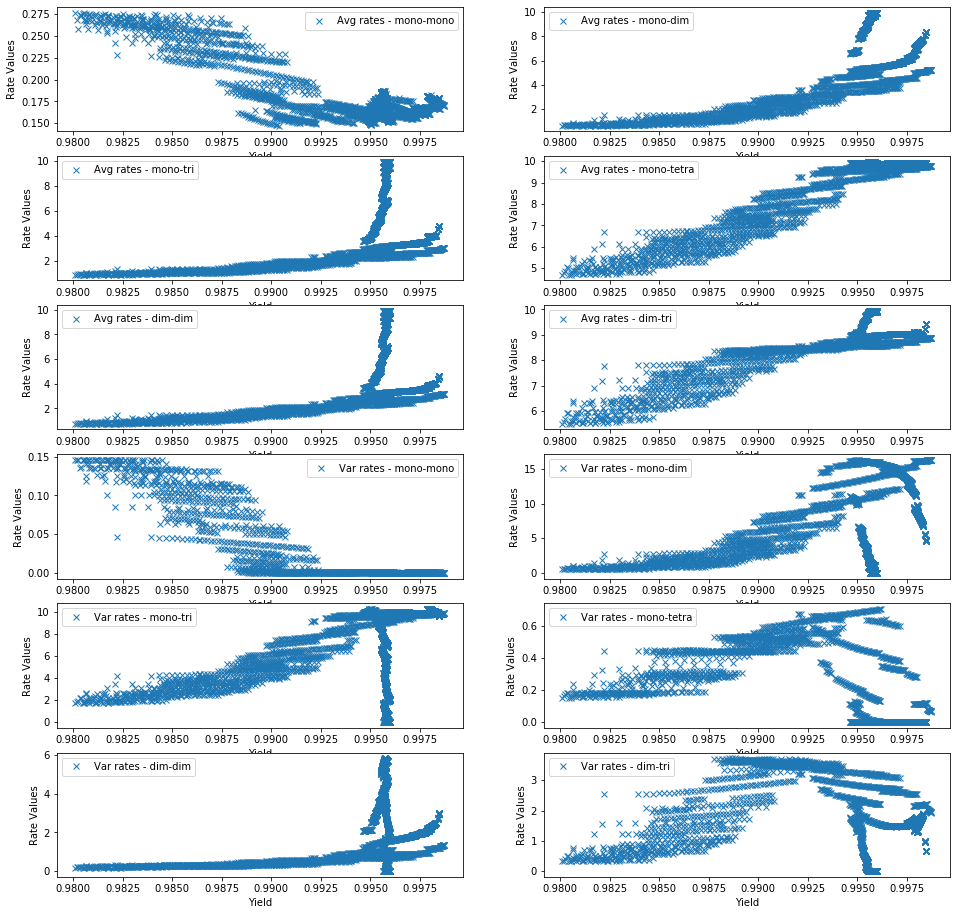

In [16]:
from matplotlib import pyplot as plt
n_features = len(asymm[0])
fig,ax = plt.subplots(int(n_features/2),2,figsize=(16,16))
# %matplotlib notebook

asymm = np.reshape(np.array(asymm),(len(sorted_yields),len(asymm[0])))
sorted_yields.reshape((sorted_yields.shape[0],1))

mask = (sorted_yields < 1.0) & (sorted_yields >0.98)

row=0
col=0
counter=0
for i in range(n_features):
    ax[row,col].plot(sorted_yields[mask],asymm[mask,i],marker='x',linestyle='',label=final_lb[i])
    ax[row,col].legend()
    ax[row,col].set_xlabel("Yield")
    ax[row,col].set_ylabel("Rate Values")
    
    counter+=1
    row = row+(col%2)
    col = counter%2
    

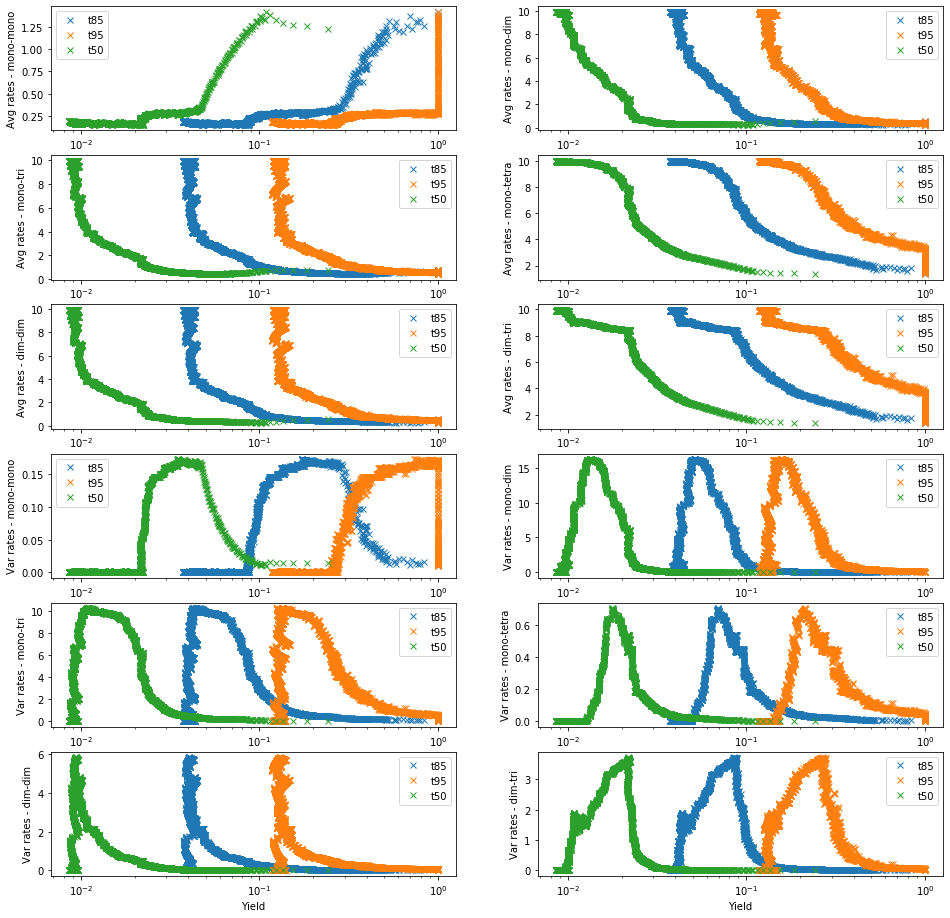

In [17]:
from matplotlib import pyplot as plt
n_features = len(asymm[0])
fig,ax = plt.subplots(int(n_features/2),2,figsize=(16,16))
# %matplotlib notebook

asymm = np.reshape(np.array(asymm),(len(sorted_yields),len(asymm[0])))
sorted_yields.reshape((sorted_yields.shape[0],1))

mask = (sorted_yields < 0.9999) & (sorted_yields >0.5)

row=0
col=0
counter=0
for i in range(n_features):
    ax[row,col].plot(sorted_t85[mask],asymm[mask,i],marker='x',linestyle='',label='t85')
    ax[row,col].plot(sorted_t95[mask],asymm[mask,i],marker='x',linestyle='',label='t95')
    ax[row,col].plot(sorted_t50[mask],asymm[mask,i],marker='x',linestyle='',label='t50')
    ax[row,col].legend()
    ax[row,col].set_xlabel("Yield")
    ax[row,col].set_ylabel(final_lb[i])
    
    ax[row,col].set_xscale("log")
    
    
    counter+=1
    row = row+(col%2)
    col = counter%2

In [18]:
#Let's see what some clustering reveals
#Is there a trend with high yield

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

def cluster_params(params,final_y,n_clust):
#     feat_mat = np.concatenate((params,final_y),axis=1)
    feat_mat = params
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(feat_mat)
    
    kmeans = KMeans(n_clusters = n_clust, random_state=0).fit(X_scaled)
    clus_cen = kmeans.cluster_centers_ #Obtain centroids for all the clusters
    transform_mat = kmeans.transform(feat_mat) #This method calculates the distance of each point from each cluster
    labels = kmeans.labels_  #Labels which frame belongs to which cluster
    
    return(labels,clus_cen,transform_mat)

In [19]:
#Clustering
print(asymm.shape,sorted_yields.shape)
n_clust=8

var_feat_mat = asymm[mask][:,:]

labels,clus_cen,transform_mat = cluster_params(var_feat_mat,sorted_yields.reshape((sorted_yields.shape[0],1)),n_clust)


clr_input = ['skyblue','orange','green','red','purple','gold','brown','olive','crimson','peru','lightgreen','turquoise','cyan']

print(transform_mat.shape)

(4994, 12) (4994,)
(4994, 8)


(4994, 1)
(4994, 1)
(4994, 1)
(4994, 1)
(4994, 1)
(4994, 1)
(4994, 1)
Cluster:  0
Cluster Centroid:  [ 0.25387726 -1.34477787 -1.11635318 -1.03016355 -1.10442993 -0.66614581
  1.03300683 -0.34389142 -0.31557308  1.28134118 -0.7100934   0.64889474]
Max distance:  14.256104705802343 Params:  [0.13321234 0.11880837 0.1200987  0.1736144  0.12551529 0.13423221
 0.18906852 0.21689487 0.21470437 0.11252841 0.76128578 0.14929977
 1.94574515 0.21375411 0.41412719 4.70974671 3.54391226 0.44914743
 0.81736497 0.14180599 1.99740459 0.21283976 0.4177807  4.69653323
 3.63068367 0.37777062 0.76781056 0.43303997 0.20812213 0.43913912
 7.64579926 0.11850985 0.20678769 0.20638798 2.1812225  2.48045016
 0.28435492 0.30847086 4.99110235 0.19880489 1.05140447 6.61673225
 2.2797619  1.64513167 1.83562571 8.34027078 1.27509573 1.82593187
 0.24148706 9.2273404  1.33920839 1.88369044 0.22790581 9.37278058
 1.35309659 1.34542893 1.28308784 9.22737032 2.30543748 1.91947649
 5.00809717 2.56812968 1.84704028 4.780

Cluster:  6
Cluster Centroid:  [-0.26837679  0.44041003 -0.18470217  0.59662303 -0.22224045  0.3846115
 -0.49874793  0.48519156  1.33839801 -0.57883828  0.7012065   0.12883717]
Max distance:  20.28675614009737 Params:  [0.15382814 0.11084185 0.10723846 0.18934512 0.11381659 0.101827
 0.16672275 2.98963312 2.95790468 0.35969851 0.18908758 0.16505354
 9.90899853 2.75697435 8.21620095 9.92562586 9.91790723 3.73185726
 2.58114757 0.19260218 9.90994733 2.55894591 8.17927841 9.92145962
 9.91286255 3.30878771 2.49384943 7.91085487 0.87386114 2.65040415
 9.90326081 3.23367826 4.50164689 4.46378004 9.9087176  9.90516338
 2.54369691 2.53246304 9.91503627 0.22827092 6.34051351 9.90193181
 2.75571476 3.82481693 4.9955463  9.90149186 4.64089517 6.16760403
 1.70757054 9.91568733 4.8298409  6.3334528  1.2614624  9.91155986
 2.98649122 2.98407679 2.54511767 9.90498862 9.9054954  4.73096072
 6.9076691  9.91016611 3.64140396 6.6708182  2.33723072 2.7332071
 8.56131532 9.91281787 9.90418699 8.87791048 9.

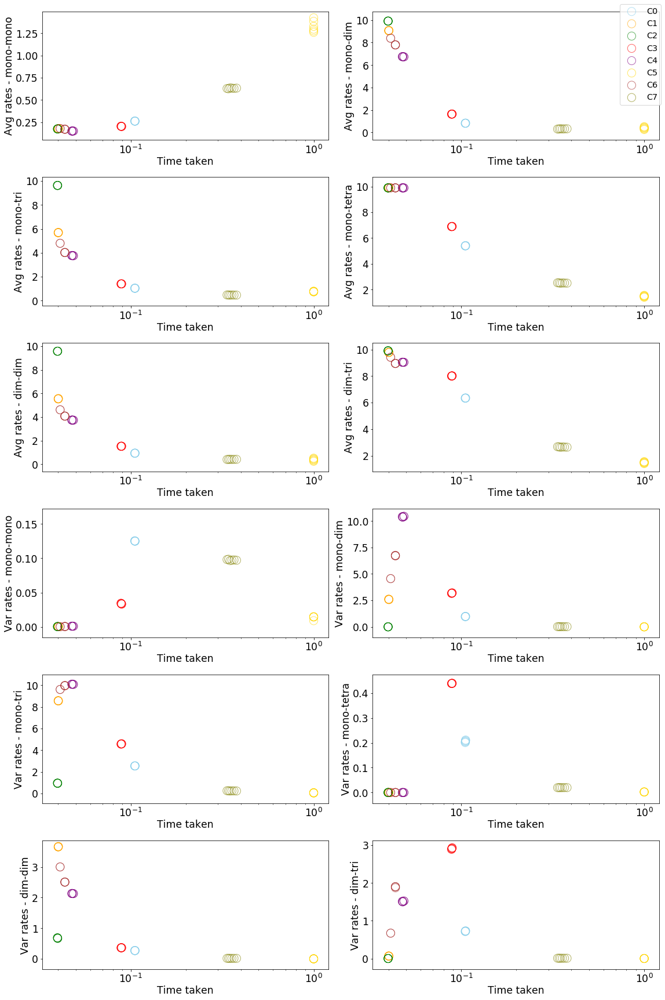

In [20]:
feat_rates =sorted_params[mask]
sel_t50 = sorted_t50[mask]
sel_t85 = sorted_t85[mask]
sel_t95 = sorted_t95[mask]

asymm_new = asymm[mask]

#Create a bianry matrix to know which elements are form a cluster
mask_01=(np.array(labels)==0)
cluster_mask = mask_01.reshape((len(labels),1))
for i in range(1,n_clust):
    n_arr = i*np.ones((len(labels),1))-np.array(labels).reshape(((len(labels),1)))
    mask_01=(n_arr==0)
    print(n_arr.shape)
    cluster_mask=np.hstack((cluster_mask,mask_01))

# cluster_mask = cluster_mask.astype(float)

fig,ax = plt.subplots(int(n_features/2),2,figsize=(16,24))
ax_hd = []

clust_min_solutions={}
for i in range(n_clust):
    
    clus_1_dist = transform_mat[cluster_mask[:,i],i]
    clus_1_par = feat_rates[cluster_mask[:,i],:]
    clus_1_t50 = sel_t50[cluster_mask[:,i]]
    clus_1_t85 = sel_t85[cluster_mask[:,i]]
    clus_1_t95 = sel_t95[cluster_mask[:,i]]
    clus_1_asymm = asymm_new[cluster_mask[:,i]]
    indx_sort = np.argsort(clus_1_dist)
    
    print("Cluster: ",i)
    print("Cluster Centroid: ",clus_cen[i])
    sorted_dist = clus_1_dist[indx_sort]
    sorted_par = clus_1_par[indx_sort]
    clus_sorted_t50 = clus_1_t50[indx_sort]
    clus_sorted_t85 = clus_1_t85[indx_sort]
    clus_sorted_t95 = clus_1_t95[indx_sort]
    clus_sorted_asymm = clus_1_asymm[indx_sort]
    print("Max distance: ",sorted_dist[-1],"Params: ",sorted_par[-1])
    print("Min distance: ",sorted_dist[0],"Params: ",sorted_par[0])
    clust_min_solutions[i]=sorted_par[0]
    
    
    #Plotting
    row=0
    col=0
    counter=0
    for j in range(n_features):
        
#         h1=ax[row,col].scatter(clus_sorted_t85[-1],clus_sorted_asymm[-1,j],s=100,alpha=0.6,marker='o',color=clr_input[i], label='85%')
        h1 = ax[row,col].scatter(clus_sorted_t85[0:6],clus_sorted_asymm[0:6,j],s=200,alpha=0.6,marker='o',edgecolor=clr_input[i], facecolor='none', label='85%')
        
        ax[row,col].set_xlabel("Time taken",fontdict={'fontsize':'xx-large'},labelpad=1.0)
        ax[row,col].set_ylabel(final_lb[j],fontdict={'fontsize':'xx-large'},labelpad=2.0)

        ax[row,col].set_xscale("log")
        ax[row,col].tick_params(labelsize='xx-large')
        
        if counter==0:
            ax_hd.append(h1)
        counter+=1
        row = row+(col%2)
        col = counter%2
fig.legend(ax_hd,['C0','C1','C2','C3','C4','C5','C6','C7'],fontsize='x-large')
fig.tight_layout()

In [21]:
uid_dict = {}
uid_reactants = {}
sys.path.append("../")
import numpy as np
from reaction_network import gtostr
for n in rn.network.nodes():
    #print(n)
    #print(rn.network.nodes()[n])
    for k,v in rn.network[n].items():
        uid = v['uid']
        r1 = set(gtostr(rn.network.nodes[n]['struct']))
        p = set(gtostr(rn.network.nodes[k]['struct']))
        r2 = p-r1
        reactants = (r1,r2)
        uid_val = {'uid':uid,'reactants':reactants,'kon':v['k_on'],'score':v['rxn_score'],'koff':v['k_off']}
        uid_reactants[uid]=reactants
        if uid not in uid_dict.keys():
            uid_dict[uid] = uid_val
    print(gtostr(rn.network.nodes[n]['struct']))
    #for r_set in rn.get_reactant_sets(n):
    #    print(tuple(r_set))
    #print(rn.network[n]['struct'])
ind_sort = np.argsort(vec_rn.kon.detach().numpy())
for i in ind_sort:
    print(vec_rn.kon[i])
    print(uid_dict[i])

P
Q
R
S
T
PQ
PR
PS
PT
QR
QS
QT
PQR
PQS
PQT
RS
RT
PRS
PRT
QRS
QRT
PQRS
PQRT
ST
PST
QST
PQST
RST
PRST
QRST
PQRST
tensor(0.1316, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 10, 'reactants': ({'R'}, {'S'}), 'kon': 1.0, 'score': tensor([-12.], dtype=torch.float64), 'koff': 6.144212353328207}
tensor(0.1388, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 3, 'reactants': ({'P'}, {'T'}), 'kon': 1.0, 'score': tensor([-12.], dtype=torch.float64), 'koff': 6.144212353328207}
tensor(0.1673, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 19, 'reactants': ({'S'}, {'T'}), 'kon': 1.0, 'score': tensor([-12.], dtype=torch.float64), 'koff': 6.144212353328207}
tensor(0.1870, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 2, 'reactants': ({'P'}, {'S'}), 'kon': 1.0, 'score': tensor([-12.], dtype=torch.float64), 'koff': 6.144212353328207}
tensor(0.1886, dtype=torch.float64, grad_fn=<SelectBackward>)
{'uid': 1, 'reactants': ({'P'}, {'R'}), 'kon': 1.0, 'score': tensor([-12.], d

In [22]:
# for clust,rates in clust_min_solutions.items():
#     print("-------------------------")
#     print("-------------------------")
#     print("-----  Cluster  {:d}-----".format(clust))
    
for cl_id,lab in lb_rxn_class.items():
    
    print("------------------------------")
    print("------------------------------")
    print("------    {:s}    -------".format(lab))
    print("------------------------------")
    print("-------------------------------")
    print("%-12s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\t%-4s\n" %('Reaction','uid','C0','C1','C2','C3','C4','C5','C6','C7'))
    for r_id in final_rxn_class[cl_id]:
        r1 = "".join(list(uid_reactants[r_id][0]))
        r2 = "".join(list(uid_reactants[r_id][1]))
        print("{:^4s} + {:^4s}".format(r1,r2),end='\t')
        print(r_id,end='\t')
        for clust,rates in clust_min_solutions.items():
            print("%-4.2f" %(rates[r_id]),end='\t')
        print("")
    

------------------------------
------------------------------
------    mono-mono    -------
------------------------------
-------------------------------
Reaction    	uid 	C0  	C1  	C2  	C3  	C4  	C5  	C6  	C7  

 Q   +  P  	0	0.14	0.19	0.13	0.13	0.15	1.35	0.12	0.47	
 R   +  P  	1	0.19	0.16	0.20	0.12	0.11	1.49	0.19	0.60	
 S   +  P  	2	0.19	0.16	0.20	0.12	0.11	1.36	0.19	0.50	
 T   +  P  	3	0.14	0.20	0.17	0.17	0.19	1.56	0.17	0.64	
 R   +  Q  	4	0.14	0.17	0.20	0.13	0.11	1.35	0.20	0.50	
 S   +  Q  	5	0.14	0.17	0.20	0.13	0.10	1.35	0.20	0.49	
 T   +  Q  	6	0.15	0.19	0.14	0.19	0.17	1.31	0.13	0.45	
 S   +  R  	10	1.32	0.20	0.17	0.76	0.19	1.55	0.17	1.54	
 T   +  R  	11	0.11	0.20	0.15	0.15	0.17	1.35	0.14	0.48	
 T   +  S  	19	0.11	0.12	0.19	0.14	0.19	1.55	0.18	0.67	
------------------------------
------------------------------
------    mono-dim    -------
------------------------------
-------------------------------
Reaction    	uid 	C0  	C1  	C2  	C3  	C4  	C5  	C6  	C7  

 RQ  +  P  	58	0.7

In [23]:
uid_dict = {}
sys.path.append("../")
import numpy as np
from reaction_network import gtostr
from torch import DoubleTensor as Tensor

def get_max_edge(n):
    """
    Calculates the max rate (k_on) for a given node
    To find out the maximum flow path to the final complex starting from the current node.
    
    Can also calculate the total rate of consumption of a node by summing up all rates. 
    Can tell which component is used quickly.
    """
    try:
        edges = rn.network.out_edges(n)
        #Loop over all edges
        #Get attributes
        if len(edges)==0:
            return(False)
        kon_max = -1
        next_node = -1
        
        kon_sum = 0
        for edge in edges:
            data = rn.network.get_edge_data(edge[0],edge[1])
            #print(data)
            #Get uid
            uid = data['uid']
            #Get updated kon
            temp_kon = vec_rn.kon[uid]
            kon_sum+=temp_kon
            
#             #Calculate k_off also
#             std_c = Tensor([1.])
#             l_kon = torch.log(temp_kon)
#             l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (self._R * self._T)) + l_kon + torch.log(std_c)
            if temp_kon > kon_max:
                kon_max = temp_kon
                next_node=edge[1]
        return(kon_max,next_node,kon_sum)
    except Exception as err:
        raise(err)

pathway = []
kon_sumarray = []
total_con_rate = {}
for n in rn.network.nodes():
    
    n_str = gtostr(rn.network.nodes[n]['struct']) 
    
    paths = [n_str]
    kon_sum = 0
    temp_node = n
    max_edge = True
    consumption_rate = 0
    if n < len(rn.network.nodes()):#num_monomers:
#         print("Current node: ")
#         print(n_str)
        while max_edge:
            max_edge = get_max_edge(temp_node)
            if max_edge:
                total_con_rate[gtostr(rn.network.nodes[temp_node]['struct'])] = max_edge[2]
                temp_node = max_edge[1]
                kon_sum += max_edge[0].item()
                
#                 print("Next node: ")
#                 print(temp_node)

                paths.append(gtostr(rn.network.nodes[temp_node]['struct']))
            else:
                break
        pathway.append(paths)
        kon_sumarray.append(kon_sum)
        paths=[]

print(pathway)
print(kon_sumarray)
#print(total_con_rate)

[['P', 'PQT', 'PQST', 'PQRST'], ['Q', 'PQRST'], ['R', 'PRT', 'PQRST'], ['S', 'PRS', 'PQRST'], ['T', 'QRST', 'PQRST'], ['PQ', 'PQRS', 'PQRST'], ['PR', 'PRS', 'PQRST'], ['PS', 'PQST', 'PQRST'], ['PT', 'PST', 'PRST', 'PQRST'], ['QR', 'QRS', 'QRST', 'PQRST'], ['QS', 'PQRST'], ['QT', 'PQT', 'PQST', 'PQRST'], ['PQR', 'PQRS', 'PQRST'], ['PQS', 'PQRS', 'PQRST'], ['PQT', 'PQST', 'PQRST'], ['RS', 'QRST', 'PQRST'], ['RT', 'RST', 'PRST', 'PQRST'], ['PRS', 'PQRST'], ['PRT', 'PQRST'], ['QRS', 'QRST', 'PQRST'], ['QRT', 'QRST', 'PQRST'], ['PQRS', 'PQRST'], ['PQRT', 'PQRST'], ['ST', 'PRST', 'PQRST'], ['PST', 'PRST', 'PQRST'], ['QST', 'PQST', 'PQRST'], ['PQST', 'PQRST'], ['RST', 'PRST', 'PQRST'], ['PRST', 'PQRST'], ['QRST', 'PQRST'], ['PQRST']]
[29.794153740314716, 9.917046961338269, 19.821170374118005, 19.904732749297796, 19.896502139204753, 19.806707804221478, 19.904732749297796, 19.806718283659215, 29.737428789374118, 29.802280274674203, 9.908159006337867, 29.794153740314716, 19.807999470435064, 19.8

In [24]:
last_node = list(rn.network.nodes())[-1]
# if rn.network.in_edges(20):
#     print(rn.network.in_edges(20))
# else:
#     print(False)
    
all_paths = []
add_flag = False
node_paths = {}
def get_path_to_mon(node,path,other_node=None):
    n_str = gtostr(rn.network.nodes[node]['struct']) 
#     print("Node: ",n_str)
    if rn.network.in_edges(node):
        for edges in rn.network.in_edges(node):
            if node not in node_paths:
                node_paths[node]=[edges[0]]
            elif edges[0] not in node_paths[node]:
                node_paths[node].append(edges[0])
            data = rn.network.get_edge_data(edges[0],edges[1])
#             path.append([data['uid']])
            get_path_to_mon(edges[0],path+[data['uid']],edges[1])           
    else:
        part = rn.network.nodes[other_node]['struct'].number_of_edges()
        if part==1 and path not in all_paths:
            all_paths.append(path)
        else:
            pass
        if node not in node_paths[other_node]:
            node_paths[other_node].append(node)

            

        
        
get_path_to_mon(last_node,[],None)
print(node_paths)
print(all_paths)


{30: [3, 22, 4, 21, 5, 27, 6, 25, 7, 20, 8, 19, 9, 24, 10, 18, 11, 17, 12, 23, 13, 16, 14, 15, 26, 2, 28, 1, 29, 0], 22: [2, 14, 4, 12, 5, 16, 6, 11, 8, 9, 18, 1, 20, 0], 14: [1, 8, 4, 5, 11, 0], 8: [0, 4], 5: [0, 1], 11: [1, 4], 12: [1, 6, 2, 5, 9, 0], 6: [0, 2], 9: [1, 2], 16: [2, 4], 18: [2, 8, 4, 6, 16, 0], 20: [2, 11, 4, 9, 16, 1], 21: [2, 13, 3, 12, 5, 15, 6, 10, 7, 9, 17, 1, 19, 0], 13: [1, 7, 3, 5, 10, 0], 7: [0, 3], 10: [1, 3], 15: [2, 3], 17: [2, 7, 3, 6, 15, 0], 19: [2, 10, 3, 9, 15, 1], 27: [3, 16, 4, 15, 23, 2], 23: [3, 4], 25: [3, 11, 4, 10, 23, 1], 24: [3, 8, 4, 7, 23, 0], 26: [3, 14, 4, 13, 5, 23, 7, 11, 8, 10, 24, 1, 25, 0], 28: [3, 18, 4, 17, 6, 23, 7, 16, 8, 15, 24, 2, 27, 0], 29: [3, 20, 4, 19, 9, 23, 10, 16, 11, 15, 25, 2, 27, 1]}
[[30, 18, 9, 3], [30, 18, 31, 0], [30, 18, 64, 6], [30, 36, 7, 1], [30, 36, 12, 0], [30, 36, 58, 4], [30, 43, 0], [30, 43, 11], [30, 47, 1], [30, 47, 6], [30, 54, 3], [30, 54, 4], [30, 75, 14, 3], [30, 75, 32, 1], [30, 75, 72, 11], [30, 7

In [25]:
for node in rn.network.nodes():
    n_str = gtostr(rn.network.nodes[node]['struct']) 
    print(node,":",n_str)

0 : P
1 : Q
2 : R
3 : S
4 : T
5 : PQ
6 : PR
7 : PS
8 : PT
9 : QR
10 : QS
11 : QT
12 : PQR
13 : PQS
14 : PQT
15 : RS
16 : RT
17 : PRS
18 : PRT
19 : QRS
20 : QRT
21 : PQRS
22 : PQRT
23 : ST
24 : PST
25 : QST
26 : PQST
27 : RST
28 : PRST
29 : QRST
30 : PQRST


In [26]:
monomer_rxns = {}
for path in nx.all_simple_paths(rn.network,12,last_node):
    print(path)
master_paths = []

for path in nx.all_simple_edge_paths(rn.network,0,last_node):
    #     print(path)
        rate_routes = []
        for edges in path:
            data = rn.network.get_edge_data(edges[0],edges[1])
            rate_routes.append(data['uid'])
    #     print(rate_routes)
        if rate_routes not in master_paths:
            master_paths.append(rate_routes)

for node in rn.network.nodes():
    for path in nx.all_simple_edge_paths(rn.network,node,last_node):
        data01 = rn.network.get_edge_data(path[0][0],path[0][1])
        if node not in monomer_rxns.keys():
            monomer_rxns[node] = [data01['uid']]
        else:
            monomer_rxns[node].append(data01['uid'])
# for path in nx.shortest_simple_paths(rn.network,0,last_node):
#     print(path)
# print(last_node)
# print(nx.lowest_common_ancestor(rn.network,29,28))
print(len(master_paths))
print(len(set(monomer_rxns[1])))

[12, 21, 30]
[12, 22, 30]
[12, 30]
75
15


Cluster: 0
Fast Pathways:  [list([68, 11]) list([45, 0]) list([45, 38, 10]) list([57, 71, 10])
 list([69, 10])]
Cluster: 1
Fast Pathways:  [list([41, 74, 70, 10]) list([89, 87, 38, 10]) list([30, 75, 14, 3])
 list([89, 87, 27, 11]) list([85, 81, 22, 3])]
Cluster: 2
Fast Pathways:  [list([89, 40, 15, 5]) list([41, 74, 13, 2]) list([30, 18, 64, 6])
 list([85, 26, 64, 6]) list([41, 74, 21, 1])]
Cluster: 3
Fast Pathways:  [list([57, 3]) list([67, 19]) list([53, 2]) list([68, 11])
 list([57, 71, 10])]
Cluster: 4
Fast Pathways:  [list([57, 71, 10]) list([85, 81, 22, 3]) list([30, 75, 14, 3])
 list([89, 87, 38, 10]) list([41, 74, 70, 10])]
Cluster: 5
Fast Pathways:  [list([60, 4]) list([49, 1]) list([67, 19]) list([57, 3]) list([69, 10])]
Cluster: 6
Fast Pathways:  [list([89, 87, 38, 10]) list([89, 87, 27, 11]) list([41, 74, 70, 10])
 list([30, 75, 14, 3]) list([85, 81, 22, 3])]
Cluster: 7
Fast Pathways:  [list([57, 71, 10]) list([49, 1]) list([67, 19]) list([57, 3])
 list([69, 10])]


/home/ajhaver4/.conda/envs/steric_free_sim/lib/python3.7/site-packages/ipykernel_launcher.py:23: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/home/ajhaver4/.conda/envs/steric_free_sim/lib/python3.7/site-packages/ipykernel_launcher.py:23: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
/home/ajhaver4/.conda/envs/steric_free_sim/lib/python3.7/site-packages/ipykernel_launcher.py:23: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecate

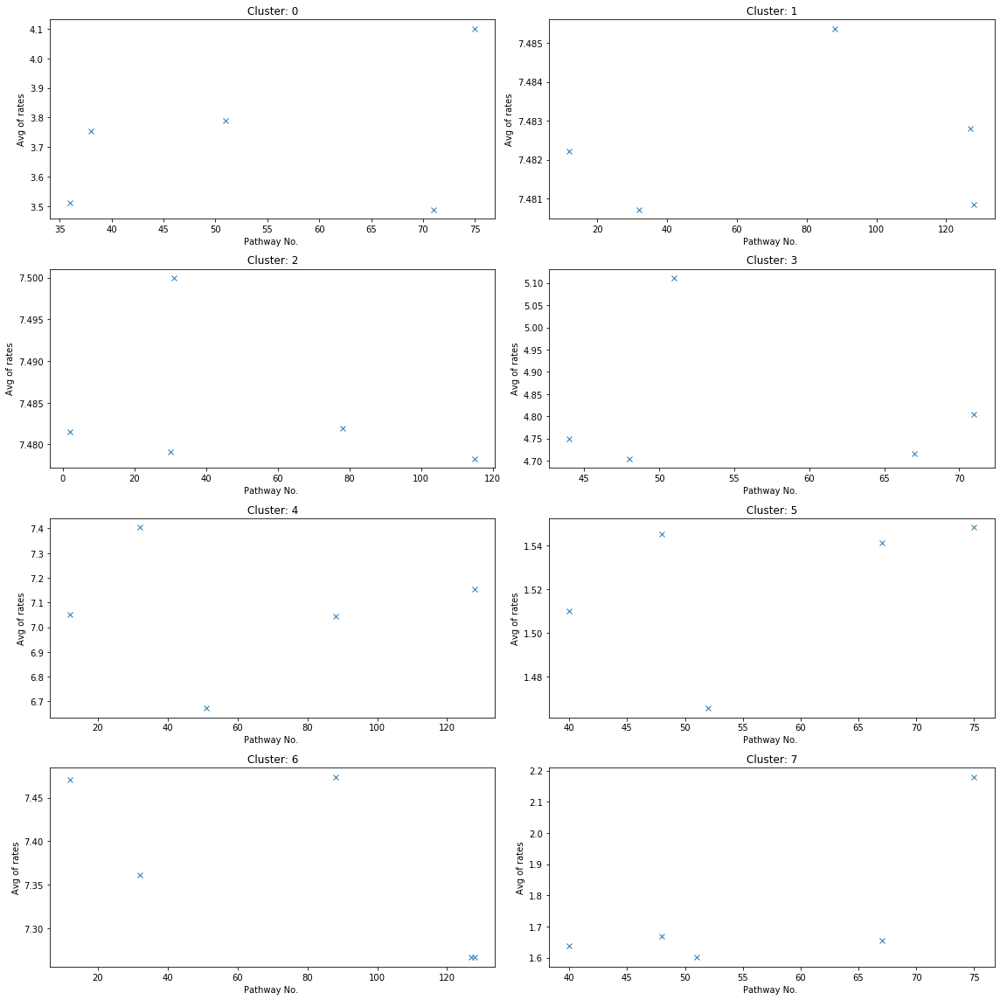

In [27]:
fig,ax = plt.subplots(int(n_clust/2),2,figsize=(16,16))
counter=0
row=0
col=0
for n in range(n_clust):
    avg_path = []
    var_path = []
    rates = np.array(clust_min_solutions[n])
    for path in all_paths:
        avg_path.append(np.mean(rates[path]))
    
    avg_path = np.array(avg_path)
    sort_indx = np.argsort(avg_path)
    ax[row,col].plot(sort_indx[-5:],avg_path[sort_indx[-5:]],marker='x',linestyle='')
    ax[row,col].set_title("Cluster: {:d}".format(n))
    ax[row,col].set_ylabel("Avg of rates")
    ax[row,col].set_xlabel("Pathway No. ")
    counter+=1
    row = row+(col%2)
    col = counter%2
    
    print("Cluster: {:d}".format(n))
    print("Fast Pathways: ",np.array(all_paths)[sort_indx[-5:]])
    
    
fig.tight_layout()       

In [28]:
for k,v in sorted(total_con_rate.items(),key=lambda x : x[1]):
    print(k," : ", v.item())

PQRS  :  9.900135081527882
QRST  :  9.900147437606604
PQRT  :  9.900158529122413
PQST  :  9.900450101514547
PRST  :  9.917046961338269
RST  :  29.707813192705608
QST  :  29.710845656660076
PST  :  29.713144970127505
PQR  :  29.7152293020549
PRT  :  29.71660316787974
PQS  :  29.718206949797167
QRT  :  29.71986659010844
PRS  :  29.721151396435012
PQT  :  29.726993168098346
QRS  :  29.80402645457172
PS  :  69.3148397854648
PQ  :  69.31500685066044
ST  :  69.32008061906689
QR  :  69.32402996349394
RT  :  69.32570143115613
QS  :  69.33513519677481
PT  :  69.33981282106654
RS  :  69.34095899815004
PR  :  69.40877129165469
QT  :  69.43498177792408
R  :  109.66588474647821
Q  :  109.71632063238768
T  :  109.72466022621589
S  :  109.72813457462364
P  :  109.73515308394133


Let's first visualize some of the data.

**Without any optimization**


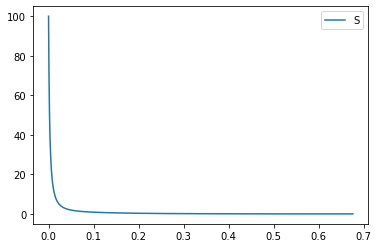

In [29]:
nodes_list = ['A','B','S','M','AB','BMS','ABS','AMS','ABMS','AM','AS']
#nodes_list = ['A','B','ABMS']
optim.plot_observable(0,nodes_list)


**After 750 optimization iterations**


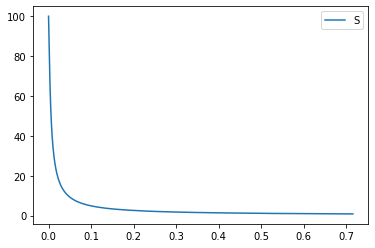

In [30]:
optim.plot_observable(-1,nodes_list)


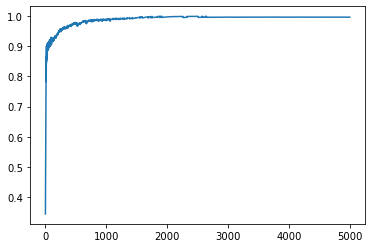

In [31]:
optim.plot_yield()

It seems like we've found a stable solution that produces greater yield than equilibrium. This should be thermodynamically
impossible. Let's try to find an explanation. We'll run simulations using the learned optimal parameters at a few different
timescales.

Using CPU
Simulation rates:  tensor([1.9851e-01, 1.8863e-01, 1.8697e-01, 1.3880e-01, 1.8972e-01, 1.8883e-01,
        1.9899e-01, 9.9004e+00, 9.9004e+00, 9.9049e+00, 1.3163e-01, 1.9985e-01,
        9.9002e+00, 9.9005e+00, 9.9130e+00, 9.9058e+00, 9.9026e+00, 9.9128e+00,
        9.9080e+00, 1.6735e-01, 9.9007e+00, 9.9845e+00, 9.9133e+00, 9.9058e+00,
        9.9028e+00, 9.9079e+00, 9.9096e+00, 9.9119e+00, 9.9069e+00, 9.9099e+00,
        9.9002e+00, 9.9005e+00, 9.9016e+00, 9.9015e+00, 9.9010e+00, 9.9012e+00,
        9.9073e+00, 9.9052e+00, 9.9042e+00, 9.9007e+00, 9.9964e+00, 9.9001e+00,
        9.9066e+00, 9.9033e+00, 9.9034e+00, 9.9003e+00, 9.9081e+00, 9.9073e+00,
        9.9063e+00, 9.9006e+00, 9.9056e+00, 9.9063e+00, 9.9001e+00, 9.9005e+00,
        9.9015e+00, 9.9064e+00, 9.9005e+00, 9.9002e+00, 9.9012e+00, 9.9045e+00,
        9.9044e+00, 9.9014e+00, 9.9041e+00, 9.9082e+00, 9.9841e+00, 9.9116e+00,
        9.9202e+00, 9.9001e+00, 9.9002e+00, 9.9094e+00, 9.9033e+00, 9.9054e+00,
        9.9

No handles with labels found to put in legend.


Next time:  tensor(1.0921, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  398
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(0.9957, dtype=torch.float64, grad_fn=<DivBackward0>)
Using CPU
Simulation rates:  tensor([1.9851e-01, 1.8863e-01, 1.8697e-01, 1.3880e-01, 1.8972e-01, 1.8883e-01,
        1.9899e-01, 9.9004e+00, 9.9004e+00, 9.9049e+00, 1.3163e-01, 1.9985e-01,
        9.9002e+00, 9.9005e+00, 9.9130e+00, 9.9058e+00, 9.9026e+00, 9.9128e+00,
        9.9080e+00, 1.6735e-01, 9.9007e+00, 9.9845e+00, 9.9133e+00, 9.9058e+00,
        9.9028e+00, 9.9079e+00, 9.9096e+00, 9.9119e+00, 9.9069e+00, 9.9099e+00,
        9.9002e+00, 9.9005e+00, 9.9016e+00, 9.9015e+00, 9.9010e+00, 9.9012e+00,
        9.9073e+00, 9.9052e+00, 9.9042e+00, 9.9007e+00, 9.9964e+00, 9.9001e+00,
        9.9066e+00, 9.9033e+00, 9.9034e+00, 9.9003e+00, 9.9081e+00, 9.9073e+00,
        9.9063e+00, 9.9006e+00, 9.9056e+00, 9.9063e+00, 9.9001e+00, 9.9005e+00,
        9.9015e+00, 9.

No handles with labels found to put in legend.


Next time:  tensor(8.7916, dtype=torch.float64, grad_fn=<AddBackward0>)
Number of steps:  400
Next time larger than simulation runtime. Ending simulation.
Final Yield:  tensor(1.0000, dtype=torch.float64, grad_fn=<DivBackward0>)
Using CPU
Simulation rates:  tensor([1.9851e-01, 1.8863e-01, 1.8697e-01, 1.3880e-01, 1.8972e-01, 1.8883e-01,
        1.9899e-01, 9.9004e+00, 9.9004e+00, 9.9049e+00, 1.3163e-01, 1.9985e-01,
        9.9002e+00, 9.9005e+00, 9.9130e+00, 9.9058e+00, 9.9026e+00, 9.9128e+00,
        9.9080e+00, 1.6735e-01, 9.9007e+00, 9.9845e+00, 9.9133e+00, 9.9058e+00,
        9.9028e+00, 9.9079e+00, 9.9096e+00, 9.9119e+00, 9.9069e+00, 9.9099e+00,
        9.9002e+00, 9.9005e+00, 9.9016e+00, 9.9015e+00, 9.9010e+00, 9.9012e+00,
        9.9073e+00, 9.9052e+00, 9.9042e+00, 9.9007e+00, 9.9964e+00, 9.9001e+00,
        9.9066e+00, 9.9033e+00, 9.9034e+00, 9.9003e+00, 9.9081e+00, 9.9073e+00,
        9.9063e+00, 9.9006e+00, 9.9056e+00, 9.9063e+00, 9.9001e+00, 9.9005e+00,
        9.9015e+00, 9.

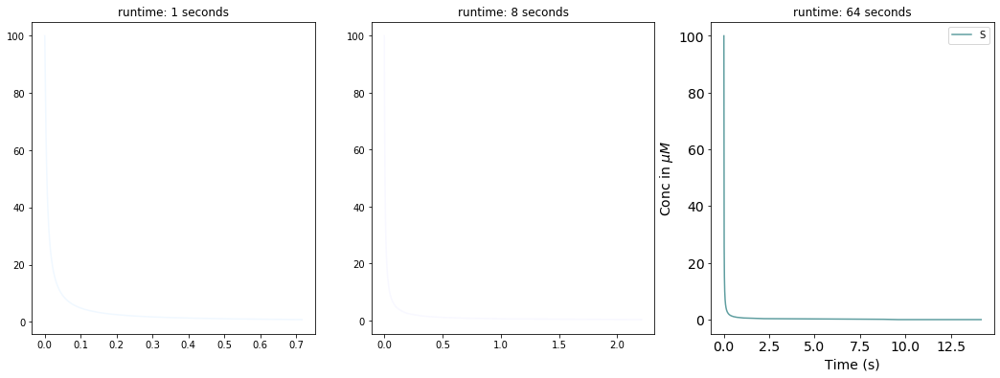

In [32]:
from matplotlib import pyplot as plt
fig, ax = plt.subplots(1, 3)
optim_rn = optim.rn
for i, runtime in enumerate([1, 8, 64]):
    optim_rn.reset()
    sim = VecSim(optim_rn, runtime, device='cpu')
    y = sim.simulate()
    sim.plot_observable(nodes_list,ax=ax[i],)
    ax[i].set_title("runtime: " + str(runtime) + " seconds")
fig.set_size_inches(18, 6)
node_map = {}
for node in rn.network.nodes():
    node_map[gtostr(rn.network.nodes[node]['struct'])] = node

print(node_map)
plt.show()

In [33]:
node_map = {}
for node in rn.network.nodes():
    node_map[gtostr(rn.network.nodes[node]['struct'])] = node

print(node_map)
def get_max_edge(n):
    """
    Calculates the max rate (k_on) for a given node
    To find out the maximum flow path to the final complex starting from the current node.
    
    Can also calculate the total rate of consumption of a node by summing up all rates. 
    Can tell which component is used quickly.
    """
    try:
        edges = rn.network.out_edges(n)
        #Loop over all edges
        #Get attributes
        kon_max = -1
        next_node = -1

        kon_sum = 0
        total_flux_outedges = 0
        total_flux_inedges = 0
        if len(edges)==0:
            return(False)
            
        for edge in edges:
            data = rn.network.get_edge_data(edge[0],edge[1])
            #print(data)
            #Get uid
            uid = data['uid']

            #Get updated kon
            temp_kon = vec_rn.kon[uid]
            kon_sum+=temp_kon
            
            if temp_kon > kon_max:
                kon_max = temp_kon
                next_node=edge[1]
             
        return(kon_max,next_node,kon_sum)
    except Exception as err:
        raise(err)

        
def get_node_flux(n):
    total_flux_outedges = 0
    total_flux_inedges = 0
    #Go over all the out edges
    edges_out = rn.network.out_edges(n)
    if len(edges_out)>0:

        for edge in edges_out:
            data = rn.network.get_edge_data(edge[0],edge[1])
            #print(data)
            #Get uid
            uid = data['uid']

            #Get updated kon
            temp_kon = vec_rn.kon[uid]

            #Calculate k_off also
            std_c = Tensor([1.])
            l_kon = torch.log(temp_kon)
            l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (vec_rn._R * vec_rn._T)) + l_kon + torch.log(std_c)
            koff = torch.exp(l_koff)

            #Getting conc. of reactants and products
            #Get product
            prod = gtostr(rn.network.nodes[edge[1]]['struct']) 
            #Get other reactant
            react = "".join(sorted(list(set(prod) - set(gtostr(rn.network.nodes[edge[0]]['struct']) ))))

            #Net flux from this edge = Generation - consumption
            edge_flux = koff*vec_rn.copies_vec[edge[1]] - temp_kon*(vec_rn.copies_vec[edge[0]])*(vec_rn.copies_vec[node_map[react]])
            #edge_flux = koff*vec_rn.copies_vec[edge[1]] 

            print("Reaction: ", gtostr(rn.network.nodes[edge[0]]['struct']), "+",react," -> ",prod)
            print("Net flux: ",edge_flux)
            print("kon : ",temp_kon)
            print("koff: ",koff)
            print("Reaction data OUTWARD: ")
            print(data)

            total_flux_outedges+=edge_flux
    
    #Now go over all the in edges
    edges_in = rn.network.in_edges(n)
    react_list = []
    if len(edges_in) > 0:
        for edge in edges_in:
            if edge[0] in react_list:
                continue
            data = rn.network.get_edge_data(edge[0],edge[1])
            uid = data['uid']


            #Get generation rates; which would be kon
            temp_kon = vec_rn.kon[uid]

            #Get consumption rates; which is k_off
            std_c = Tensor([1.])
            l_kon = torch.log(temp_kon)
            l_koff = (vec_rn.rxn_score_vec[uid] * 1. / (vec_rn._R * vec_rn._T)) + l_kon + torch.log(std_c)
            koff = torch.exp(l_koff)

            #Get conc. of reactants and products
            prod = gtostr(rn.network.nodes[edge[1]]['struct'])
            #Get other reactant
            react = "".join(sorted(list(set(prod) - set(gtostr(rn.network.nodes[edge[0]]['struct']) ))))
            react_list.append(node_map[react])
            #Net flux from this edge = Generation - consumption
            edge_flux_in = temp_kon*(vec_rn.copies_vec[edge[0]])*(vec_rn.copies_vec[node_map[react]])- koff*vec_rn.copies_vec[edge[1]]
            #edge_flux_in = koff*vec_rn.copies_vec[edge[1]]
            


            print("Reaction: ", prod ," -> ",gtostr(rn.network.nodes[edge[0]]['struct']), "+",react)
            print("Net flux: ",edge_flux_in)
            print("kon : ",temp_kon)
            print("koff: ",koff)
            print("Raction data INWARD: ")
            print(data)

            total_flux_inedges+=edge_flux_in
    net_node_flux = total_flux_outedges + total_flux_inedges
    
    return(net_node_flux)
    
pathway = []
kon_sumarray = []
total_con_rate = {}
net_flux = {}
for n in rn.network.nodes():
    
    n_str = gtostr(rn.network.nodes[n]['struct']) 
    
    paths = [n_str]
    kon_sum = 0
    temp_node = n
    max_edge = True
    consumption_rate = 0
    if n < len(rn.network.nodes()):#num_monomers:
#         print("Current node: ")
#         print(n_str)
        while max_edge:
            max_edge = get_max_edge(temp_node)
            if max_edge:
                total_con_rate[gtostr(rn.network.nodes[temp_node]['struct'])] = max_edge[2]
                
                temp_node = max_edge[1]
                kon_sum += max_edge[0].item()
                
                
#                 print("Next node: ")
#                 print(temp_node)

                paths.append(gtostr(rn.network.nodes[temp_node]['struct']))
            else:
                break
        pathway.append(paths)
        kon_sumarray.append(kon_sum)
        paths=[]
    print("-------------------------------------------------------------------------------")
    print("-------------------------------------------------------------------------------")
    print("|                                                                             |")
    node_flux = get_node_flux(n)
    net_flux[gtostr(rn.network.nodes[n]['struct'])] = node_flux
    print("|                                                                             |")
    print("-------------------------------------------------------------------------------")
    print("-------------------------------------------------------------------------------")

print(pathway)
print(kon_sumarray)

#print(total_con_rate)

{'P': 0, 'Q': 1, 'R': 2, 'S': 3, 'T': 4, 'PQ': 5, 'PR': 6, 'PS': 7, 'PT': 8, 'QR': 9, 'QS': 10, 'QT': 11, 'PQR': 12, 'PQS': 13, 'PQT': 14, 'RS': 15, 'RT': 16, 'PRS': 17, 'PRT': 18, 'QRS': 19, 'QRT': 20, 'PQRS': 21, 'PQRT': 22, 'ST': 23, 'PST': 24, 'QST': 25, 'PQST': 26, 'RST': 27, 'PRST': 28, 'QRST': 29, 'PQRST': 30}
-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
|                                                                             |
Reaction:  P + Q  ->  PQ
Net flux:  tensor([4.5599e-05], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(0.1985, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([0.1975], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.0, 'k_off': 6.144212353328207, 'lcf': 1, 'rxn_score': tensor([-12.], dtype=torch.float64), 'uid': 0}
Reaction:  P + R  ->  PR
Net flux:  tensor([2.5940e-05], dtype=tor

Net flux:  tensor([-5.7198e-07], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(9.9058, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([9.8016], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.0, 'k_off': 3.775134544279096e-05, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 23}
Reaction:  QR + T  ->  QRT
Net flux:  tensor([-8.5493e-07], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(9.9010, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([9.7969], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.0, 'k_off': 3.775134544279096e-05, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 34}
Reaction:  QR + PS  ->  PQRS
Net flux:  tensor([3.3502e-05], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(9.9056, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([9.6984], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTW

{'k_on': 1.0, 'k_off': 3.775134544279096e-05, 'lcf': 1, 'rxn_score': tensor([-24.], dtype=torch.float64), 'uid': 78}
|                                                                             |
-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
-------------------------------------------------------------------------------
|                                                                             |
Reaction:  QST + PR  ->  PQRST
Net flux:  tensor([959.2034], dtype=torch.float64, grad_fn=<SubBackward0>)
kon :  tensor(9.9006, dtype=torch.float64, grad_fn=<SelectBackward>)
koff:  tensor([9.5916], dtype=torch.float64, grad_fn=<ExpBackward>)
Reaction data OUTWARD: 
{'k_on': 1.0, 'k_off': 5.380186160021136e-26, 'lcf': 1, 'rxn_score': tensor([-72.], dtype=torch.float64), 'uid': 49}
Reaction:  QST + P 

In [34]:
for k,v in sorted(net_flux.items(),key=lambda x : x[1]):
    print(k," : ", v)

print(vec_rn.copies_vec)
print(vec_rn.kon)

PQRST  :  tensor([-14444.1850], dtype=torch.float64, grad_fn=<AddBackward0>)
PQR  :  tensor([959.1572], dtype=torch.float64, grad_fn=<AddBackward0>)
ST  :  tensor([959.1573], dtype=torch.float64, grad_fn=<AddBackward0>)
QRS  :  tensor([959.1674], dtype=torch.float64, grad_fn=<AddBackward0>)
PT  :  tensor([959.1674], dtype=torch.float64, grad_fn=<AddBackward0>)
RT  :  tensor([959.1680], dtype=torch.float64, grad_fn=<AddBackward0>)
PQS  :  tensor([959.1680], dtype=torch.float64, grad_fn=<AddBackward0>)
PQ  :  tensor([959.1772], dtype=torch.float64, grad_fn=<AddBackward0>)
RST  :  tensor([959.1773], dtype=torch.float64, grad_fn=<AddBackward0>)
QRT  :  tensor([959.1927], dtype=torch.float64, grad_fn=<AddBackward0>)
PS  :  tensor([959.1927], dtype=torch.float64, grad_fn=<AddBackward0>)
PR  :  tensor([959.2034], dtype=torch.float64, grad_fn=<AddBackward0>)
QST  :  tensor([959.2034], dtype=torch.float64, grad_fn=<AddBackward0>)
QR  :  tensor([959.5729], dtype=torch.float64, grad_fn=<AddBackwa

In [35]:
# print(solution)
poly_system = EquilibriumSolver(rn)
solution = poly_system.solve(init_val=vec_rn.copies_vec.detach().numpy().tolist())
#solution = poly_system.solve(verifyBool = False)
if solution == None:
    print("No Equilibrium solution")
else:
    print(solution)
    print("Equilibrium expected yield: ", 100 * solution[-1] / min(vec_rn.initial_copies[:vec_rn.num_monomers]), '%')
print(vec_rn.kon)

Matrix([[0.0002904049], [5.574221e-9], [0.0002905297], [0.0002903908], [0.0002907457], [1.599940e-14], [1.370177e-8], [1.370088e-8], [1.370487e-8], [-3.137431e-14], [2.427598e-14], [-1.009492e-13], [2.058630e-8], [7.481183e-8], [-8.394679e-9], [1.370211e-8], [1.370365e-8], [9.793882e-8], [-9.111873e-9], [1.039163e-8], [-1.148611e-8], [1.255716e-7], [-1.721182e-8], [1.370545e-8], [2.786986e-8], [-1.408684e-8], [3.307936e-8], [3.921788e-9], [-0.0002905725], [-2.543741e-10], [100.0000]])
Equilibrium expected yield:  100.000000000000 %
Parameter containing:
tensor([0.1985, 0.1886, 0.1870, 0.1388, 0.1897, 0.1888, 0.1990, 9.9004, 9.9004,
        9.9049, 0.1316, 0.1998, 9.9002, 9.9005, 9.9130, 9.9058, 9.9026, 9.9128,
        9.9080, 0.1673, 9.9007, 9.9845, 9.9133, 9.9058, 9.9028, 9.9079, 9.9096,
        9.9119, 9.9069, 9.9099, 9.9002, 9.9005, 9.9016, 9.9015, 9.9010, 9.9012,
        9.9073, 9.9052, 9.9042, 9.9007, 9.9964, 9.9001, 9.9066, 9.9033, 9.9034,
        9.9003, 9.9081, 9.9073, 9.9063, 

Clearly, the equilibrium reached by the system still matches the equilibrium solution. We have however found a set of parameters that can increase available complete AP2 at some point before equilibrium to levels significantly higher than at equilibrium. We don't observe any trapping, but have uncovered an interesting effect. 

Now we'll move on to looking at ARP23. This is 7 subunits, which drastically increases the number of possible reactions. Expect longer runtimes. 